# Unweighted Average

In [1]:
# Importing the libraries
import numpy as np
import pandas as pd
import sklearn
import matplotlib.pyplot as plt
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

f_size = 16
first_time = True
# Importing the dataset
dataset = pd.read_csv('CVD dataset2.csv')
data=dataset.iloc[:, :].values
X = dataset.iloc[:, :-1].values
y = dataset.iloc[:, f_size].values
# X = dataset.iloc[:, [ 0, 1, 2, 5, 10, 11, 13, 15]].values

rows = len(data)    # 3 rows in your example
cols = len(data[0])
print(rows)
print(cols)

560
17


In [178]:
print(type(X))

<class 'numpy.ndarray'>


In [179]:
import numpy as np

a = np.array([[10, 20, 30, 40, 50],[ 6,  7,  8,  9, 10]])
print(a)
your_permutation = [0,4,1,3,2]
idx = np.empty_like(your_permutation)
# print(idx)
idx[your_permutation] = np.arange(len(your_permutation))
# print(idx)
# a[:, idx]  # return a rearranged copy
print(a[:, idx])
# array([[10, 30, 50, 40, 20],[ 6,  8, 10,  9,  7]])

a[:] = a[:, idx]  # in-p
print(a)

[[10 20 30 40 50]
 [ 6  7  8  9 10]]
[[10 30 50 40 20]
 [ 6  8 10  9  7]]
[[10 30 50 40 20]
 [ 6  8 10  9  7]]


In [2]:
dataNoCvd = data[~(data[:,f_size] > 0.0)]
dataCvd = data[~(data[:,f_size] < 1.0)]
rowsNoCvd = len(dataNoCvd)    
rowsCvd = len(dataCvd)
print(rowsNoCvd)
print(rowsCvd)
# print(dataNoCvd)
# print(dataCvd)

519
41


In [3]:
def find_NoCvd_limitsArray(i,DownNoCvd, UpNoCvd, fold_NoCvd_total, fold_NoCvd_residue):
    if i>0 :
        DownNoCvd = UpNoCvd
        UpNoCvd= fold_NoCvd_total+UpNoCvd
    if i < fold_NoCvd_residue :
        UpNoCvd+= 1
#     print("NoCvd limits, Down :",DownNoCvd,"Up ",UpNoCvd)
    return   DownNoCvd, UpNoCvd   
 
def find_Cvd_limitsArray(i,DownCvd, UpCvd, fold_Cvd_total, fold_Cvd_residue,cv):
    if i>0 :
        DownCvd = UpCvd
        UpCvd= fold_Cvd_total+UpCvd
    if i >= cv - fold_Cvd_residue :
         UpCvd+= 1     
#     print("Cvd limits, Down :",DownCvd,"Up ",UpCvd)
    return   DownCvd, UpCvd  

def find_testValSubset(DownNoCvd,UpNoCvd,DownCvd,UpCvd,dataNoCvd,dataCvd):
    temp1=dataNoCvd[DownNoCvd:UpNoCvd,:]
    temp2=dataCvd[DownCvd:UpCvd,:]
    temp3=np.concatenate((temp1, temp2))
#     print(len(temp1),"  ",len(temp2),"  ",len(temp3))
    return temp3

def find_trainSubset(DownNoCvd,UpNoCvd,DownCvd,UpCvd,dataNoCvd,dataCvd):
    temp1 = np.delete(dataNoCvd, slice(DownNoCvd, UpNoCvd), axis=0)
    temp2 = np.delete(dataCvd, slice(DownCvd, UpCvd), axis=0)
    temp3 = np.concatenate((temp1, temp2))
#     print(len(temp1),"  ",len(temp2),"  ",len(temp3))
    return temp1, temp2, temp3

In [4]:
def create_train_test_sets(f_size,cv,dataNoCvd,dataCvd,val_ratio):
    test_total = []
    train_total = []
    train_total_Cvd = []
    train_total_NoCvd = []
    validation_total = []
    
    rowsNoCvd = len(dataNoCvd)    
    rowsCvd = len(dataCvd)

    fold_Cvd_total = rowsCvd//cv
    fold_Cvd_residue= rowsCvd%cv
#     print("fold_Cvd_total  :",fold_Cvd_total," fold_Cvd_residue  :",fold_Cvd_residue)

    fold_NoCvd_total = rowsNoCvd//cv
    fold_NoCvd_residue= rowsNoCvd%cv
#     print("fold_NoCvd_total:",fold_NoCvd_total,"fold_NoCvd_residue:",fold_NoCvd_residue)
    
    Cvd_val = round(504*val_ratio*(rowsCvd/len(data)))
    noCvd_val = round(504*val_ratio)-Cvd_val
#     print(noCvd_val)
    
    DownNoCvd=0
    DownCvd=0
    UpNoCvd = fold_NoCvd_total
    UpCvd = fold_Cvd_total

    for i in range(cv):
        X_test = []
        y_test = []
        X_train = []
        y_train = []
        X_val = []
        y_val = []
#         print("============",i,"==============")
        DownNoCvd, UpNoCvd = find_NoCvd_limitsArray(i, DownNoCvd, UpNoCvd, fold_NoCvd_total, fold_NoCvd_residue)
        DownCvd, UpCvd = find_Cvd_limitsArray(i, DownCvd, UpCvd, fold_Cvd_total, fold_Cvd_residue,cv)
#         print(DownNoCvd,UpNoCvd,DownCvd,UpCvd)
        testSubset_total = find_testValSubset(DownNoCvd,UpNoCvd,DownCvd,UpCvd,dataNoCvd,dataCvd)
        if i!=9:
#             print(UpNoCvd,UpNoCvd+noCvd_val,UpCvd,UpCvd+Cvd_val)
            validationSubset_total = find_testValSubset(UpNoCvd,UpNoCvd+noCvd_val,UpCvd,UpCvd+Cvd_val,dataNoCvd,dataCvd)
#             print(DownNoCvd,UpNoCvd+noCvd_val,DownCvd,UpCvd+Cvd_val)
            trainSubset_NoCvd ,trainSubset_Cvd ,trainSubset_total = find_trainSubset(DownNoCvd,UpNoCvd+noCvd_val,DownCvd,UpCvd+Cvd_val,dataNoCvd,dataCvd)
        else:
#             print(DownNoCvd-noCvd_val,DownNoCvd,DownCvd-Cvd_val,DownCvd)
            validationSubset_total = find_testValSubset(DownNoCvd-noCvd_val,DownNoCvd,DownCvd-Cvd_val,DownCvd,dataNoCvd,dataCvd)
#             print(DownNoCvd-noCvd_val,UpNoCvd,DownCvd-Cvd_val,UpCvd)
            trainSubset_NoCvd ,trainSubset_Cvd ,trainSubset_total = find_trainSubset(DownNoCvd-noCvd_val,UpNoCvd,DownCvd-Cvd_val,UpCvd,dataNoCvd,dataCvd)
    #creating X_train, y_train, X_test, y_test
        X_test.append(np.delete(testSubset_total, f_size, axis=1))
        y_test_temp = np.delete(testSubset_total, slice(0, f_size), axis=1)
        y_test.append(np.reshape(y_test_temp, len(y_test_temp)))
        X_test_temp = np.array(X_test)
        X_test = X_test_temp[0]
        y_test_temp = np.array(y_test)
        y_test = y_test_temp[0]
        
        X_val.append(np.delete(validationSubset_total, f_size, axis=1))
        y_val_temp = np.delete(validationSubset_total, slice(0, f_size), axis=1)
        y_val.append(np.reshape(y_val_temp, len(y_val_temp)))
        X_val_temp = np.array(X_val)
        X_val = X_val_temp[0]
        y_val_temp = np.array(y_val)
        y_val = y_val_temp[0]
        
        X_train.append(np.delete(trainSubset_total, f_size, axis=1))
        y_train_temp = np.delete(trainSubset_total, slice(0, f_size), axis=1)
        y_train.append(np.reshape(y_train_temp, len(y_train_temp)))
        X_train_temp = np.array(X_train)
        X_train = X_train_temp[0]
        y_train_temp = np.array(y_train)
        y_train = y_train_temp[0]
        
    #add every subset in a list so we can handle thm later 
        test_total.append([X_test,y_test])
        validation_total.append([X_val,y_val])
        train_total.append([X_train,y_train]) 
        train_total_NoCvd.append(trainSubset_NoCvd)
        train_total_Cvd.append(trainSubset_Cvd)
    return train_total, test_total, validation_total, train_total_NoCvd, train_total_Cvd

In [5]:
train_total, test_total, validation_total, train_total_NoCvd, train_total_Cvd = create_train_test_sets(f_size,10,dataNoCvd,dataCvd,0.1)

In [6]:
# Chech ratio in each train and test set
def find_ratio(index_list):
    one = 0
    lenght=len(index_list[0])
    for i in range(lenght):
#         print(index_list[1])
        if index_list[1][i] == 1.0 :
            one+= 1
    ratio = one/lenght
    return ratio

for i in range(10):
    print(len(train_total[i][0]))
    ratio = find_ratio(train_total[i])
    print("ratio in train set:", ratio)
    ratio = find_ratio(test_total[i])
    print("ratio in test set:", ratio)
    ratio = find_ratio(validation_total[i])
    print("ratio in validation set:", ratio)

454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in validation set: 0.08
454
ratio in train set: 0.07268722466960352
ratio in test set: 0.07142857142857142
ratio in vali

In [8]:
from xgboost import XGBClassifier


def my_fit(f_size,ratio,dataNoCvd,dataCvd, validation_total, params):   
    Subarray=[]
    models = []
    # yarray
    
    rowsNoCvd = len(dataNoCvd)    
    rowsCvd = len(dataCvd)
#     print("Size of NoCvd cases in train set:",rowsNoCvd)
#     print("Size of Cvd cases in train set  :",rowsCvd)


    numOfSubsamples = rowsNoCvd//(rowsCvd*ratio)
    numOfSubsamples= int(numOfSubsamples)
    SubNoCvd = rowsNoCvd//numOfSubsamples
    residue = rowsNoCvd- SubNoCvd*numOfSubsamples


    Up = 0


    for i in range(numOfSubsamples):
        
        classifier = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=params[5],
                  colsample_bynode=1, colsample_bytree=params[8], gamma=params[4],
                  learning_rate=params[0], max_delta_step=0, max_depth=params[1],
                  min_child_weight=params[3], missing=None, n_estimators=params[2], n_jobs=1,
                  nthread=None, objective='binary:logistic', random_state=0,
                  reg_alpha=params[9], reg_lambda=params[6], scale_pos_weight=params[7], seed=None,
                  silent=None, subsample=params[10], verbosity=1)
        
#         classifier = XGBClassifier()
    #     print(i)
    #Creating the training set for each model
        Down = Up
        Up= Up + SubNoCvd
        if i < residue :
            Up+= 1
        
#         print(Down)
#         print(Up)
        
        Sub1=dataNoCvd[Down:Up,:]
        Sub2=np.concatenate((Sub1, dataCvd))
        Subarray.append(Sub2)
        
    #Dividing to X and y of the previous traing set    
        X=np.delete(Subarray[i], f_size, axis=1)
        y=np.delete(Subarray[i], slice(0, f_size), axis=1)
        y=np.reshape(y, len(y))
        
        
        X_val = validation_total[i][0]
        y_val = validation_total[i][1]
        
        eval_set  = [(X,y), (X_val,y_val)]
        
        classifier.fit( X, y, eval_set=eval_set, eval_metric="auc", early_stopping_rounds=50,verbose = False)
        
        models.append(classifier)
    return models 

In [9]:
def voting(models,X):
    y_pred = []
    y_pred_models = []

    models_size = len(models)
    X_size = len(X)
            
    for i in range(models_size):
        y_pred_models.append(models[i].predict(X))
        
    for j in range(X_size):
        case = 0
        for i in range(models_size):
            if y_pred_models[i][j] == 1.0:
                case+=1
        if case >  models_size/2 :
            y_pred.append(1.) 
        else:
            y_pred.append(0.) 
            
    return y_pred  

In [223]:
from collections import OrderedDict

k= {"ss":2,"pp":1,"oo":4}
ok = OrderedDict(sorted(k.items(), key=lambda x: x[1]))
lala= ok.popitem()
if lala[0] == 'oo':
    print("Hell yeah")
print(lala)
print(k)
print(ok)

# if k.get("o")!= None:
#     print(0)
# print(k.get("sp"))
l= {"ss":0,"pp":0}
l.update({"ss": k.get("ss")+l.get("ss")})
# print(l)


Hell yeah
('oo', 4)
{'ss': 2, 'pp': 1, 'oo': 4}
OrderedDict([('pp', 1), ('ss', 2)])


In [53]:
# https://towardsdatascience.com/train-test-split-and-cross-validation-in-python-80b61beca4b6

from sklearn.metrics import  confusion_matrix,roc_curve, roc_auc_score, accuracy_score
from imxgboost.imbalance_xgb import imbalance_xgboost as imb_xgb
from sklearn.model_selection import StratifiedKFold # import KFold
from sklearn import metrics
from xgboost import plot_importance
from matplotlib import pyplot
from xgboost import XGBClassifier
from collections import OrderedDict
from boostaroota import BoostARoota
import pandas as pd


def my_cross_val(f_size, cv, train_total, test_total, validation_total, train_total_NoCvd, train_total_Cvd,params,idx_aver,idx_vot,first_time):
    accuracy = []
    specificity = []
    sensitivity = []
    auc = []
    # print(X)
    for i in range(cv):
#         X_train = train_total[i][0]
#         y_train = train_total[i][1]
        X_test = test_total[i][0]
        y_test = test_total[i][1]
        


        models = my_fit(f_size, 2, train_total_NoCvd[i], train_total_Cvd[i],validation_total,params)
        

        y_pred = voting(models,X_test)

        cm = confusion_matrix(y_test, y_pred)
    #     print(cm)

        total1=sum(sum(cm))
        #####from confusion matrix calculate accuracy
        accuracy1=(cm[0,0]+cm[1,1])/total1
    #   print ('Accuracy : ', accuracy1)

        specificity1 = cm[0,0]/(cm[0,0]+cm[0,1])
    #   print('Specificity : ', specificity1 )

        sensitivity1 = cm[1,1]/(cm[1,0]+cm[1,1])
    #   print('Sensitivity : ', sensitivity1)
        
#         y = np.array(y_test)
#         pred = np.array(y_pred)
#         fpr, tpr, thresholds = metrics.roc_curve(y, pred, pos_label=2)
#         auc1 = metrics.auc(fpr, tpr)
        
        auc1 = roc_auc_score(y_test, y_pred)

    
        accuracy.append(accuracy1)
        specificity.append(specificity1)
        sensitivity.append(sensitivity1) 
        auc.append(auc1)
    if first_time: 
        importancies_av = [[0,0],[0,1],[0,2],[0,3],[0,4],[0,5],[0,6],[0,7],[0,8],[0,9],[0,10],[0,11],[0,12],[0,13],[0,14],[0,15]]
        importancies_vot = [[0,0],[0,1],[0,2],[0,3],[0,4],[0,5],[0,6],[0,7],[0,8],[0,9],[0,10],[0,11],[0,12],[0,13],[0,14],[0,15]]
        times_used    = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
        for j in range(len(models)):
    #         print(models[j].feature_importances_)
    
            # plot!!!!!!!!!!!!!!!!!!!!!!!!!!!
#             pyplot.bar(range(len(models[j].feature_importances_)), models[j].feature_importances_)
    #         pyplot.show()
    #         models[j].get_score(importance_type='gain')
    
#             PLOOOTTTT
#             plot_importance(models[j],importance_type='weight')
            p =models[j].get_booster().get_score(importance_type="weight")
    #         print(p)

            importancies_av,times_used = importances_average(p,importancies_av,times_used)
            importancies_vot = importances_voting(p,importancies_vot)
            importancies_vot.sort(key=lambda tup: tup[0],reverse=True)
    #         plot_importance(models[j], max_num_features=16)
    #         plot_importance(models[j],importance_type='weight')
    #         pyplot.show()
        for i in range(len(importancies_av)):
            if times_used[i] != 0:
    #             importancies_av[i][0] = importancies_av[i][0]/times_used[i]
                importancies_av[i][0] = importancies_av[i][0]/6


        importancies_av.sort(key=lambda tup: tup[0],reverse=True)
        most_important_av = list()
        most_important_vot = list()
        for i in range(f_size):
            most_important_av.append(importancies_av[i])
            idx_aver.append(most_important_av[i][1])
            most_important_vot.append(importancies_vot[i])
            idx_vot.append(most_important_vot[i][1])
        idx_aver.append(16)
        idx_vot.append(16)

    return accuracy, specificity, sensitivity, auc, idx_aver, idx_vot



In [11]:
def importances_voting(p,importancies):
    op = OrderedDict(sorted(p.items(), key=lambda x: x[1]))
    for ii in range(8):
#         print(op)
        f = op.popitem()
#         print(f)
        if f[0] == 'f0':
            importancies[0][0] += 1
        if f[0] == 'f1':
            importancies[1][0] += 1
        if f[0] == 'f2':
            importancies[2][0] += 1
        if f[0] == 'f3':
            importancies[3][0] += 1
        if f[0] == 'f4':
            importancies[4][0] += 1
        if f[0] == 'f5':
            importancies[5][0] += 1
        if f[0] == 'f6':
            importancies[6][0] += 1
        if f[0] == 'f7':
            importancies[7][0] += 1
        if f[0] == 'f8':
            importancies[8][0] += 1
        if f[0] == 'f9':
            importancies[9][0] += 1
        if f[0] == 'f10':
            importancies[10][0] += 1
        if f[0] == 'f11':
            importancies[11][0] += 1
        if f[0] == 'f12':
            importancies[12][0] += 1
        if f[0] == 'f13':
            importancies[13][0] += 1
        if f[0] == 'f14':
            importancies[14][0] += 1
        if f[0] == 'f15':
            importancies[15][0] += 1
    return importancies
        

In [12]:
def importances_average(p,importancies,times_used):
        if p.get("f0")!= None:
            importancies[0][0] += p.get("f0")
            times_used[0] += 1
        if p.get("f1")!= None:
            importancies[1][0] += p.get("f1")
            times_used[1] += 1
        if p.get("f2")!= None:
            importancies[2][0] += p.get("f2")
            times_used[2] += 1
        if p.get("f3")!= None:
            importancies[3][0] += p.get("f3")
            times_used[3] += 1
        if p.get("f4")!= None:
            importancies[4][0] += p.get("f4")
            times_used[4] += 1
        if p.get("f5")!= None:
            importancies[5][0] += p.get("f5")
            times_used[5] += 1
        if p.get("f6")!= None:
            importancies[6][0] += p.get("f6")
            times_used[6] += 1
        if p.get("f7")!= None:
            importancies[7][0] += p.get("f7")
            times_used[7] += 1
        if p.get("f8")!= None:
            importancies[8][0] += p.get("f8")
            times_used[8] += 1
        if p.get("f9")!= None:
            importancies[9][0] += p.get("f9")
            times_used[9] += 1
        if p.get("f10")!= None:
            importancies[10][0] += p.get("f10")
            times_used[10] += 1
        if p.get("f11")!= None:
            importancies[11][0] += p.get("f11")
            times_used[11] += 1
        if p.get("f12")!= None:
            importancies[12][0] += p.get("f12")
            times_used[12] += 1
        if p.get("f13")!= None:
            importancies[13][0] += p.get("f13")
            times_used[13] += 1
        if p.get("f14")!= None:
            importancies[14][0] += p.get("f14")
            times_used[14] += 1
        if p.get("f15")!= None:
            importancies[15][0] += p.get("f15")
            times_used[15] += 1
        return importancies,times_used

In [13]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/        

params = {
                    "learning_rate"    :[0.3],  #0.01-0.2 Makes the model more robust by shrinking the weights on each step
                    "max_depth"        :[2],  #3-10 control over-fitting as higher depth will allow model to learn relations very specific to a particular sample
                    "n_estimators"     :[200],
                    "min_child_weight" :[2],         #0.5-1 small values might lead to under-fitting
                    "gamma"            :[0],            #Makes the algorithm conservative --> No overfitting
                    "colsample_bylevel" :[0.75], #0.5-1
                     "reg_lambda"      :[2], #  it should be explored to reduce overfitting.
                    "scale_pos_weight" :[5],
                    "colsample_bytree" :[0.75],
                    "reg_alpha"        :[0.2],
                    "subsample"        :[0.8]
    
        }
# parameters : [0.4, 2, 100, 2, 0.5, 0.5, 1, 4, 0.75, 0.1, 0.8]
# accuracy : 0.6964285714285714
# spes     : 0.6976998491704374
# sens     : 0.685
# auc      : 0.6913499245852187
    
# parameters : [0.3, 2, 200, 2, 0, 0.75, 2, 5, 0.75, 0.2, 0.8]
# accuracy : 0.6892857142857143
# spes     : 0.6899698340874811
# sens     : 0.69
# auc      : 0.6899849170437405


In [120]:
print(idx_aver)

NameError: name 'idx_aver' is not defined

In [414]:
print(idx_aver)

[]


[0.3, 2, 200, 2, 0, 0.75, 2, 5, 0.75, 0.2, 0.8]
[[63.5, 14], [58.333333333333336, 11], [57.5, 3], [56.833333333333336, 13], [49.833333333333336, 15], [43.166666666666664, 1], [42.666666666666664, 2], [36.166666666666664, 12], [26.666666666666668, 10], [16.166666666666668, 5], [9.333333333333334, 6], [8.666666666666666, 0], [7.166666666666667, 4], [6.666666666666667, 8], [1.0, 7], [1.0, 9]]
[[5, 3], [5, 2], [5, 1], [4, 11], [3, 5], [3, 12], [3, 14], [3, 15], [3, 6], [2, 9], [2, 10], [2, 7], [2, 8], [2, 0], [2, 4], [2, 13]]


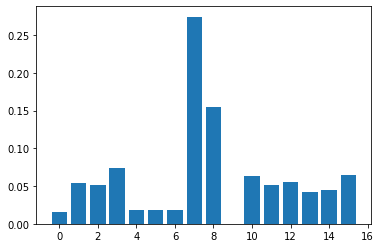

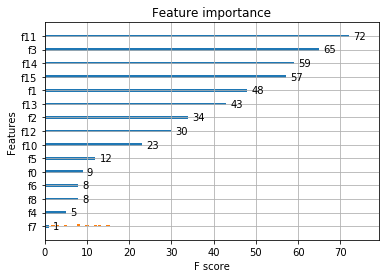

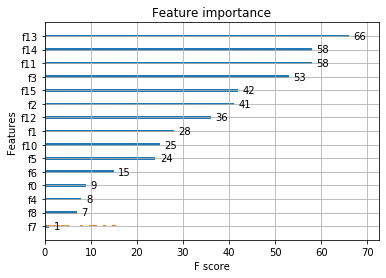

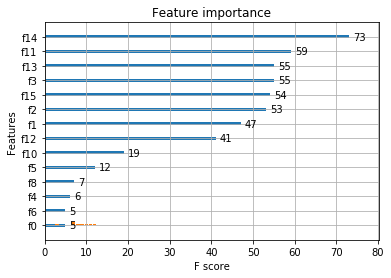

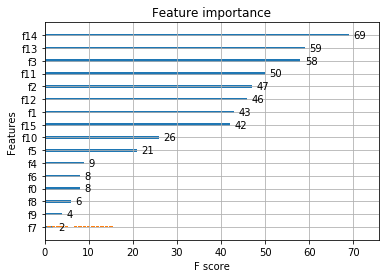

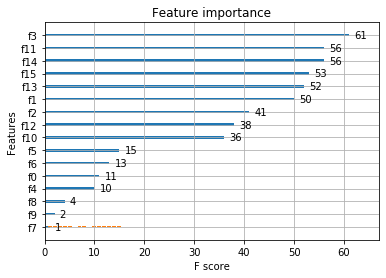

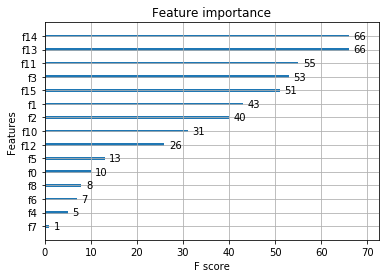

In [415]:
first_time = True
comb = compute_comb(params)
print(comb[0])
idx_aver = []
idx_vot = []
accuracy, specificity, sensitivity, auc = my_cross_val( 10, train_total, test_total, train_total_NoCvd, train_total_Cvd,comb[0])

In [416]:
from statistics import mean
print(mean(accuracy))
print(mean(specificity))
print(mean(sensitivity))
print(mean(auc))

0.6892857142857143
0.6899698340874811
0.69
0.6899849170437405


In [14]:
# https://www.geeksforgeeks.org/python-all-possible-permutations-of-n-lists/

def compute_comb(params):
    
    # initializing lists 
    list1 = params.get("learning_rate")
    list2 = params.get("max_depth")
    list3 = params.get("n_estimators") 
    list4 = params.get("min_child_weight")
    list5 = params.get("gamma")    
    list6 = params.get("colsample_bylevel")
    list7 = params.get("reg_lambda") 
    list8 = params.get("scale_pos_weight")
    list9 = params.get("colsample_bytree")
    list10 = params.get("reg_alpha")
    list11 = params.get("subsample")
    

#     # printing lists  
#     print ("The original lists are : " + str(list1) +
#                                    " " + str(list2) + 
#                                    " " + str(list3) + 
#                                    " " + str(list4) + 
#                                    " " + str(list5) + 
#                                    " " + str(list6) +
#                                    " " + str(list7) +
#                                    " " + str(list8)) 

    # using list comprehension  
    # to compute all possible permutations 
    res = [[i, j, k, l, m, n, o, p,q,r,s] for i in list1  
                                          for j in list2 
                                          for k in list3 
                                          for l in list4 
                                          for m in list5 
                                          for n in list6 
                                          for o in list7
                                          for p in list8
                                          for q in list9
                                          for r in list10
                                          for s in list11] 

    # printing result 
#     print ("All possible permutations are : " +  str(res))
    return res

In [15]:
class style:
    BOLD = '\033[1m'
    END = '\033[0m'

In [56]:
# https://towardsdatascience.com/train-test-split-and-cross-validation-in-python-80b61beca4b6

from sklearn.metrics import  confusion_matrix,roc_curve, roc_auc_score, accuracy_score
from imxgboost.imbalance_xgb import imbalance_xgboost as imb_xgb
from sklearn.model_selection import StratifiedKFold # import KFold
from statistics import mean

def gridsearch(params):
    max_sens = 0
    max_spes = 0
    max_acc = 0
    best_params = []
    max_params = []
    max_auc = 0
    best_params_total = []
    
    MAX_auc = 0
    MAX_spec = 0
    MAX_sens = 0 
    MAX_acc = 0
    MAX_comd = []
    MAX_feat = []
    INDEXES = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0] 
    
    combs = compute_comb(params)
    print(len(combs))
    for j in range(len(combs)):
#         first_time = True
        f_size = 16
#         print(j) !!!!!!!!!!!!!!!!!!!!!!!!!!
        accuracy, specificity, sensitivity, auc,idx_aver,idx_vot = my_cross_val(f_size, 10, train_total, test_total,validation_total,train_total_NoCvd, train_total_Cvd,combs[j],[],[],True)
#         print("all features",idx_aver) !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
#         if mean(sensitivity)> 0.5 and mean(specificity)>0.6 and mean(accuracy)>0.6 and mean(auc)>0.5:
#             print(style.BOLD + "----------------------------------------------------------------"+ style.END)
#             print(combs[j])
#             print (style.BOLD + 'accuracy    ' + style.END, mean(accuracy))
#             print (style.BOLD + 'specificity ' + style.END, mean(specificity))
#             print (style.BOLD + 'sensitivity ' + style.END, mean(sensitivity))
#             print (style.BOLD + 'auc         ' + style.END, mean(auc))
#             print(style.BOLD + "----------------------------------------------------------------"+ style.END)
#         else:
#             print(combs[j])
#             print("accuracy    ",mean(accuracy))
#             print("specificity ",mean(specificity))
#             print("sensitivity ",mean(sensitivity))
#             print("auc         ",mean(auc))
            
        best_params.append([combs[j],mean(accuracy),mean(specificity),mean(sensitivity),mean(auc)])
        if mean(auc)> max_auc:
            max_sens = mean(sensitivity)
            max_spes = mean(specificity)
            max_acc = mean(accuracy)
            max_auc = mean(auc)
            max_params = combs[j]
         
        for k in range(len(idx_aver)-1):
            INDEXES[idx_aver[k]] += len(idx_aver)-k-1
        MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comd,MAX_feat,best_params_total = features_combinations(combs[j],idx_aver,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comd,MAX_feat,best_params_total)
    return max_sens, max_params, max_spes, max_acc, max_auc, best_params,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comd,MAX_feat,INDEXES,best_params_total

In [108]:
# # print(data)
# for i in range(16):
#     f_size = i+1
#     dataNoCvd1 = data[~(data[:,16] > 0.0)]
#     dataCvd1 = data[~(data[:,16] < 1.0)]
#     rowsNoCvd = len(dataNoCvd)    
#     rowsCvd = len(dataCvd)
#     dataNoCvd=np.delete(dataNoCvd1, slice(f_size, 16), axis=1)
#     dataCvd=np.delete(dataCvd1, slice(f_size, 16), axis=1)
#     train_total, test_total, train_total_NoCvd, train_total_Cvd = create_train_test_sets(10,dataNoCvd,dataCvd)
#     comb = compute_comb(params)
#     print(comb[0])
#     idx_aver = []
#     idx_vot = []
#     accuracy, specificity, sensitivity, auc = my_cross_val( 10, train_total, test_total, train_total_NoCvd, train_total_Cvd,comb[0])
#     print(mean(auc))
# #     print(rowsNoCvd)
# #     print(rowsCvd)
# #     print(dataNoCvd)
# #     print(dataCvd)

In [109]:
first_time = False
included_feat = idx_aver.copy()
print(idx_aver)
del included_feat[-1]
del included_feat[0:1]
print(included_feat)

NameError: name 'idx_aver' is not defined

In [103]:
a = [[1,2,3,4,5,6],[1,2,3,4,5,6]]
a1=np.delete(a, [0,3], axis=1)
print(a1)

[[2 3 5 6]
 [2 3 5 6]]


In [60]:
import matplotlib.pyplot as plt
# plt.plot([1, 2, 3, 4])
# plt.ylabel('some numbers')
# plt.show()
# print(data)
def features_combinations(comb,idx_aver,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comd,MAX_feat,best_params_total):
    first_time = False
    total_auc = []
    max_auc_local = 0
    max_acc_local = 0
    max_sens_local = 0
    max_spec_local = 0
    max_feat_local = []
    for i in range(16):
        included_feat = idx_aver.copy()

        f_size = i+1
        del included_feat[-1]
        del included_feat[0:f_size]

        dataNoCvd1 = data[~(data[:,16] > 0.0)]
        dataCvd1 = data[~(data[:,16] < 1.0)]
        dataNoCvd2=np.delete(dataNoCvd1, included_feat, axis=1)
        dataCvd2=np.delete(dataCvd1, included_feat, axis=1)

        train_total1, test_total1, validation_total1, train_total_NoCvd1, train_total_Cvd1 = create_train_test_sets(f_size,10,dataNoCvd2,dataCvd2,0.1)

        acc, spec, sens, Auc,id_a,id_v = my_cross_val(f_size, 10, train_total1, test_total1,validation_total1,train_total_NoCvd1, train_total_Cvd1,comb,[],[],first_time)

        if max_auc_local<mean(Auc):
            max_auc_local = mean(Auc)
            max_acc_local = mean(acc)
            max_sens_local = mean(sens)
            max_spec_local = mean(spec)
#             print(idx_aver)
#             print(included_feat)
            max_feat_local = idx_aver.copy()
            for k in range(len(included_feat)):
                max_feat_local.remove(included_feat[k])
            max_feat_local.remove(16)
                
        total_auc.append(mean(Auc))
    if(max_auc_local> 0.68):   
        print (style.BOLD + 'new features' + style.END, max_feat_local)    
        print(comb)
        print (style.BOLD + 'accuracy    ' + style.END, max_acc_local)
        print (style.BOLD + 'specificity ' + style.END, max_spec_local)
        print (style.BOLD + 'sensitivity ' + style.END, max_sens_local)
        print (style.BOLD + 'auc         ' + style.END, max_auc_local)
        
        plt.figure(figsize=(10,4))
        names = []
        for j in range(len(total_auc)):
            names.append(str(idx_aver[j]))
        plt.plot(names,total_auc)
        # plt.ylabel(idx_aver)
        plt.show()
        
    best_params_total.append([comb,max_acc_local,max_spec_local,max_sens_local,max_auc_local,max_feat_local,idx_aver])
   
    

    if max_auc_local>MAX_auc:
        MAX_auc = max_auc_local
        MAX_comd = comb
        MAX_feat = max_feat_local
        MAX_sens = max_sens_local
        MAX_spec = max_spec_local
        MAX_acc = max_acc_local
        
    

# plt.plot(names, values)
# plt.suptitle('Categorical Plotting')
# plt.show()
    return MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comd,MAX_feat,best_params_total

In [301]:
a=[3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
b = [6, 8, 7, 9]


kk = a.remove(b)
print(kk)

ValueError: list.remove(x): x not in list

In [25]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/        

params = {
                    "learning_rate"    :[0.4],  #0.01-0.2 Makes the model more robust by shrinking the weights on each step
                    "max_depth"        :[2,3],  #3-10 control over-fitting as higher depth will allow model to learn relations very specific to a particular sample
                    "n_estimators"     :[1000],
                    "min_child_weight" :[1,2,3,4],         #0.5-1 small values might lead to under-fitting
                    "gamma"            :[0,0.5,1],            #Makes the algorithm conservative --> No overfitting
                    "colsample_bylevel" :[0.5,0.75,1], #0.5-1
                     "reg_lambda"      :[1, 1.5, 2], #  it should be explored to reduce overfitting.
                    "scale_pos_weight" :[3,4,5],
                    "colsample_bytree" :[0.5,0.75,1.0],
                    "reg_alpha"        :[0],
                    "subsample"        :[0.8,1.0]
    
        }

In [ ]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/        

params = {
                    "learning_rate"    :[0.4],  #0.01-0.2 Makes the model more robust by shrinking the weights on each step
                    "max_depth"        :[2,3],  #3-10 control over-fitting as higher depth will allow model to learn relations very specific to a particular sample
                    "n_estimators"     :[1000],
                    "min_child_weight" :[1,2,3,4],         #0.5-1 small values might lead to under-fitting
                    "gamma"            :[0,0.5,1],            #Makes the algorithm conservative --> No overfitting
                    "colsample_bylevel" :[0.5,0.75,1], #0.5-1
                     "reg_lambda"      :[1, 1.5, 2], #  it should be explored to reduce overfitting.
                    "scale_pos_weight" :[3,4,5],
                    "colsample_bytree" :[0.5,0.75,1.0],
                    "reg_alpha"        :[0, 0.05,0.1,0.2],
                    "subsample"        :[0.8,1.0]
    
        }

In [ ]:
MAX_auc = 0
max_sens, max_params, max_spes, max_acc, max_auc, best_params,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comb,MAX_feat,INDEXES,best_params_total= gridsearch(params)

In [27]:
print(MAX_feat)
print(MAX_comb)
print(MAX_acc)
print(MAX_spec)
print(MAX_sens)
print(MAX_auc)

[3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 0.75, 0, 1.0]
0.6696428571428572
0.6629336349924585
0.76
0.7114668174962292


In [28]:
#Τυπώνονται περιπτώσεις που accuracy>0.6 και specificity>0.6 και sensitivity>0.6 και auc>0.6
s = 0
for i in range(len(best_params_total)):
    if best_params_total[i][4] > 0.7:
        print("parameters :",best_params_total[i][0])
        print("accuracy :",best_params_total[i][1])
        print("spes     :",best_params_total[i][2])
        print("sens     :",best_params_total[i][3])
        print("auc      :",best_params_total[i][4])
        print(best_params_total[i][5])
        print(best_params_total[i][6])
        print("------------------------------------------------")
        s+=1
print(s)

parameters : [0.4, 2, 1000, 1, 1, 1, 2, 5, 0.75, 0, 0.8]
accuracy : 0.6339285714285714
spes     : 0.6225490196078431
sens     : 0.785
auc      : 0.7037745098039215
[13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 7, 8, 0, 9]
[13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 7, 8, 0, 9, 16]
------------------------------------------------
parameters : [0.4, 2, 1000, 2, 0, 1, 1, 4, 0.75, 0, 1.0]
accuracy : 0.6696428571428572
spes     : 0.6629336349924585
sens     : 0.76
auc      : 0.7114668174962292
[3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
------------------------------------------------
2


In [36]:
IND = []
for i in range(len(INDEXES)):
    IND.append(INDEXES[i]//min(INDEXES))
print(IND)

[1.0, 3580.0, 3742.0, 5000.0, 1459.0, 2354.0, 1909.0, 665.0, 1139.0, 424.0, 2719.0, 4030.0, 2969.0, 5108.0, 4554.0, 4471.0]


In [38]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/        

params = {
                    "learning_rate"    :[0.4],  #0.01-0.2 Makes the model more robust by shrinking the weights on each step
                    "max_depth"        :[2,3],  #3-10 control over-fitting as higher depth will allow model to learn relations very specific to a particular sample
                    "n_estimators"     :[1000],
                    "min_child_weight" :[1,2,3,4],         #0.5-1 small values might lead to under-fitting
                    "gamma"            :[0,0.5,1],            #Makes the algorithm conservative --> No overfitting
                    "colsample_bylevel" :[0.5,0.75,1], #0.5-1
                     "reg_lambda"      :[1, 1.5, 2], #  it should be explored to reduce overfitting.
                    "scale_pos_weight" :[3,4,5],
                    "colsample_bytree" :[0.5,0.75,1.0],
                    "reg_alpha"        :[0.1],
                    "subsample"        :[0.8,1.0]
    
        }

3888
0
all features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.7089285714285715
specificity  0.722737556561086
sensitivity  0.545
auc          0.633868778280543


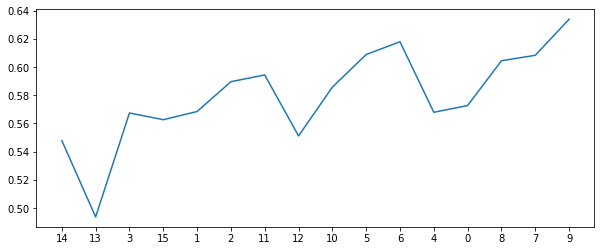

1
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 9, 7, 16]
new features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.65
specificity  0.655316742081448
sensitivity  0.595
auc          0.625158371040724


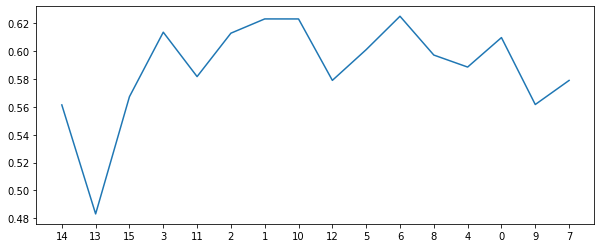

2
all features [14, 13, 3, 1, 2, 11, 15, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 1, 2, 11, 15, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7089285714285715
specificity  0.7265460030165912
sensitivity  0.495
auc          0.6107730015082956


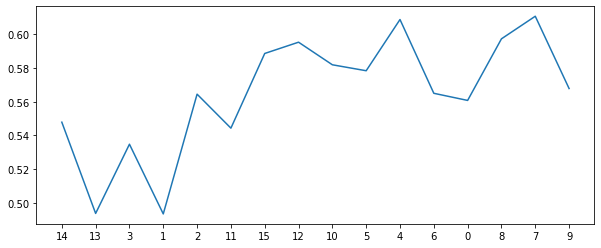

3
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 15, 14, 2]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6875
specificity  0.6995475113122172
sensitivity  0.545
auc          0.6222737556561087


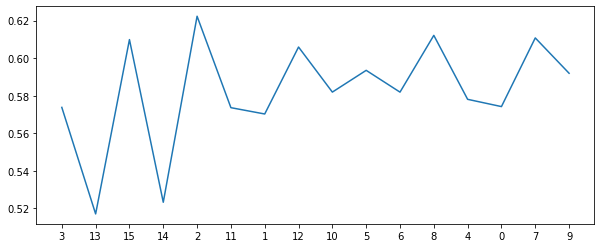

4
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.7017857142857142
specificity  0.7150452488687783
sensitivity  0.54
auc          0.6275226244343891


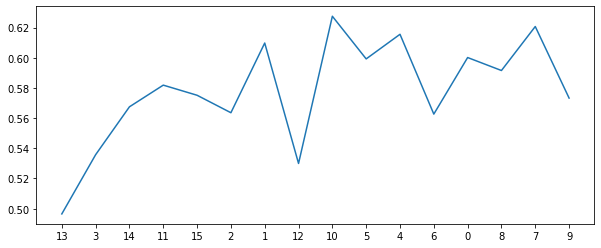

5
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 0, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6957767722473605
sensitivity  0.565
auc          0.6303883861236803


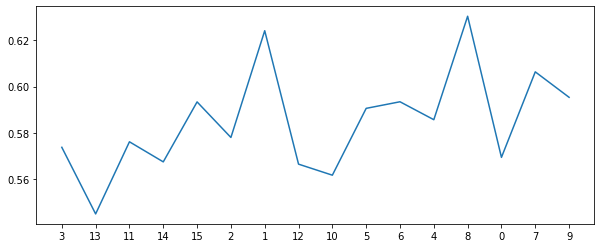

6
all features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6514328808446456
sensitivity  0.62
auc          0.6357164404223228


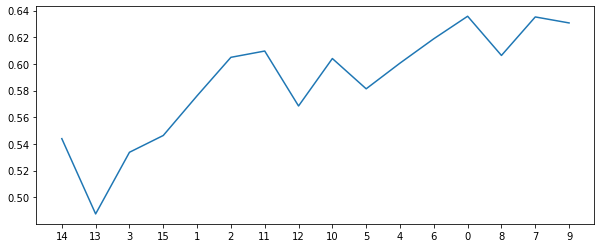

7
all features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 8, 4, 6, 7, 9, 0, 16]
new features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 8, 4, 6, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6148190045248869
sensitivity  0.74
auc          0.6774095022624435


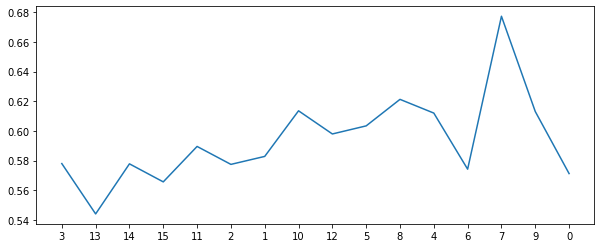

8
all features [14, 3, 13, 2, 15, 11, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [14, 3, 13, 2, 15, 11, 1, 12]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6842006033182504
sensitivity  0.595
auc          0.6396003016591252


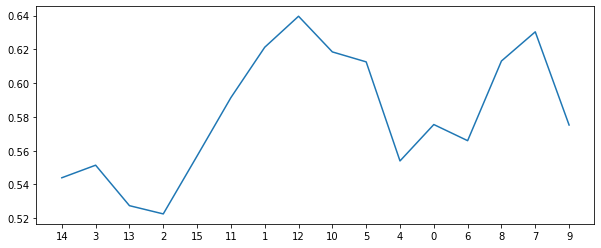

9
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6186651583710407
sensitivity  0.685
auc          0.6518325791855203


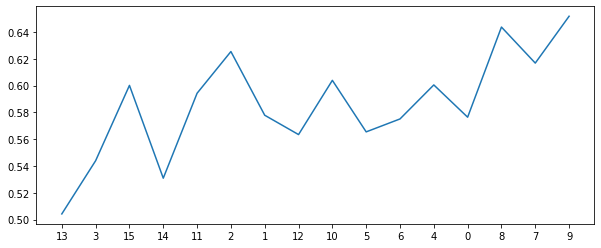

10
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.675
specificity  0.6822398190045249
sensitivity  0.595
auc          0.6386199095022624


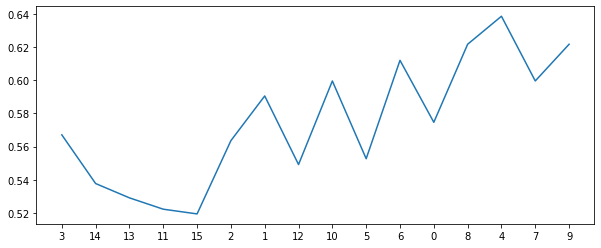

11
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6629713423831071
sensitivity  0.59
auc          0.6264856711915535


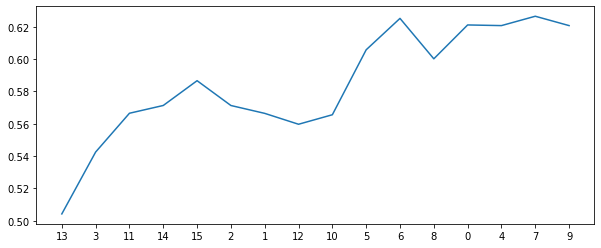

12
all features [13, 14, 3, 15, 12, 11, 1, 2, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 12, 11, 1, 2, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6283182503770739
sensitivity  0.64
auc          0.6341591251885369


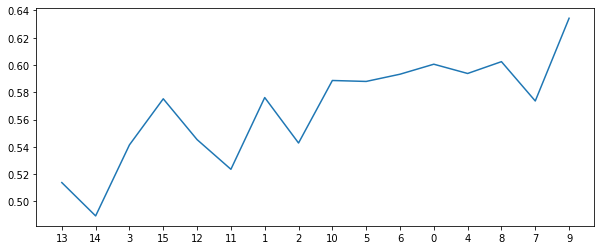

13
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [14, 3, 13, 15, 11]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5762443438914028
sensitivity  0.695
auc          0.6356221719457014


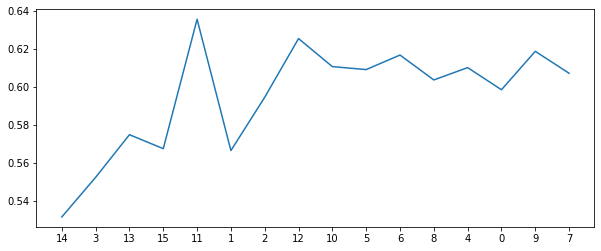

14
all features [3, 14, 13, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 1, 11, 2, 12]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6625
specificity  0.6590497737556561
sensitivity  0.715
auc          0.687024886877828


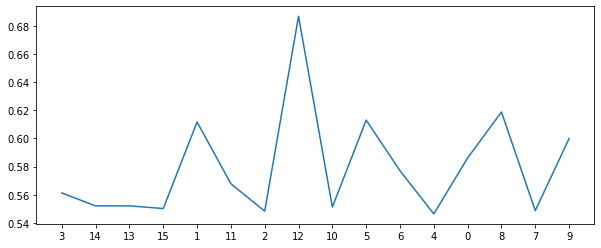

15
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5956259426847662
sensitivity  0.645
auc          0.6203129713423831


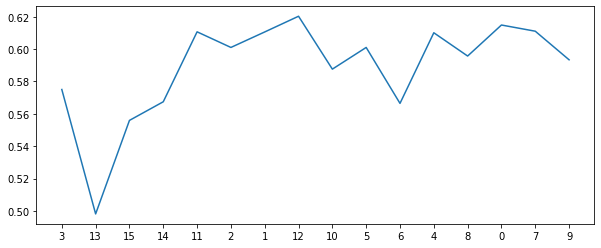

16
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.655316742081448
sensitivity  0.67
auc          0.662658371040724


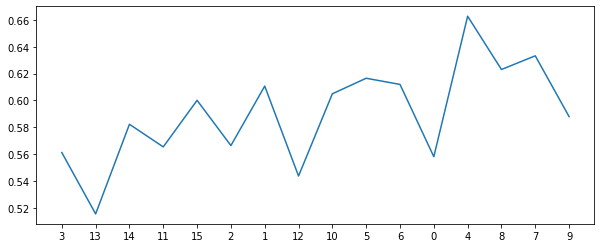

17
all features [13, 3, 11, 15, 14, 2, 12, 1, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 12, 1]
[0.4, 2, 1000, 1, 0, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6185897435897436
sensitivity  0.69
auc          0.6542948717948718


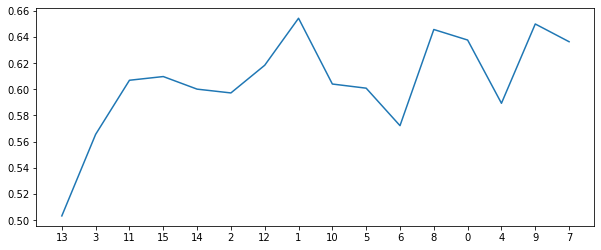

18
all features [14, 13, 3, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 1, 15, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6875
specificity  0.695814479638009
sensitivity  0.59
auc          0.6429072398190046


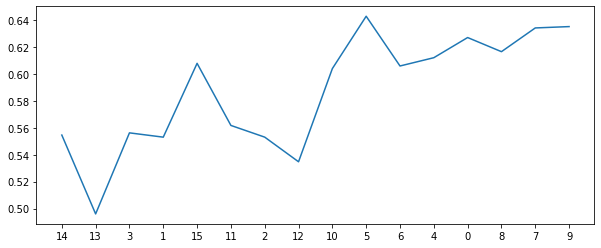

19
all features [14, 3, 13, 11, 15, 2, 1, 10, 12, 5, 6, 8, 4, 7, 0, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 10, 12, 5, 6, 8, 4, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.6995475113122172
sensitivity  0.59
auc          0.6447737556561086


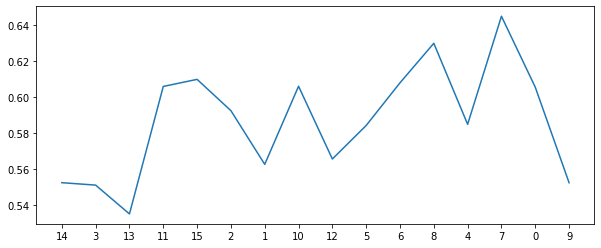

20
all features [14, 3, 13, 2, 1, 15, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 2, 1, 15, 11, 12]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.7035714285714286
specificity  0.7150075414781297
sensitivity  0.57
auc          0.6425037707390648


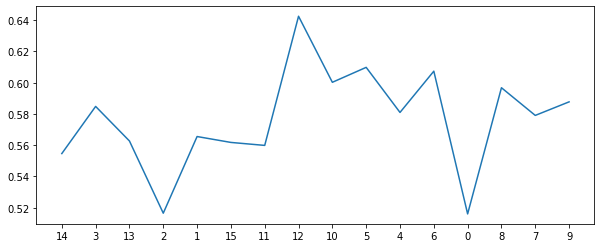

21
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6475113122171946
sensitivity  0.665
auc          0.6562556561085973


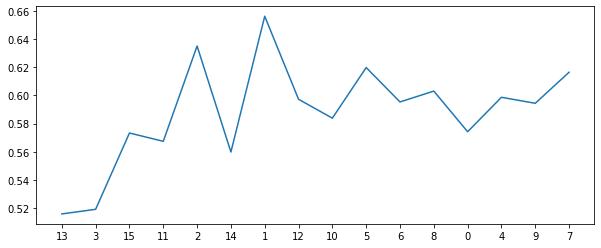

22
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7053571428571429
specificity  0.7168929110105581
sensitivity  0.57
auc          0.643446455505279


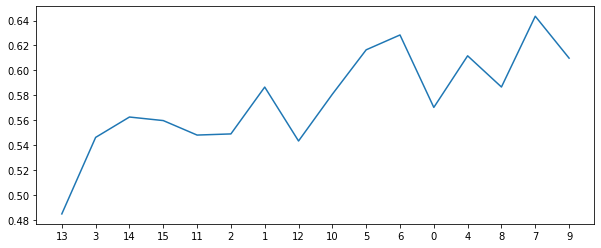

23
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7016214177978884
sensitivity  0.565
auc          0.6333107088989443


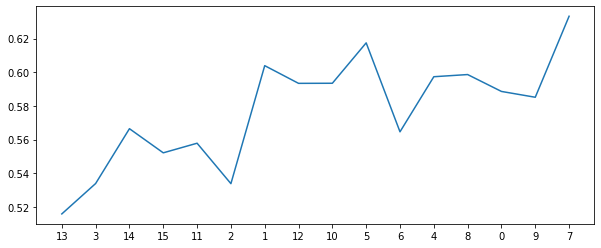

24
all features [14, 13, 3, 11, 1, 15, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 11, 1, 15, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6625
specificity  0.6687782805429864
sensitivity  0.59
auc          0.6293891402714932


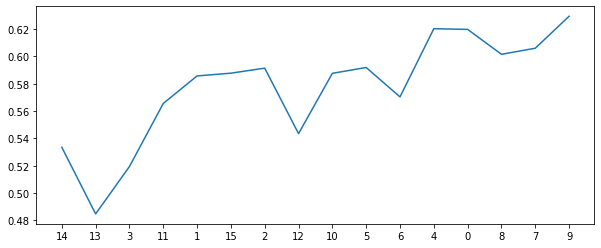

25
all features [14, 3, 13, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 7, 0, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6
specificity  0.5956259426847662
sensitivity  0.665
auc          0.6303129713423832


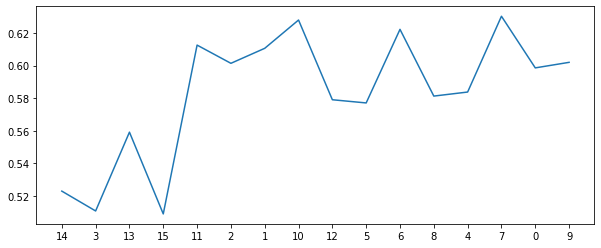

26
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6392857142857143
specificity  0.6437782805429865
sensitivity  0.595
auc          0.6193891402714932


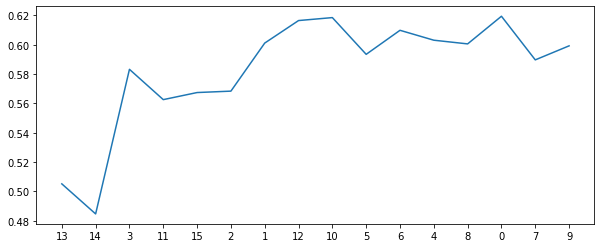

27
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 0, 6, 8, 4, 9, 7, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 0, 6, 8]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6535444947209653
sensitivity  0.67
auc          0.6617722473604827


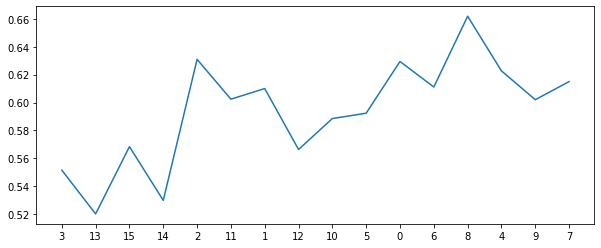

28
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6803544494720966
sensitivity  0.565
auc          0.6226772247360483


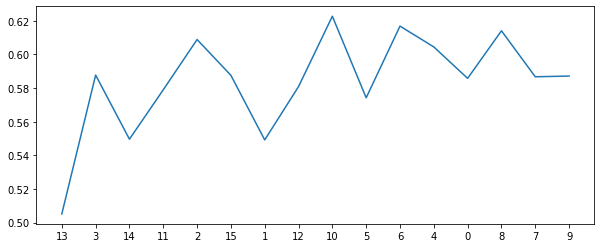

29
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6553544494720965
sensitivity  0.66
auc          0.6576772247360483


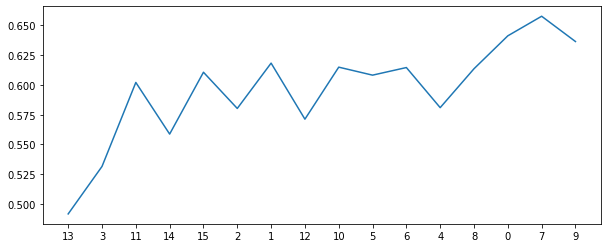

30
all features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6375
specificity  0.6342383107088989
sensitivity  0.685
auc          0.6596191553544495


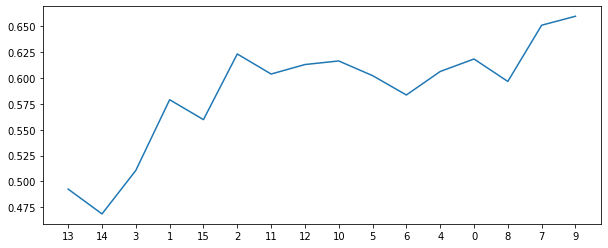

31
all features [15, 13, 14, 3, 2, 11, 1, 10, 12, 5, 6, 8, 4, 9, 0, 7, 16]
new features [15, 13, 14, 3, 2, 11, 1, 10]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5550904977375566
sensitivity  0.74
auc          0.6475452488687783


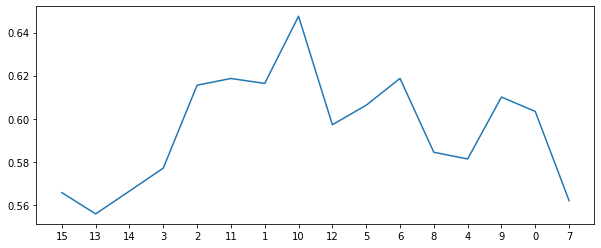

32
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6207390648567119
sensitivity  0.64
auc          0.6303695324283559


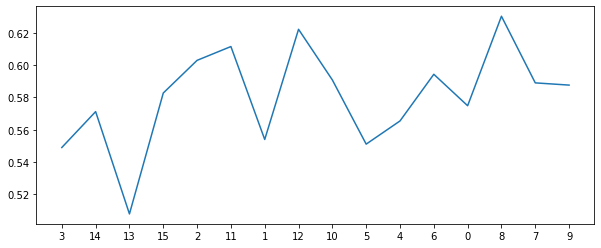

33
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5464285714285715
specificity  0.5318250377073906
sensitivity  0.745
auc          0.6384125188536953


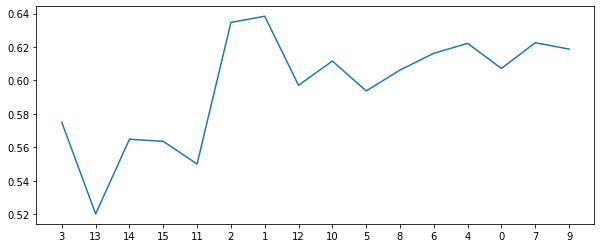

34
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6476244343891403
sensitivity  0.64
auc          0.6438122171945702


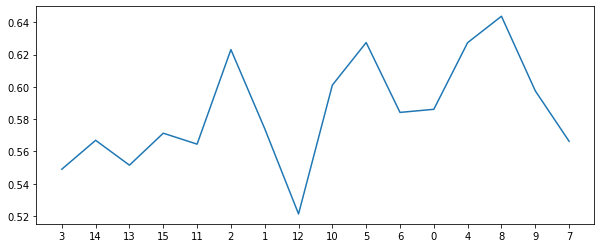

35
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 1, 0, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5744343891402715
sensitivity  0.785
auc          0.6797171945701357


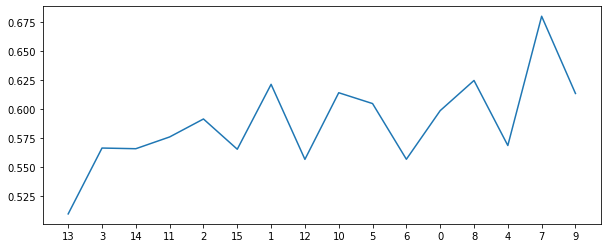

36
all features [14, 3, 13, 1, 15, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [14, 3, 13, 1, 15, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.7160714285714286
specificity  0.7305052790346908
sensitivity  0.54
auc          0.6352526395173453


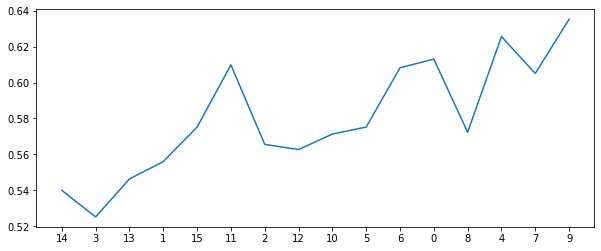

37
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6611236802413273
sensitivity  0.59
auc          0.6255618401206636


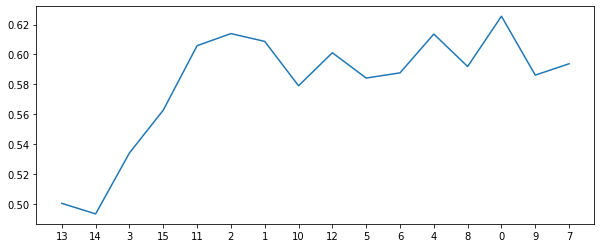

38
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.7035714285714286
specificity  0.7169683257918552
sensitivity  0.545
auc          0.6309841628959276


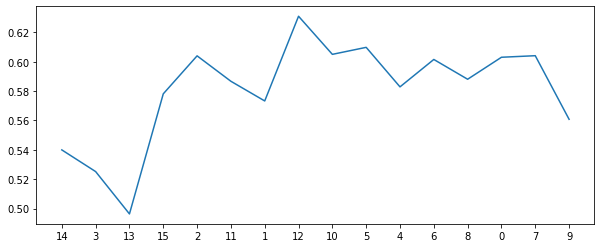

39
all features [3, 13, 15, 11, 14, 2, 1, 10, 12, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 10, 12, 5, 0, 4, 6, 8]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7015082956259426
sensitivity  0.57
auc          0.6357541478129713


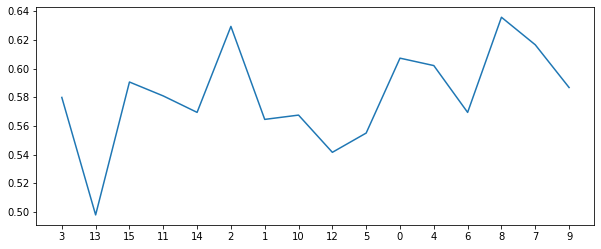

40
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6875
specificity  0.6996229260935143
sensitivity  0.545
auc          0.6223114630467571


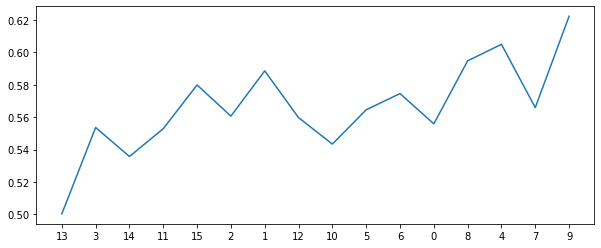

41
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6803571428571429
specificity  0.6899321266968326
sensitivity  0.565
auc          0.6274660633484163


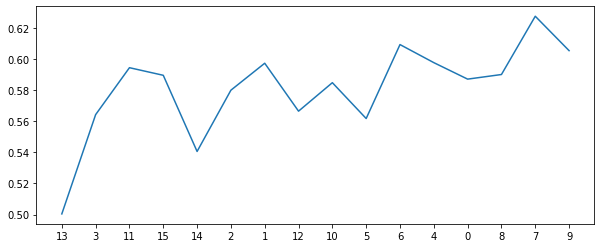

42
all features [14, 13, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6609351432880844
sensitivity  0.64
auc          0.6504675716440422


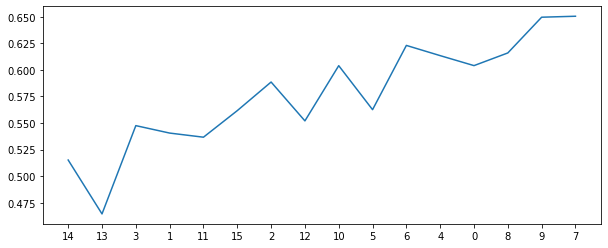

43
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 9, 7, 0, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 9]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.5994343891402715
sensitivity  0.69
auc          0.6447171945701358


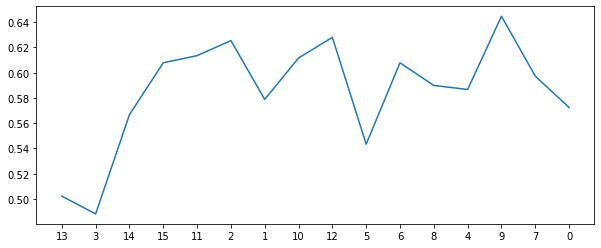

44
all features [14, 13, 3, 2, 15, 1, 11, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 13, 3, 2, 15, 1, 11, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6572398190045249
sensitivity  0.62
auc          0.6386199095022624


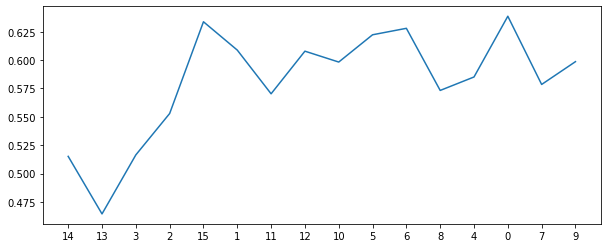

45
all features [3, 13, 2, 15, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [3, 13, 2, 15, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6436651583710407
sensitivity  0.64
auc          0.6418325791855204


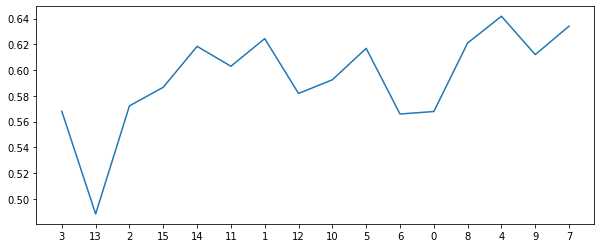

46
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6263574660633484
sensitivity  0.635
auc          0.6306787330316742


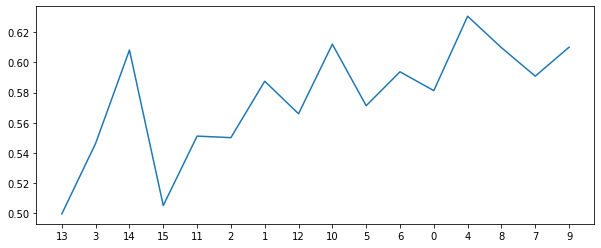

47
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.628393665158371
sensitivity  0.715
auc          0.6716968325791856


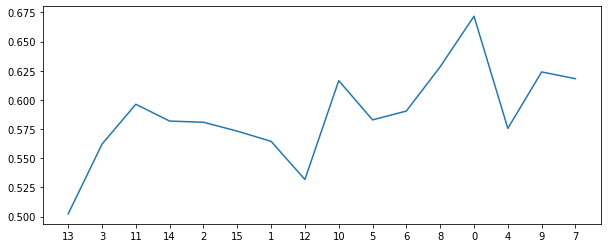

48
all features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6
specificity  0.591553544494721
sensitivity  0.715
auc          0.6532767722473605


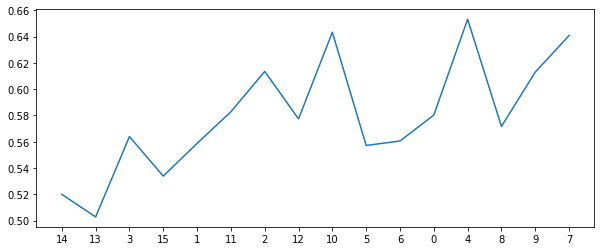

49
all features [3, 14, 15, 13, 11, 2, 1, 10, 12, 5, 6, 8, 4, 9, 0, 7, 16]
new features [3, 14, 15, 13, 11, 2, 1, 10, 12, 5, 6, 8, 4]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5803571428571428
specificity  0.5745475113122172
sensitivity  0.665
auc          0.6197737556561086


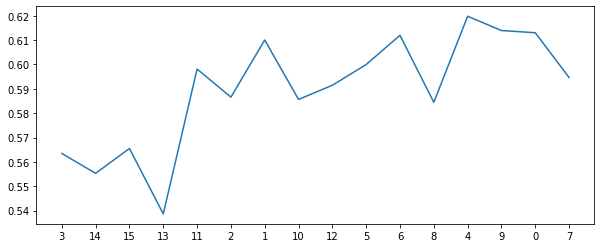

50
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6014705882352941
sensitivity  0.71
auc          0.6557352941176471


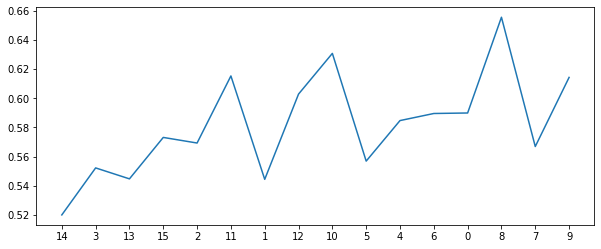

51
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 4, 8, 9, 0, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 4, 8, 9, 0, 7]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.5417420814479638
sensitivity  0.765
auc          0.6533710407239819


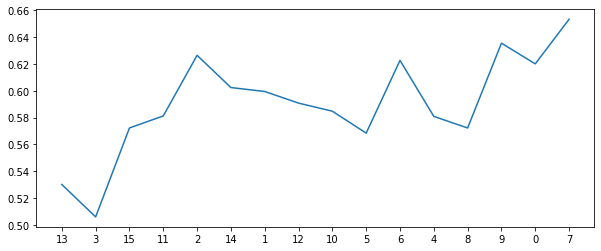

52
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5821428571428572
specificity  0.5704751131221719
sensitivity  0.735
auc          0.652737556561086


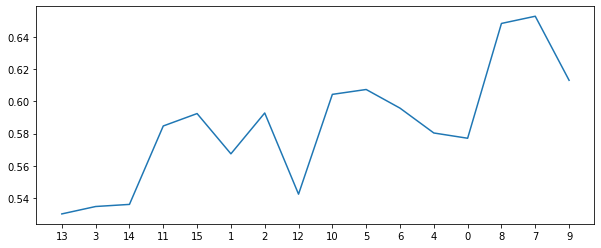

53
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6091628959276019
sensitivity  0.69
auc          0.6495814479638009


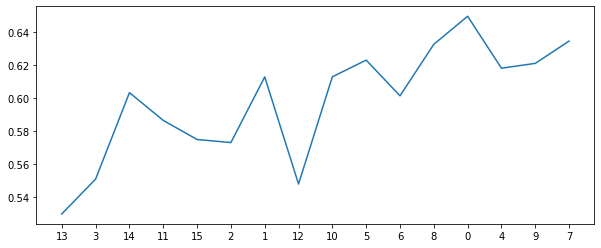

54
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6875
specificity  0.7014705882352942
sensitivity  0.515
auc          0.6082352941176471


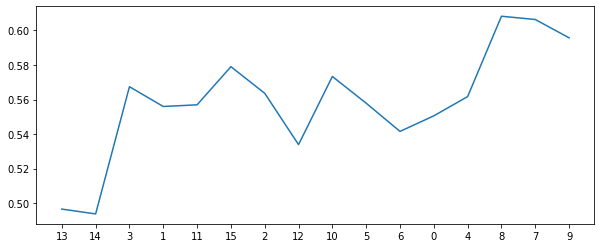

55
all features [13, 14, 3, 11, 15, 1, 2, 10, 12, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 14, 3, 11, 15, 1, 2, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.6996229260935143
sensitivity  0.595
auc          0.6473114630467571


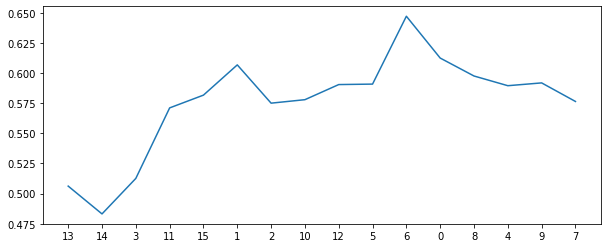

56
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7214285714285714
specificity  0.7401206636500754
sensitivity  0.495
auc          0.6175603318250377


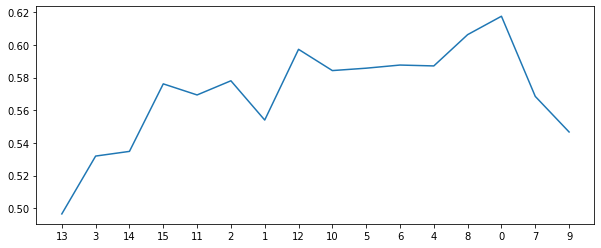

57
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6875
specificity  0.6957013574660633
sensitivity  0.59
auc          0.6428506787330317


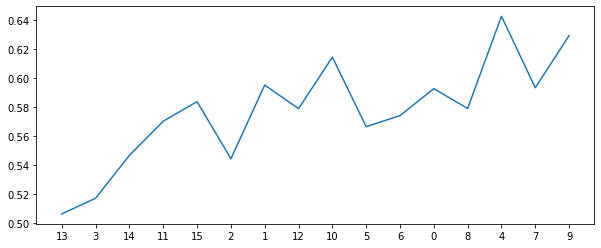

58
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.7017857142857143
specificity  0.7150452488687783
sensitivity  0.545
auc          0.6300226244343892


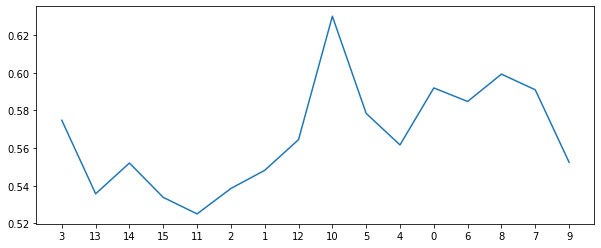

59
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.686236802413273
sensitivity  0.57
auc          0.6281184012066364


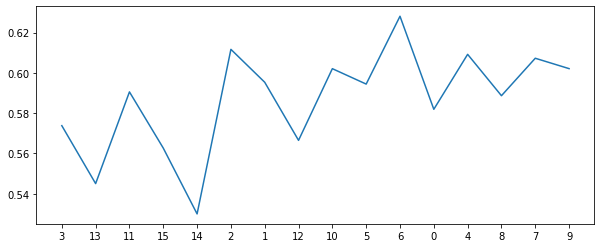

60
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6380090497737556
sensitivity  0.595
auc          0.6165045248868778


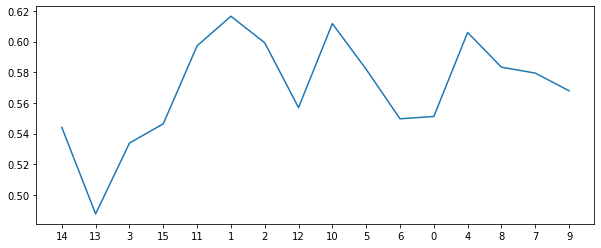

61
all features [13, 14, 3, 11, 15, 1, 2, 10, 12, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 14, 3, 11, 15, 1, 2]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5915912518853695
sensitivity  0.695
auc          0.6432956259426847


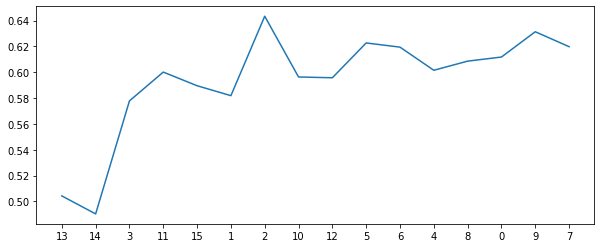

62
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6625
specificity  0.6670060331825037
sensitivity  0.615
auc          0.6410030165912519


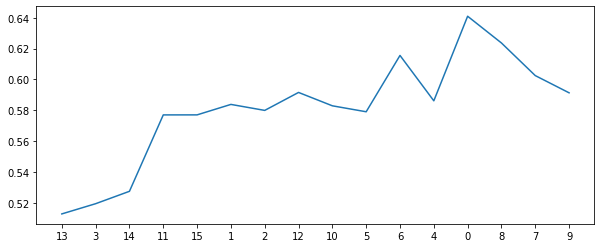

63
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6340497737556561
sensitivity  0.645
auc          0.639524886877828


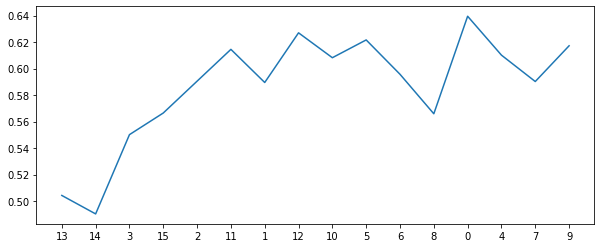

64
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6476244343891403
sensitivity  0.64
auc          0.6438122171945702


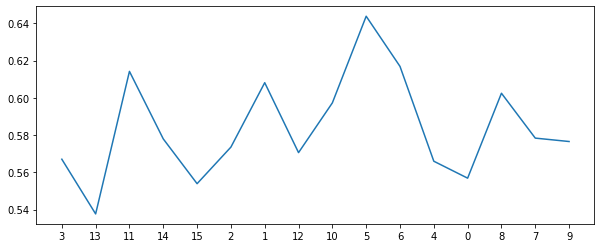

65
all features [3, 13, 11, 15, 14, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 11, 15]
[0.4, 2, 1000, 1, 0, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6417420814479639
sensitivity  0.64
auc          0.6408710407239819


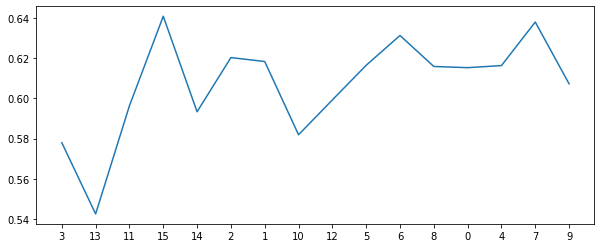

66
all features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5917797888386124
sensitivity  0.69
auc          0.6408898944193062


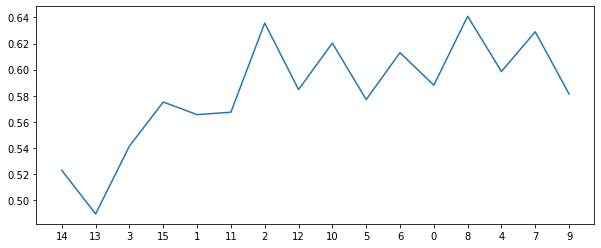

67
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 8, 7, 9, 0, 16]
new features [13, 14, 3, 11, 15]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5762443438914028
sensitivity  0.695
auc          0.6356221719457014


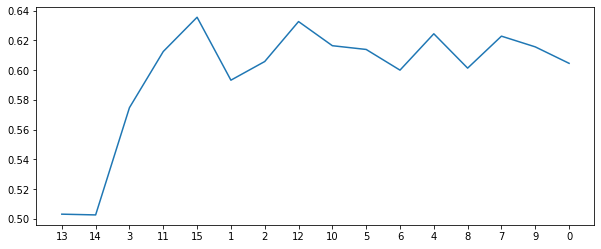

68
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6392857142857142
specificity  0.6418174962292609
sensitivity  0.615
auc          0.6284087481146304


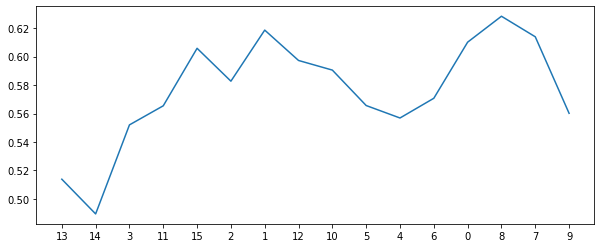

69
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.61289592760181
sensitivity  0.695
auc          0.653947963800905


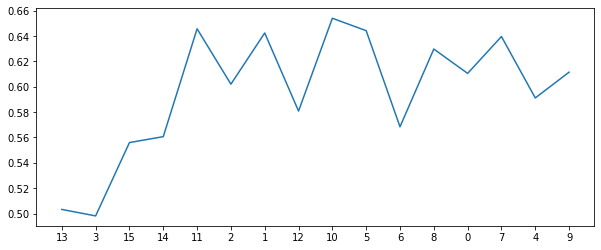

70
all features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.6053167420814479
sensitivity  0.645
auc          0.625158371040724


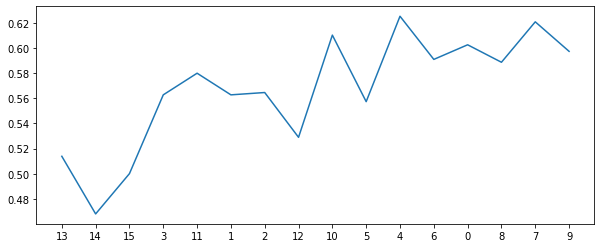

71
all features [13, 3, 11, 2, 14, 15, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 2, 14, 15, 1, 12, 10, 5, 6, 8, 0, 4, 9]
[0.4, 2, 1000, 1, 0, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6264328808446455
sensitivity  0.69
auc          0.6582164404223229


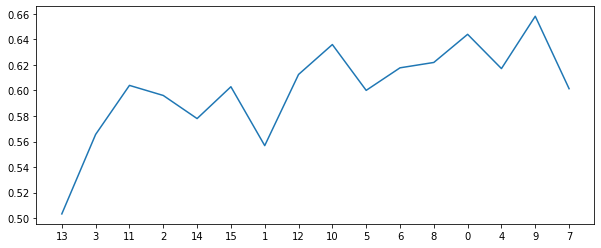

72
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7073152337858221
sensitivity  0.545
auc          0.626157616892911


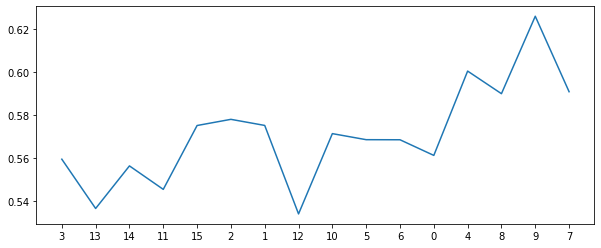

73
all features [13, 14, 3, 15, 1, 11, 2, 10, 12, 5, 6, 4, 8, 9, 0, 7, 16]
new features [13, 14, 3, 15, 1, 11, 2, 10]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6629713423831071
sensitivity  0.595
auc          0.6289856711915535


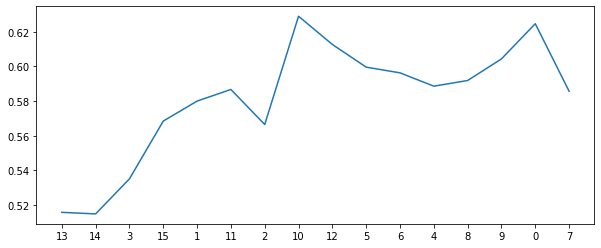

74
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 8]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.725
specificity  0.743815987933635
sensitivity  0.49
auc          0.6169079939668175


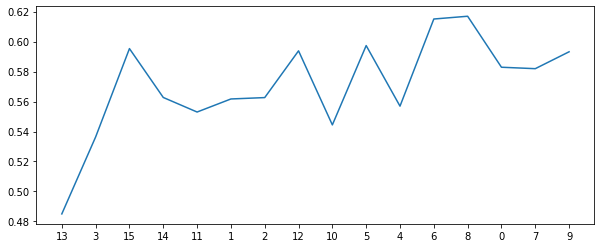

75
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6918552036199095
sensitivity  0.61
auc          0.6509276018099548


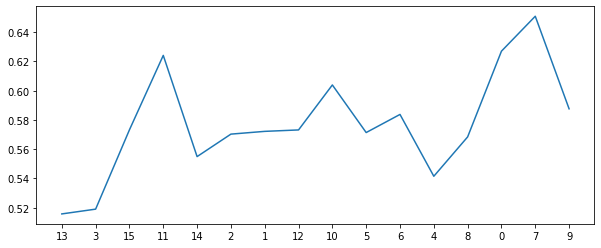

76
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7035714285714285
specificity  0.7149698340874812
sensitivity  0.565
auc          0.6399849170437406


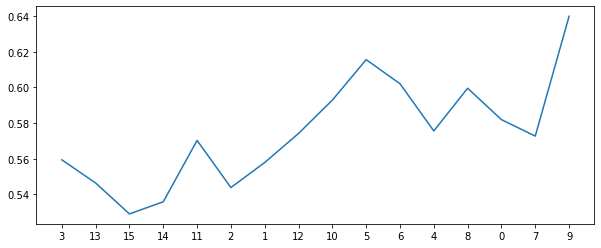

77
all features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.7107142857142857
specificity  0.7226621417797888
sensitivity  0.57
auc          0.6463310708898944


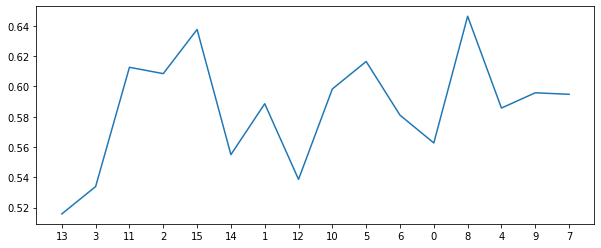

78
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6625
specificity  0.6687405731523379
sensitivity  0.59
auc          0.6293702865761689


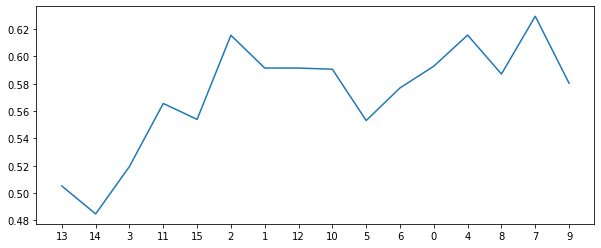

79
all features [13, 14, 3, 11, 15, 1, 2, 10, 12, 5, 6, 8, 4, 7, 9, 0, 16]
new features [13, 14, 3, 11, 15, 1, 2]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6148190045248869
sensitivity  0.67
auc          0.6424095022624434


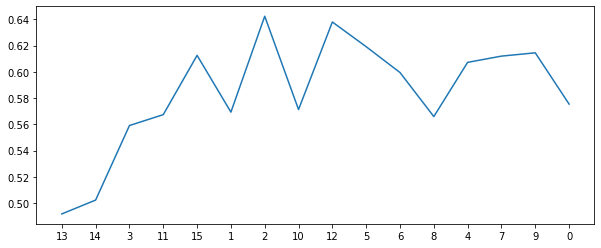

80
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6631221719457013
sensitivity  0.59
auc          0.6265610859728507


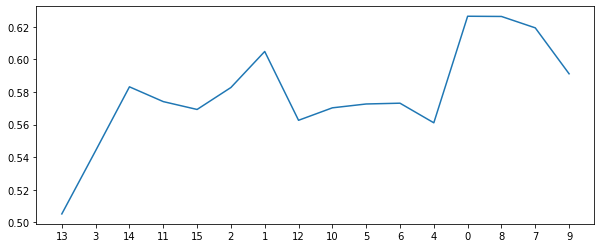

81
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6380467571644042
sensitivity  0.67
auc          0.654023378582202


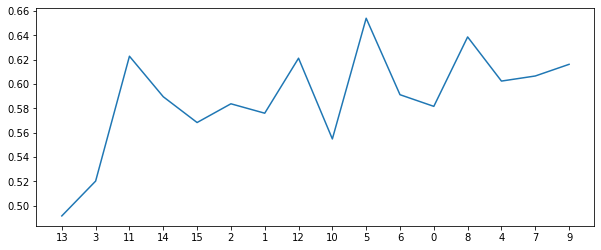

82
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6592383107088989
sensitivity  0.565
auc          0.6121191553544495


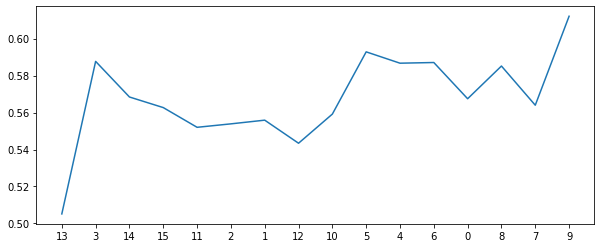

83
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 9, 0, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 9, 0]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6610482654600301
sensitivity  0.635
auc          0.6480241327300151


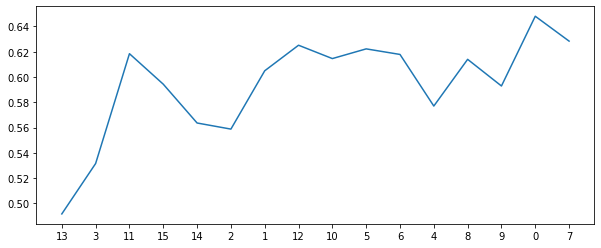

84
all features [14, 3, 13, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.632315233785822
sensitivity  0.615
auc          0.623657616892911


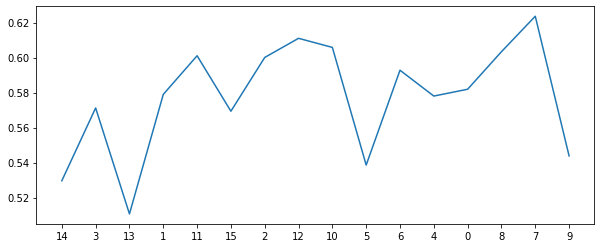

85
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.589894419306184
sensitivity  0.69
auc          0.639947209653092


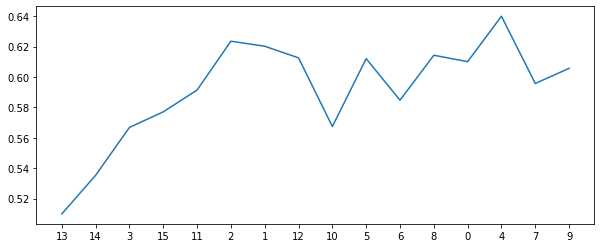

86
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6149321266968326
sensitivity  0.62
auc          0.6174660633484162


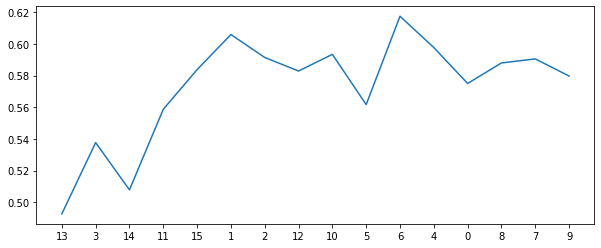

87
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.583974358974359
sensitivity  0.685
auc          0.6344871794871795


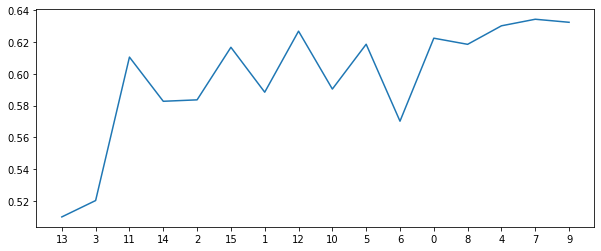

88
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6375
specificity  0.6360105580693816
sensitivity  0.665
auc          0.6505052790346908


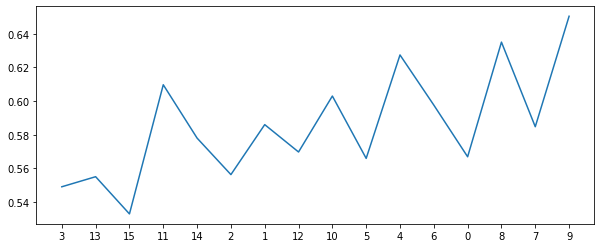

89
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 9, 4, 0, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5820889894419307
sensitivity  0.735
auc          0.6585444947209653


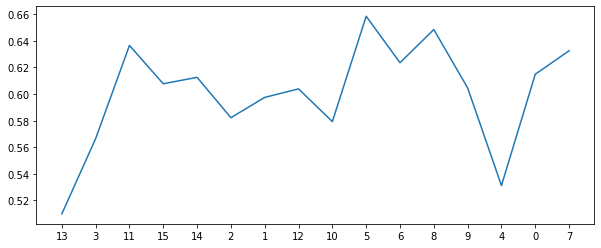

90
all features [14, 13, 3, 11, 2, 15, 1, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [14, 13, 3, 11, 2, 15, 1, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.684238310708899
sensitivity  0.595
auc          0.6396191553544495


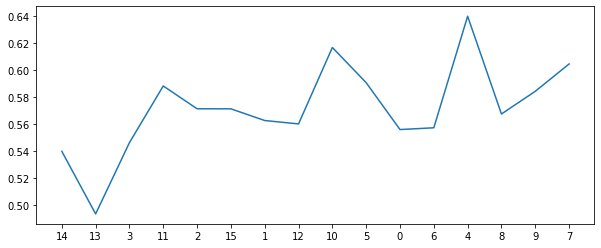

91
all features [13, 14, 3, 11, 15, 1, 2, 10, 12, 5, 6, 8, 4, 0, 9, 7, 16]
new features [13, 14, 3, 11, 15, 1]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.693815987933635
sensitivity  0.545
auc          0.6194079939668174


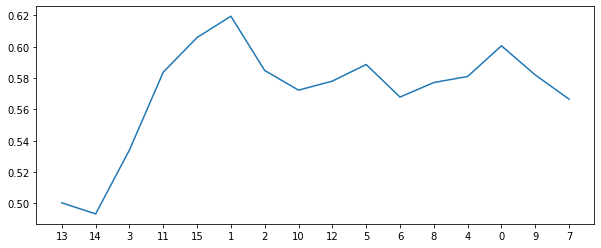

92
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.6976998491704374
sensitivity  0.57
auc          0.6338499245852187


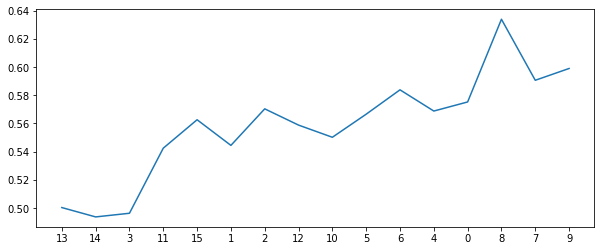

93
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.666892911010558
sensitivity  0.595
auc          0.6309464555052791


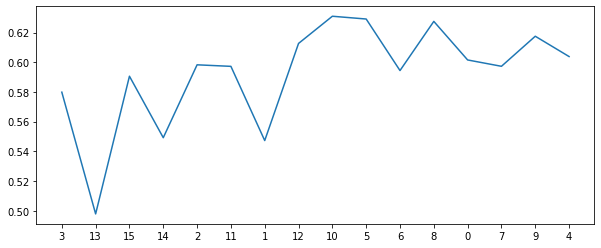

94
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.7071428571428572
specificity  0.7207013574660633
sensitivity  0.535
auc          0.6278506787330317


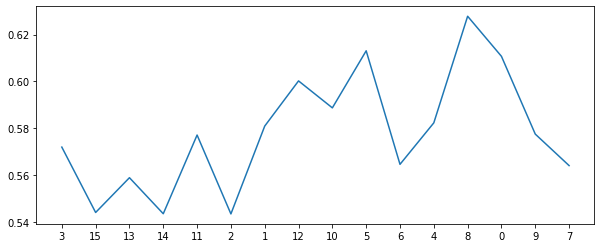

95
all features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 0, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.6899698340874811
sensitivity  0.595
auc          0.6424849170437406


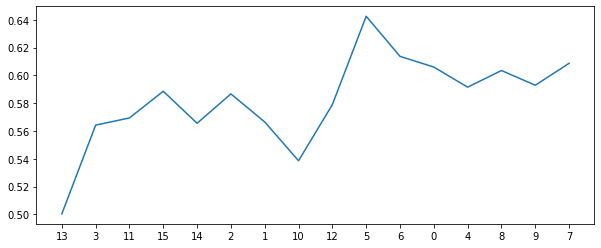

96
all features [3, 11, 14, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 11, 14, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6111613876319759
sensitivity  0.665
auc          0.6380806938159879


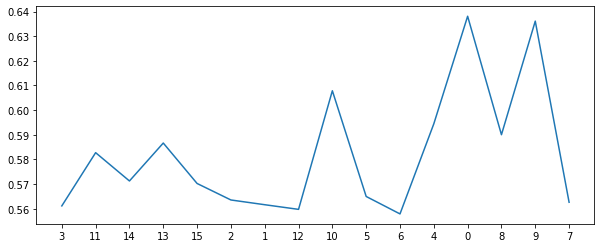

97
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 9, 0, 4, 7, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6033182503770739
sensitivity  0.67
auc          0.636659125188537


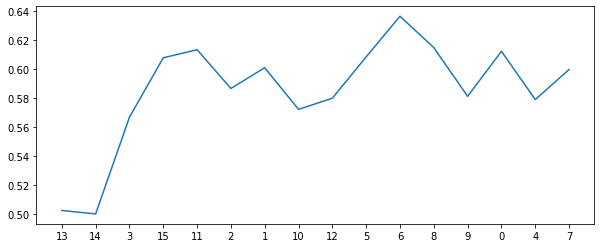

98
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6392857142857142
specificity  0.6435897435897435
sensitivity  0.595
auc          0.6192948717948717


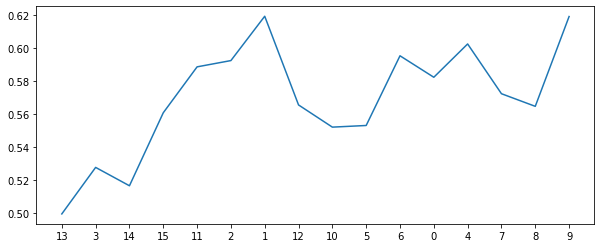

99
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6418929110105581
sensitivity  0.69
auc          0.6659464555052791


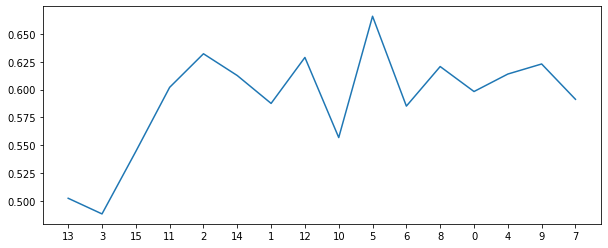

100
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6455128205128206
sensitivity  0.67
auc          0.6577564102564103


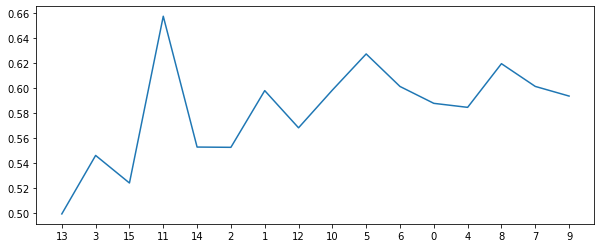

101
all features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 1, 0, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6475867269984917
sensitivity  0.64
auc          0.6437933634992459


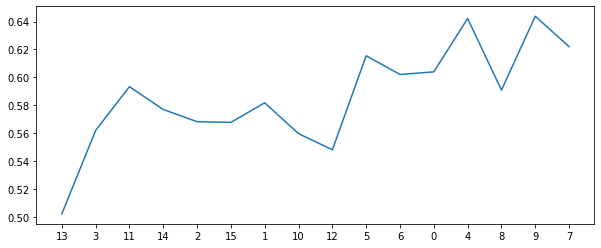

102
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5588989441930619
sensitivity  0.695
auc          0.626949472096531


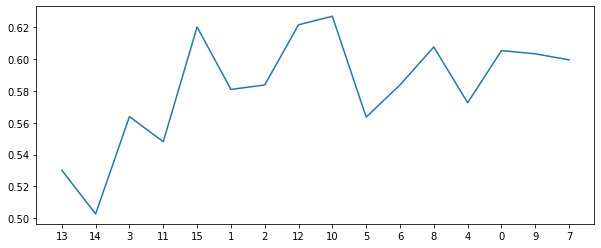

103
all features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5706636500754148
sensitivity  0.72
auc          0.6453318250377074


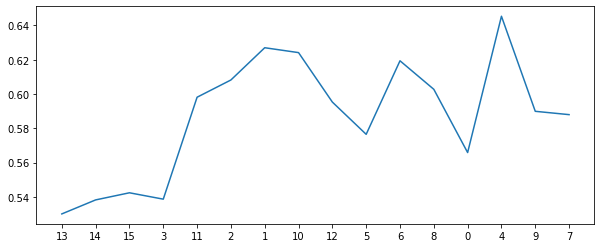

104
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6495852187028658
sensitivity  0.59
auc          0.6197926093514329


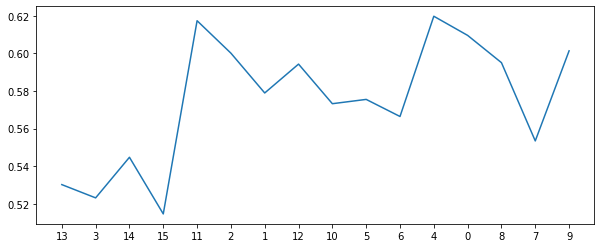

105
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6109351432880845
sensitivity  0.685
auc          0.6479675716440422


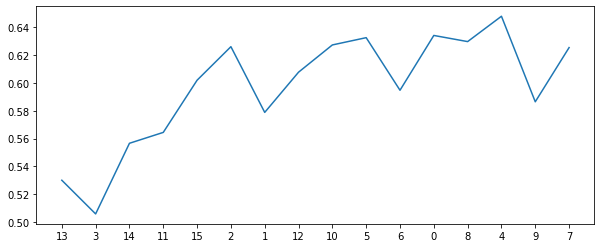

106
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.643815987933635
sensitivity  0.695
auc          0.6694079939668175


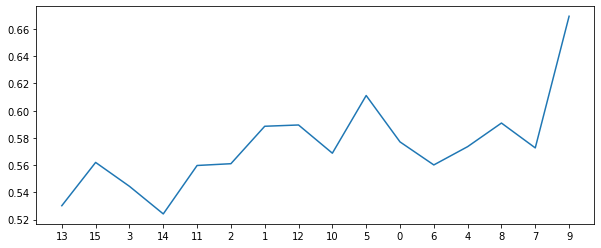

107
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 1, 0, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.5974358974358974
sensitivity  0.735
auc          0.6662179487179487


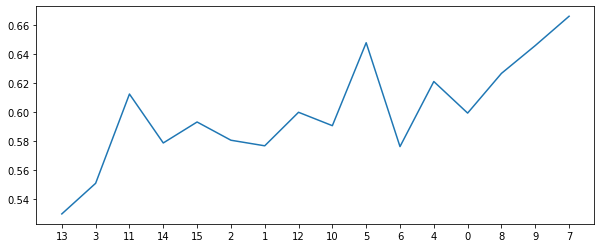

108
all features [3, 14, 13, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [3, 14, 13, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.7178571428571429
specificity  0.7323152337858221
sensitivity  0.545
auc          0.638657616892911


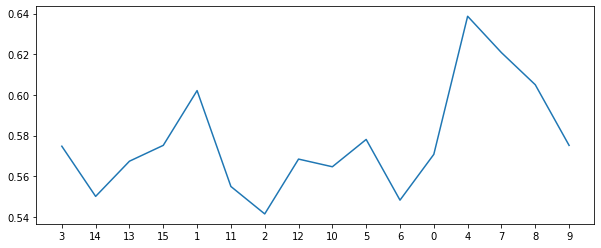

109
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.7017857142857142
specificity  0.7130090497737557
sensitivity  0.565
auc          0.6390045248868779


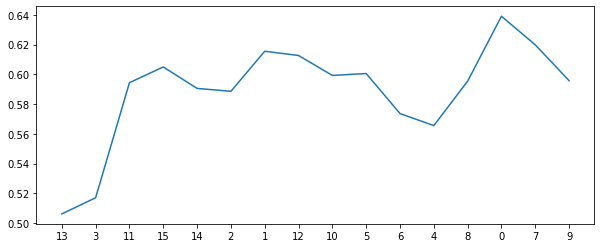

110
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7160714285714286
specificity  0.732315233785822
sensitivity  0.52
auc          0.626157616892911


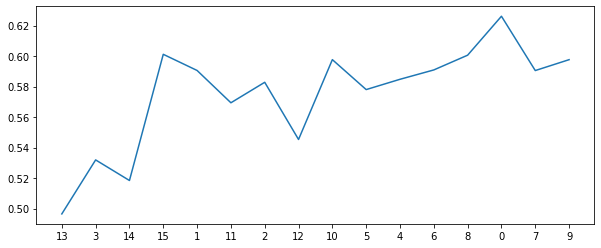

111
all features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 4, 7, 8]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.7092006033182504
sensitivity  0.565
auc          0.6371003016591251


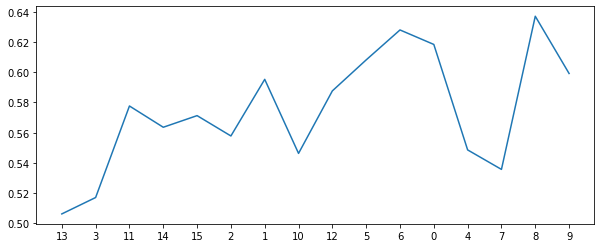

112
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7130844645550528
sensitivity  0.525
auc          0.6190422322775264


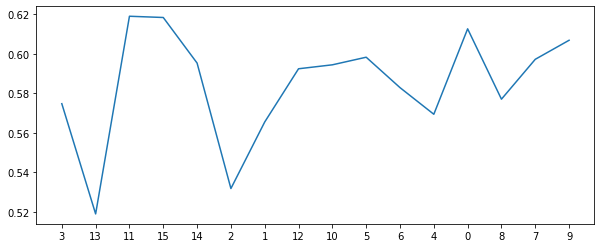

113
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6964285714285714
specificity  0.7052790346907994
sensitivity  0.585
auc          0.6451395173453996


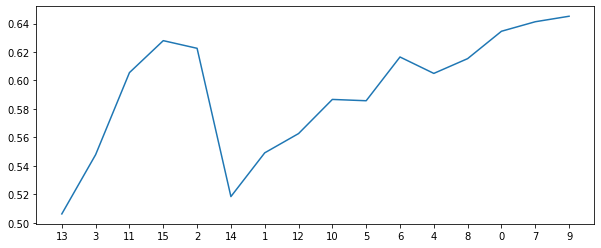

114
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.686236802413273
sensitivity  0.615
auc          0.6506184012066365


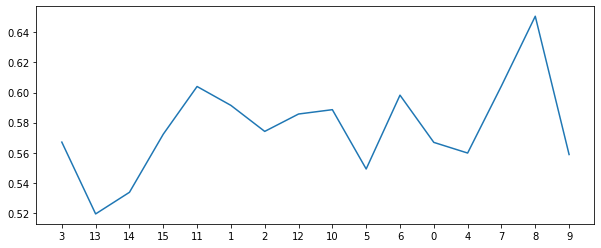

115
all features [13, 3, 15, 14, 11, 1, 2, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 10, 12]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6124999999999999
specificity  0.6091251885369532
sensitivity  0.67
auc          0.6395625942684766


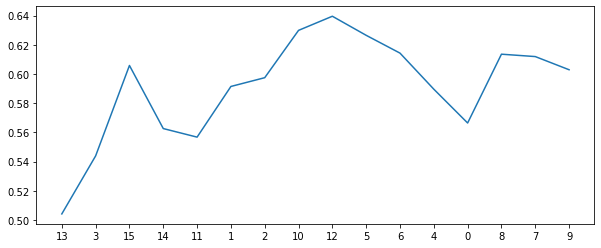

116
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.675
specificity  0.682315233785822
sensitivity  0.595
auc          0.638657616892911


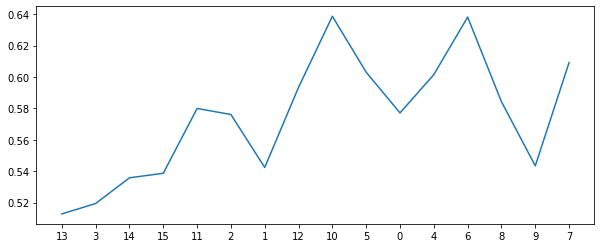

117
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6070889894419307
sensitivity  0.645
auc          0.6260444947209653


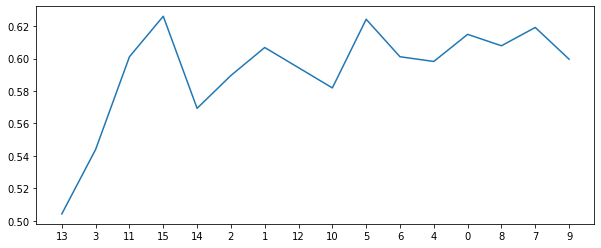

118
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.675
specificity  0.6881221719457014
sensitivity  0.52
auc          0.6040610859728507


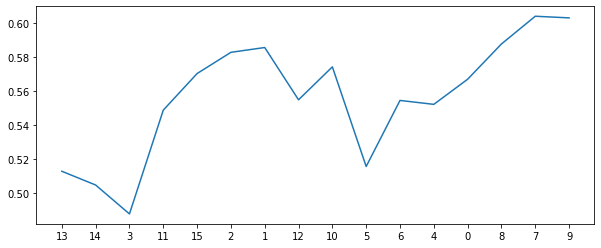

119
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12]
[0.4, 2, 1000, 1, 0, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.63789592760181
sensitivity  0.615
auc          0.626447963800905


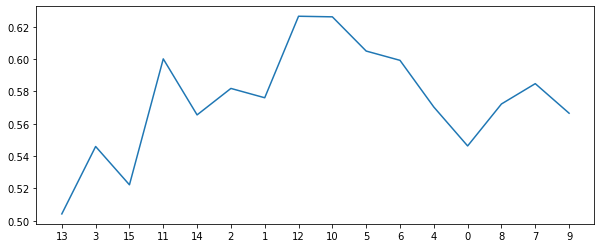

120
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6572398190045249
sensitivity  0.615
auc          0.6361199095022624


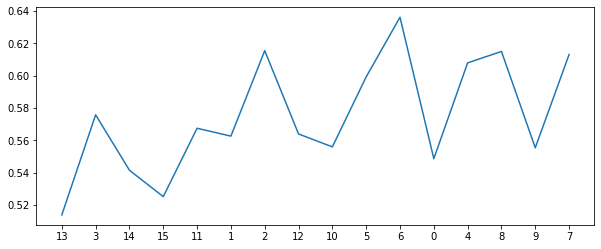

121
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5744343891402715
sensitivity  0.69
auc          0.6322171945701358


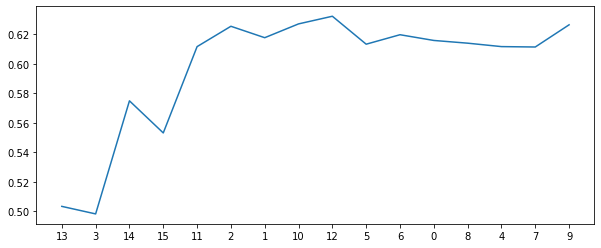

122
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.645739064856712
sensitivity  0.615
auc          0.6303695324283559


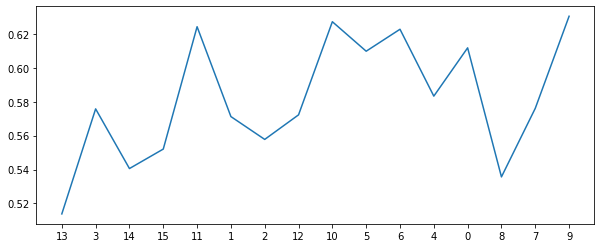

123
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6128205128205129
sensitivity  0.695
auc          0.6539102564102564


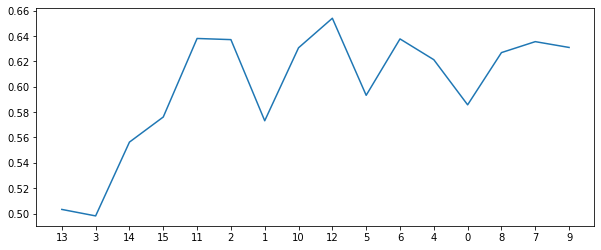

124
all features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.616817496229261
sensitivity  0.59
auc          0.6034087481146304


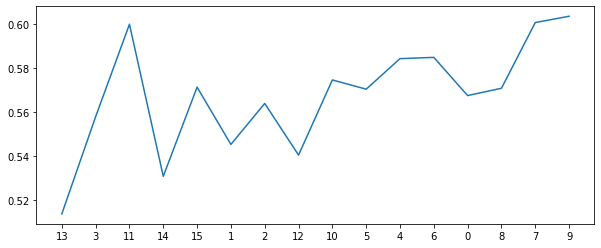

125
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6071266968325792
sensitivity  0.71
auc          0.6585633484162896


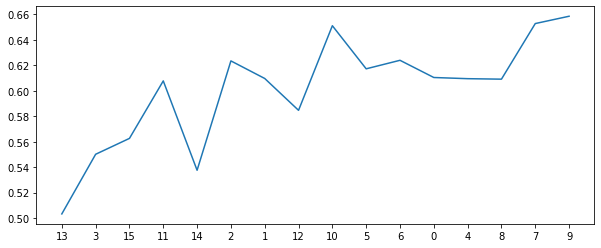

126
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7053544494720965
sensitivity  0.57
auc          0.6376772247360483


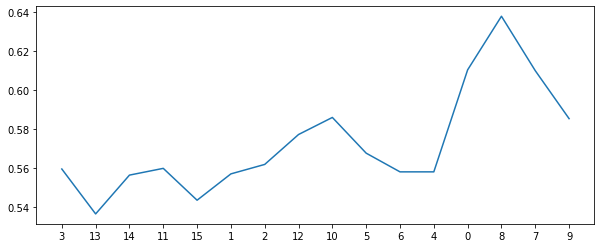

127
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.7017857142857142
specificity  0.7111990950226245
sensitivity  0.59
auc          0.6505995475113122


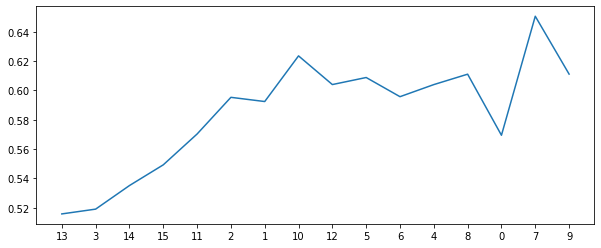

128
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.675
specificity  0.6861990950226244
sensitivity  0.545
auc          0.6155995475113122


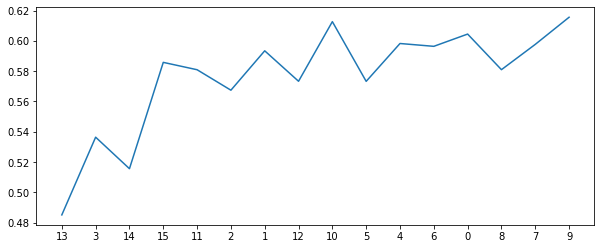

129
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6725867269984918
sensitivity  0.615
auc          0.6437933634992459


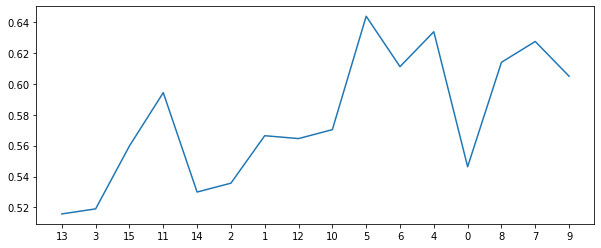

130
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6860482654600302
sensitivity  0.57
auc          0.6280241327300151


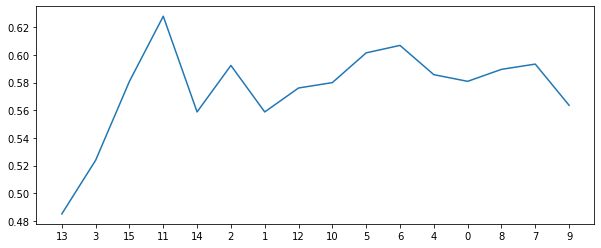

131
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 1, 0, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.7017857142857142
specificity  0.7150075414781297
sensitivity  0.54
auc          0.6275037707390648


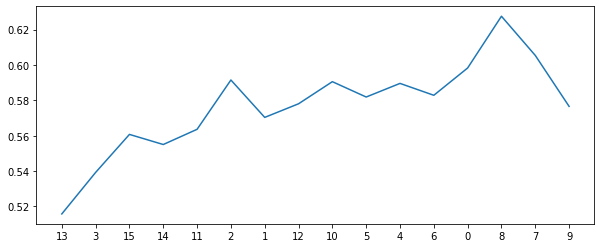

132
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6610105580693816
sensitivity  0.615
auc          0.6380052790346908


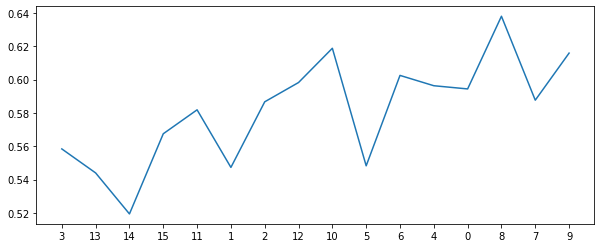

133
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6321644042232277
sensitivity  0.69
auc          0.6610822021116138


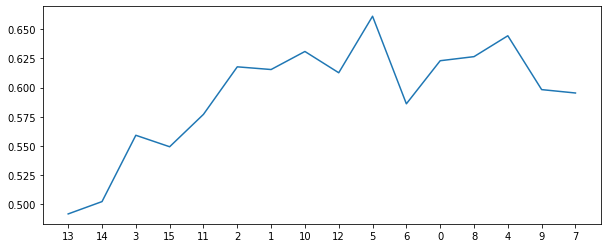

134
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6392857142857142
specificity  0.6476621417797889
sensitivity  0.54
auc          0.5938310708898944


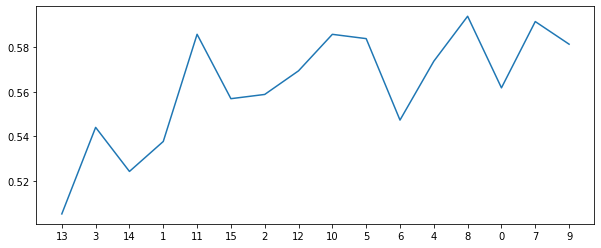

135
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6494720965309201
sensitivity  0.62
auc          0.63473604826546


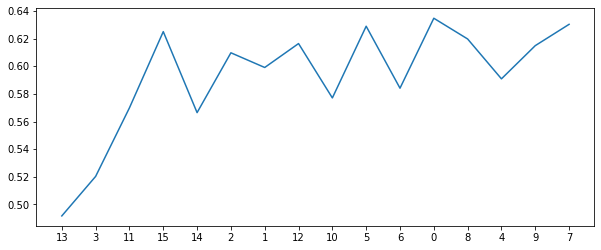

136
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6803921568627451
sensitivity  0.515
auc          0.5976960784313725


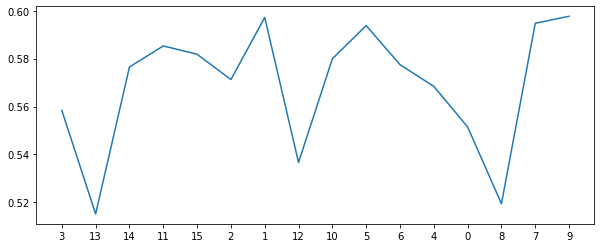

137
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6706636500754148
sensitivity  0.64
auc          0.6553318250377074


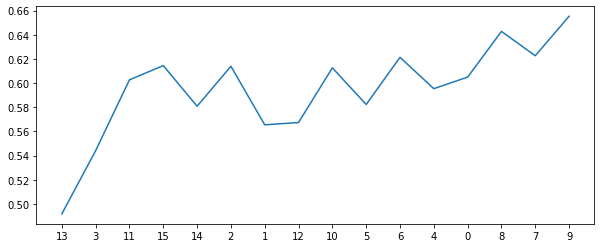

138
all features [3, 14, 11, 13, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6071266968325792
sensitivity  0.635
auc          0.6210633484162895


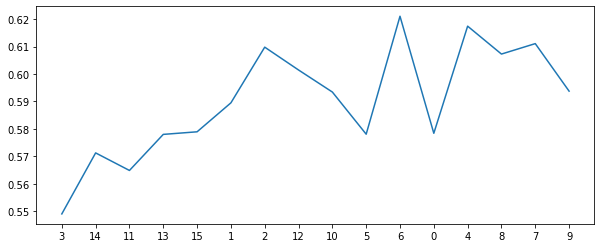

139
all features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 10]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5686651583710407
sensitivity  0.71
auc          0.6393325791855203


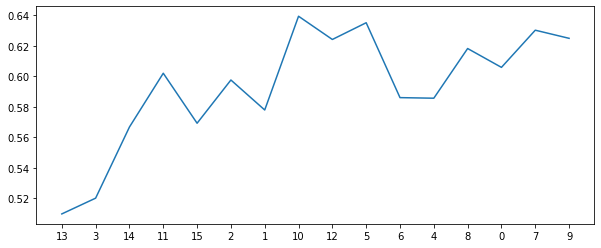

140
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6167797888386124
sensitivity  0.64
auc          0.6283898944193061


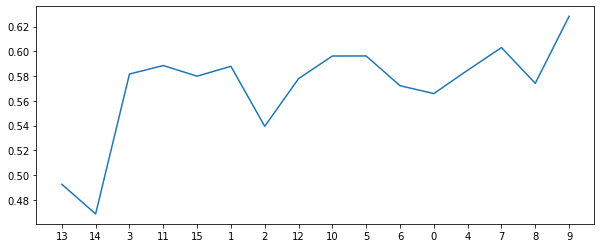

141
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 6, 5, 0, 4, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6110105580693816
sensitivity  0.69
auc          0.6505052790346908


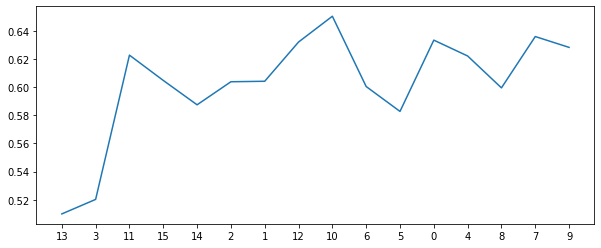

142
all features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 4, 6, 8, 0, 7]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6534690799396682
sensitivity  0.54
auc          0.596734539969834


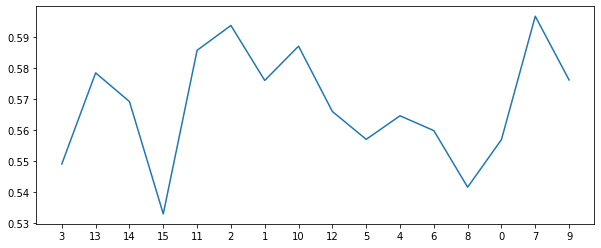

143
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 1, 0, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6283182503770739
sensitivity  0.645
auc          0.636659125188537


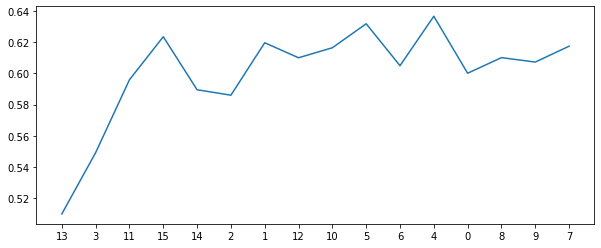

144
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.7142857142857143
specificity  0.7245475113122172
sensitivity  0.59
auc          0.6572737556561086


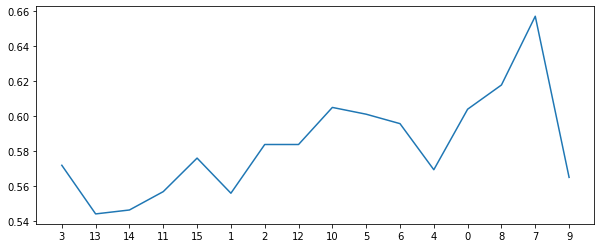

145
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6342006033182503
sensitivity  0.595
auc          0.6146003016591252


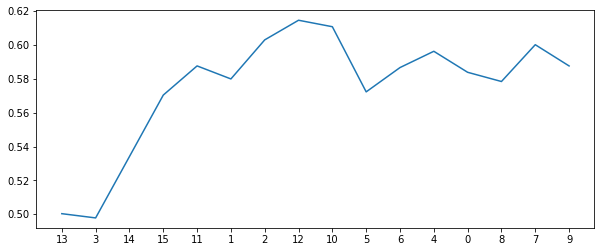

146
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.7107142857142857
specificity  0.7284313725490196
sensitivity  0.495
auc          0.6117156862745098


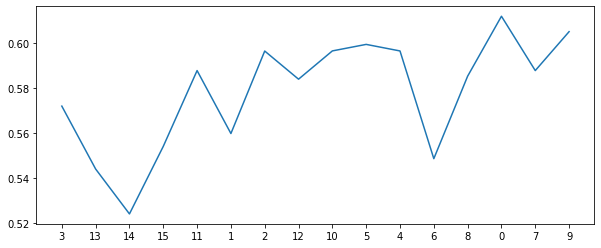

147
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.7035714285714286
specificity  0.7130844645550528
sensitivity  0.595
auc          0.6540422322775263


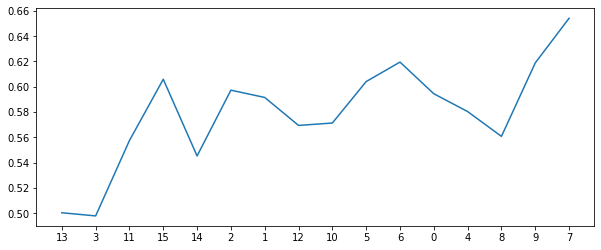

148
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6875
specificity  0.6996229260935143
sensitivity  0.54
auc          0.6198114630467572


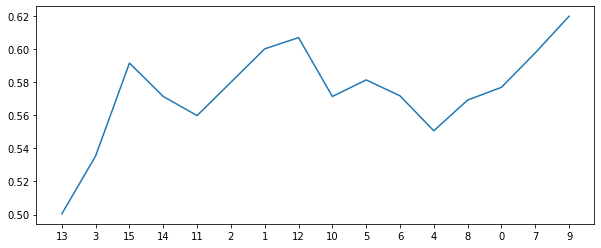

149
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.703393665158371
sensitivity  0.565
auc          0.6341968325791855


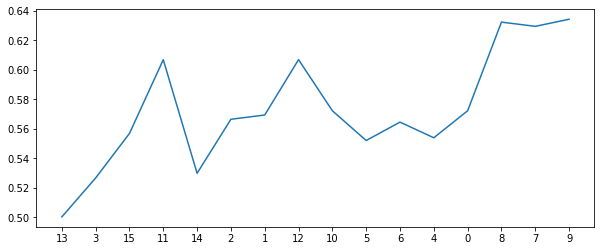

150
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6745475113122172
sensitivity  0.615
auc          0.6447737556561086


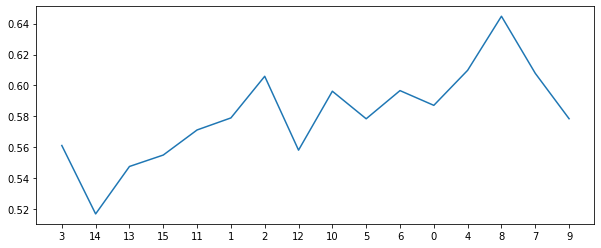

151
all features [13, 14, 3, 11, 15, 2, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4, 16]
new features [13, 14, 3, 11, 15, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6476244343891403
sensitivity  0.615
auc          0.6313122171945701


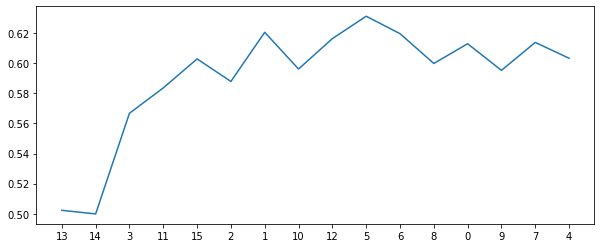

152
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6610105580693816
sensitivity  0.59
auc          0.6255052790346908


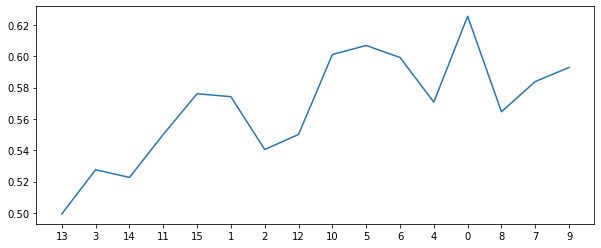

153
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6226621417797888
sensitivity  0.69
auc          0.6563310708898944


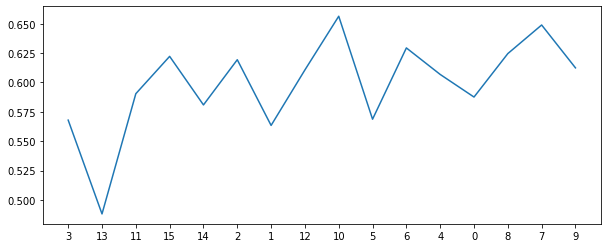

154
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.657315233785822
sensitivity  0.54
auc          0.598657616892911


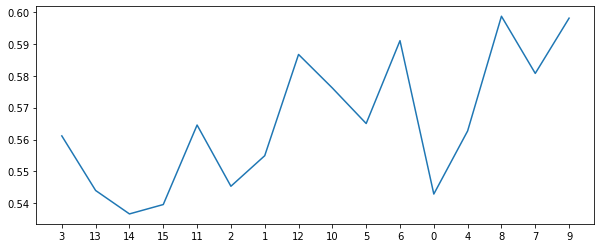

155
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6629336349924585
sensitivity  0.615
auc          0.6389668174962293


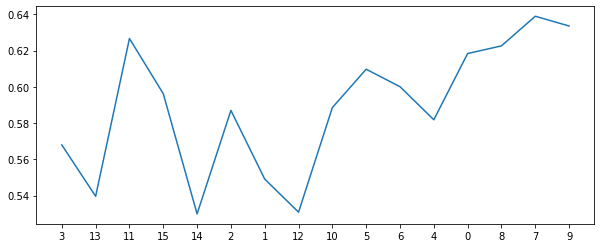

156
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6147058823529412
sensitivity  0.66
auc          0.6373529411764706


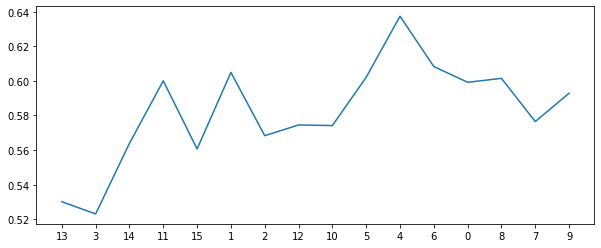

157
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5820889894419307
sensitivity  0.695
auc          0.6385444947209653


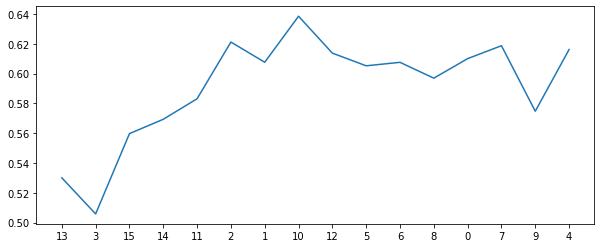

158
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6071644042232277
sensitivity  0.71
auc          0.6585822021116139


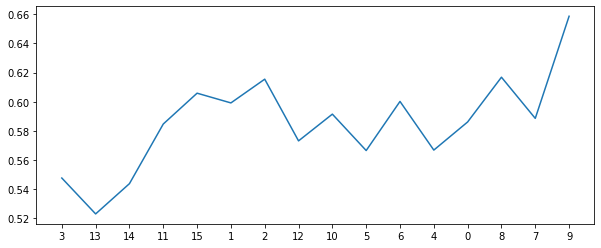

159
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5648190045248869
sensitivity  0.74
auc          0.6524095022624434


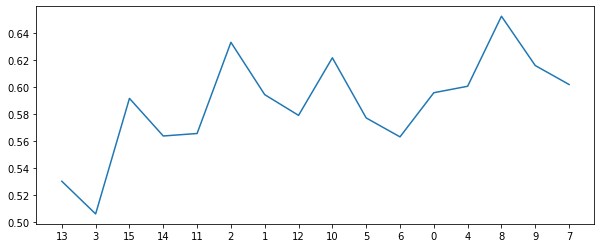

160
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.622473604826546
sensitivity  0.62
auc          0.621236802413273


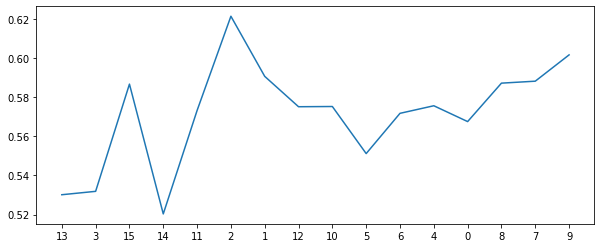

161
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 4, 6, 8, 0, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12]
[0.4, 2, 1000, 1, 0, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.572473604826546
sensitivity  0.695
auc          0.633736802413273


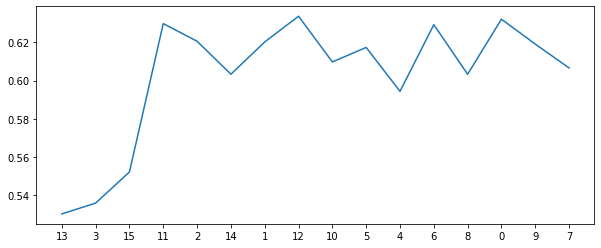

162
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6880090497737557
sensitivity  0.61
auc          0.6490045248868779


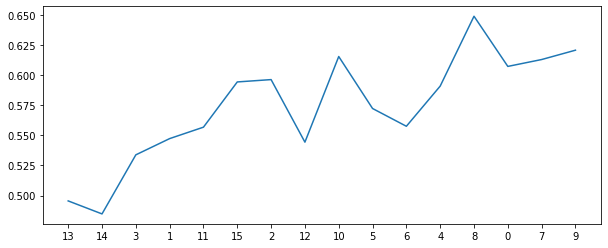

163
all features [3, 13, 14, 15, 2, 1, 11, 10, 12, 5, 8, 4, 6, 0, 9, 7, 16]
new features [3, 13, 14, 15, 2, 1, 11, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.664894419306184
sensitivity  0.57
auc          0.617447209653092


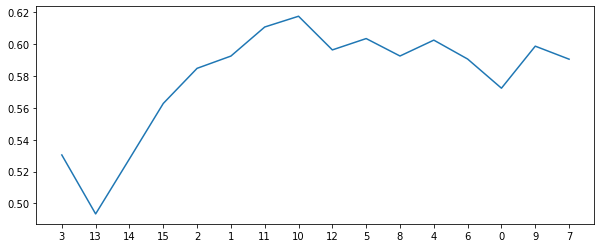

164
all features [13, 14, 1, 3, 15, 2, 11, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 1, 3, 15, 2, 11, 12, 10, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7
specificity  0.7131221719457014
sensitivity  0.545
auc          0.6290610859728507


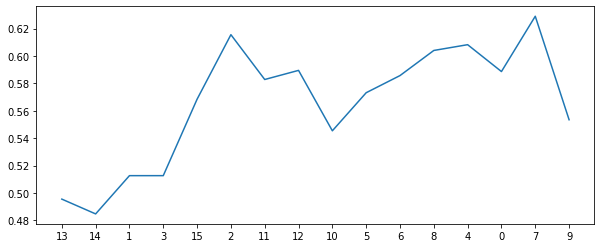

165
all features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 8, 7, 0, 4, 9, 16]
new features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6860859728506787
sensitivity  0.59
auc          0.6380429864253393


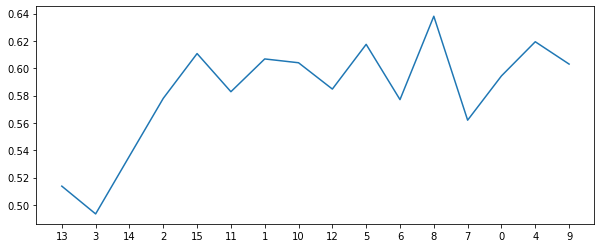

166
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 8, 4, 0, 6, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 8, 4, 0, 6, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6919683257918552
sensitivity  0.57
auc          0.6309841628959276


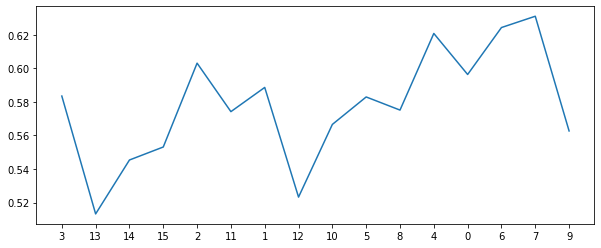

167
all features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 0, 9, 4, 7, 16]
new features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 0, 9, 4]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6875
specificity  0.6975867269984917
sensitivity  0.565
auc          0.6312933634992459


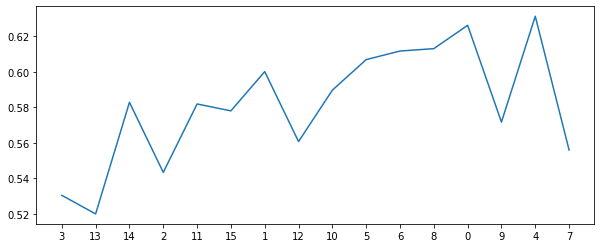

168
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6515082956259427
sensitivity  0.66
auc          0.6557541478129714


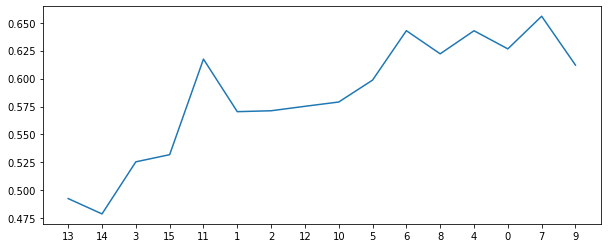

169
all features [13, 14, 3, 15, 2, 11, 1, 10, 12, 5, 8, 6, 7, 9, 4, 0, 16]
new features [13, 14, 3, 15, 2, 11, 1, 10, 12, 5, 8, 6]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6455505279034691
sensitivity  0.61
auc          0.6277752639517346


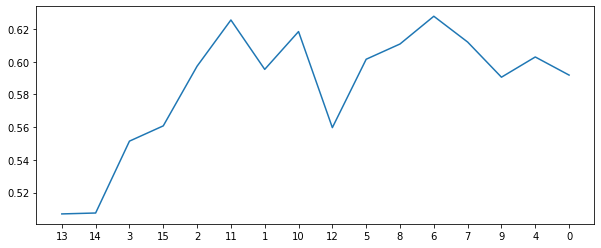

170
all features [14, 13, 15, 3, 2, 1, 11, 12, 10, 5, 4, 7, 6, 8, 0, 9, 16]
new features [14, 13, 15, 3, 2, 1, 11, 12]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6630090497737556
sensitivity  0.595
auc          0.6290045248868779


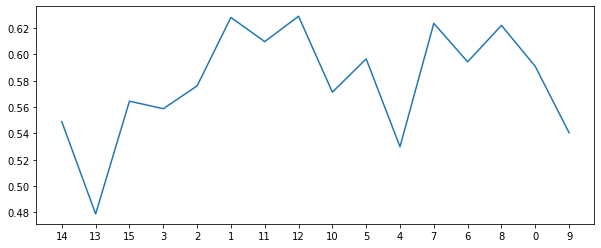

171
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6282428355957768
sensitivity  0.685
auc          0.6566214177978884


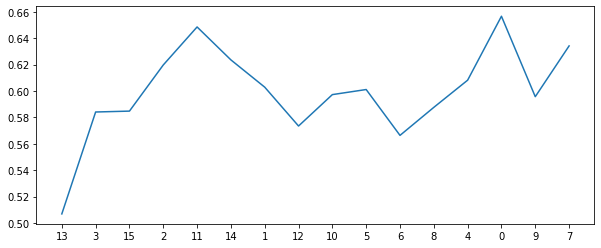

172
all features [3, 13, 11, 14, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6841251885369533
sensitivity  0.545
auc          0.6145625942684766


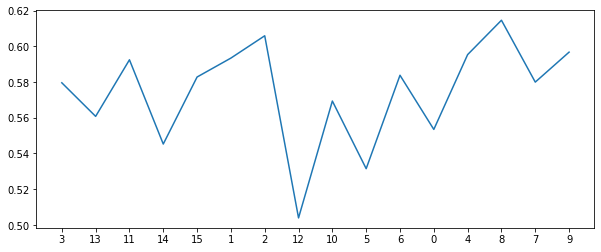

173
all features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 6, 8, 0, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6186274509803922
sensitivity  0.64
auc          0.629313725490196


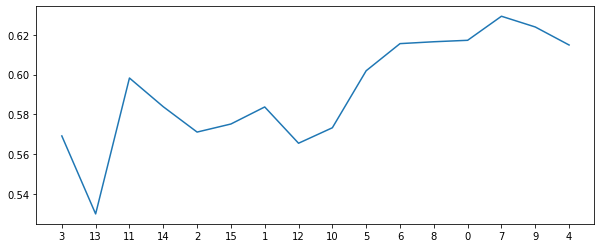

174
all features [13, 14, 3, 1, 2, 15, 12, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 2, 15, 12, 11, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6111236802413273
sensitivity  0.74
auc          0.6755618401206636


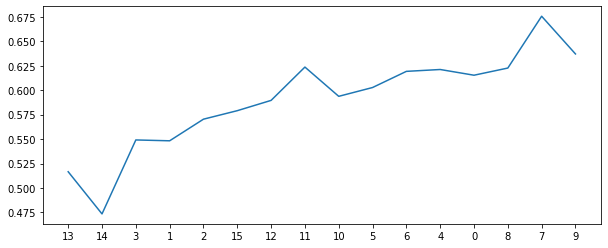

175
all features [14, 3, 13, 15, 2, 11, 1, 10, 12, 5, 8, 4, 6, 7, 0, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 10, 12, 5, 8, 4, 6]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5706636500754148
sensitivity  0.735
auc          0.6528318250377073


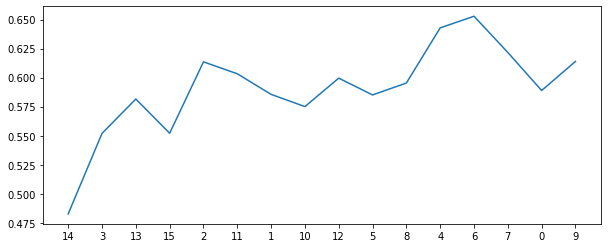

176
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6321644042232277
sensitivity  0.65
auc          0.6410822021116138


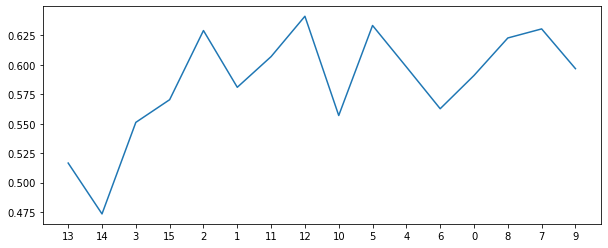

177
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5820135746606335
sensitivity  0.74
auc          0.6610067873303167


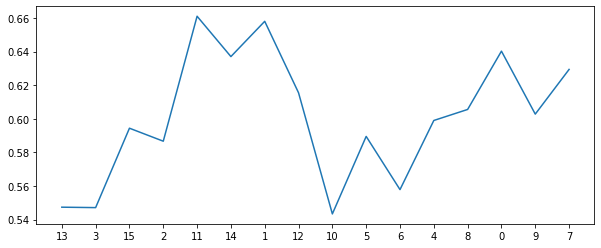

178
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6107142857142857
specificity  0.6052790346907994
sensitivity  0.685
auc          0.6451395173453998


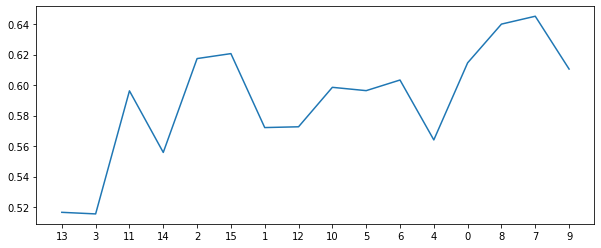

179
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5820512820512821
sensitivity  0.74
auc          0.661025641025641


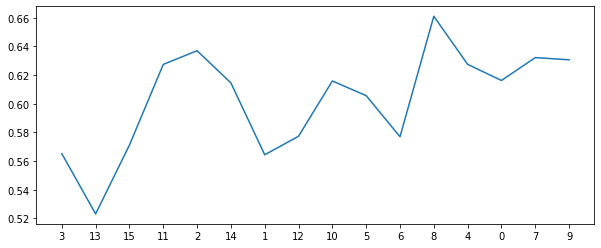

180
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6875
specificity  0.6976621417797888
sensitivity  0.565
auc          0.6313310708898944


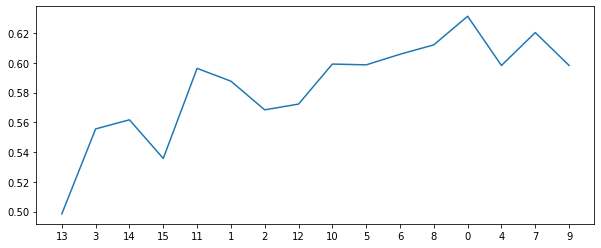

181
all features [14, 15, 3, 13, 11, 2, 1, 10, 12, 5, 6, 8, 9, 7, 0, 4, 16]
new features [14, 15, 3, 13, 11, 2, 1, 10, 12, 5, 6, 8, 9, 7, 0]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6707390648567119
sensitivity  0.64
auc          0.6553695324283559


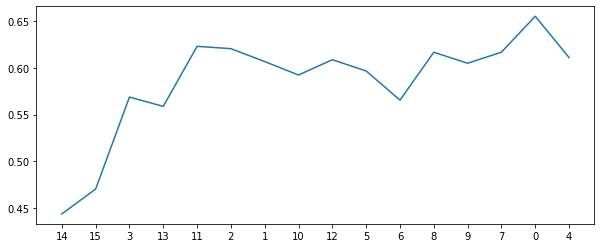

182
all features [14, 13, 3, 1, 2, 15, 11, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [14, 13, 3, 1, 2, 15, 11, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6880467571644042
sensitivity  0.57
auc          0.6290233785822021


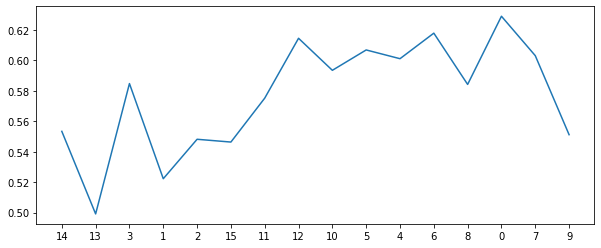

183
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 9, 7, 0, 4, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6686274509803922
sensitivity  0.64
auc          0.6543137254901961


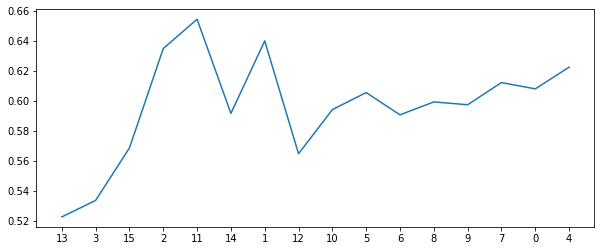

184
all features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6879336349924585
sensitivity  0.585
auc          0.6364668174962292


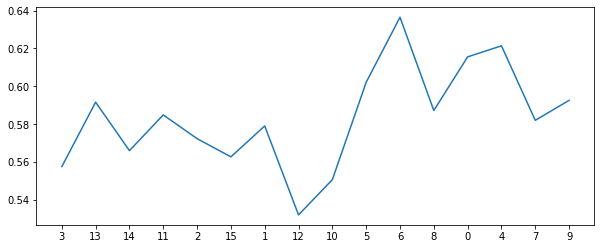

185
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.693815987933635
sensitivity  0.54
auc          0.6169079939668175


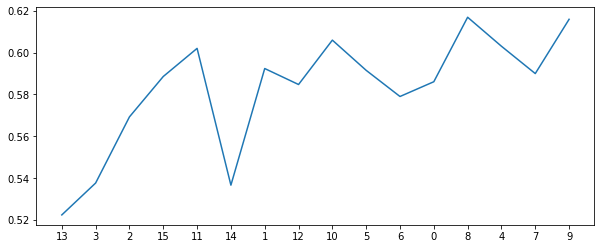

186
all features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6428571428571428
specificity  0.6437782805429864
sensitivity  0.64
auc          0.6418891402714932


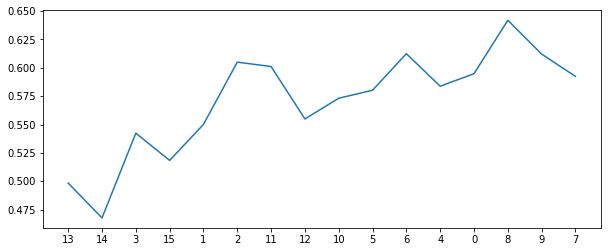

187
all features [14, 13, 3, 11, 2, 15, 1, 10, 12, 5, 6, 8, 4, 0, 9, 7, 16]
new features [14, 13, 3, 11, 2, 15, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.625
specificity  0.6225867269984917
sensitivity  0.66
auc          0.6412933634992458


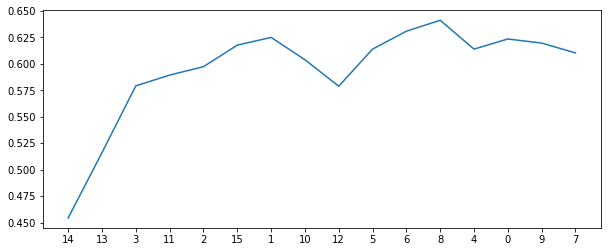

188
all features [14, 13, 3, 1, 2, 11, 15, 12, 10, 5, 4, 6, 8, 7, 0, 9, 16]
new features [14, 13, 3, 1, 2, 11, 15, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6284313725490196
sensitivity  0.645
auc          0.6367156862745098


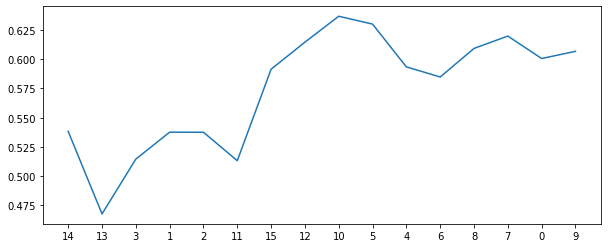

189
all features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 2, 15, 14, 11]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.625
specificity  0.6205882352941177
sensitivity  0.69
auc          0.6552941176470588


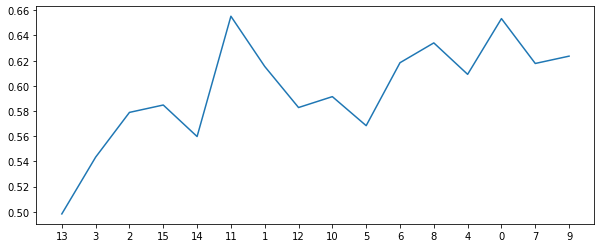

190
all features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6428571428571428
specificity  0.6435143288084465
sensitivity  0.64
auc          0.6417571644042233


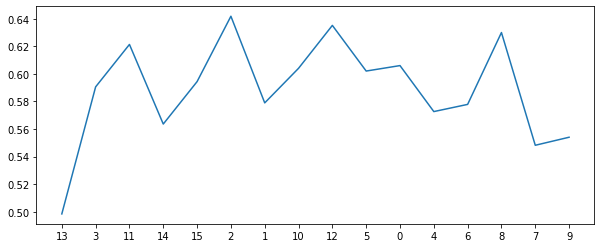

191
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 6, 5, 8, 0, 7, 9, 4, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 6, 5, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6302790346907994
sensitivity  0.665
auc          0.6476395173453997


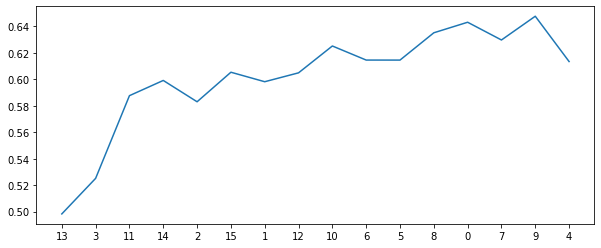

192
all features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 2, 11]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5714285714285714
specificity  0.5607466063348416
sensitivity  0.715
auc          0.6378733031674209


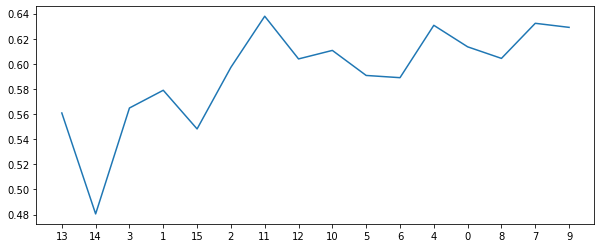

193
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 8, 6, 4, 9, 7, 0, 16]
new features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 8, 6, 4, 9, 7, 0]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.564630467571644
sensitivity  0.685
auc          0.624815233785822


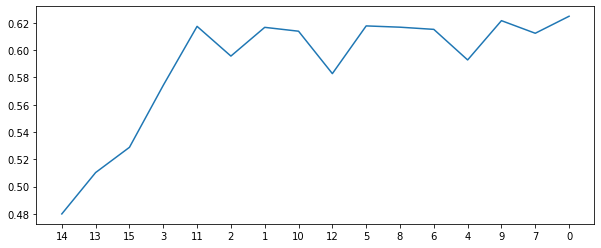

194
all features [14, 3, 13, 1, 2, 15, 11, 12, 10, 5, 4, 8, 6, 7, 0, 9, 16]
new features [14, 3, 13, 1, 2, 15, 11, 12, 10, 5, 4, 8, 6, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5803544494720966
sensitivity  0.74
auc          0.6601772247360482


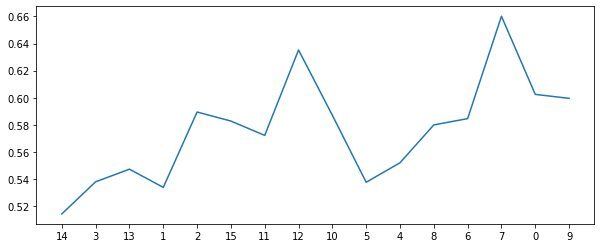

195
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 4, 7, 0, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5535714285714286
specificity  0.5377828054298642
sensitivity  0.765
auc          0.6513914027149321


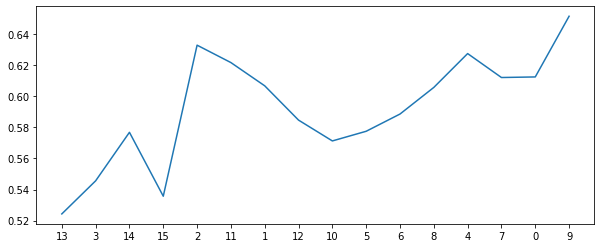

196
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6375
specificity  0.6341628959276018
sensitivity  0.69
auc          0.6620814479638009


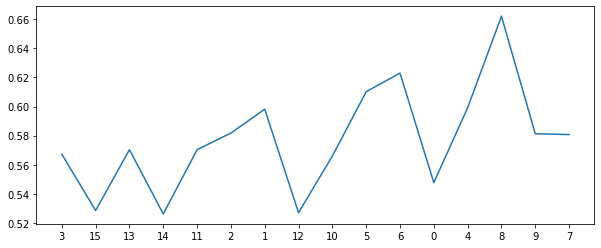

197
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4]
[0.4, 2, 1000, 1, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6072021116138764
sensitivity  0.71
auc          0.6586010558069382


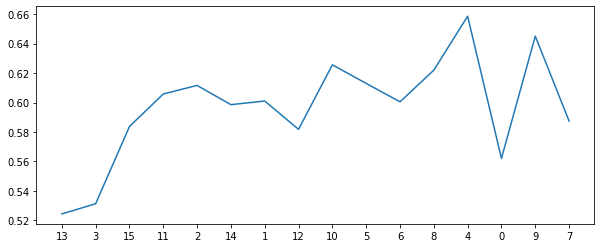

198
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6714285714285714
specificity  0.6782805429864254
sensitivity  0.595
auc          0.6366402714932127


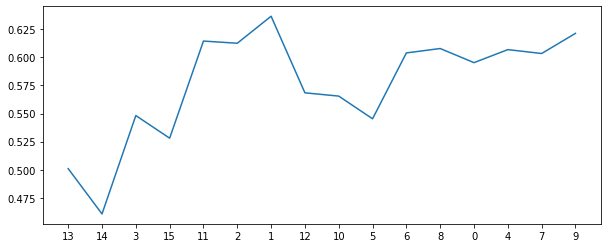

199
all features [13, 14, 11, 3, 15, 2, 1, 10, 12, 5, 8, 6, 9, 0, 4, 7, 16]
new features [13, 14, 11, 3, 15]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6167043740573153
sensitivity  0.645
auc          0.6308521870286576


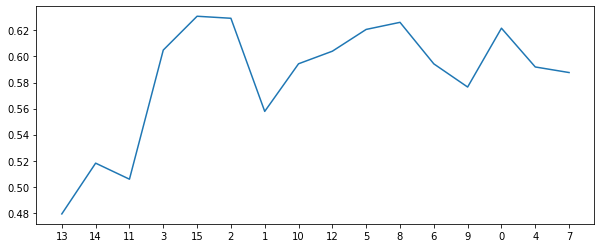

200
all features [3, 13, 14, 15, 1, 2, 11, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [3, 13, 14, 15, 1, 2, 11, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6745475113122172
sensitivity  0.565
auc          0.6197737556561086


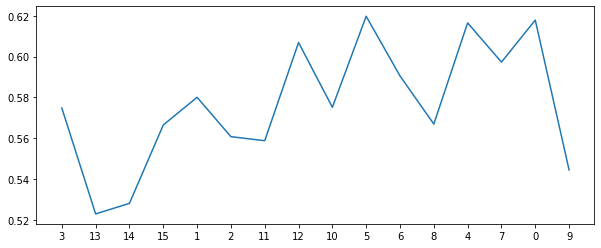

201
all features [3, 13, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 9, 0, 7, 4, 16]
new features [3, 13, 11, 15, 2]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.649396681749623
sensitivity  0.64
auc          0.6446983408748115


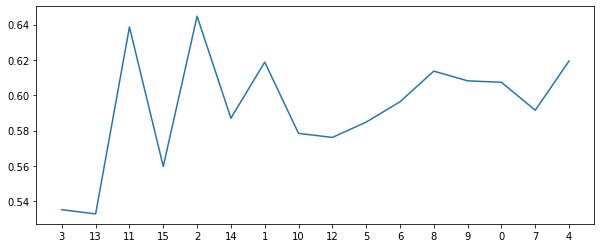

202
all features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 8, 6, 4, 0, 9, 7, 16]
new features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6696428571428572
specificity  0.6802413273001509
sensitivity  0.535
auc          0.6076206636500754


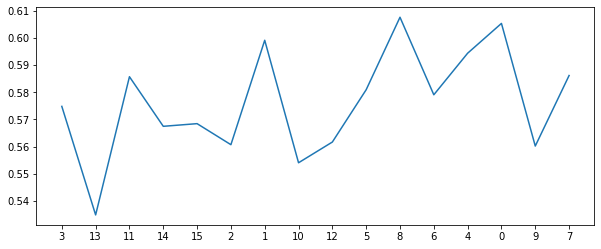

203
all features [3, 13, 2, 14, 11, 15, 1, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [3, 13, 2, 14, 11, 15, 1, 12, 10, 5, 6, 8, 4, 0, 9, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6782805429864254
sensitivity  0.585
auc          0.6316402714932127


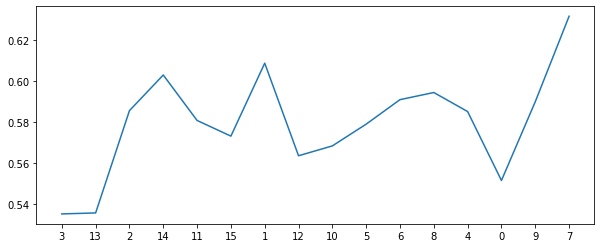

204
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.626395173453997
sensitivity  0.69
auc          0.6581975867269985


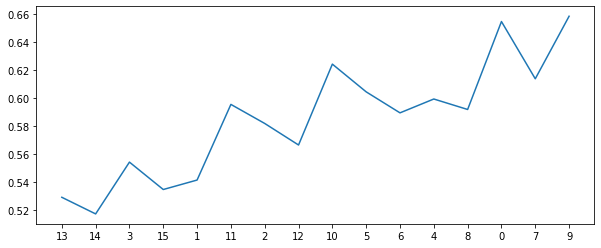

205
all features [14, 3, 13, 15, 11, 2, 1, 10, 12, 5, 8, 6, 4, 9, 0, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 10, 12, 5, 8, 6, 4, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5917420814479638
sensitivity  0.685
auc          0.6383710407239819


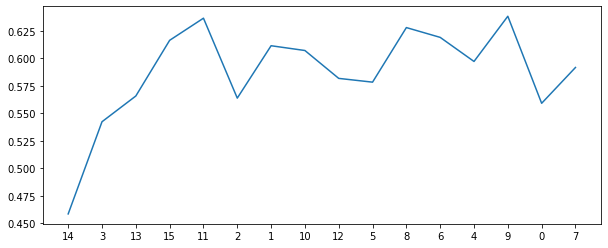

206
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.649396681749623
sensitivity  0.62
auc          0.6346983408748115


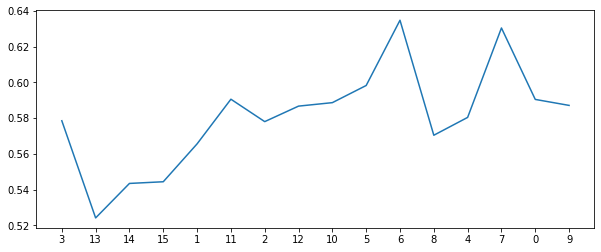

207
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5821644042232278
sensitivity  0.735
auc          0.6585822021116139


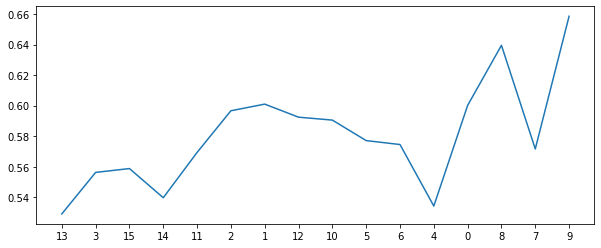

208
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.65
specificity  0.6553921568627451
sensitivity  0.595
auc          0.6251960784313726


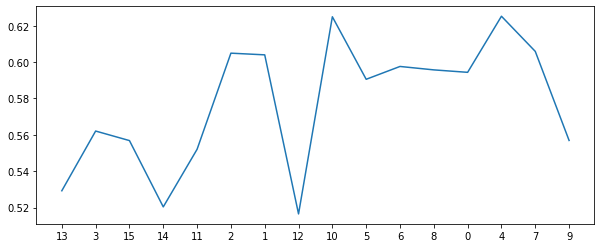

209
all features [13, 3, 2, 11, 14, 15, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 2, 11, 14, 15]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6125
specificity  0.6071266968325792
sensitivity  0.695
auc          0.6510633484162895


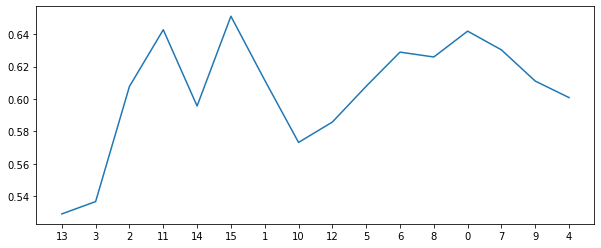

210
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5625
specificity  0.5475490196078432
sensitivity  0.77
auc          0.6587745098039216


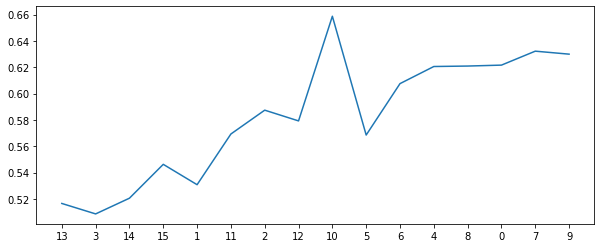

211
all features [3, 13, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 9, 7, 4, 0, 16]
new features [3, 13, 15, 14, 11, 2, 1, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5464285714285715
specificity  0.5320135746606335
sensitivity  0.745
auc          0.6385067873303167


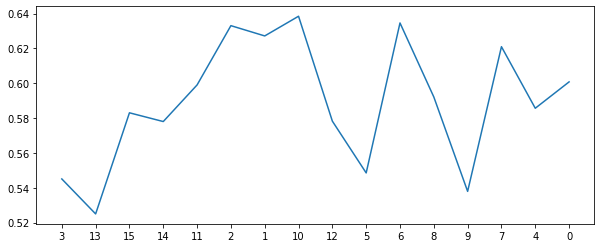

212
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 4, 8, 0, 6, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 4, 8, 0, 6]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5916289592760181
sensitivity  0.735
auc          0.663314479638009


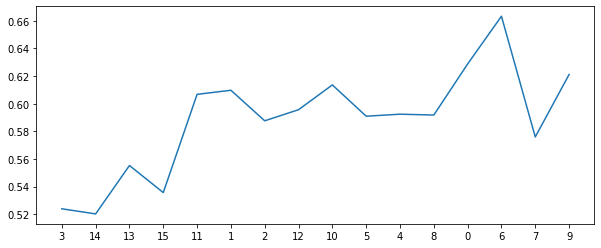

213
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5464285714285715
specificity  0.5321644042232277
sensitivity  0.735
auc          0.6335822021116139


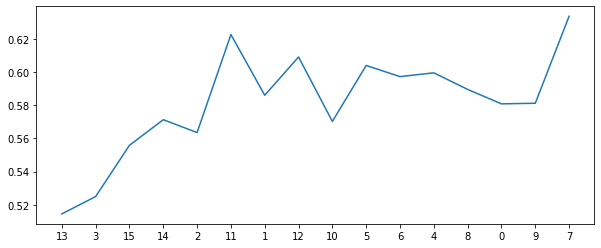

214
all features [3, 11, 13, 14, 15, 1, 2, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [3, 11, 13, 14, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.61289592760181
sensitivity  0.665
auc          0.638947963800905


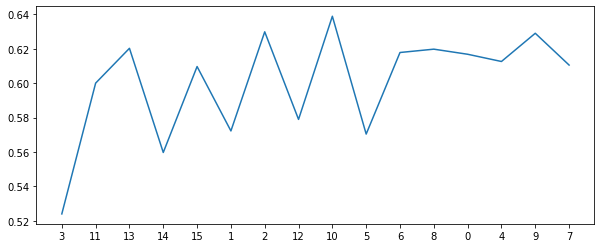

215
all features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 0, 9, 4, 7, 16]
new features [3, 13, 14, 2, 11, 15, 1, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.589894419306184
sensitivity  0.685
auc          0.637447209653092


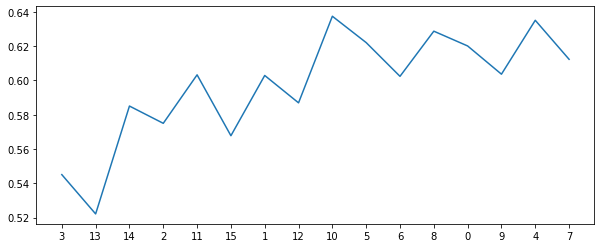

216
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6880844645550528
sensitivity  0.59
auc          0.6390422322775264


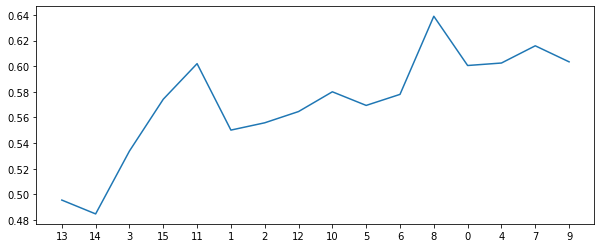

217
all features [13, 14, 2, 3, 15, 11, 1, 10, 12, 5, 8, 6, 9, 0, 7, 4, 16]
new features [13, 14, 2, 3, 15, 11, 1, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6732142857142858
specificity  0.6802790346907994
sensitivity  0.595
auc          0.6376395173453997


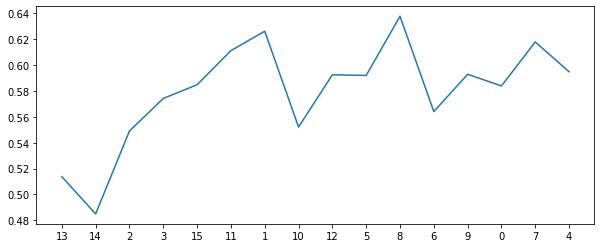

218
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 8, 6, 0, 7, 4, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 8, 6, 0]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.709238310708899
sensitivity  0.515
auc          0.6121191553544495


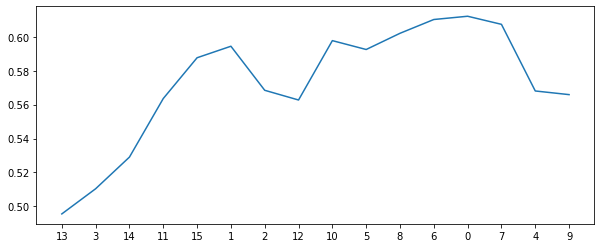

219
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 7, 0, 9, 4, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6880090497737557
sensitivity  0.565
auc          0.6265045248868779


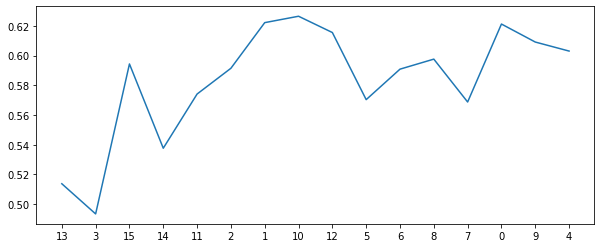

220
all features [3, 13, 15, 14, 11, 2, 1, 10, 12, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7111236802413273
sensitivity  0.54
auc          0.6255618401206636


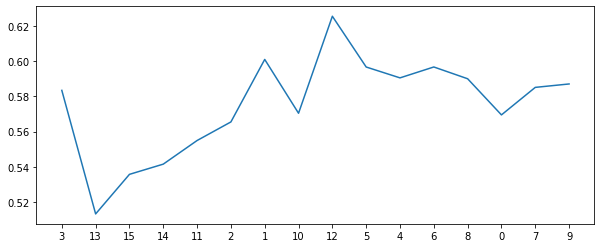

221
all features [13, 3, 11, 14, 2, 15, 1, 10, 12, 6, 5, 7, 8, 0, 4, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 10, 12, 6, 5, 7, 8, 0, 4, 9]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6764328808446456
sensitivity  0.56
auc          0.6182164404223228


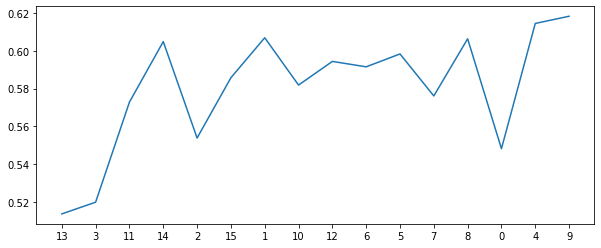

222
all features [13, 3, 14, 11, 1, 15, 2, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 1, 15, 2, 12, 10, 5, 0, 6, 8, 4, 7]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6649321266968325
sensitivity  0.59
auc          0.6274660633484163


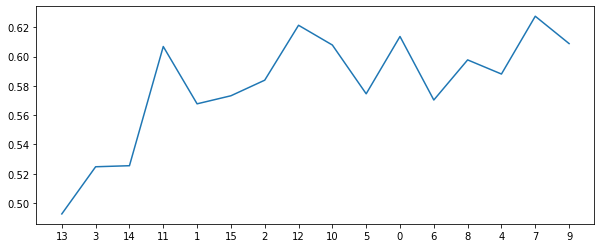

223
all features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 8, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6032051282051282
sensitivity  0.685
auc          0.6441025641025642


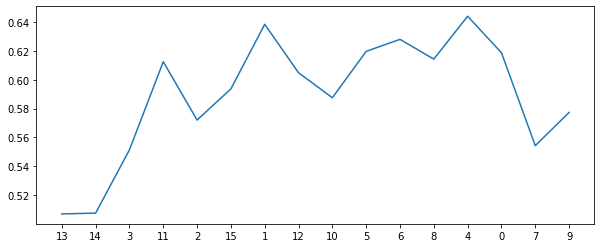

224
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.645739064856712
sensitivity  0.59
auc          0.617869532428356


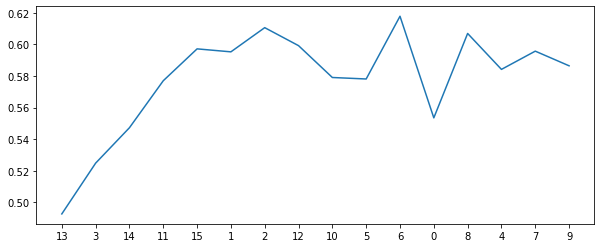

225
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5767857142857143
specificity  0.5685897435897436
sensitivity  0.69
auc          0.6292948717948718


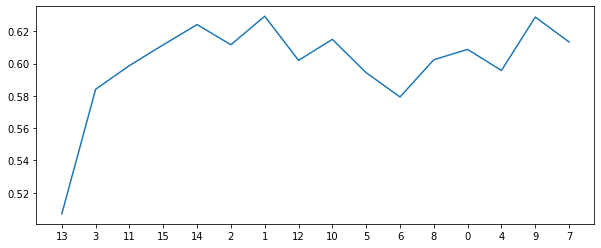

226
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6514328808446456
sensitivity  0.59
auc          0.6207164404223228


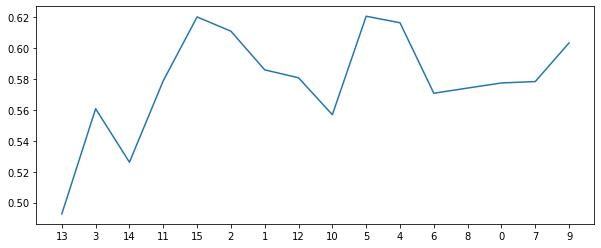

227
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 6, 5, 0, 8, 9, 4, 7, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5762820512820512
sensitivity  0.715
auc          0.6456410256410257


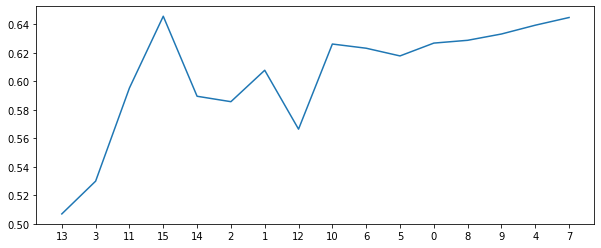

228
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5878205128205128
sensitivity  0.695
auc          0.6414102564102564


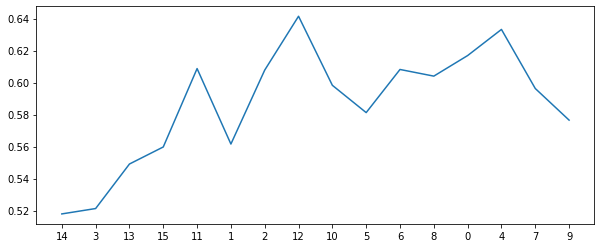

229
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 4, 7, 8, 0, 9, 16]
new features [13, 14, 3, 15, 11]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5625
specificity  0.5512443438914028
sensitivity  0.72
auc          0.6356221719457014


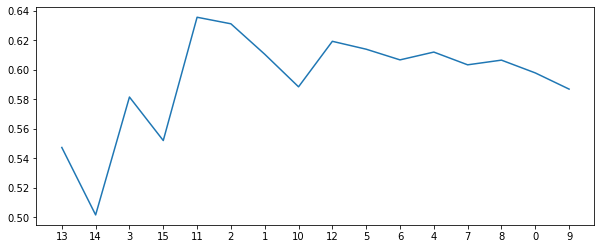

230
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6147812971342383
sensitivity  0.635
auc          0.6248906485671192


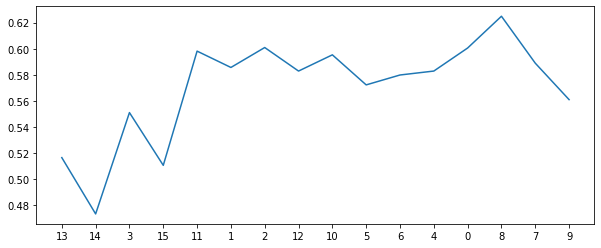

231
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 14, 15, 11, 2]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5569758672699849
sensitivity  0.74
auc          0.6484879336349925


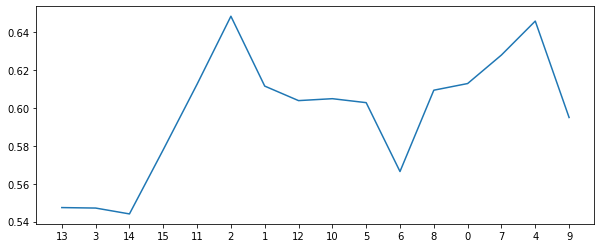

232
all features [13, 14, 15, 11, 3, 1, 2, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 14, 15, 11, 3, 1, 2, 12, 10, 5, 8, 4, 6]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.65
specificity  0.653393665158371
sensitivity  0.61
auc          0.6316968325791855


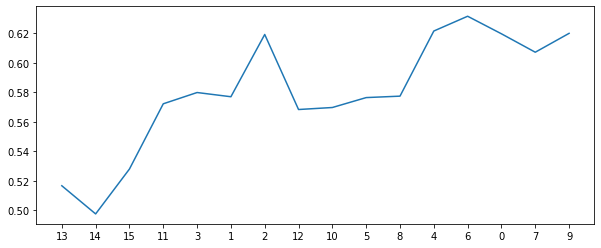

233
all features [13, 11, 3, 15, 14, 2, 1, 10, 12, 5, 6, 8, 9, 0, 4, 7, 16]
new features [13, 11, 3, 15, 14, 2, 1, 10, 12, 5, 6, 8, 9, 0, 4, 7]
[0.4, 2, 1000, 1, 0.5, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6125
specificity  0.6070135746606335
sensitivity  0.69
auc          0.6485067873303167


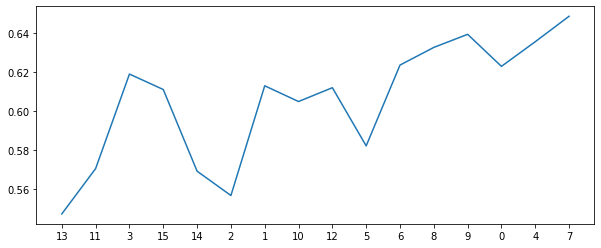

234
all features [14, 11, 13, 3, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 11, 13, 3, 15, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7034690799396682
sensitivity  0.565
auc          0.634234539969834


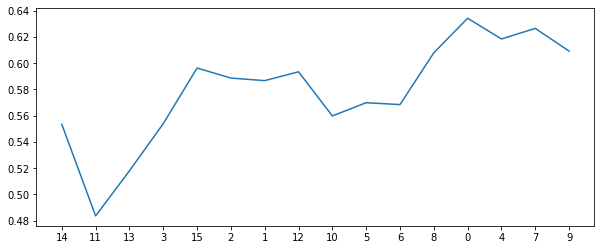

235
all features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 8, 6, 9, 0, 4, 7, 16]
new features [13, 14, 15, 3, 11]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.625
specificity  0.6262820512820513
sensitivity  0.62
auc          0.6231410256410257


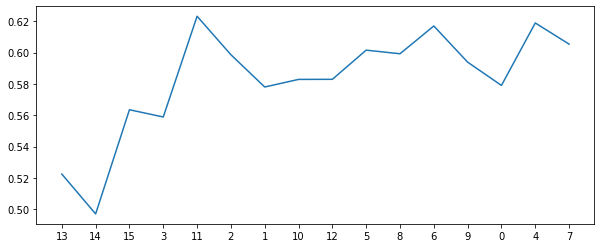

236
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 8, 4, 6, 7, 0, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7033182503770739
sensitivity  0.52
auc          0.6116591251885369


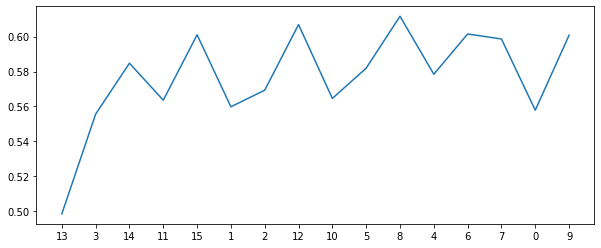

237
all features [13, 3, 14, 2, 11, 15, 1, 12, 10, 5, 6, 0, 8, 7, 9, 4, 16]
new features [13, 3, 14, 2, 11, 15]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6610482654600301
sensitivity  0.57
auc          0.615524132730015


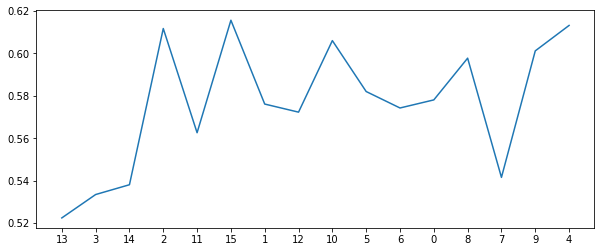

238
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7017857142857142
specificity  0.7150075414781297
sensitivity  0.545
auc          0.6300037707390649


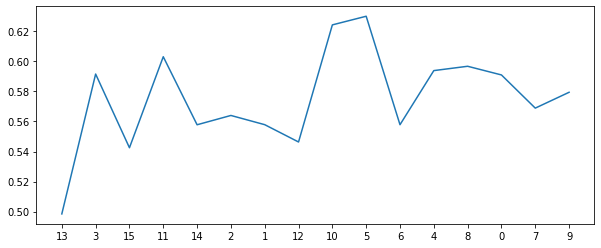

239
all features [3, 13, 11, 15, 14, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6732142857142858
specificity  0.6822398190045249
sensitivity  0.565
auc          0.6236199095022624


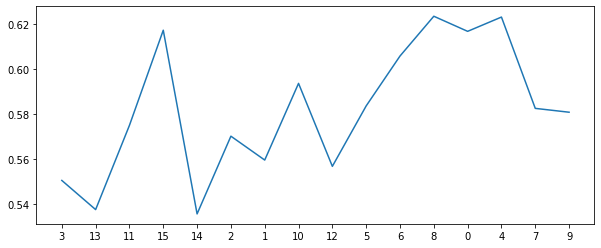

240
all features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6207390648567119
sensitivity  0.64
auc          0.6303695324283559


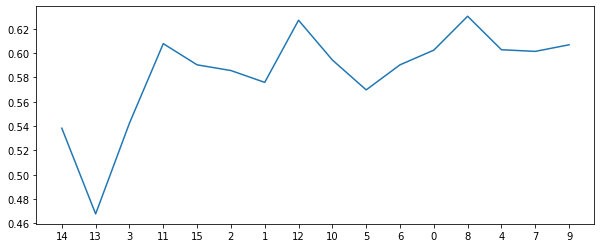

241
all features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 6, 7, 8, 9, 4, 0, 16]
new features [13, 14, 15, 3, 11, 2]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6127450980392157
sensitivity  0.69
auc          0.6513725490196078


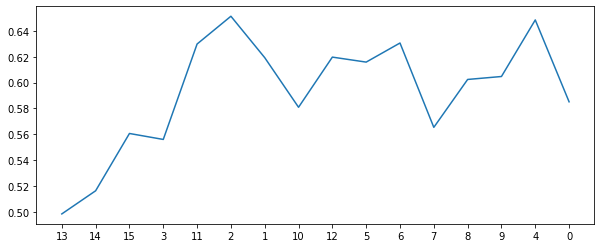

242
all features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.649396681749623
sensitivity  0.62
auc          0.6346983408748115


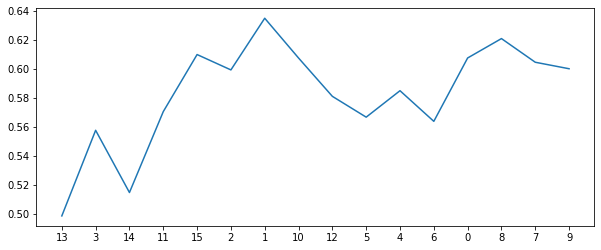

243
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6457013574660634
sensitivity  0.64
auc          0.6428506787330317


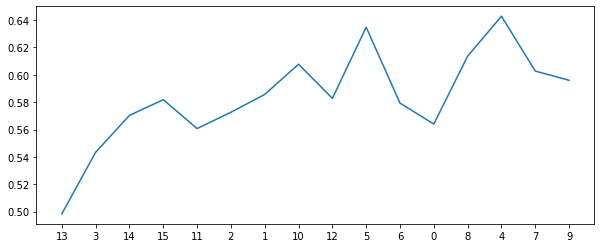

244
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 11]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6245475113122172
sensitivity  0.625
auc          0.6247737556561086


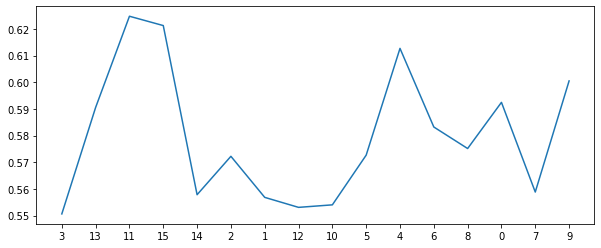

245
all features [13, 3, 11, 2, 15, 14, 1, 10, 12, 5, 6, 8, 9, 4, 7, 0, 16]
new features [13, 3, 11, 2, 15, 14, 1, 10, 12, 5, 6, 8, 9]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6375
specificity  0.6377828054298642
sensitivity  0.635
auc          0.6363914027149321


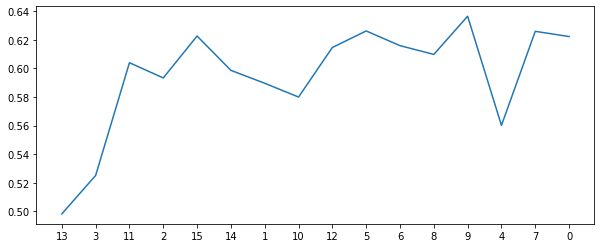

246
all features [13, 14, 3, 11, 1, 15, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 11, 1, 15, 2, 12, 10, 5, 4, 0, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5696428571428571
specificity  0.5609351432880845
sensitivity  0.69
auc          0.6254675716440422


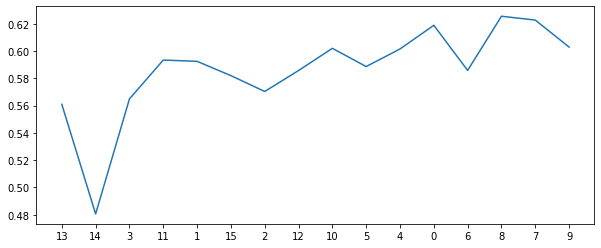

247
all features [13, 11, 14, 3, 15, 1, 2, 12, 10, 5, 8, 4, 6, 7, 9, 0, 16]
new features [13, 11, 14, 3]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5285714285714286
specificity  0.5107843137254902
sensitivity  0.77
auc          0.6403921568627451


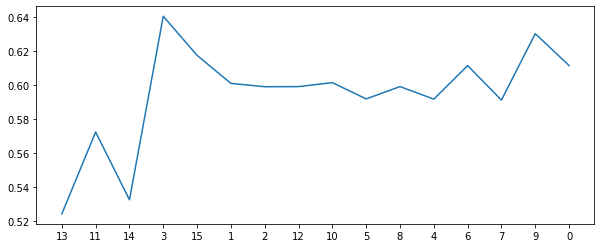

248
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5858597285067874
sensitivity  0.69
auc          0.6379298642533937


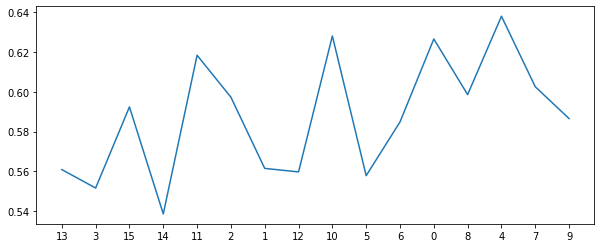

249
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5803571428571428
specificity  0.5704751131221719
sensitivity  0.71
auc          0.6402375565610859


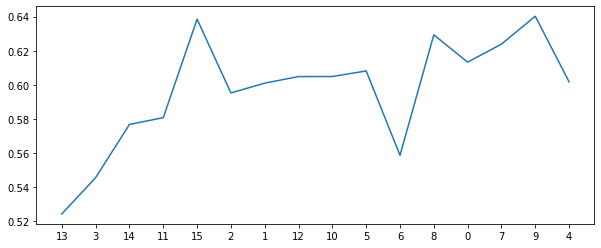

250
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6283559577677225
sensitivity  0.64
auc          0.6341779788838613


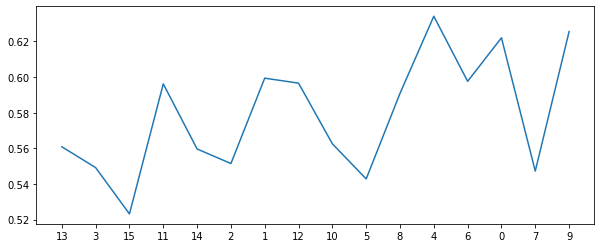

251
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 9, 0, 7, 4, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 9, 0, 7, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5801659125188537
sensitivity  0.685
auc          0.6325829562594268


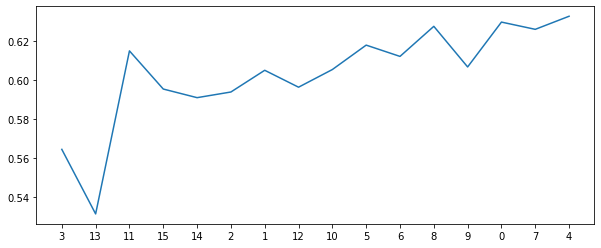

252
all features [13, 11, 14, 3, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 11, 14, 3, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.693815987933635
sensitivity  0.54
auc          0.6169079939668175


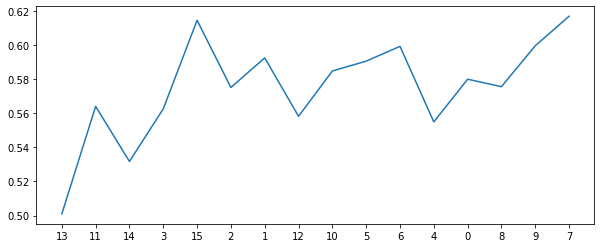

253
all features [13, 14, 11, 15, 3, 2, 1, 10, 12, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 14, 11, 15, 3, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6375
specificity  0.6359728506787331
sensitivity  0.66
auc          0.6479864253393665


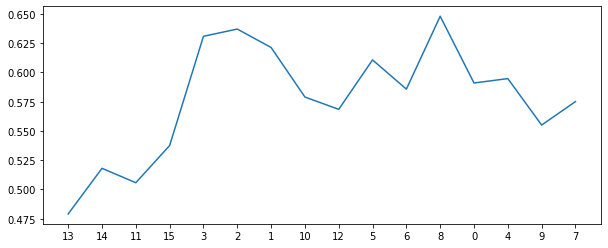

254
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 8, 7, 9, 0, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.7071428571428572
specificity  0.7169306184012066
sensitivity  0.59
auc          0.6534653092006033


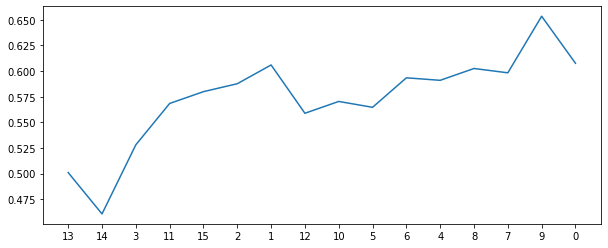

255
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 9, 0, 7, 4, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6455882352941177
sensitivity  0.64
auc          0.6427941176470588


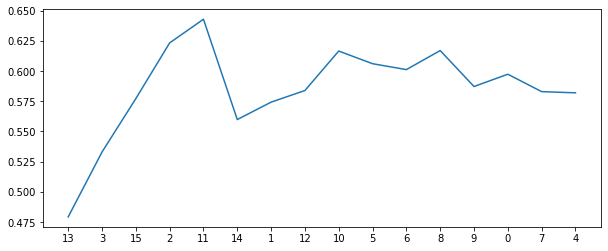

256
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.705316742081448
sensitivity  0.54
auc          0.622658371040724


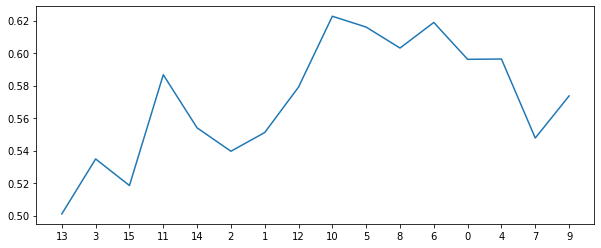

257
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 7, 9, 0, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 7]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.7092760180995475
sensitivity  0.565
auc          0.6371380090497738


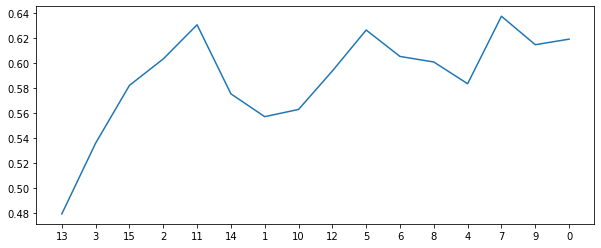

258
all features [13, 14, 3, 11, 2, 1, 15, 12, 10, 5, 4, 6, 8, 0, 9, 7, 16]
new features [13, 14, 3, 11, 2, 1, 15, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6052413273001508
sensitivity  0.67
auc          0.6376206636500754


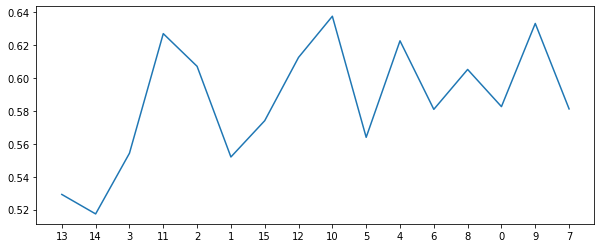

259
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 8, 6, 9, 0, 4, 7, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.575
specificity  0.5628582202111614
sensitivity  0.74
auc          0.6514291101055807


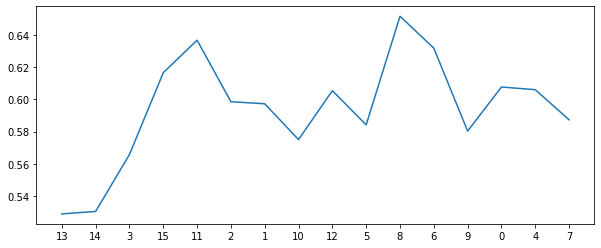

260
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6341251885369532
sensitivity  0.645
auc          0.6395625942684766


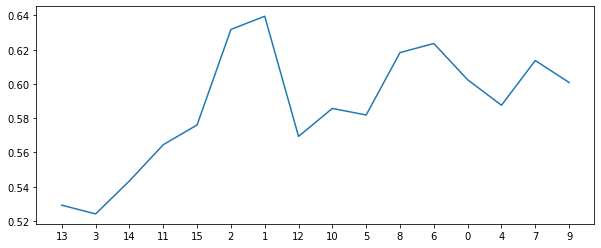

261
all features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 0, 9, 8, 7, 4, 16]
new features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6476621417797889
sensitivity  0.715
auc          0.6813310708898943


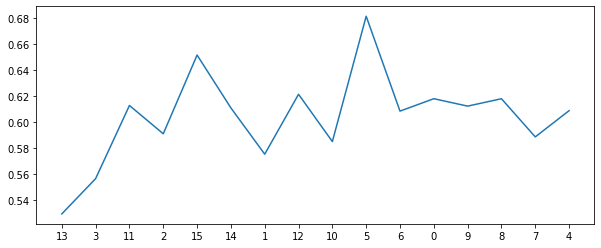

262
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 8, 0, 4, 6, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6553544494720965
sensitivity  0.61
auc          0.6326772247360483


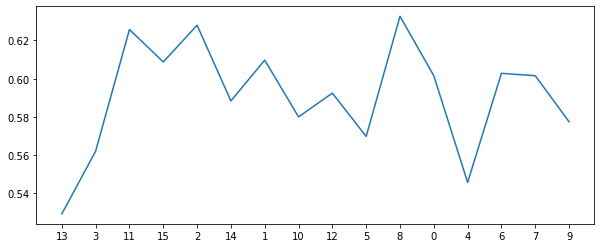

263
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6302036199095022
sensitivity  0.685
auc          0.6576018099547511


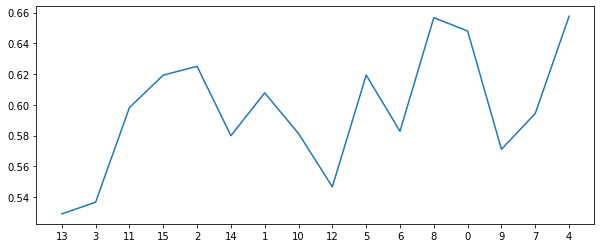

264
all features [13, 14, 3, 11, 1, 2, 15, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 14, 3, 11, 1, 2, 15, 12, 10]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5860859728506788
sensitivity  0.72
auc          0.6530429864253393


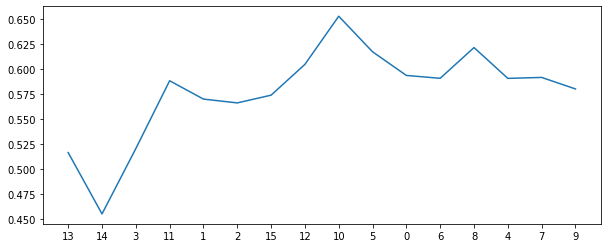

265
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5629713423831071
sensitivity  0.72
auc          0.6414856711915535


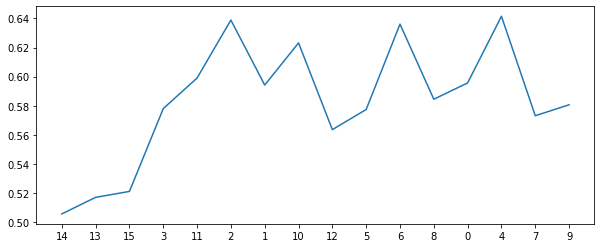

266
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5875
specificity  0.5800150829562595
sensitivity  0.695
auc          0.6375075414781297


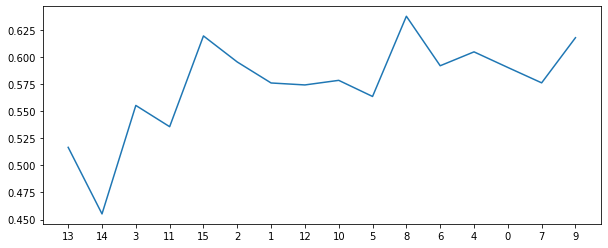

267
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 6, 5, 8, 0, 7, 9, 4, 16]
new features [3, 13, 15, 11, 2, 14]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5686274509803921
sensitivity  0.715
auc          0.6418137254901961


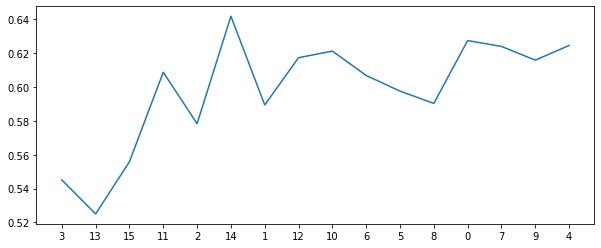

268
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 4, 8, 6, 0, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 4, 8, 6]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6341251885369532
sensitivity  0.64
auc          0.6370625942684767


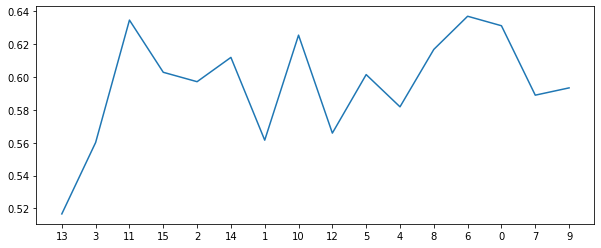

269
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5763574660633484
sensitivity  0.715
auc          0.6456787330316742


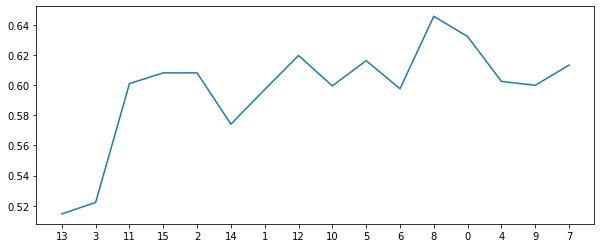

270
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 7, 8, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.7017857142857143
specificity  0.7149321266968326
sensitivity  0.545
auc          0.6299660633484163


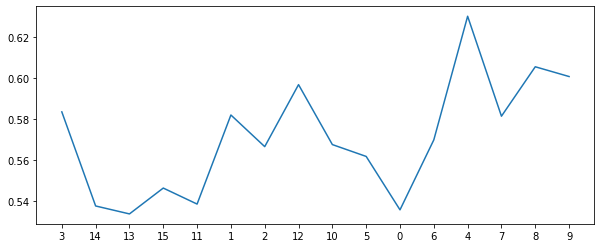

271
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6745852187028658
sensitivity  0.64
auc          0.6572926093514329


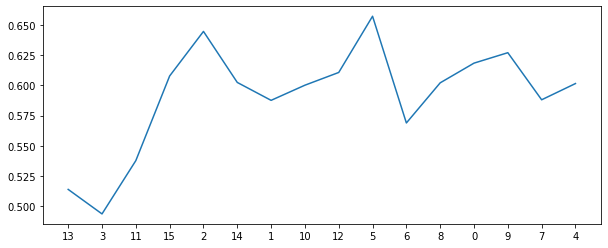

272
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 8, 4, 0, 6, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6910714285714286
specificity  0.7034690799396682
sensitivity  0.54
auc          0.6217345399698341


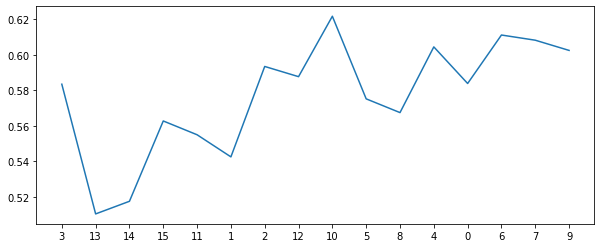

273
all features [13, 15, 3, 14, 11, 2, 1, 10, 12, 5, 6, 0, 7, 4, 8, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.65
specificity  0.6572021116138763
sensitivity  0.57
auc          0.6136010558069381


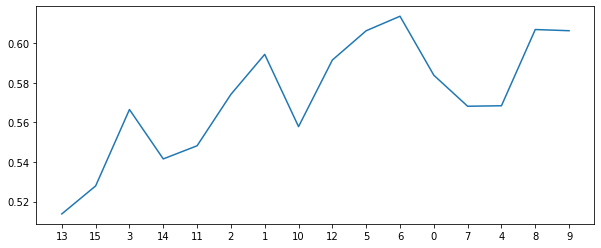

274
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 3, 11]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6957013574660633
sensitivity  0.55
auc          0.6228506787330317


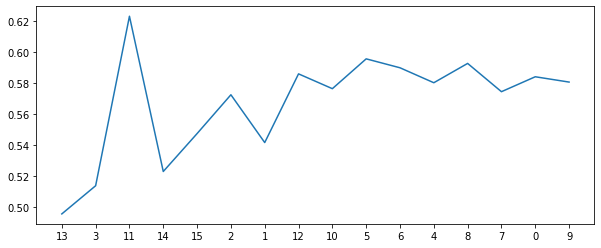

275
all features [3, 13, 11, 15, 2, 14, 1, 10, 12, 5, 6, 7, 8, 0, 4, 9, 16]
new features [3, 13, 11, 15, 2]
[0.4, 2, 1000, 1, 0.5, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.7032051282051281
sensitivity  0.565
auc          0.6341025641025642


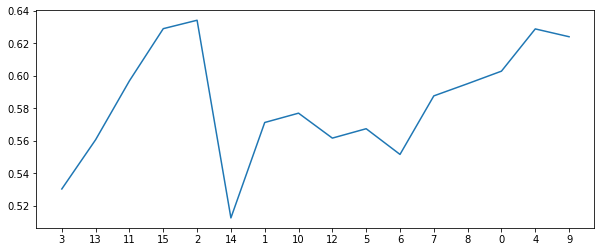

276
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6803921568627451
sensitivity  0.59
auc          0.6351960784313726


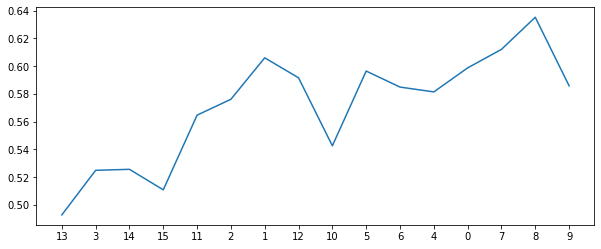

277
all features [13, 15, 3, 11, 14, 2, 1, 12, 10, 5, 6, 8, 7, 4, 9, 0, 16]
new features [13, 15, 3, 11, 14, 2, 1, 12, 10, 5, 6, 8, 7, 4]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6392857142857143
specificity  0.6358597285067873
sensitivity  0.685
auc          0.6604298642533937


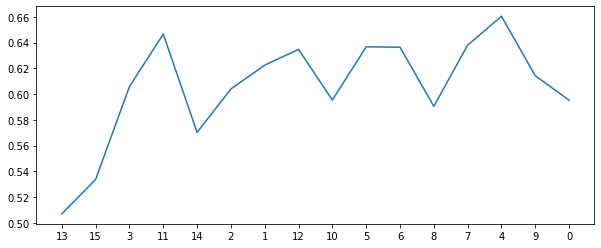

278
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6764328808446456
sensitivity  0.54
auc          0.6082164404223227


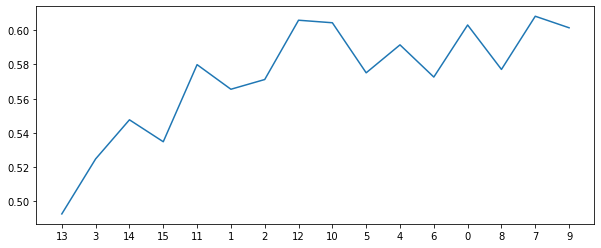

279
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 0, 8, 9, 4, 7, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5840120663650076
sensitivity  0.695
auc          0.6395060331825038


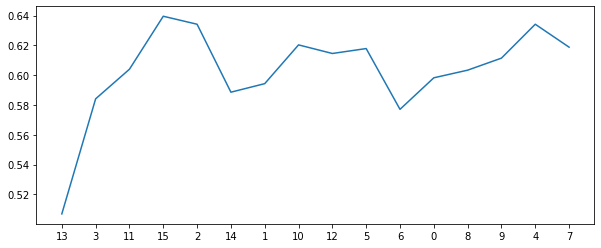

280
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6964285714285714
specificity  0.7073906485671192
sensitivity  0.56
auc          0.6336953242835596


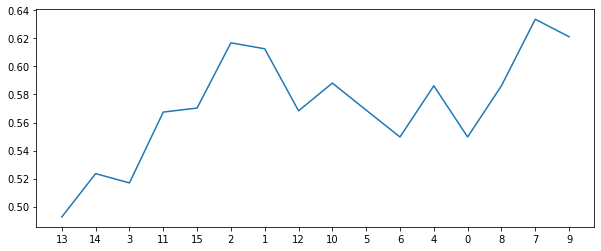

281
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 6, 5, 0, 7, 4, 8, 9, 16]
new features [13, 3, 11]
[0.4, 2, 1000, 1, 0.5, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6052413273001508
sensitivity  0.665
auc          0.6351206636500754


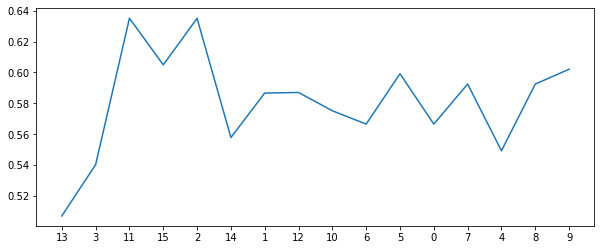

282
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.5996606334841629
sensitivity  0.685
auc          0.6423303167420814


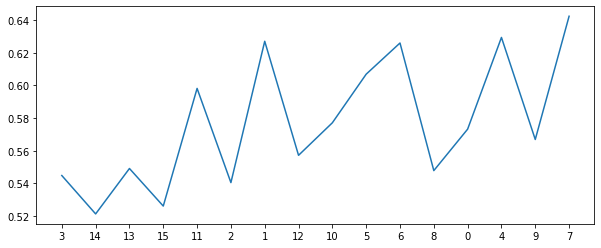

283
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5725113122171945
sensitivity  0.715
auc          0.6437556561085973


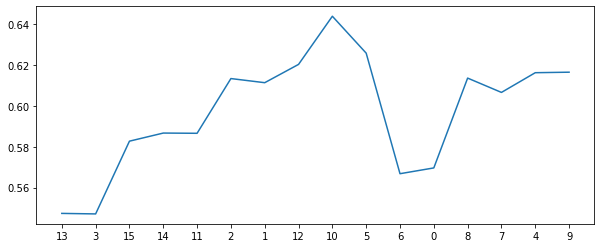

284
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6322398190045249
sensitivity  0.685
auc          0.6586199095022625


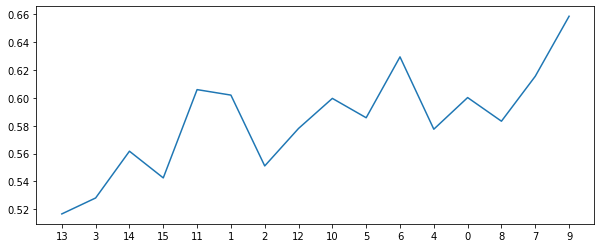

285
all features [13, 15, 3, 11, 2, 14, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 15, 3, 11, 2, 14, 1, 10, 12]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5916666666666667
sensitivity  0.765
auc          0.6783333333333333


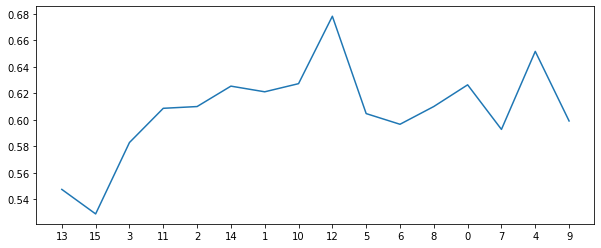

286
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 7, 0, 8, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 7, 0, 8, 9]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6225113122171946
sensitivity  0.64
auc          0.6312556561085972


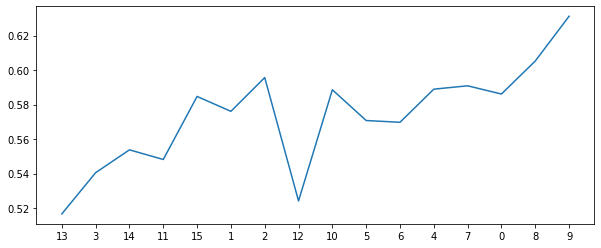

287
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5975113122171946
sensitivity  0.685
auc          0.6412556561085972


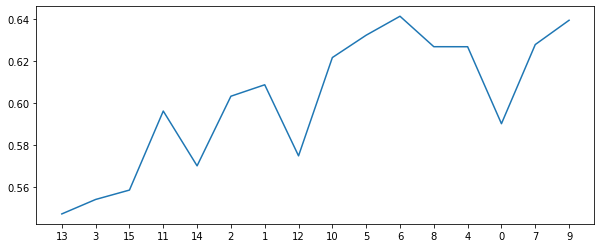

288
all features [3, 15, 13, 14, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 15, 13, 14, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6957390648567119
sensitivity  0.545
auc          0.620369532428356


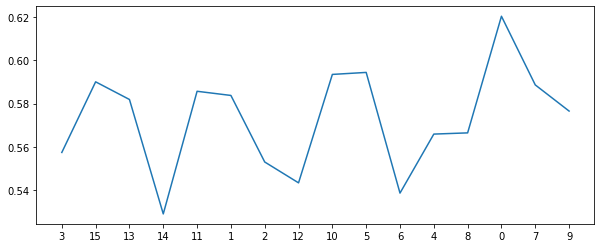

289
all features [13, 11, 15, 14, 3, 2, 1, 10, 12, 5, 6, 8, 4, 9, 7, 0, 16]
new features [13, 11, 15, 14, 3, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6375
specificity  0.6398944193061841
sensitivity  0.62
auc          0.629947209653092


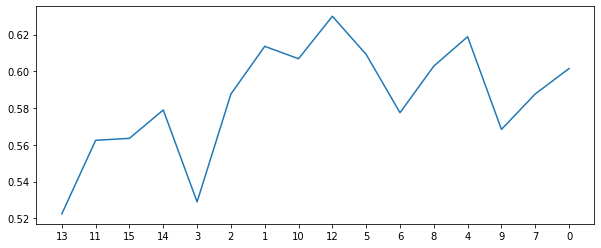

290
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 4, 6]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7034690799396682
sensitivity  0.52
auc          0.6117345399698341


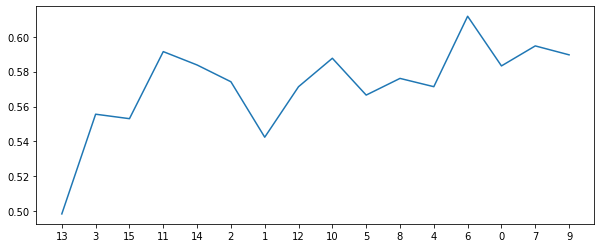

291
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 8, 7, 9, 4, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6696428571428571
specificity  0.6764705882352942
sensitivity  0.59
auc          0.633235294117647


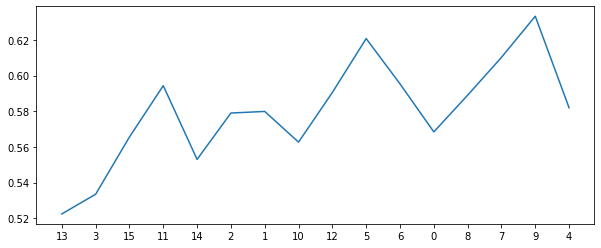

292
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7130844645550528
sensitivity  0.52
auc          0.6165422322775264


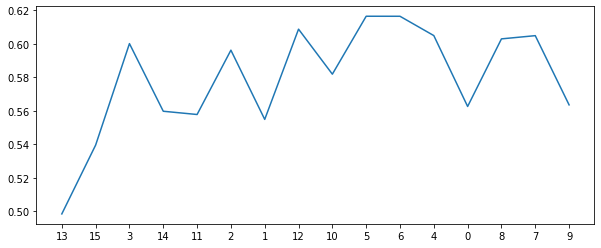

293
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6803571428571429
specificity  0.6880844645550528
sensitivity  0.59
auc          0.6390422322775264


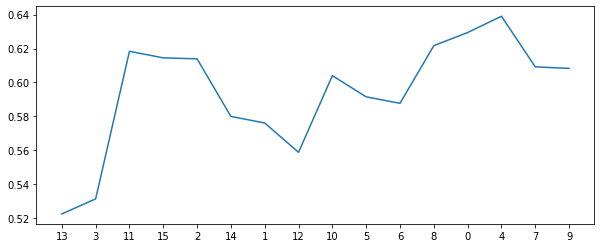

294
all features [3, 13, 11, 15, 14, 1, 2, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [3, 13, 11, 15, 14, 1, 2, 12, 10, 5, 6, 4, 0, 7, 8]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6706259426847662
sensitivity  0.59
auc          0.6303129713423831


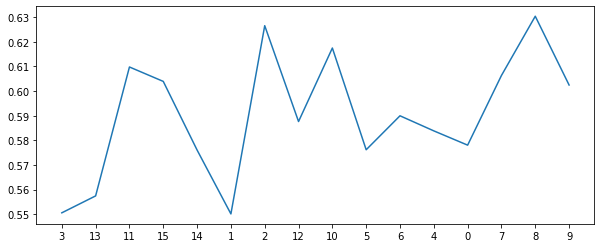

295
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 9, 7, 4, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6341251885369532
sensitivity  0.665
auc          0.6495625942684766


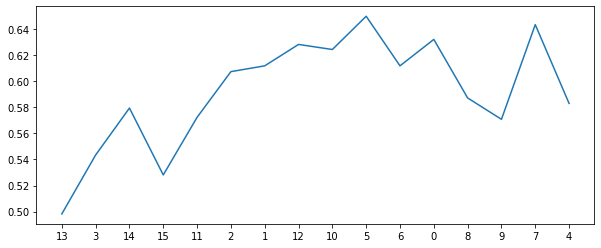

296
all features [13, 3, 15, 14, 2, 1, 11, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 1]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.637971342383107
sensitivity  0.57
auc          0.6039856711915536


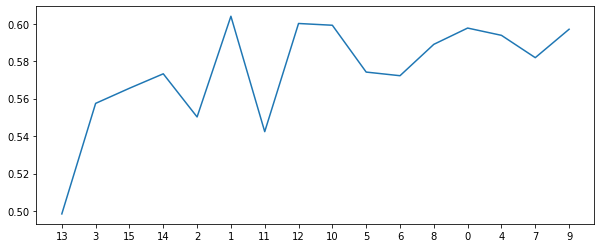

297
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 4, 7, 8, 0, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6071266968325791
sensitivity  0.67
auc          0.6385633484162896


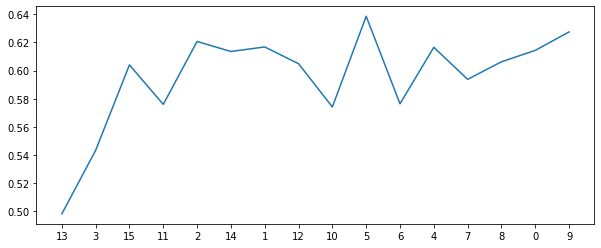

298
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6899321266968326
sensitivity  0.515
auc          0.6024660633484162


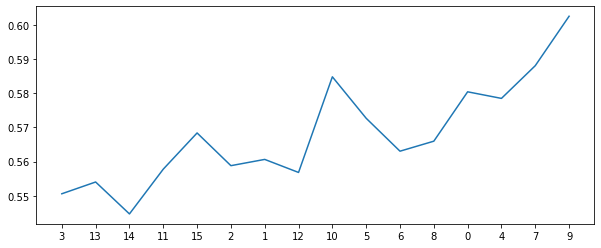

299
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6071266968325792
sensitivity  0.665
auc          0.6360633484162895


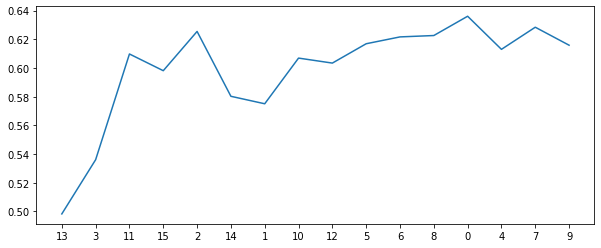

300
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6110105580693816
sensitivity  0.66
auc          0.6355052790346908


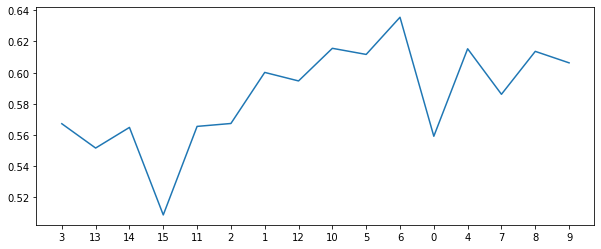

301
all features [13, 15, 3, 14, 2, 11, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 15, 3, 14, 2, 11, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5955128205128205
sensitivity  0.71
auc          0.6527564102564103


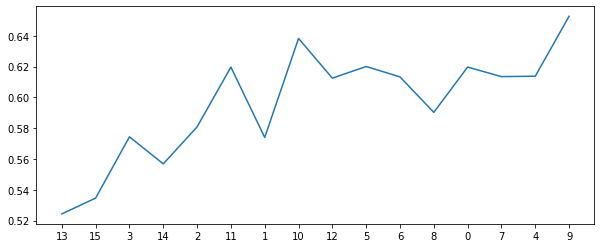

302
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6457013574660634
sensitivity  0.645
auc          0.6453506787330316


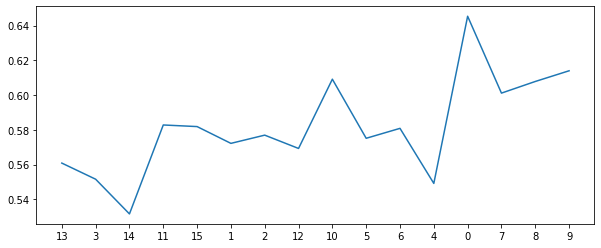

303
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 0]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.6032051282051282
sensitivity  0.665
auc          0.6341025641025642


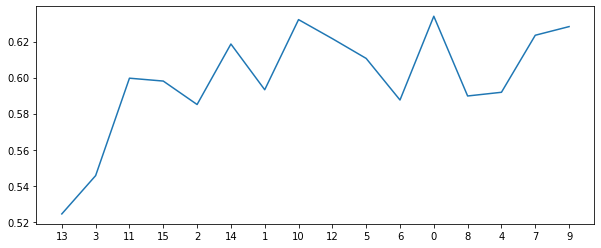

304
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 8, 6, 7, 4, 0, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 8, 6, 7, 4]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6360859728506787
sensitivity  0.64
auc          0.6380429864253394


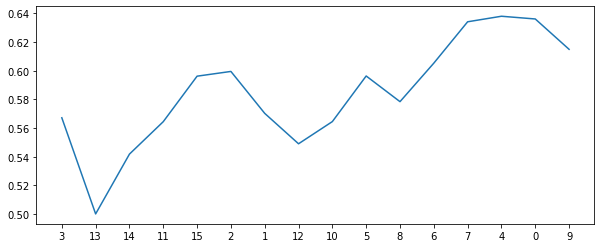

305
all features [13, 11, 3, 2, 15, 14, 1, 12, 10, 6, 5, 4, 8, 0, 9, 7, 16]
new features [13, 11, 3, 2, 15, 14, 1]
[0.4, 2, 1000, 1, 0.5, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5896681749622926
sensitivity  0.665
auc          0.6273340874811463


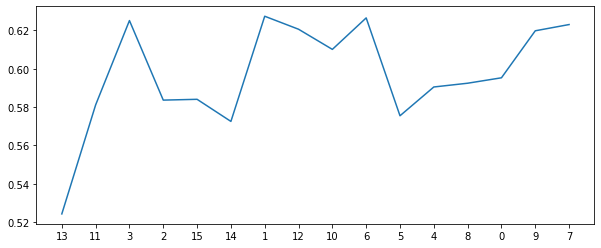

306
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.7
specificity  0.711236802413273
sensitivity  0.57
auc          0.6406184012066365


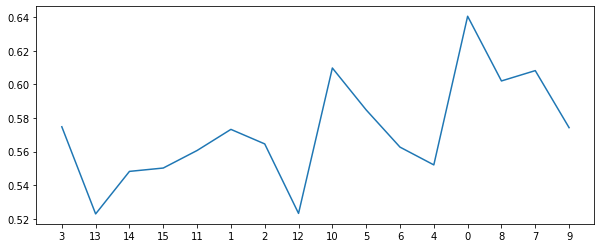

307
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6937028657616893
sensitivity  0.57
auc          0.6318514328808447


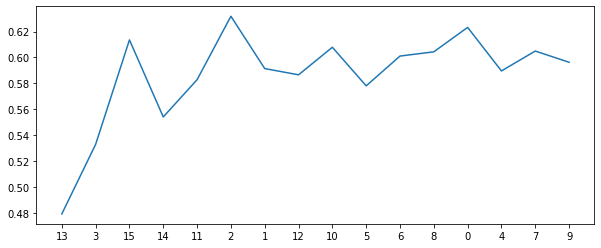

308
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6956636500754148
sensitivity  0.545
auc          0.6203318250377075


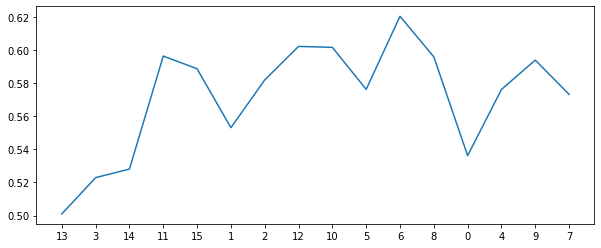

309
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 0, 8, 9, 7, 4, 16]
new features [13, 3, 2, 15, 11]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6455882352941177
sensitivity  0.64
auc          0.6427941176470588


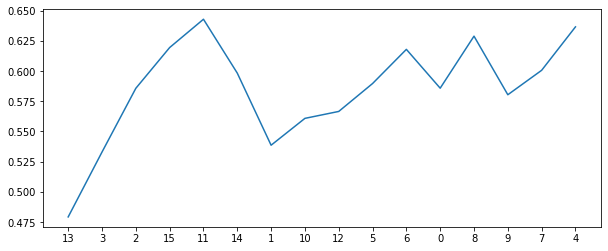

310
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6513574660633484
sensitivity  0.62
auc          0.6356787330316742


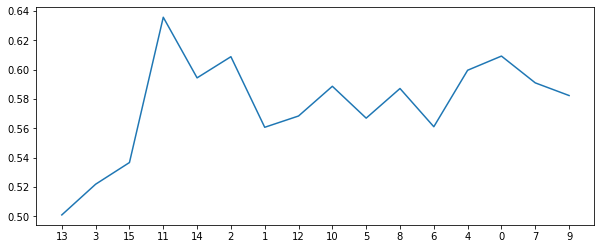

311
all features [13, 11, 3, 15, 2, 14, 1, 10, 12, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 11, 3, 15, 2, 14, 1, 10, 12, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 1, 0.5, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.670814479638009
sensitivity  0.59
auc          0.6304072398190045


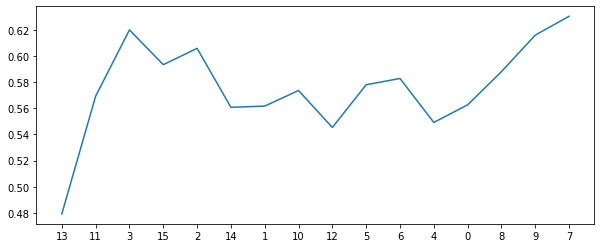

312
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 7, 8, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.6072398190045248
sensitivity  0.62
auc          0.6136199095022624


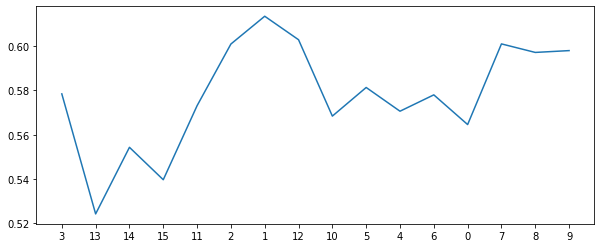

313
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.65
specificity  0.6552413273001508
sensitivity  0.59
auc          0.6226206636500754


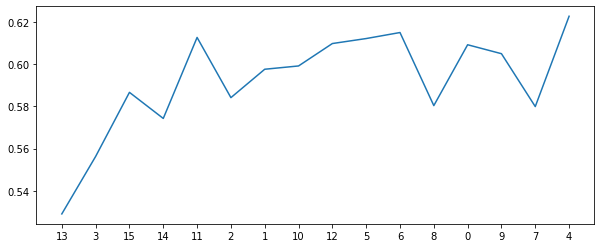

314
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6284313725490196
sensitivity  0.64
auc          0.6342156862745099


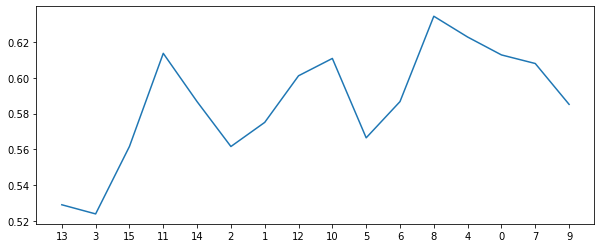

315
all features [13, 3, 2, 11, 15, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 2, 11, 15, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6147435897435898
sensitivity  0.66
auc          0.6373717948717949


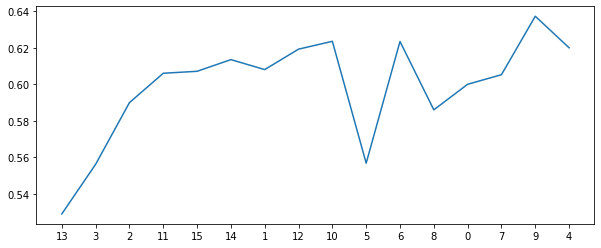

316
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 7, 8, 4, 0, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6552036199095023
sensitivity  0.57
auc          0.6126018099547511


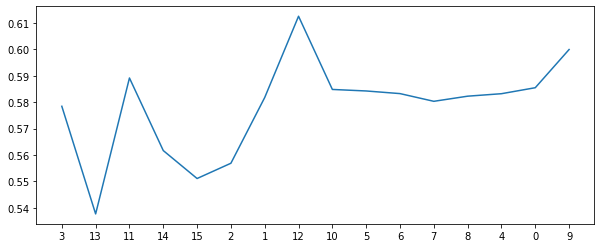

317
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 8, 7]
[0.4, 2, 1000, 1, 0.5, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6263574660633484
sensitivity  0.685
auc          0.6556787330316742


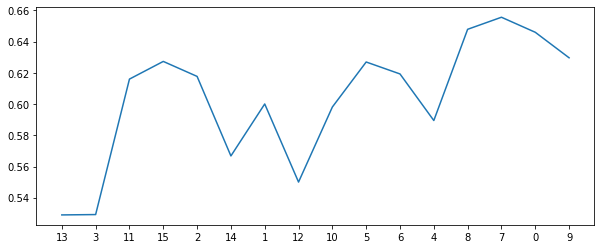

318
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 0, 4, 8, 6, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5860859728506788
sensitivity  0.69
auc          0.6380429864253394


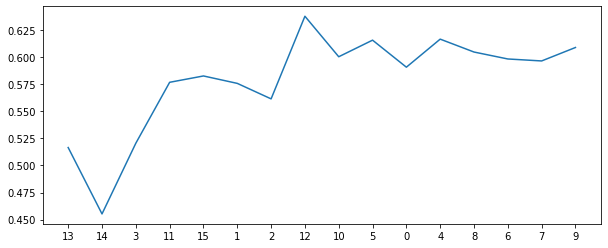

319
all features [3, 13, 15, 11, 14, 2, 1, 10, 12, 6, 5, 8, 0, 7, 4, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 10]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.583974358974359
sensitivity  0.74
auc          0.6619871794871794


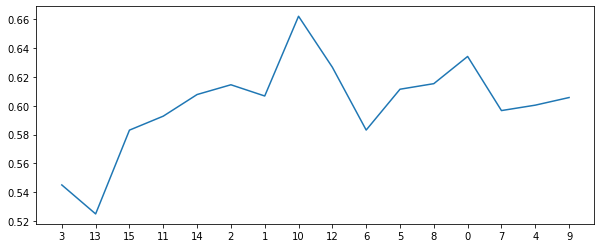

320
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 0, 4, 7, 8, 9]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.5917797888386124
sensitivity  0.765
auc          0.6783898944193062


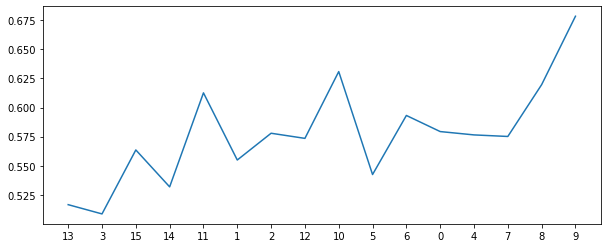

321
all features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 4, 8, 9, 0, 7, 16]
new features [13, 3, 11, 2, 15, 14, 1, 12, 10]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5705128205128205
sensitivity  0.74
auc          0.6552564102564102


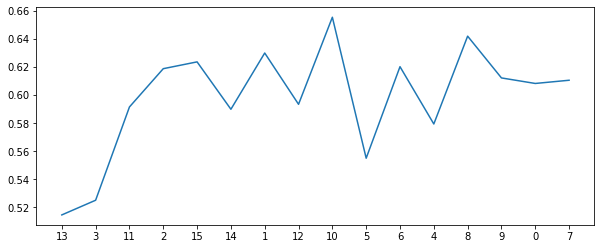

322
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5975867269984917
sensitivity  0.615
auc          0.6062933634992458


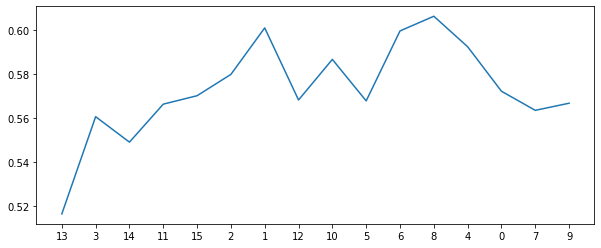

323
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 0.5, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6012820512820513
sensitivity  0.69
auc          0.6456410256410257


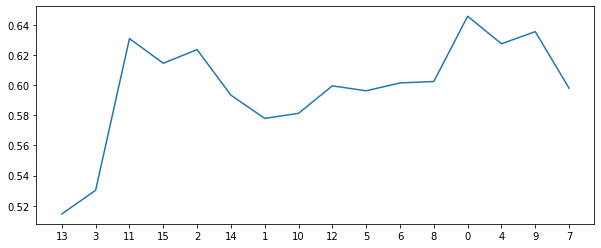

324
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 6, 8, 7, 0, 4, 9, 16]
new features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 6, 8, 7]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6745852187028658
sensitivity  0.565
auc          0.6197926093514329


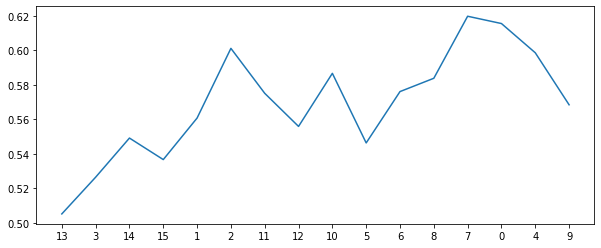

325
all features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 4, 8, 6, 9, 7, 0, 16]
new features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 4, 8]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571429
specificity  0.6725867269984918
sensitivity  0.615
auc          0.6437933634992459


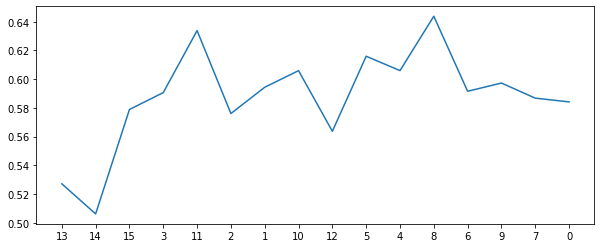

326
all features [14, 13, 3, 2, 1, 15, 11, 12, 10, 5, 6, 4, 7, 8, 0, 9, 16]
new features [14, 13, 3, 2, 1, 15, 11, 12, 10, 5, 6, 4, 7, 8, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.6977375565610859
sensitivity  0.59
auc          0.643868778280543


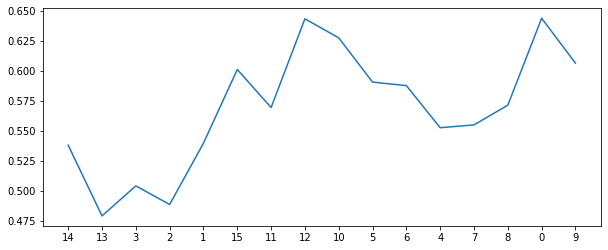

327
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6428571428571428
specificity  0.6417043740573152
sensitivity  0.665
auc          0.6533521870286576


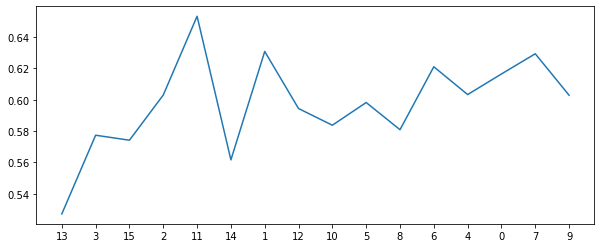

328
all features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5, 8, 0, 6, 4, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5, 8, 0, 6]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.7125
specificity  0.7264705882352941
sensitivity  0.545
auc          0.6357352941176471


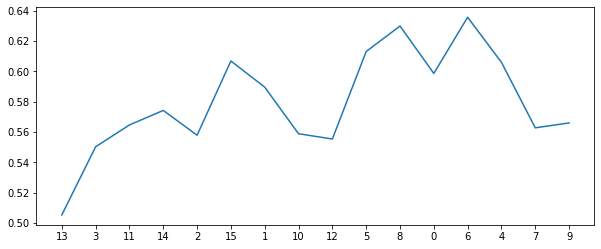

329
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 6, 8, 7, 9, 0, 4, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6225113122171946
sensitivity  0.64
auc          0.6312556561085972


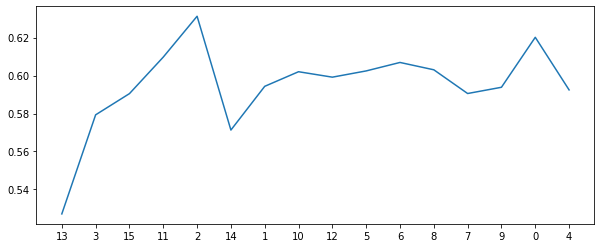

330
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 4, 8, 6, 0, 7, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 4, 8, 6, 0, 7, 9]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6475490196078432
sensitivity  0.62
auc          0.6337745098039216


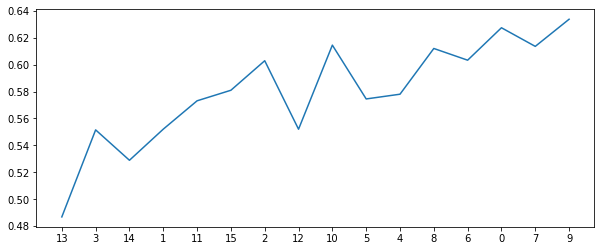

331
all features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 6, 7, 8, 9, 4, 0, 16]
new features [13, 14, 15, 3, 2, 11, 1, 10]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5875
specificity  0.5821266968325792
sensitivity  0.67
auc          0.6260633484162895


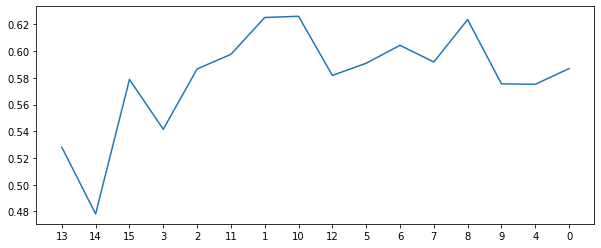

332
all features [14, 13, 3, 15, 2, 1, 11, 12, 10, 5, 4, 7, 8, 6, 0, 9, 16]
new features [14, 13, 3, 15, 2, 1, 11, 12]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6340120663650075
sensitivity  0.62
auc          0.6270060331825038


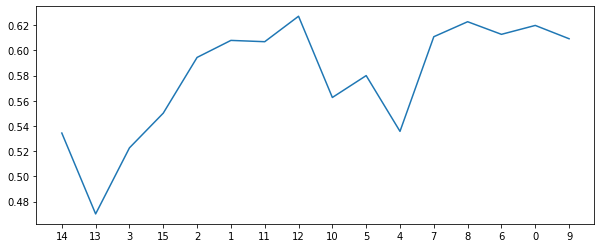

333
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 8, 6, 0, 7, 9, 4, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.5551659125188537
sensitivity  0.715
auc          0.6350829562594268


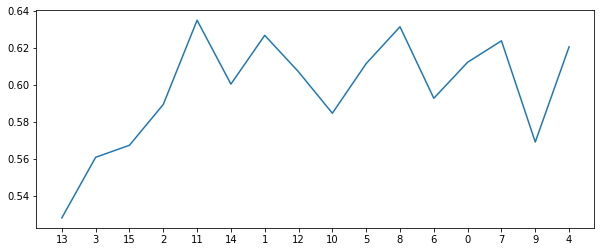

334
all features [3, 13, 11, 14, 1, 15, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 11]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5858597285067874
sensitivity  0.67
auc          0.6279298642533937


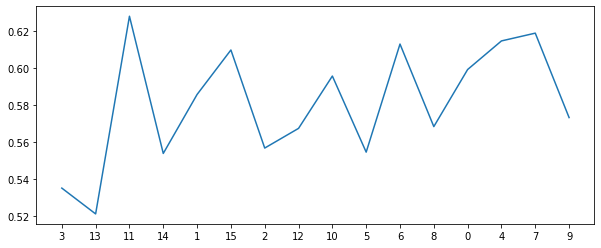

335
all features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 7, 8, 9, 0, 4, 16]
new features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 7, 8, 9, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.6012443438914027
sensitivity  0.685
auc          0.6431221719457013


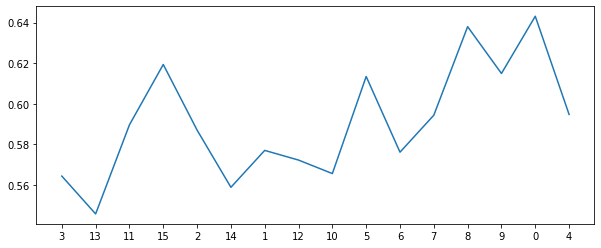

336
all features [13, 14, 3, 15, 1, 2, 12, 11, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 14, 3, 15, 1, 2, 12, 11, 10]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5821428571428572
specificity  0.5723981900452488
sensitivity  0.715
auc          0.6436990950226245


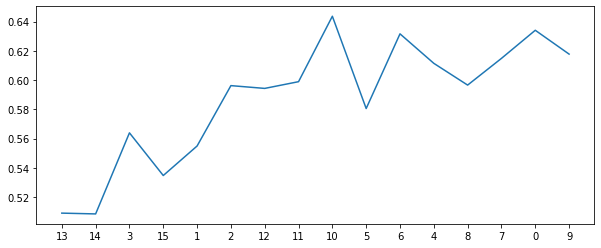

337
all features [15, 13, 14, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [15, 13, 14, 3, 11, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.6
specificity  0.5917797888386124
sensitivity  0.71
auc          0.6508898944193062


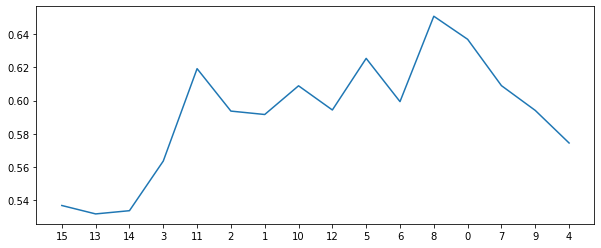

338
all features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5, 6, 7, 8, 0, 4, 9, 16]
new features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5, 6, 7, 8, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.6033182503770739
sensitivity  0.665
auc          0.6341591251885369


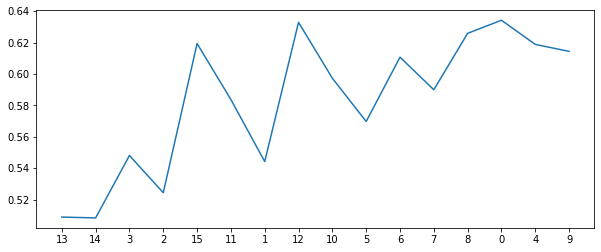

339
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 8, 4, 6, 0, 7, 9]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5464285714285714
specificity  0.5282051282051282
sensitivity  0.785
auc          0.6566025641025641


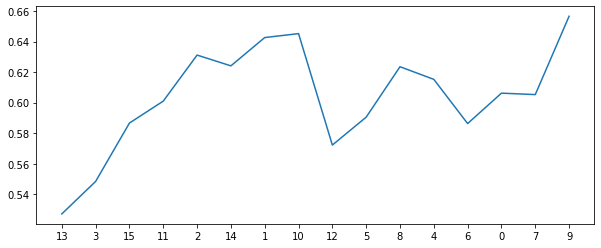

340
all features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 0, 6, 8, 7, 4, 9, 16]
new features [13, 3, 11, 14, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6129336349924586
sensitivity  0.685
auc          0.6489668174962293


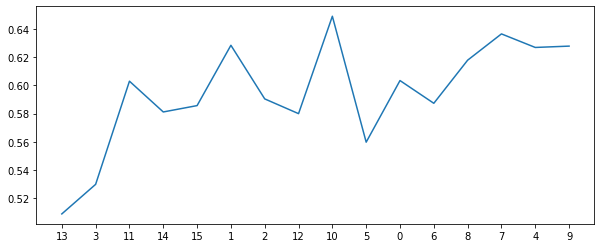

341
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 3, 11, 15, 2]
[0.4, 2, 1000, 1, 1, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5464285714285715
specificity  0.5339366515837104
sensitivity  0.715
auc          0.6244683257918552


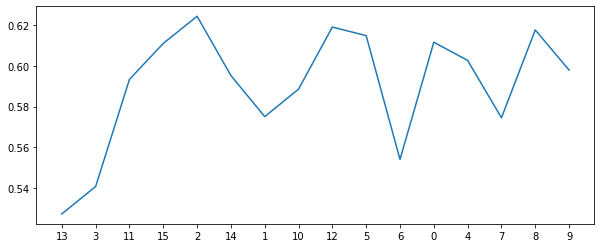

342
all features [13, 3, 14, 2, 1, 11, 15, 12, 10, 6, 5, 8, 4, 7, 0, 9, 16]
new features [13, 3, 14, 2, 1, 11, 15, 12, 10, 6, 5, 8, 4, 7, 0, 9]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6957767722473605
sensitivity  0.565
auc          0.6303883861236802


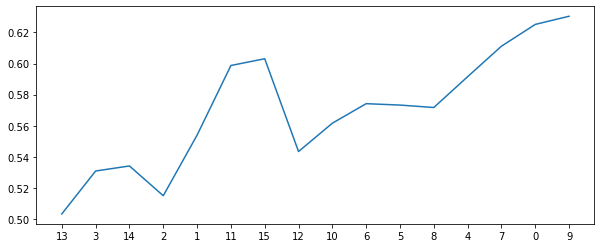

343
all features [13, 14, 3, 15, 2, 11, 1, 10, 12, 5, 8, 7, 4, 6, 9, 0, 16]
new features [13, 14, 3, 15, 2, 11, 1, 10]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.639894419306184
sensitivity  0.645
auc          0.642447209653092


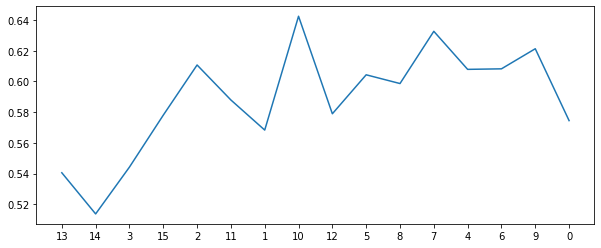

344
all features [13, 3, 14, 1, 2, 15, 11, 12, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 3, 14, 1, 2, 15, 11, 12]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7014705882352941
sensitivity  0.62
auc          0.6607352941176471


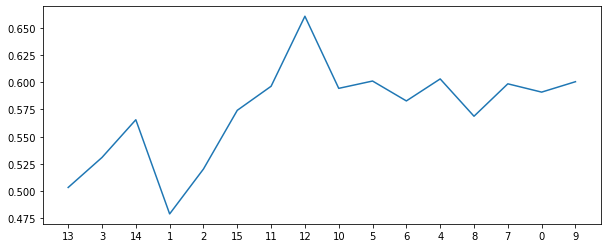

345
all features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 8, 6, 7, 9, 0, 4, 16]
new features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 8, 6, 7]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6705882352941177
sensitivity  0.61
auc          0.6402941176470589


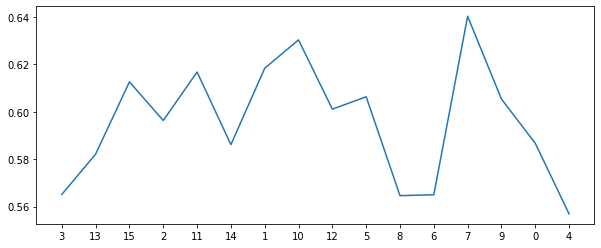

346
all features [13, 3, 14, 2, 11, 15, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 2, 11, 15, 1, 10, 12, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.691892911010558
sensitivity  0.595
auc          0.643446455505279


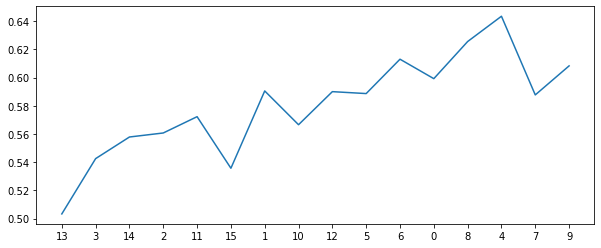

347
all features [13, 3, 11, 2, 14, 15, 1, 10, 12, 5, 6, 8, 9, 7, 0, 4, 16]
new features [13, 3, 11, 2, 14, 15, 1, 10, 12, 5, 6, 8, 9, 7, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6571266968325792
sensitivity  0.64
auc          0.6485633484162896


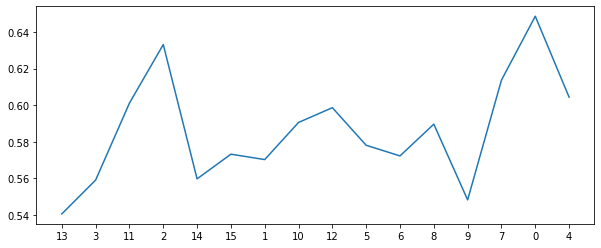

348
all features [13, 3, 14, 1, 15, 2, 11, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 1, 15, 2, 11, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6282428355957768
sensitivity  0.665
auc          0.6466214177978884


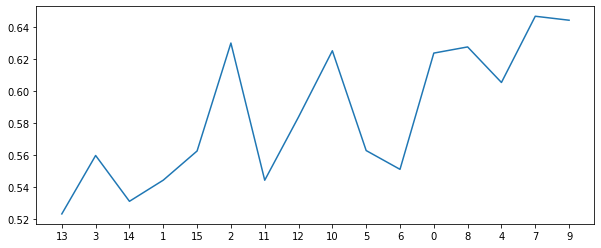

349
all features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 6, 8, 9, 4, 7, 0, 16]
new features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 6, 8, 9, 4]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5860482654600302
sensitivity  0.67
auc          0.6280241327300151


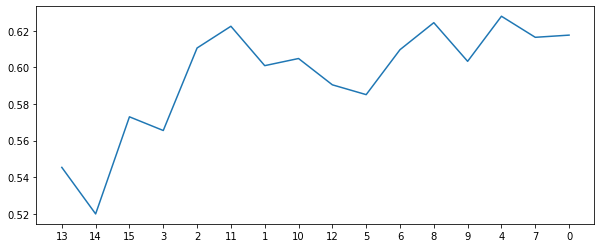

350
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 4, 8, 6, 7, 0, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 4, 8, 6, 7, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6610482654600301
sensitivity  0.61
auc          0.6355241327300151


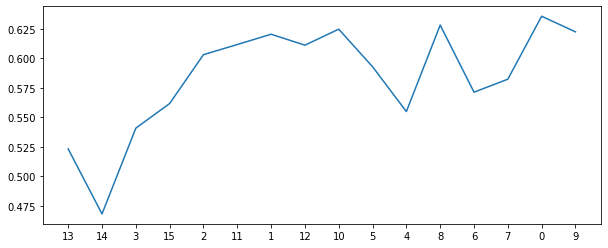

351
all features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 0, 8, 4, 6, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.5995475113122172
sensitivity  0.71
auc          0.6547737556561086


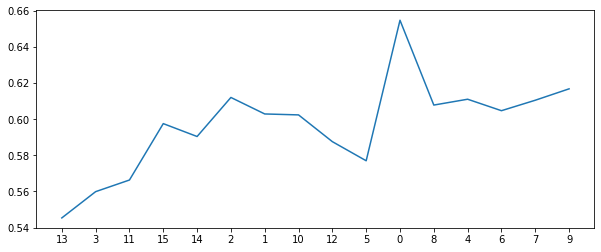

352
all features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6187405731523379
sensitivity  0.665
auc          0.641870286576169


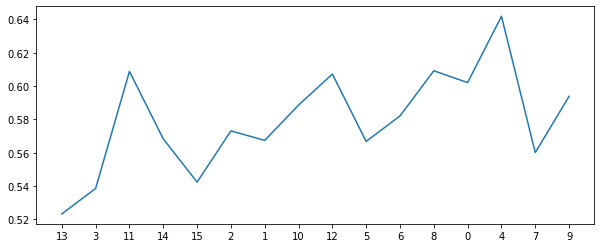

353
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 8, 6, 0, 7, 9, 4, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5918174962292609
sensitivity  0.69
auc          0.6409087481146305


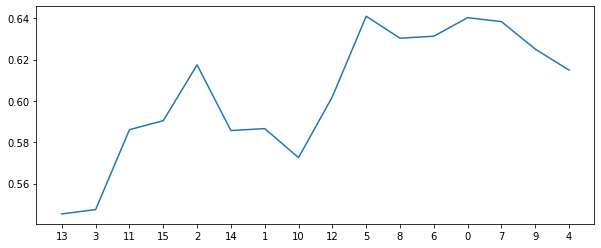

354
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5607142857142857
specificity  0.5454374057315234
sensitivity  0.76
auc          0.6527187028657617


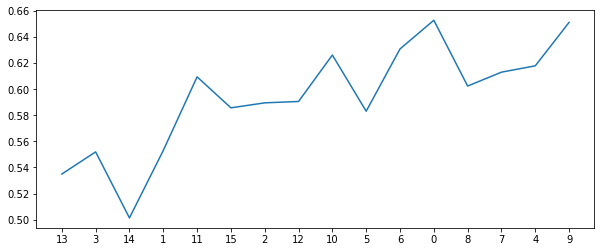

355
all features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 7, 9, 0, 16]
new features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5392857142857143
specificity  0.522473604826546
sensitivity  0.76
auc          0.6412368024132731


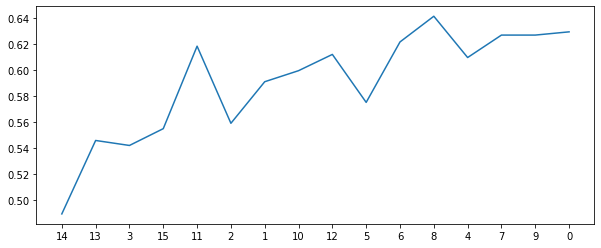

356
all features [13, 3, 14, 2, 1, 15, 11, 12, 10, 5, 4, 7, 6, 8, 0, 9, 16]
new features [13, 3, 14, 2, 1, 15, 11, 12]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6071266968325791
sensitivity  0.67
auc          0.6385633484162896


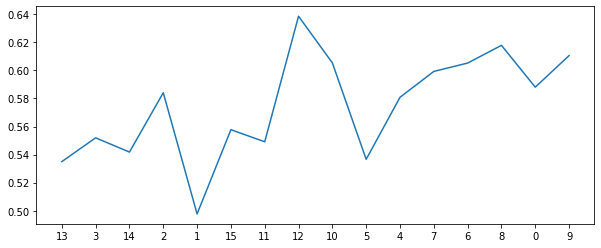

357
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 8, 6, 0, 7, 9, 4, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 8, 6, 0]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5446428571428572
specificity  0.5262066365007542
sensitivity  0.785
auc          0.6556033182503771


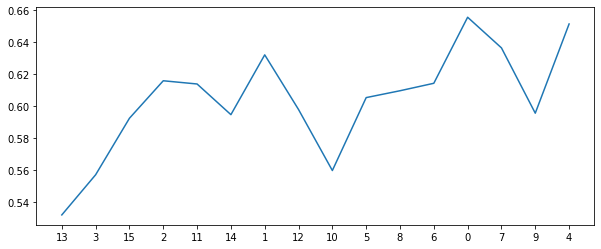

358
all features [13, 11, 3, 15, 2, 14, 1, 10, 12, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 11, 3]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5571266968325792
sensitivity  0.72
auc          0.6385633484162896


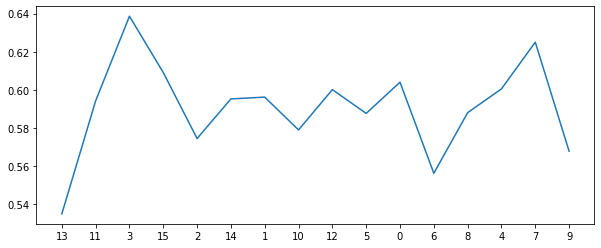

359
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 7, 8, 0, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 7]
[0.4, 2, 1000, 1, 1, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5552790346907994
sensitivity  0.76
auc          0.6576395173453997


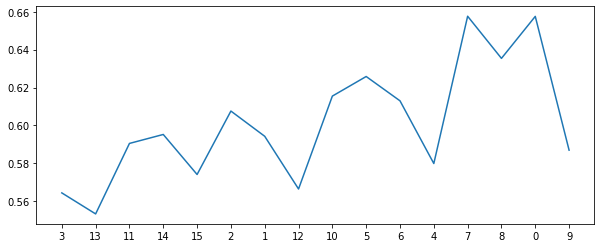

360
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 8, 7, 4, 9]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.6976998491704374
sensitivity  0.64
auc          0.6688499245852187


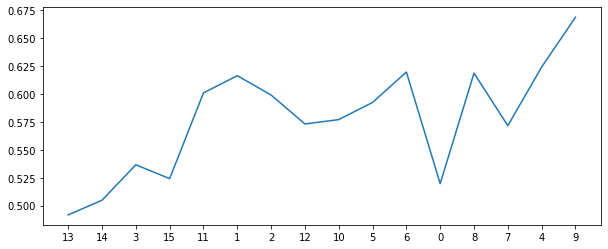

361
all features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 8, 6, 9, 0, 4, 7, 16]
new features [14, 13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5898190045248869
sensitivity  0.665
auc          0.6274095022624434


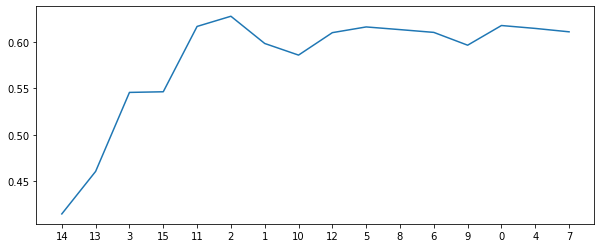

362
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 4, 5, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 4, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6957390648567119
sensitivity  0.56
auc          0.627869532428356


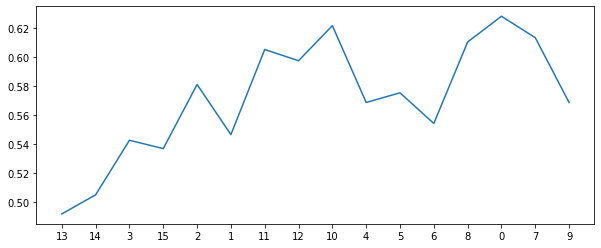

363
all features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 8, 6, 0, 7, 9, 4, 16]
new features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 8, 6]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6975867269984917
sensitivity  0.545
auc          0.6212933634992458


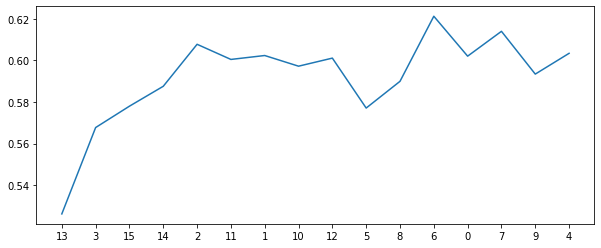

364
all features [13, 3, 2, 14, 11, 15, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 3, 2, 14, 11, 15, 1, 12, 10, 5, 0, 6, 8]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6880090497737557
sensitivity  0.59
auc          0.6390045248868779


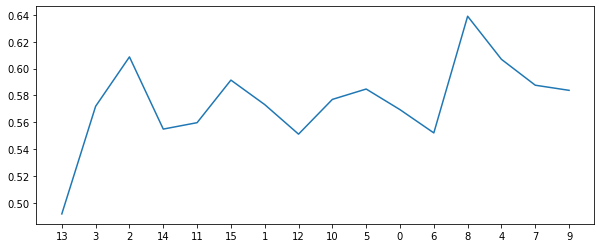

365
all features [13, 3, 2, 14, 15, 11, 1, 12, 10, 5, 6, 8, 9, 7, 0, 4, 16]
new features [13, 3, 2, 14, 15, 11, 1, 12, 10, 5, 6, 8, 9, 7, 0, 4]
[0.4, 2, 1000, 1, 1, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6591251885369532
sensitivity  0.565
auc          0.6120625942684766


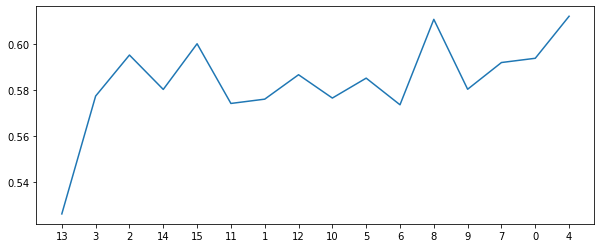

366
all features [13, 3, 1, 15, 14, 11, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 1, 15, 14, 11, 2, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.625
specificity  0.6225867269984917
sensitivity  0.665
auc          0.6437933634992459


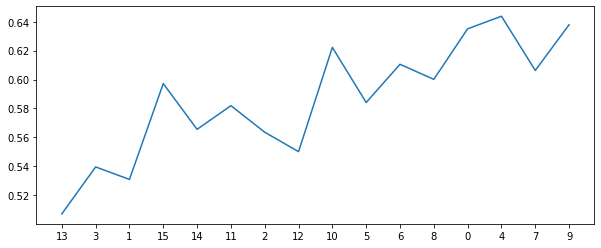

367
all features [13, 15, 14, 3, 2, 11, 1, 10, 12, 5, 6, 8, 4, 9, 7, 0, 16]
new features [13, 15, 14, 3, 2, 11, 1, 10, 12]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.549396681749623
sensitivity  0.69
auc          0.6196983408748115


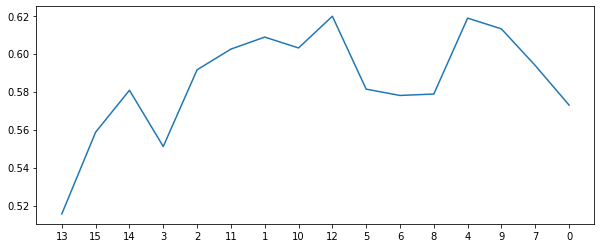

368
all features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 8, 6, 4, 7, 0, 9, 16]
new features [14, 3, 13, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.603393665158371
sensitivity  0.67
auc          0.6366968325791855


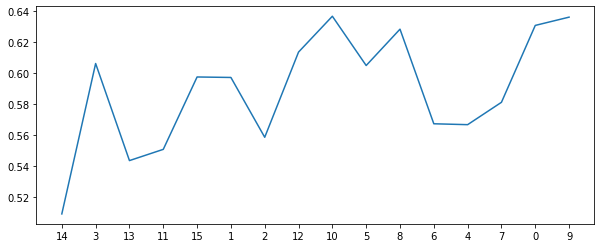

369
all features [3, 13, 15, 2, 11, 14, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 15, 2, 11, 14, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5531674208144797
sensitivity  0.76
auc          0.6565837104072398


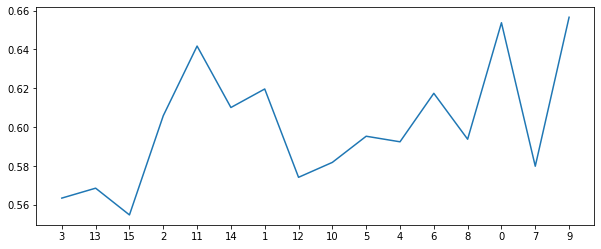

370
all features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 2, 15, 1, 12, 10]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6283182503770739
sensitivity  0.645
auc          0.636659125188537


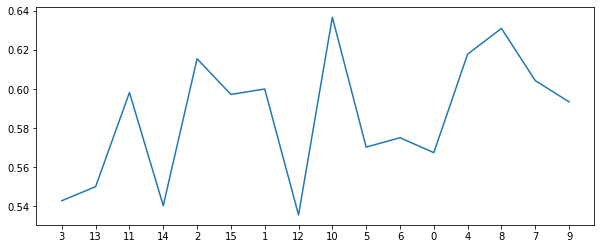

371
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 9, 6, 7, 8, 0, 4, 16]
new features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 9, 6, 7, 8, 0]
[0.4, 2, 1000, 1, 1, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5801282051282051
sensitivity  0.735
auc          0.6575641025641026


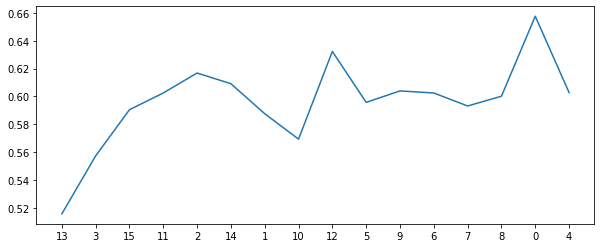

372
all features [13, 3, 14, 15, 12, 1, 2, 11, 10, 5, 6, 0, 4, 7, 8, 9, 16]
new features [13, 3, 14, 15, 12, 1, 2, 11, 10, 5, 6, 0, 4, 7, 8, 9]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5821266968325792
sensitivity  0.695
auc          0.6385633484162896


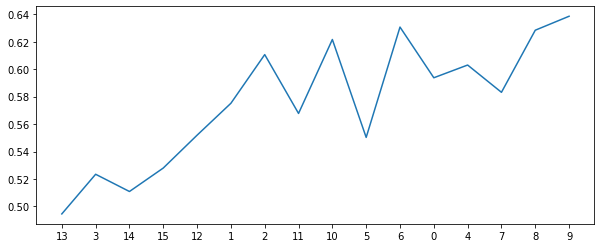

373
all features [15, 14, 13, 3, 11, 2, 1, 10, 12, 5, 8, 9, 6, 4, 7, 0, 16]
new features [15, 14, 13, 3, 11, 2, 1, 10, 12, 5, 8, 9]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.5531297134238311
sensitivity  0.735
auc          0.6440648567119155


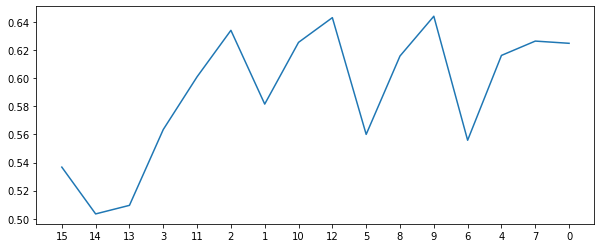

374
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 4, 8, 6, 0, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 4, 8, 6, 0]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.57447209653092
sensitivity  0.735
auc          0.6547360482654601


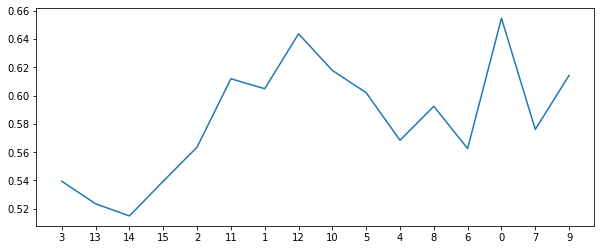

375
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.5302413273001508
sensitivity  0.785
auc          0.6576206636500754


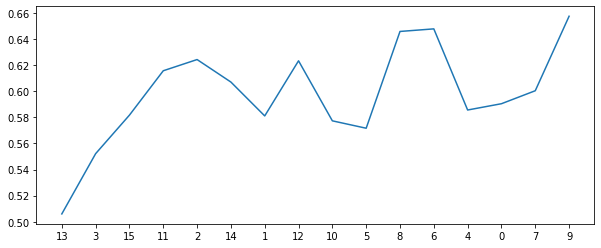

376
all features [3, 13, 11, 2, 15, 14, 1, 12, 10, 5, 8, 0, 6, 4, 7, 9, 16]
new features [3, 13, 11, 2, 15, 14, 1, 12, 10]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6032805429864253
sensitivity  0.64
auc          0.6216402714932127


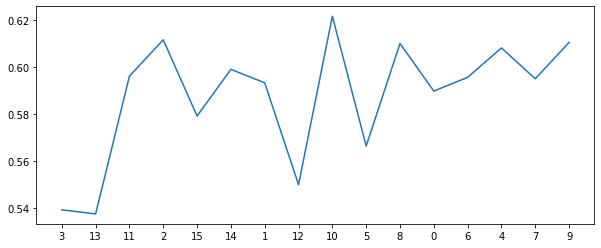

377
all features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4]
[0.4, 2, 1000, 1, 1, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5214285714285715
specificity  0.5032805429864253
sensitivity  0.76
auc          0.6316402714932127


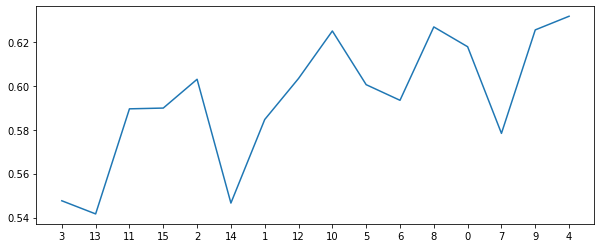

378
all features [13, 14, 3, 11, 1, 15, 2, 12, 10, 5, 0, 6, 7, 8, 9, 4, 16]
new features [13, 14, 3, 11, 1, 15, 2, 12, 10, 5, 0, 6, 7, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6782051282051282
sensitivity  0.565
auc          0.6216025641025641


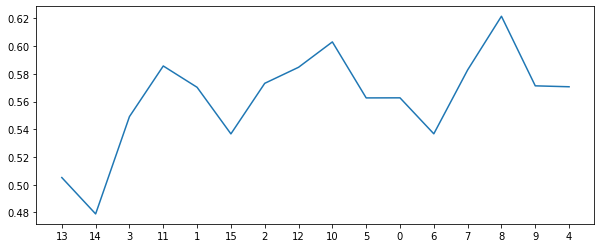

379
all features [13, 14, 3, 11, 15, 2, 1, 10, 12, 5, 6, 7, 8, 0, 9, 4, 16]
new features [13, 14, 3, 11, 15, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6475867269984917
sensitivity  0.64
auc          0.6437933634992459


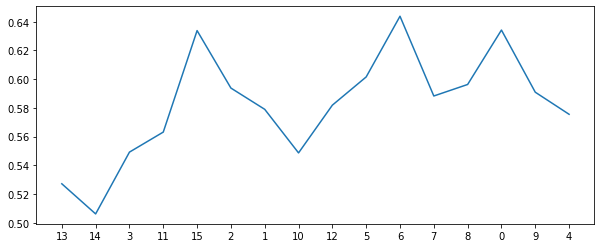

380
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7072775263951735
sensitivity  0.54
auc          0.6236387631975867


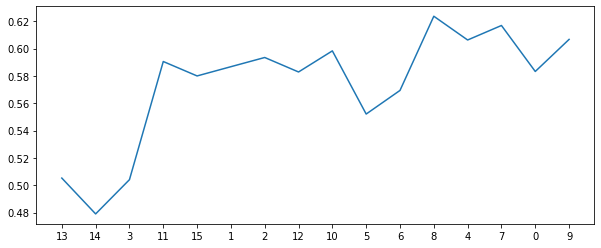

381
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6125
specificity  0.6090120663650075
sensitivity  0.665
auc          0.6370060331825038


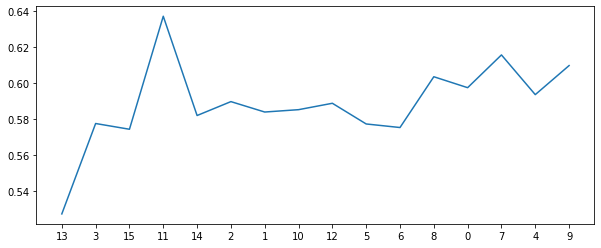

382
all features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6, 4, 7, 0, 8, 9, 16]
new features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7034690799396682
sensitivity  0.59
auc          0.6467345399698341


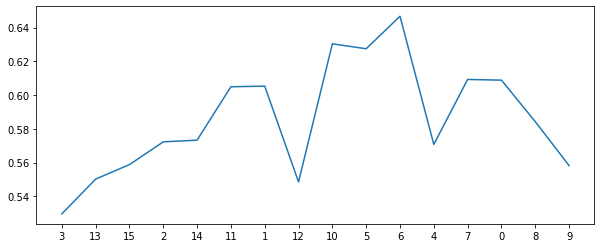

383
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 8, 6, 7, 9, 0, 4, 16]
new features [13, 3, 11, 15, 2]
[0.4, 2, 1000, 1, 1, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.625
specificity  0.622473604826546
sensitivity  0.665
auc          0.643736802413273


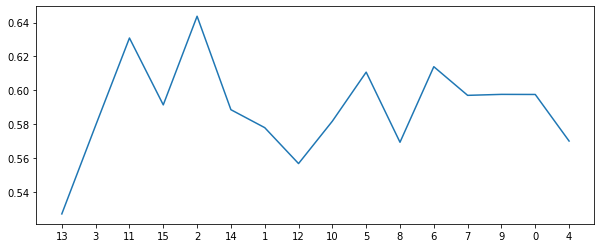

384
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6341628959276018
sensitivity  0.645
auc          0.6395814479638009


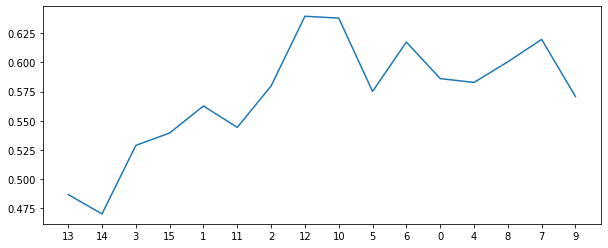

385
all features [13, 14, 2, 15, 11, 3, 1, 10, 12, 5, 6, 8, 9, 0, 7, 4, 16]
new features [13, 14, 2, 15, 11, 3, 1, 10, 12, 5, 6, 8, 9, 0, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6030542986425339
sensitivity  0.685
auc          0.6440271493212669


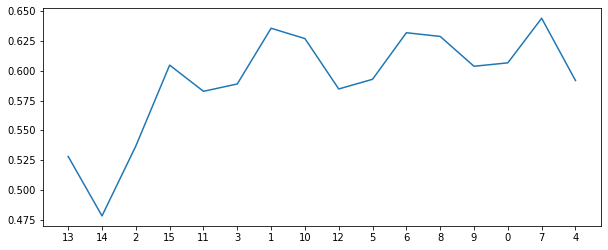

386
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6514705882352941
sensitivity  0.62
auc          0.6357352941176471


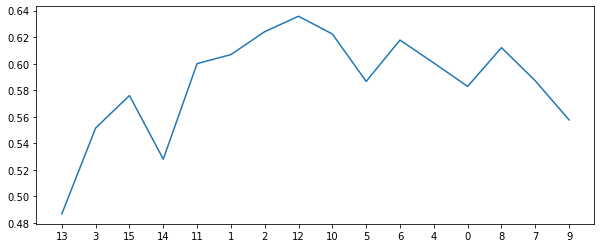

387
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6012820512820513
sensitivity  0.685
auc          0.6431410256410256


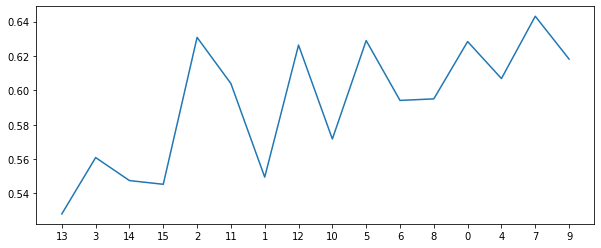

388
all features [13, 15, 3, 11, 14, 2, 1, 10, 12, 5, 4, 6, 8, 7, 0, 9, 16]
new features [13, 15, 3, 11, 14]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6166289592760181
sensitivity  0.645
auc          0.6308144796380091


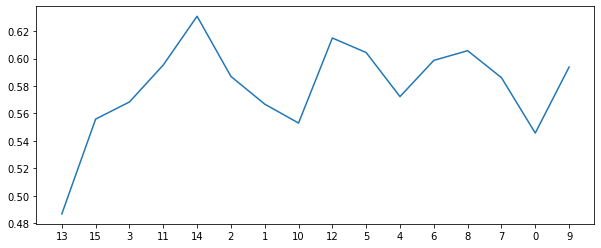

389
all features [13, 11, 3, 15, 14, 2, 1, 10, 12, 5, 4, 6, 8, 9, 0, 7, 16]
new features [13, 11, 3, 15, 14, 2, 1]
[0.4, 2, 1000, 1, 1, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5877450980392157
sensitivity  0.665
auc          0.6263725490196078


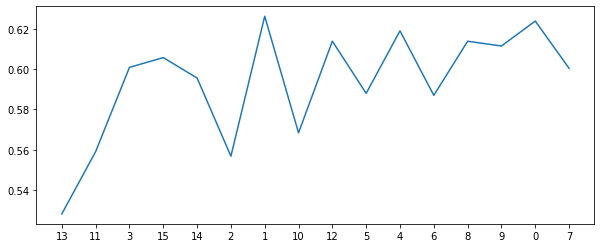

390
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5553571428571429
specificity  0.543552036199095
sensitivity  0.72
auc          0.6317760180995475


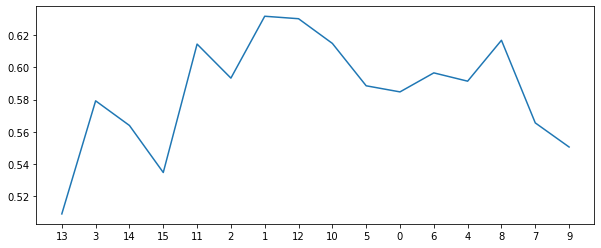

391
all features [13, 15, 14, 11, 2, 3, 1, 10, 12, 5, 6, 7, 4, 8, 0, 9, 16]
new features [13, 15, 14, 11, 2, 3]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5321428571428571
specificity  0.5145927601809954
sensitivity  0.765
auc          0.6397963800904978


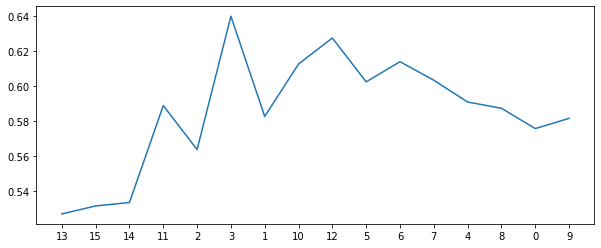

392
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6090874811463046
sensitivity  0.64
auc          0.6245437405731523


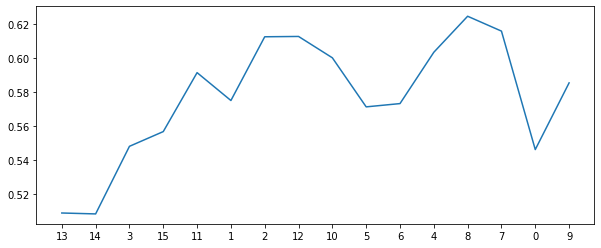

393
all features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 8, 0, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5685897435897436
sensitivity  0.74
auc          0.6542948717948718


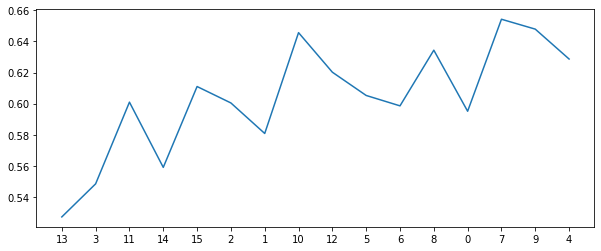

394
all features [13, 14, 15, 11, 3, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 11, 3, 2, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6456636500754148
sensitivity  0.64
auc          0.6428318250377074


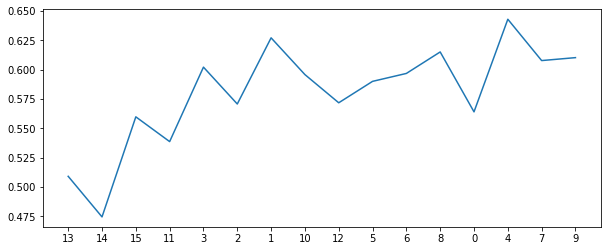

395
all features [11, 13, 3, 15, 2, 14, 1, 12, 10, 5, 6, 8, 9, 0, 7, 4, 16]
new features [11, 13, 3, 15, 2, 14, 1, 12, 10, 5, 6, 8, 9, 0, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5725490196078431
sensitivity  0.71
auc          0.6412745098039215


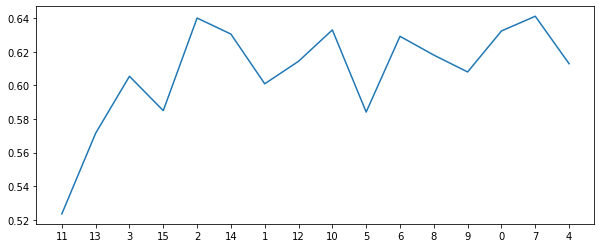

396
all features [13, 14, 3, 11, 1, 2, 15, 10, 12, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 14, 3, 11, 1, 2, 15, 10, 12, 5, 6, 0, 8, 7, 4]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6976621417797888
sensitivity  0.515
auc          0.6063310708898944


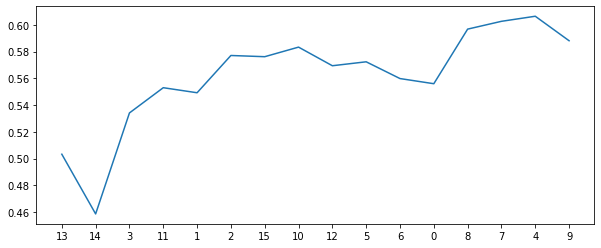

397
all features [14, 13, 2, 15, 11, 3, 1, 10, 12, 5, 6, 8, 9, 7, 0, 4, 16]
new features [14, 13, 2, 15, 11, 3, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6437782805429865
sensitivity  0.64
auc          0.6418891402714931


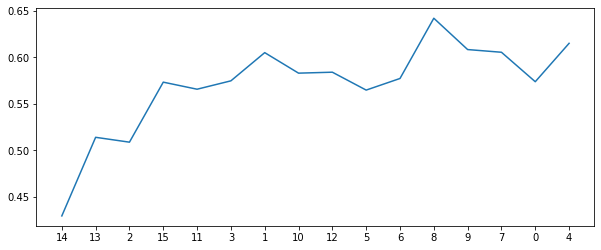

398
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 7, 4, 0, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6937782805429864
sensitivity  0.56
auc          0.6268891402714932


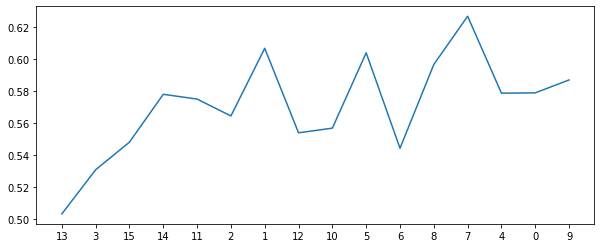

399
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6514328808446456
sensitivity  0.61
auc          0.6307164404223228


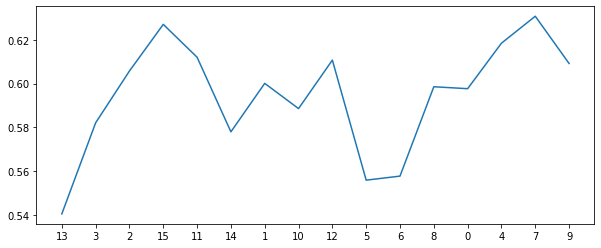

400
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 0, 8, 7, 6, 4, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6696428571428572
specificity  0.6764705882352942
sensitivity  0.595
auc          0.6357352941176471


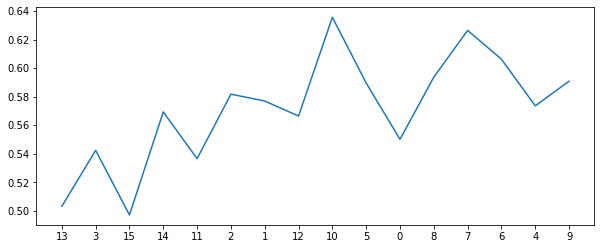

401
all features [3, 13, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 9, 0, 7, 4, 16]
new features [3, 13, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6625
specificity  0.6686651583710407
sensitivity  0.59
auc          0.6293325791855203


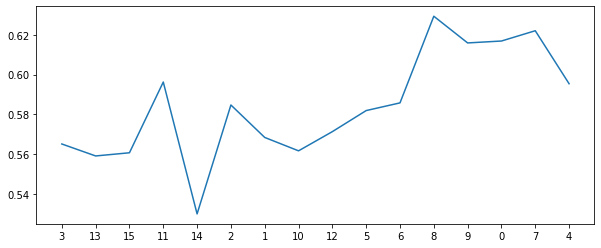

402
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 0, 6, 7, 8, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6264705882352941
sensitivity  0.64
auc          0.6332352941176471


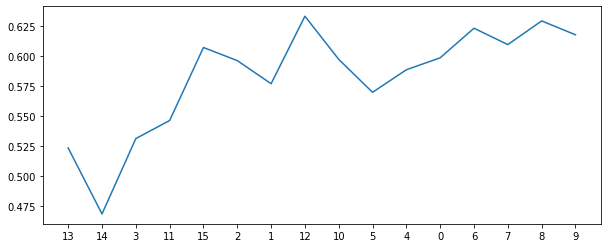

403
all features [13, 14, 15, 2, 11, 3, 1, 10, 12, 5, 8, 4, 6, 7, 9, 0, 16]
new features [13, 14, 15, 2, 11, 3, 1, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5803571428571428
specificity  0.5686651583710407
sensitivity  0.735
auc          0.6518325791855204


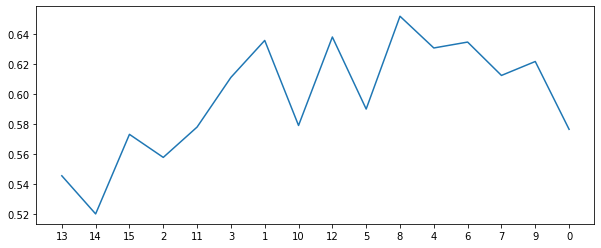

404
all features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 8, 4, 6, 7, 0, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6302036199095022
sensitivity  0.645
auc          0.6376018099547511


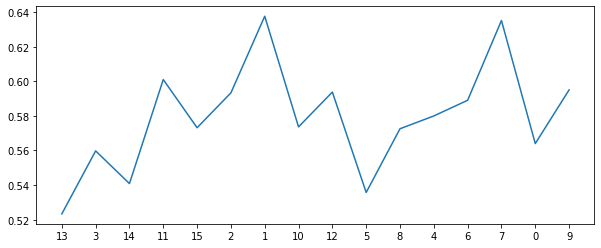

405
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5858974358974359
sensitivity  0.71
auc          0.6479487179487179


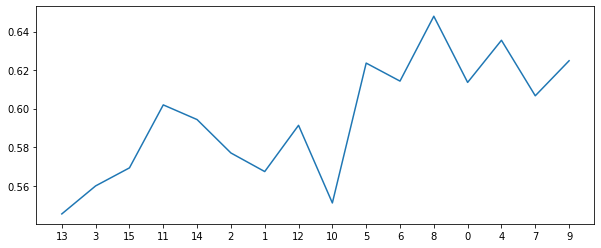

406
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 8, 6, 0, 7, 4, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 8, 6, 0, 7]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6648567119155354
sensitivity  0.665
auc          0.6649283559577678


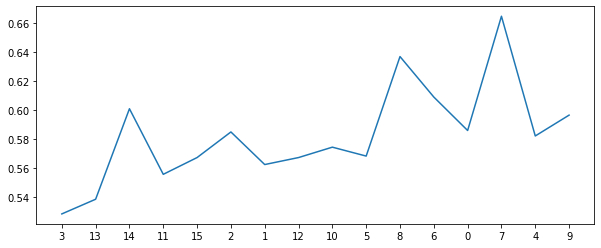

407
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 7, 8, 9, 0, 4, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 7, 8]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6017857142857143
specificity  0.5955128205128205
sensitivity  0.685
auc          0.6402564102564103


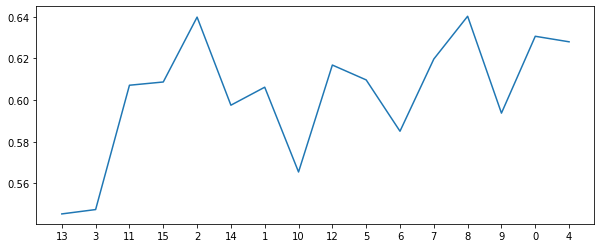

408
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 7, 8, 4, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5588989441930619
sensitivity  0.695
auc          0.626949472096531


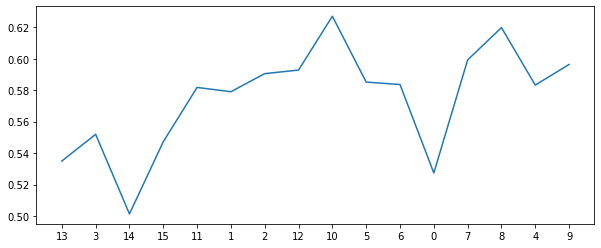

409
all features [13, 15, 11, 3, 14, 2, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 15, 11, 3, 14, 2, 1, 10]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5553571428571429
specificity  0.5416666666666666
sensitivity  0.74
auc          0.6408333333333334


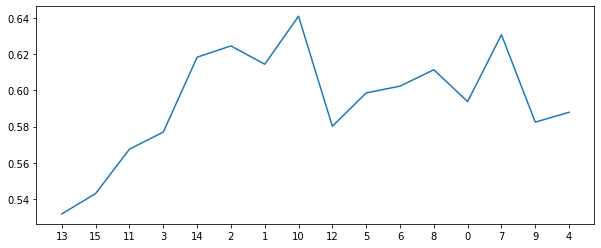

410
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 8, 6, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.6032428355957767
sensitivity  0.67
auc          0.6366214177978884


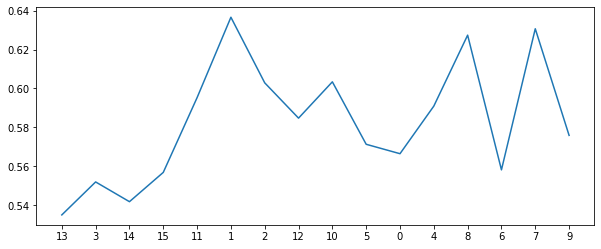

411
all features [13, 3, 2, 11, 14, 15, 1, 10, 12, 6, 5, 8, 0, 7, 4, 9, 16]
new features [13, 3, 2, 11, 14, 15, 1, 10]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.530052790346908
sensitivity  0.785
auc          0.657526395173454


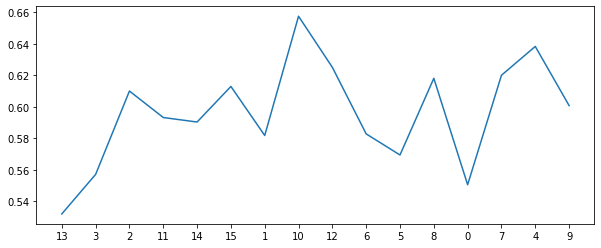

412
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 8, 0, 4, 6, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 8, 0, 4, 6]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5956259426847662
sensitivity  0.685
auc          0.6403129713423831


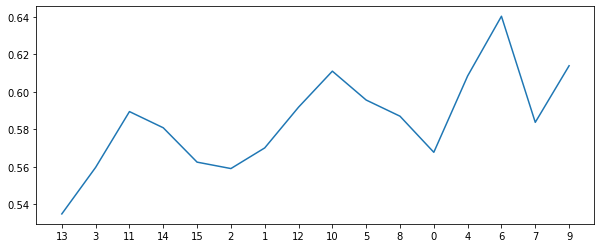

413
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 9, 0, 4, 7, 16]
new features [13, 3, 11, 15, 2]
[0.4, 2, 1000, 1, 1, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5375
specificity  0.5223981900452489
sensitivity  0.74
auc          0.6311990950226244


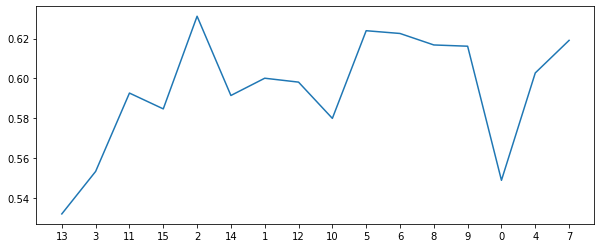

414
all features [13, 11, 3, 14, 15, 2, 1, 10, 12, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 11, 3, 14, 15, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.653393665158371
sensitivity  0.57
auc          0.6116968325791855


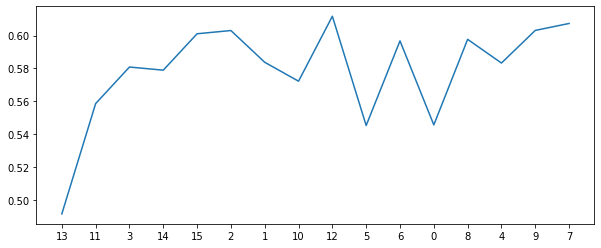

415
all features [13, 11, 15, 14, 2, 3, 1, 10, 12, 5, 8, 6, 9, 0, 4, 7, 16]
new features [13, 11, 15, 14, 2, 3, 1]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6167043740573153
sensitivity  0.645
auc          0.6308521870286576


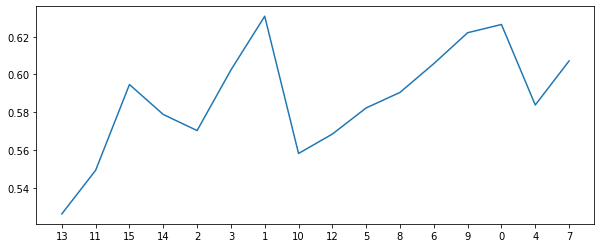

416
all features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6668552036199095
sensitivity  0.535
auc          0.6009276018099547


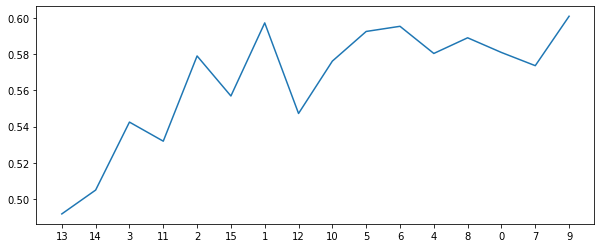

417
all features [13, 15, 3, 11, 2, 14, 1, 10, 12, 5, 6, 0, 8, 9, 7, 4, 16]
new features [13, 15, 3, 11, 2, 14, 1, 10, 12]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6375
specificity  0.6380090497737556
sensitivity  0.645
auc          0.6415045248868778


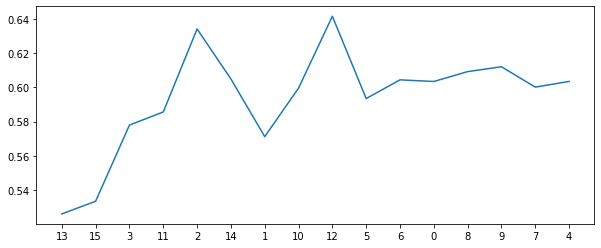

418
all features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 8, 6, 0, 7, 4, 9, 16]
new features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 8, 6]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.7071428571428571
specificity  0.7207390648567119
sensitivity  0.54
auc          0.6303695324283559


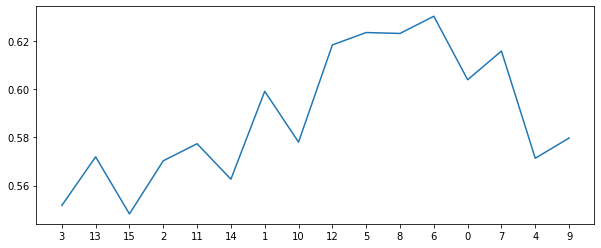

419
all features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 6, 8, 7, 9, 0, 4, 16]
new features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6418552036199094
sensitivity  0.645
auc          0.6434276018099547


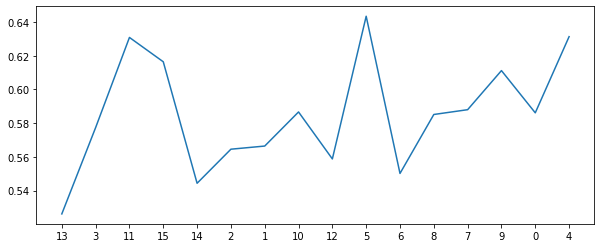

420
all features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6127828054298643
sensitivity  0.665
auc          0.6388914027149322


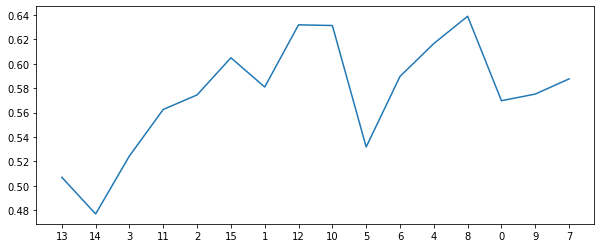

421
all features [13, 15, 3, 14, 11, 2, 1, 10, 12, 5, 8, 6, 4, 0, 9, 7, 16]
new features [13, 15, 3, 14, 11, 2, 1, 10, 12, 5, 8, 6, 4, 0]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6125
specificity  0.6091251885369533
sensitivity  0.66
auc          0.6345625942684766


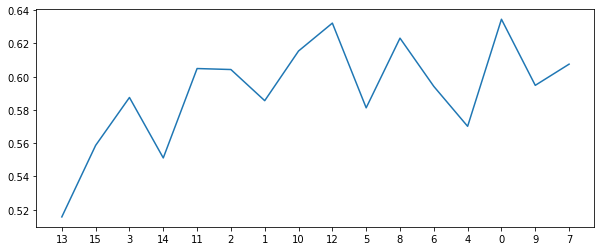

422
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 8, 0, 6, 7, 4, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 8, 0]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6301659125188537
sensitivity  0.64
auc          0.6350829562594269


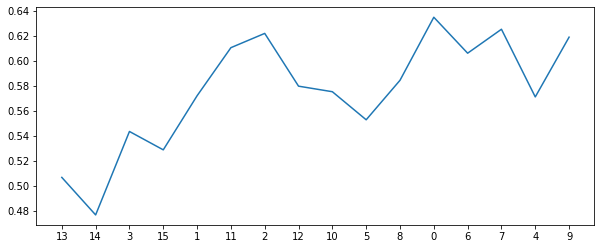

423
all features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 6, 0, 8, 9, 4, 7, 16]
new features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6072021116138763
sensitivity  0.665
auc          0.6361010558069382


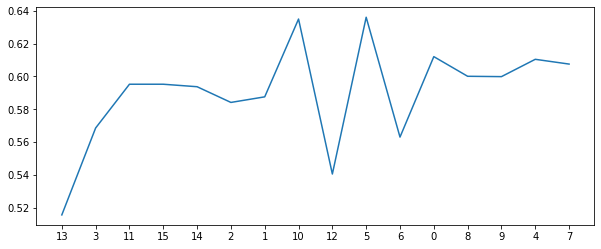

424
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 4, 0, 8, 6, 7, 9, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.593552036199095
sensitivity  0.69
auc          0.6417760180995475


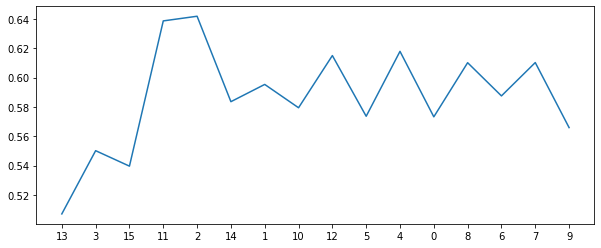

425
all features [13, 15, 3, 11, 14, 2, 1, 10, 12, 5, 6, 8, 9, 0, 7, 4, 16]
new features [13, 15, 3, 11, 14, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5763951734539969
sensitivity  0.72
auc          0.6481975867269986


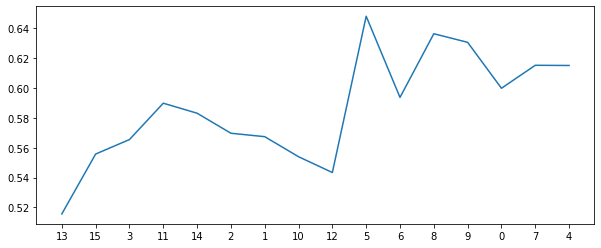

426
all features [13, 14, 3, 2, 1, 15, 11, 12, 10, 5, 6, 0, 7, 8, 9, 4, 16]
new features [13, 14, 3, 2, 1, 15, 11, 12, 10]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5642857142857143
specificity  0.5512820512820513
sensitivity  0.745
auc          0.6481410256410256


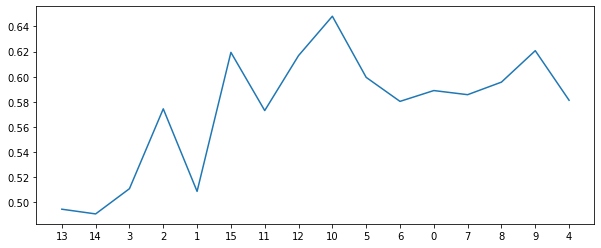

427
all features [13, 14, 15, 11, 3, 2, 1, 10, 12, 5, 6, 8, 7, 4, 0, 9, 16]
new features [13, 14, 15, 11, 3, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5214285714285715
specificity  0.5052413273001508
sensitivity  0.74
auc          0.6226206636500754


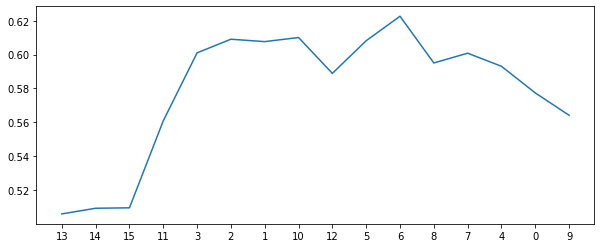

428
all features [13, 3, 14, 11, 15, 1, 2, 10, 12, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 10, 12, 5, 8]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5875
specificity  0.5762820512820512
sensitivity  0.74
auc          0.6581410256410256


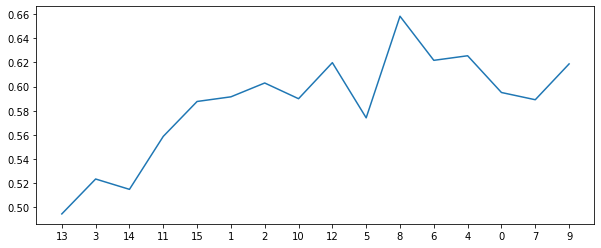

429
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5609351432880845
sensitivity  0.69
auc          0.6254675716440422


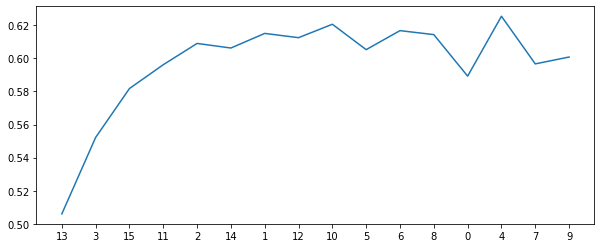

430
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6125
specificity  0.6091628959276019
sensitivity  0.66
auc          0.6345814479638009


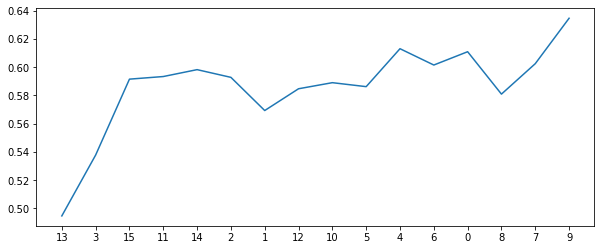

431
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 8, 6, 9, 0, 7, 4, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 8, 6, 9, 0, 7]
[0.4, 2, 1000, 1, 1, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.5435520361990951
sensitivity  0.735
auc          0.6392760180995475


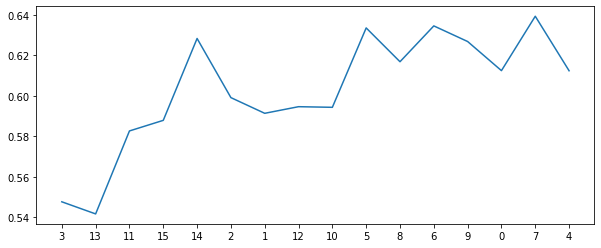

432
all features [13, 3, 14, 15, 1, 11, 2, 10, 12, 6, 5, 0, 7, 8, 4, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 10, 12, 6]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7035444947209653
sensitivity  0.52
auc          0.6117722473604826


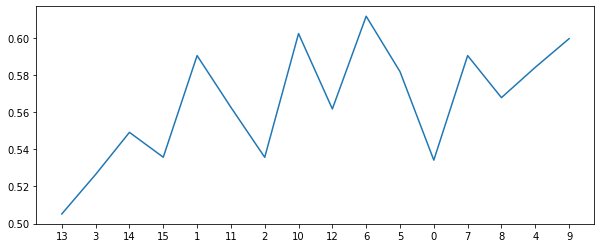

433
all features [13, 15, 11, 3, 2, 14, 1, 10, 12, 5, 6, 8, 9, 4, 7, 0, 16]
new features [13, 15, 11, 3, 2, 14, 1]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6282051282051282
sensitivity  0.62
auc          0.6241025641025642


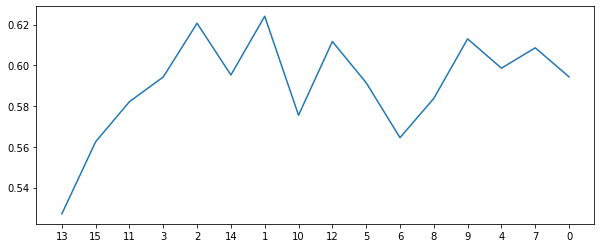

434
all features [13, 15, 1, 3, 11, 14, 2, 12, 10, 5, 6, 7, 8, 4, 0, 9, 16]
new features [13, 15, 1]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6428571428571428
specificity  0.6476621417797889
sensitivity  0.595
auc          0.6213310708898944


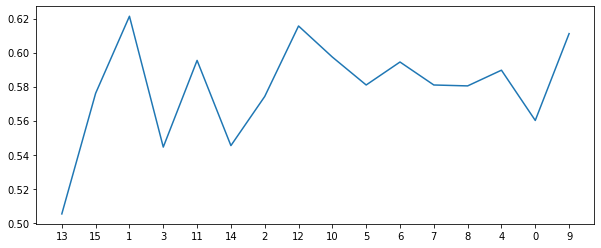

435
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 7, 0, 9, 8, 4, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6428571428571428
specificity  0.6475867269984917
sensitivity  0.595
auc          0.6212933634992459


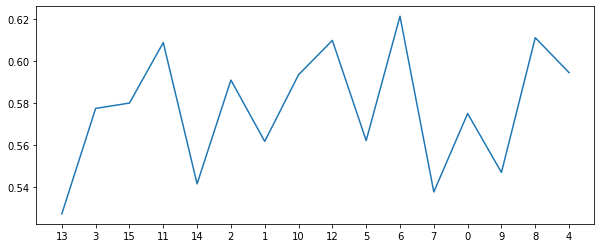

436
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 4, 8, 6, 7, 0, 9, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6688159879336351
sensitivity  0.62
auc          0.6444079939668175


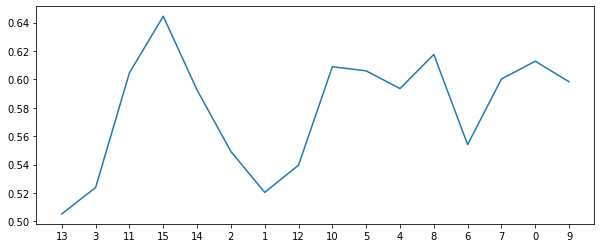

437
all features [3, 13, 11, 15, 2, 14, 1, 10, 12, 5, 6, 7, 8, 9, 0, 4, 16]
new features [3, 13, 11, 15, 2]
[0.4, 2, 1000, 1, 1, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6358597285067873
sensitivity  0.615
auc          0.6254298642533936


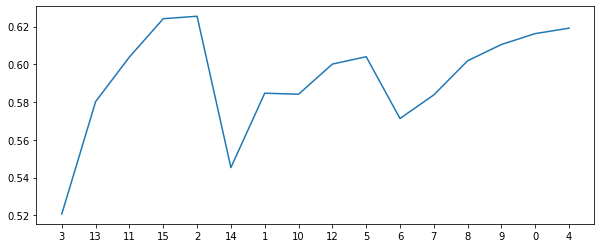

438
all features [13, 3, 15, 11, 14, 1, 2, 12, 10, 5, 6, 4, 8, 7, 0, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5803571428571429
specificity  0.5780920060331824
sensitivity  0.62
auc          0.5990460030165913


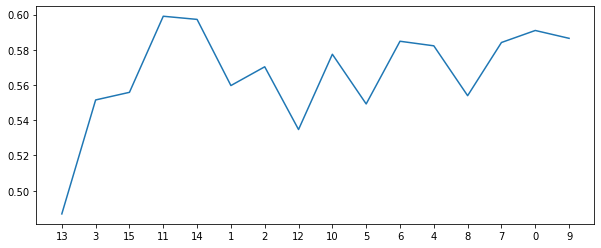

439
all features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 7, 8, 9, 0, 6, 4, 16]
new features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.5993966817496229
sensitivity  0.71
auc          0.6546983408748115


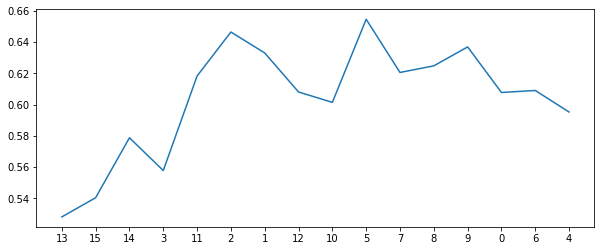

440
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 0, 6, 8, 7, 4, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.6649698340874811
sensitivity  0.615
auc          0.6399849170437406


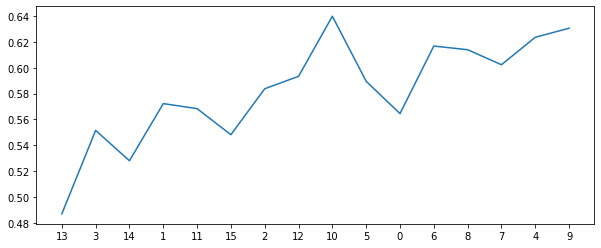

441
all features [13, 11, 3, 15, 14, 2, 1, 10, 12, 5, 6, 0, 8, 7, 9, 4, 16]
new features [13, 11, 3, 15, 14, 2, 1, 10, 12, 5, 6, 0, 8, 7]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.625
specificity  0.6206636500754148
sensitivity  0.69
auc          0.6553318250377074


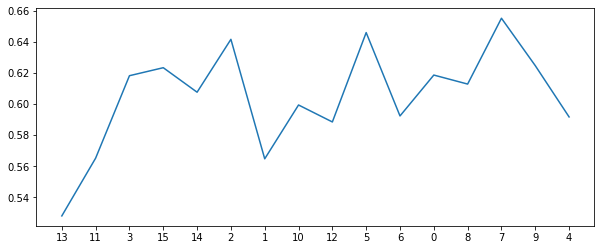

442
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 7, 4, 8, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 7]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6805429864253394
sensitivity  0.565
auc          0.6227714932126697


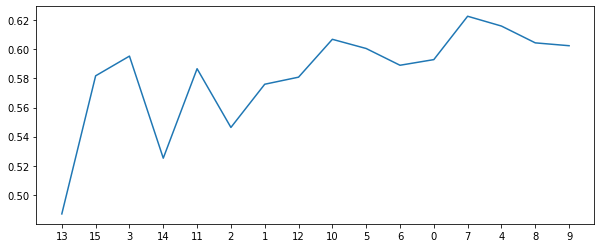

443
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 7, 0, 9, 4, 16]
new features [13, 3, 11]
[0.4, 2, 1000, 1, 1, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5232142857142857
specificity  0.5087858220211161
sensitivity  0.715
auc          0.6118929110105581


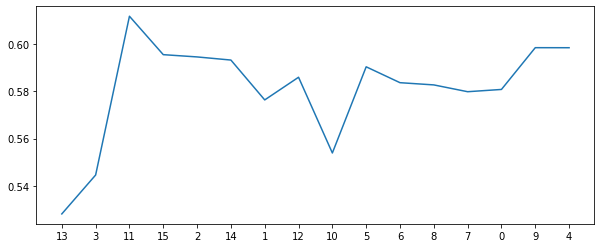

444
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 8, 7, 4, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 8, 7, 4, 9]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.609238310708899
sensitivity  0.66
auc          0.6346191553544495


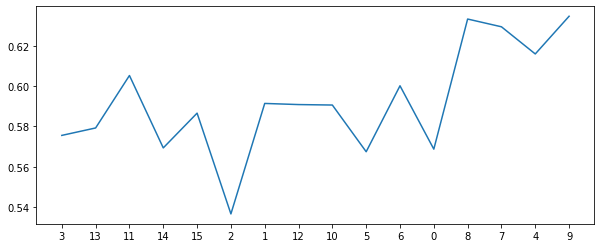

445
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5532051282051282
sensitivity  0.715
auc          0.6341025641025642


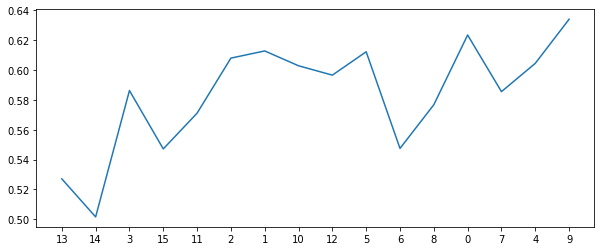

446
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 7, 4, 8, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.625
specificity  0.6225113122171946
sensitivity  0.665
auc          0.6437556561085973


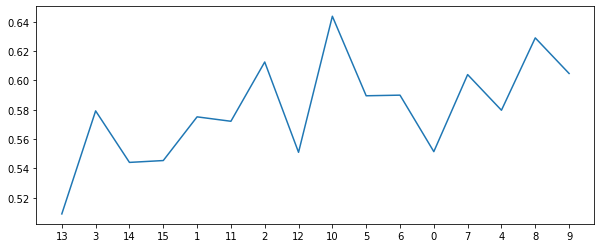

447
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 7, 8, 9, 4, 16]
new features [13, 3, 14, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5801659125188537
sensitivity  0.715
auc          0.6475829562594269


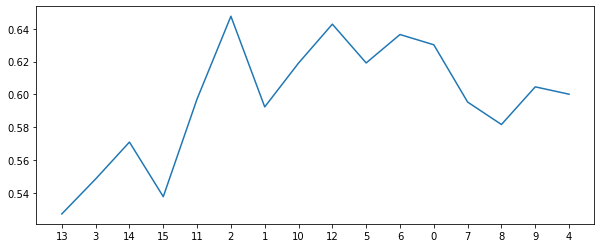

448
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5898567119155355
sensitivity  0.615
auc          0.6024283559577677


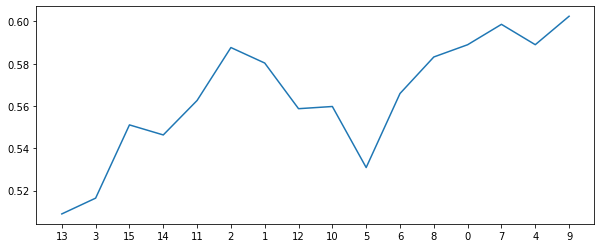

449
all features [13, 15, 3, 11, 2, 14, 12, 1, 10, 6, 5, 0, 7, 8, 9, 4, 16]
new features [13, 15, 3, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5357142857142857
specificity  0.5203996983408749
sensitivity  0.74
auc          0.6301998491704375


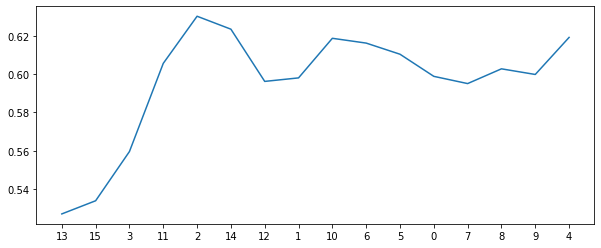

450
all features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 4, 8, 6, 7, 0, 9, 16]
new features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 4, 8, 6, 7]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.6957767722473605
sensitivity  0.615
auc          0.6553883861236802


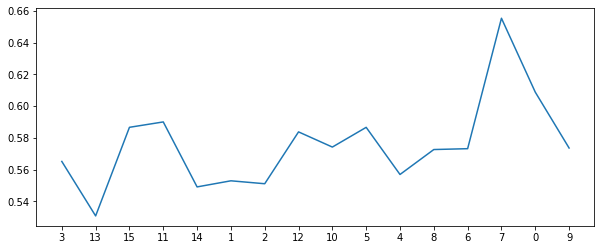

451
all features [13, 11, 15, 3, 2, 14, 1, 10, 5, 12, 7, 9, 4, 8, 0, 6, 16]
new features [13, 11, 15, 3, 2, 14, 1, 10, 5]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6552413273001508
sensitivity  0.64
auc          0.6476206636500754


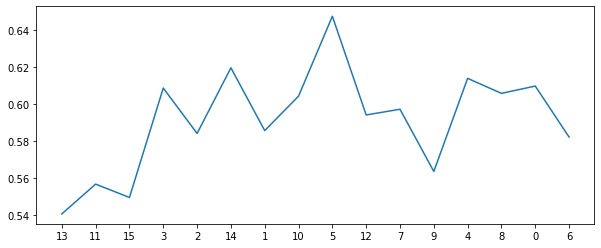

452
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.666892911010558
sensitivity  0.595
auc          0.6309464555052791


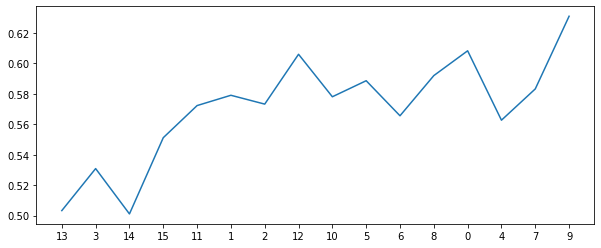

453
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6320889894419306
sensitivity  0.64
auc          0.6360444947209654


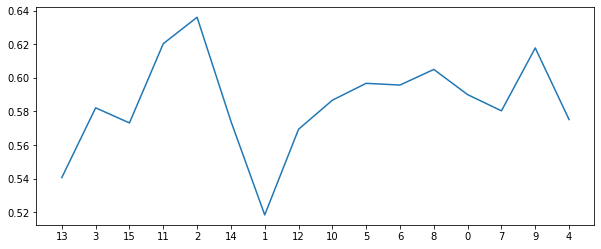

454
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7053167420814479
sensitivity  0.545
auc          0.625158371040724


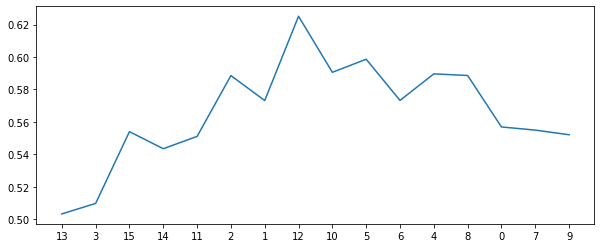

455
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 8, 6, 0, 7, 9, 4, 16]
new features [13, 3, 11]
[0.4, 2, 1000, 1, 1, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5532051282051282
sensitivity  0.72
auc          0.6366025641025641


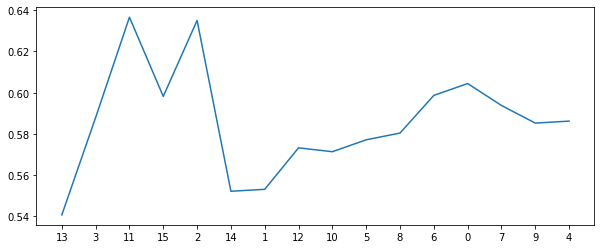

456
all features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 0, 4, 6, 7, 8, 9, 16]
new features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 0, 4, 6, 7]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6245098039215686
sensitivity  0.615
auc          0.6197549019607843


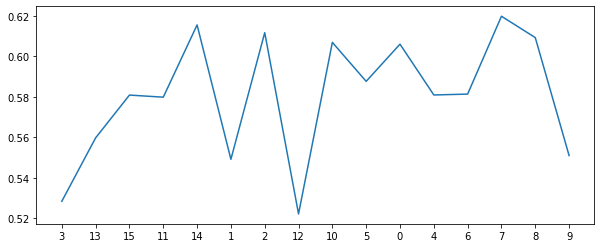

457
all features [13, 15, 11, 14, 3, 2, 1, 10, 12, 5, 8, 7, 0, 4, 9, 6, 16]
new features [13, 15, 11, 14, 3, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5858597285067874
sensitivity  0.715
auc          0.6504298642533937


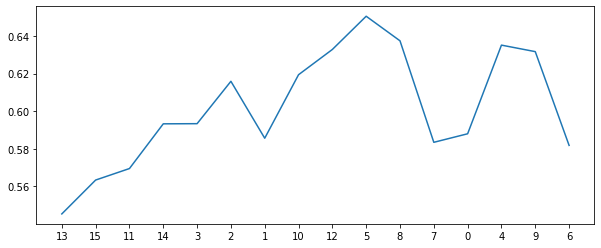

458
all features [13, 3, 15, 1, 11, 14, 2, 12, 10, 5, 0, 8, 4, 6, 7, 9, 16]
new features [13, 3, 15, 1, 11, 14, 2, 12, 10, 5, 0, 8, 4]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6207390648567119
sensitivity  0.665
auc          0.642869532428356


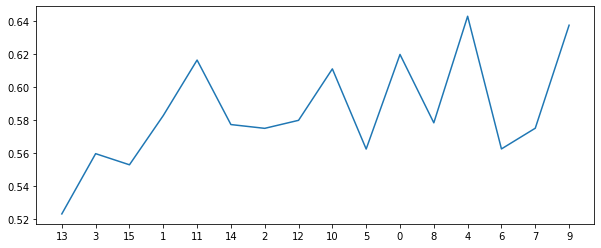

459
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 7, 8, 0, 4, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.575
specificity  0.5646681749622926
sensitivity  0.715
auc          0.6398340874811463


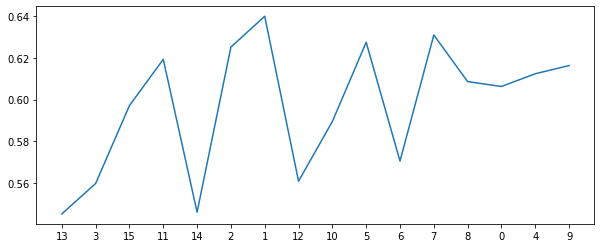

460
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6611613876319758
sensitivity  0.565
auc          0.613080693815988


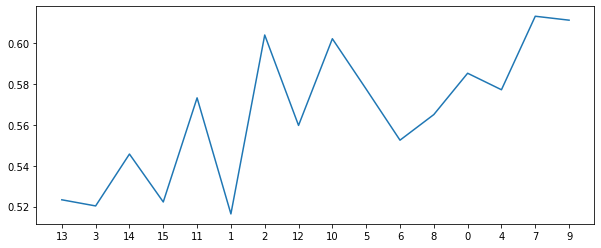

461
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 1, 1, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.6013574660633484
sensitivity  0.635
auc          0.6181787330316741


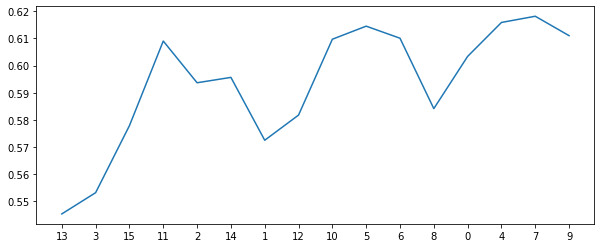

462
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 7, 4, 8, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 7, 4, 8, 9]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6302036199095022
sensitivity  0.66
auc          0.6451018099547512


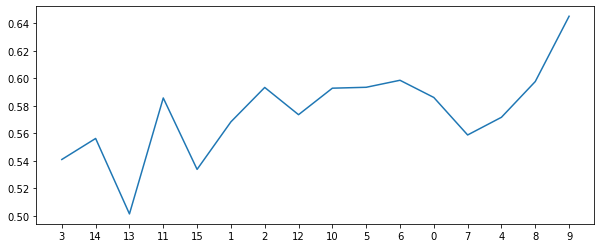

463
all features [13, 15, 3, 11, 14, 2, 1, 10, 12, 5, 8, 4, 0, 6, 7, 9, 16]
new features [13, 15, 3, 11, 14, 2, 1, 10, 12]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5551282051282052
sensitivity  0.76
auc          0.6575641025641026


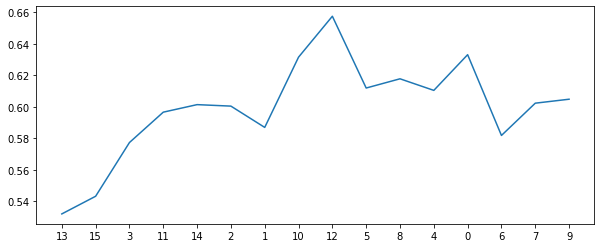

464
all features [13, 3, 14, 15, 11, 1, 2, 10, 12, 5, 6, 4, 7, 8, 0, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 10, 12]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.625
specificity  0.6245098039215686
sensitivity  0.64
auc          0.6322549019607844


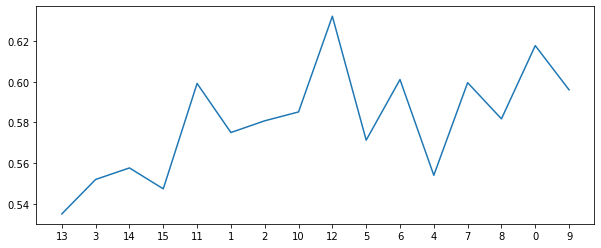

465
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.553054298642534
sensitivity  0.735
auc          0.644027149321267


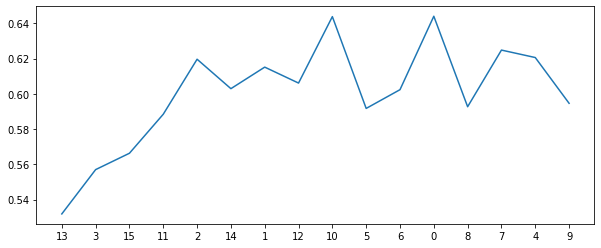

466
all features [3, 13, 14, 11, 15, 2, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [3, 13, 14, 11, 15, 2]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6090120663650076
sensitivity  0.64
auc          0.6245060331825038


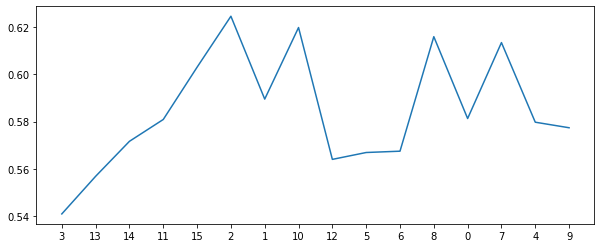

467
all features [13, 3, 11, 2, 15, 14, 1, 10, 12, 6, 5, 8, 9, 4, 0, 7, 16]
new features [13, 3, 11, 2, 15]
[0.4, 2, 1000, 1, 1, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.4857142857142857
specificity  0.46451734539969836
sensitivity  0.765
auc          0.6147586726998492


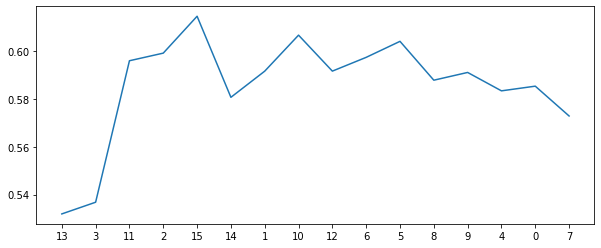

468
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 7, 8, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 7]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6899321266968326
sensitivity  0.565
auc          0.6274660633484163


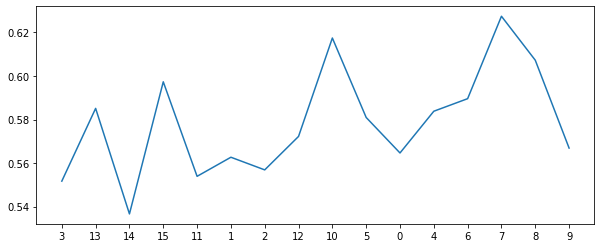

469
all features [13, 15, 3, 11, 2, 14, 1, 10, 12, 5, 4, 6, 7, 0, 8, 9, 16]
new features [13, 15, 3, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6
specificity  0.597473604826546
sensitivity  0.64
auc          0.618736802413273


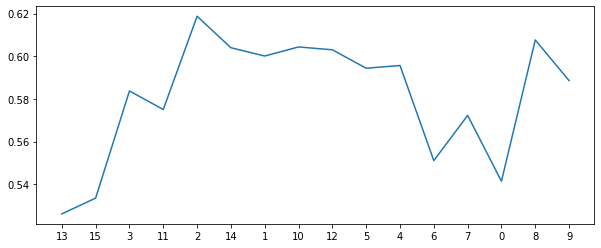

470
all features [3, 13, 15, 14, 11, 1, 2, 10, 12, 5, 6, 0, 8, 7, 4, 9, 16]
new features [3, 13, 15, 14, 11, 1, 2, 10, 12, 5]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7112745098039216
sensitivity  0.495
auc          0.6031372549019608


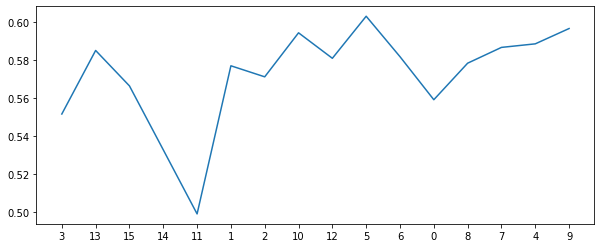

471
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6125
specificity  0.6071266968325791
sensitivity  0.69
auc          0.6485633484162896


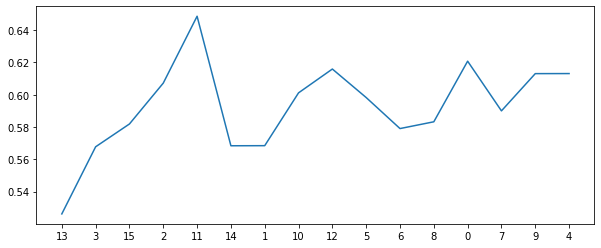

472
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 8, 6, 7, 0, 4, 9, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6625
specificity  0.6706636500754147
sensitivity  0.57
auc          0.6203318250377073


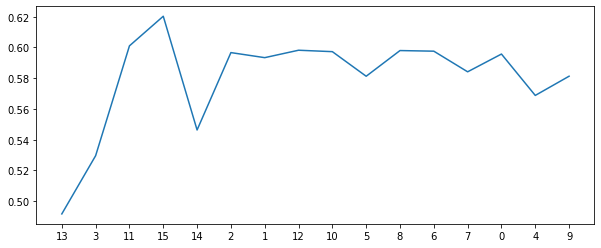

473
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6050904977375565
sensitivity  0.665
auc          0.6350452488687782


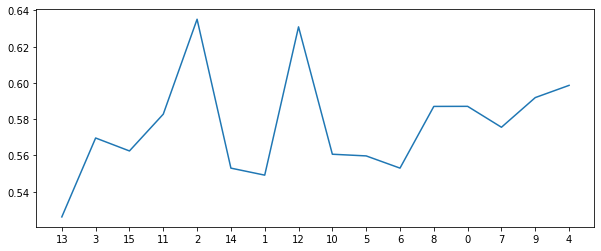

474
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 7, 8, 0, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 7, 8, 0, 9]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6360859728506787
sensitivity  0.61
auc          0.6230429864253394


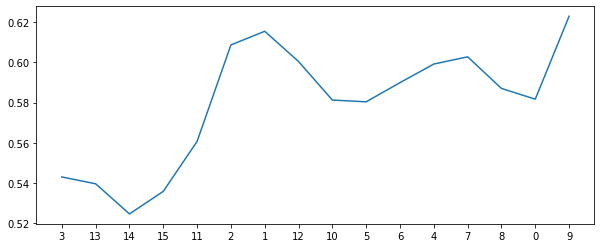

475
all features [13, 11, 15, 2, 3, 14, 1, 10, 12, 5, 6, 7, 8, 0, 9, 4, 16]
new features [13, 11, 15, 2, 3, 14, 1, 10, 12, 5, 6, 7, 8]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5685143288084464
sensitivity  0.735
auc          0.6517571644042233


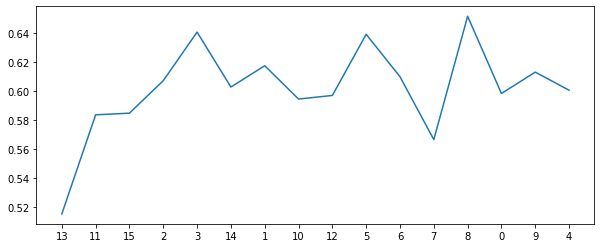

476
all features [13, 15, 3, 11, 14, 1, 2, 10, 12, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 15, 3, 11, 14, 1, 2, 10, 12, 5, 6, 4, 0]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6438536953242836
sensitivity  0.64
auc          0.6419268476621418


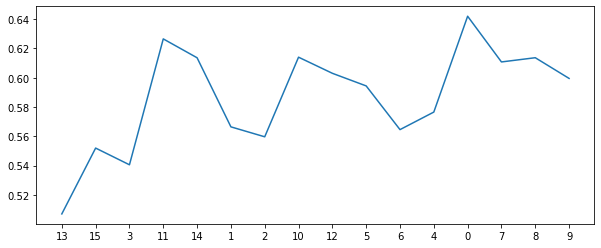

477
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5588989441930619
sensitivity  0.715
auc          0.636949472096531


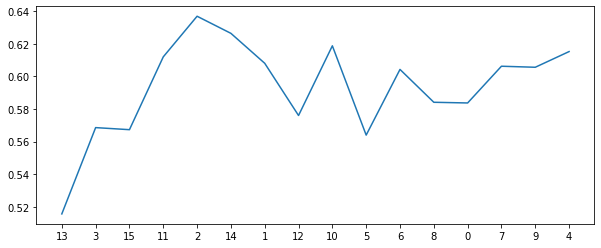

478
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 7, 0, 4, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 7, 0]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6303544494720965
sensitivity  0.61
auc          0.6201772247360483


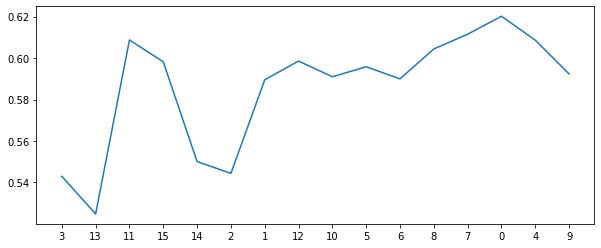

479
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 6, 5, 8, 7, 0, 9, 4, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 6, 5, 8, 7, 0, 9]
[0.4, 2, 1000, 1, 1, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5877450980392157
sensitivity  0.685
auc          0.6363725490196078


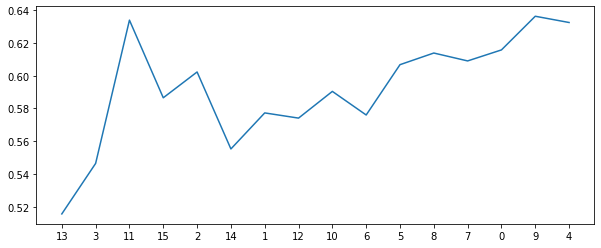

480
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 7, 0, 6, 8, 4, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6
specificity  0.5993966817496229
sensitivity  0.615
auc          0.6071983408748115


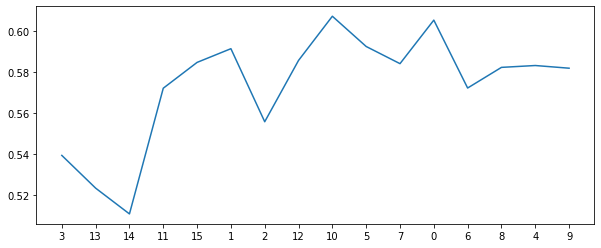

481
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 11, 2, 14]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5375
specificity  0.5205128205128206
sensitivity  0.765
auc          0.6427564102564103


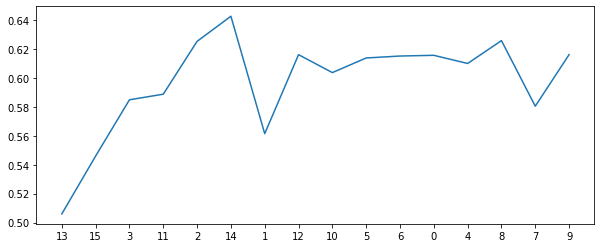

482
all features [13, 3, 15, 11, 14, 1, 2, 10, 12, 5, 6, 7, 0, 8, 4, 9, 16]
new features [13, 3, 15, 11, 14, 1, 2, 10, 12, 5, 6, 7, 0, 8, 4, 9]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5762820512820512
sensitivity  0.785
auc          0.6806410256410257


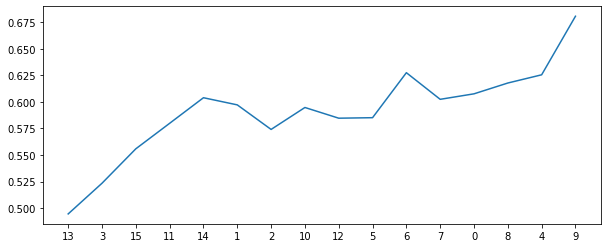

483
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 0, 9, 7, 4, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 8, 0]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5517857142857143
specificity  0.5378205128205128
sensitivity  0.735
auc          0.6364102564102564


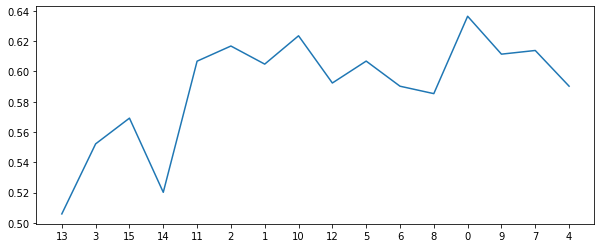

484
all features [13, 15, 3, 14, 11, 2, 1, 10, 12, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5917043740573152
sensitivity  0.645
auc          0.6183521870286576


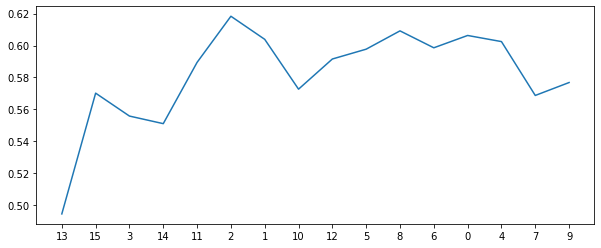

485
all features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 9, 0, 4, 7, 16]
new features [13, 3, 11, 15, 2, 14, 1, 10, 12, 5, 6, 8, 9, 0]
[0.4, 2, 1000, 1, 1, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5570889894419306
sensitivity  0.735
auc          0.6460444947209653


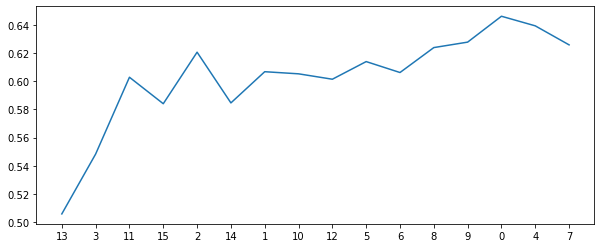

486
all features [13, 14, 3, 15, 1, 2, 12, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 2, 12, 11, 10]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6410714285714285
specificity  0.6476621417797889
sensitivity  0.57
auc          0.6088310708898944


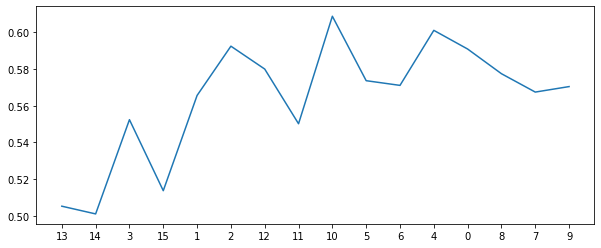

487
all features [14, 13, 3, 15, 11, 1, 2, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 10, 12, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6875
specificity  0.6939291101055807
sensitivity  0.615
auc          0.6544645550527903


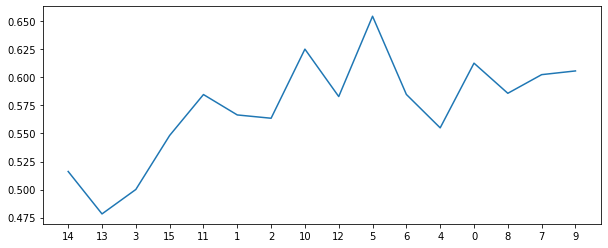

488
all features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7178571428571429
specificity  0.7323906485671191
sensitivity  0.545
auc          0.6386953242835596


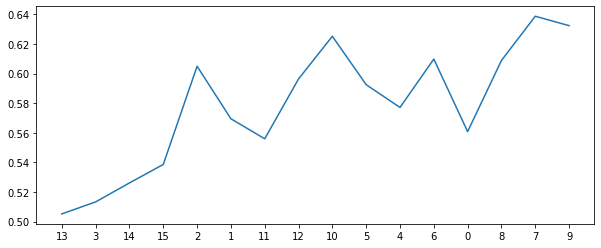

489
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6957767722473605
sensitivity  0.54
auc          0.6178883861236802


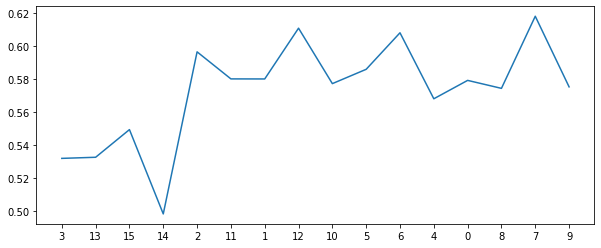

490
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6918174962292609
sensitivity  0.54
auc          0.6159087481146305


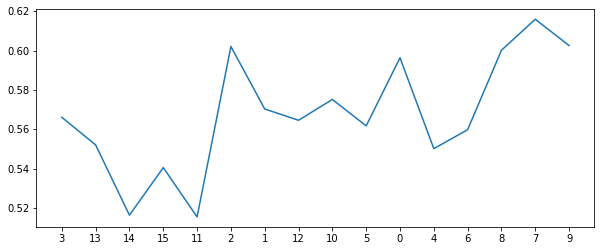

491
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6726244343891403
sensitivity  0.57
auc          0.6213122171945701


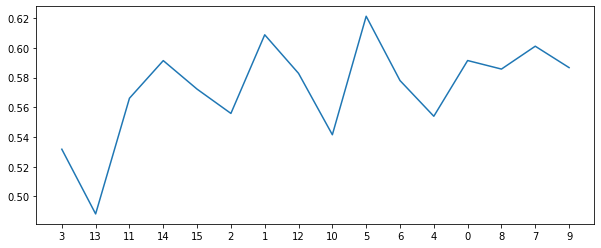

492
all features [13, 14, 3, 15, 1, 12, 2, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 12, 2, 11, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6322398190045249
sensitivity  0.64
auc          0.6361199095022625


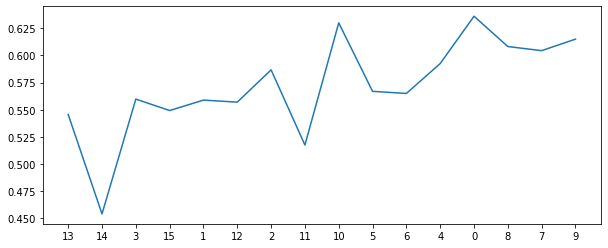

493
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 4, 8, 6, 0, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6380844645550527
sensitivity  0.69
auc          0.6640422322775263


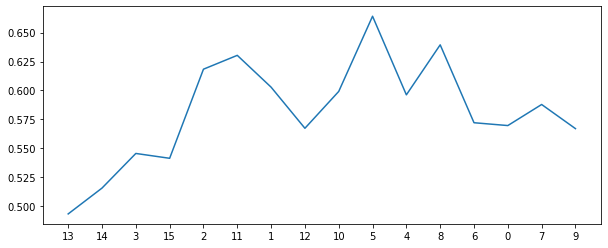

494
all features [14, 13, 3, 1, 2, 15, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 1, 2, 15, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6611613876319758
sensitivity  0.615
auc          0.638080693815988


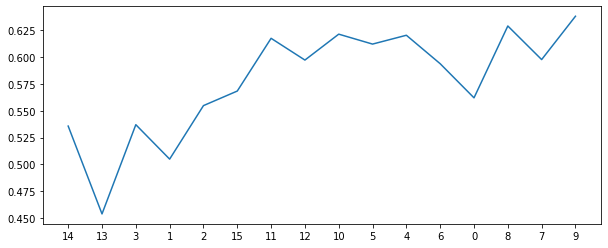

495
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6225867269984917
sensitivity  0.71
auc          0.6662933634992458


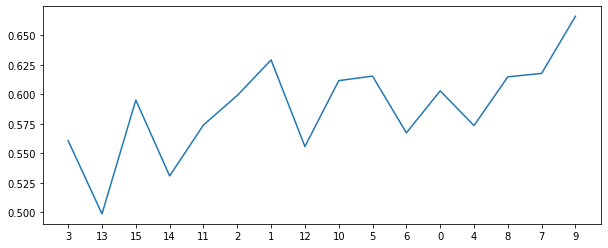

496
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6591251885369532
sensitivity  0.59
auc          0.6245625942684766


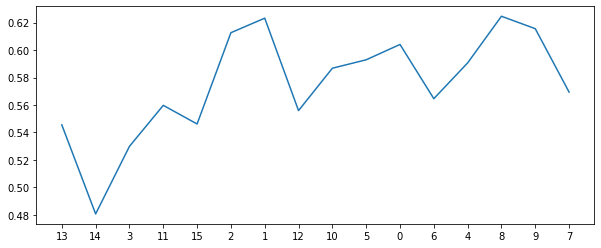

497
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6515082956259427
sensitivity  0.685
auc          0.6682541478129713


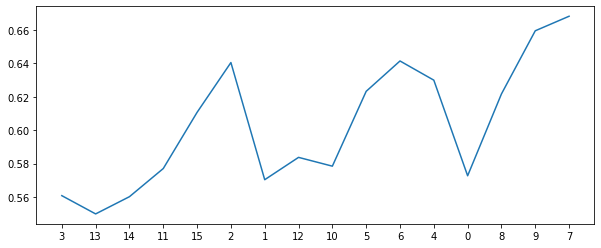

498
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.6015837104072398
sensitivity  0.69
auc          0.6457918552036199


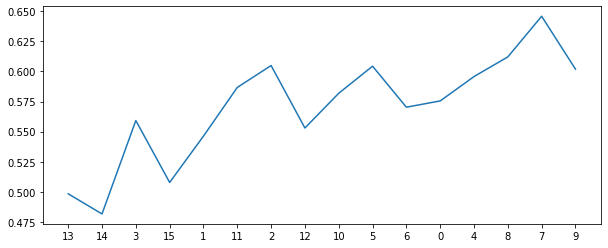

499
all features [14, 3, 13, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5446428571428571
specificity  0.5280920060331825
sensitivity  0.765
auc          0.6465460030165913


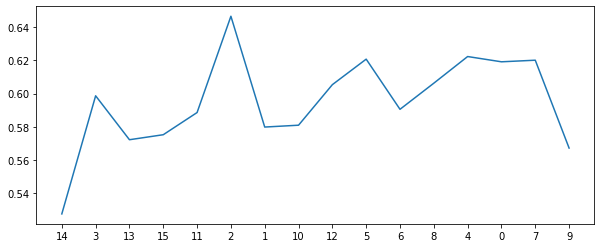

500
all features [14, 3, 13, 2, 11, 1, 15, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 2, 11, 1, 15, 12, 10]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6225490196078431
sensitivity  0.64
auc          0.6312745098039215


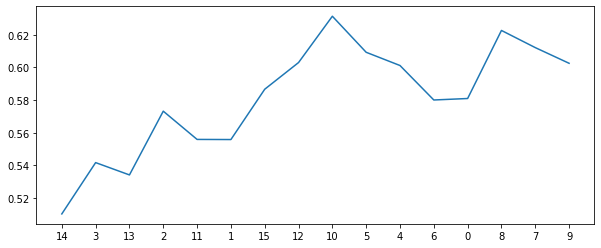

501
all features [3, 13, 2, 15, 11, 14, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 2, 15, 11, 14, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5687782805429864
sensitivity  0.69
auc          0.6293891402714932


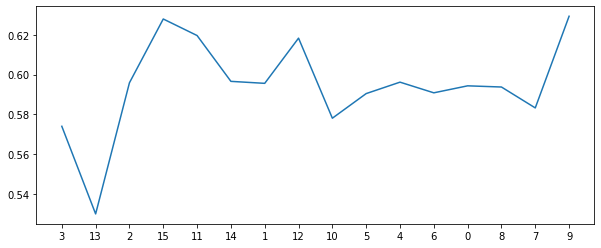

502
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2, 1]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6186274509803922
sensitivity  0.645
auc          0.6318137254901961


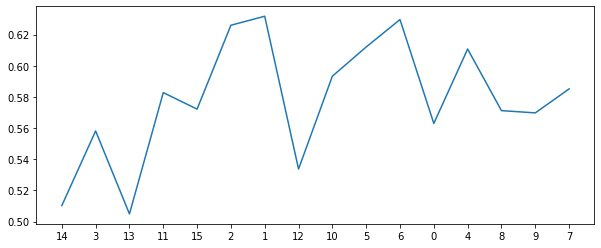

503
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6110859728506787
sensitivity  0.735
auc          0.6730429864253393


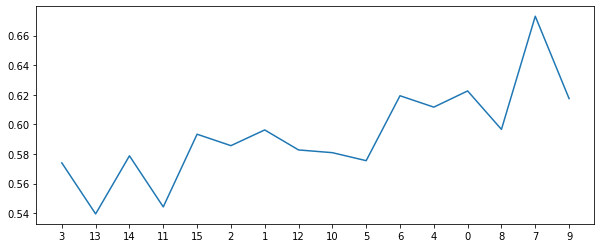

504
all features [13, 14, 3, 15, 1, 12, 2, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 12, 2, 11, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6900075414781297
sensitivity  0.565
auc          0.6275037707390649


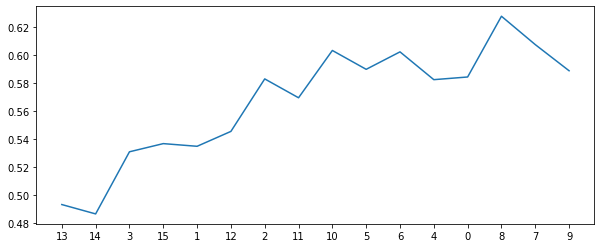

505
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6572398190045249
sensitivity  0.62
auc          0.6386199095022624


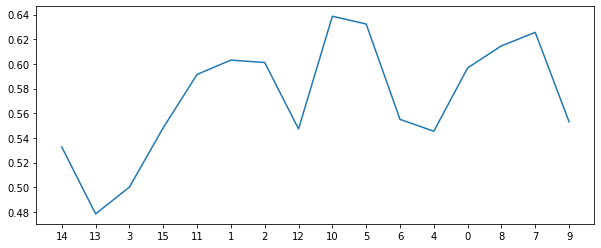

506
all features [14, 3, 13, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6732142857142857
specificity  0.6802790346907994
sensitivity  0.59
auc          0.6351395173453998


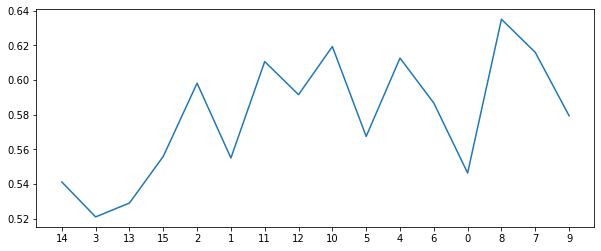

507
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6892857142857143
specificity  0.6976998491704374
sensitivity  0.59
auc          0.6438499245852187


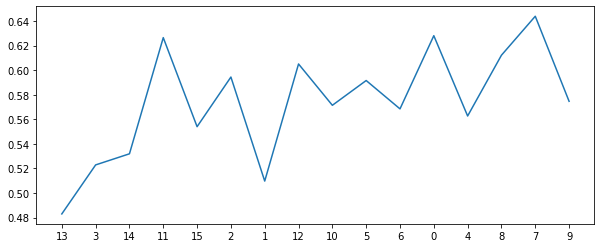

508
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 0, 6, 4, 8, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7072021116138764
sensitivity  0.52
auc          0.6136010558069381


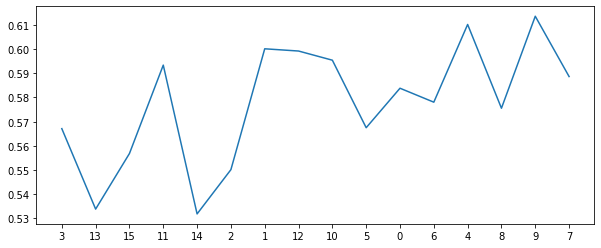

509
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6784313725490196
sensitivity  0.595
auc          0.6367156862745098


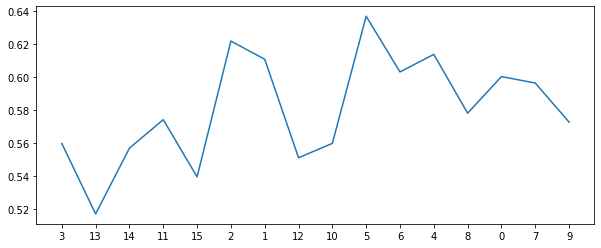

510
all features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 2]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.575
specificity  0.5648190045248869
sensitivity  0.72
auc          0.6424095022624434


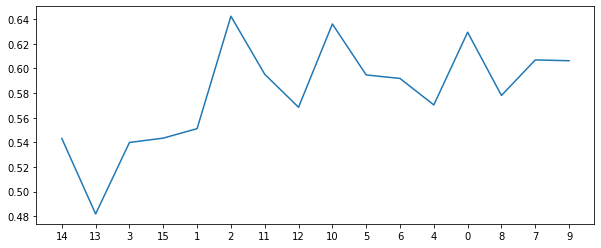

511
all features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6265082956259427
sensitivity  0.645
auc          0.6357541478129713


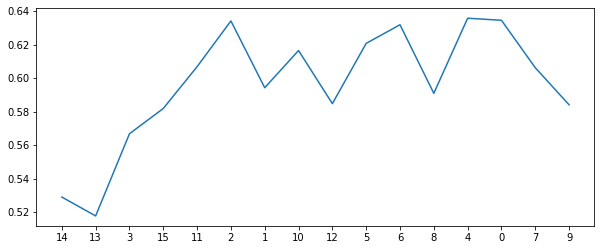

512
all features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6410714285714285
specificity  0.6398190045248868
sensitivity  0.665
auc          0.6524095022624434


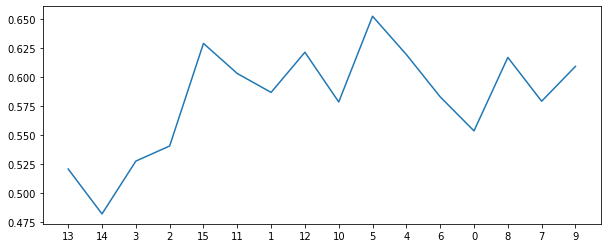

513
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6476244343891403
sensitivity  0.62
auc          0.6338122171945701


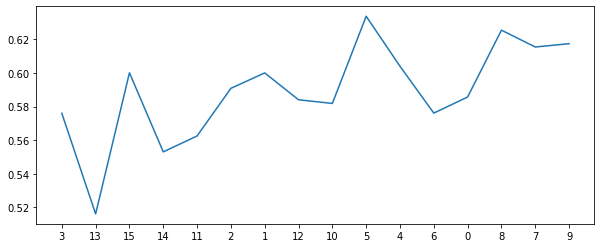

514
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6375000000000001
specificity  0.6400075414781297
sensitivity  0.62
auc          0.6300037707390649


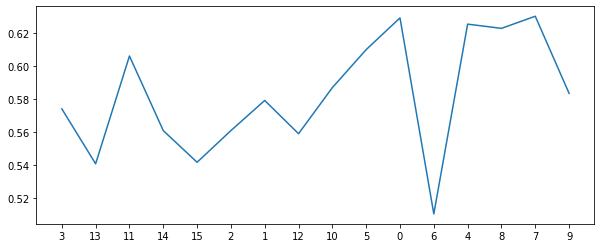

515
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6418174962292609
sensitivity  0.685
auc          0.6634087481146305


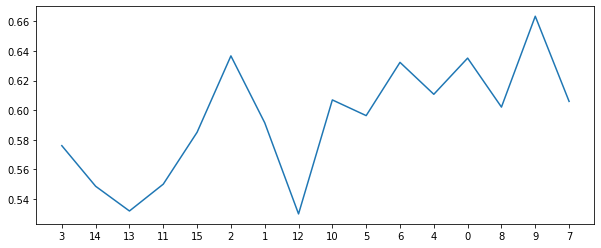

516
all features [14, 3, 13, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.6033182503770739
sensitivity  0.665
auc          0.634159125188537


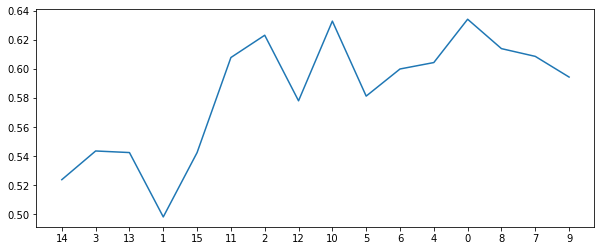

517
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5392857142857143
specificity  0.5224358974358975
sensitivity  0.765
auc          0.6437179487179487


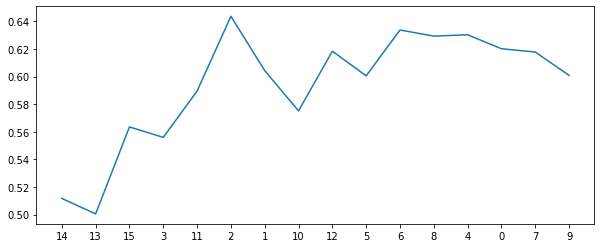

518
all features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 4, 0, 6, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6478129713423831
sensitivity  0.71
auc          0.6789064856711915


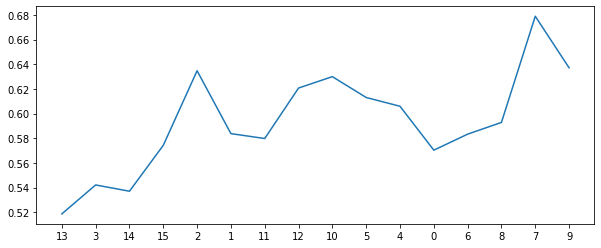

519
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5648190045248869
sensitivity  0.685
auc          0.6249095022624435


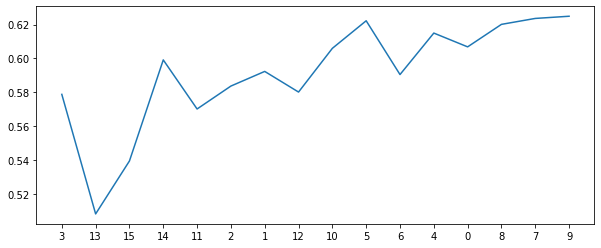

520
all features [15, 13, 3, 11, 14, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [15, 13, 3, 11, 14, 1, 2]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6090874811463047
sensitivity  0.645
auc          0.6270437405731523


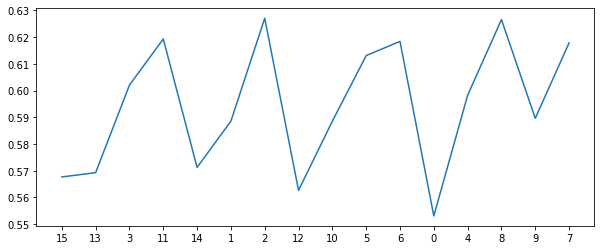

521
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 2, 0, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5840874811463047
sensitivity  0.735
auc          0.6595437405731523


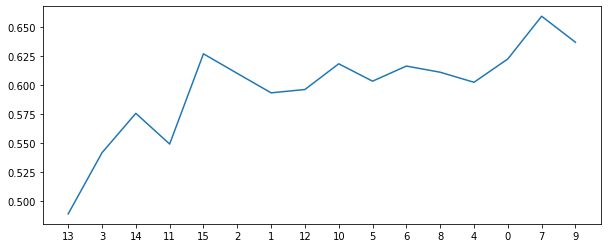

522
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.7035714285714286
specificity  0.7169306184012066
sensitivity  0.54
auc          0.6284653092006033


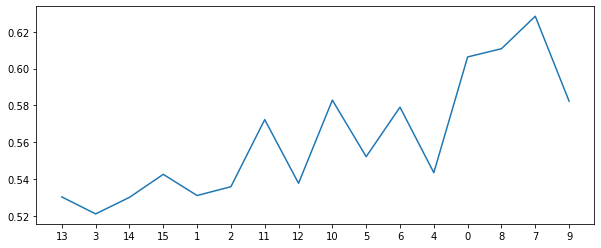

523
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 9, 7, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.684238310708899
sensitivity  0.615
auc          0.6496191553544495


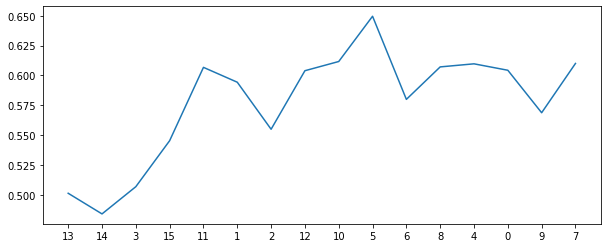

524
all features [14, 3, 13, 15, 2, 1, 11, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 1, 11, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7073152337858221
sensitivity  0.595
auc          0.651157616892911


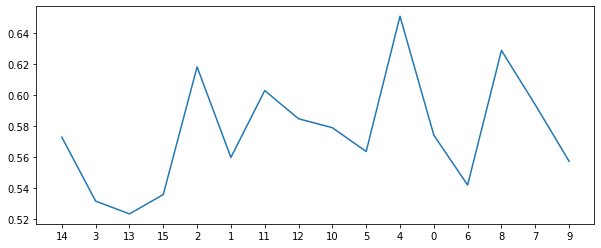

525
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6727375565610859
sensitivity  0.59
auc          0.6313687782805429


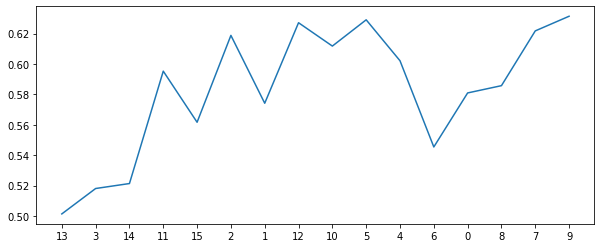

526
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7035822021116138
sensitivity  0.52
auc          0.6117911010558069


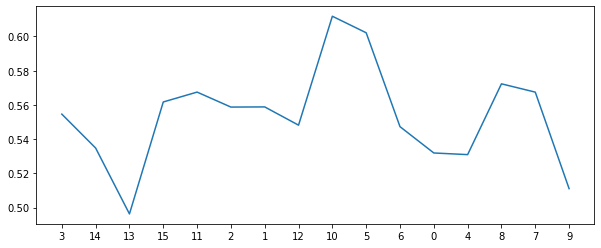

527
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.7089285714285715
specificity  0.7169306184012066
sensitivity  0.62
auc          0.6684653092006033


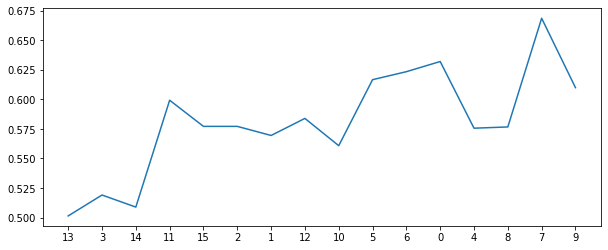

528
all features [14, 13, 3, 15, 1, 2, 12, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 2, 12, 11, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.65
specificity  0.6515082956259427
sensitivity  0.635
auc          0.6432541478129713


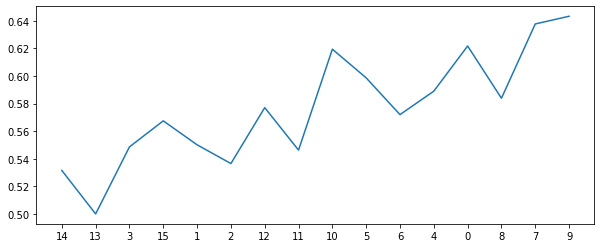

529
all features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6188536953242836
sensitivity  0.685
auc          0.6519268476621418


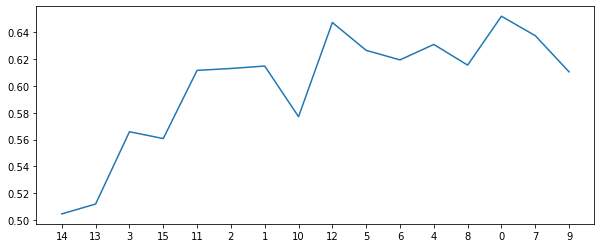

530
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6611236802413273
sensitivity  0.62
auc          0.6405618401206636


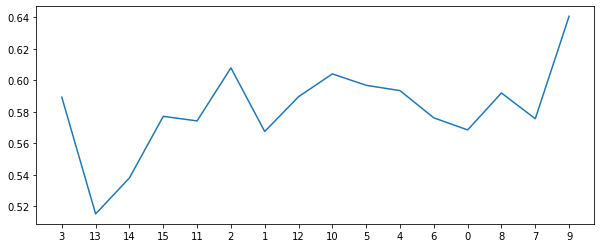

531
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5762443438914027
sensitivity  0.715
auc          0.6456221719457014


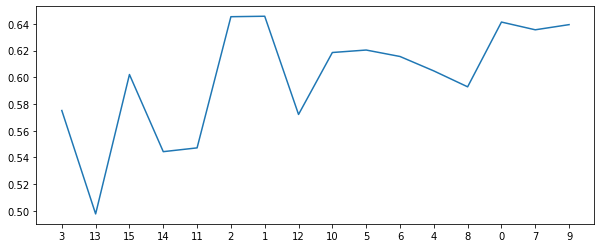

532
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6496229260935144
sensitivity  0.615
auc          0.6323114630467571


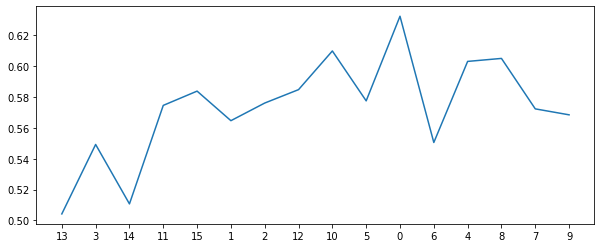

533
all features [13, 3, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6322398190045249
sensitivity  0.66
auc          0.6461199095022625


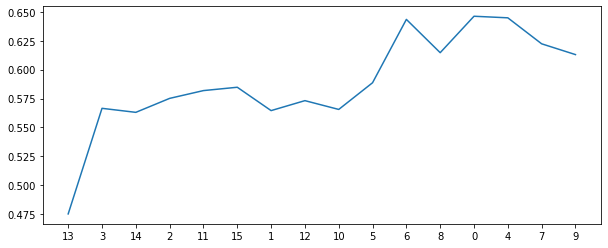

534
all features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6148567119155355
sensitivity  0.595
auc          0.6049283559577677


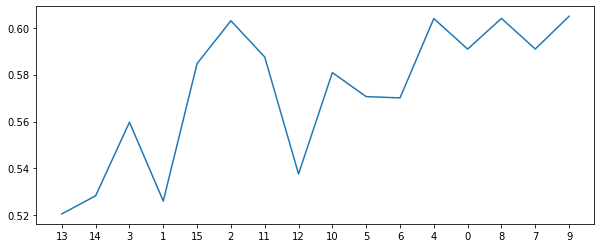

535
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5267857142857143
specificity  0.505052790346908
sensitivity  0.815
auc          0.660026395173454


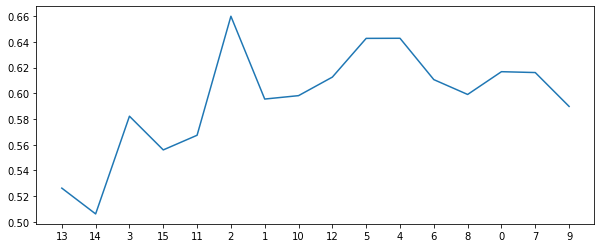

536
all features [13, 14, 3, 15, 1, 2, 12, 11, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 2, 12, 11, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6419306184012067
sensitivity  0.665
auc          0.6534653092006033


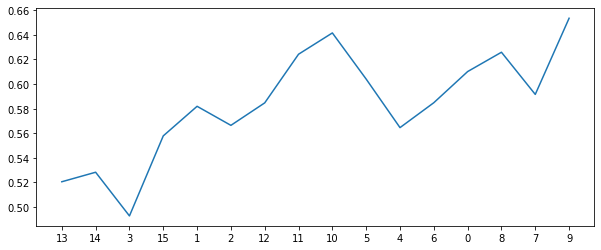

537
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5375
specificity  0.5223604826546003
sensitivity  0.745
auc          0.6336802413273002


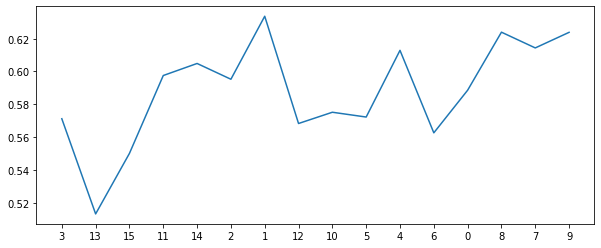

538
all features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.6014328808446455
sensitivity  0.685
auc          0.6432164404223227


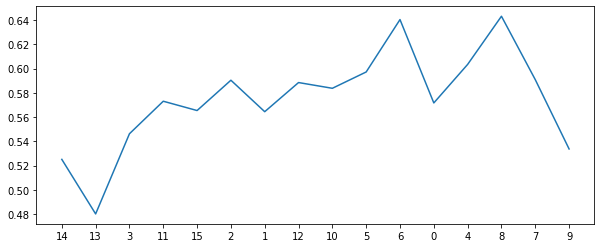

539
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 0, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6187405731523379
sensitivity  0.69
auc          0.6543702865761689


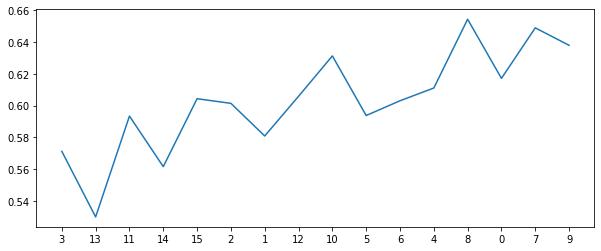

540
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6978129713423831
sensitivity  0.495
auc          0.5964064856711916


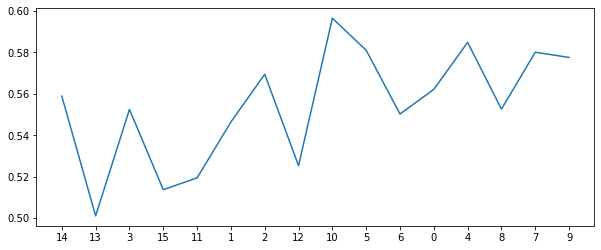

541
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6765082956259427
sensitivity  0.57
auc          0.6232541478129714


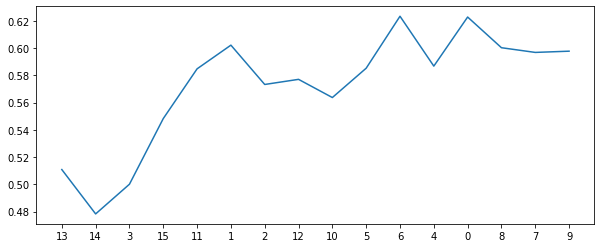

542
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7054675716440423
sensitivity  0.535
auc          0.6202337858220212


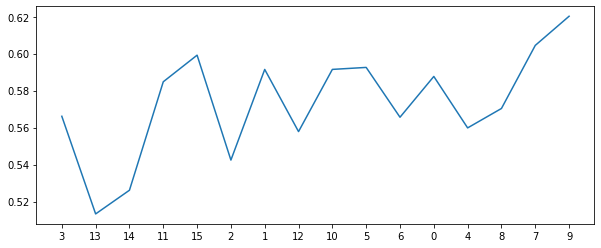

543
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6937782805429864
sensitivity  0.565
auc          0.6293891402714932


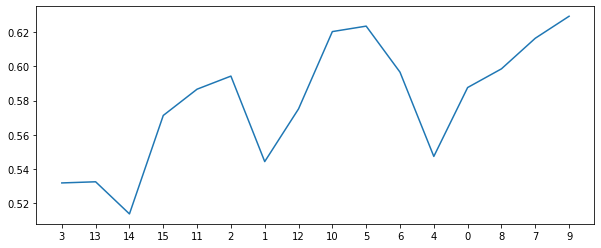

544
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6910714285714286
specificity  0.7014705882352941
sensitivity  0.57
auc          0.6357352941176471


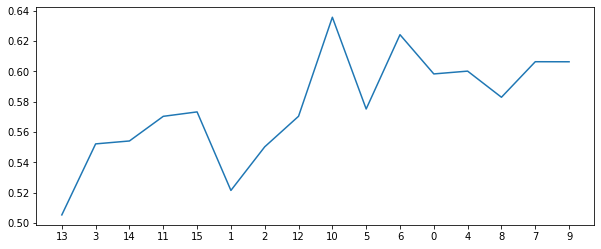

545
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.7017857142857143
specificity  0.7111236802413273
sensitivity  0.585
auc          0.6480618401206636


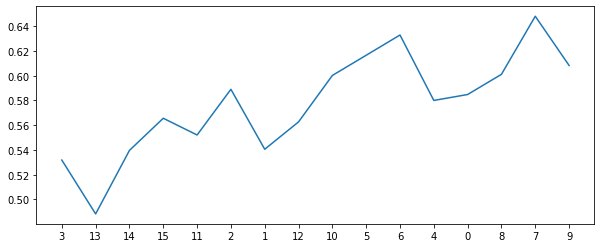

546
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.59
auc          0.6111199095022625


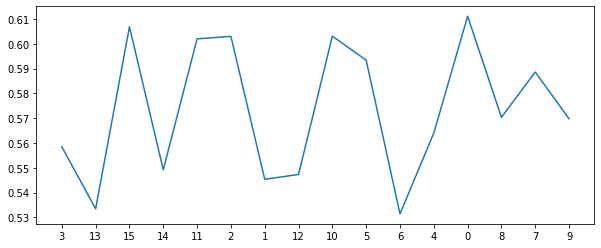

547
all features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.626395173453997
sensitivity  0.66
auc          0.6431975867269984


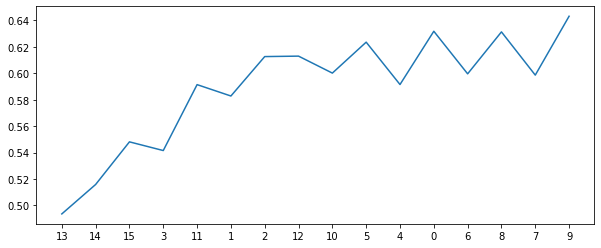

548
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6650075414781297
sensitivity  0.595
auc          0.6300037707390649


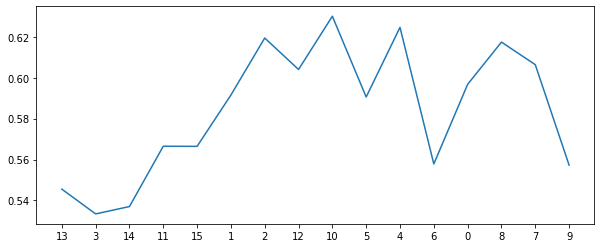

549
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6392857142857143
specificity  0.6379336349924585
sensitivity  0.67
auc          0.6539668174962292


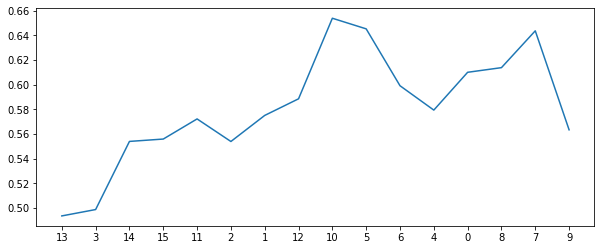

550
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6648567119155354
sensitivity  0.57
auc          0.6174283559577677


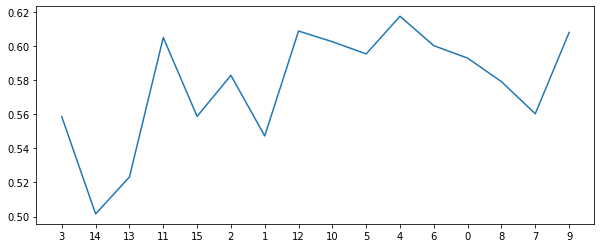

551
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6417797888386123
sensitivity  0.62
auc          0.6308898944193062


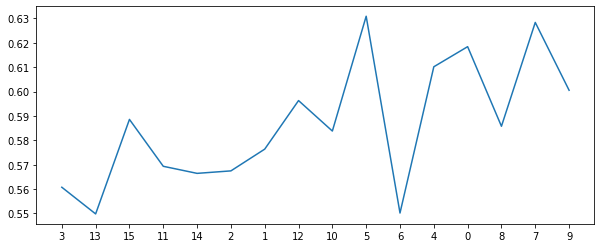

552
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.585
auc          0.6086199095022624


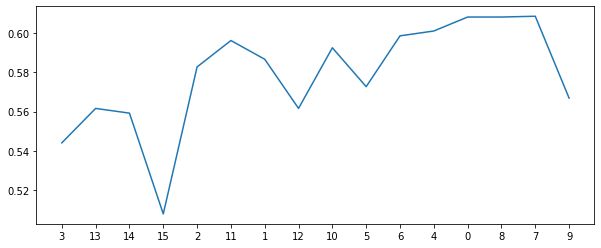

553
all features [13, 14, 15, 3, 11, 1, 2, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 10, 12, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.603393665158371
sensitivity  0.67
auc          0.6366968325791855


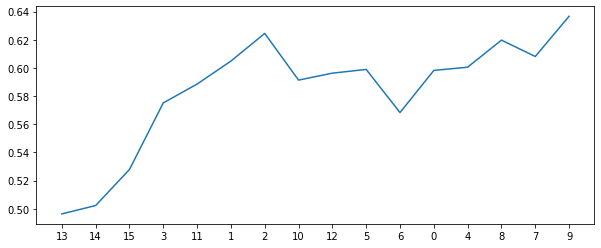

554
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6130090497737557
sensitivity  0.715
auc          0.6640045248868778


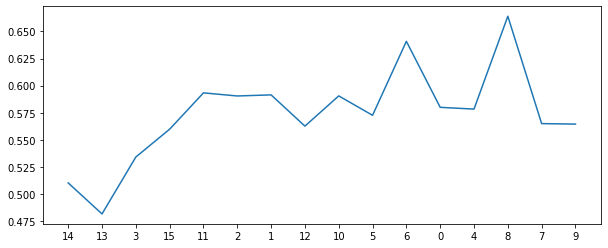

555
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5898190045248869
sensitivity  0.71
auc          0.6499095022624435


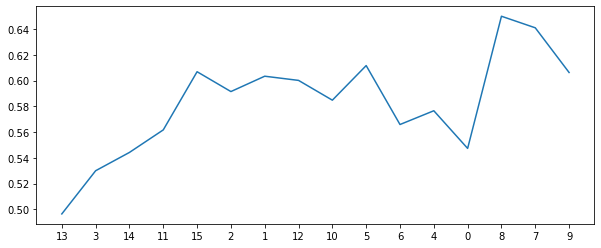

556
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6225867269984917
sensitivity  0.615
auc          0.6187933634992459


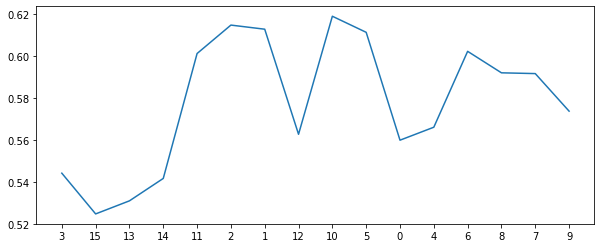

557
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1]
[0.4, 2, 1000, 2, 0, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6109351432880845
sensitivity  0.695
auc          0.6529675716440422


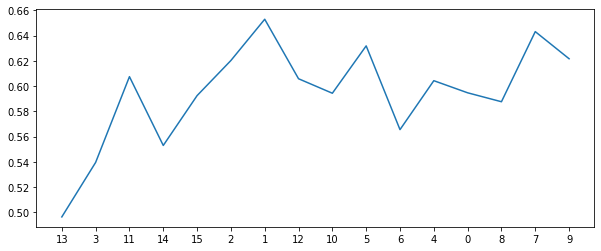

558
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6687782805429864
sensitivity  0.545
auc          0.6068891402714932


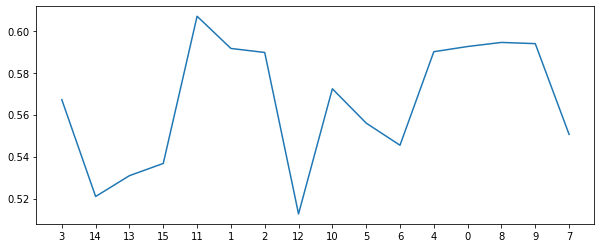

559
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6957390648567119
sensitivity  0.56
auc          0.627869532428356


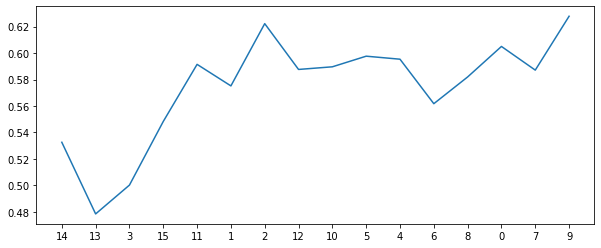

560
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7033559577677225
sensitivity  0.56
auc          0.6316779788838612


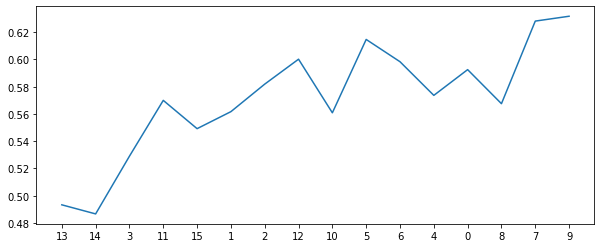

561
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6880090497737557
sensitivity  0.56
auc          0.6240045248868779


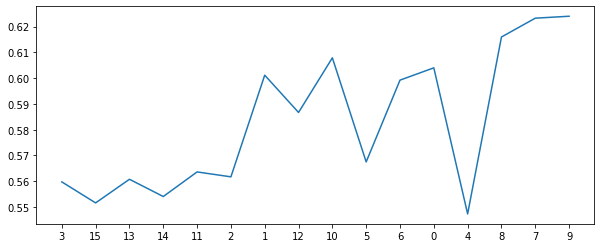

562
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6957767722473605
sensitivity  0.52
auc          0.6078883861236802


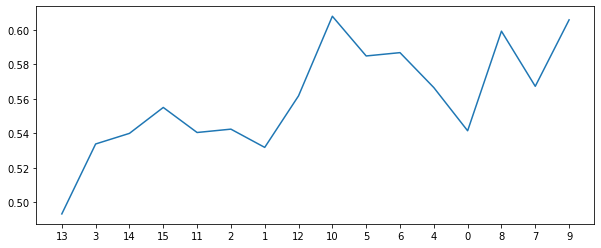

563
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6860105580693816
sensitivity  0.595
auc          0.6405052790346908


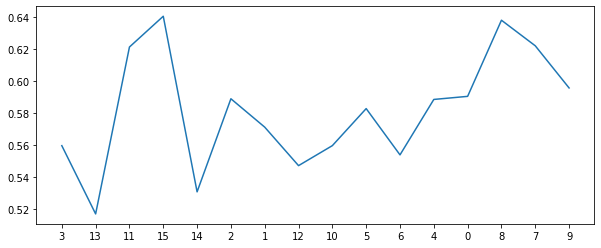

564
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6842006033182504
sensitivity  0.585
auc          0.6346003016591252


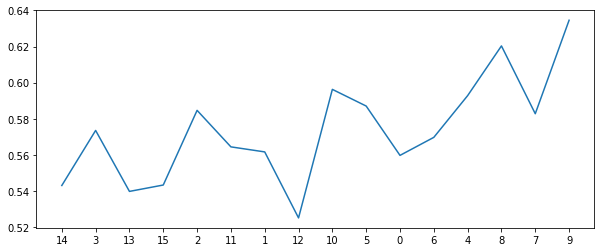

565
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6375
specificity  0.6360105580693816
sensitivity  0.665
auc          0.6505052790346908


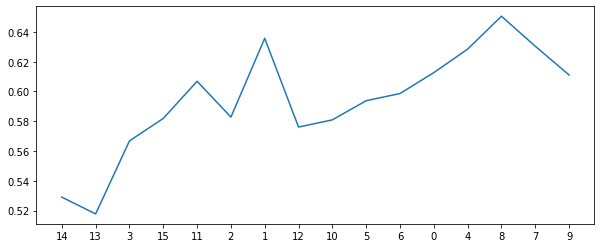

566
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6476244343891403
sensitivity  0.66
auc          0.6538122171945702


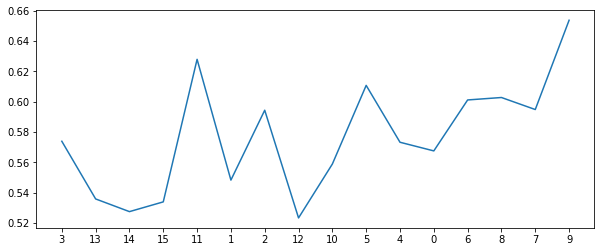

567
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6410714285714285
specificity  0.641817496229261
sensitivity  0.64
auc          0.6409087481146305


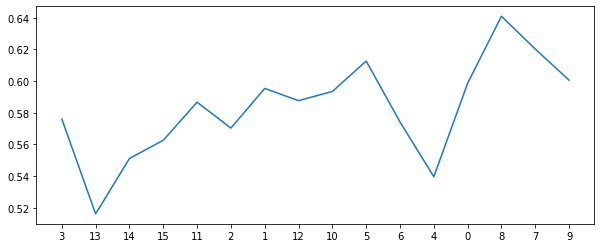

568
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6375
specificity  0.6418929110105581
sensitivity  0.59
auc          0.615946455505279


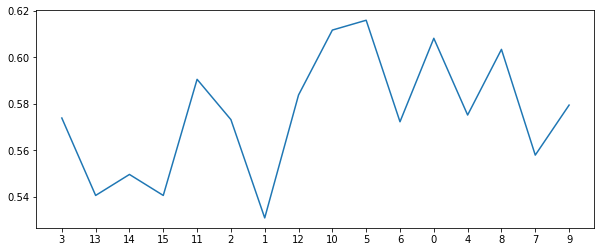

569
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6513574660633484
sensitivity  0.735
auc          0.6931787330316742


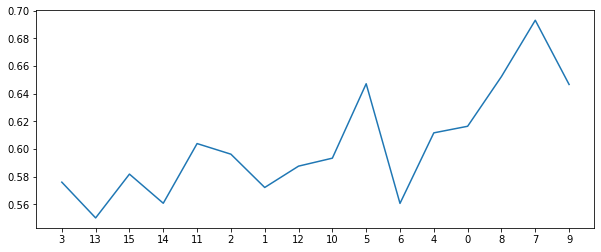

570
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.5956636500754148
sensitivity  0.715
auc          0.6553318250377074


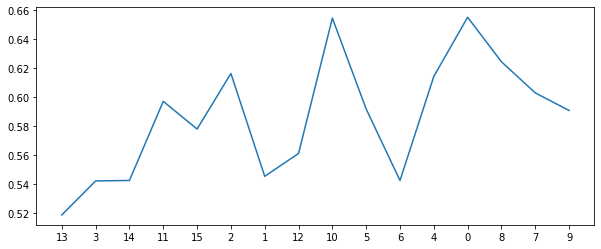

571
all features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.6017857142857143
specificity  0.5936651583710407
sensitivity  0.715
auc          0.6543325791855203


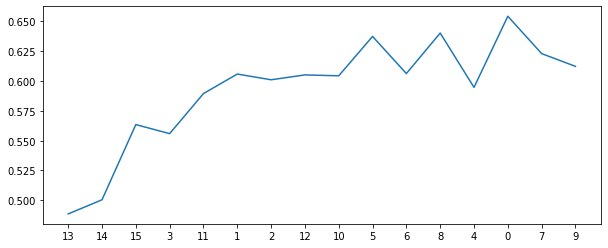

572
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6243966817496229
sensitivity  0.595
auc          0.6096983408748115


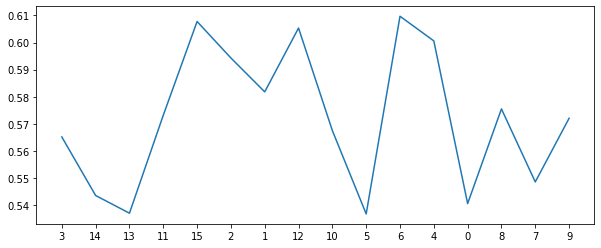

573
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5859351432880845
sensitivity  0.71
auc          0.6479675716440423


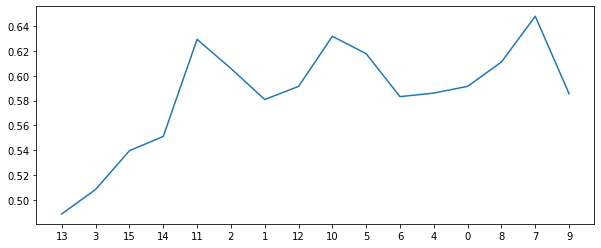

574
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.625
specificity  0.6282428355957768
sensitivity  0.595
auc          0.6116214177978884


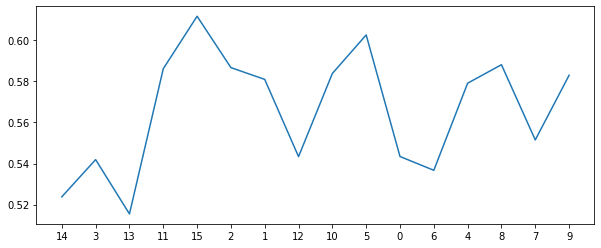

575
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 2, 0, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6032805429864253
sensitivity  0.71
auc          0.6566402714932127


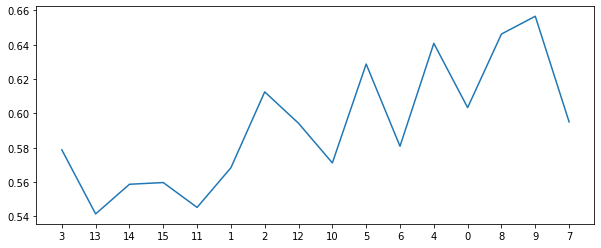

576
all features [3, 11, 13, 2, 14, 15, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 11, 13, 2]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6514705882352941
sensitivity  0.595
auc          0.623235294117647


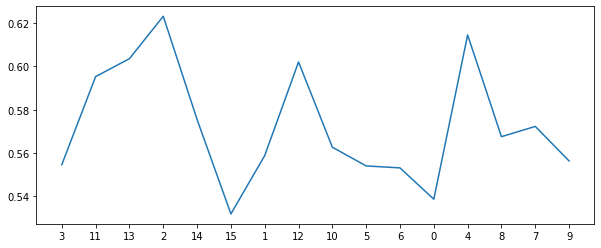

577
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.691892911010558
sensitivity  0.585
auc          0.638446455505279


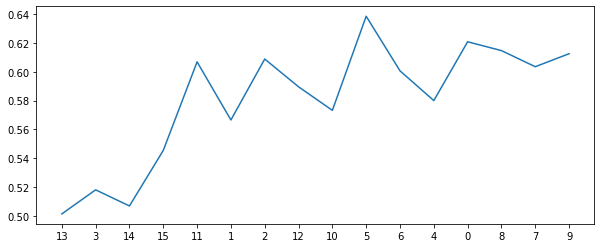

578
all features [3, 13, 11, 15, 14, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6745098039215687
sensitivity  0.6
auc          0.6372549019607843


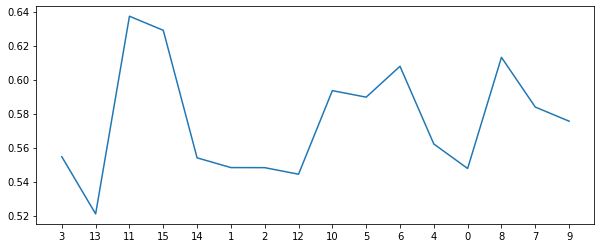

579
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.7034313725490197
sensitivity  0.565
auc          0.6342156862745097


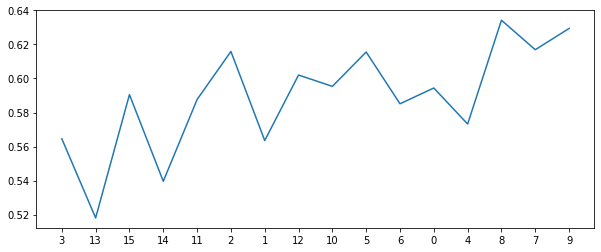

580
all features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 0, 4, 6, 8]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7073152337858221
sensitivity  0.52
auc          0.613657616892911


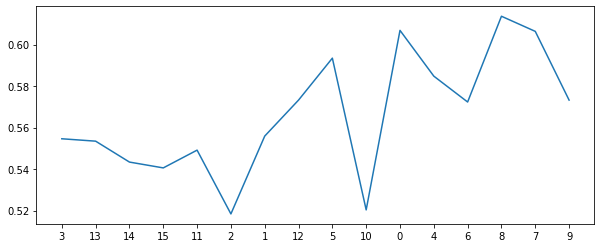

581
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.7196428571428571
specificity  0.7284313725490196
sensitivity  0.615
auc          0.6717156862745098


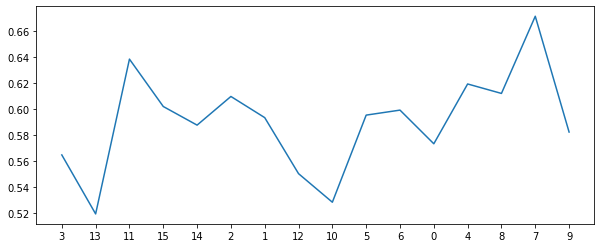

582
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6148567119155355
sensitivity  0.64
auc          0.6274283559577677


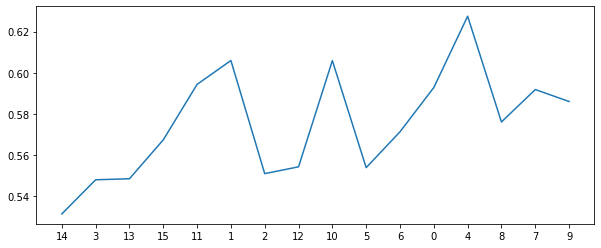

583
all features [13, 14, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6340874811463046
sensitivity  0.665
auc          0.6495437405731523


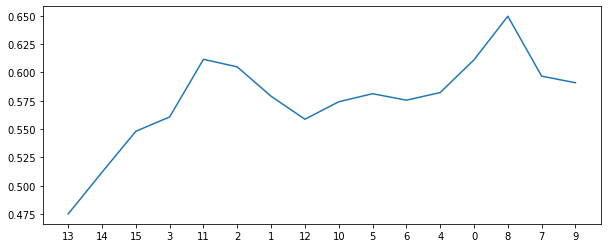

584
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6125
specificity  0.6110482654600302
sensitivity  0.635
auc          0.6230241327300151


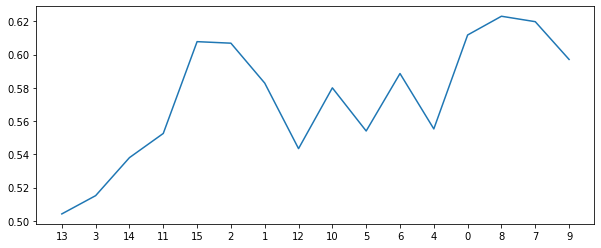

585
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6437782805429865
sensitivity  0.59
auc          0.6168891402714932


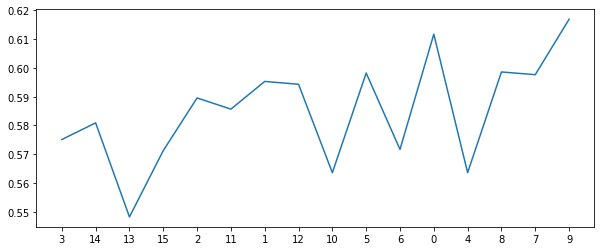

586
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6802790346907994
sensitivity  0.595
auc          0.6376395173453997


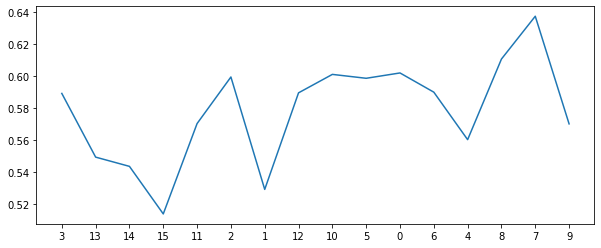

587
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6282428355957768
sensitivity  0.64
auc          0.6341214177978883


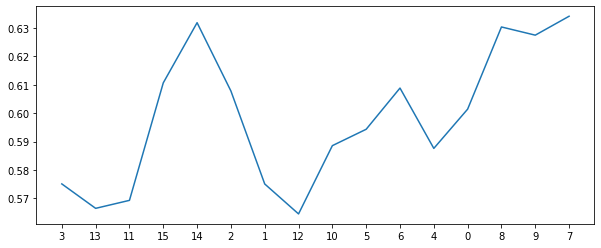

588
all features [14, 3, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6
specificity  0.5937028657616893
sensitivity  0.69
auc          0.6418514328808447


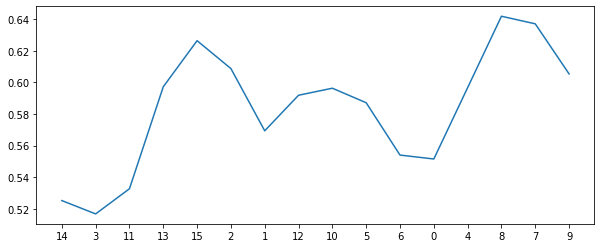

589
all features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.59947209653092
sensitivity  0.685
auc          0.6422360482654601


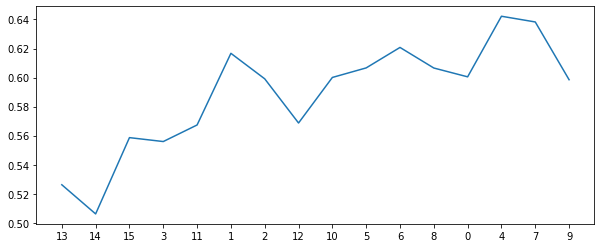

590
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 4, 0]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6380090497737557
sensitivity  0.615
auc          0.6265045248868778


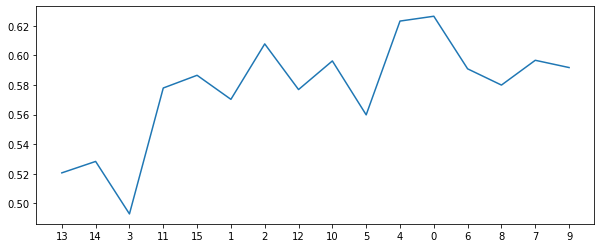

591
all features [3, 13, 15, 14, 11, 2, 12, 1, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 12, 1, 10, 5]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5860482654600302
sensitivity  0.74
auc          0.663024132730015


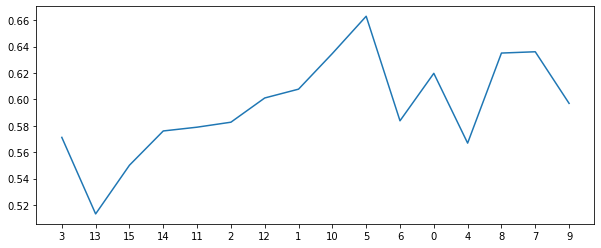

592
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6380467571644042
sensitivity  0.595
auc          0.6165233785822021


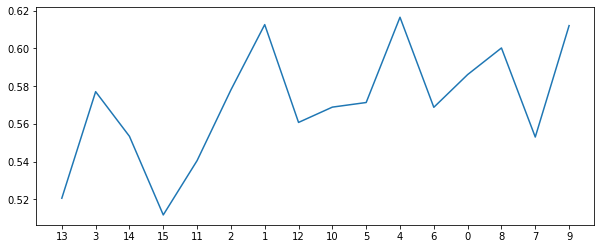

593
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 2, 0, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6186651583710407
sensitivity  0.615
auc          0.6168325791855204


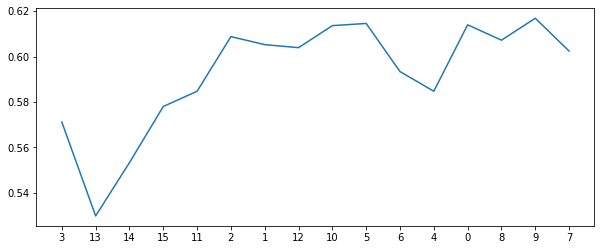

594
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6964285714285714
specificity  0.711236802413273
sensitivity  0.52
auc          0.6156184012066365


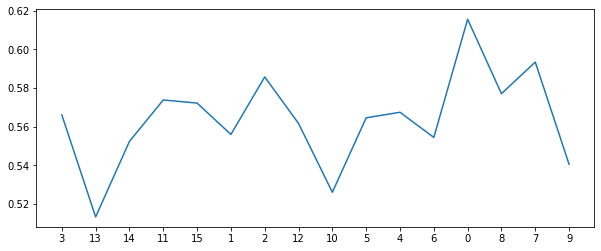

595
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.675
specificity  0.6822775263951735
sensitivity  0.595
auc          0.6386387631975867


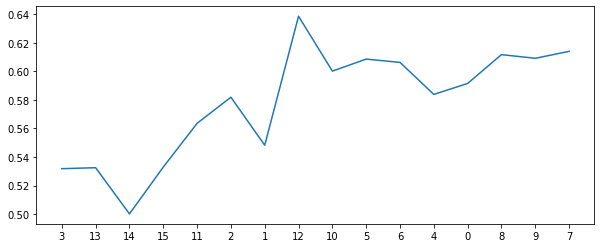

596
all features [3, 13, 14, 15, 1, 11, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 5, 10]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6900075414781297
sensitivity  0.52
auc          0.6050037707390649


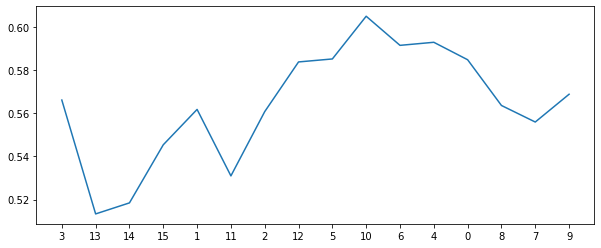

597
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.709238310708899
sensitivity  0.57
auc          0.6396191553544495


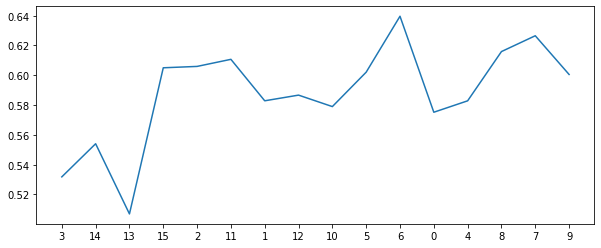

598
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.7214285714285714
specificity  0.7419306184012067
sensitivity  0.47
auc          0.6059653092006033


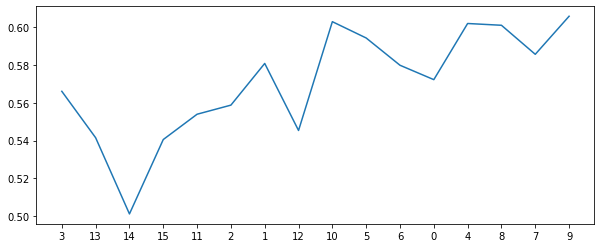

599
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.703393665158371
sensitivity  0.565
auc          0.6341968325791855


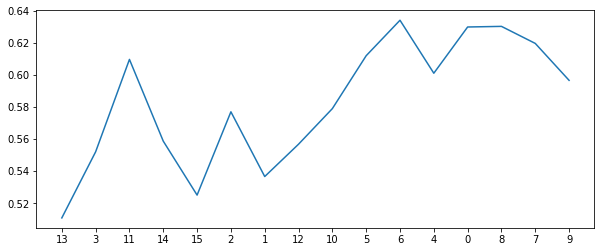

600
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6591628959276018
sensitivity  0.595
auc          0.6270814479638009


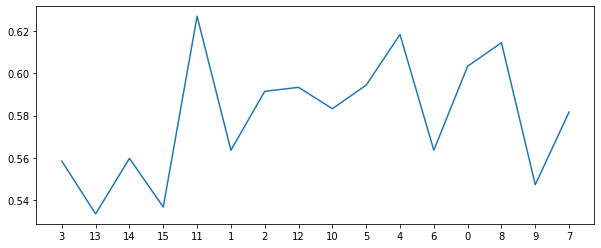

601
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5993212669683258
sensitivity  0.665
auc          0.6321606334841628


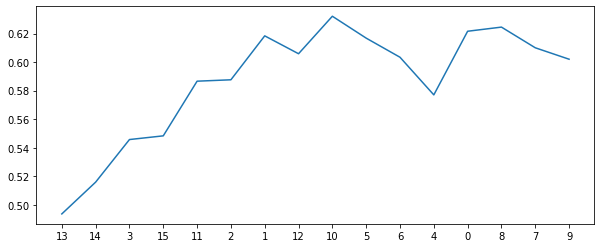

602
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6630467571644042
sensitivity  0.61
auc          0.6365233785822021


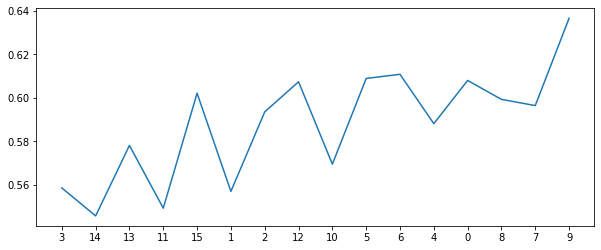

603
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6732142857142858
specificity  0.6687028657616892
sensitivity  0.735
auc          0.7018514328808446


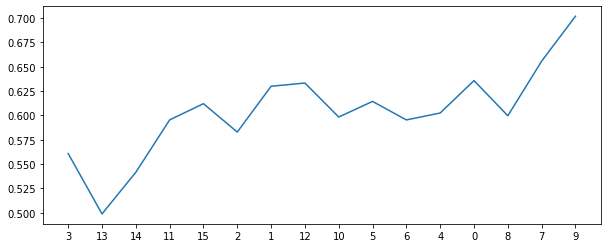

604
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6863122171945701
sensitivity  0.495
auc          0.590656108597285


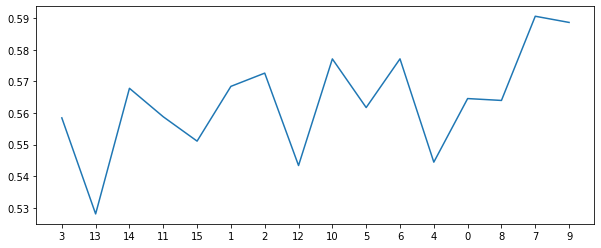

605
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1]
[0.4, 2, 1000, 2, 0, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.637971342383107
sensitivity  0.59
auc          0.6139856711915536


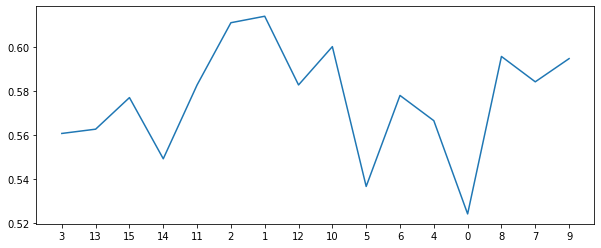

606
all features [3, 14, 11, 13, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5714285714285714
specificity  0.5629336349924585
sensitivity  0.695
auc          0.6289668174962293


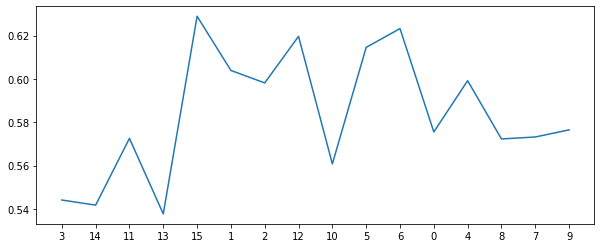

607
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5625565610859729
sensitivity  0.79
auc          0.6762782805429864


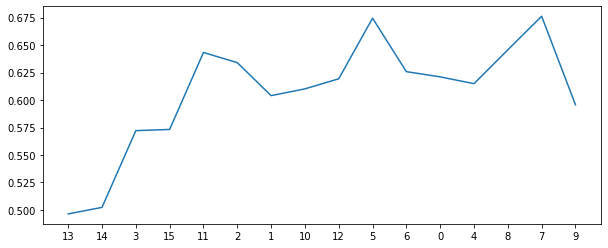

608
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6534313725490196
sensitivity  0.67
auc          0.6617156862745098


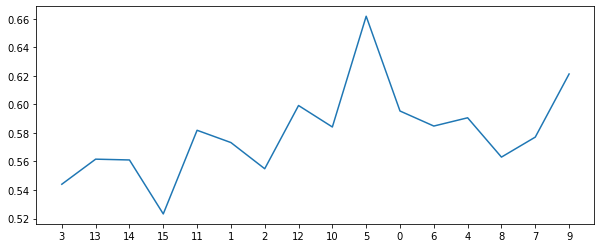

609
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6167797888386124
sensitivity  0.715
auc          0.6658898944193061


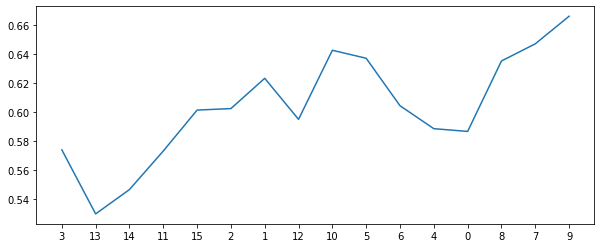

610
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.625
specificity  0.6245852187028658
sensitivity  0.645
auc          0.6347926093514329


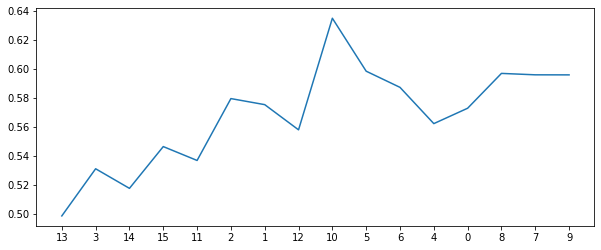

611
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6225113122171946
sensitivity  0.64
auc          0.6312556561085972


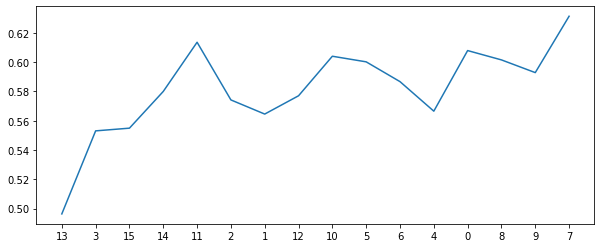

612
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.7214285714285714
specificity  0.7437782805429864
sensitivity  0.44
auc          0.5918891402714932


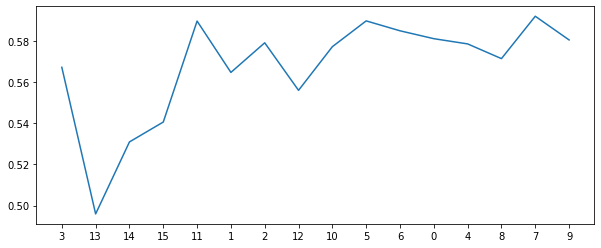

613
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.675
specificity  0.684238310708899
sensitivity  0.565
auc          0.6246191553544495


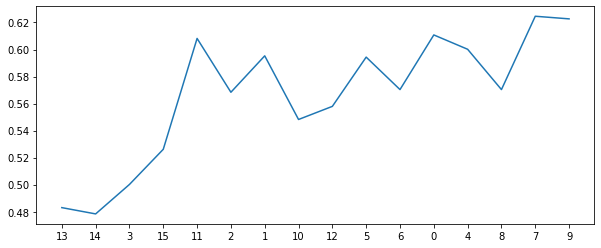

614
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.670739064856712
sensitivity  0.545
auc          0.607869532428356


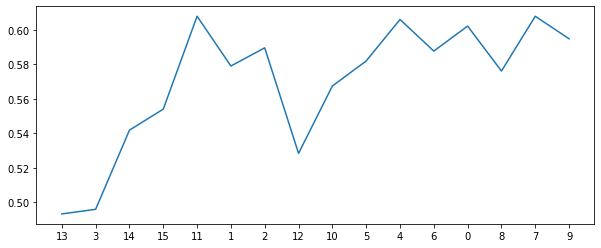

615
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7034690799396681
sensitivity  0.54
auc          0.6217345399698341


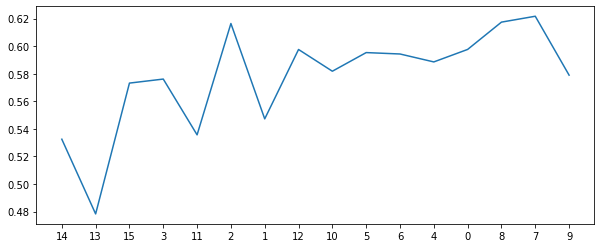

616
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7017857142857142
specificity  0.7189291101055807
sensitivity  0.495
auc          0.6069645550527903


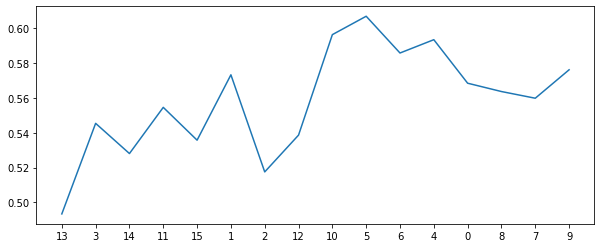

617
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6726621417797888
sensitivity  0.57
auc          0.6213310708898945


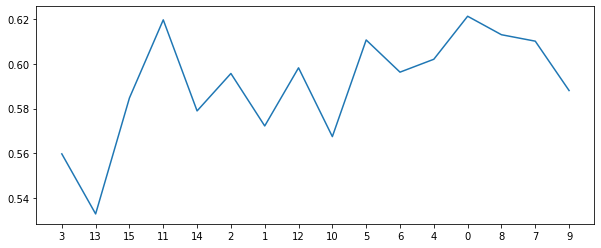

618
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6428571428571428
specificity  0.6476244343891403
sensitivity  0.595
auc          0.6213122171945702


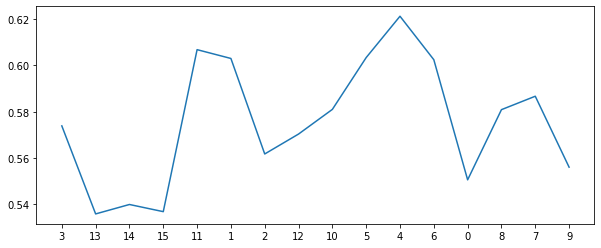

619
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5840497737556561
sensitivity  0.715
auc          0.6495248868778281


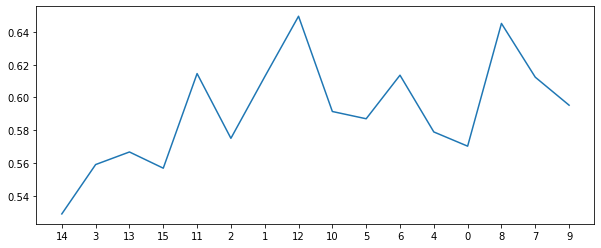

620
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6244720965309201
sensitivity  0.67
auc          0.64723604826546


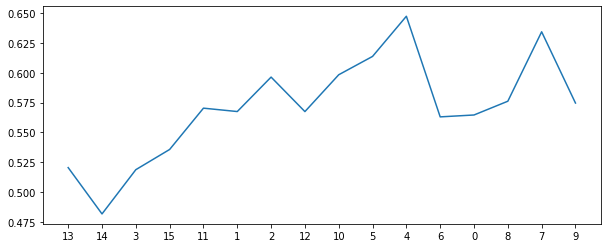

621
all features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6591251885369532
sensitivity  0.66
auc          0.6595625942684766


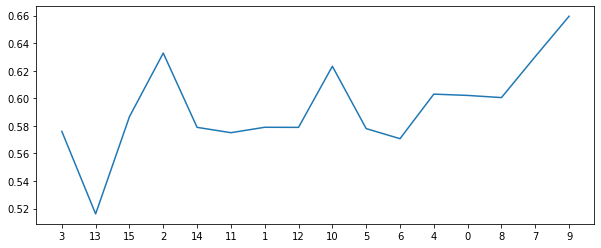

622
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6995852187028657
sensitivity  0.515
auc          0.6072926093514328


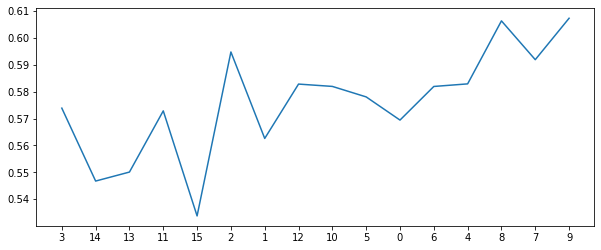

623
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6446428571428571
specificity  0.6495098039215687
sensitivity  0.595
auc          0.6222549019607844


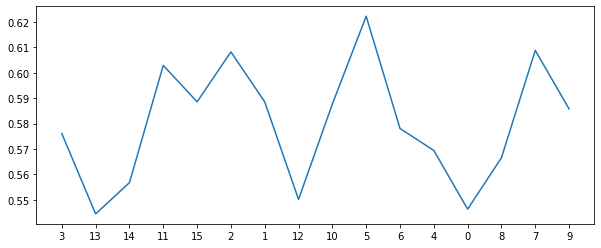

624
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6205882352941177
sensitivity  0.64
auc          0.6302941176470588


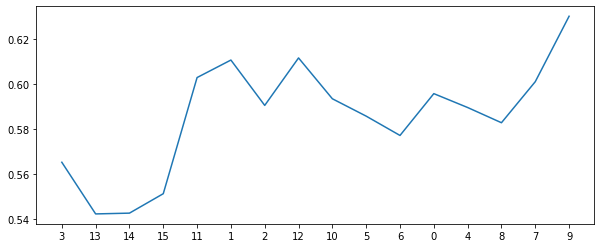

625
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5955882352941176
sensitivity  0.715
auc          0.6552941176470588


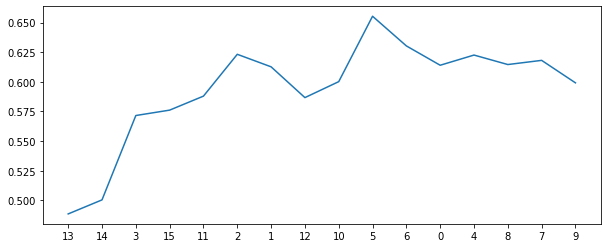

626
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6168929110105581
sensitivity  0.62
auc          0.618446455505279


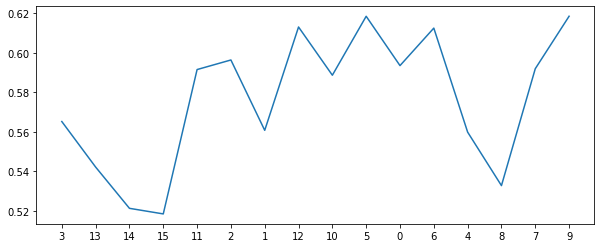

627
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.6410714285714285
specificity  0.6379336349924585
sensitivity  0.685
auc          0.6614668174962293


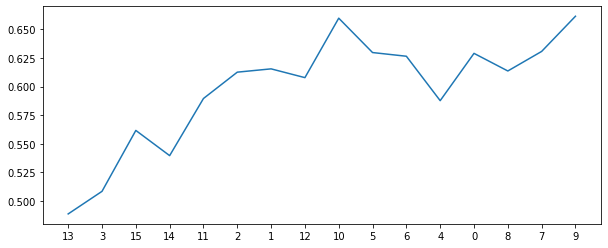

628
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6284313725490196
sensitivity  0.56
auc          0.5942156862745098


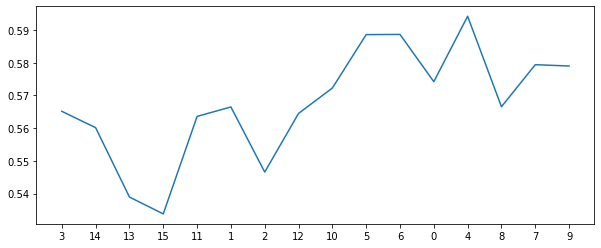

629
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6263574660633484
sensitivity  0.685
auc          0.6556787330316742


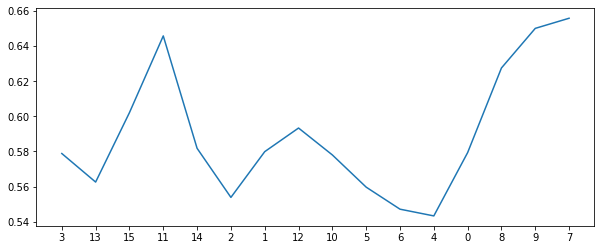

630
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.672737556561086
sensitivity  0.57
auc          0.6213687782805429


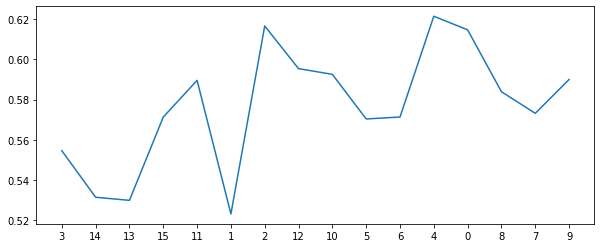

631
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.7013574660633484
sensitivity  0.585
auc          0.6431787330316742


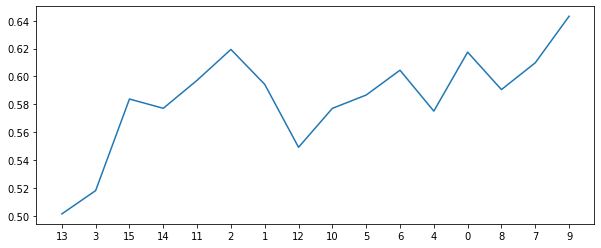

632
all features [3, 13, 14, 15, 11, 1, 12, 2, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 12, 2, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.693815987933635
sensitivity  0.59
auc          0.6419079939668175


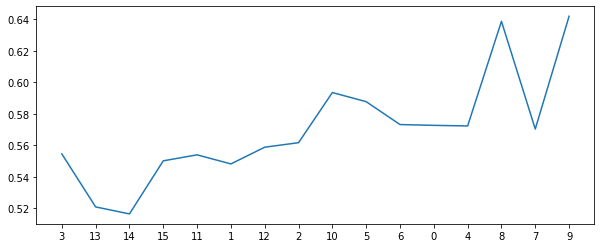

633
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.7072775263951735
sensitivity  0.585
auc          0.6461387631975867


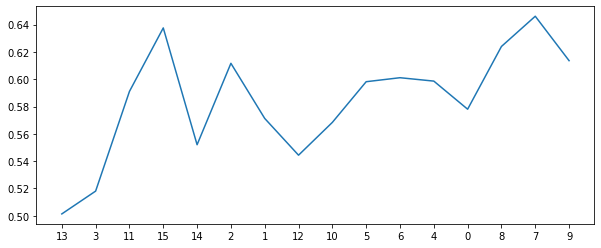

634
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6964285714285714
specificity  0.7111613876319759
sensitivity  0.52
auc          0.6155806938159879


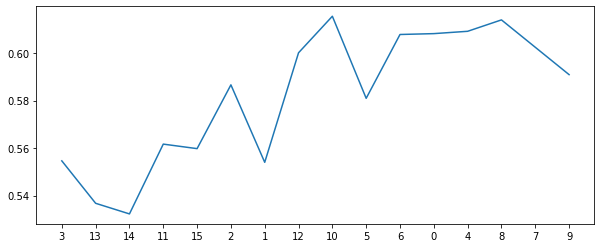

635
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6964285714285714
specificity  0.7072398190045249
sensitivity  0.565
auc          0.6361199095022625


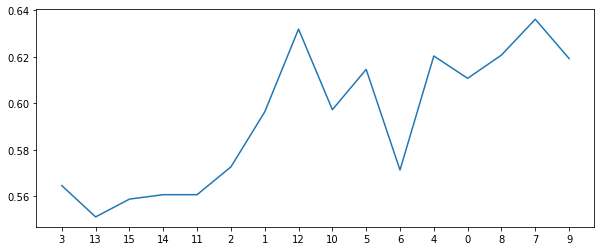

636
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6572398190045249
sensitivity  0.64
auc          0.6486199095022624


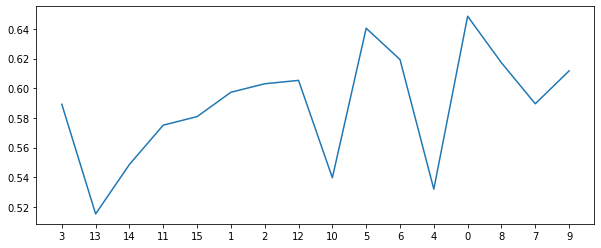

637
all features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6033182503770739
sensitivity  0.69
auc          0.646659125188537


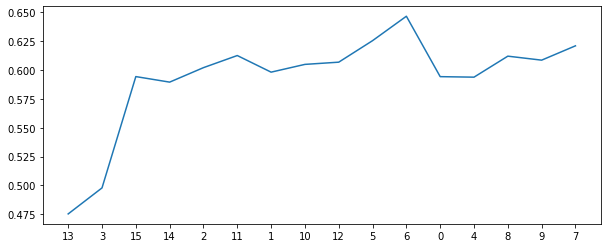

638
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6458521870286577
sensitivity  0.62
auc          0.6329260935143288


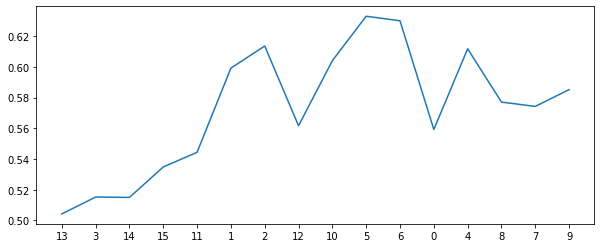

639
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.651395173453997
sensitivity  0.685
auc          0.6681975867269985


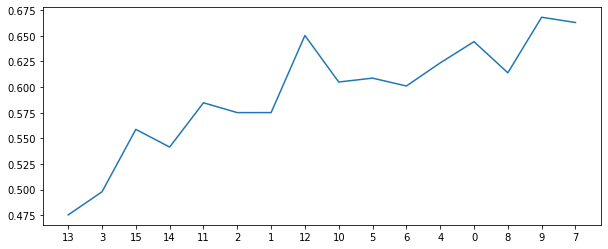

640
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6496606334841629
sensitivity  0.545
auc          0.5973303167420815


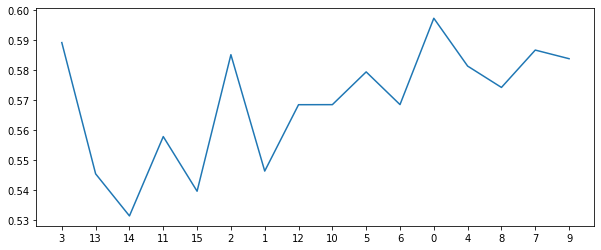

641
all features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6783936651583711
sensitivity  0.585
auc          0.6316968325791855


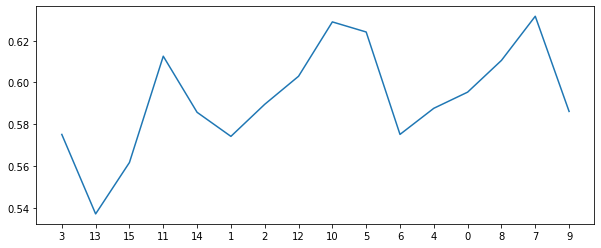

642
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5783559577677224
sensitivity  0.665
auc          0.6216779788838612


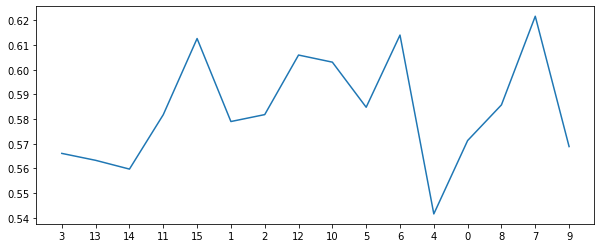

643
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.6
specificity  0.58789592760181
sensitivity  0.76
auc          0.6739479638009049


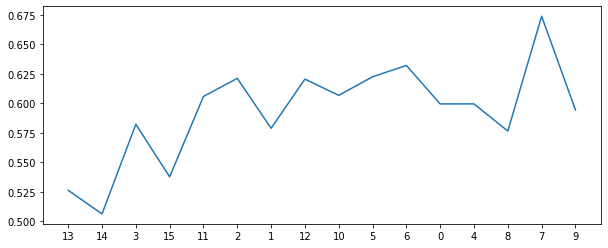

644
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5917043740573152
sensitivity  0.64
auc          0.6158521870286576


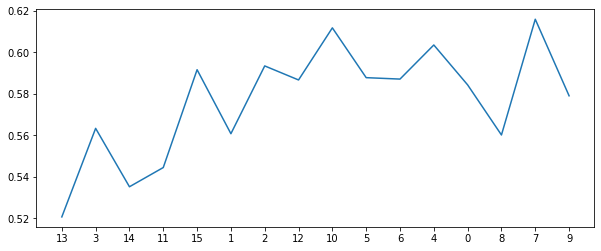

645
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 6, 5, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 6, 5, 4, 0]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.564894419306184
sensitivity  0.745
auc          0.654947209653092


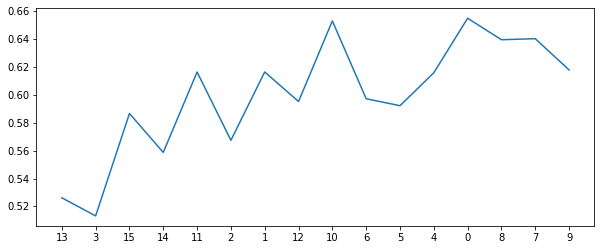

646
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6322775263951734
sensitivity  0.62
auc          0.6261387631975868


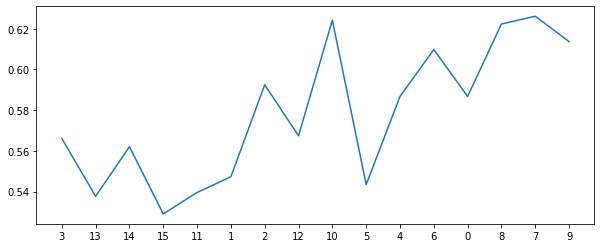

647
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6214285714285714
specificity  0.6149321266968325
sensitivity  0.71
auc          0.6624660633484163


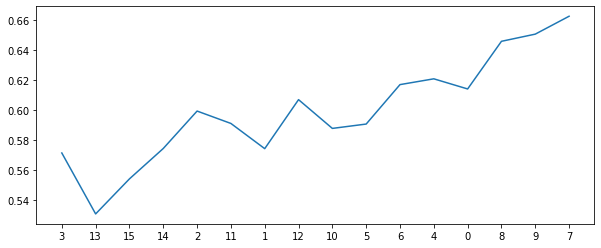

648
all features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6765837104072399
sensitivity  0.59
auc          0.6332918552036199


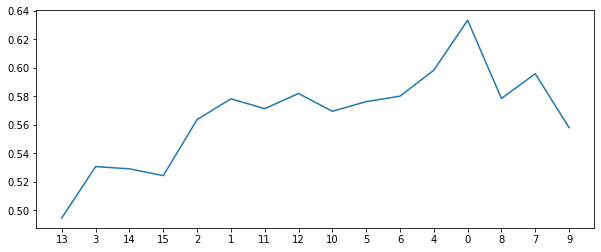

649
all features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 15, 3, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.682315233785822
sensitivity  0.64
auc          0.661157616892911


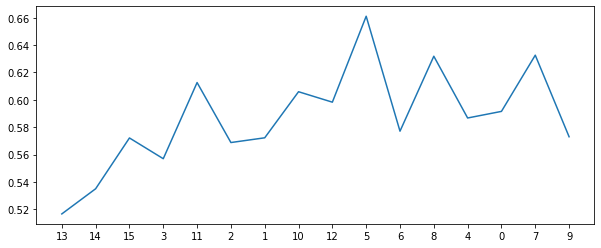

650
all features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6822021116138763
sensitivity  0.645
auc          0.6636010558069382


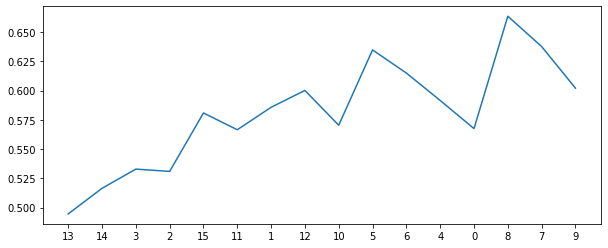

651
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6475867269984917
sensitivity  0.615
auc          0.6312933634992458


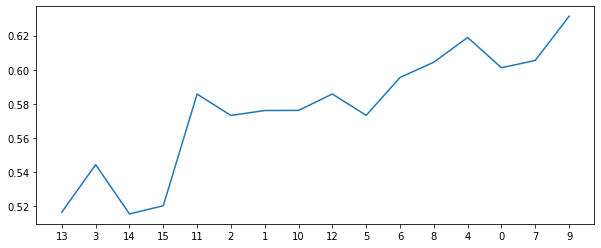

652
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6919306184012066
sensitivity  0.545
auc          0.6184653092006033


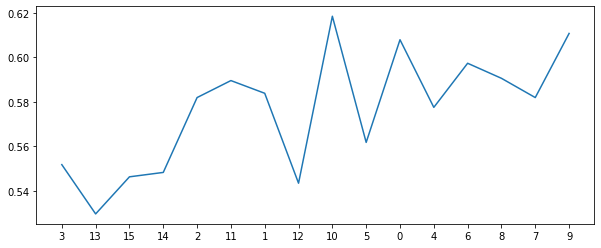

653
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6803571428571429
specificity  0.6880844645550528
sensitivity  0.59
auc          0.6390422322775264


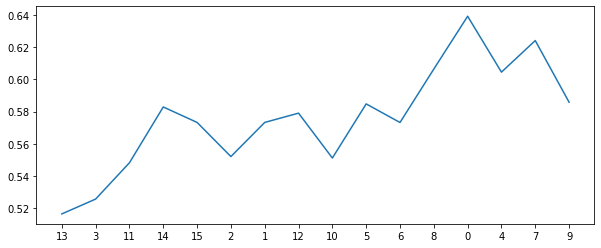

654
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6410714285714285
specificity  0.6419306184012066
sensitivity  0.645
auc          0.6434653092006033


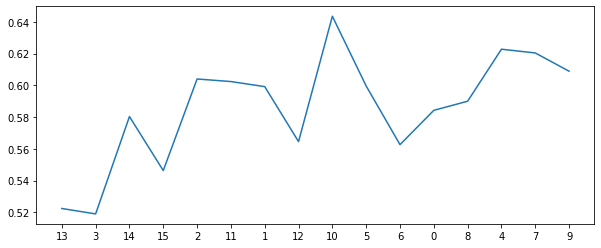

655
all features [14, 3, 15, 13, 11, 2, 1, 10, 12, 5, 8, 4, 6, 0, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 10, 12, 5, 8, 4, 6, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6110482654600302
sensitivity  0.715
auc          0.663024132730015


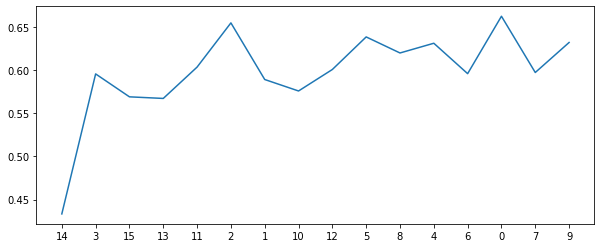

656
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6625
specificity  0.666892911010558
sensitivity  0.62
auc          0.643446455505279


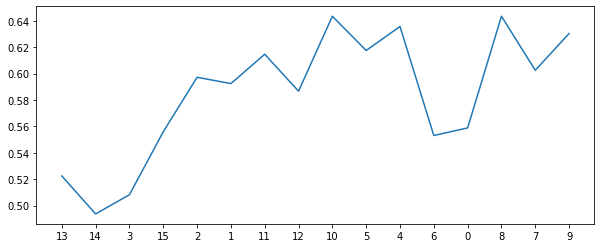

657
all features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 4, 0, 9, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6107142857142857
specificity  0.603393665158371
sensitivity  0.71
auc          0.6566968325791855


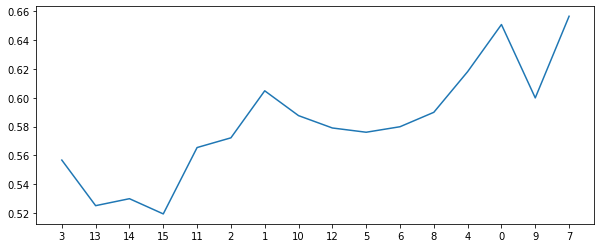

658
all features [13, 3, 14, 15, 11, 1, 2, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 1, 2, 10, 12, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6625
specificity  0.6669306184012066
sensitivity  0.615
auc          0.6409653092006034


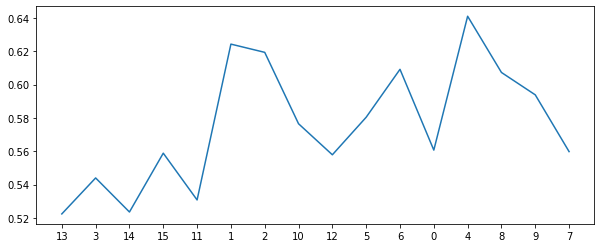

659
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6264705882352941
sensitivity  0.685
auc          0.6557352941176471


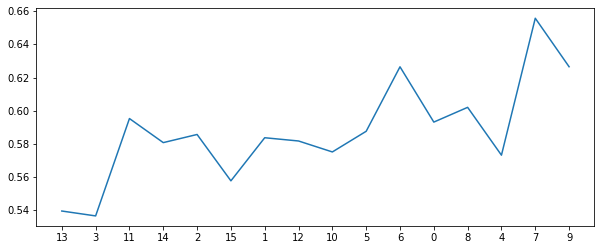

660
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.5762066365007542
sensitivity  0.715
auc          0.6456033182503771


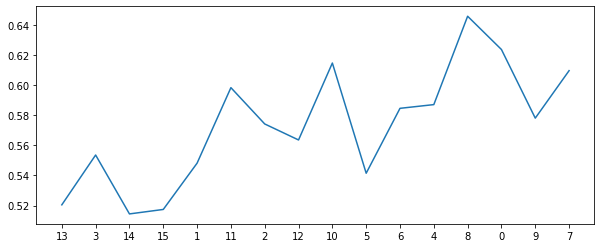

661
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5767857142857143
specificity  0.5685897435897436
sensitivity  0.69
auc          0.6292948717948718


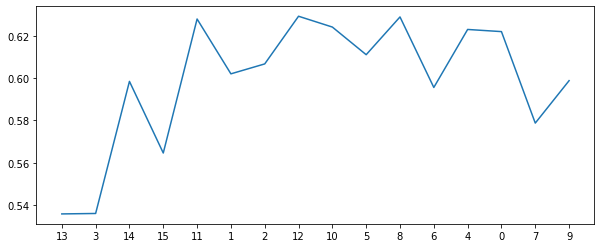

662
all features [14, 3, 13, 15, 1, 2, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 1, 2, 11, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6187782805429864
sensitivity  0.645
auc          0.6318891402714932


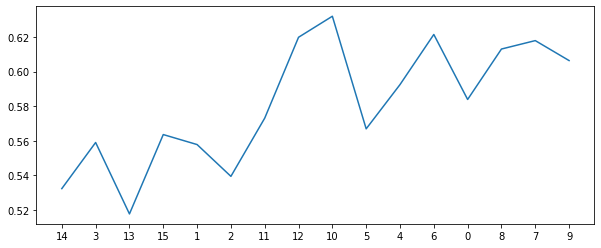

663
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.5436274509803921
sensitivity  0.76
auc          0.6518137254901961


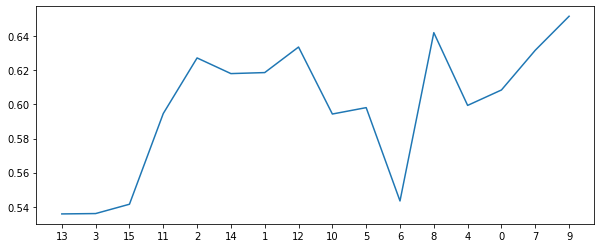

664
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5954751131221719
sensitivity  0.695
auc          0.645237556561086


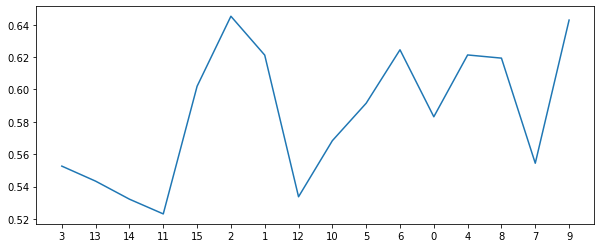

665
all features [13, 14, 3, 11, 15, 2, 12, 1, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 14, 3, 11, 15, 2, 12]
[0.4, 2, 1000, 2, 0.5, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5666289592760181
sensitivity  0.72
auc          0.643314479638009


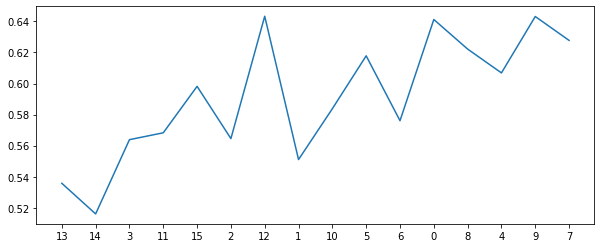

666
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6726621417797889
sensitivity  0.565
auc          0.6188310708898944


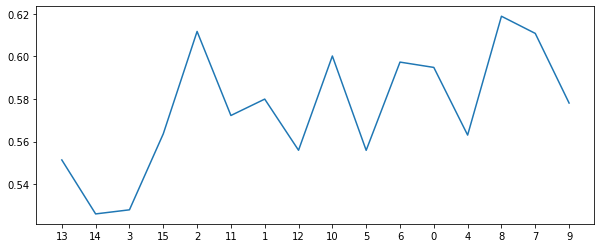

667
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.653393665158371
sensitivity  0.665
auc          0.6591968325791855


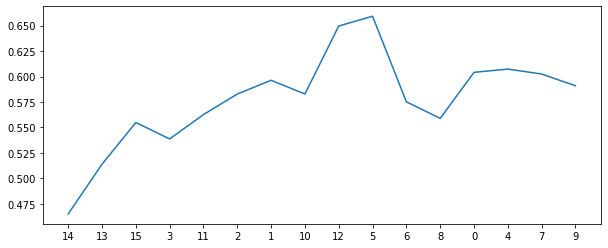

668
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 8, 0, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.7035714285714285
specificity  0.7150452488687783
sensitivity  0.565
auc          0.6400226244343892


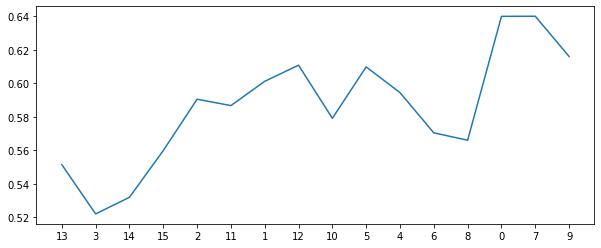

669
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6785822021116139
sensitivity  0.66
auc          0.6692911010558069


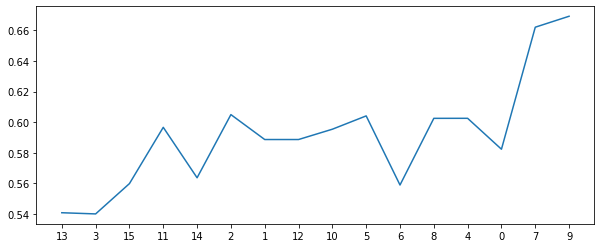

670
all features [3, 15, 13, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 15, 13, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7053571428571429
specificity  0.722737556561086
sensitivity  0.495
auc          0.608868778280543


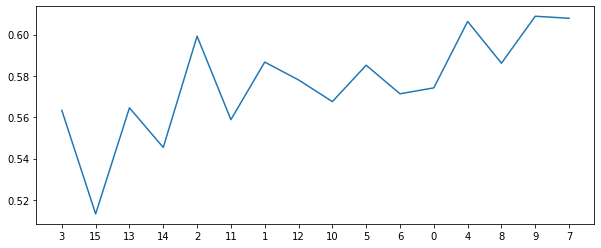

671
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6592760180995475
sensitivity  0.615
auc          0.6371380090497738


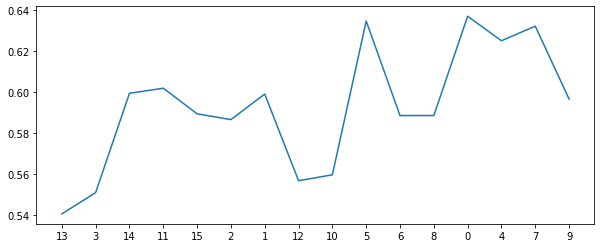

672
all features [13, 3, 14, 15, 2, 1, 12, 11, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 1, 12, 11, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6033182503770739
sensitivity  0.69
auc          0.646659125188537


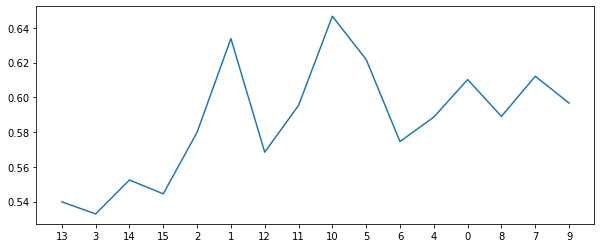

673
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5, 8, 6, 4, 7, 0, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6111236802413273
sensitivity  0.665
auc          0.6380618401206637


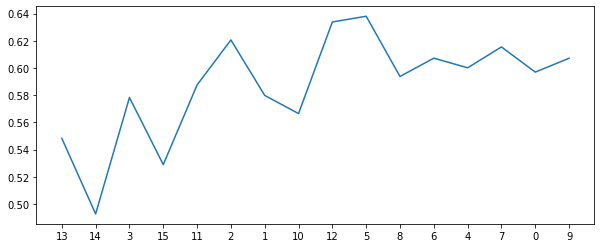

674
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6572398190045249
sensitivity  0.64
auc          0.6486199095022624


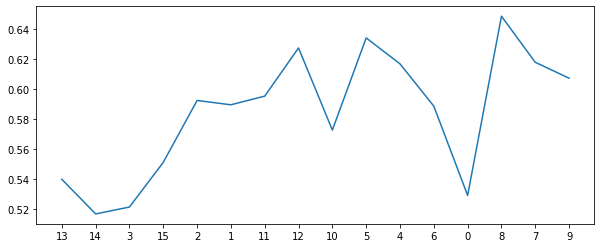

675
all features [3, 13, 2, 14, 15, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 2, 14, 15, 11, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6283182503770739
sensitivity  0.66
auc          0.644159125188537


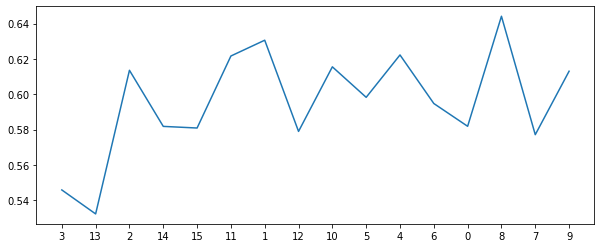

676
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6187782805429864
sensitivity  0.645
auc          0.6318891402714932


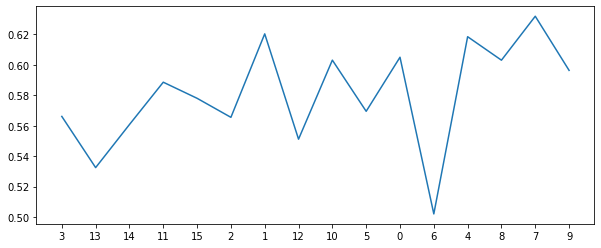

677
all features [13, 3, 11, 2, 14, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 2, 14, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6418552036199094
sensitivity  0.66
auc          0.6509276018099548


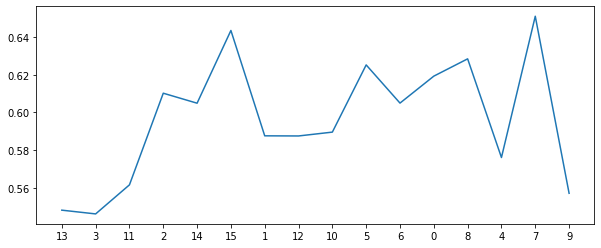

678
all features [13, 3, 15, 14, 1, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 1, 2, 11, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6072398190045248
sensitivity  0.665
auc          0.6361199095022624


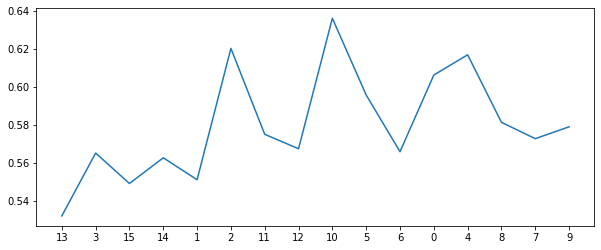

679
all features [14, 15, 3, 13, 11, 1, 2, 10, 12, 5, 8, 6, 4, 9, 0, 7, 16]
new features [14, 15, 3, 13, 11, 1, 2, 10, 12, 5, 8, 6, 4, 9, 0, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.5491704374057316
sensitivity  0.685
auc          0.6170852187028657


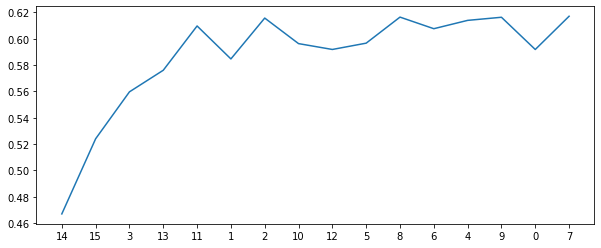

680
all features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5859728506787331
sensitivity  0.71
auc          0.6479864253393665


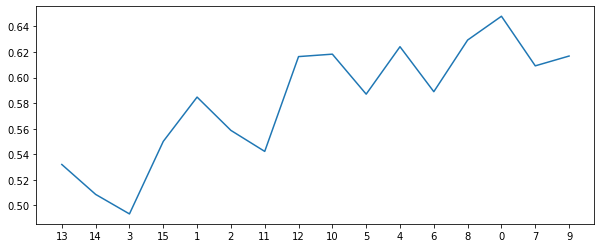

681
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5782805429864254
sensitivity  0.76
auc          0.6691402714932126


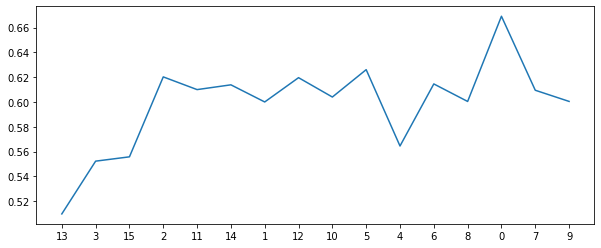

682
all features [13, 15, 3, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 11]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5553571428571429
specificity  0.5435897435897435
sensitivity  0.715
auc          0.6292948717948718


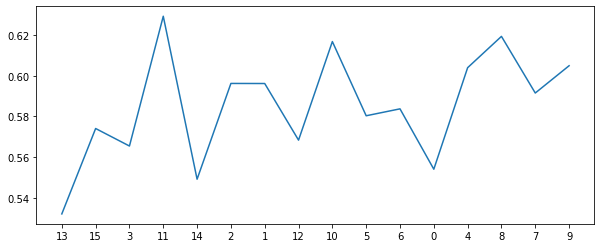

683
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 6, 5, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10, 6, 5, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5918552036199095
sensitivity  0.685
auc          0.6384276018099547


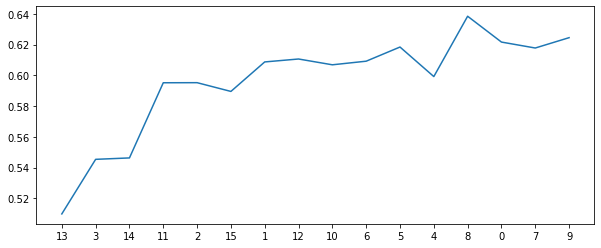

684
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6996229260935143
sensitivity  0.52
auc          0.6098114630467572


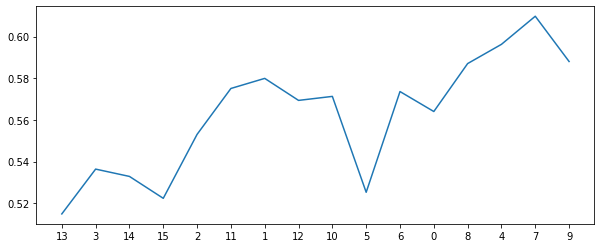

685
all features [14, 13, 15, 3, 2, 11, 1, 12, 5, 10, 8, 6, 0, 4, 7, 9, 16]
new features [14, 13, 15, 3, 2, 11, 1, 12, 5, 10, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6515082956259427
sensitivity  0.665
auc          0.6582541478129713


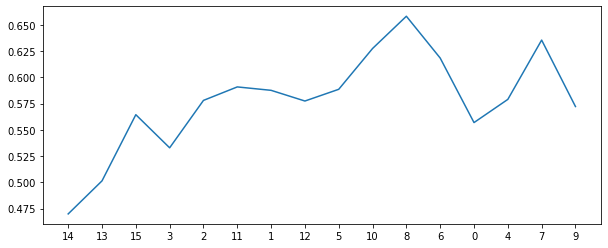

686
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6783936651583711
sensitivity  0.59
auc          0.6341968325791855


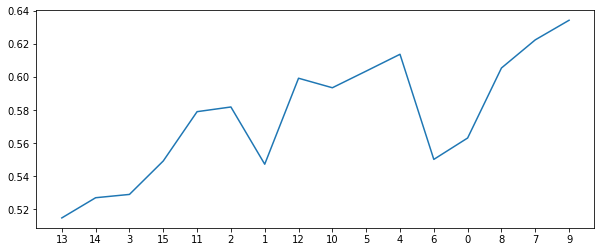

687
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 8, 6, 0, 7, 4, 9, 16]
new features [3, 13, 15, 11, 2]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.620475113122172
sensitivity  0.665
auc          0.642737556561086


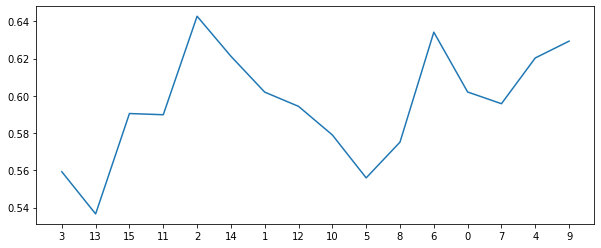

688
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6939291101055807
sensitivity  0.52
auc          0.6069645550527903


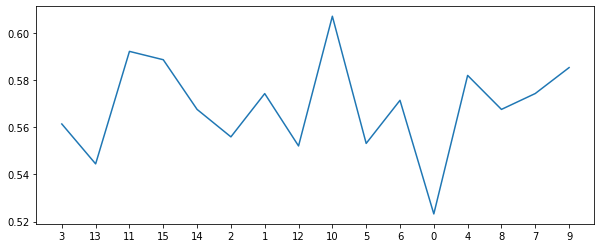

689
all features [13, 3, 14, 2, 15, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 14, 2, 15, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6899698340874811
sensitivity  0.545
auc          0.6174849170437405


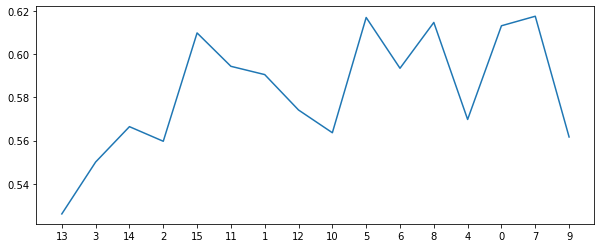

690
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6072021116138764
sensitivity  0.685
auc          0.6461010558069382


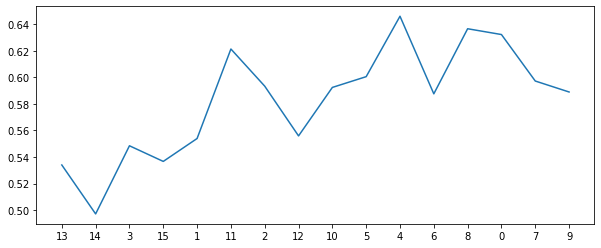

691
all features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 8, 4, 6, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 10, 12, 5, 8, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.6033182503770739
sensitivity  0.67
auc          0.636659125188537


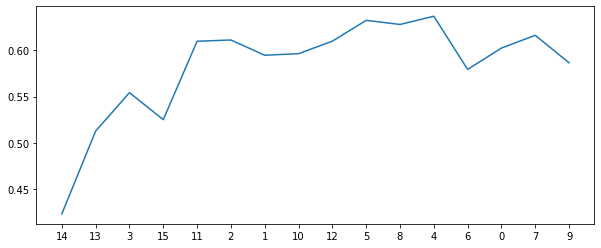

692
all features [13, 14, 15, 3, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 15, 3, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.595
auc          0.6136199095022624


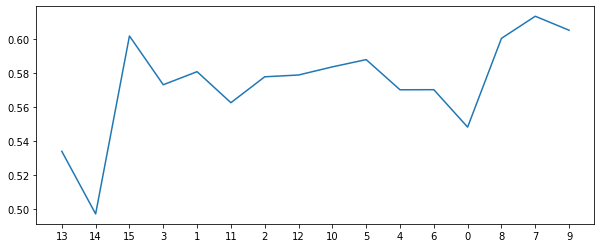

693
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6225867269984917
sensitivity  0.71
auc          0.6662933634992458


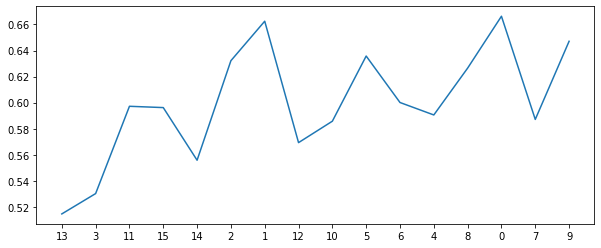

694
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6207767722473605
sensitivity  0.665
auc          0.6428883861236803


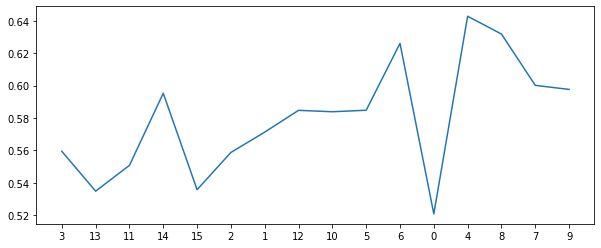

695
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6207013574660634
sensitivity  0.665
auc          0.6428506787330317


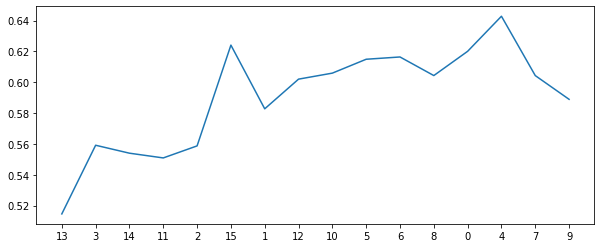

696
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5937028657616893
sensitivity  0.665
auc          0.6293514328808446


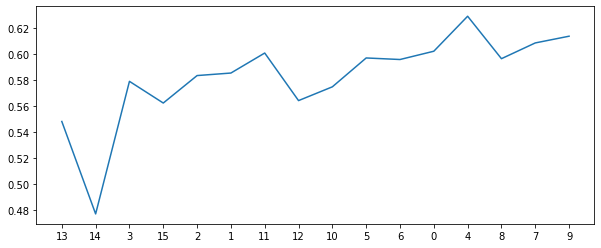

697
all features [14, 13, 15, 3, 11, 2, 1, 10, 12, 5, 8, 6, 4, 0, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.49642857142857144
specificity  0.472473604826546
sensitivity  0.815
auc          0.643736802413273


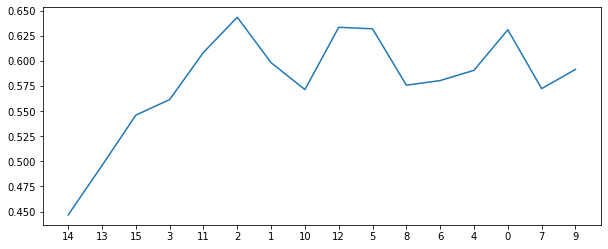

698
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.575
specificity  0.5667420814479638
sensitivity  0.69
auc          0.6283710407239819


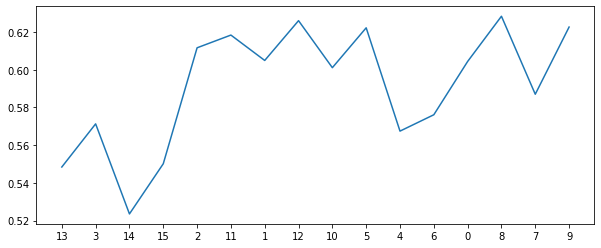

699
all features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5840874811463047
sensitivity  0.735
auc          0.6595437405731523


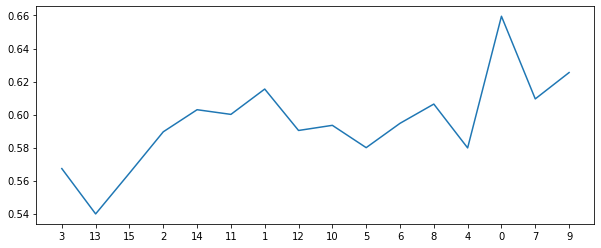

700
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.5937782805429864
sensitivity  0.695
auc          0.6443891402714932


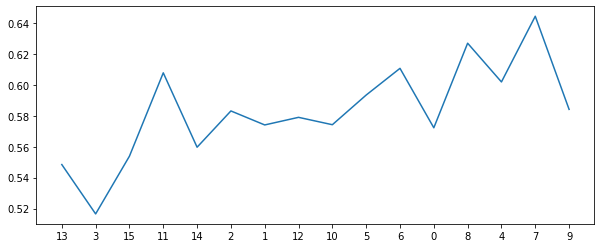

701
all features [13, 3, 11, 2, 14, 15, 12, 1, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 2, 14, 15, 12, 1, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.5956259426847662
sensitivity  0.74
auc          0.667812971342383


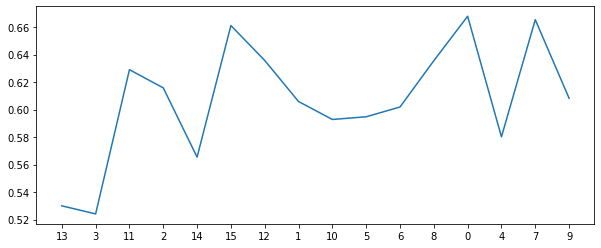

702
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428572
specificity  0.680316742081448
sensitivity  0.54
auc          0.610158371040724


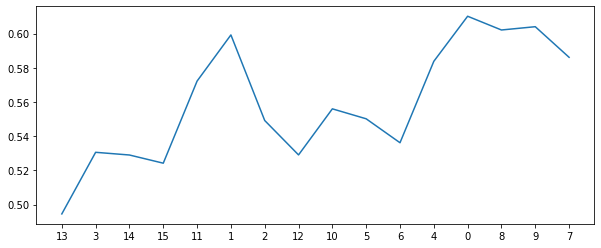

703
all features [13, 14, 11, 3, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 11, 3, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6937782805429864
sensitivity  0.565
auc          0.6293891402714932


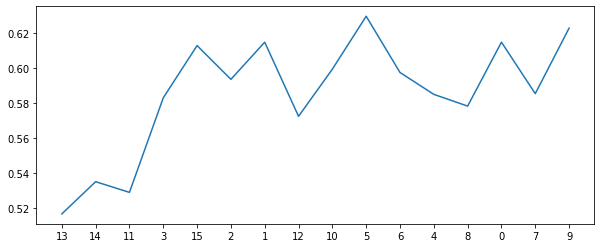

704
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.703393665158371
sensitivity  0.585
auc          0.6441968325791855


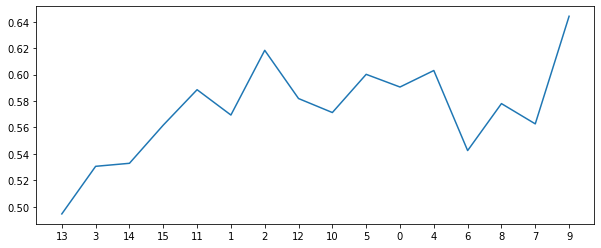

705
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6714285714285714
specificity  0.6783559577677225
sensitivity  0.585
auc          0.6316779788838612


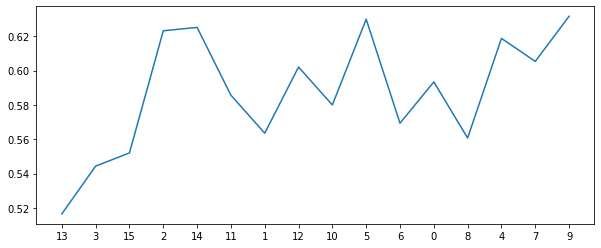

706
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6919306184012066
sensitivity  0.62
auc          0.6559653092006033


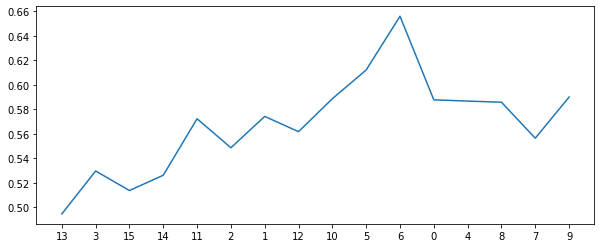

707
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6625
specificity  0.6687782805429864
sensitivity  0.585
auc          0.6268891402714932


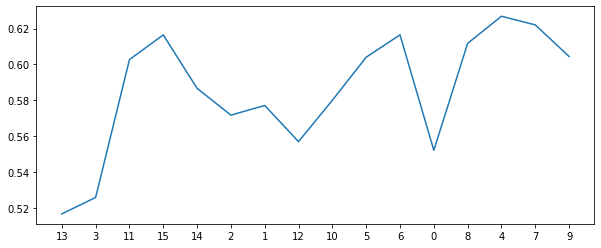

708
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6323529411764706
sensitivity  0.62
auc          0.6261764705882353


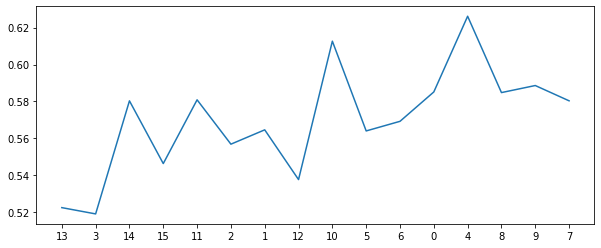

709
all features [13, 14, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6302413273001508
sensitivity  0.685
auc          0.6576206636500754


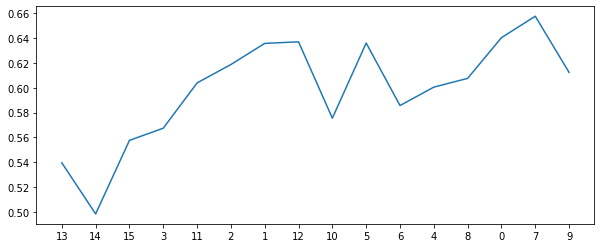

710
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6590874811463047
sensitivity  0.595
auc          0.6270437405731524


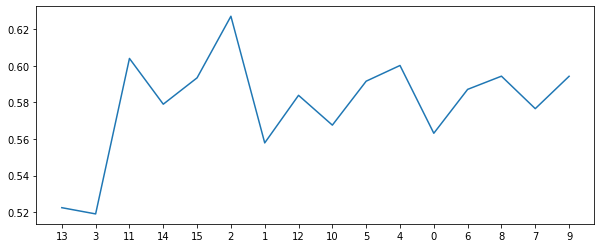

711
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6125
specificity  0.6069758672699849
sensitivity  0.685
auc          0.6459879336349924


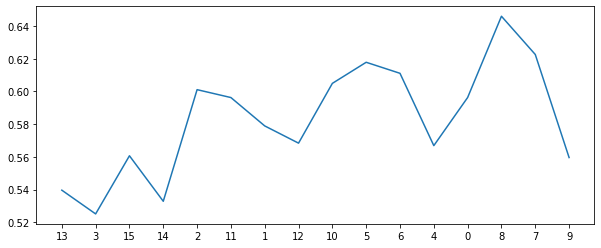

712
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6860105580693816
sensitivity  0.62
auc          0.6530052790346907


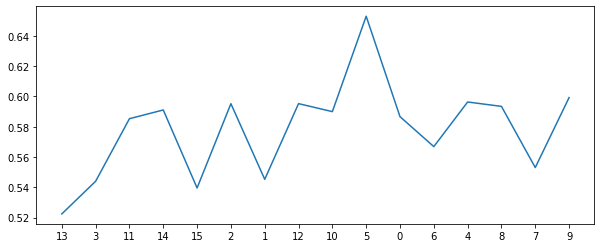

713
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.625
specificity  0.6243589743589744
sensitivity  0.635
auc          0.6296794871794872


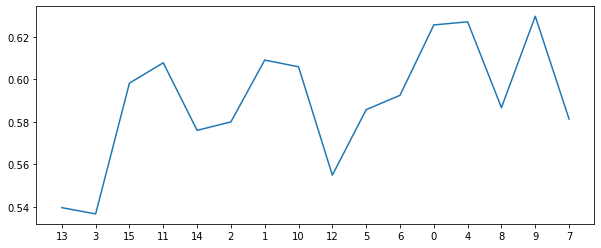

714
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5964285714285714
specificity  0.5937782805429864
sensitivity  0.64
auc          0.6168891402714932


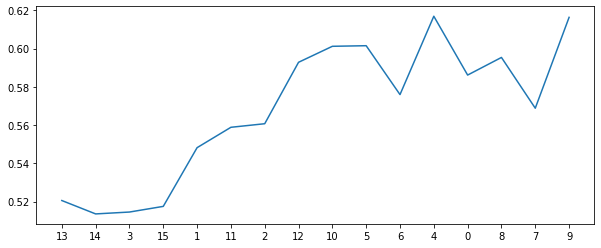

715
all features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.5474736048265461
sensitivity  0.71
auc          0.628736802413273


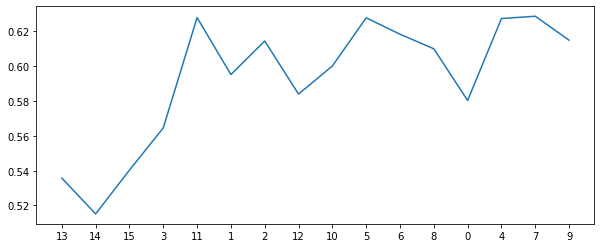

716
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5964285714285714
specificity  0.5880090497737557
sensitivity  0.715
auc          0.6515045248868778


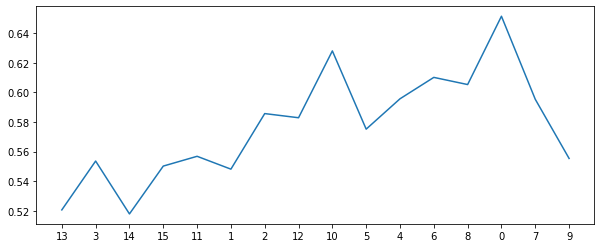

717
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6
specificity  0.593552036199095
sensitivity  0.685
auc          0.6392760180995475


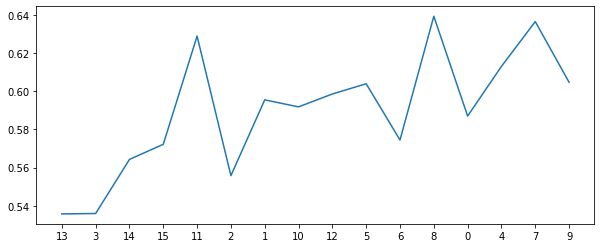

718
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6282051282051282
sensitivity  0.645
auc          0.6366025641025641


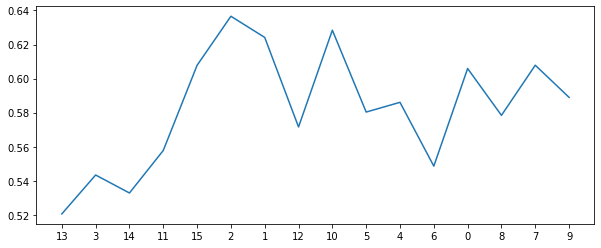

719
all features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0.5, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5858597285067874
sensitivity  0.735
auc          0.6604298642533937


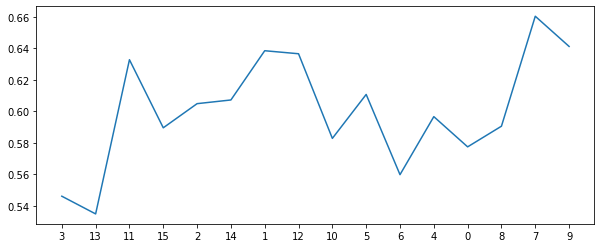

720
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6535067873303168
sensitivity  0.57
auc          0.6117533936651584


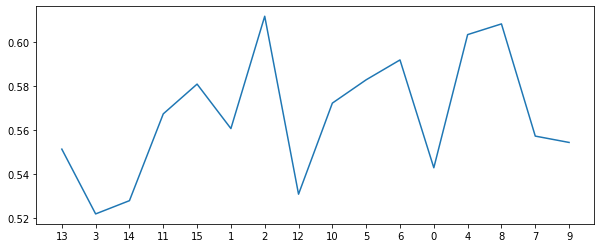

721
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6610859728506787
sensitivity  0.615
auc          0.6380429864253394


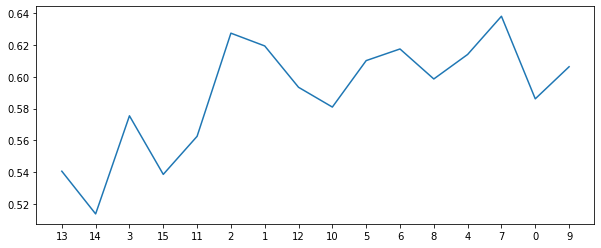

722
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6976621417797888
sensitivity  0.54
auc          0.6188310708898944


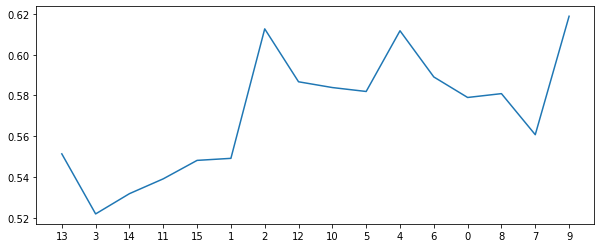

723
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6783182503770739
sensitivity  0.585
auc          0.631659125188537


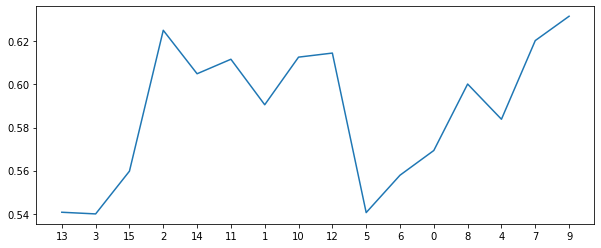

724
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6899321266968326
sensitivity  0.545
auc          0.6174660633484162


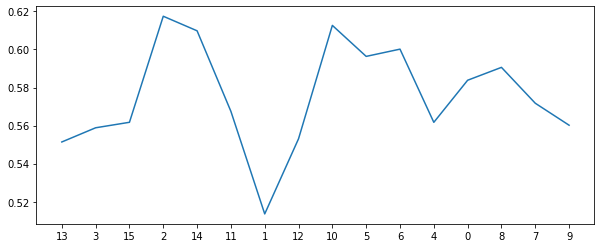

725
all features [13, 3, 11, 15, 14, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6629336349924585
sensitivity  0.645
auc          0.6539668174962292


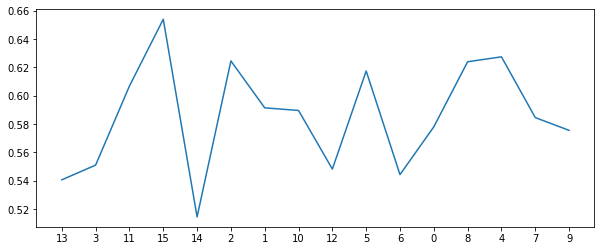

726
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6342383107088989
sensitivity  0.64
auc          0.6371191553544495


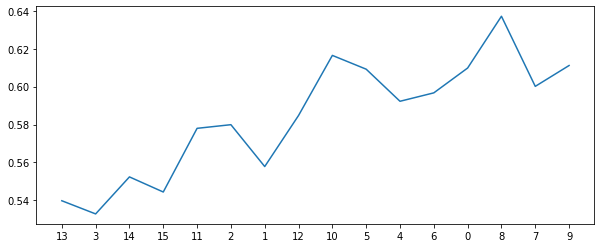

727
all features [13, 14, 15, 3, 11, 1, 2, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 15, 3, 11, 1, 2, 10, 12, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.5975867269984917
sensitivity  0.735
auc          0.6662933634992458


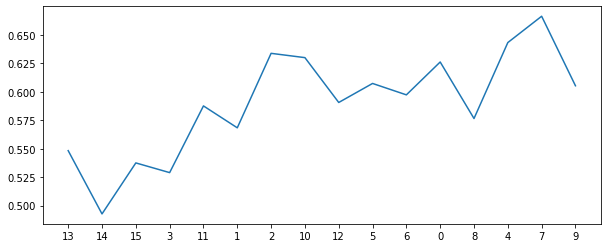

728
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 0, 6]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6392857142857143
specificity  0.6439291101055807
sensitivity  0.59
auc          0.6169645550527904


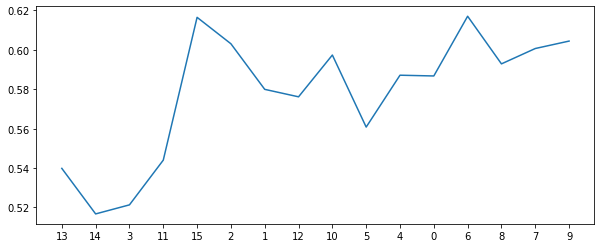

729
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6302790346907994
sensitivity  0.645
auc          0.6376395173453997


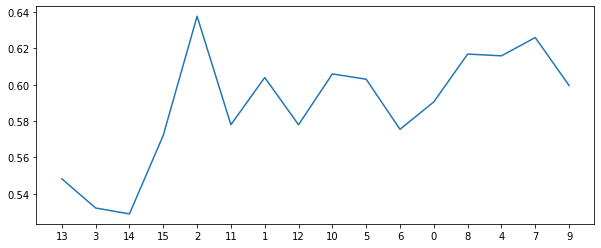

730
all features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 3, 14, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6650075414781297
sensitivity  0.57
auc          0.6175037707390648


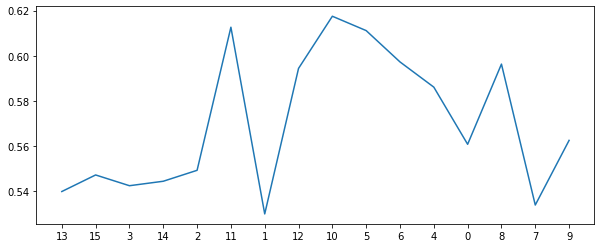

731
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5877828054298643
sensitivity  0.72
auc          0.6538914027149321


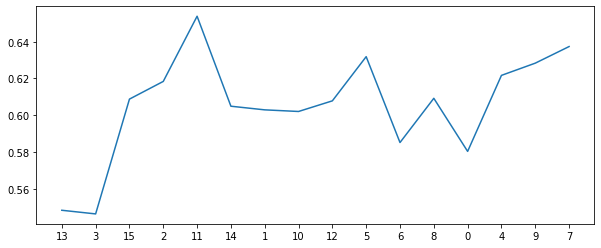

732
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.57447209653092
sensitivity  0.715
auc          0.64473604826546


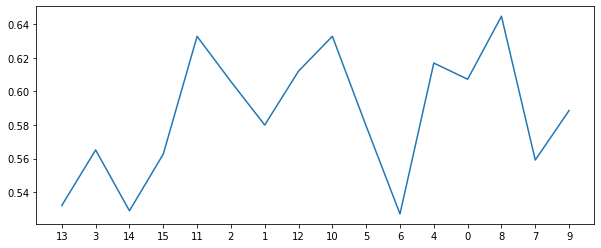

733
all features [13, 14, 11, 3, 15, 2, 1, 10, 12, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 14, 11, 3, 15, 2, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5937405731523379
sensitivity  0.735
auc          0.6643702865761689


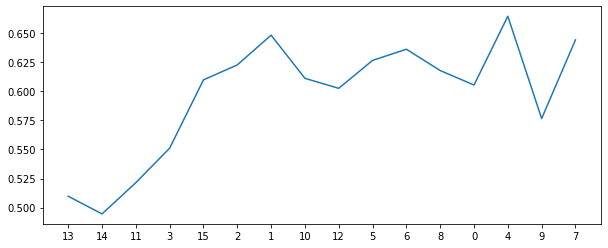

734
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6052790346907994
sensitivity  0.62
auc          0.6126395173453997


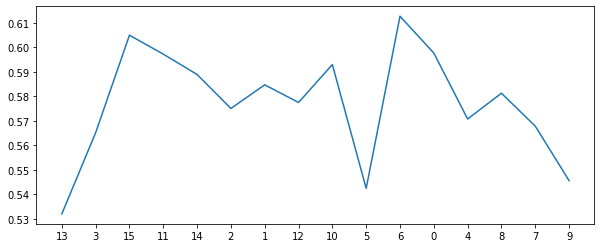

735
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.589894419306184
sensitivity  0.71
auc          0.649947209653092


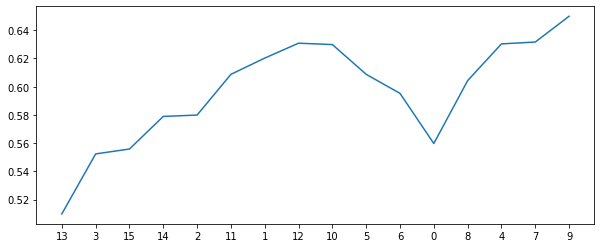

736
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.5995852187028657
sensitivity  0.715
auc          0.6572926093514329


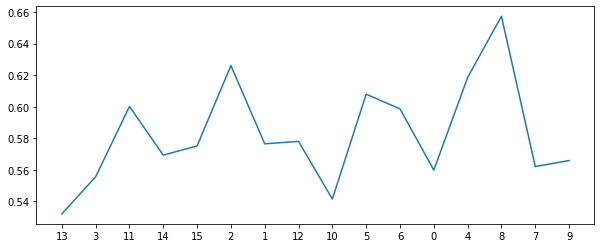

737
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5879336349924585
sensitivity  0.76
auc          0.6739668174962292


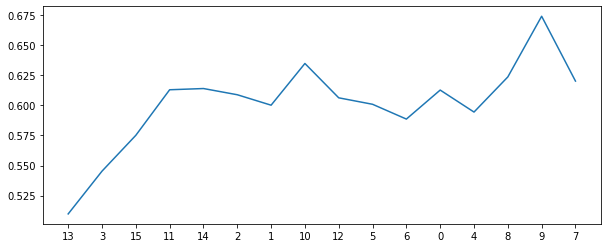

738
all features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6745475113122171
sensitivity  0.62
auc          0.6472737556561086


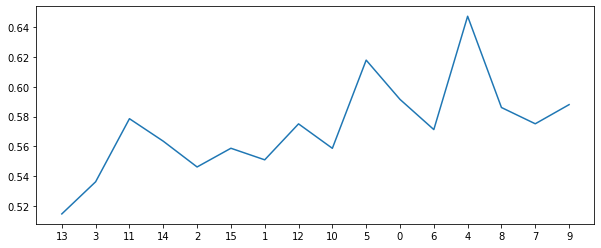

739
all features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 11, 2, 15, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6667797888386123
sensitivity  0.585
auc          0.6258898944193062


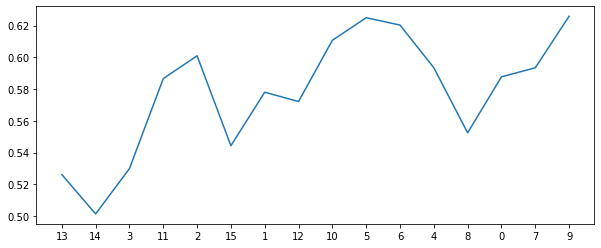

740
all features [13, 3, 15, 14, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.6688914027149321
sensitivity  0.57
auc          0.619445701357466


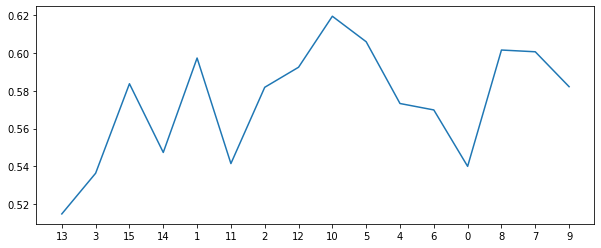

741
all features [13, 3, 14, 2, 11, 15, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 2, 11, 15, 1, 10, 12, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.670739064856712
sensitivity  0.64
auc          0.6553695324283559


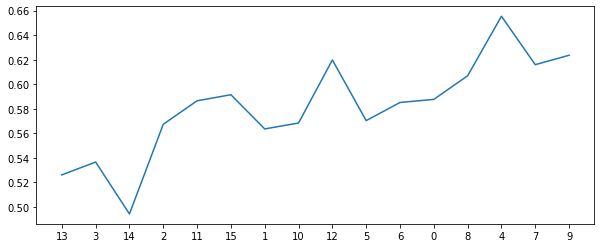

742
all features [3, 13, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6881598793363499
sensitivity  0.545
auc          0.6165799396681749


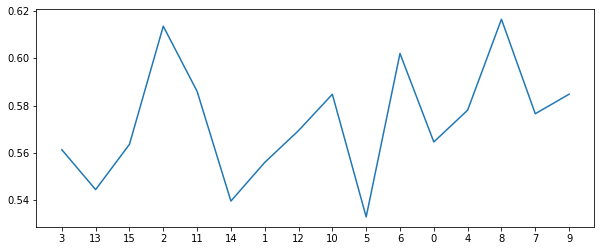

743
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6964285714285714
specificity  0.7034313725490196
sensitivity  0.61
auc          0.6567156862745098


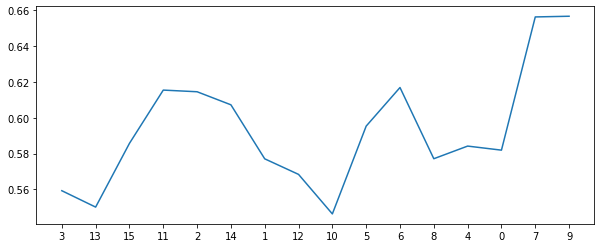

744
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.625
specificity  0.6245098039215686
sensitivity  0.645
auc          0.6347549019607843


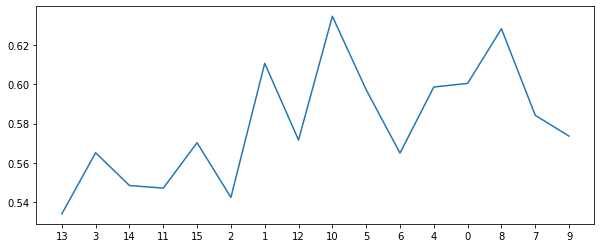

745
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6342006033182503
sensitivity  0.64
auc          0.6371003016591252


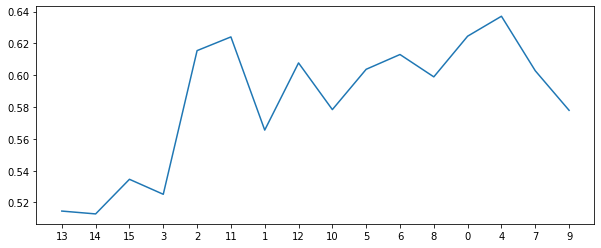

746
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6282428355957768
sensitivity  0.645
auc          0.6366214177978884


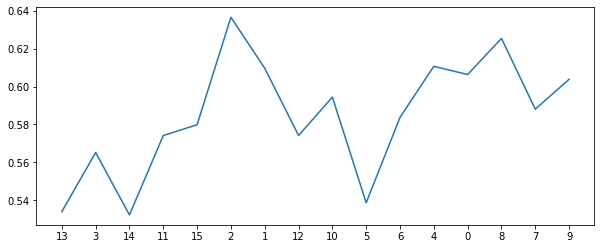

747
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6282051282051282
sensitivity  0.685
auc          0.6566025641025641


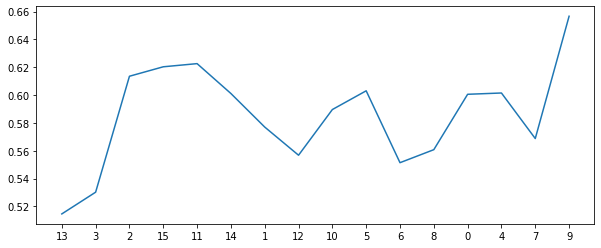

748
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.65
specificity  0.645739064856712
sensitivity  0.715
auc          0.680369532428356


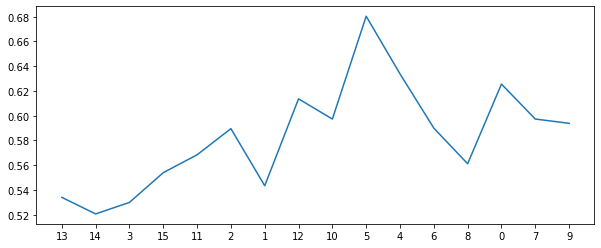

749
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 3, 11, 2]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6017857142857143
specificity  0.5955882352941176
sensitivity  0.69
auc          0.6427941176470588


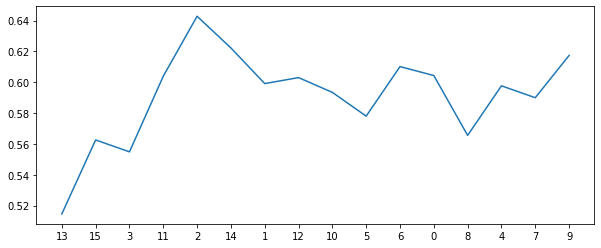

750
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5975490196078431
sensitivity  0.665
auc          0.6312745098039215


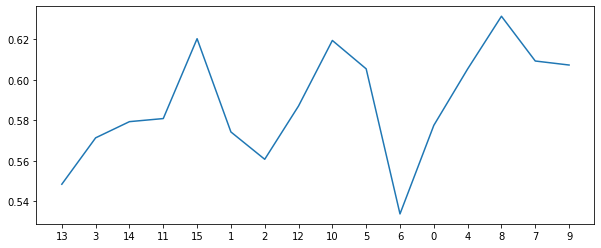

751
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5410714285714285
specificity  0.5263574660633484
sensitivity  0.74
auc          0.6331787330316742


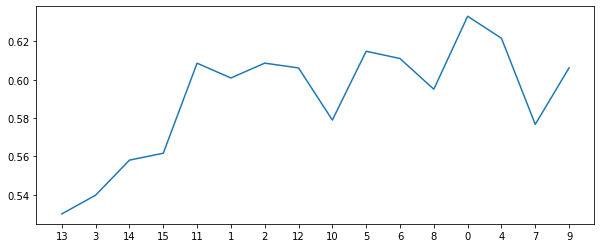

752
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5975490196078431
sensitivity  0.66
auc          0.6287745098039216


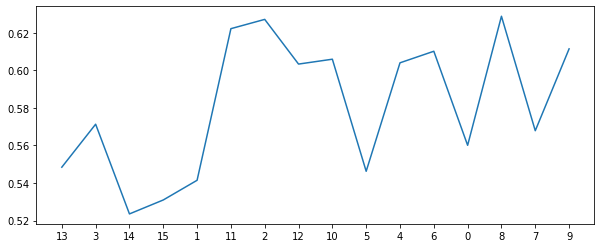

753
all features [13, 3, 14, 2, 11, 15, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 2, 11, 15, 1, 10, 12]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.6
specificity  0.5937405731523379
sensitivity  0.695
auc          0.6443702865761689


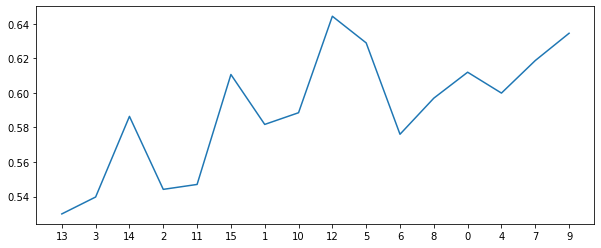

754
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.5956636500754148
sensitivity  0.67
auc          0.6328318250377074


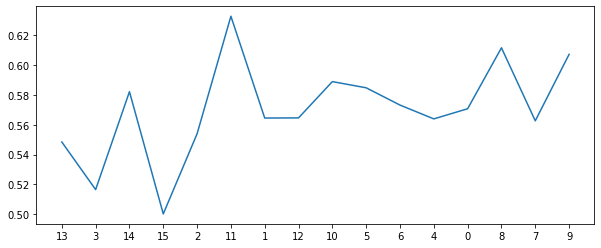

755
all features [13, 3, 2, 15, 14, 11, 1, 10, 12, 5, 6, 0, 8, 9, 4, 7, 16]
new features [13, 3, 2, 15, 14, 11, 1, 10, 12, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5648567119155354
sensitivity  0.69
auc          0.6274283559577677


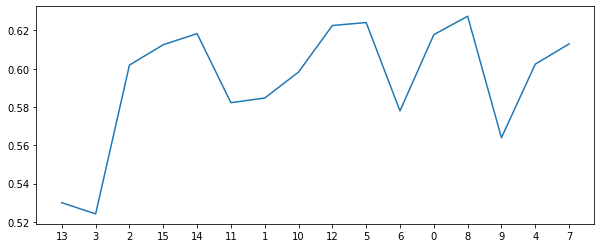

756
all features [3, 13, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.7053571428571429
specificity  0.7207390648567119
sensitivity  0.515
auc          0.617869532428356


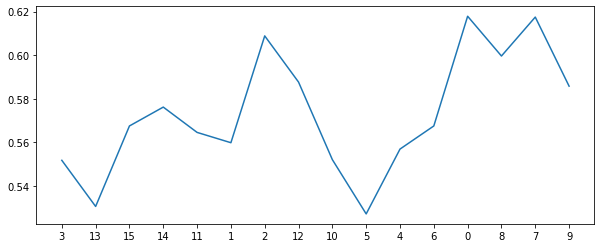

757
all features [13, 15, 14, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 15, 14, 3, 11, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6995475113122172
sensitivity  0.515
auc          0.6072737556561086


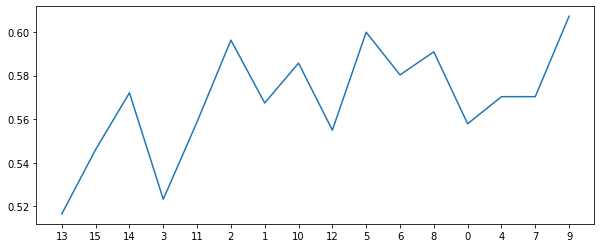

758
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.6976621417797888
sensitivity  0.565
auc          0.6313310708898944


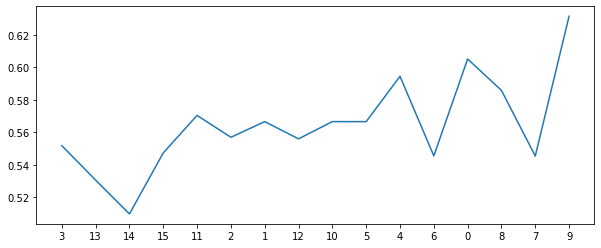

759
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6875
specificity  0.6957390648567119
sensitivity  0.585
auc          0.6403695324283559


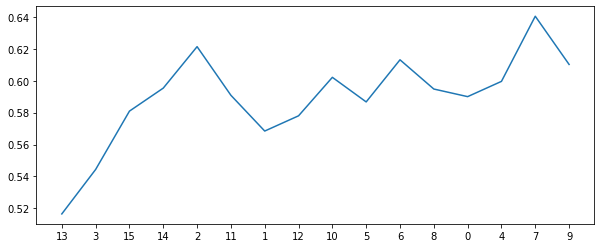

760
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6875
specificity  0.6995852187028657
sensitivity  0.545
auc          0.6222926093514328


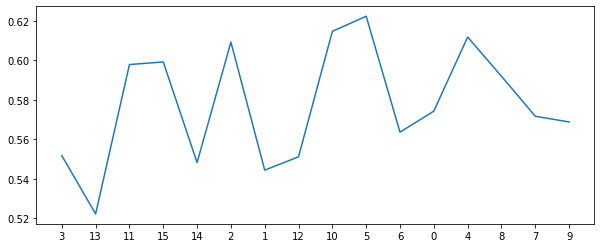

761
all features [13, 3, 11, 2, 15, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 2, 15, 14, 1, 10, 12, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 0.5, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.7017857142857142
specificity  0.7090874811463047
sensitivity  0.615
auc          0.6620437405731523


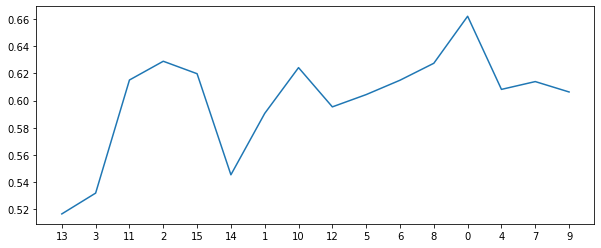

762
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6650829562594268
sensitivity  0.595
auc          0.6300414781297135


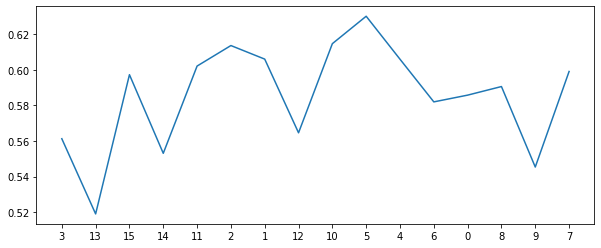

763
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6360105580693816
sensitivity  0.645
auc          0.6405052790346908


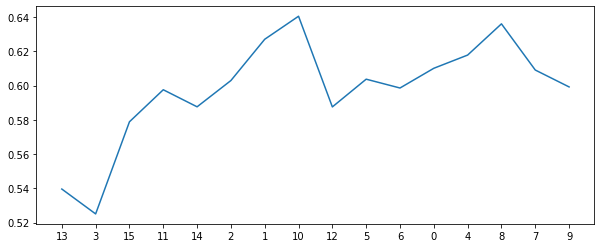

764
all features [13, 3, 15, 11, 14, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.625
specificity  0.6243212669683258
sensitivity  0.645
auc          0.6346606334841629


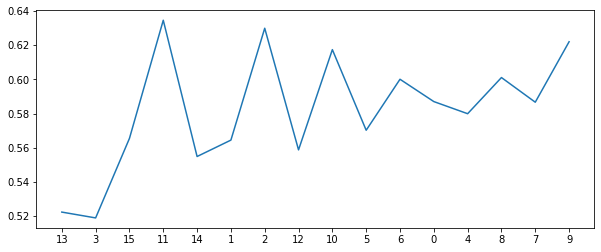

765
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.61289592760181
sensitivity  0.71
auc          0.661447963800905


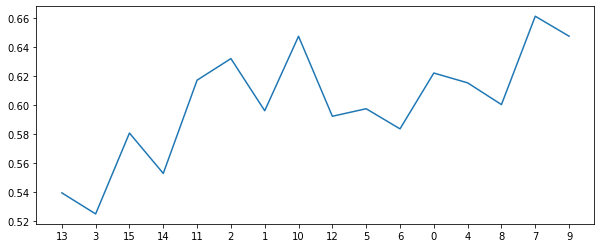

766
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6900452488687783
sensitivity  0.57
auc          0.6300226244343892


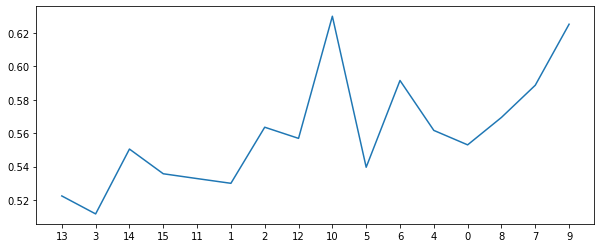

767
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6475490196078432
sensitivity  0.645
auc          0.6462745098039215


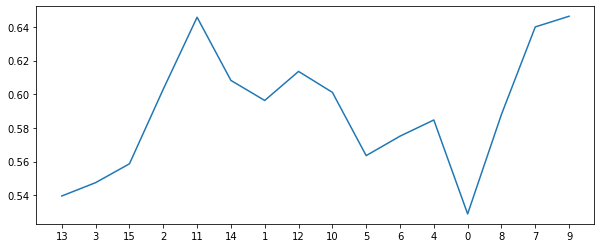

768
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6071644042232277
sensitivity  0.645
auc          0.6260822021116139


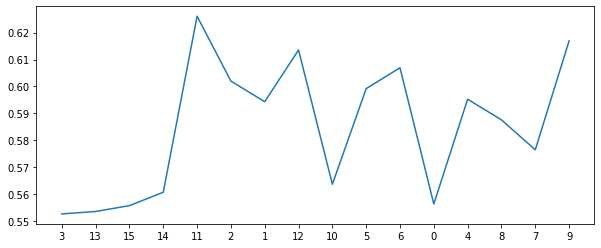

769
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5375
specificity  0.5183257918552037
sensitivity  0.785
auc          0.6516628959276018


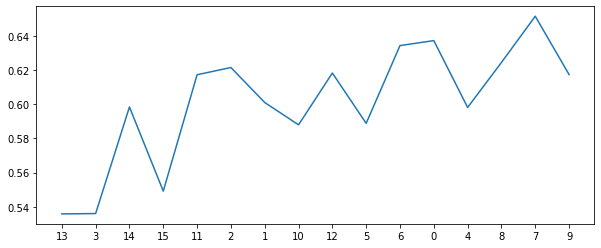

770
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6148567119155355
sensitivity  0.665
auc          0.6399283559577678


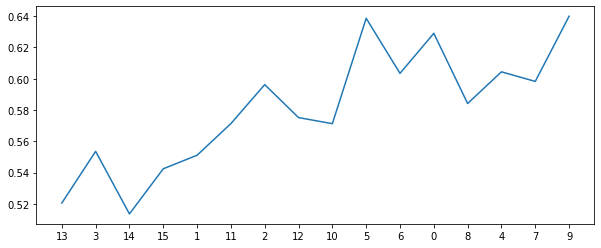

771
all features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 11, 2, 15, 14, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6214285714285714
specificity  0.6187028657616893
sensitivity  0.665
auc          0.6418514328808446


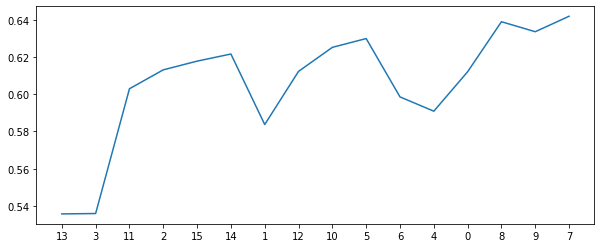

772
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6149698340874812
sensitivity  0.64
auc          0.6274849170437405


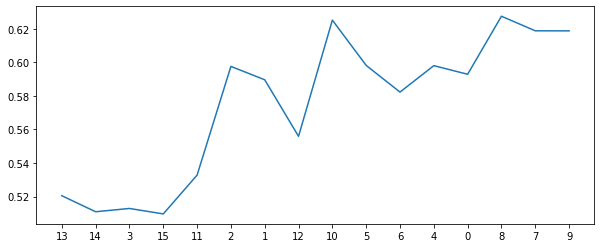

773
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5936651583710407
sensitivity  0.685
auc          0.6393325791855203


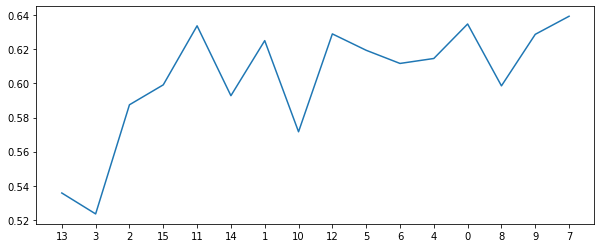

774
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6649698340874811
sensitivity  0.585
auc          0.6249849170437406


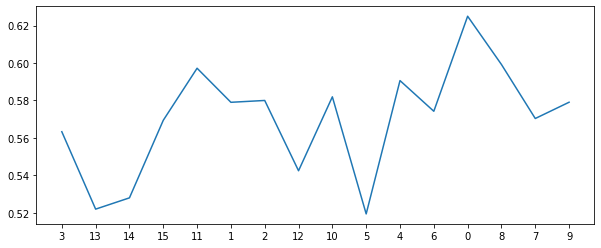

775
all features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 14, 2, 15, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6553544494720965
sensitivity  0.62
auc          0.6376772247360483


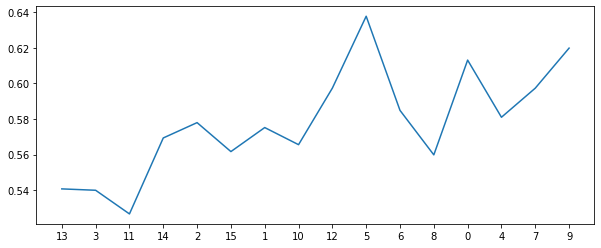

776
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.7160714285714286
specificity  0.7285444947209653
sensitivity  0.57
auc          0.6492722473604826


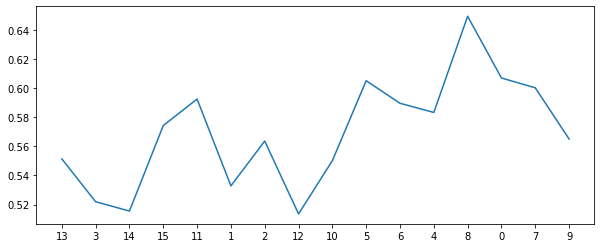

777
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6900075414781297
sensitivity  0.54
auc          0.6150037707390649


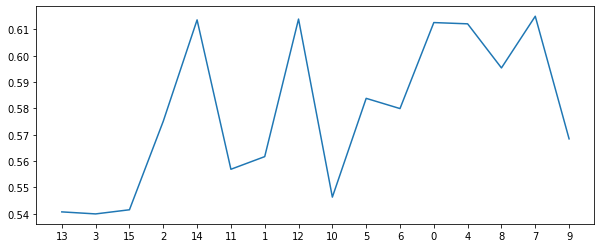

778
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7053571428571429
specificity  0.7207767722473605
sensitivity  0.52
auc          0.6203883861236803


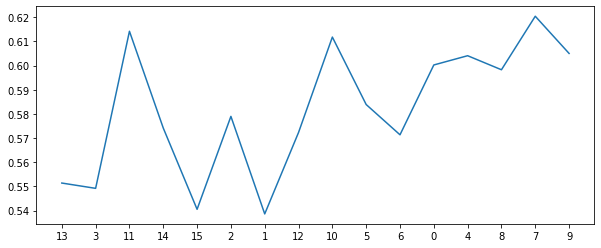

779
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6630090497737556
sensitivity  0.57
auc          0.6165045248868778


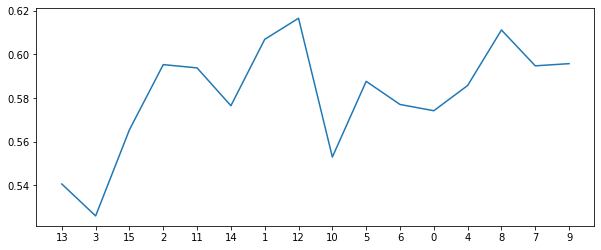

780
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6476621417797889
sensitivity  0.59
auc          0.6188310708898944


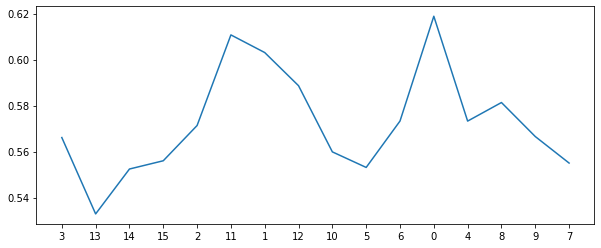

781
all features [13, 15, 3, 14, 2, 1, 11, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 3, 14, 2, 1, 11, 10, 12, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5858974358974359
sensitivity  0.66
auc          0.622948717948718


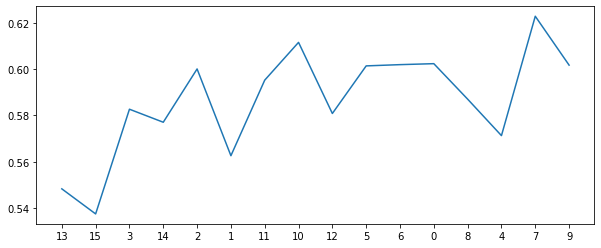

782
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.6668552036199095
sensitivity  0.59
auc          0.6284276018099548


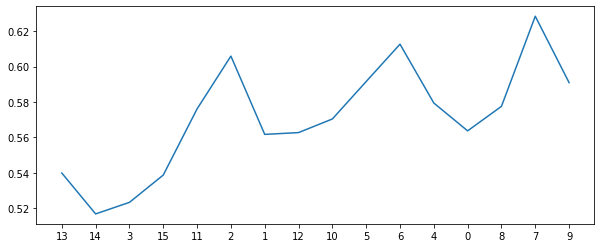

783
all features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.616817496229261
sensitivity  0.71
auc          0.6634087481146305


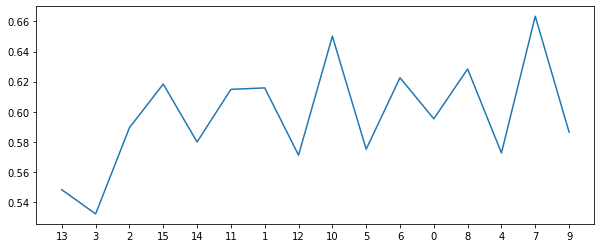

784
all features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6725867269984918
sensitivity  0.595
auc          0.6337933634992459


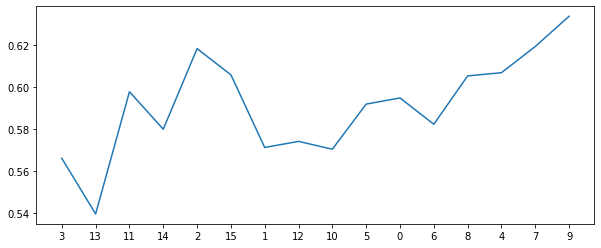

785
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 11, 2, 14]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6052413273001508
sensitivity  0.64
auc          0.6226206636500754


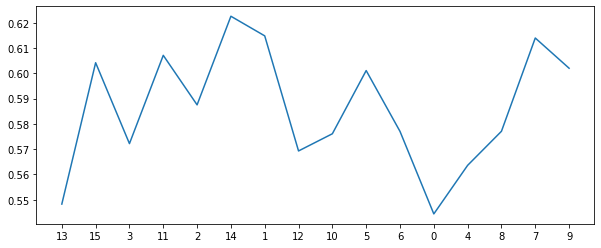

786
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5375
specificity  0.5244343891402715
sensitivity  0.72
auc          0.6222171945701358


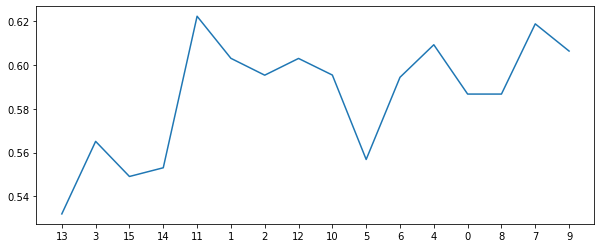

787
all features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5763574660633485
sensitivity  0.69
auc          0.6331787330316742


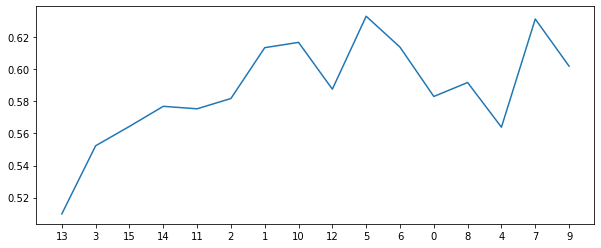

788
all features [14, 13, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 11, 15, 1, 2]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5898567119155355
sensitivity  0.67
auc          0.6299283559577677


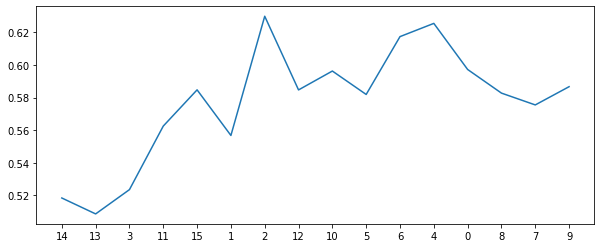

789
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5875
specificity  0.5780542986425339
sensitivity  0.71
auc          0.644027149321267


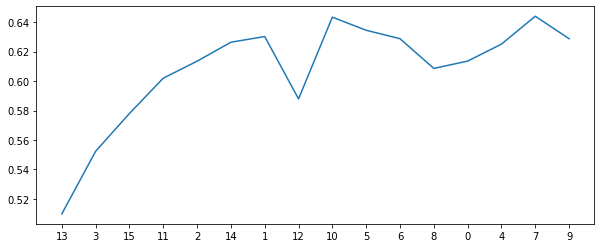

790
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6375000000000001
specificity  0.6435143288084464
sensitivity  0.57
auc          0.6067571644042232


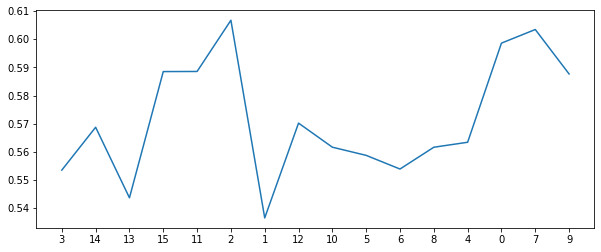

791
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 2, 0.5, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5937028657616893
sensitivity  0.735
auc          0.6643514328808446


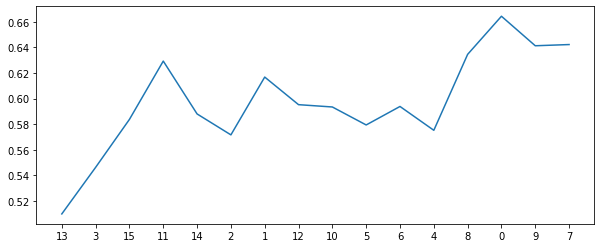

792
all features [3, 13, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7015460030165912
sensitivity  0.54
auc          0.6207730015082956


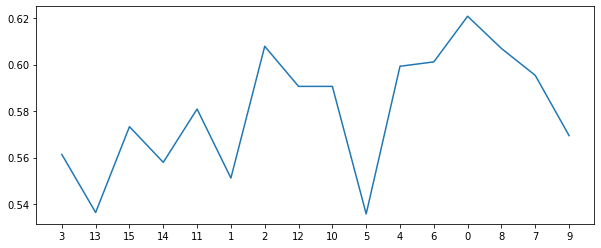

793
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6533559577677225
sensitivity  0.64
auc          0.6466779788838612


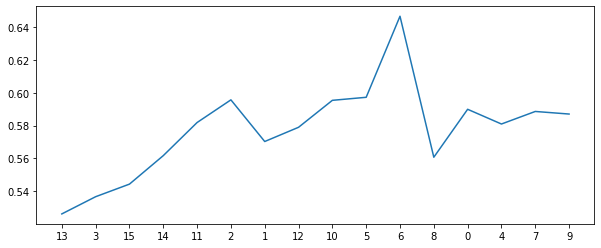

794
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7015082956259426
sensitivity  0.54
auc          0.6207541478129713


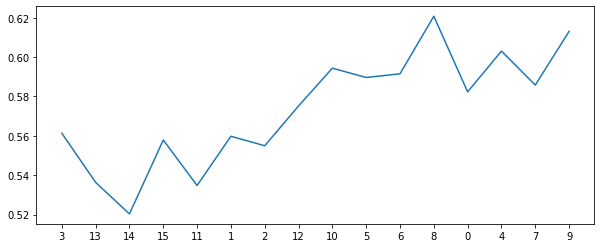

795
all features [13, 3, 2, 11, 14, 15, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 2, 11, 14, 15, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6918174962292609
sensitivity  0.62
auc          0.6559087481146305


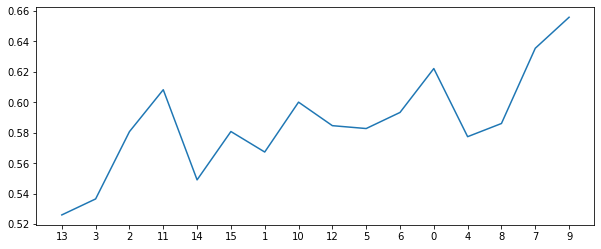

796
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6749999999999999
specificity  0.6861236802413273
sensitivity  0.545
auc          0.6155618401206636


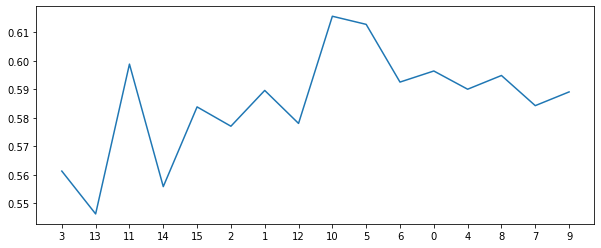

797
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 4]
[0.4, 2, 1000, 2, 0.5, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.675
specificity  0.6783936651583711
sensitivity  0.64
auc          0.6591968325791855


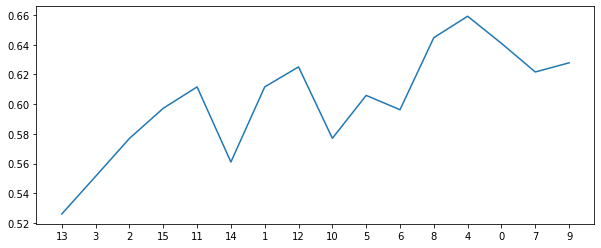

798
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6091628959276019
sensitivity  0.665
auc          0.6370814479638008


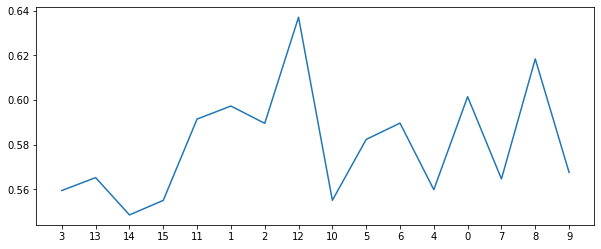

799
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6187405731523379
sensitivity  0.695
auc          0.656870286576169


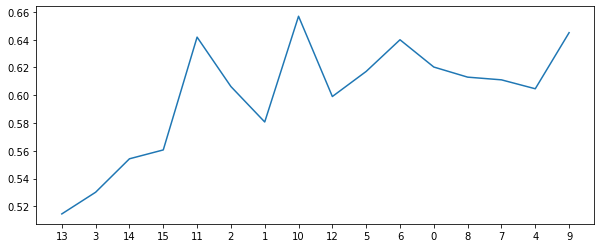

800
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6187405731523379
sensitivity  0.615
auc          0.6168702865761689


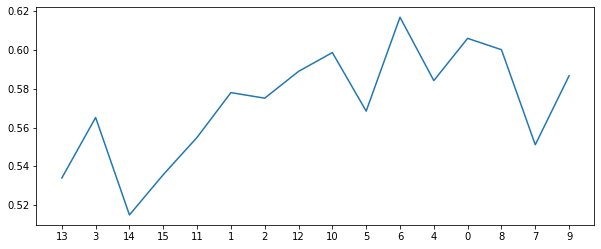

801
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6226621417797888
sensitivity  0.715
auc          0.6688310708898945


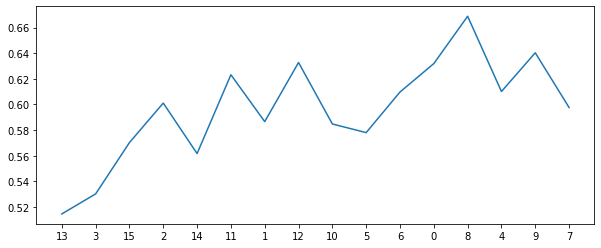

802
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6457013574660634
sensitivity  0.615
auc          0.6303506787330316


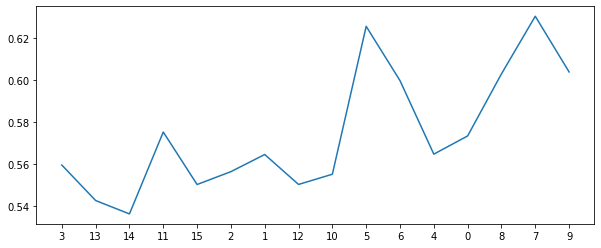

803
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 2, 0.5, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5723981900452488
sensitivity  0.67
auc          0.6211990950226245


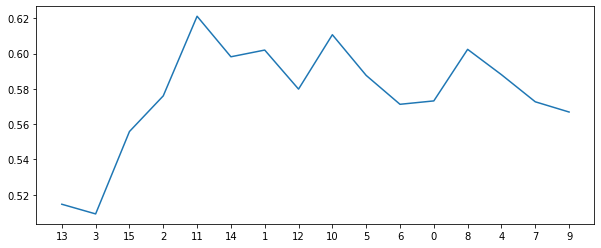

804
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6130090497737556
sensitivity  0.69
auc          0.6515045248868778


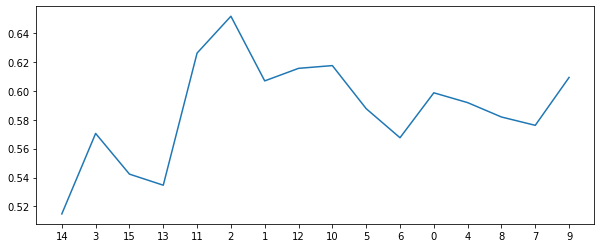

805
all features [13, 14, 3, 15, 11, 2, 1, 10, 12, 6, 5, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 10, 12, 6, 5, 0, 4, 8]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5705882352941176
sensitivity  0.71
auc          0.6402941176470588


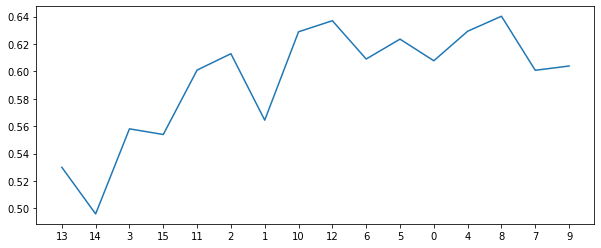

806
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6090874811463047
sensitivity  0.64
auc          0.6245437405731523


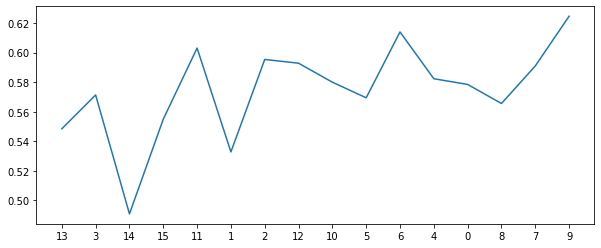

807
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 6, 5, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 6, 5, 0, 8, 4]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6013197586726998
sensitivity  0.72
auc          0.66065987933635


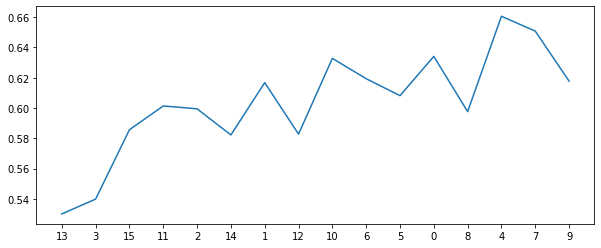

808
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6167797888386124
sensitivity  0.62
auc          0.6183898944193061


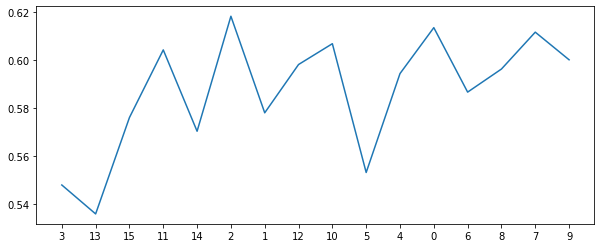

809
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 0.5, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5840497737556561
sensitivity  0.735
auc          0.6595248868778281


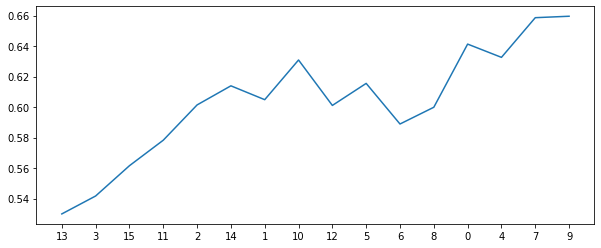

810
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6678571428571429
specificity  0.6765460030165913
sensitivity  0.57
auc          0.6232730015082957


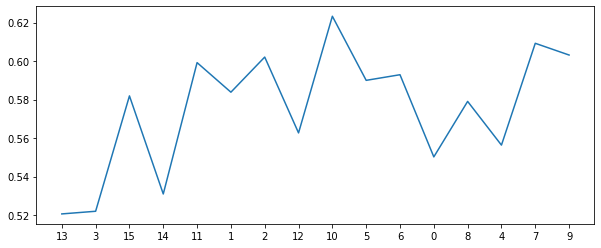

811
all features [13, 3, 2, 14, 15, 1, 11, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 14, 15, 1, 11, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6648190045248868
sensitivity  0.66
auc          0.6624095022624434


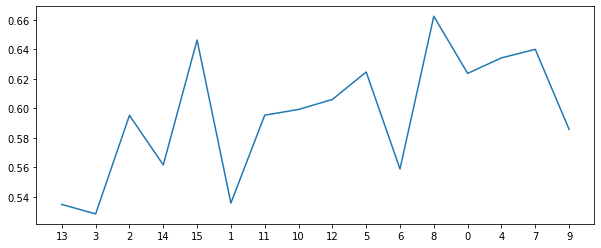

812
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6696428571428572
specificity  0.6744343891402715
sensitivity  0.615
auc          0.6447171945701358


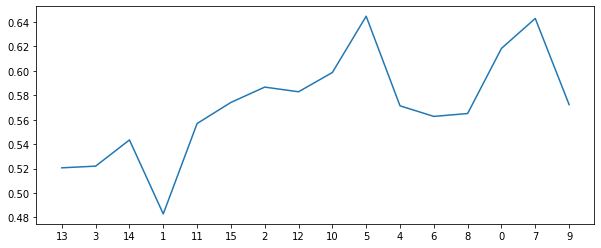

813
all features [3, 13, 2, 11, 15, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 2, 11, 15]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.625
specificity  0.6225113122171946
sensitivity  0.665
auc          0.6437556561085973


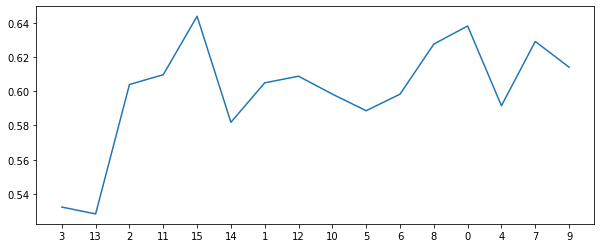

814
all features [3, 13, 11, 15, 1, 14, 2, 10, 12, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 1, 14, 2, 10, 12]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6900075414781297
sensitivity  0.545
auc          0.6175037707390648


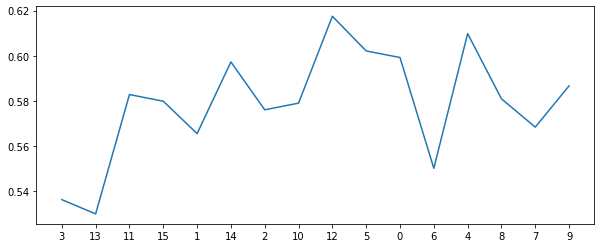

815
all features [13, 3, 2, 14, 15, 11, 1, 12, 10, 6, 5, 0, 8, 7, 4, 9, 16]
new features [13, 3, 2, 14, 15, 11, 1, 12, 10, 6, 5, 0, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6552413273001508
sensitivity  0.615
auc          0.6351206636500755


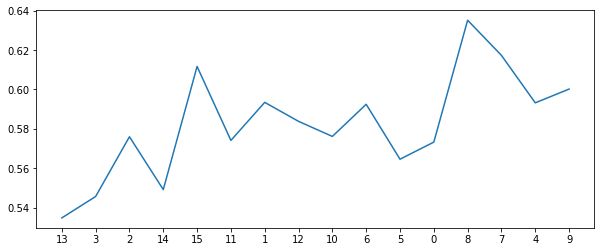

816
all features [13, 3, 1, 2, 14, 15, 12, 11, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 1, 2, 14, 15]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6090874811463047
sensitivity  0.67
auc          0.6395437405731523


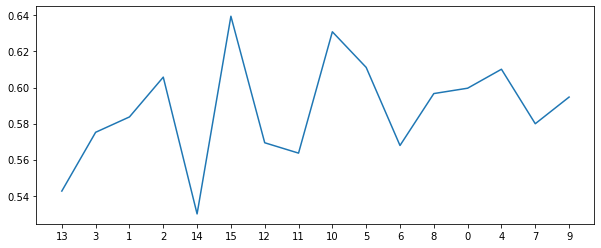

817
all features [13, 15, 14, 3, 2, 11, 1, 10, 12, 5, 8, 4, 6, 7, 0, 9, 16]
new features [13, 15, 14, 3, 2, 11]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5714285714285714
specificity  0.5590497737556561
sensitivity  0.74
auc          0.6495248868778281


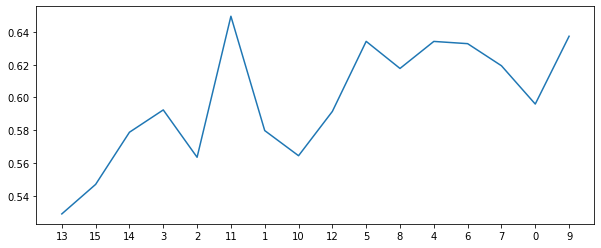

818
all features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 4, 6, 8, 0, 9, 7, 16]
new features [13, 3, 14, 15, 2, 1, 11, 12]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6109351432880845
sensitivity  0.665
auc          0.6379675716440423


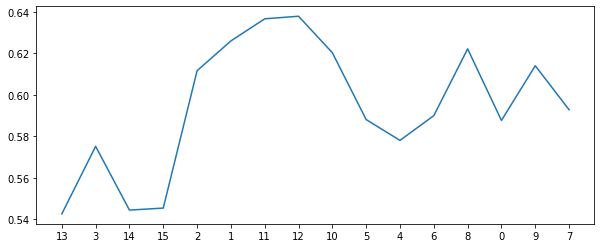

819
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 8, 6, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.589894419306184
sensitivity  0.685
auc          0.637447209653092


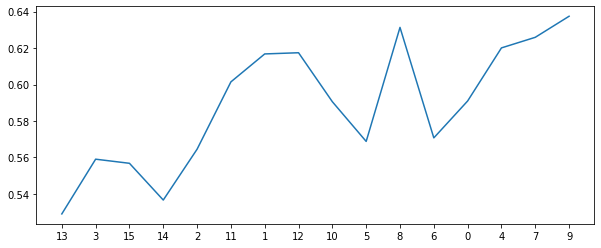

820
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [13, 3, 15, 14, 11, 1]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6375
specificity  0.6418552036199094
sensitivity  0.595
auc          0.6184276018099548


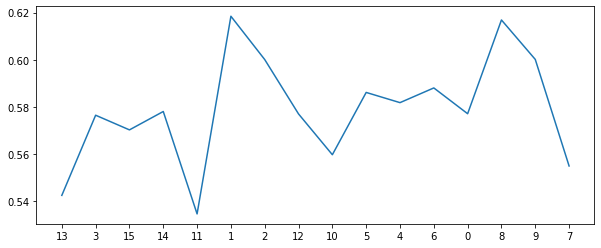

821
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 6, 5, 8, 0, 7, 9, 4, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10, 6, 5, 8, 0, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6125
specificity  0.6052036199095022
sensitivity  0.715
auc          0.6601018099547511


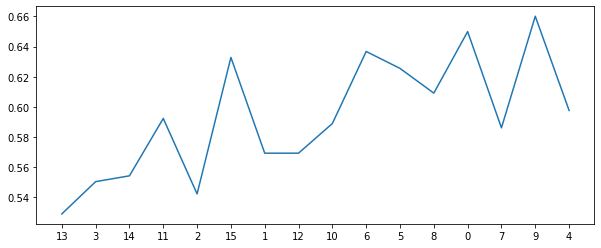

822
all features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 6]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6072775263951734
sensitivity  0.685
auc          0.6461387631975867


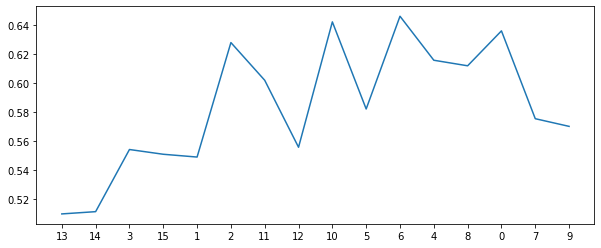

823
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 8, 4, 9, 0, 7, 16]
new features [13, 14, 15, 3, 2, 11, 1]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.48928571428571427
specificity  0.46647812971342384
sensitivity  0.79
auc          0.6282390648567119


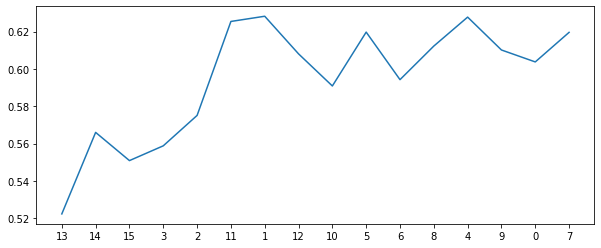

824
all features [14, 13, 3, 2, 11, 15, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 2, 11, 15, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6092006033182503
sensitivity  0.71
auc          0.6596003016591252


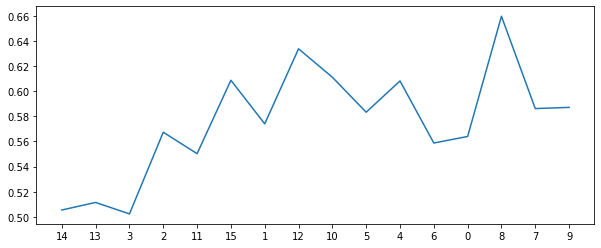

825
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5375
specificity  0.520475113122172
sensitivity  0.765
auc          0.642737556561086


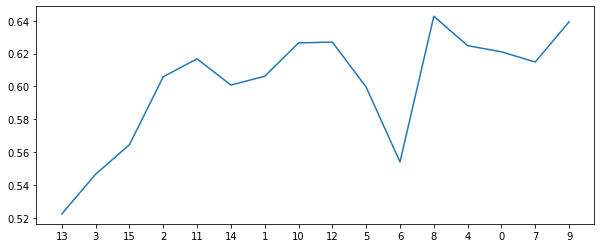

826
all features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5898190045248869
sensitivity  0.665
auc          0.6274095022624434


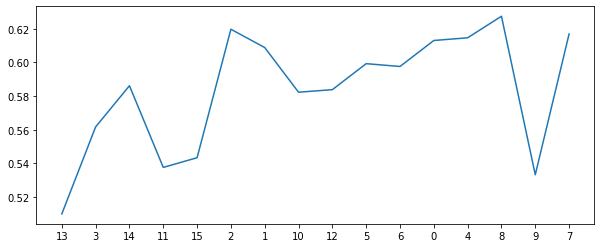

827
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 6, 5, 4, 8, 7, 0, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 6, 5, 4, 8, 7, 0]
[0.4, 2, 1000, 2, 1, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5531297134238311
sensitivity  0.76
auc          0.6565648567119156


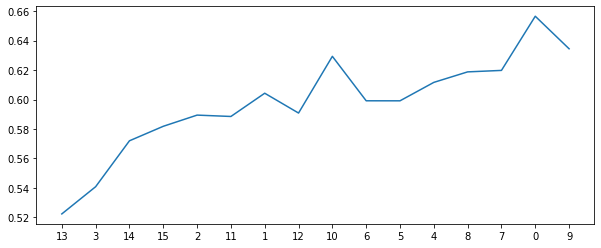

828
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6687405731523378
sensitivity  0.545
auc          0.6068702865761689


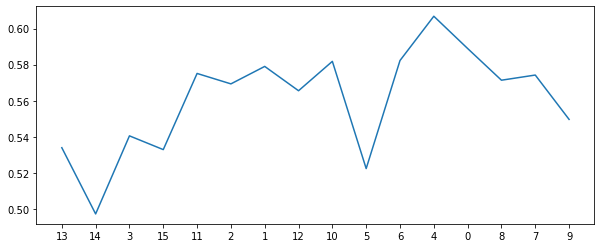

829
all features [14, 13, 15, 3, 2, 11, 1, 10, 12, 5, 8, 0, 4, 6, 7, 9, 16]
new features [14, 13, 15, 3, 2, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.6611236802413273
sensitivity  0.59
auc          0.6255618401206637


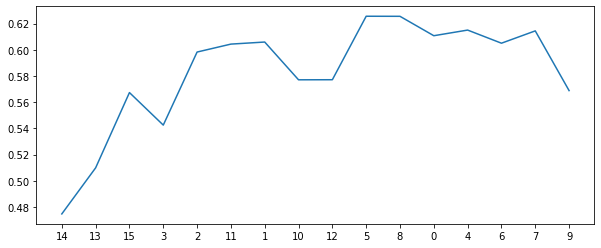

830
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 6, 5, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 1, 2, 11, 12, 10, 6, 5, 4, 8, 0, 7]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.7
specificity  0.7074283559577678
sensitivity  0.615
auc          0.6612141779788838


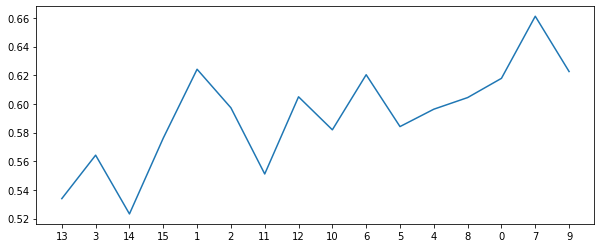

831
all features [13, 3, 14, 15, 2, 11, 1, 10, 12, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 10, 12, 5, 8, 6, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6649698340874811
sensitivity  0.71
auc          0.6874849170437406


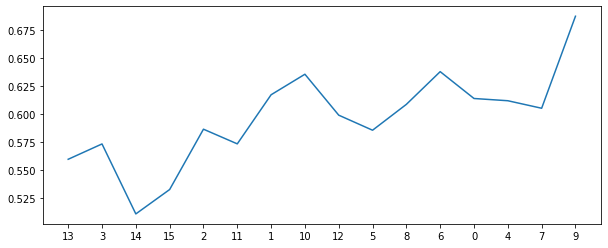

832
all features [13, 3, 15, 1, 14, 2, 11, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 1]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6379336349924585
sensitivity  0.595
auc          0.6164668174962292


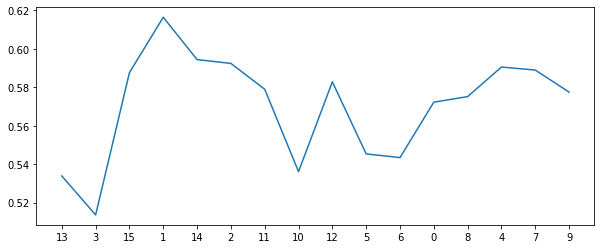

833
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 8, 6, 0]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6591628959276018
sensitivity  0.66
auc          0.6595814479638009


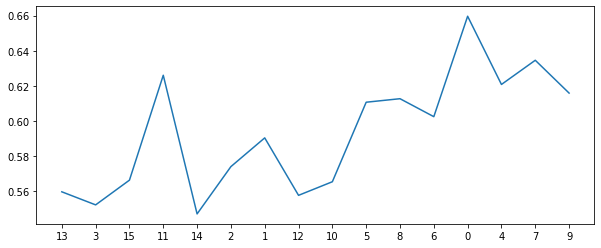

834
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 1, 2]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.5803571428571429
specificity  0.5706636500754148
sensitivity  0.72
auc          0.6453318250377074


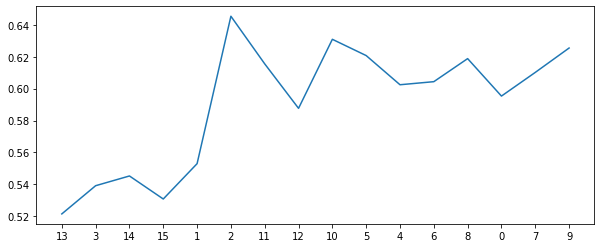

835
all features [13, 14, 3, 15, 2, 1, 11, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 10, 12, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5782051282051281
sensitivity  0.685
auc          0.6316025641025641


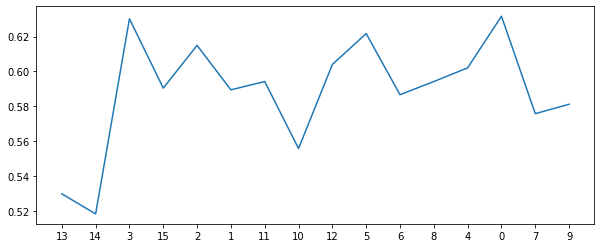

836
all features [13, 3, 15, 14, 1, 2, 11, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 15, 14, 1, 2, 11, 12, 10, 5, 4, 0, 6, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6341628959276018
sensitivity  0.665
auc          0.6495814479638009


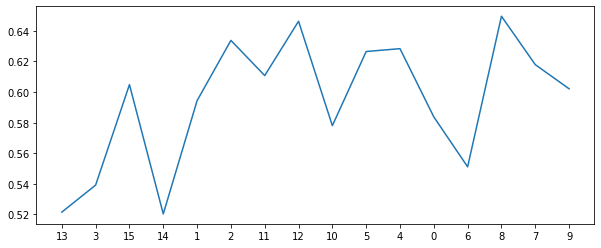

837
all features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6052413273001508
sensitivity  0.695
auc          0.6501206636500754


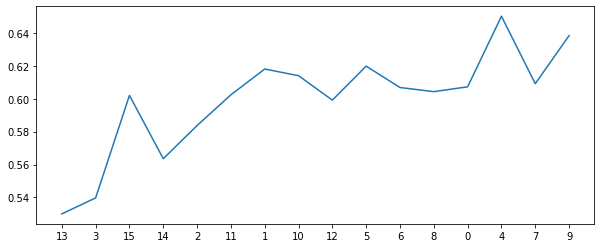

838
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 0]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6495475113122172
sensitivity  0.64
auc          0.6447737556561086


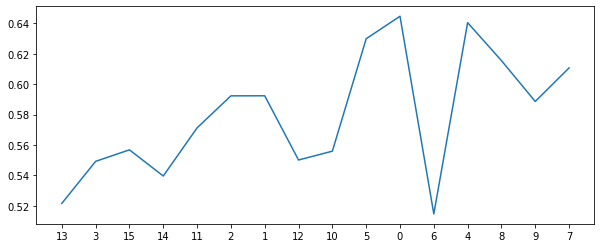

839
all features [13, 3, 2, 11, 14, 15, 1, 10, 12, 6, 5, 4, 8, 0, 9, 7, 16]
new features [13, 3, 2, 11, 14, 15, 1, 10, 12, 6, 5, 4, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.625
specificity  0.6206636500754148
sensitivity  0.685
auc          0.6528318250377074


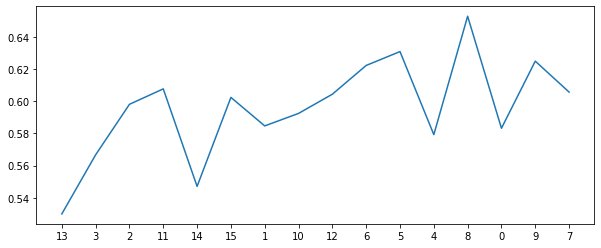

840
all features [13, 3, 14, 1, 15, 2, 12, 11, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 1, 15, 2, 12, 11, 10]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5785714285714285
specificity  0.5706259426847662
sensitivity  0.695
auc          0.6328129713423831


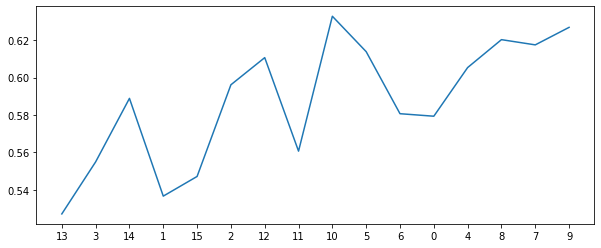

841
all features [14, 13, 3, 15, 2, 11, 1, 10, 12, 5, 6, 8, 4, 7, 9, 0, 16]
new features [14, 13, 3, 15, 2, 11, 1, 10, 12, 5, 6, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.55
specificity  0.5340120663650075
sensitivity  0.76
auc          0.6470060331825038


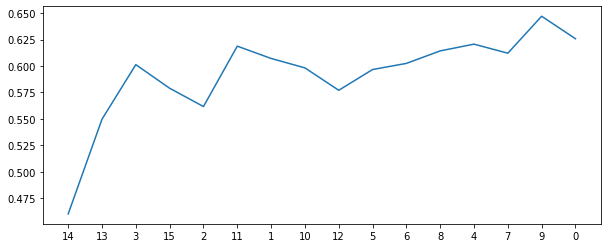

842
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 4, 8, 0, 6, 7, 9, 16]
new features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 4, 8, 0, 6, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5840120663650076
sensitivity  0.69
auc          0.6370060331825038


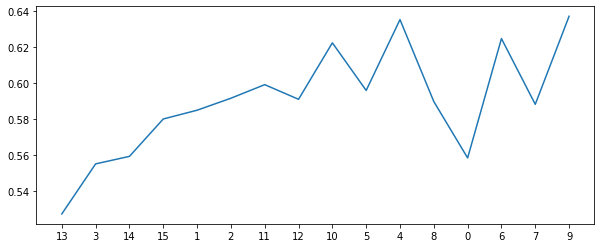

843
all features [3, 13, 15, 14, 2, 11, 1, 10, 12, 5, 8, 6, 7, 4, 0, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 10, 12, 5, 8, 6, 7, 4, 0]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5535714285714286
specificity  0.5378959276018099
sensitivity  0.76
auc          0.648947963800905


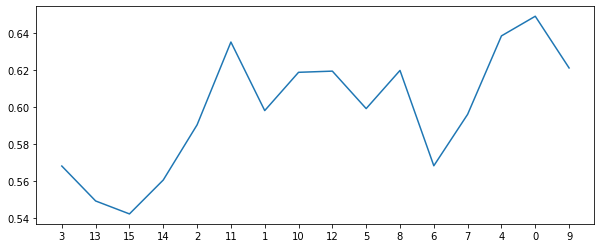

844
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5570512820512821
sensitivity  0.715
auc          0.6360256410256411


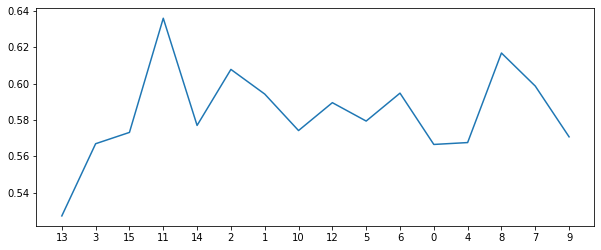

845
all features [13, 3, 15, 11, 2, 14, 12, 1, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 12, 1, 10, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5494343891402715
sensitivity  0.765
auc          0.6572171945701357


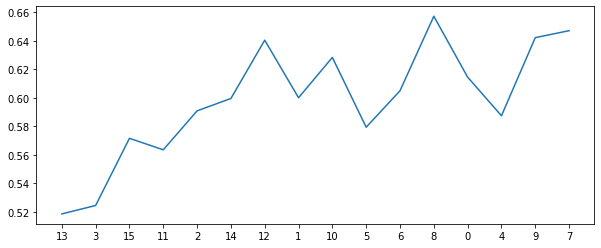

846
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.675
specificity  0.6880467571644042
sensitivity  0.515
auc          0.6015233785822021


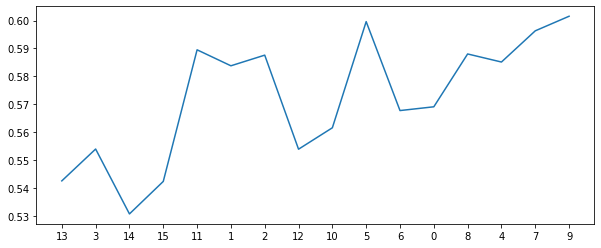

847
all features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 8, 6]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6321644042232277
sensitivity  0.615
auc          0.6235822021116139


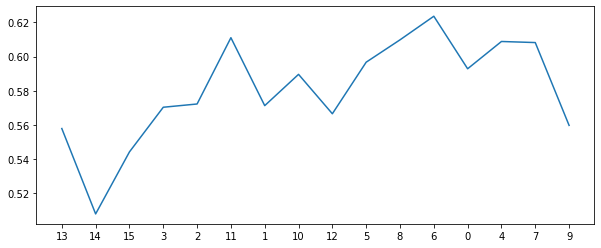

848
all features [3, 13, 14, 1, 15, 11, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 14, 1, 15, 11, 2, 12, 10, 5, 4, 6, 8, 0, 7]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.6976621417797888
sensitivity  0.57
auc          0.6338310708898944


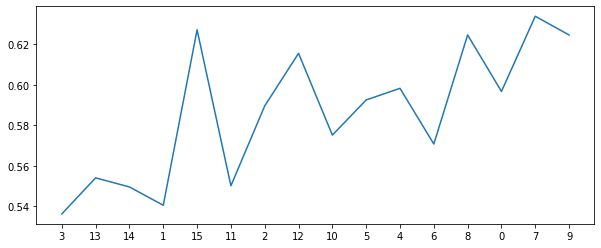

849
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 11, 15, 14, 2]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6302413273001508
sensitivity  0.69
auc          0.6601206636500754


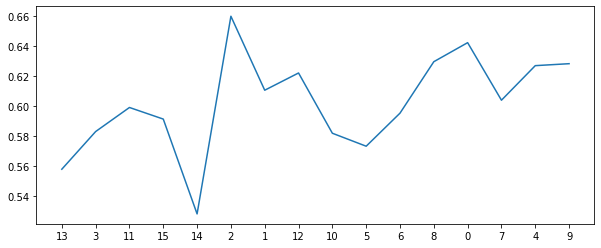

850
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6495098039215687
sensitivity  0.595
auc          0.6222549019607843


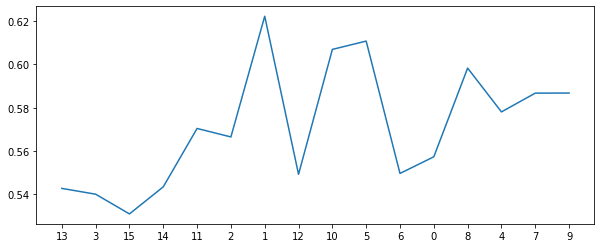

851
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6552413273001508
sensitivity  0.685
auc          0.6701206636500754


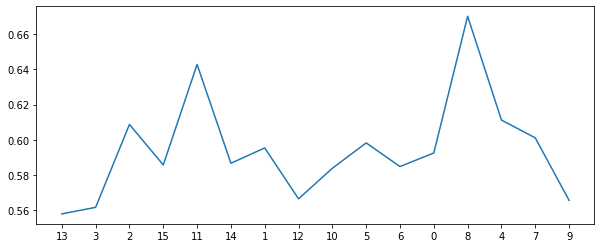

852
all features [13, 3, 14, 1, 15, 2, 11, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 3, 14, 1, 15, 2, 11, 12, 10, 5, 8, 4, 6]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6052413273001508
sensitivity  0.69
auc          0.6476206636500754


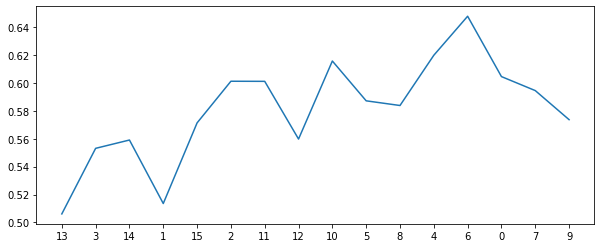

853
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 8]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5339285714285714
specificity  0.5147812971342384
sensitivity  0.785
auc          0.6498906485671192


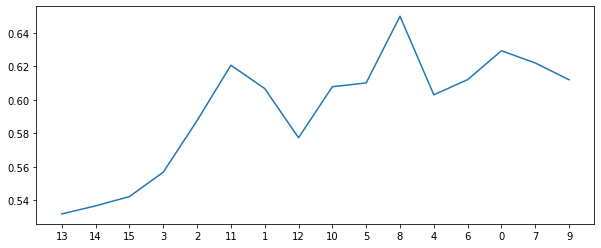

854
all features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.618815987933635
sensitivity  0.67
auc          0.6444079939668175


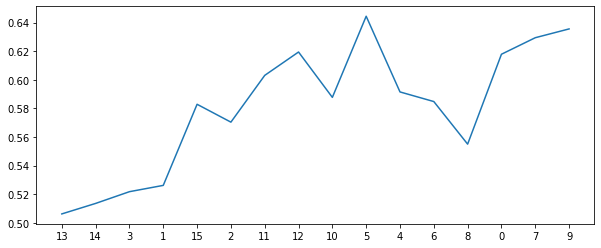

855
all features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 8, 7, 0, 4, 9, 16]
new features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5801659125188537
sensitivity  0.715
auc          0.6475829562594269


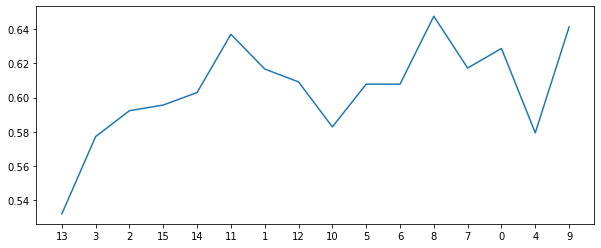

856
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 0, 6, 8, 4]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6107142857142857
specificity  0.6052790346907994
sensitivity  0.685
auc          0.6451395173453998


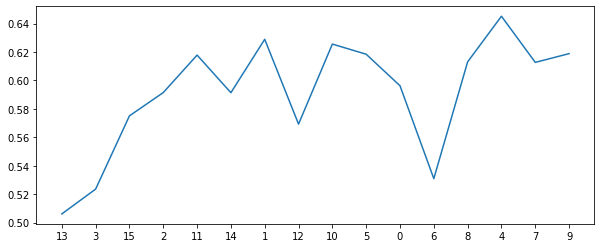

857
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 1, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.5975113122171946
sensitivity  0.71
auc          0.6537556561085973


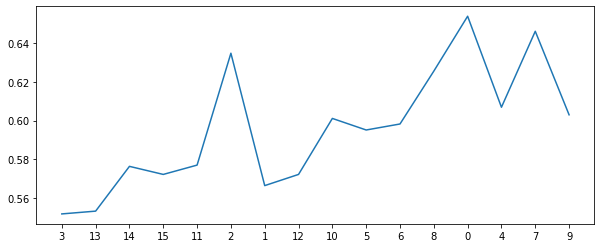

858
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5517857142857143
specificity  0.533974358974359
sensitivity  0.79
auc          0.6619871794871794


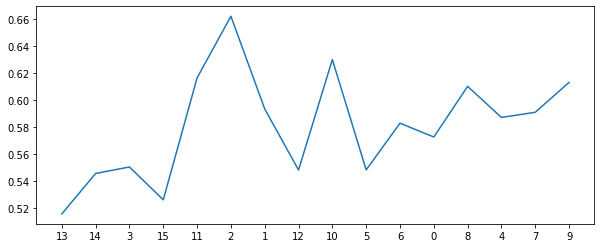

859
all features [13, 14, 15, 3, 2, 11, 1, 10, 12, 5, 6, 4, 8, 9, 0, 7, 16]
new features [13, 14, 15, 3, 2, 11]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.4732142857142857
specificity  0.443552036199095
sensitivity  0.865
auc          0.6542760180995475


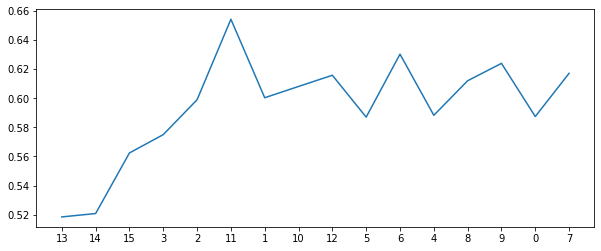

860
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5589285714285714
specificity  0.5476244343891403
sensitivity  0.72
auc          0.6338122171945701


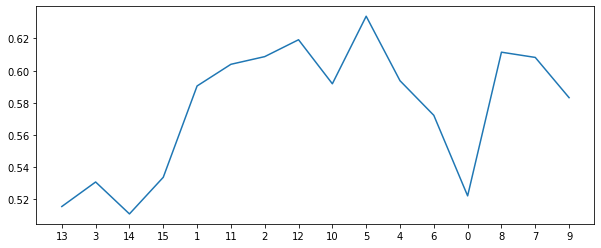

861
all features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.5475113122171946
sensitivity  0.81
auc          0.6787556561085972


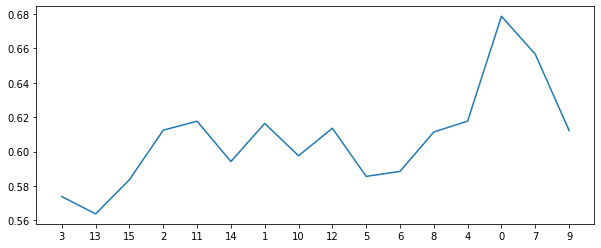

862
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5803571428571429
specificity  0.5722850678733031
sensitivity  0.695
auc          0.6336425339366516


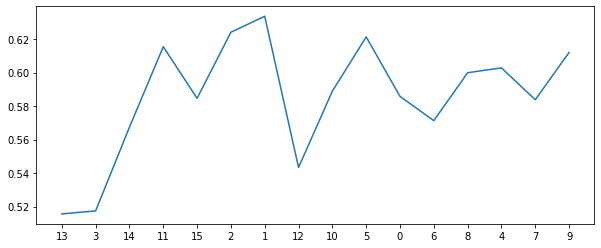

863
all features [13, 3, 14, 15, 2, 11, 12, 1, 10, 5, 6, 0, 8, 9, 7, 4, 16]
new features [13, 3, 14, 15, 2, 11, 12]
[0.4, 2, 1000, 2, 1, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.549396681749623
sensitivity  0.765
auc          0.6571983408748114


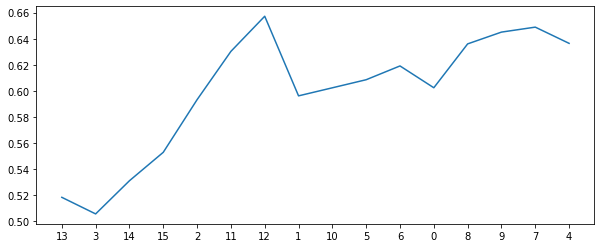

864
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6398190045248868
sensitivity  0.595
auc          0.6174095022624434


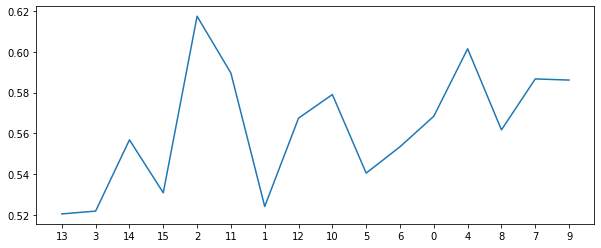

865
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 2]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.625
specificity  0.6225867269984917
sensitivity  0.67
auc          0.6462933634992458


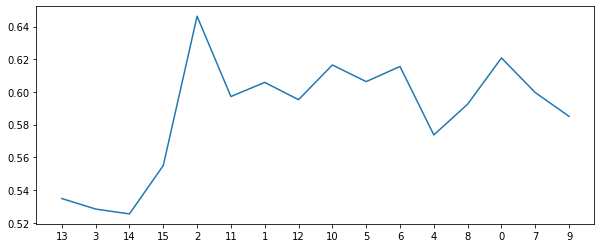

866
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.676395173453997
sensitivity  0.57
auc          0.6231975867269985


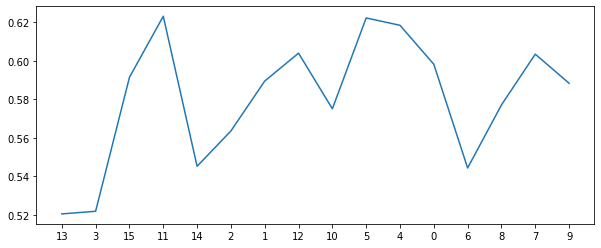

867
all features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6552790346907994
sensitivity  0.61
auc          0.6326395173453997


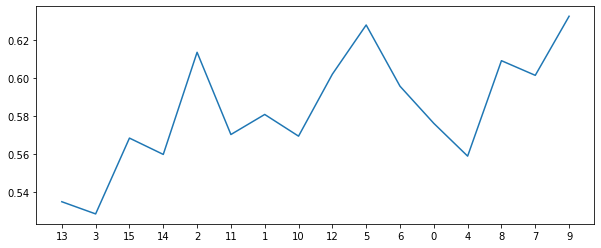

868
all features [13, 15, 11, 3, 14, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 15, 11, 3, 14, 1, 2, 12, 10, 5, 0, 4, 6]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6899698340874811
sensitivity  0.57
auc          0.6299849170437406


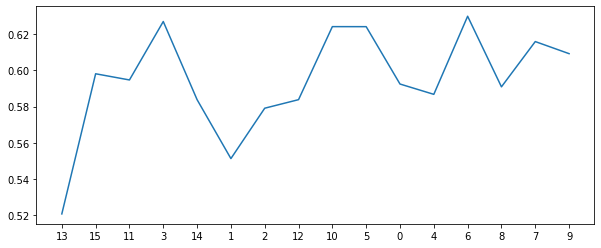

869
all features [13, 3, 15, 2, 14, 11, 12, 1, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 12, 1, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6841251885369533
sensitivity  0.585
auc          0.6345625942684766


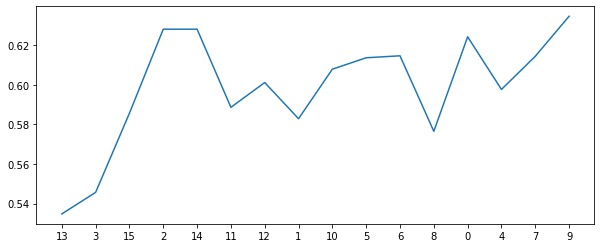

870
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5785714285714286
specificity  0.5705882352941176
sensitivity  0.695
auc          0.6327941176470588


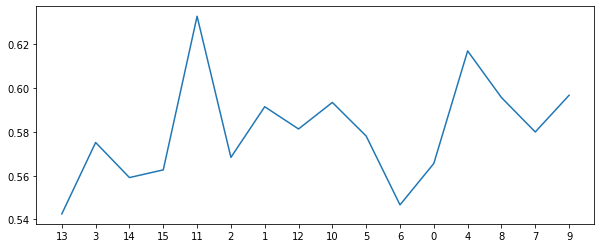

871
all features [13, 14, 2, 11, 3, 15, 1, 12, 10, 5, 6, 8, 4, 7, 0, 9, 16]
new features [13, 14, 2, 11, 3, 15, 1]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6168552036199095
sensitivity  0.72
auc          0.6684276018099548


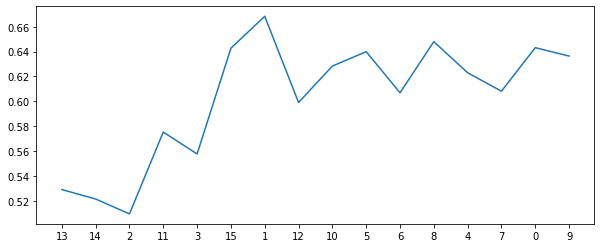

872
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 8, 0, 6, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 8, 0, 6, 7, 9]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.65
specificity  0.655316742081448
sensitivity  0.59
auc          0.622658371040724


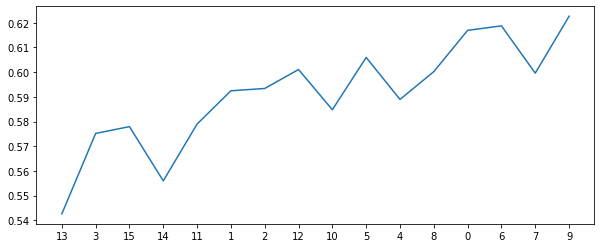

873
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 6, 5, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 10, 12, 6, 5, 8, 0, 7, 4]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.6031674208144796
sensitivity  0.66
auc          0.6315837104072398


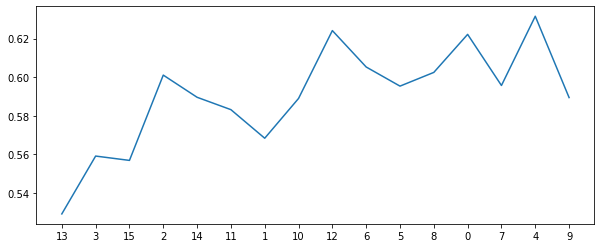

874
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714285
specificity  0.643815987933635
sensitivity  0.62
auc          0.6319079939668175


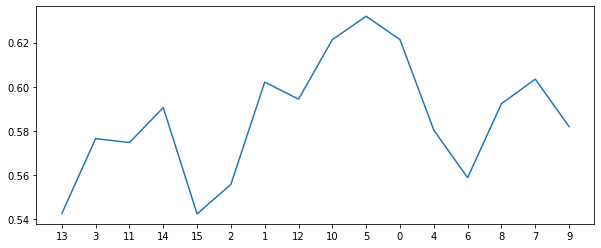

875
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 2, 1, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5608974358974359
sensitivity  0.815
auc          0.6879487179487179


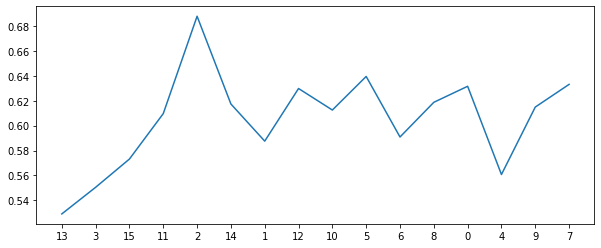

876
all features [14, 3, 13, 2, 11, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [14, 3, 13, 2, 11, 15, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.578318250377074
sensitivity  0.69
auc          0.634159125188537


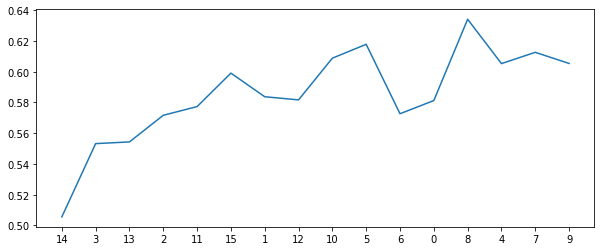

877
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5684766214177979
sensitivity  0.765
auc          0.6667383107088989


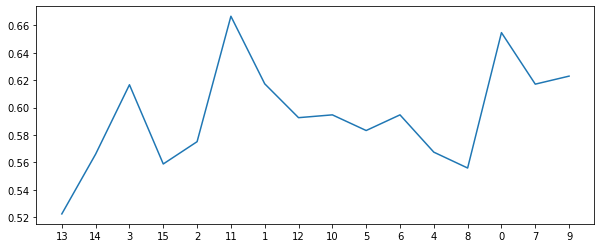

878
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6168929110105581
sensitivity  0.67
auc          0.643446455505279


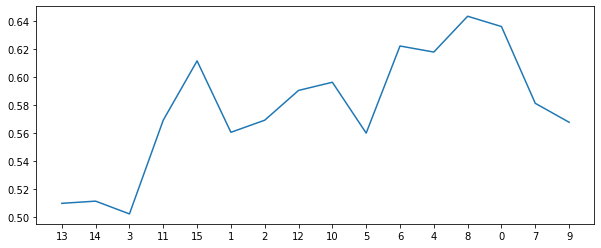

879
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 7, 0, 4, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 7, 0, 4]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5705128205128205
sensitivity  0.71
auc          0.6402564102564103


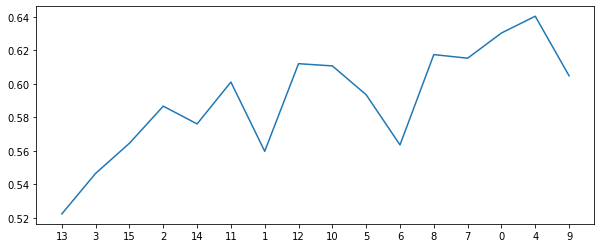

880
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6226621417797888
sensitivity  0.64
auc          0.6313310708898944


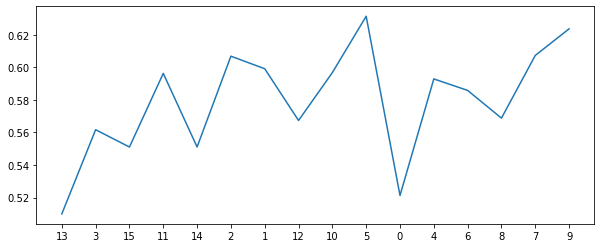

881
all features [3, 13, 2, 15, 11, 14, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 2, 15, 11, 14, 1, 10, 12, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 1, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5762443438914027
sensitivity  0.76
auc          0.6681221719457013


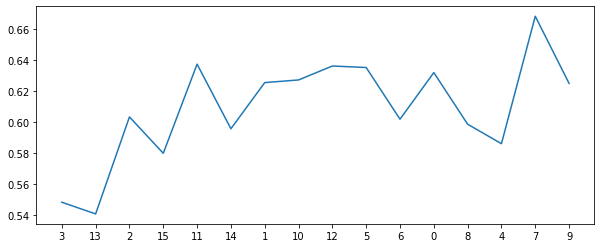

882
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6938914027149321
sensitivity  0.56
auc          0.6269457013574661


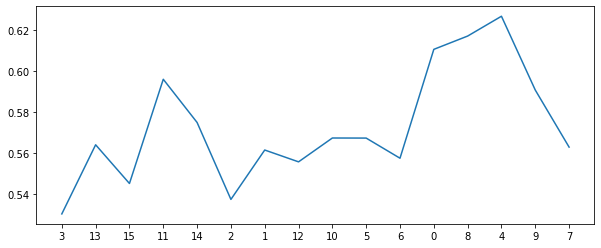

883
all features [13, 14, 2, 15, 3, 11, 1, 12, 5, 10, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 2, 15, 3, 11, 1, 12, 5, 10, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6571266968325792
sensitivity  0.595
auc          0.6260633484162895


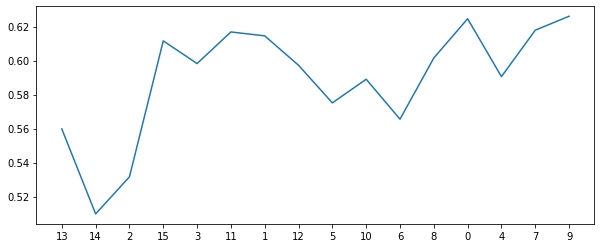

884
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7073529411764706
sensitivity  0.54
auc          0.6236764705882353


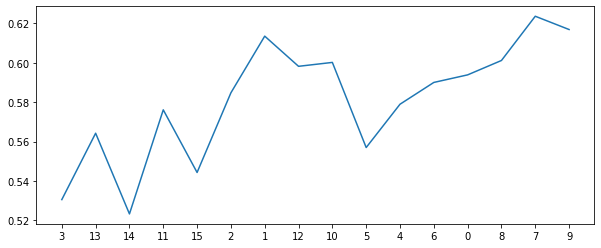

885
all features [13, 15, 3, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 15, 3, 2, 14]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6375
specificity  0.6398567119155354
sensitivity  0.62
auc          0.6299283559577677


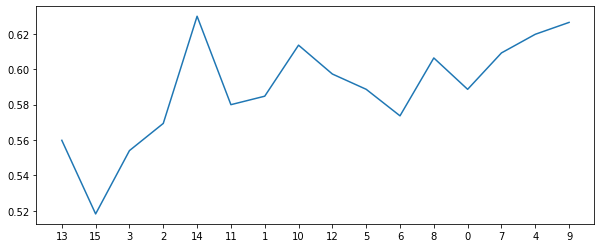

886
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 2]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6687405731523379
sensitivity  0.645
auc          0.656870286576169


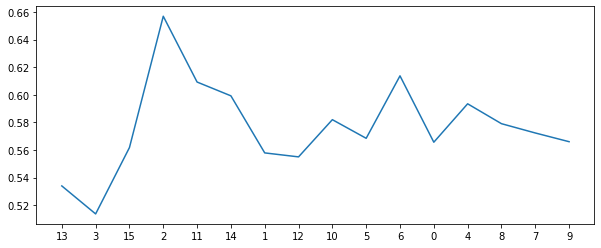

887
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6418929110105581
sensitivity  0.62
auc          0.6309464555052791


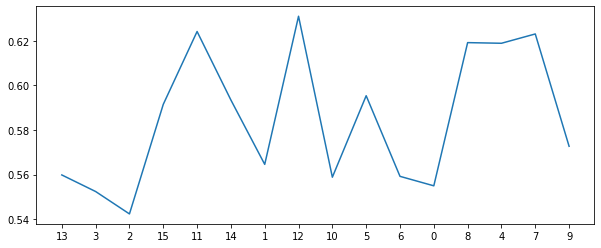

888
all features [13, 3, 14, 2, 11, 15, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 2, 11, 15, 1, 12, 10, 5, 4, 6, 8]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6129336349924586
sensitivity  0.715
auc          0.6639668174962292


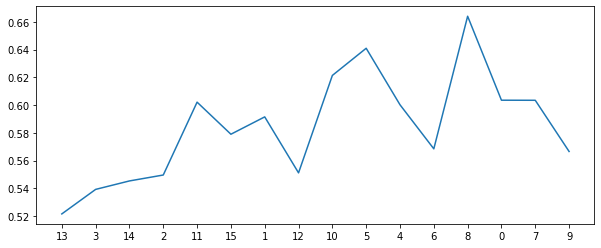

889
all features [13, 14, 15, 11, 3, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 11, 3, 2, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6089366515837105
sensitivity  0.735
auc          0.6719683257918552


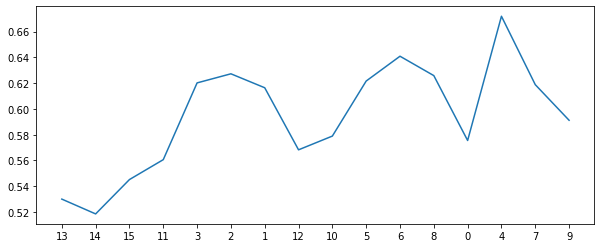

890
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6631221719457013
sensitivity  0.59
auc          0.6265610859728507


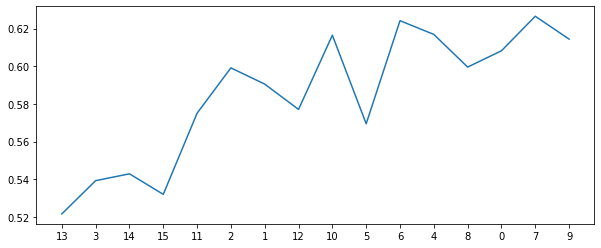

891
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6090120663650076
sensitivity  0.69
auc          0.6495060331825038


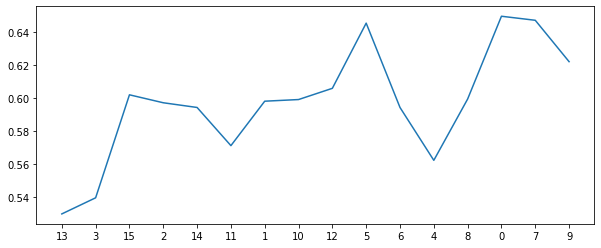

892
all features [13, 15, 14, 3, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 15, 14, 3, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.59
auc          0.6111199095022624


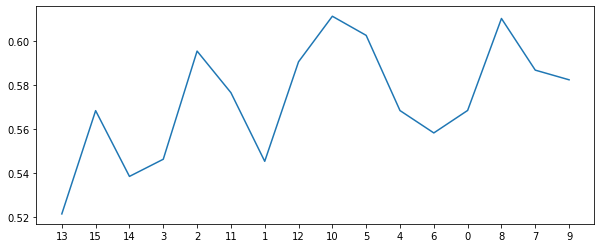

893
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6032805429864253
sensitivity  0.69
auc          0.6466402714932127


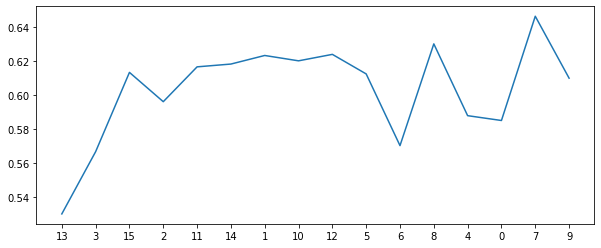

894
all features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5821428571428572
specificity  0.572473604826546
sensitivity  0.715
auc          0.643736802413273


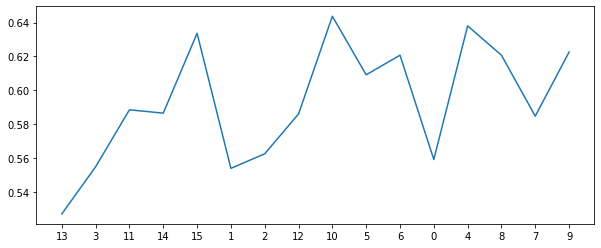

895
all features [13, 14, 15, 3, 2, 1, 11, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 2, 1, 11, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5725490196078431
sensitivity  0.735
auc          0.6537745098039215


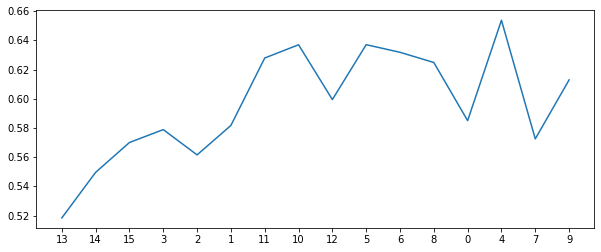

896
all features [13, 3, 11, 15, 1, 14, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 1]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5714285714285714
specificity  0.5608220211161388
sensitivity  0.71
auc          0.6354110105580694


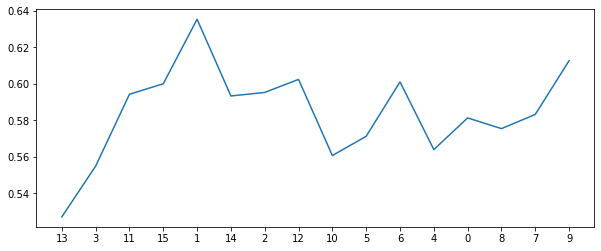

897
all features [13, 3, 2, 15, 14, 1, 11, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 14, 1, 11, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5410714285714285
specificity  0.5282051282051282
sensitivity  0.715
auc          0.6216025641025641


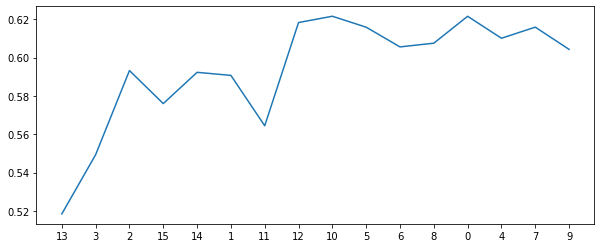

898
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.6033559577677224
sensitivity  0.665
auc          0.6341779788838613


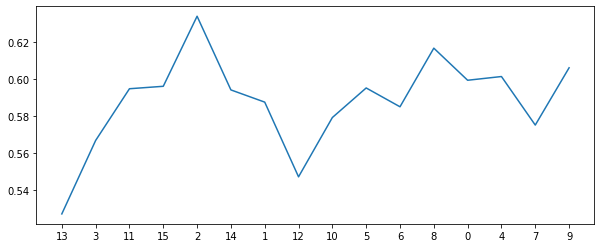

899
all features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 8, 4, 9]
[0.4, 2, 1000, 2, 1, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5767857142857143
specificity  0.5627828054298643
sensitivity  0.76
auc          0.6613914027149321


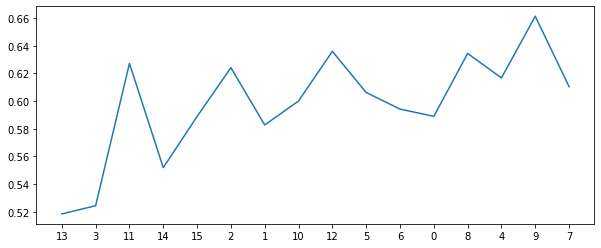

900
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.666892911010558
sensitivity  0.595
auc          0.6309464555052791


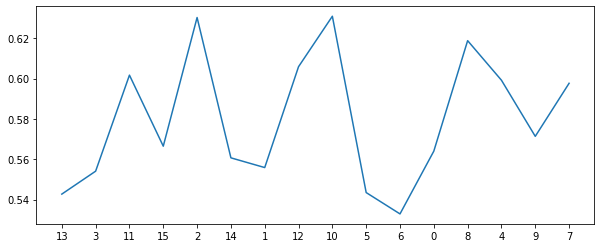

901
all features [13, 14, 2, 3, 15, 11, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 2, 3, 15, 11, 1, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6225490196078431
sensitivity  0.645
auc          0.6337745098039216


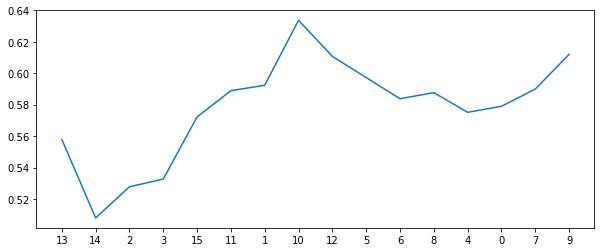

902
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6842006033182504
sensitivity  0.615
auc          0.6496003016591252


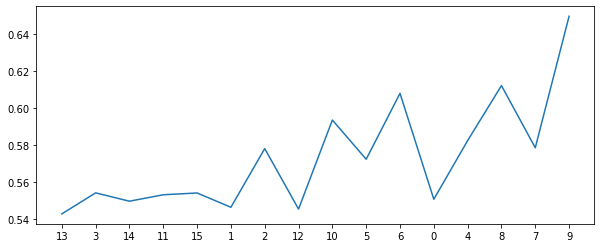

903
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6050904977375565
sensitivity  0.665
auc          0.6350452488687782


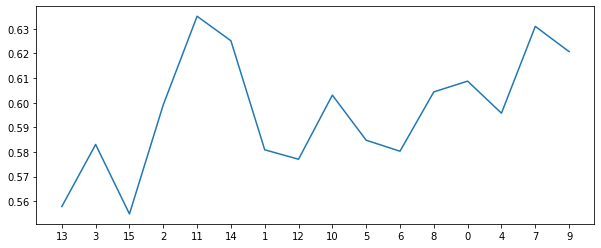

904
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 11, 2]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6551282051282051
sensitivity  0.615
auc          0.6350641025641026


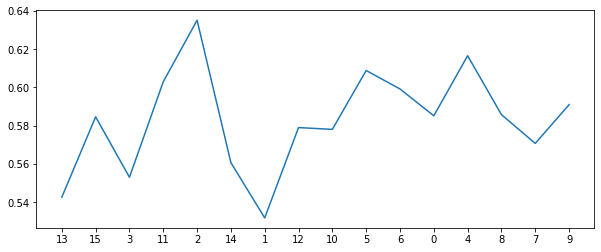

905
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9]
[0.4, 2, 1000, 2, 1, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6687405731523378
sensitivity  0.61
auc          0.6393702865761689


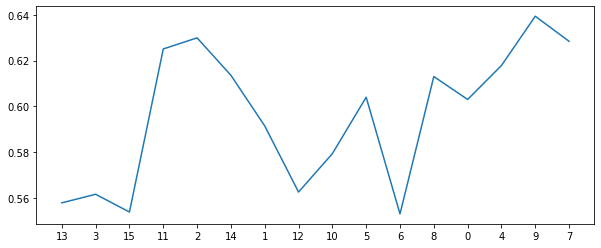

906
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.625
specificity  0.6265082956259427
sensitivity  0.62
auc          0.6232541478129713


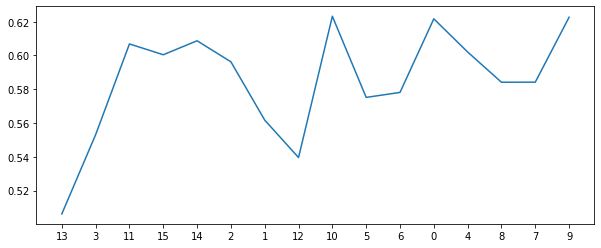

907
all features [13, 2, 3, 14, 15, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 2, 3, 14, 15, 11, 1, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5956636500754148
sensitivity  0.71
auc          0.6528318250377074


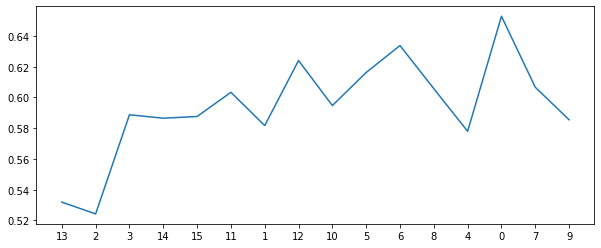

908
all features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 11, 14, 15, 1, 2, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6649698340874811
sensitivity  0.715
auc          0.6899849170437405


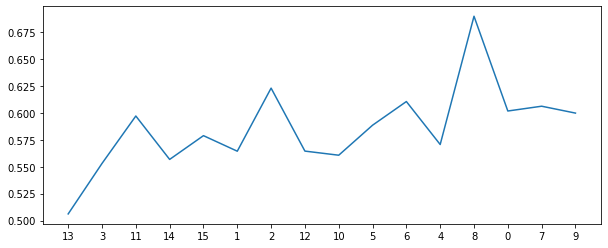

909
all features [13, 3, 2, 15, 14, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 14, 11, 1]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.55
specificity  0.5377450980392157
sensitivity  0.72
auc          0.6288725490196079


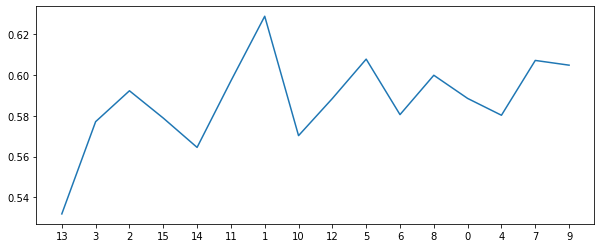

910
all features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 10, 12, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6187405731523379
sensitivity  0.645
auc          0.631870286576169


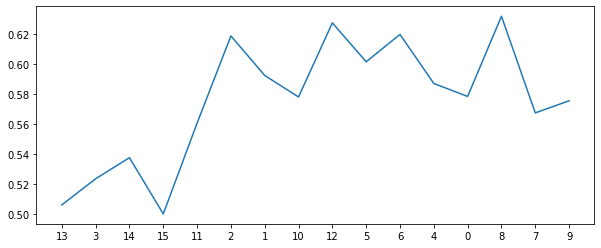

911
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5918174962292609
sensitivity  0.665
auc          0.6284087481146304


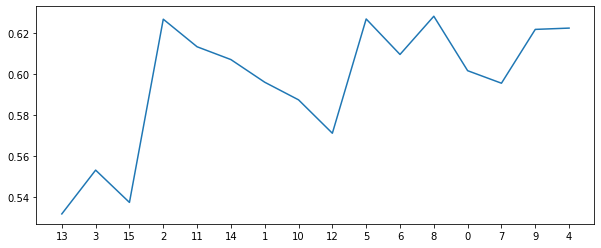

912
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5785714285714285
specificity  0.5687028657616893
sensitivity  0.715
auc          0.6418514328808447


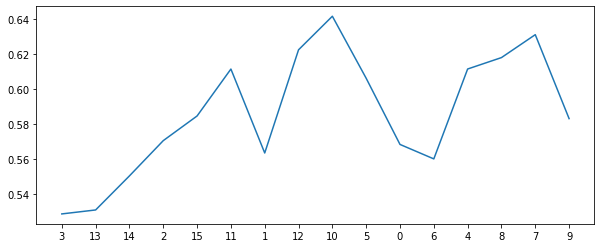

913
all features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5053571428571428
specificity  0.4820889894419306
sensitivity  0.815
auc          0.6485444947209653


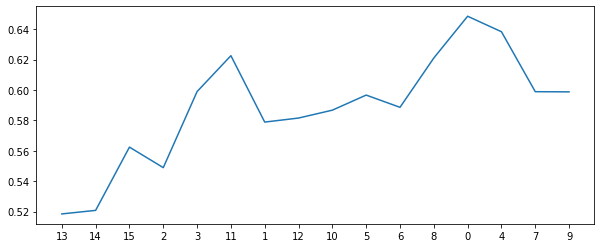

914
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5875
specificity  0.5802036199095022
sensitivity  0.695
auc          0.6376018099547511


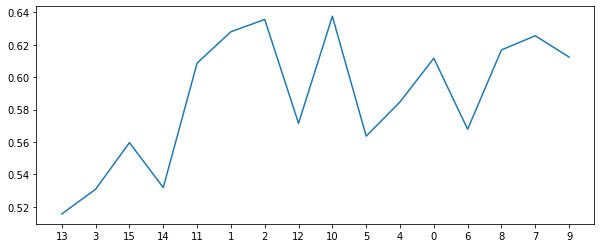

915
all features [13, 3, 2, 15, 14, 1, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 2, 15, 14, 1, 11, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5648567119155354
sensitivity  0.76
auc          0.6624283559577677


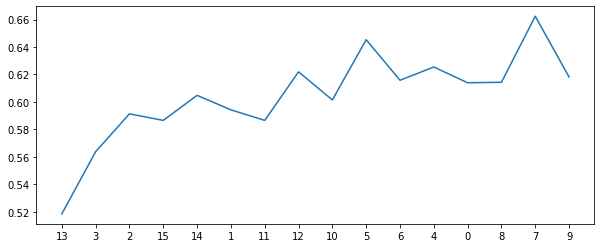

916
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5964285714285714
specificity  0.5879336349924585
sensitivity  0.715
auc          0.6514668174962293


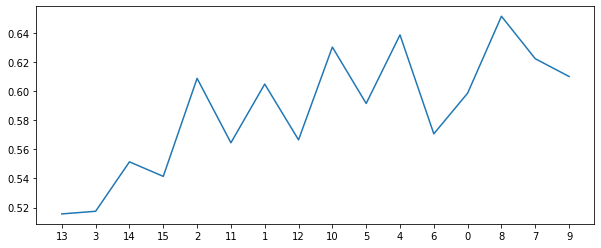

917
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5553571428571429
specificity  0.5397435897435897
sensitivity  0.765
auc          0.6523717948717949


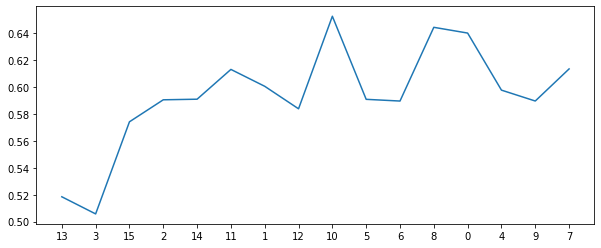

918
all features [3, 14, 15, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.7125
specificity  0.7226998491704374
sensitivity  0.59
auc          0.6563499245852187


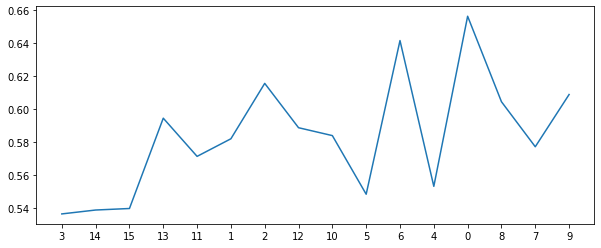

919
all features [13, 2, 15, 3, 11, 14, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 2, 15, 3, 11]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6358220211161387
sensitivity  0.615
auc          0.6254110105580694


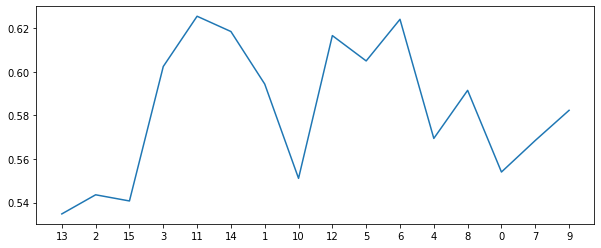

920
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7053571428571428
specificity  0.7226998491704374
sensitivity  0.495
auc          0.6088499245852187


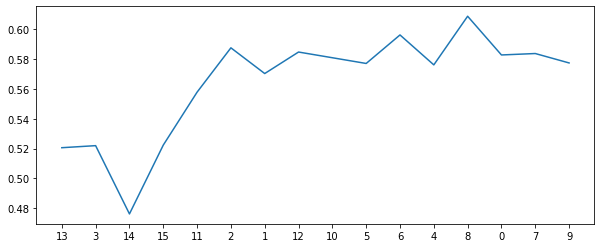

921
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6475490196078432
sensitivity  0.715
auc          0.6812745098039216


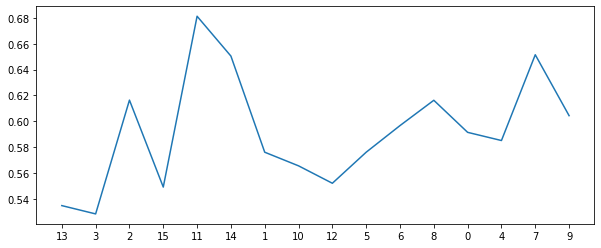

922
all features [3, 13, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 11, 15, 2]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.6995852187028657
sensitivity  0.57
auc          0.6347926093514329


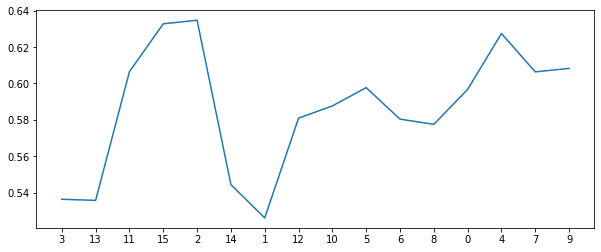

923
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 1, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6705882352941177
sensitivity  0.59
auc          0.6302941176470588


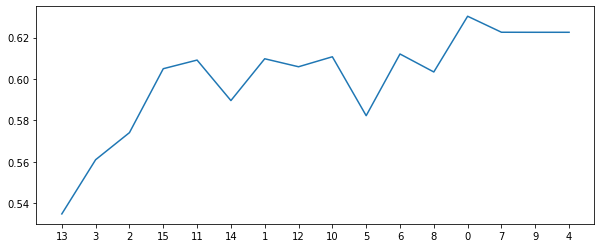

924
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.653393665158371
sensitivity  0.595
auc          0.6241968325791856


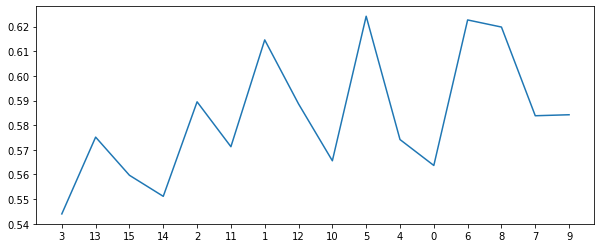

925
all features [13, 2, 3, 15, 14, 11, 1, 10, 12, 6, 5, 4, 8, 0, 7, 9, 16]
new features [13, 2, 3, 15, 14, 11, 1, 10, 12, 6, 5, 4, 8]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5916666666666667
sensitivity  0.69
auc          0.6408333333333334


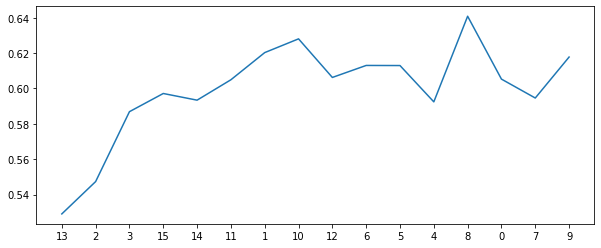

926
all features [13, 3, 11, 14, 15, 1, 2, 10, 12, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 1, 2, 10, 12, 5, 4, 6]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6610859728506787
sensitivity  0.615
auc          0.6380429864253394


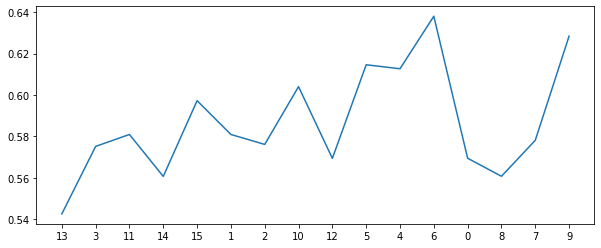

927
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6148190045248869
sensitivity  0.69
auc          0.6524095022624434


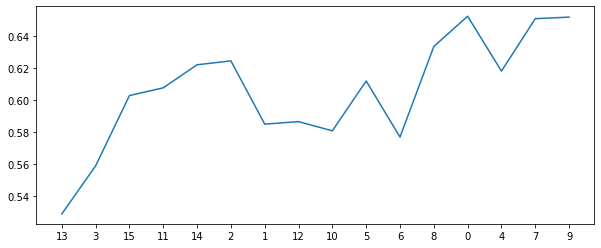

928
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6494343891402715
sensitivity  0.62
auc          0.6347171945701358


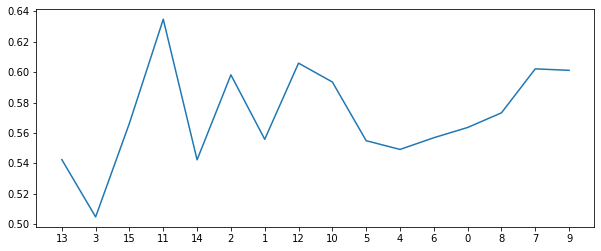

929
all features [13, 15, 3, 2, 11, 1, 14, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 15, 3, 2, 11, 1, 14]
[0.4, 2, 1000, 2, 1, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5975867269984917
sensitivity  0.645
auc          0.6212933634992458


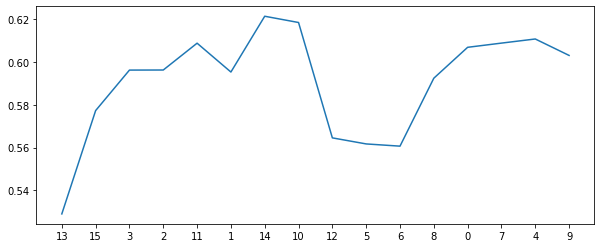

930
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6207390648567119
sensitivity  0.62
auc          0.620369532428356


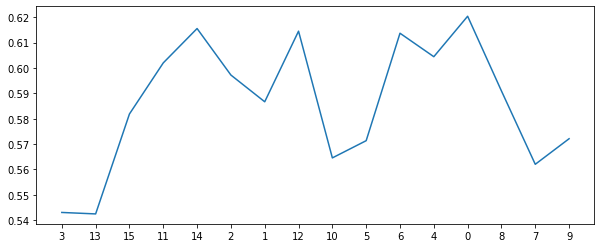

931
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 4, 0, 7, 8]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5321428571428571
specificity  0.5125565610859728
sensitivity  0.785
auc          0.6487782805429865


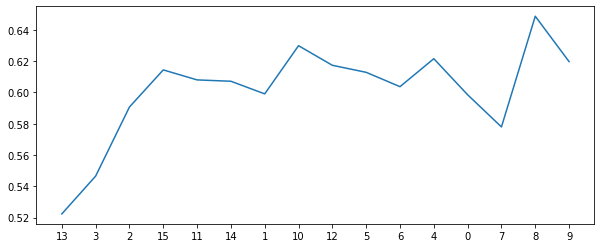

932
all features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6071428571428571
specificity  0.5976244343891403
sensitivity  0.735
auc          0.6663122171945701


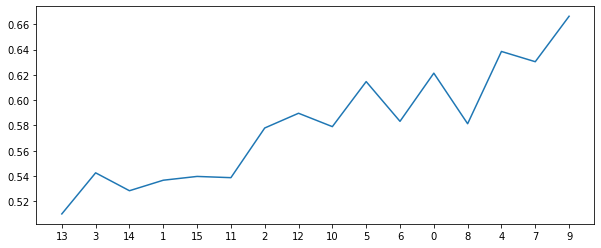

933
all features [13, 3, 2, 15, 14, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 2, 15, 14, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5840120663650076
sensitivity  0.71
auc          0.6470060331825037


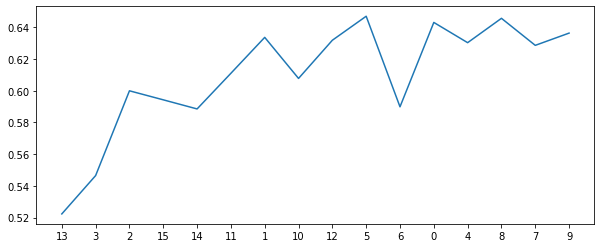

934
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6168552036199095
sensitivity  0.64
auc          0.6284276018099547


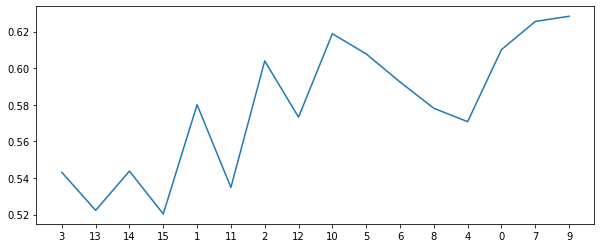

935
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 2, 15, 11, 14, 1]
[0.4, 2, 1000, 2, 1, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5704751131221719
sensitivity  0.715
auc          0.642737556561086


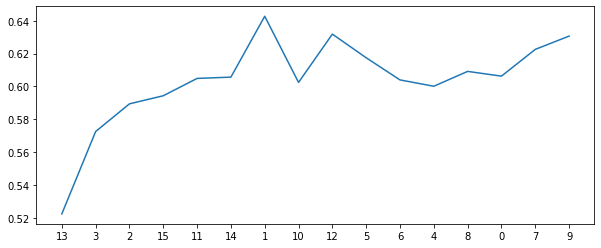

936
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.675
specificity  0.6880844645550528
sensitivity  0.51
auc          0.5990422322775264


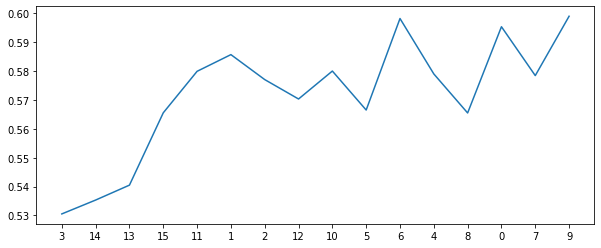

937
all features [13, 15, 3, 14, 2, 11, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 3, 14, 2, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6283559577677225
sensitivity  0.62
auc          0.6241779788838613


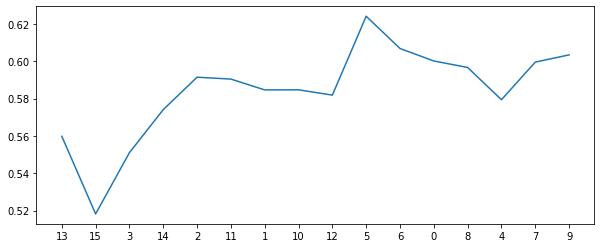

938
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6842760180995475
sensitivity  0.595
auc          0.6396380090497737


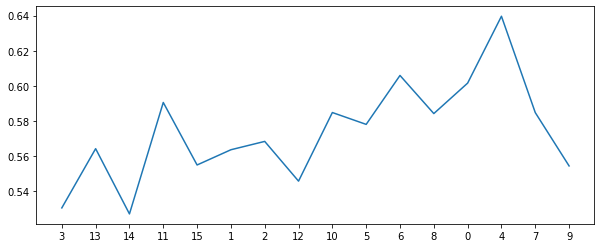

939
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 5, 6, 0, 8, 7, 4]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.65
specificity  0.655316742081448
sensitivity  0.59
auc          0.622658371040724


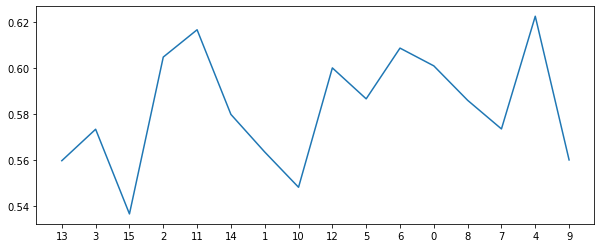

940
all features [3, 13, 11, 14, 2, 15, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 11, 14, 2, 15, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6919683257918552
sensitivity  0.545
auc          0.6184841628959276


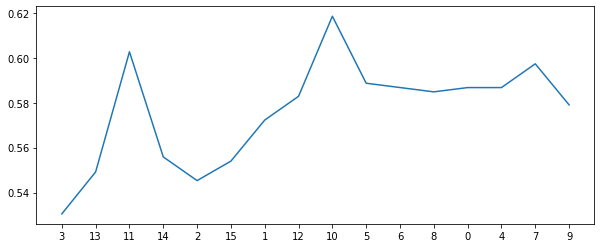

941
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 9, 4, 7, 16]
new features [13, 3, 2, 15, 11, 14, 1]
[0.4, 2, 1000, 2, 1, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6360105580693816
sensitivity  0.595
auc          0.6155052790346908


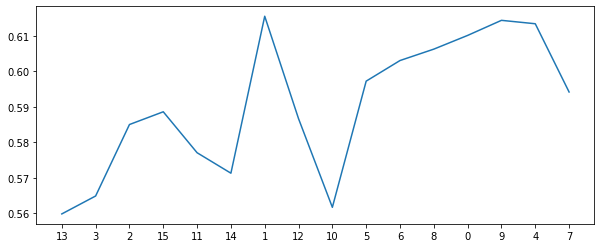

942
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6168552036199095
sensitivity  0.615
auc          0.6159276018099548


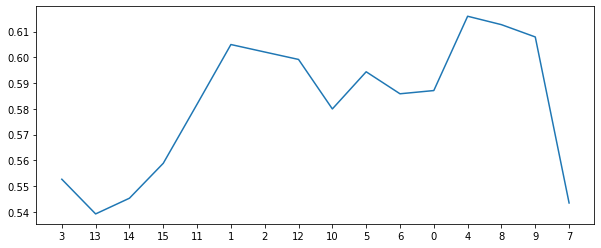

943
all features [13, 3, 2, 14, 15, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 14, 15, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.58789592760181
sensitivity  0.685
auc          0.636447963800905


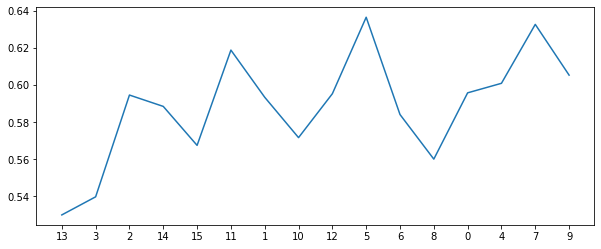

944
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6534690799396682
sensitivity  0.665
auc          0.659234539969834


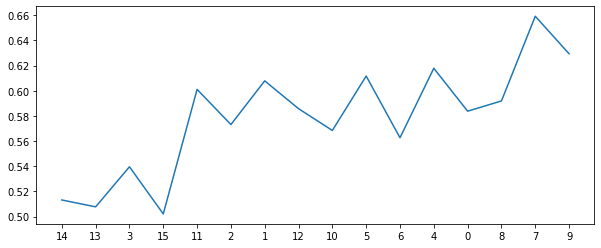

945
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6071266968325791
sensitivity  0.735
auc          0.6710633484162896


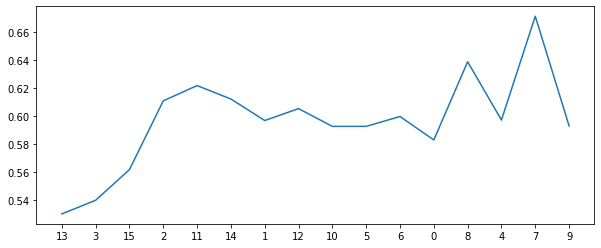

946
all features [11, 3, 13, 14, 15, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [11, 3, 13, 14, 15, 2, 1, 10]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6392857142857142
specificity  0.6418552036199094
sensitivity  0.62
auc          0.6309276018099548


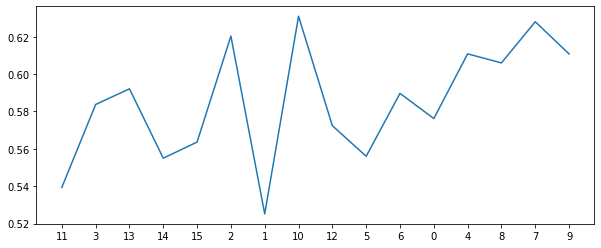

947
all features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5, 6, 0, 8, 7, 9, 4, 16]
new features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5954751131221719
sensitivity  0.67
auc          0.632737556561086


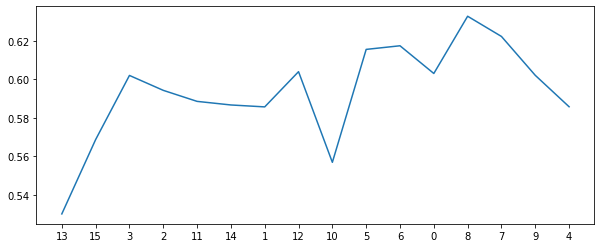

948
all features [3, 15, 13, 14, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6013574660633484
sensitivity  0.67
auc          0.6356787330316742


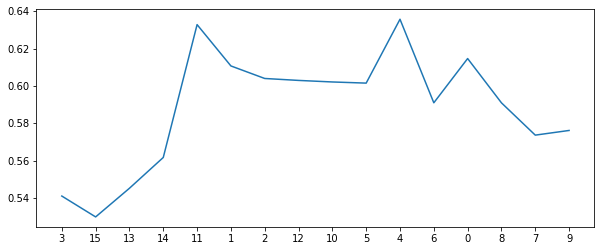

949
all features [13, 3, 2, 14, 15, 11, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 2, 14, 15, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5512820512820513
sensitivity  0.74
auc          0.6456410256410257


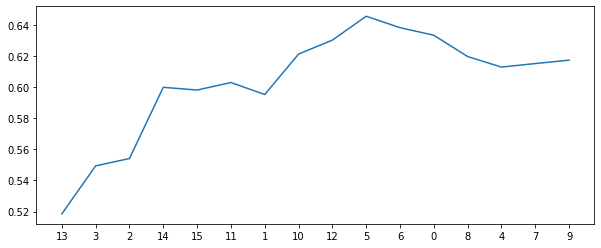

950
all features [13, 14, 3, 15, 11, 1, 2, 10, 12, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 10, 12, 5, 0, 6, 8, 4, 7, 9]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5840874811463047
sensitivity  0.715
auc          0.6495437405731523


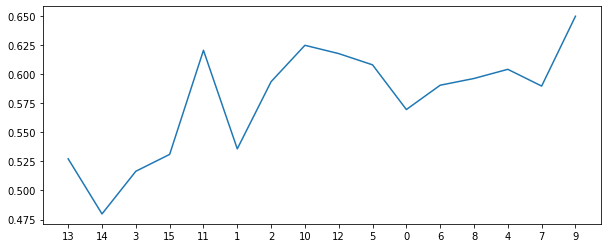

951
all features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 0, 4]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5512820512820513
sensitivity  0.79
auc          0.6706410256410257


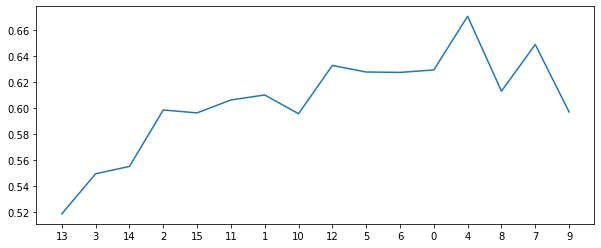

952
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 4, 8, 6, 0, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 4, 8, 6, 0, 7]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.614894419306184
sensitivity  0.635
auc          0.624947209653092


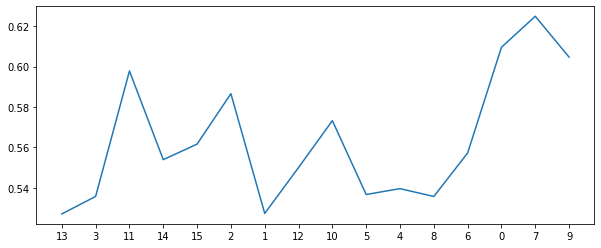

953
all features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 8, 0, 9, 4, 7, 16]
new features [13, 3, 2, 15, 11, 14, 1, 10, 12, 5, 6, 8, 0, 9]
[0.4, 2, 1000, 2, 1, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5535714285714286
specificity  0.5357466063348416
sensitivity  0.785
auc          0.6603733031674208


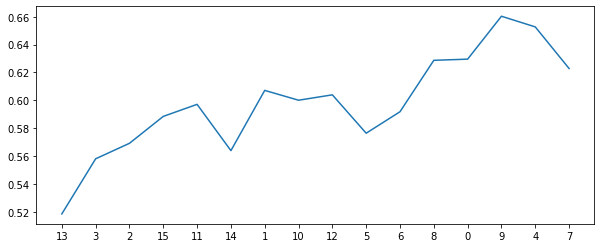

954
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428572
specificity  0.6745475113122172
sensitivity  0.615
auc          0.6447737556561086


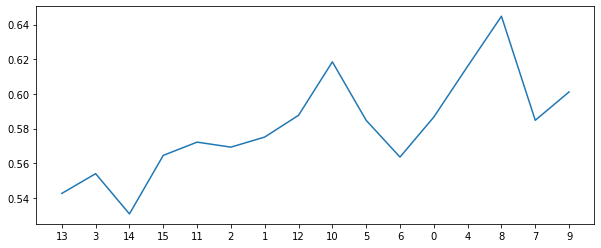

955
all features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6650075414781297
sensitivity  0.615
auc          0.6400037707390648


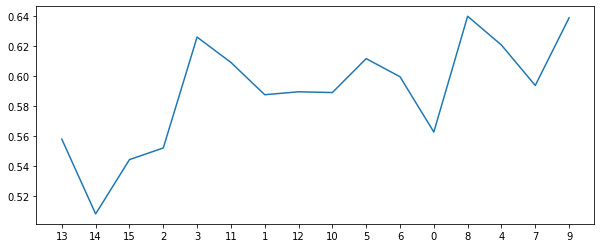

956
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6714285714285714
specificity  0.6783936651583711
sensitivity  0.59
auc          0.6341968325791856


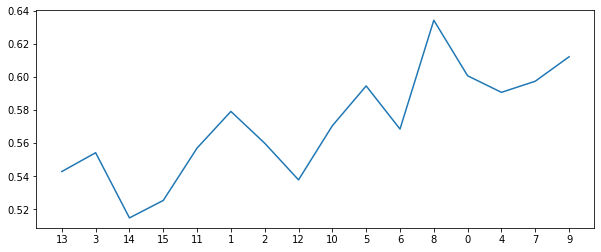

957
all features [13, 3, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 11]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6360482654600301
sensitivity  0.69
auc          0.663024132730015


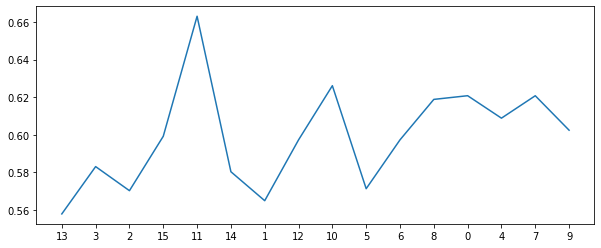

958
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6572398190045249
sensitivity  0.595
auc          0.6261199095022625


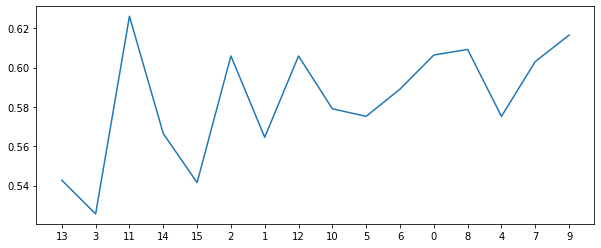

959
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 2, 1, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5994343891402715
sensitivity  0.67
auc          0.6347171945701358


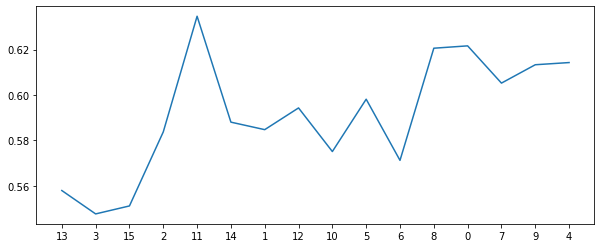

960
all features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5, 4, 6, 8, 0, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5964285714285714
specificity  0.5899321266968326
sensitivity  0.69
auc          0.6399660633484163


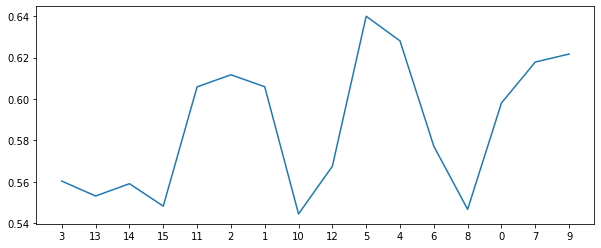

961
all features [13, 15, 2, 3, 14, 11, 1, 10, 12, 5, 6, 0, 8, 7, 4, 9, 16]
new features [13, 15, 2, 3, 14, 11, 1, 10, 12, 5]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5608597285067873
sensitivity  0.735
auc          0.6479298642533936


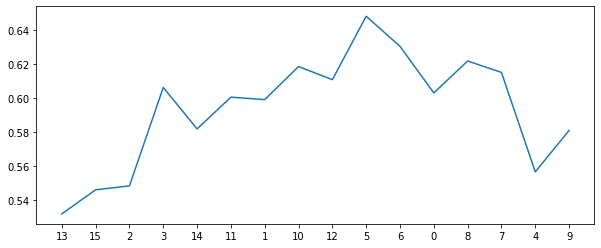

962
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 8, 6, 0, 4, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 8, 6]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6033559577677224
sensitivity  0.64
auc          0.6216779788838612


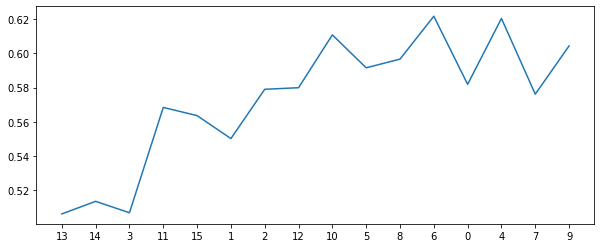

963
all features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6147812971342383
sensitivity  0.685
auc          0.6498906485671191


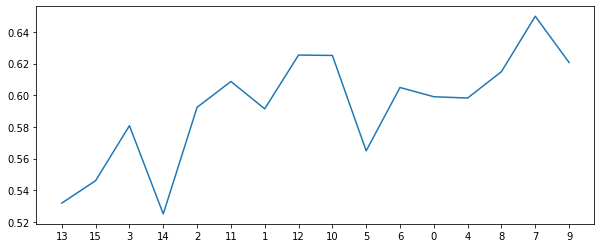

964
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 0, 6]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6303544494720965
sensitivity  0.615
auc          0.6226772247360483


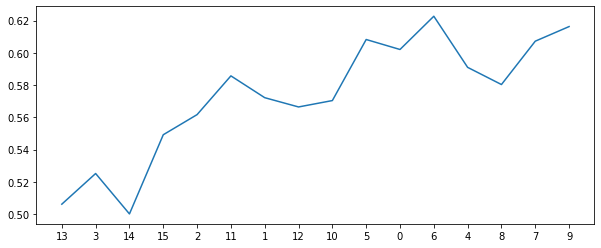

965
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5]
[0.4, 2, 1000, 2, 1, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5801659125188537
sensitivity  0.665
auc          0.6225829562594268


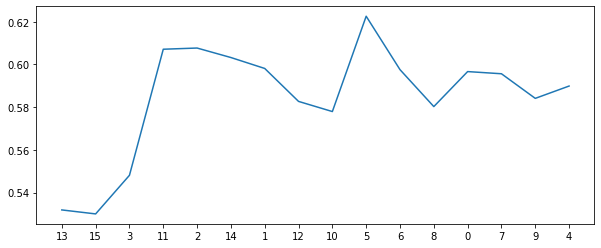

966
all features [13, 15, 3, 11, 14, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 15, 3, 11, 14, 2]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5840497737556561
sensitivity  0.72
auc          0.6520248868778281


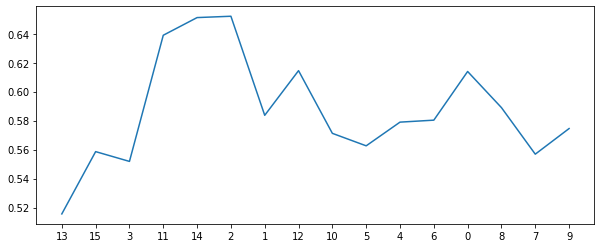

967
all features [13, 14, 2, 15, 3, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 2, 15, 3, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5714285714285714
specificity  0.5590120663650076
sensitivity  0.74
auc          0.6495060331825038


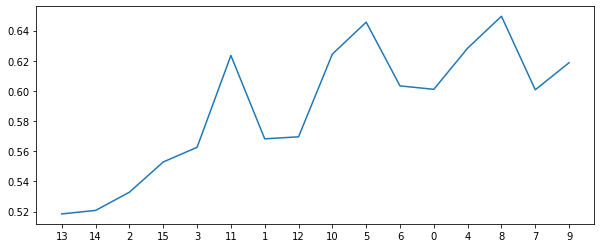

968
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5782428355957767
sensitivity  0.66
auc          0.6191214177978883


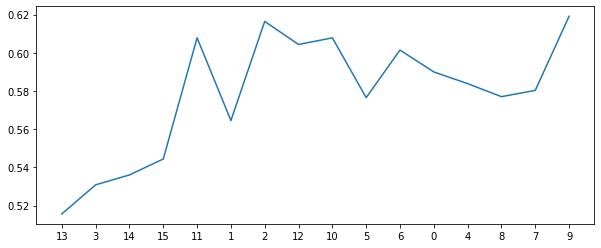

969
all features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 15, 3, 2, 11, 14, 1, 12, 10]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5535714285714286
specificity  0.5398567119155354
sensitivity  0.745
auc          0.6424283559577677


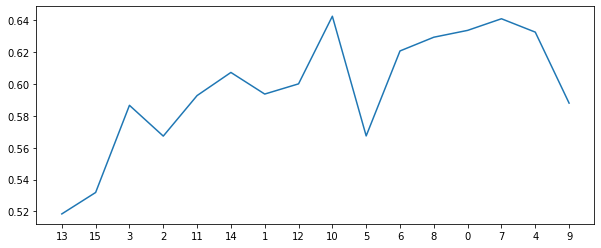

970
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5879713423831071
sensitivity  0.635
auc          0.6114856711915535


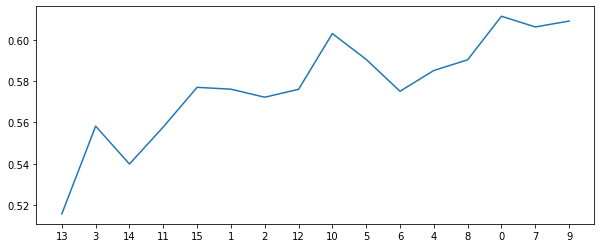

971
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 10]
[0.4, 2, 1000, 2, 1, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5410714285714285
specificity  0.5243212669683258
sensitivity  0.765
auc          0.6446606334841629


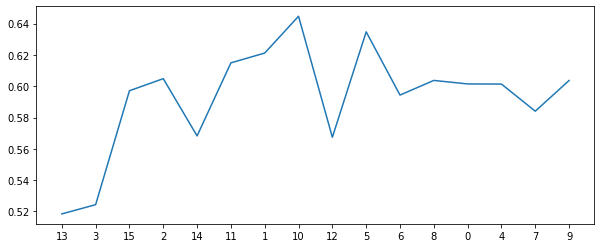

972
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6875
specificity  0.6995852187028657
sensitivity  0.54
auc          0.6197926093514329


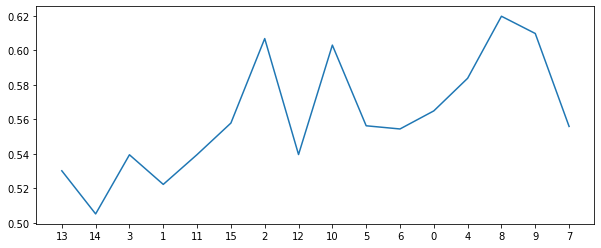

973
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6822398190045249
sensitivity  0.64
auc          0.6611199095022624


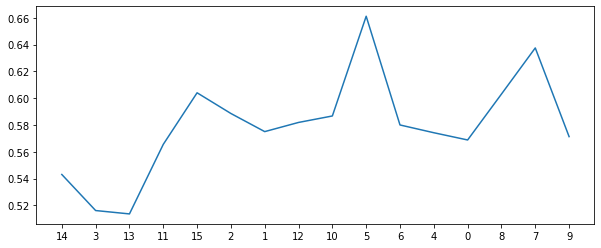

974
all features [3, 14, 13, 15, 12, 1, 2, 11, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 12, 1, 2, 11, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6910714285714286
specificity  0.7014705882352941
sensitivity  0.565
auc          0.633235294117647


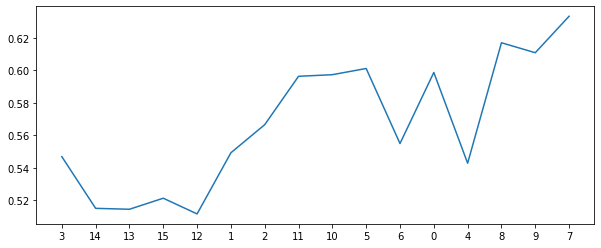

975
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6976621417797888
sensitivity  0.535
auc          0.6163310708898944


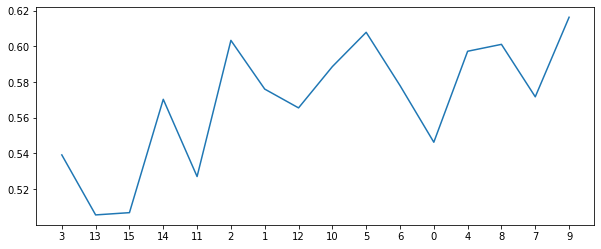

976
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6918174962292609
sensitivity  0.52
auc          0.6059087481146305


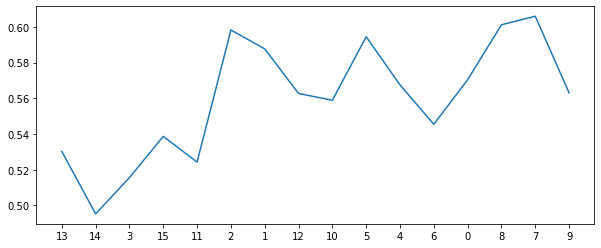

977
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6996229260935143
sensitivity  0.52
auc          0.6098114630467572


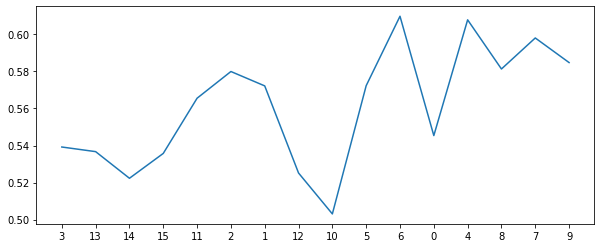

978
all features [13, 14, 3, 1, 11, 2, 15, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 1, 11, 2, 15, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6207767722473605
sensitivity  0.62
auc          0.6203883861236802


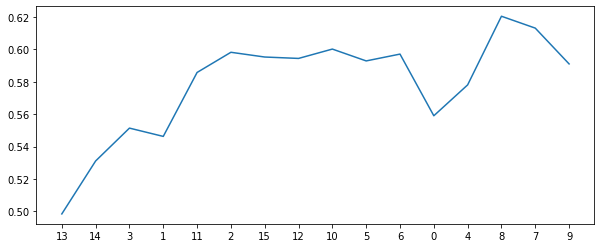

979
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.58789592760181
sensitivity  0.665
auc          0.626447963800905


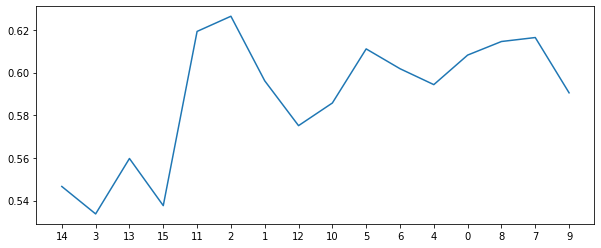

980
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.645739064856712
sensitivity  0.62
auc          0.632869532428356


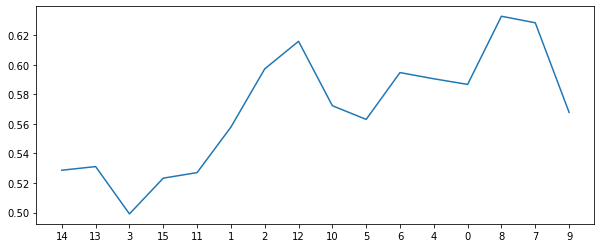

981
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6437405731523379
sensitivity  0.66
auc          0.651870286576169


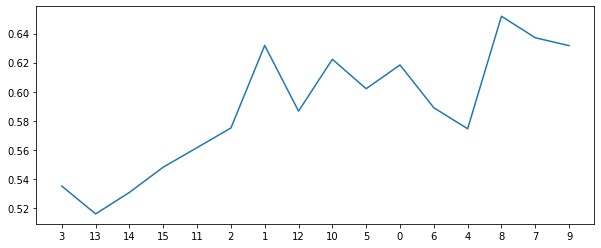

982
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.635972850678733
sensitivity  0.62
auc          0.6279864253393665


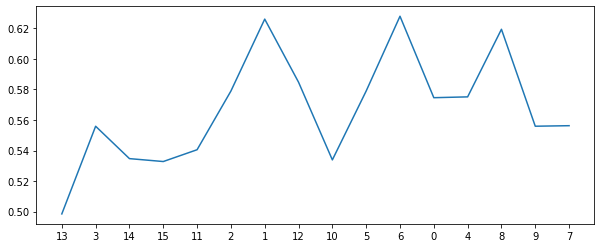

983
all features [3, 14, 13, 11, 15, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6437028657616893
sensitivity  0.71
auc          0.6768514328808446


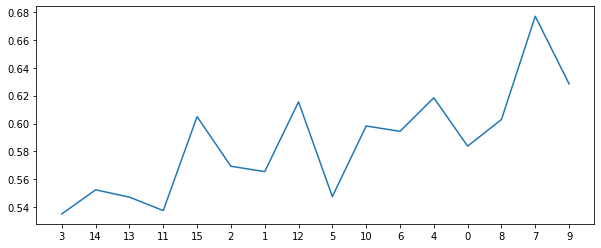

984
all features [13, 14, 15, 3, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 15, 3, 1, 11, 2]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5767857142857142
specificity  0.5704751131221719
sensitivity  0.67
auc          0.6202375565610859


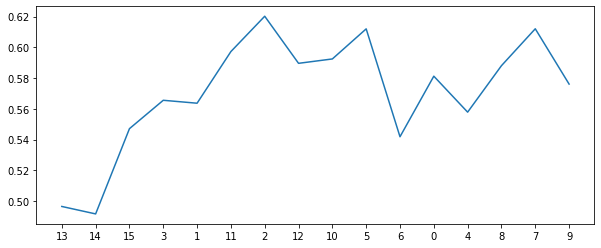

985
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.568552036199095
sensitivity  0.71
auc          0.6392760180995475


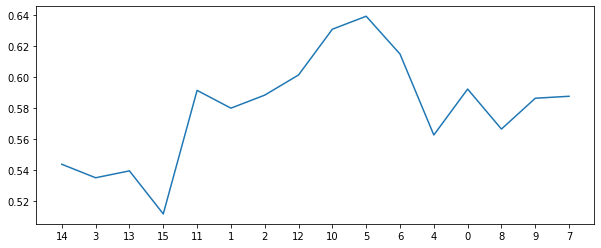

986
all features [14, 3, 13, 1, 2, 15, 11, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 1, 2, 15, 11, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6052790346907994
sensitivity  0.69
auc          0.6476395173453997


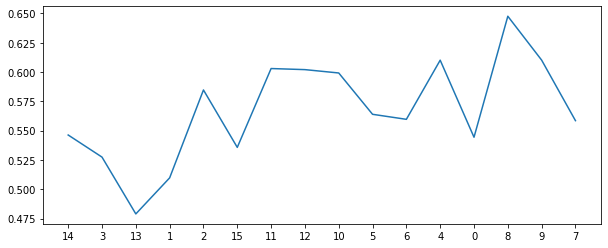

987
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5685897435897436
sensitivity  0.79
auc          0.6792948717948718


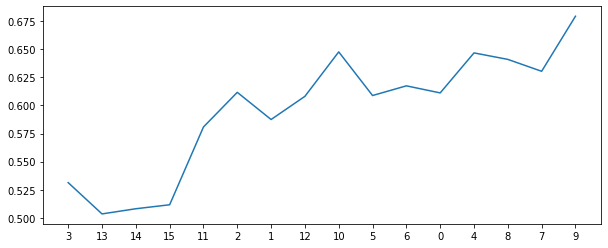

988
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6207390648567119
sensitivity  0.645
auc          0.632869532428356


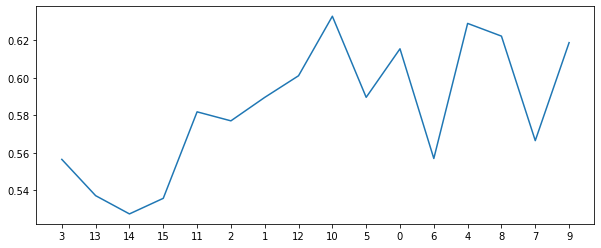

989
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6167797888386124
sensitivity  0.71
auc          0.6633898944193062


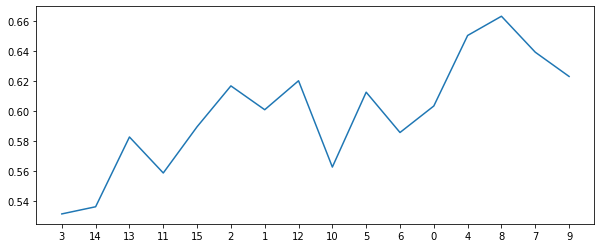

990
all features [13, 14, 3, 1, 15, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6783559577677225
sensitivity  0.59
auc          0.6341779788838613


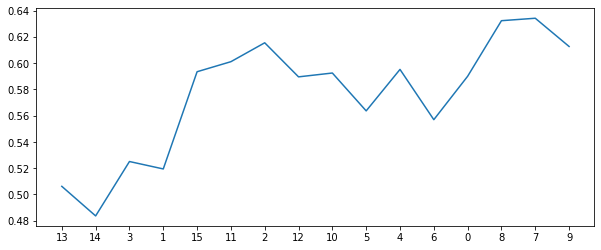

991
all features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10, 6]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6630844645550528
sensitivity  0.595
auc          0.6290422322775264


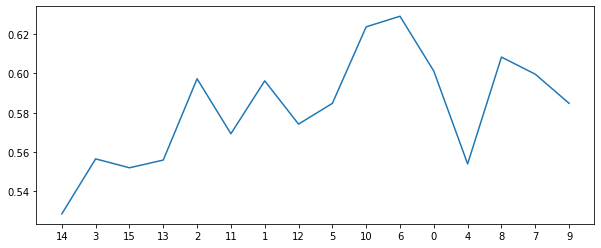

992
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6678571428571429
specificity  0.6765837104072399
sensitivity  0.57
auc          0.62329185520362


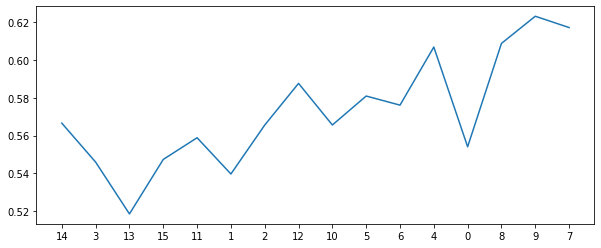

993
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.693815987933635
sensitivity  0.595
auc          0.6444079939668175


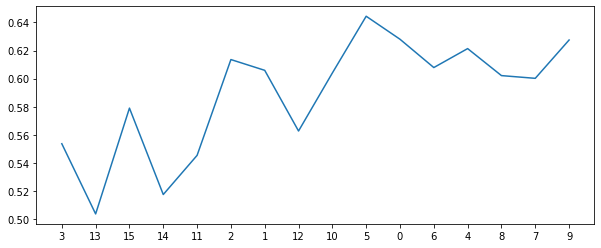

994
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6822775263951735
sensitivity  0.545
auc          0.6136387631975867


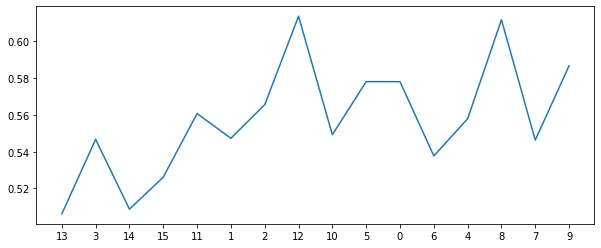

995
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.6995475113122172
sensitivity  0.585
auc          0.6422737556561086


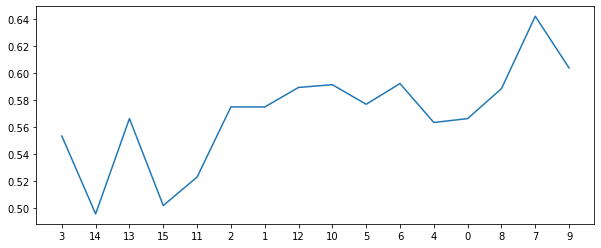

996
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6169306184012067
sensitivity  0.62
auc          0.6184653092006033


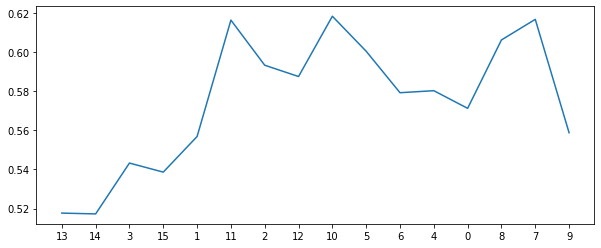

997
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.5995475113122172
sensitivity  0.715
auc          0.6572737556561086


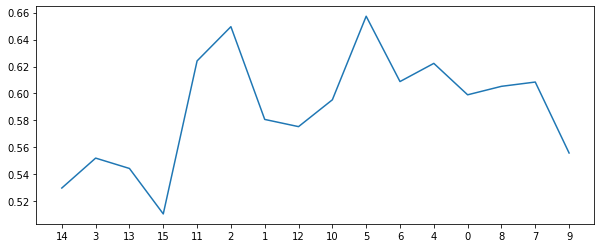

998
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6302036199095022
sensitivity  0.595
auc          0.6126018099547511


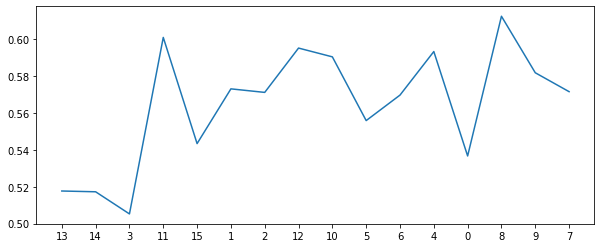

999
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6167797888386124
sensitivity  0.76
auc          0.6883898944193062


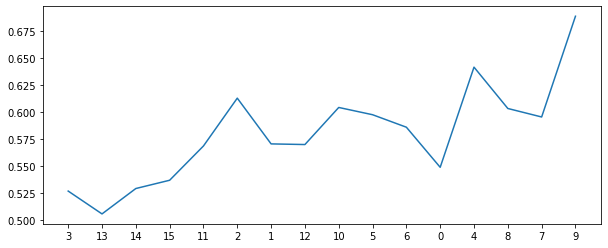

1000
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6243966817496229
sensitivity  0.59
auc          0.6071983408748115


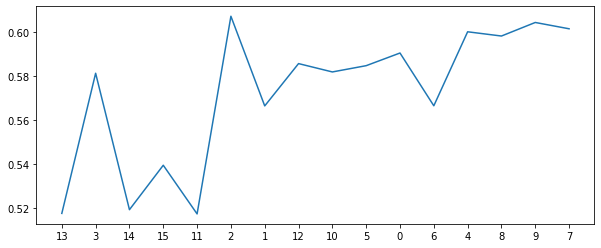

1001
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6428571428571428
specificity  0.6456636500754148
sensitivity  0.62
auc          0.6328318250377074


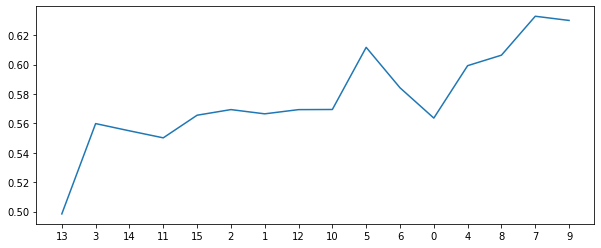

1002
all features [13, 14, 3, 1, 2, 15, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 2, 15, 11, 12, 10]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5732142857142857
specificity  0.5667797888386124
sensitivity  0.67
auc          0.6183898944193061


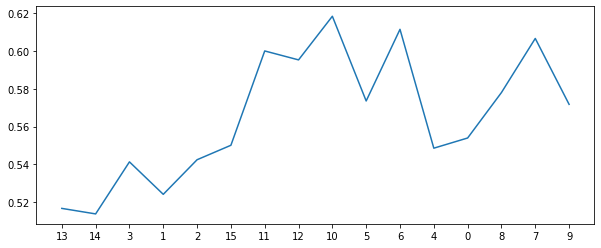

1003
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.5455128205128205
sensitivity  0.72
auc          0.6327564102564103


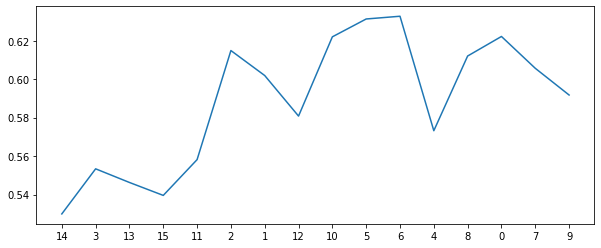

1004
all features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5840874811463047
sensitivity  0.665
auc          0.6245437405731523


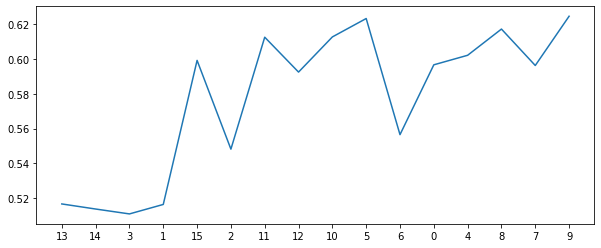

1005
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857143
specificity  0.5610482654600302
sensitivity  0.79
auc          0.6755241327300151


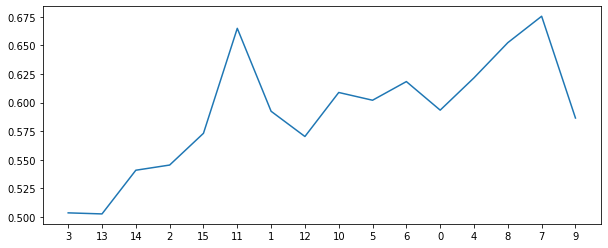

1006
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6052790346907994
sensitivity  0.665
auc          0.6351395173453996


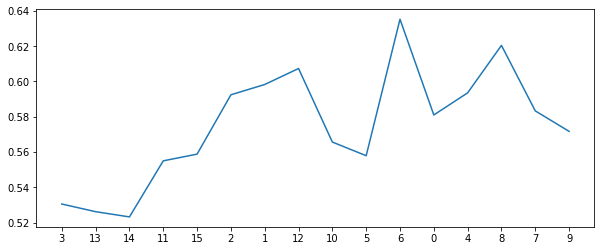

1007
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.5706259426847662
sensitivity  0.69
auc          0.6303129713423831


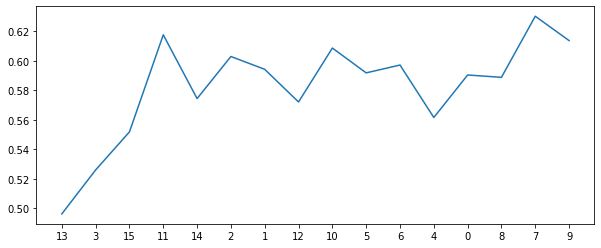

1008
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6571644042232277
sensitivity  0.61
auc          0.6335822021116139


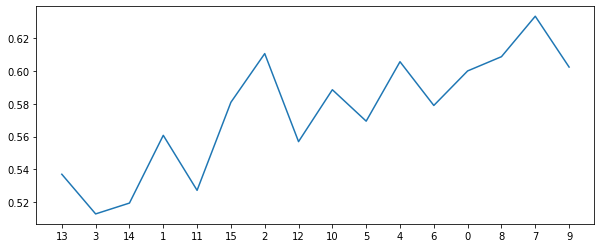

1009
all features [14, 3, 13, 15, 2, 11, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 5, 10, 6]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6214285714285714
specificity  0.6226244343891403
sensitivity  0.62
auc          0.6213122171945701


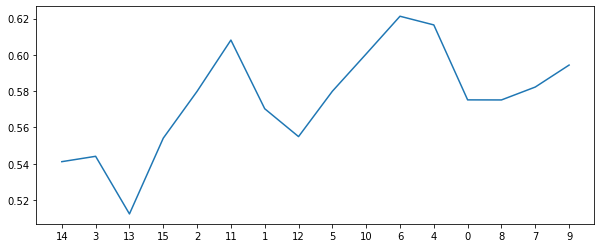

1010
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6625
specificity  0.6687028657616892
sensitivity  0.585
auc          0.6268514328808447


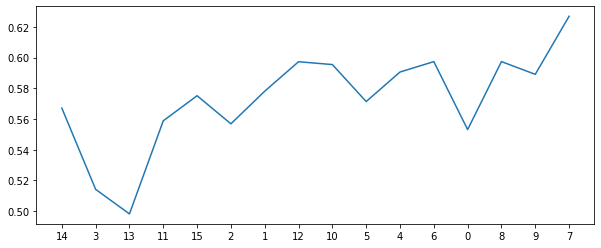

1011
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2, 11, 1]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.625
specificity  0.6264328808446455
sensitivity  0.62
auc          0.6232164404223227


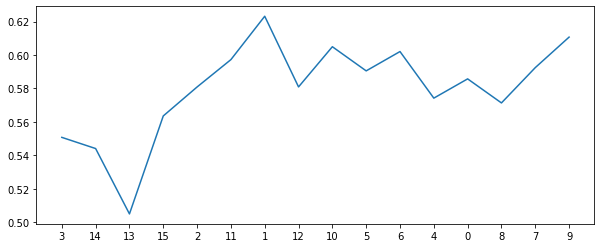

1012
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6880844645550528
sensitivity  0.545
auc          0.6165422322775264


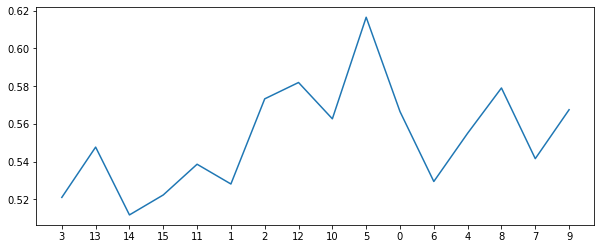

1013
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6918174962292609
sensitivity  0.595
auc          0.6434087481146304


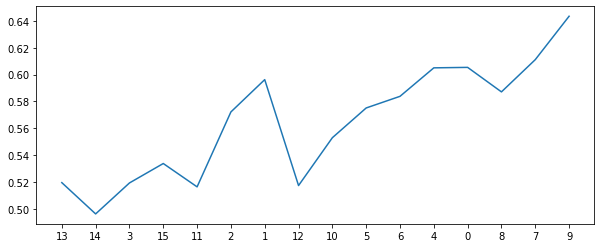

1014
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 1, 11, 15]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5881221719457014
sensitivity  0.67
auc          0.6290610859728507


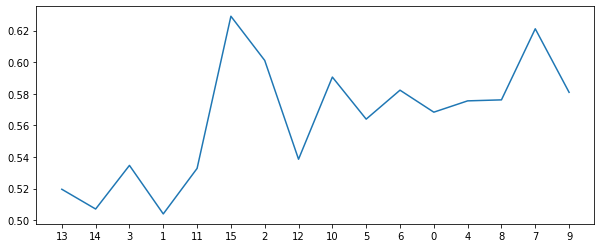

1015
all features [14, 15, 13, 3, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 15, 13, 3, 2, 11, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6214285714285714
specificity  0.6207013574660634
sensitivity  0.64
auc          0.6303506787330316


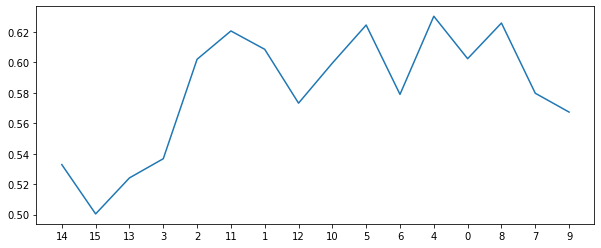

1016
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 0, 4, 6, 8, 9, 7]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.625
specificity  0.6205882352941177
sensitivity  0.685
auc          0.6527941176470589


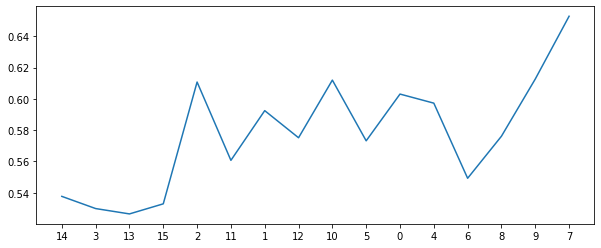

1017
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6264705882352941
sensitivity  0.665
auc          0.6457352941176471


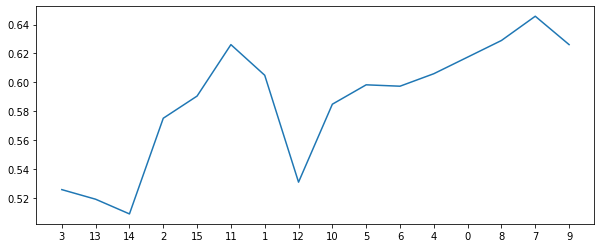

1018
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6592383107088989
sensitivity  0.615
auc          0.6371191553544495


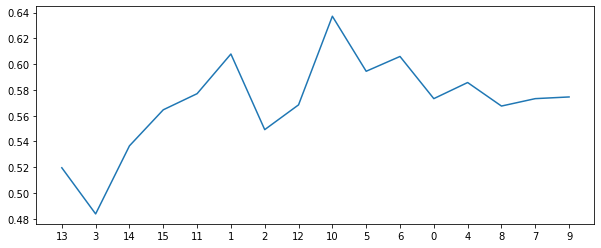

1019
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6283559577677225
sensitivity  0.66
auc          0.6441779788838612


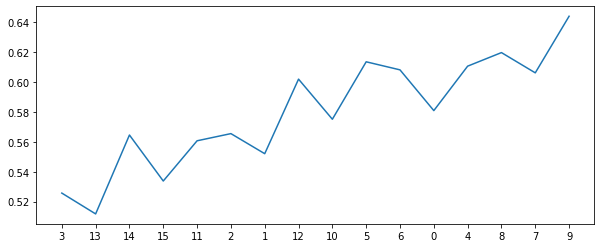

1020
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5392857142857143
specificity  0.5262820512820513
sensitivity  0.71
auc          0.6181410256410257


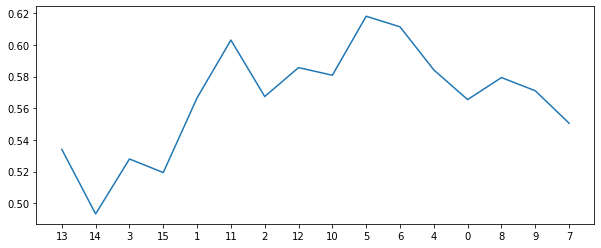

1021
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.575
specificity  0.5647812971342383
sensitivity  0.71
auc          0.6373906485671191


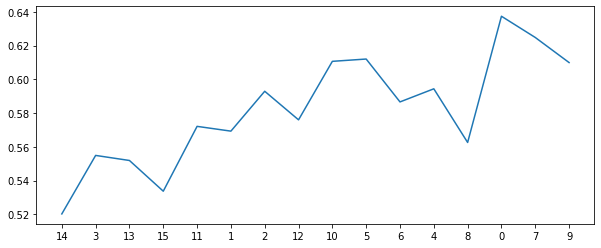

1022
all features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.5803167420814479
sensitivity  0.665
auc          0.622658371040724


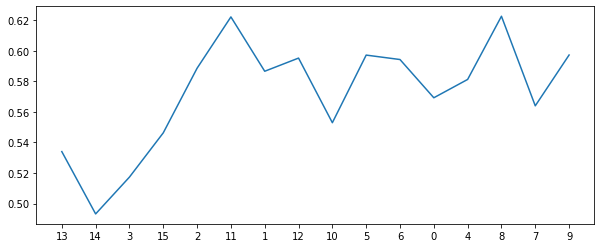

1023
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.5667420814479638
sensitivity  0.745
auc          0.655871040723982


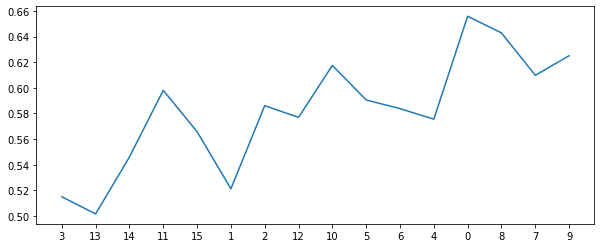

1024
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 0]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.5957767722473605
sensitivity  0.67
auc          0.6328883861236803


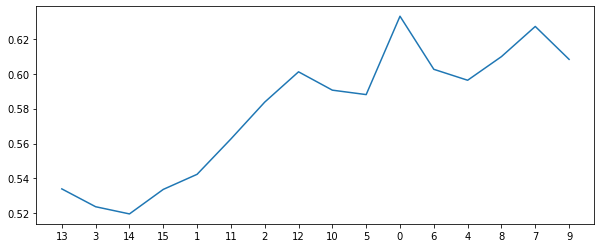

1025
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.583974358974359
sensitivity  0.76
auc          0.6719871794871795


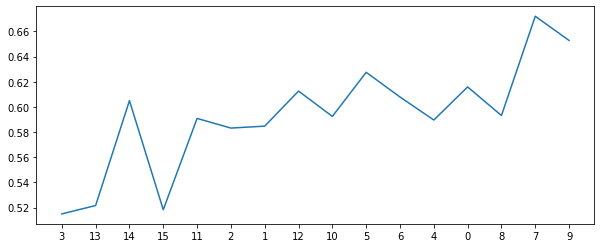

1026
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6918552036199095
sensitivity  0.49
auc          0.5909276018099547


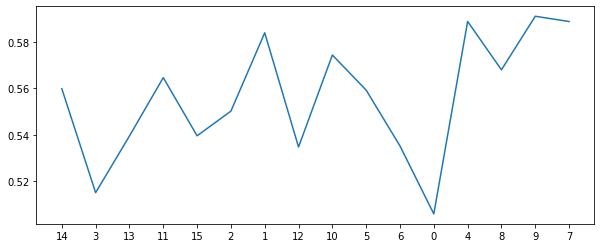

1027
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6669306184012066
sensitivity  0.595
auc          0.6309653092006033


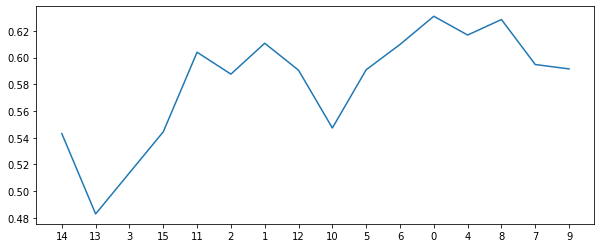

1028
all features [14, 13, 3, 11, 1, 15, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 13, 3, 11, 1, 15, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6964285714285714
specificity  0.7111613876319759
sensitivity  0.52
auc          0.6155806938159879


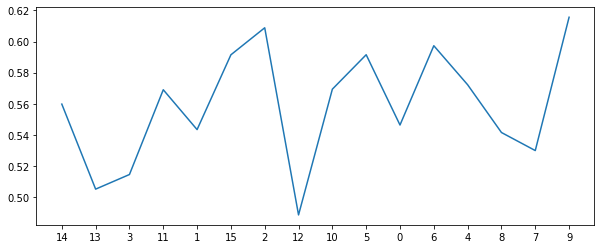

1029
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6946428571428571
specificity  0.7035067873303167
sensitivity  0.59
auc          0.6467533936651584


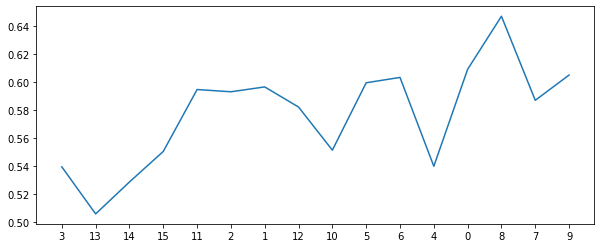

1030
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6976998491704374
sensitivity  0.495
auc          0.5963499245852186


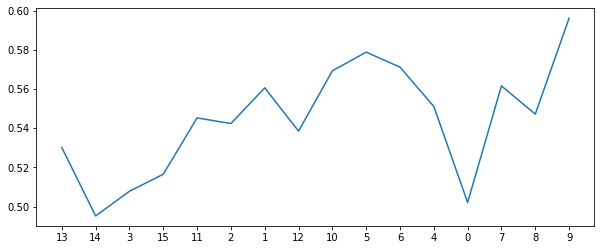

1031
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6938914027149321
sensitivity  0.585
auc          0.639445701357466


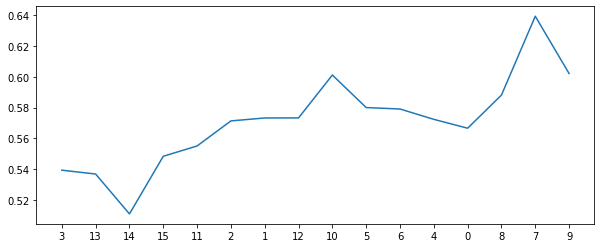

1032
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6591628959276018
sensitivity  0.585
auc          0.6220814479638009


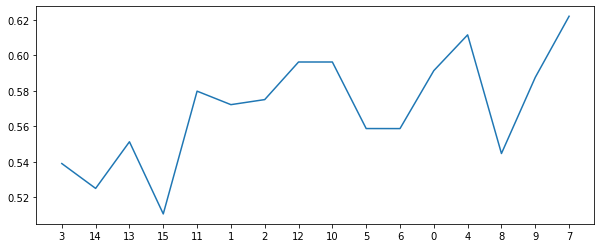

1033
all features [14, 15, 13, 3, 1, 11, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 15, 13, 3, 1, 11, 2, 12]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.601395173453997
sensitivity  0.695
auc          0.6481975867269985


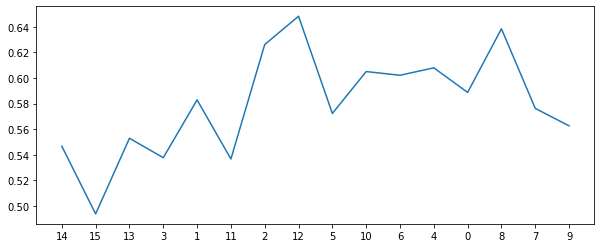

1034
all features [14, 3, 13, 11, 15, 2, 1, 12, 5, 10, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 5, 10, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6631221719457013
sensitivity  0.59
auc          0.6265610859728507


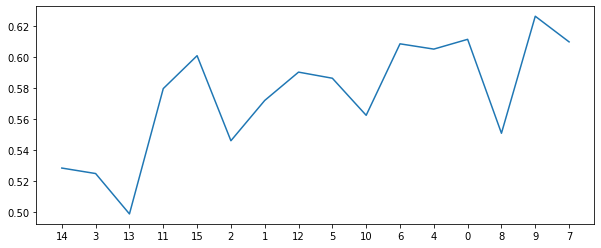

1035
all features [3, 14, 11, 15, 13, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 11, 15, 13, 2, 1, 12, 5, 10, 6, 4]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6380090497737556
sensitivity  0.62
auc          0.6290045248868779


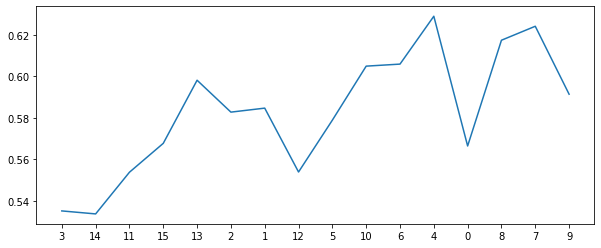

1036
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6392857142857142
specificity  0.6419683257918551
sensitivity  0.62
auc          0.6309841628959276


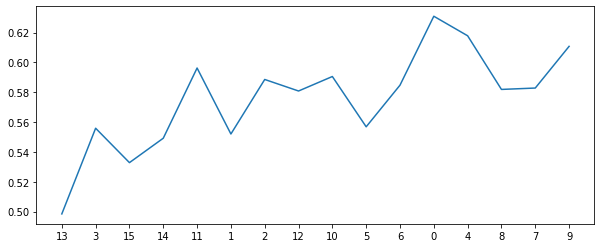

1037
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6495098039215687
sensitivity  0.64
auc          0.6447549019607843


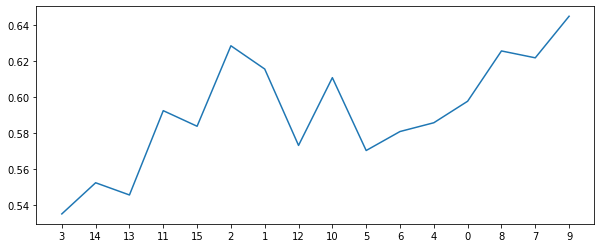

1038
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5660714285714286
specificity  0.5572775263951735
sensitivity  0.69
auc          0.6236387631975867


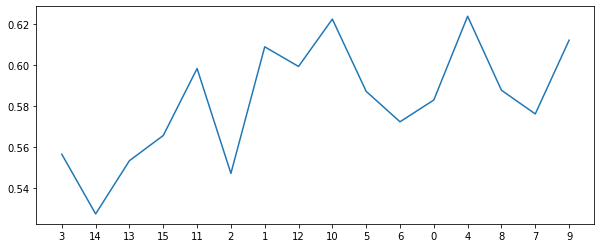

1039
all features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.628393665158371
sensitivity  0.67
auc          0.6491968325791855


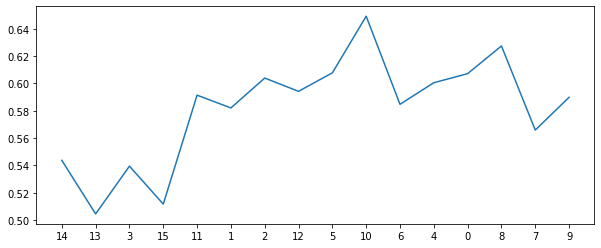

1040
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.6052413273001508
sensitivity  0.645
auc          0.6251206636500753


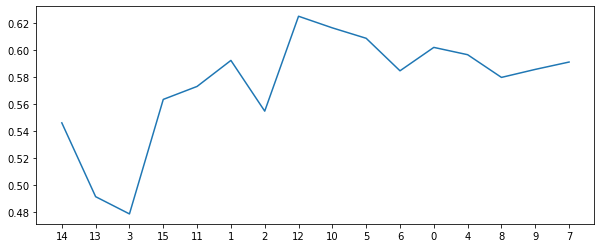

1041
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5860859728506788
sensitivity  0.74
auc          0.6630429864253393


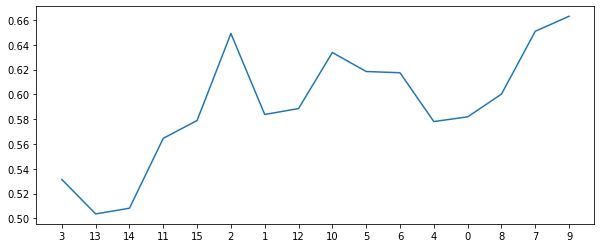

1042
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6380467571644042
sensitivity  0.62
auc          0.629023378582202


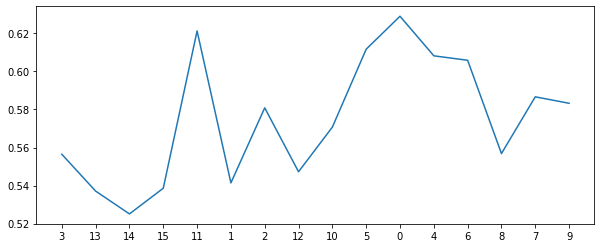

1043
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6283182503770739
sensitivity  0.62
auc          0.6241591251885369


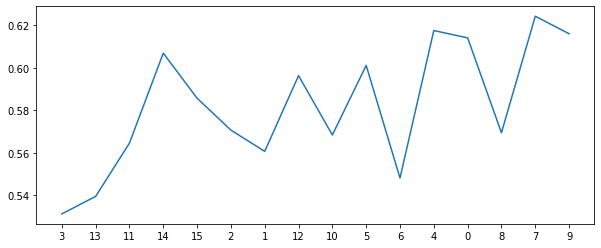

1044
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.65
specificity  0.6514705882352941
sensitivity  0.64
auc          0.645735294117647


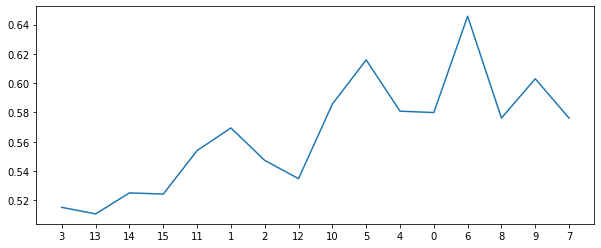

1045
all features [14, 13, 15, 11, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 11, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.675
specificity  0.6861613876319759
sensitivity  0.54
auc          0.613080693815988


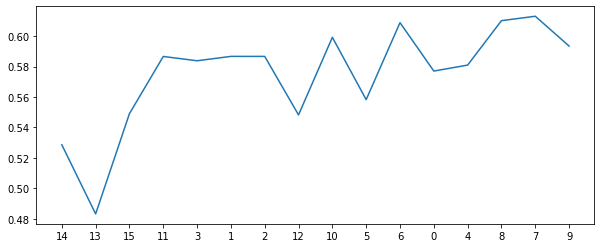

1046
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6996606334841629
sensitivity  0.495
auc          0.5973303167420815


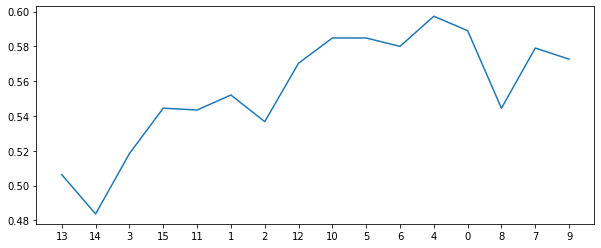

1047
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.670814479638009
sensitivity  0.595
auc          0.6329072398190045


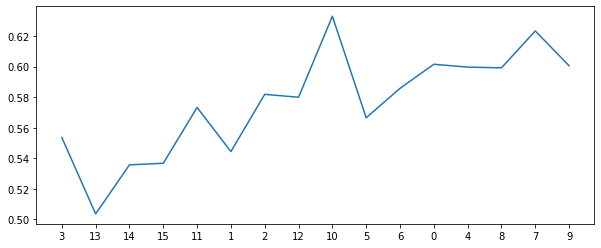

1048
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7054298642533936
sensitivity  0.545
auc          0.6252149321266969


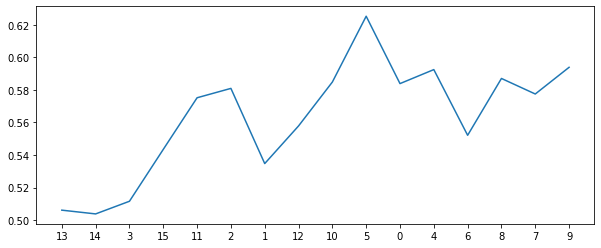

1049
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6707013574660633
sensitivity  0.545
auc          0.6078506787330317


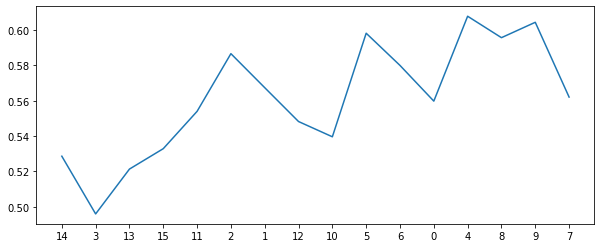

1050
all features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.5821428571428572
specificity  0.578318250377074
sensitivity  0.645
auc          0.6116591251885369


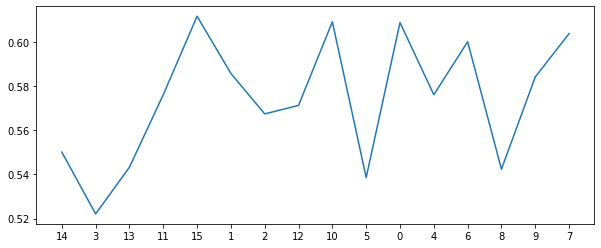

1051
all features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6437028657616893
sensitivity  0.69
auc          0.6668514328808446


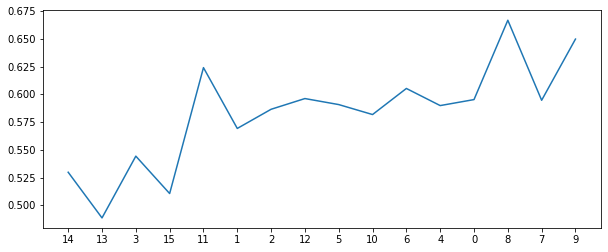

1052
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6455505279034691
sensitivity  0.59
auc          0.6177752639517345


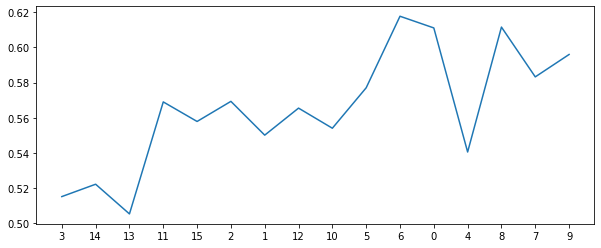

1053
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6302790346907994
sensitivity  0.645
auc          0.6376395173453997


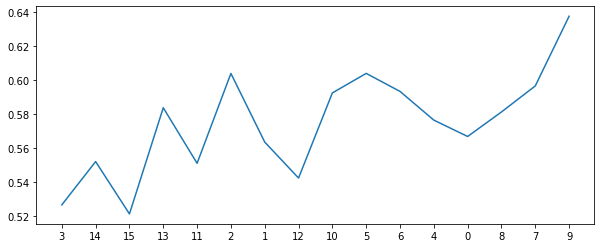

1054
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.653393665158371
sensitivity  0.595
auc          0.6241968325791855


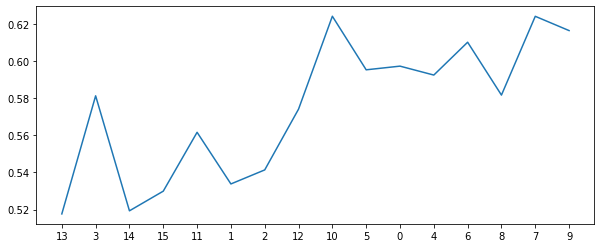

1055
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6207013574660634
sensitivity  0.665
auc          0.6428506787330317


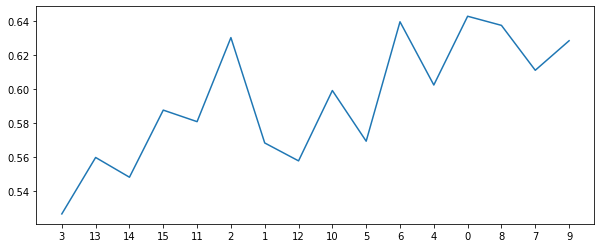

1056
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5803571428571429
specificity  0.5707013574660633
sensitivity  0.72
auc          0.6453506787330316


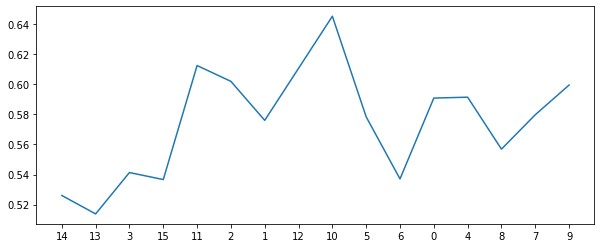

1057
all features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5714285714285714
specificity  0.5629336349924585
sensitivity  0.69
auc          0.6264668174962292


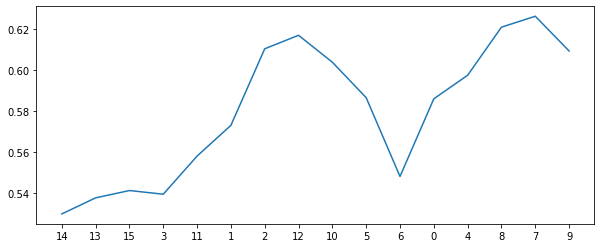

1058
all features [14, 3, 13, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5732142857142857
specificity  0.5667043740573152
sensitivity  0.67
auc          0.6183521870286576


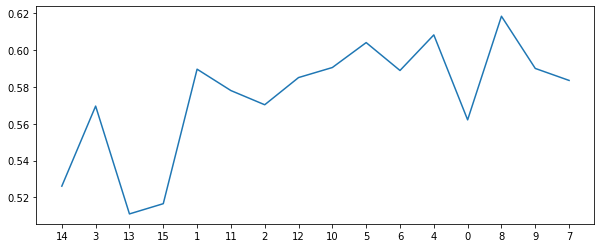

1059
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5706259426847662
sensitivity  0.715
auc          0.6428129713423831


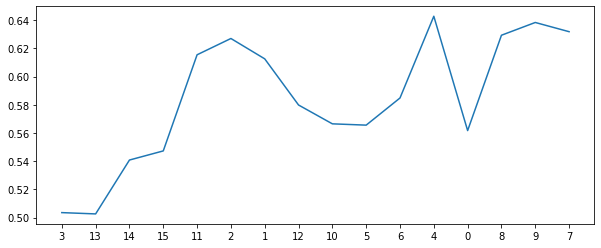

1060
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6417420814479639
sensitivity  0.64
auc          0.6408710407239819


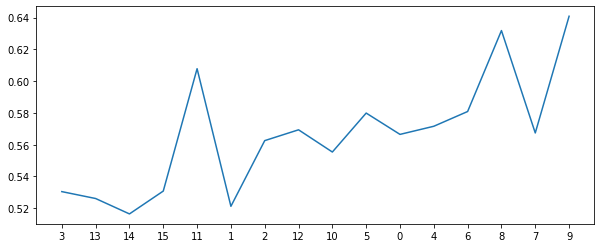

1061
all features [3, 13, 11, 15, 14, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6125
specificity  0.6071644042232277
sensitivity  0.685
auc          0.6460822021116138


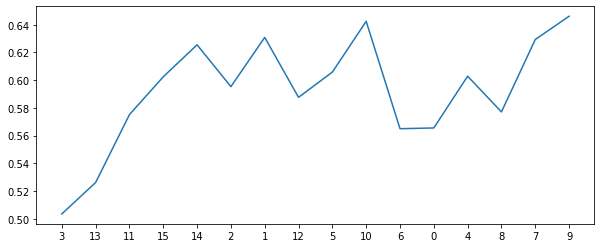

1062
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.666892911010558
sensitivity  0.59
auc          0.628446455505279


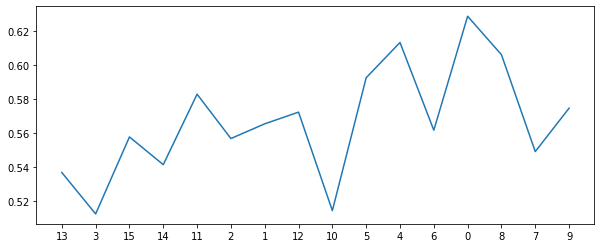

1063
all features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6938914027149321
sensitivity  0.56
auc          0.6269457013574661


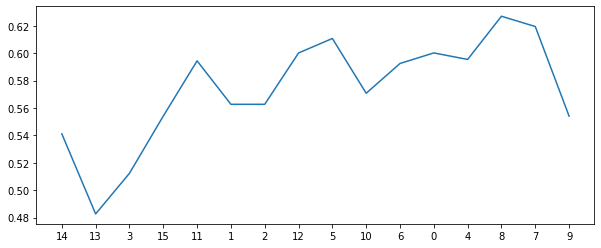

1064
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6910714285714286
specificity  0.7014328808446455
sensitivity  0.565
auc          0.6332164404223228


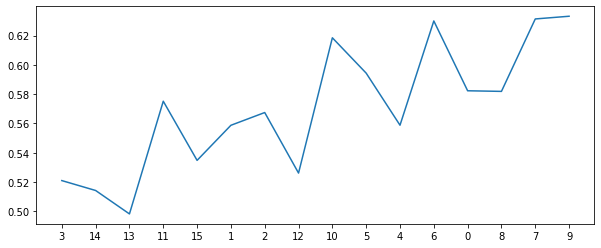

1065
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.675
specificity  0.6861236802413273
sensitivity  0.545
auc          0.6155618401206636


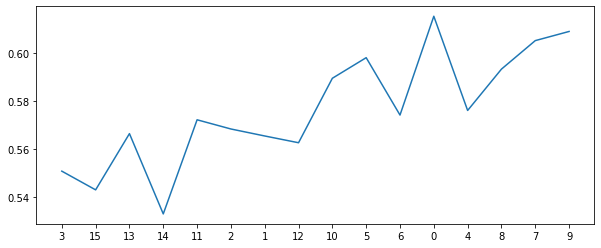

1066
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7130844645550528
sensitivity  0.52
auc          0.6165422322775264


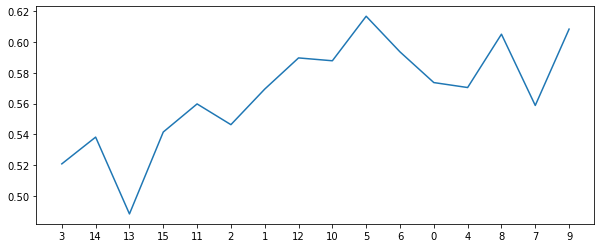

1067
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7015460030165912
sensitivity  0.57
auc          0.6357730015082956


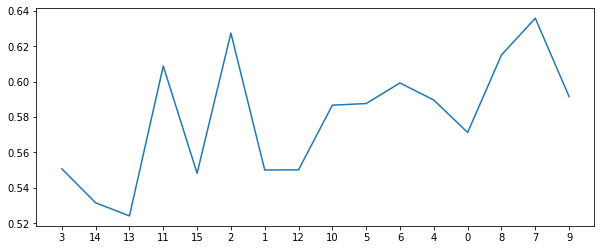

1068
all features [13, 14, 3, 2, 11, 1, 15, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [13, 14, 3, 2, 11, 1, 15, 12, 10]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6034313725490196
sensitivity  0.695
auc          0.6492156862745098


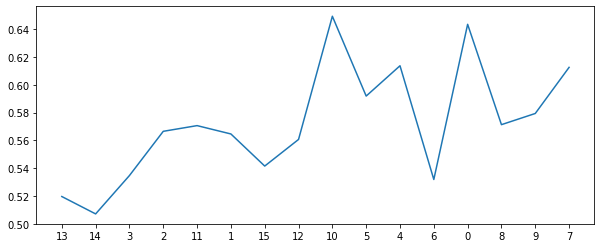

1069
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.625
specificity  0.6264705882352941
sensitivity  0.615
auc          0.620735294117647


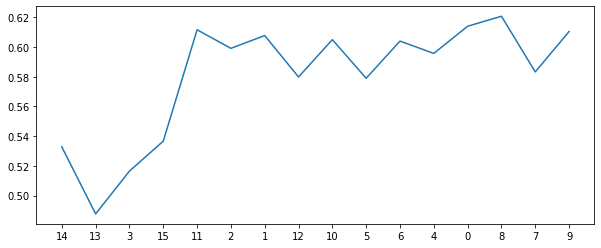

1070
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6553921568627451
sensitivity  0.57
auc          0.6126960784313725


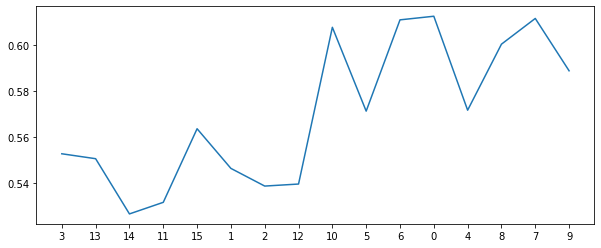

1071
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6149698340874812
sensitivity  0.645
auc          0.6299849170437406


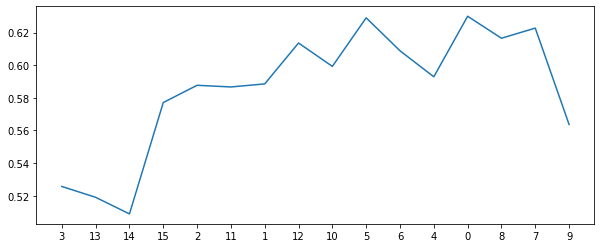

1072
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6592006033182504
sensitivity  0.595
auc          0.6271003016591252


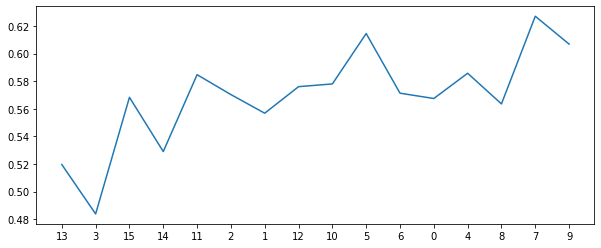

1073
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6130090497737557
sensitivity  0.67
auc          0.6415045248868778


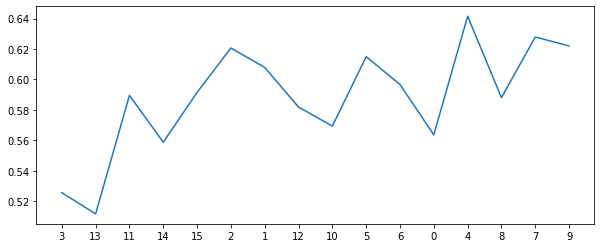

1074
all features [14, 3, 13, 11, 2, 15, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 13, 11, 2, 15, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5956636500754148
sensitivity  0.635
auc          0.6153318250377073


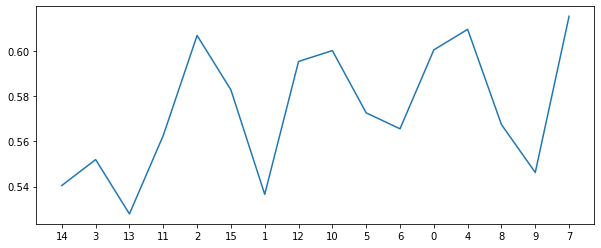

1075
all features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5665158371040724
sensitivity  0.715
auc          0.6407579185520362


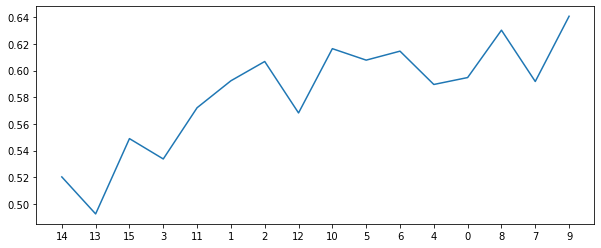

1076
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6014328808446455
sensitivity  0.67
auc          0.6357164404223228


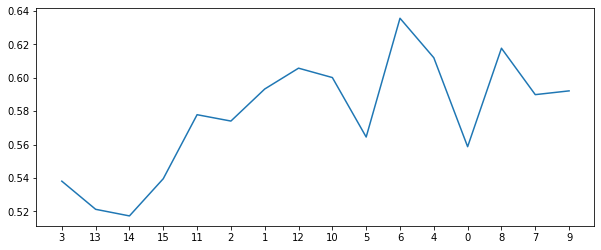

1077
all features [14, 3, 13, 11, 15, 2, 1, 12, 5, 10, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5706259426847662
sensitivity  0.72
auc          0.6453129713423831


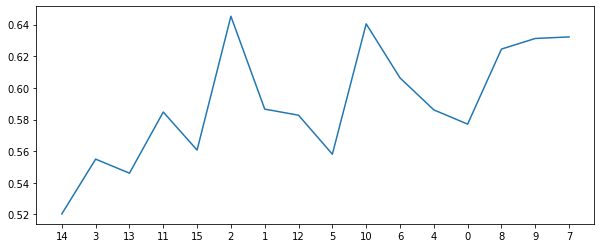

1078
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.625
specificity  0.6245098039215686
sensitivity  0.64
auc          0.6322549019607843


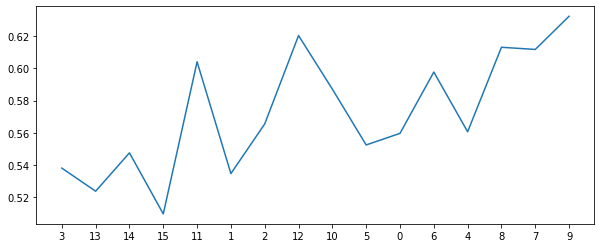

1079
all features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5957013574660633
sensitivity  0.665
auc          0.6303506787330316


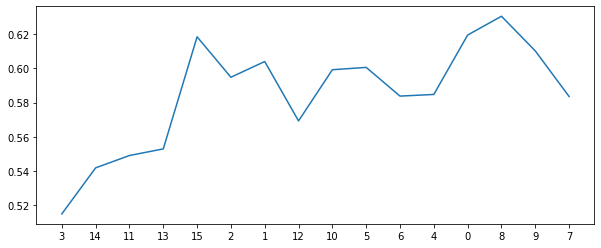

1080
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7072775263951735
sensitivity  0.59
auc          0.6486387631975867


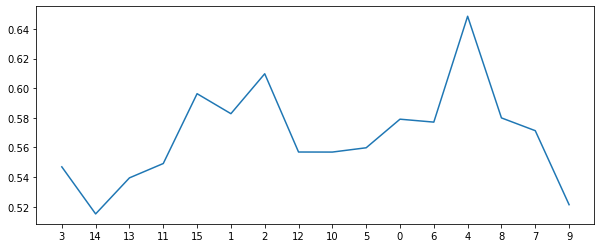

1081
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6361613876319758
sensitivity  0.595
auc          0.6155806938159879


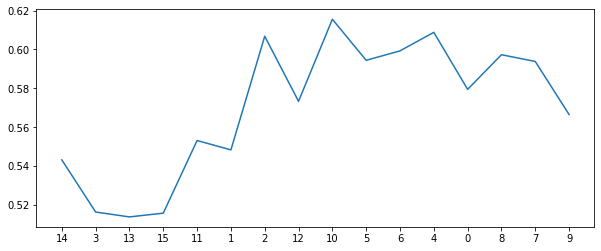

1082
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7053571428571428
specificity  0.718815987933635
sensitivity  0.54
auc          0.6294079939668175


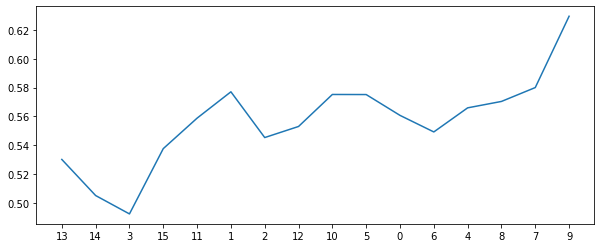

1083
all features [14, 3, 15, 13, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6900075414781297
sensitivity  0.545
auc          0.6175037707390649


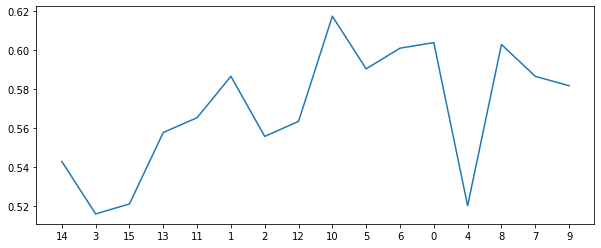

1084
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7035444947209653
sensitivity  0.52
auc          0.6117722473604826


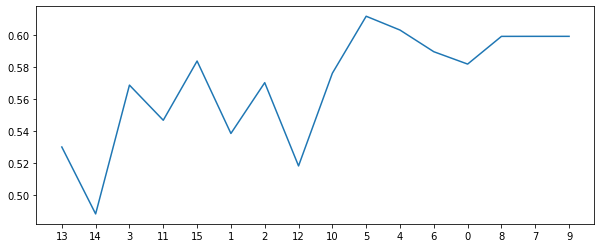

1085
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.695814479638009
sensitivity  0.52
auc          0.6079072398190045


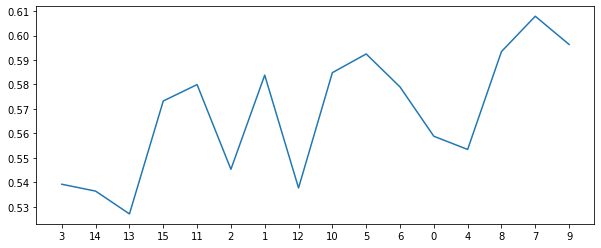

1086
all features [3, 13, 14, 11, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6340874811463046
sensitivity  0.615
auc          0.6245437405731523


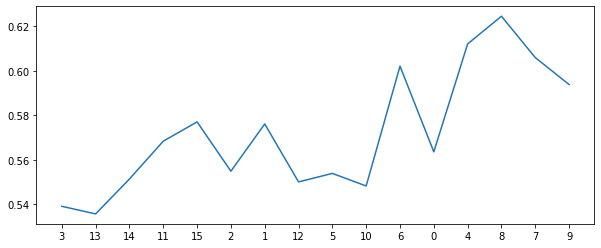

1087
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.641817496229261
sensitivity  0.64
auc          0.6409087481146305


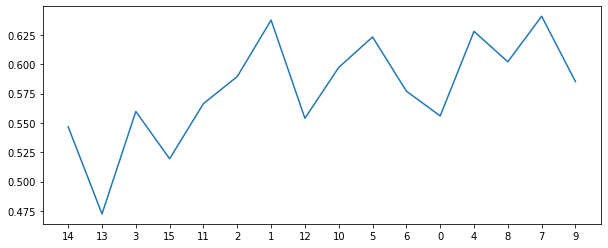

1088
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6375
specificity  0.6398944193061841
sensitivity  0.615
auc          0.627447209653092


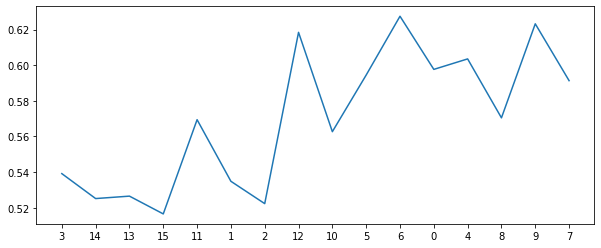

1089
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6341628959276018
sensitivity  0.64
auc          0.637081447963801


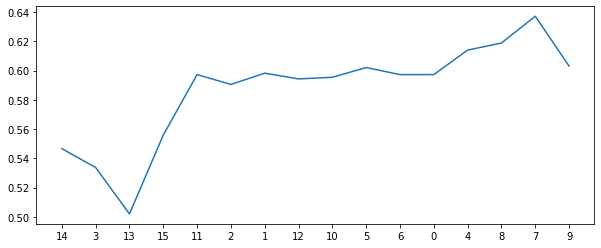

1090
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.65
specificity  0.6590874811463047
sensitivity  0.545
auc          0.6020437405731524


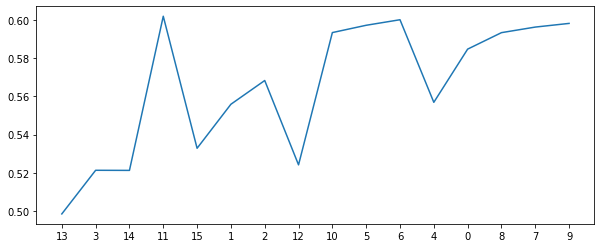

1091
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6456636500754148
sensitivity  0.615
auc          0.6303318250377073


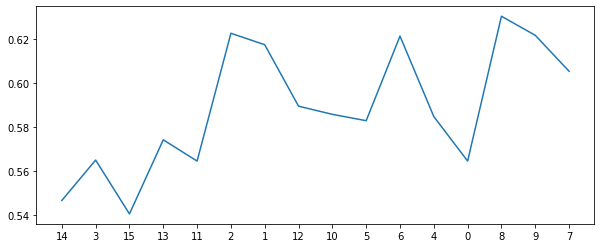

1092
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 1]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5321428571428571
specificity  0.5206636500754148
sensitivity  0.695
auc          0.6078318250377074


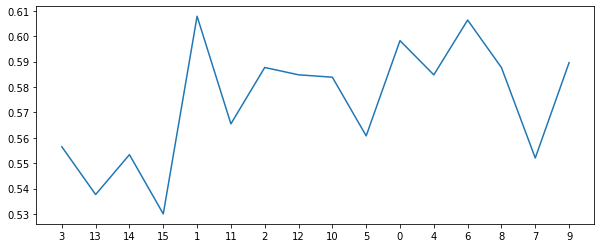

1093
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5897058823529412
sensitivity  0.665
auc          0.6273529411764706


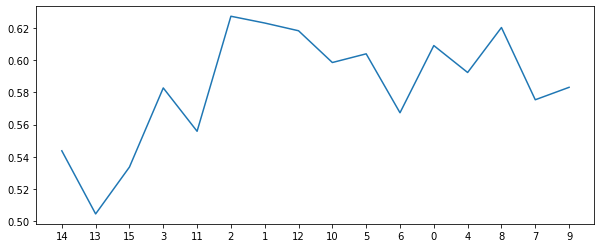

1094
all features [13, 3, 14, 15, 1, 11, 12, 2, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 12, 2]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6071644042232277
sensitivity  0.645
auc          0.6260822021116139


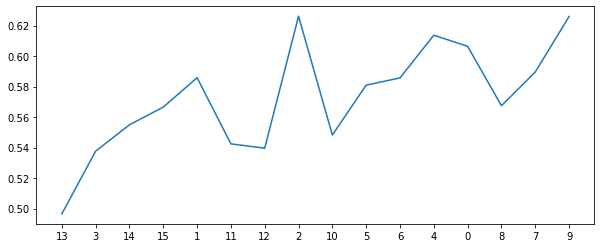

1095
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5875
specificity  0.5782805429864253
sensitivity  0.715
auc          0.6466402714932127


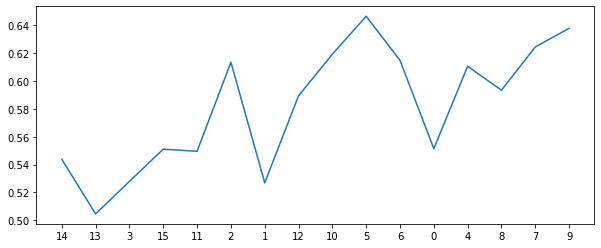

1096
all features [3, 13, 11, 14, 1, 15, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 11, 14, 1, 15, 2, 12, 10, 5, 4, 0, 6]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6573529411764706
sensitivity  0.545
auc          0.6011764705882353


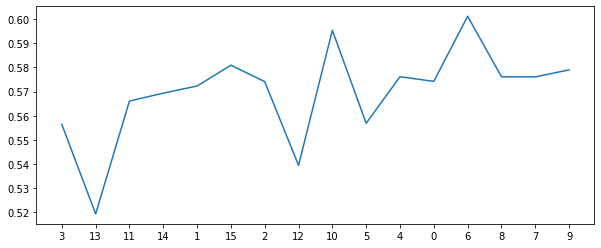

1097
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.6032428355957767
sensitivity  0.64
auc          0.6216214177978884


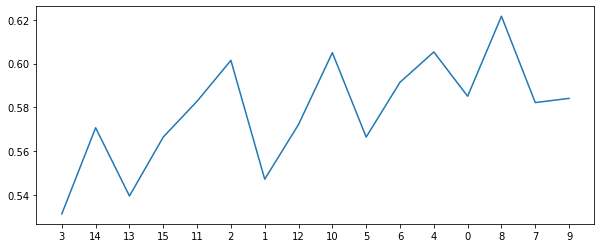

1098
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.684238310708899
sensitivity  0.595
auc          0.6396191553544495


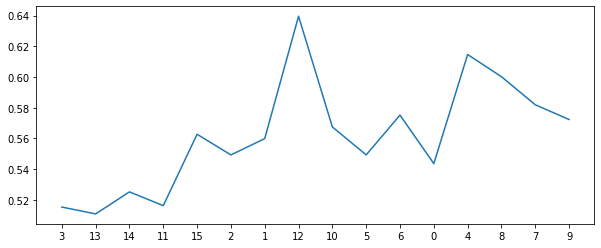

1099
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6957013574660633
sensitivity  0.545
auc          0.6203506787330316


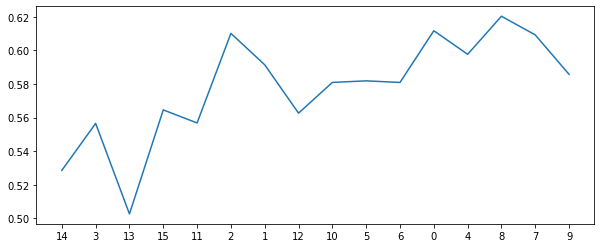

1100
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.693815987933635
sensitivity  0.52
auc          0.6069079939668175


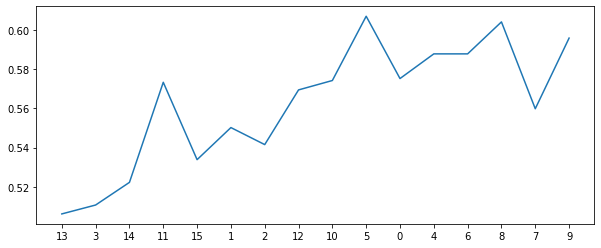

1101
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.65
specificity  0.6532428355957768
sensitivity  0.62
auc          0.6366214177978884


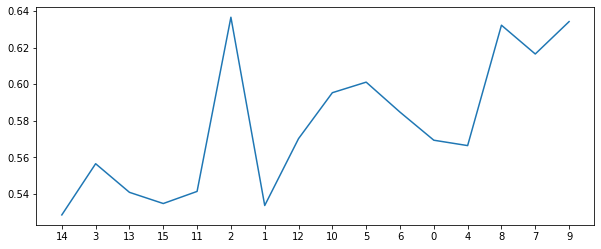

1102
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6964285714285714
specificity  0.7112745098039216
sensitivity  0.515
auc          0.6131372549019608


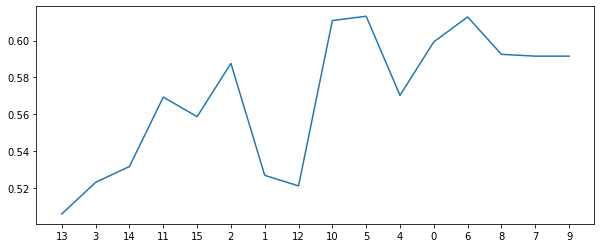

1103
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6860859728506787
sensitivity  0.565
auc          0.6255429864253393


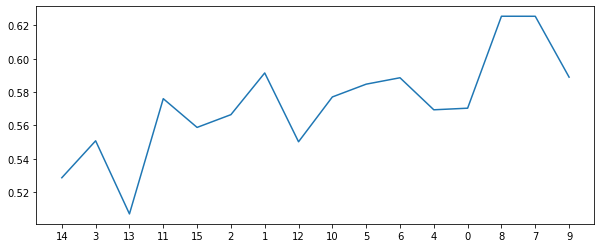

1104
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6071266968325791
sensitivity  0.645
auc          0.6260633484162896


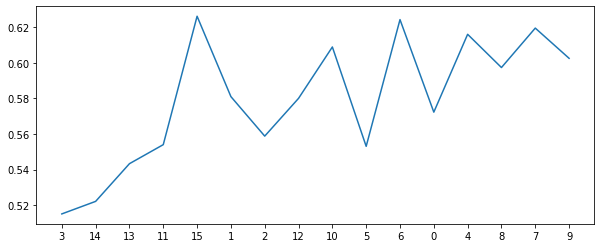

1105
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6109351432880845
sensitivity  0.62
auc          0.6154675716440422


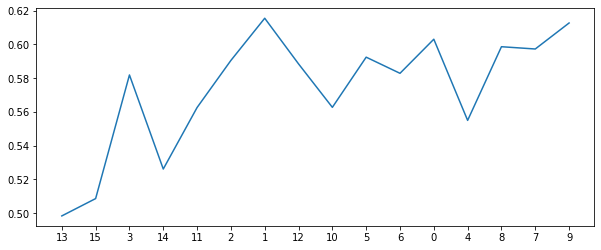

1106
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6398190045248869
sensitivity  0.59
auc          0.6149095022624435


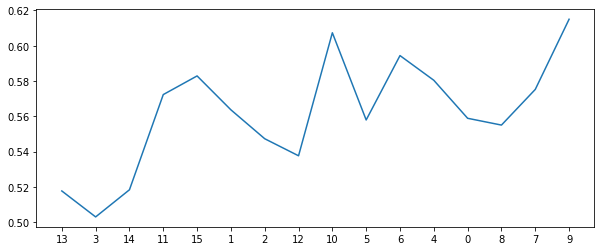

1107
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.625
specificity  0.6225867269984917
sensitivity  0.665
auc          0.6437933634992459


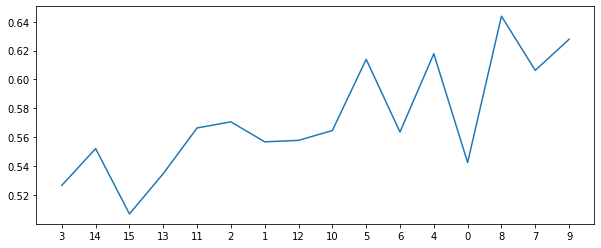

1108
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6726998491704375
sensitivity  0.64
auc          0.6563499245852187


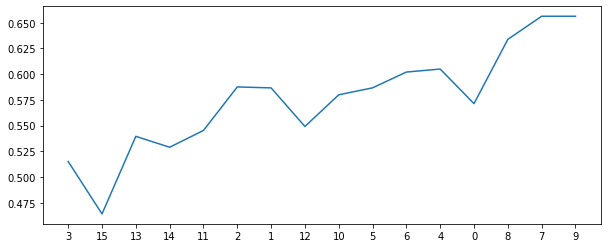

1109
all features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6436651583710408
sensitivity  0.615
auc          0.6293325791855203


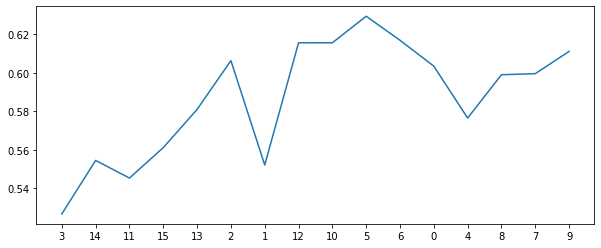

1110
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6051282051282051
sensitivity  0.67
auc          0.6375641025641026


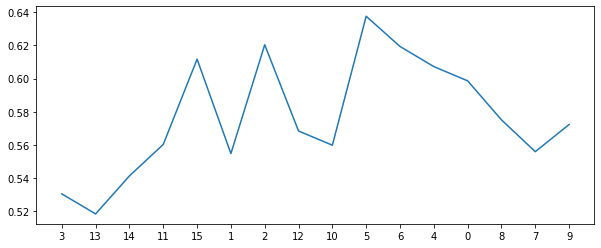

1111
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5763574660633485
sensitivity  0.69
auc          0.6331787330316742


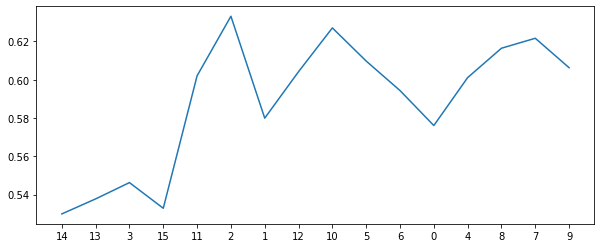

1112
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6147435897435898
sensitivity  0.665
auc          0.6398717948717948


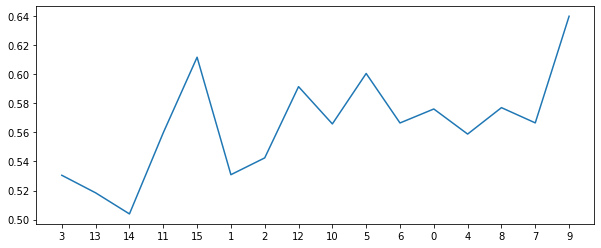

1113
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5840120663650076
sensitivity  0.695
auc          0.6395060331825038


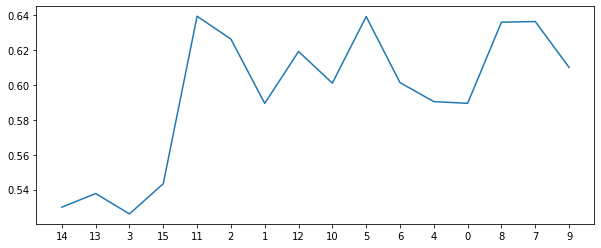

1114
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6033182503770739
sensitivity  0.635
auc          0.619159125188537


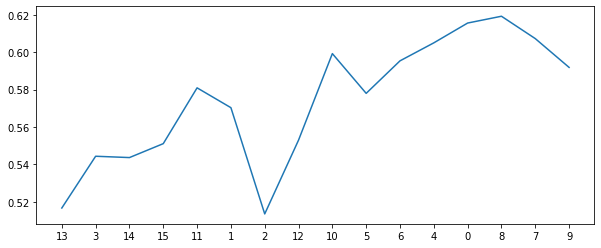

1115
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5841251885369533
sensitivity  0.74
auc          0.6620625942684766


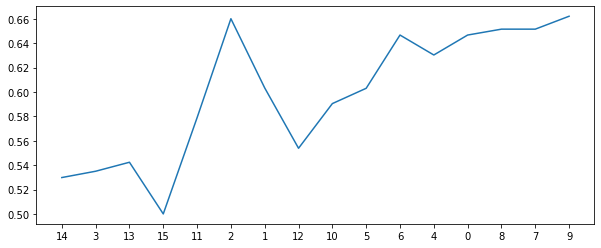

1116
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.668815987933635
sensitivity  0.615
auc          0.6419079939668175


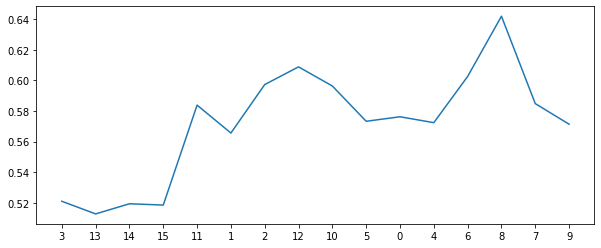

1117
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6630090497737556
sensitivity  0.585
auc          0.6240045248868779


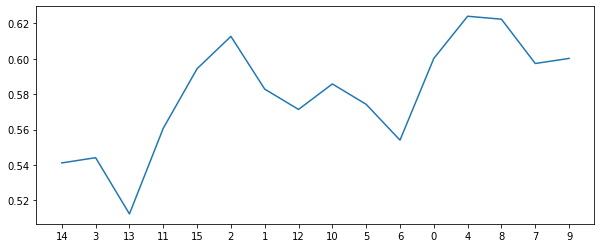

1118
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7053544494720965
sensitivity  0.615
auc          0.6601772247360482


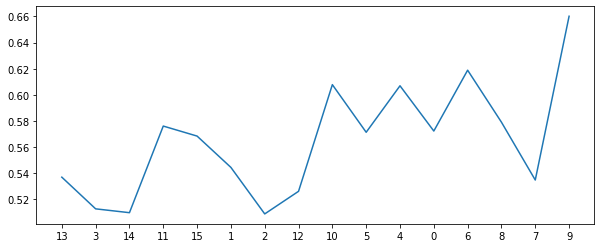

1119
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6625
specificity  0.6688536953242835
sensitivity  0.595
auc          0.6319268476621418


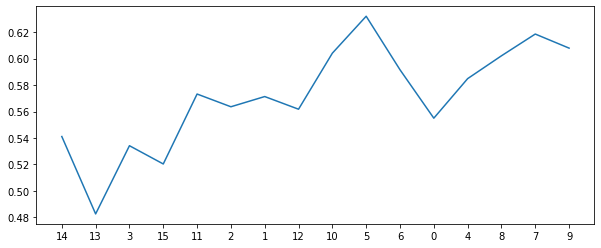

1120
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.693815987933635
sensitivity  0.52
auc          0.6069079939668175


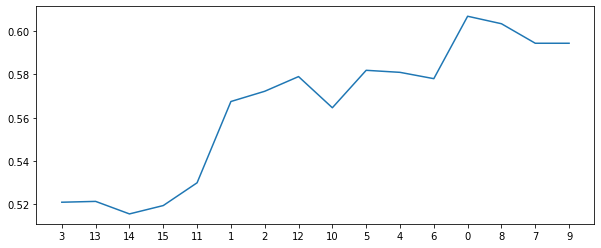

1121
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.675
specificity  0.686236802413273
sensitivity  0.54
auc          0.6131184012066365


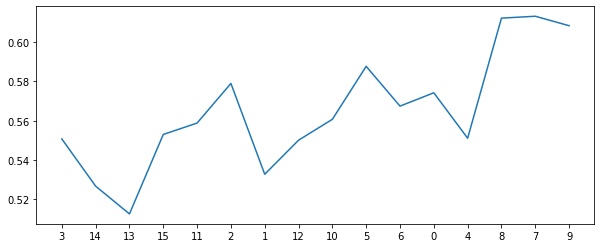

1122
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5840874811463047
sensitivity  0.695
auc          0.6395437405731523


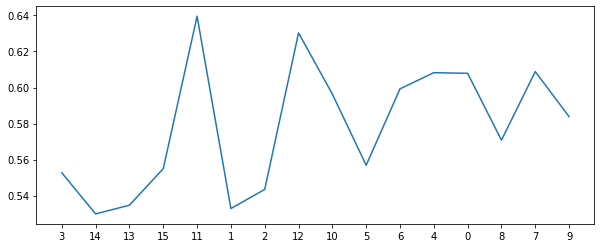

1123
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6380090497737556
sensitivity  0.685
auc          0.6615045248868778


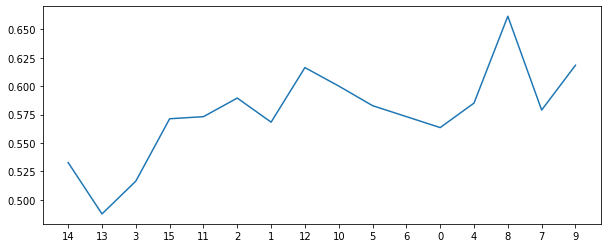

1124
all features [3, 13, 14, 11, 1, 15, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 1, 15, 2, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.65
specificity  0.6553921568627451
sensitivity  0.595
auc          0.6251960784313726


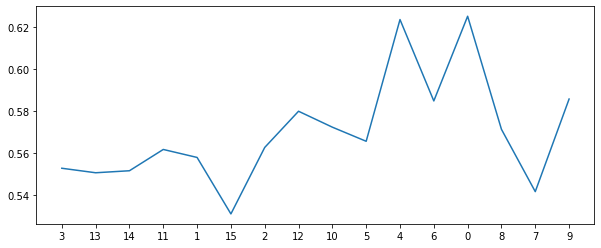

1125
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6187782805429864
sensitivity  0.62
auc          0.6193891402714932


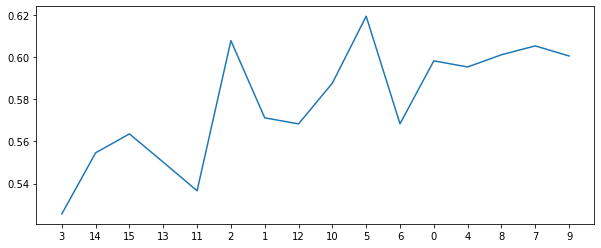

1126
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.595
auc          0.6136199095022624


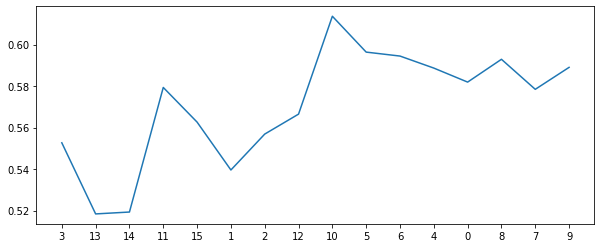

1127
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 3, 0, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6168552036199095
sensitivity  0.67
auc          0.6434276018099547


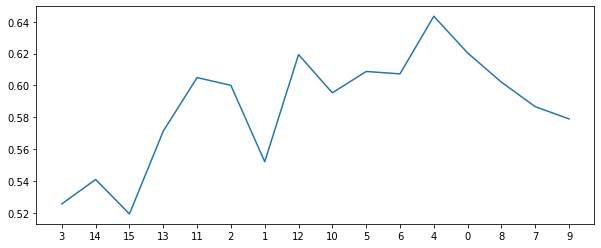

1128
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5918929110105581
sensitivity  0.645
auc          0.6184464555052791


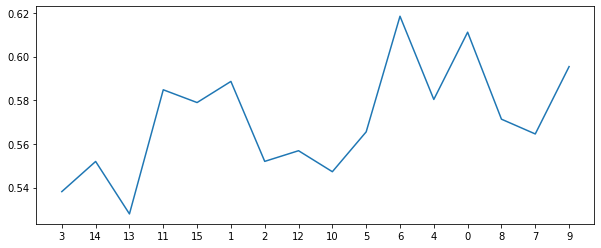

1129
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.55
specificity  0.5379336349924585
sensitivity  0.715
auc          0.6264668174962292


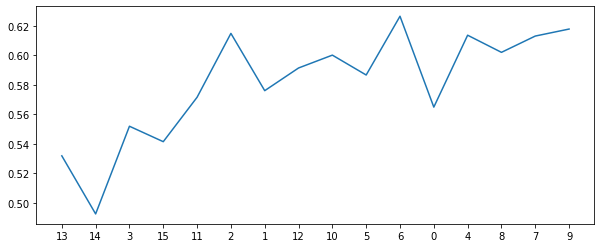

1130
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6070889894419306
sensitivity  0.66
auc          0.6335444947209653


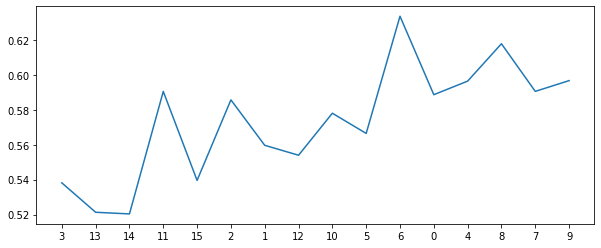

1131
all features [14, 15, 3, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 15, 3, 13, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.6
specificity  0.5918552036199095
sensitivity  0.72
auc          0.6559276018099547


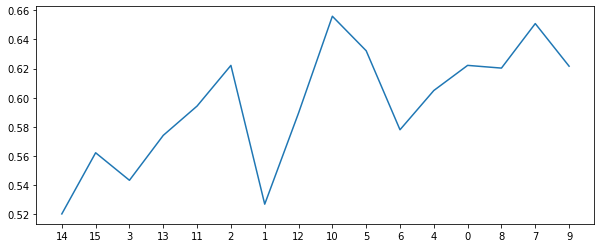

1132
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.5974358974358974
sensitivity  0.645
auc          0.6212179487179488


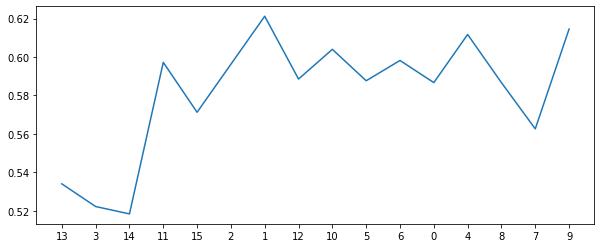

1133
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5937782805429864
sensitivity  0.67
auc          0.6318891402714932


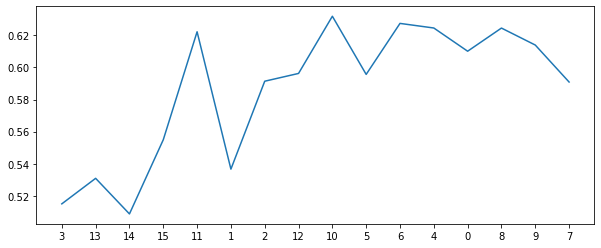

1134
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6714285714285714
specificity  0.6822775263951735
sensitivity  0.545
auc          0.6136387631975867


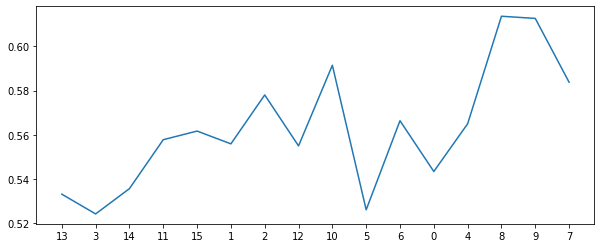

1135
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6766214177978884
sensitivity  0.57
auc          0.6233107088989442


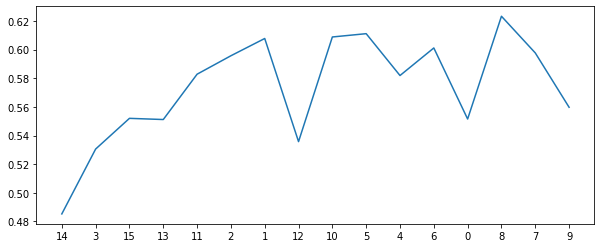

1136
all features [14, 13, 3, 2, 15, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 2, 15, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6900452488687783
sensitivity  0.62
auc          0.6550226244343892


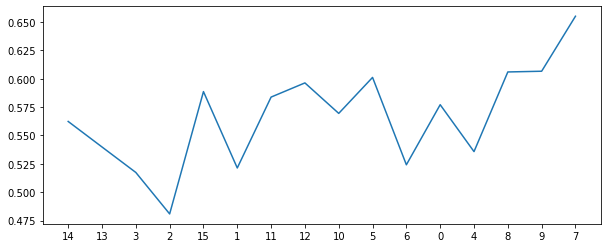

1137
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.691892911010558
sensitivity  0.57
auc          0.630946455505279


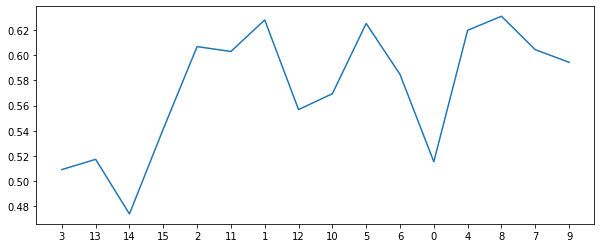

1138
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6668552036199095
sensitivity  0.545
auc          0.6059276018099548


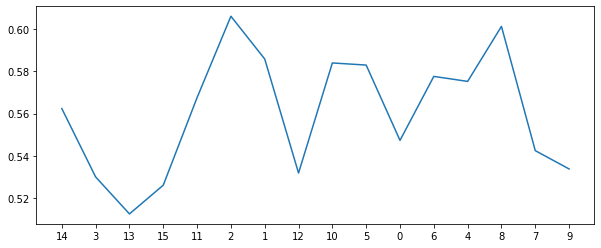

1139
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6649321266968325
sensitivity  0.59
auc          0.6274660633484163


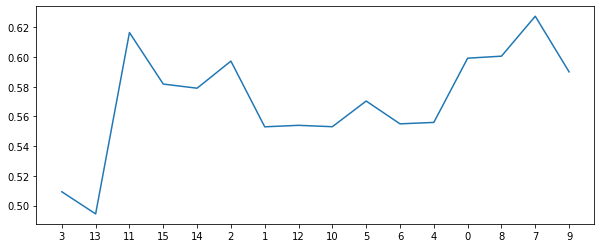

1140
all features [13, 14, 3, 1, 11, 2, 15, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 1, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5897435897435898
sensitivity  0.645
auc          0.6173717948717948


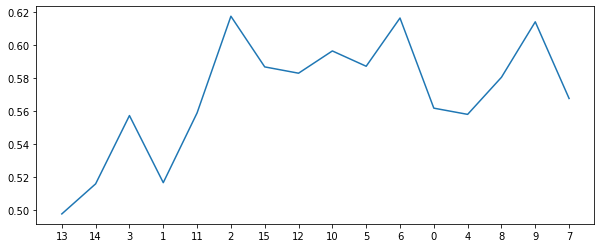

1141
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.551395173453997
sensitivity  0.79
auc          0.6706975867269985


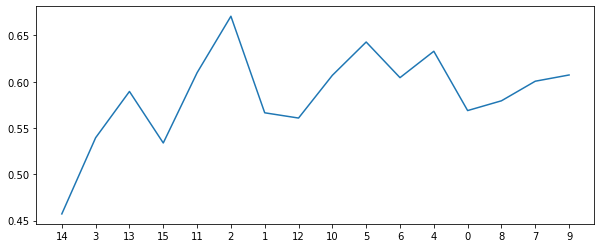

1142
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.643815987933635
sensitivity  0.62
auc          0.6319079939668175


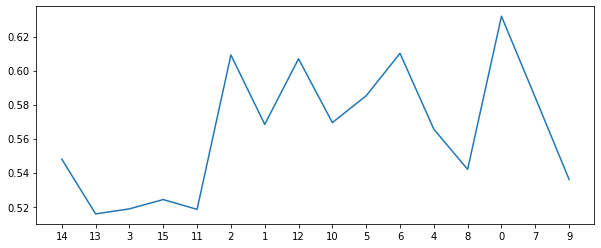

1143
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6124999999999999
specificity  0.6072021116138763
sensitivity  0.685
auc          0.6461010558069382


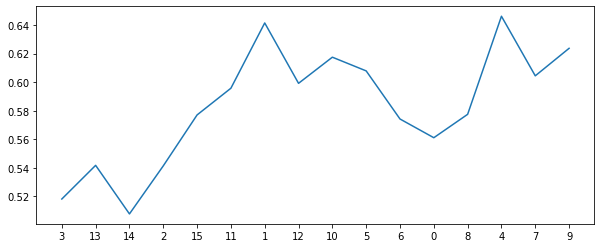

1144
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6361613876319758
sensitivity  0.59
auc          0.613080693815988


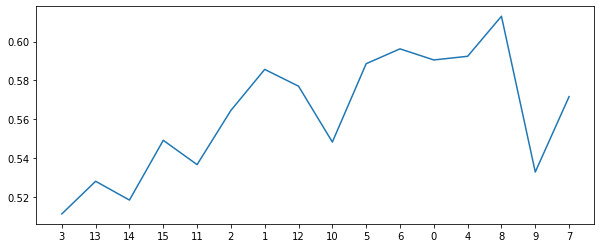

1145
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6410714285714285
specificity  0.6398944193061841
sensitivity  0.665
auc          0.652447209653092


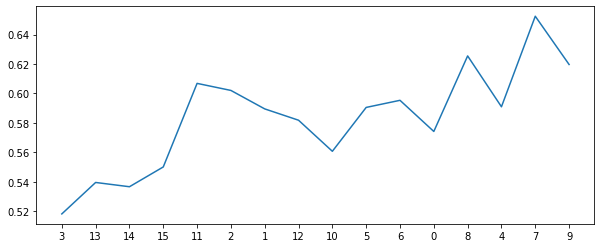

1146
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5696428571428571
specificity  0.5610482654600302
sensitivity  0.69
auc          0.6255241327300151


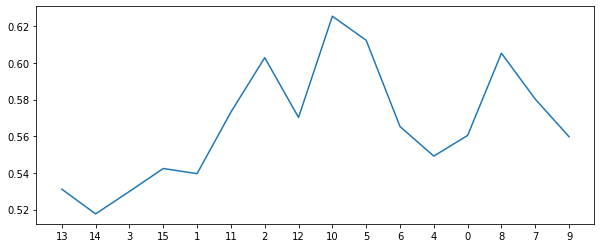

1147
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5517857142857143
specificity  0.5377828054298642
sensitivity  0.74
auc          0.6388914027149322


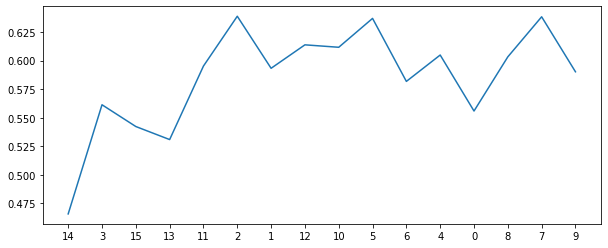

1148
all features [14, 13, 15, 3, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 15, 3, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5897058823529412
sensitivity  0.66
auc          0.6248529411764706


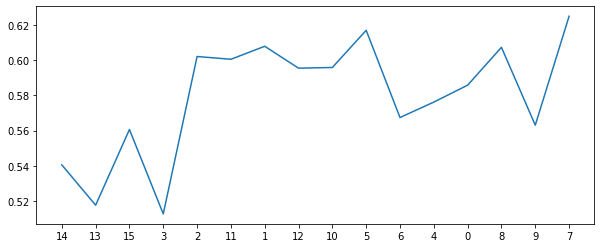

1149
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.5628582202111614
sensitivity  0.785
auc          0.6739291101055807


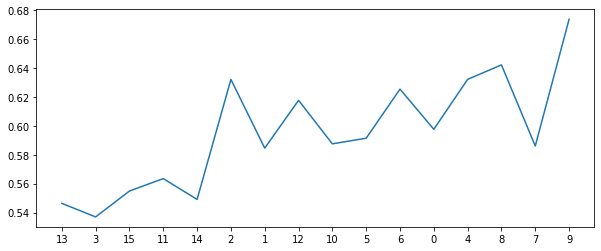

1150
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6375
specificity  0.641892911010558
sensitivity  0.595
auc          0.618446455505279


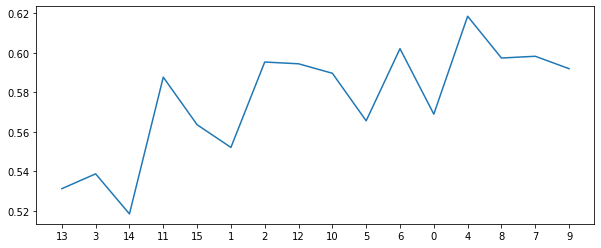

1151
all features [3, 11, 13, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 11, 13, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6129336349924586
sensitivity  0.66
auc          0.6364668174962292


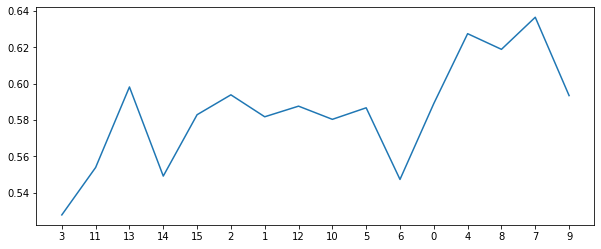

1152
all features [13, 3, 15, 14, 1, 11, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 1, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6360105580693816
sensitivity  0.57
auc          0.6030052790346908


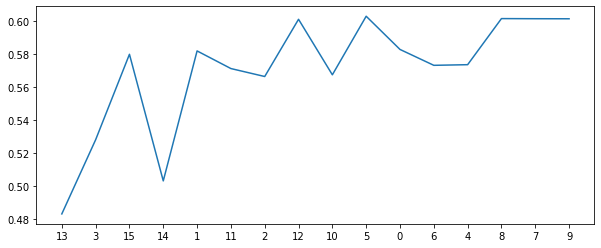

1153
all features [14, 3, 15, 13, 2, 11, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [14, 3, 15, 13, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6732142857142858
specificity  0.680316742081448
sensitivity  0.59
auc          0.6351583710407239


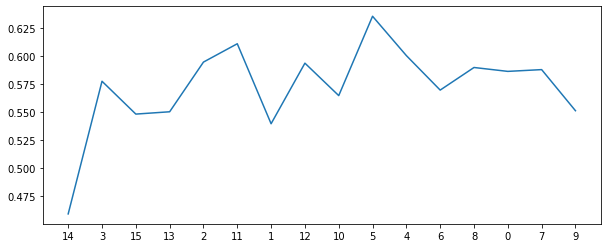

1154
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.7017857142857142
specificity  0.7150829562594269
sensitivity  0.545
auc          0.6300414781297135


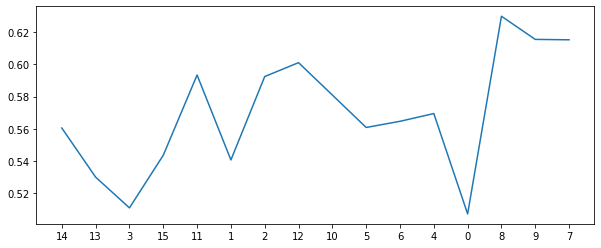

1155
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6206636500754148
sensitivity  0.67
auc          0.6453318250377074


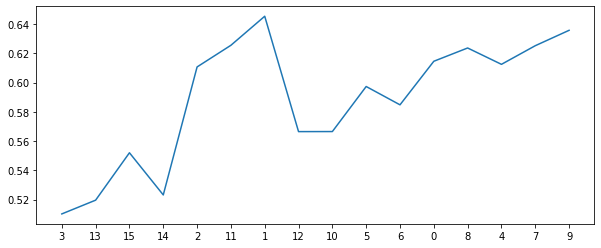

1156
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.7015837104072398
sensitivity  0.495
auc          0.5982918552036198


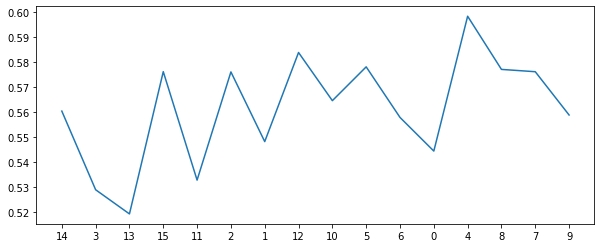

1157
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6696428571428572
specificity  0.6784313725490196
sensitivity  0.565
auc          0.6217156862745098


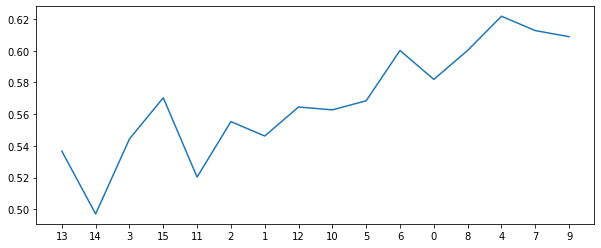

1158
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6265082956259427
sensitivity  0.645
auc          0.6357541478129713


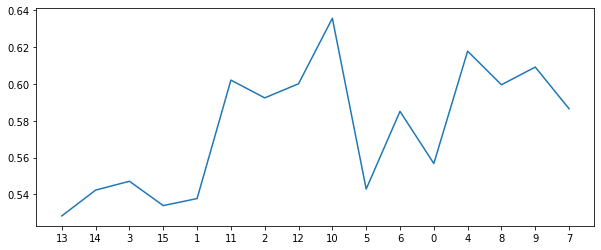

1159
all features [14, 13, 3, 15, 11, 2, 1, 12, 5, 10, 4, 6, 8, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 5, 10]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5899321266968326
sensitivity  0.715
auc          0.6524660633484163


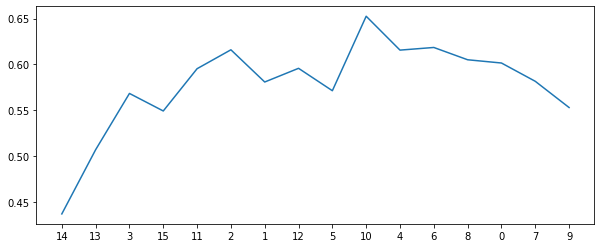

1160
all features [14, 13, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6375
specificity  0.6399698340874811
sensitivity  0.62
auc          0.6299849170437406


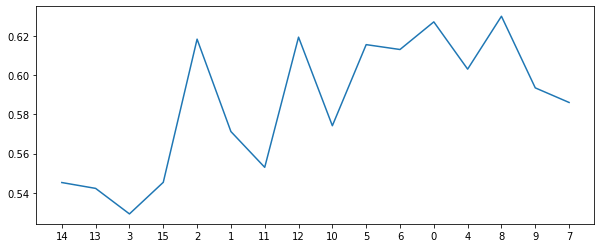

1161
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6
specificity  0.5879336349924585
sensitivity  0.76
auc          0.6739668174962293


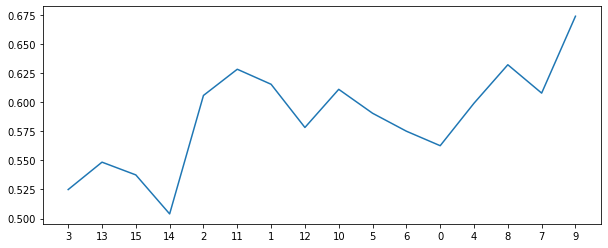

1162
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6437405731523379
sensitivity  0.615
auc          0.6293702865761689


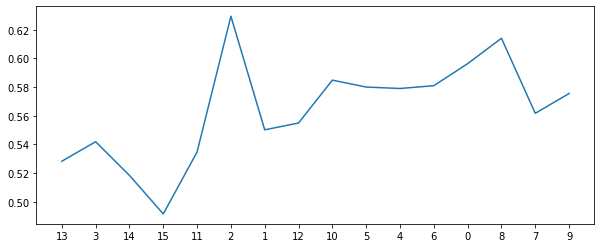

1163
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6283182503770739
sensitivity  0.685
auc          0.656659125188537


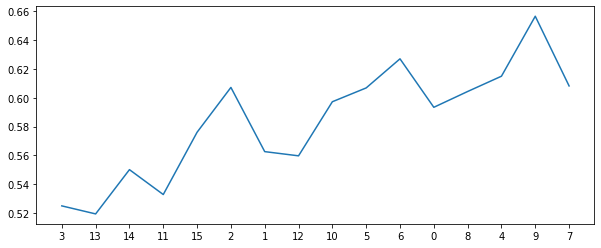

1164
all features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5803921568627451
sensitivity  0.64
auc          0.6101960784313726


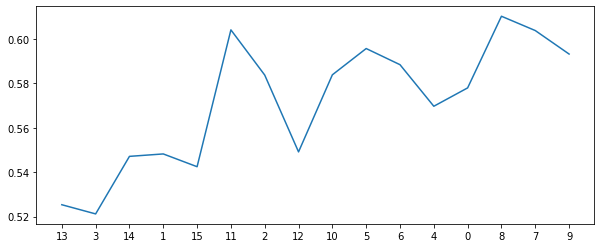

1165
all features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5517857142857143
specificity  0.5380090497737556
sensitivity  0.74
auc          0.6390045248868779


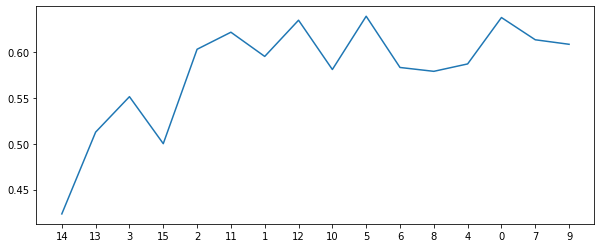

1166
all features [14, 13, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5357142857142857
specificity  0.5205882352941177
sensitivity  0.745
auc          0.6327941176470588


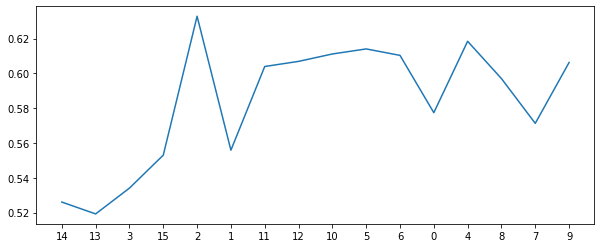

1167
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5570889894419306
sensitivity  0.835
auc          0.6960444947209653


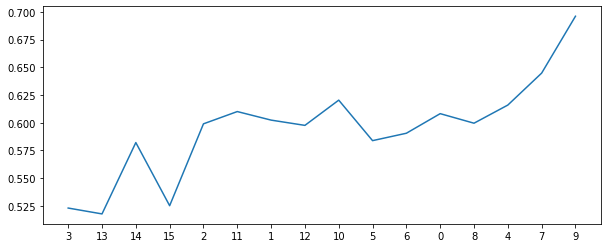

1168
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5880467571644042
sensitivity  0.62
auc          0.6040233785822021


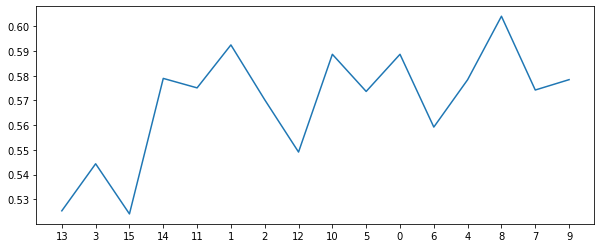

1169
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 11]
[0.4, 2, 1000, 3, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5446428571428571
specificity  0.5300904977375566
sensitivity  0.74
auc          0.6350452488687782


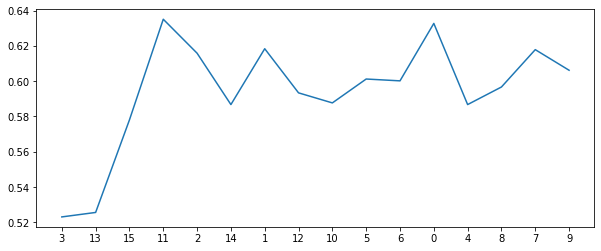

1170
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.684238310708899
sensitivity  0.545
auc          0.6146191553544494


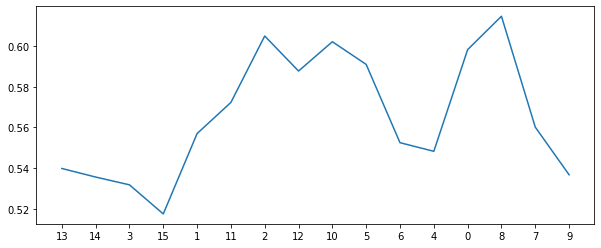

1171
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6245852187028658
sensitivity  0.67
auc          0.6472926093514328


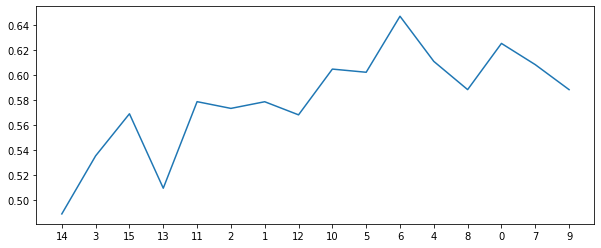

1172
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6592760180995475
sensitivity  0.645
auc          0.6521380090497737


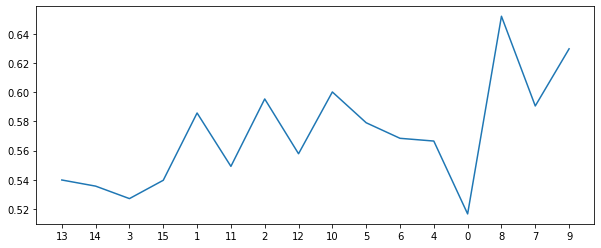

1173
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6167043740573153
sensitivity  0.67
auc          0.6433521870286576


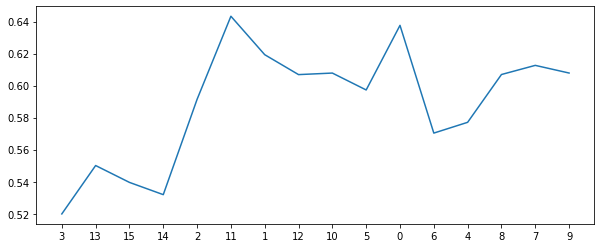

1174
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6610859728506787
sensitivity  0.565
auc          0.6130429864253394


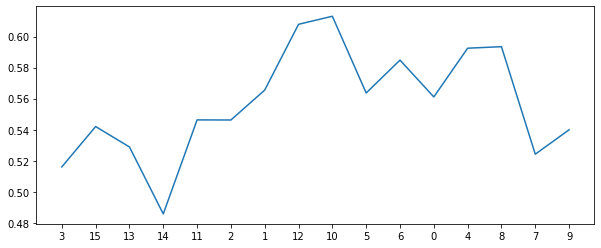

1175
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.675
specificity  0.6841628959276018
sensitivity  0.565
auc          0.6245814479638009


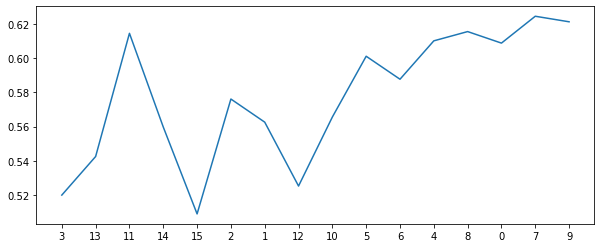

1176
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 1, 11, 15, 2, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.601395173453997
sensitivity  0.615
auc          0.6081975867269985


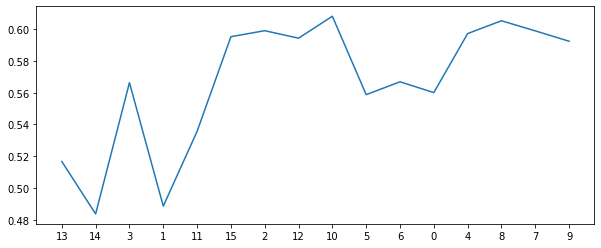

1177
all features [15, 3, 13, 14, 11, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [15, 3, 13, 14, 11, 2, 1, 12, 10, 5, 8, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6128205128205129
sensitivity  0.71
auc          0.6614102564102564


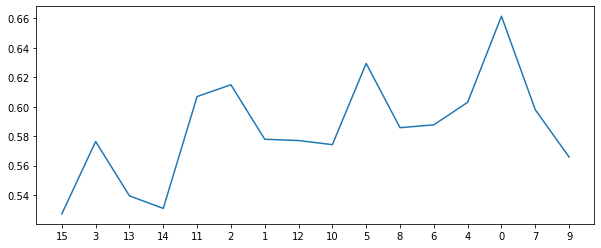

1178
all features [14, 13, 3, 15, 2, 1, 12, 11, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 3, 15, 2, 1, 12, 11, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6446428571428571
specificity  0.6457013574660634
sensitivity  0.64
auc          0.6428506787330317


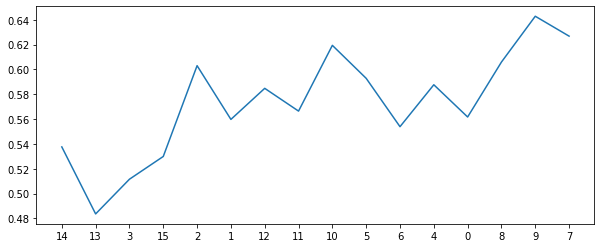

1179
all features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6017857142857143
specificity  0.5956259426847662
sensitivity  0.69
auc          0.642812971342383


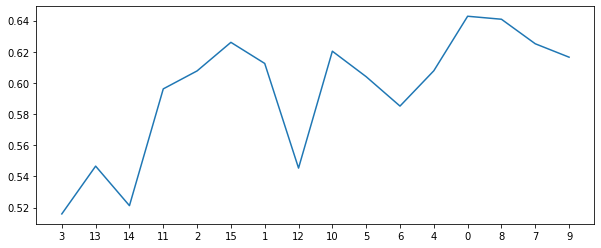

1180
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6072775263951734
sensitivity  0.645
auc          0.6261387631975868


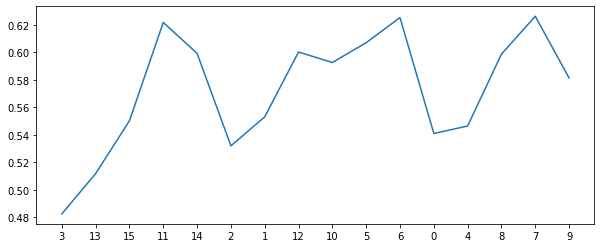

1181
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6357142857142857
specificity  0.6341628959276018
sensitivity  0.66
auc          0.6470814479638008


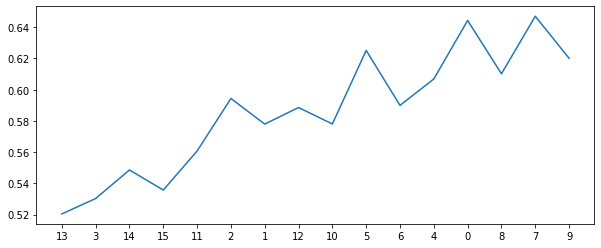

1182
all features [13, 14, 3, 1, 2, 15, 11, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 1, 2, 15, 11, 12, 10, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5696428571428571
specificity  0.5608974358974359
sensitivity  0.685
auc          0.622948717948718


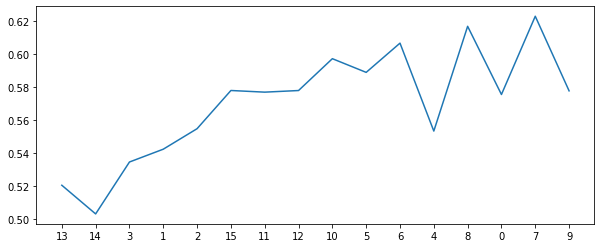

1183
all features [14, 15, 3, 11, 13, 2, 1, 10, 12, 5, 8, 4, 6, 0, 7, 9, 16]
new features [14, 15, 3, 11, 13, 2]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5357142857142857
specificity  0.5147812971342383
sensitivity  0.815
auc          0.6648906485671191


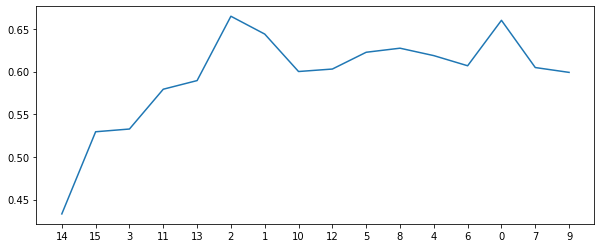

1184
all features [14, 13, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 15, 2, 1, 11, 12]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5841251885369533
sensitivity  0.695
auc          0.6395625942684766


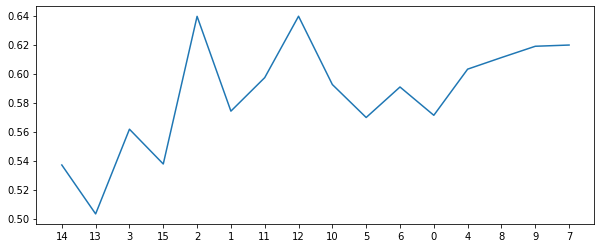

1185
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5687782805429864
sensitivity  0.71
auc          0.6393891402714932


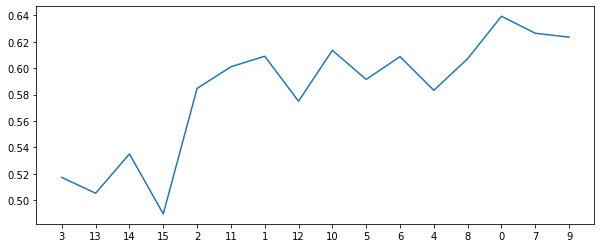

1186
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.5995098039215686
sensitivity  0.69
auc          0.6447549019607843


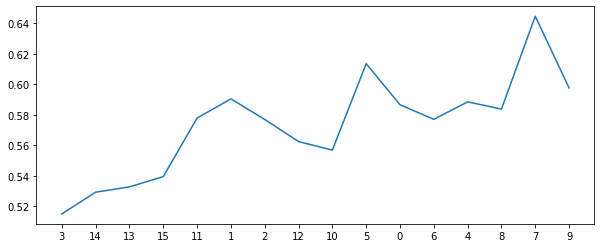

1187
all features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 8, 4, 0]
[0.4, 2, 1000, 3, 0.5, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5802036199095023
sensitivity  0.76
auc          0.6701018099547511


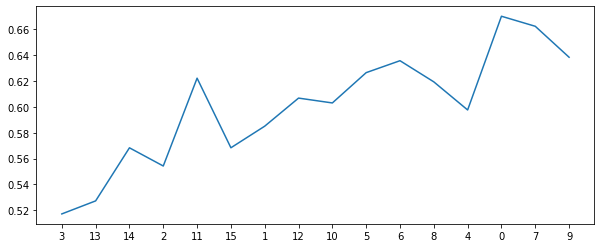

1188
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6669306184012067
sensitivity  0.545
auc          0.6059653092006033


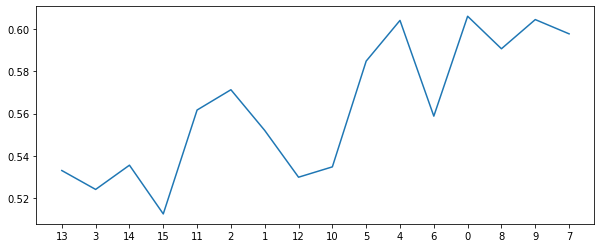

1189
all features [14, 13, 15, 11, 3, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 11, 3, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6928571428571428
specificity  0.7035067873303167
sensitivity  0.565
auc          0.6342533936651583


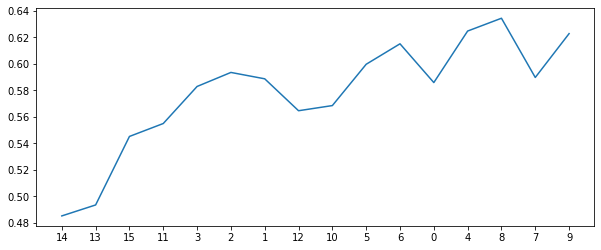

1190
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.7089285714285715
specificity  0.7285444947209653
sensitivity  0.47
auc          0.5992722473604827


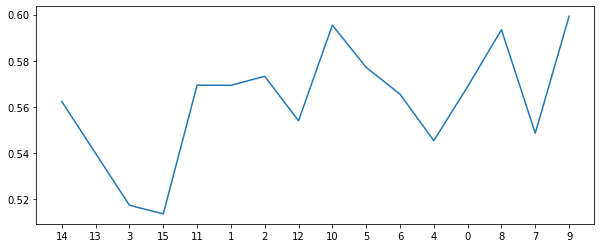

1191
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.6784690799396682
sensitivity  0.585
auc          0.6317345399698341


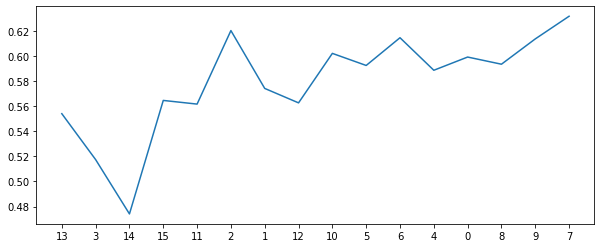

1192
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6875
specificity  0.7034313725490196
sensitivity  0.495
auc          0.5992156862745098


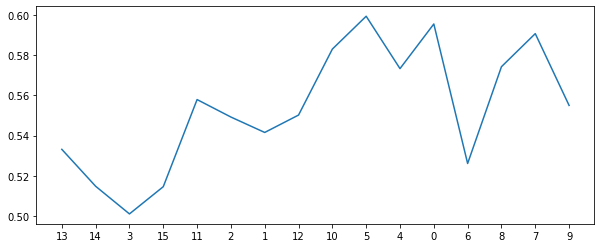

1193
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.7073529411764706
sensitivity  0.59
auc          0.6486764705882353


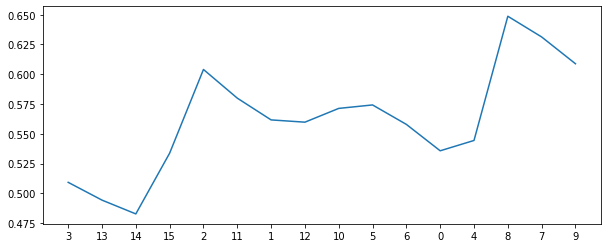

1194
all features [14, 3, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5935897435897436
sensitivity  0.62
auc          0.6067948717948718


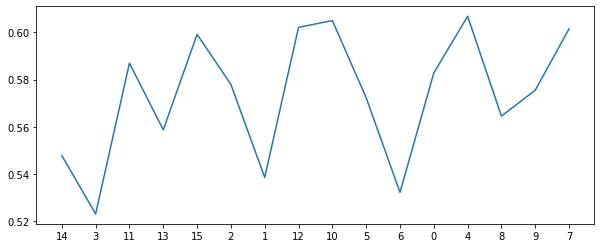

1195
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5763197586726998
sensitivity  0.67
auc          0.62315987933635


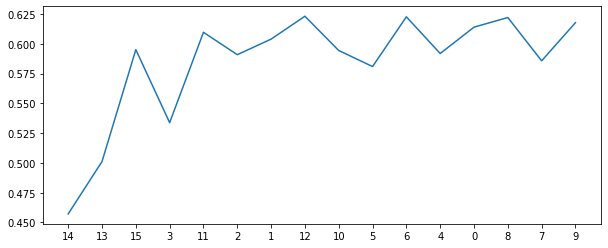

1196
all features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 4, 6, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 4, 6, 0, 8, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6572775263951735
sensitivity  0.59
auc          0.6236387631975867


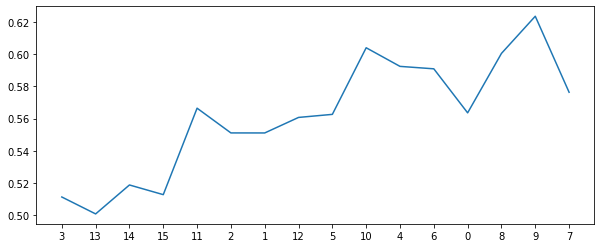

1197
all features [3, 14, 13, 11, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6340497737556561
sensitivity  0.615
auc          0.624524886877828


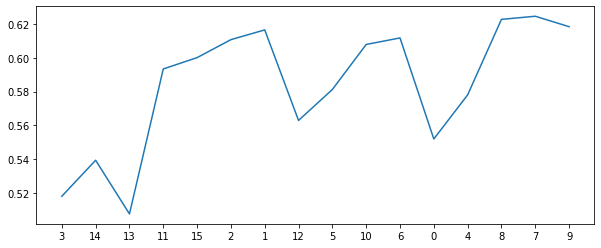

1198
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6746983408748115
sensitivity  0.57
auc          0.6223491704374058


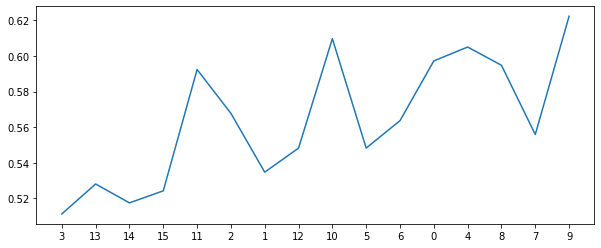

1199
all features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 6, 0, 8, 4, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6375
specificity  0.6360105580693816
sensitivity  0.665
auc          0.6505052790346908


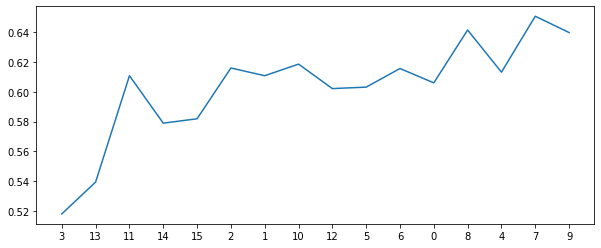

1200
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5625
specificity  0.5532428355957768
sensitivity  0.695
auc          0.6241214177978884


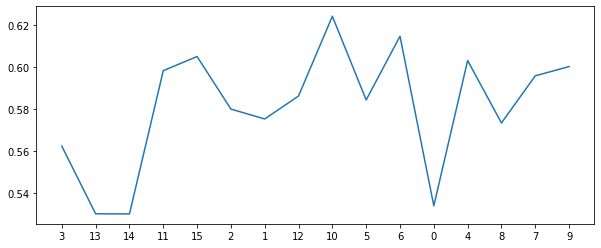

1201
all features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6168552036199095
sensitivity  0.62
auc          0.6184276018099547


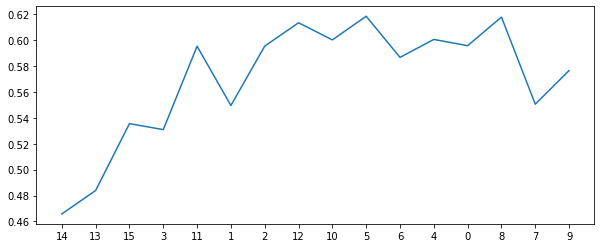

1202
all features [13, 3, 14, 11, 15, 1, 2, 12, 5, 10, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5857843137254902
sensitivity  0.645
auc          0.6153921568627451


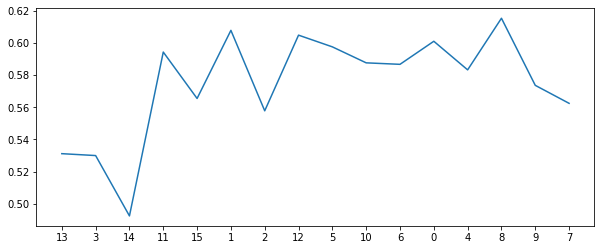

1203
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5859351432880845
sensitivity  0.69
auc          0.6379675716440423


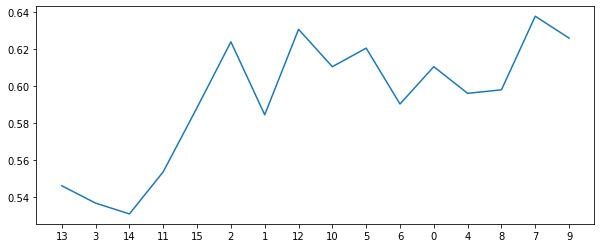

1204
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6515460030165913
sensitivity  0.565
auc          0.6082730015082957


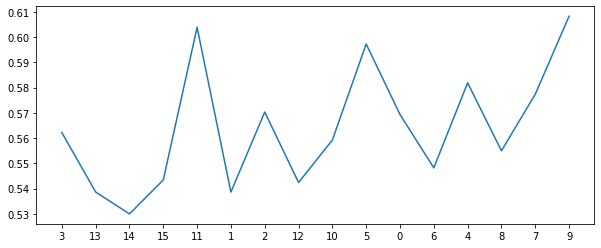

1205
all features [3, 11, 13, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 11, 13, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.603393665158371
sensitivity  0.715
auc          0.6591968325791855


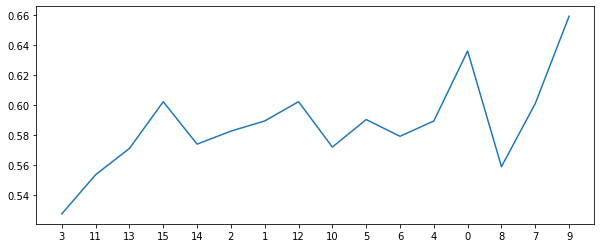

1206
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6707390648567119
sensitivity  0.59
auc          0.6303695324283559


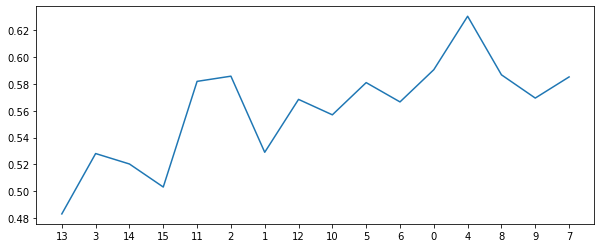

1207
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6475490196078432
sensitivity  0.645
auc          0.6462745098039215


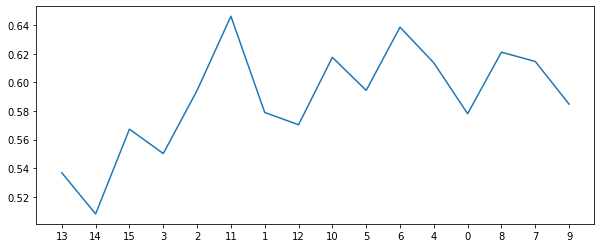

1208
all features [13, 3, 14, 15, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 5, 10, 6, 0]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6976621417797888
sensitivity  0.545
auc          0.6213310708898944


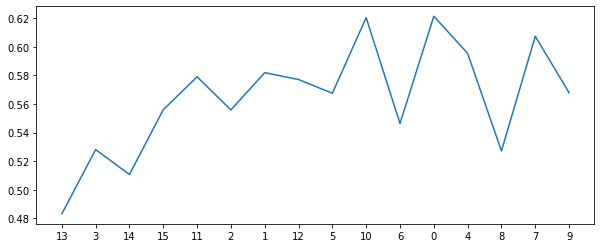

1209
all features [3, 13, 15, 14, 11, 2, 1, 12, 5, 10, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 5, 10, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.680316742081448
sensitivity  0.57
auc          0.625158371040724


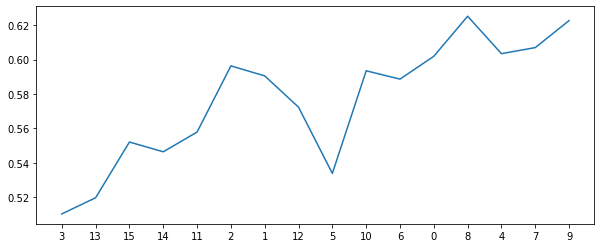

1210
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.7107142857142857
specificity  0.7265082956259427
sensitivity  0.52
auc          0.6232541478129713


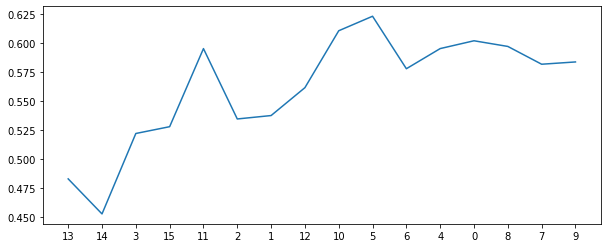

1211
all features [15, 3, 13, 11, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [15, 3, 13, 11, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6625
specificity  0.6726621417797889
sensitivity  0.54
auc          0.6063310708898944


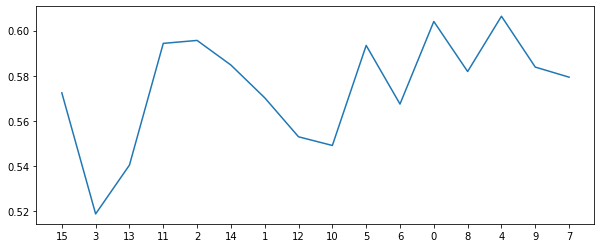

1212
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.5625
specificity  0.5494720965309201
sensitivity  0.745
auc          0.64723604826546


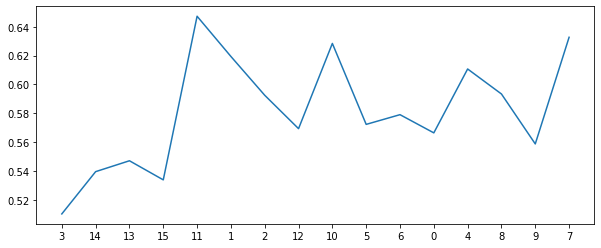

1213
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6418929110105581
sensitivity  0.71
auc          0.675946455505279


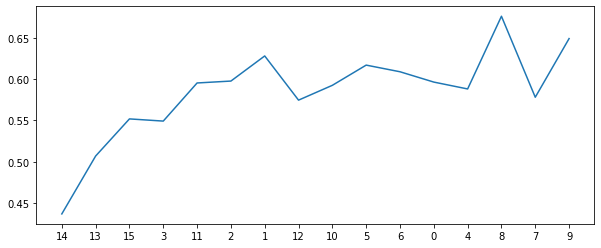

1214
all features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 6]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6322398190045249
sensitivity  0.62
auc          0.6261199095022625


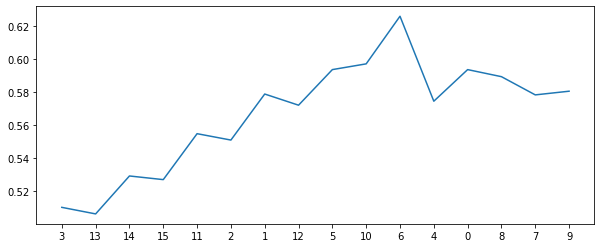

1215
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6302790346907994
sensitivity  0.615
auc          0.6226395173453997


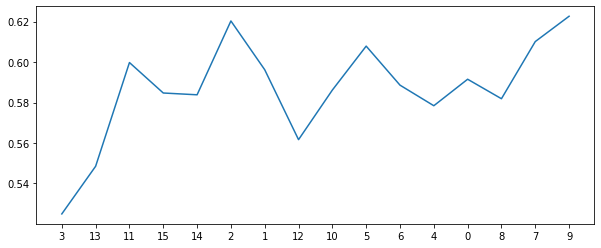

1216
all features [13, 3, 15, 14, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6360859728506787
sensitivity  0.62
auc          0.6280429864253394


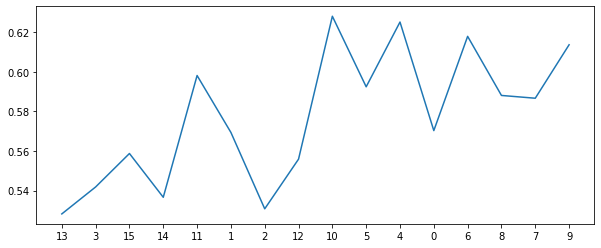

1217
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6375
specificity  0.628393665158371
sensitivity  0.76
auc          0.6941968325791855


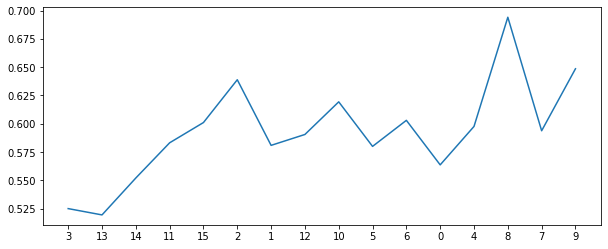

1218
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.601395173453997
sensitivity  0.71
auc          0.6556975867269985


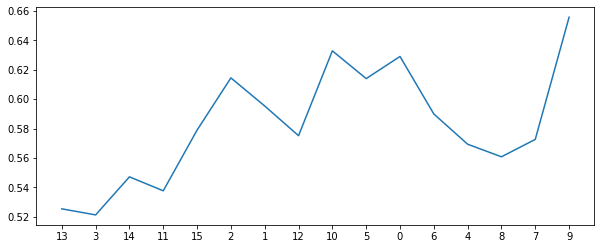

1219
all features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5428571428571428
specificity  0.5302790346907994
sensitivity  0.715
auc          0.6226395173453997


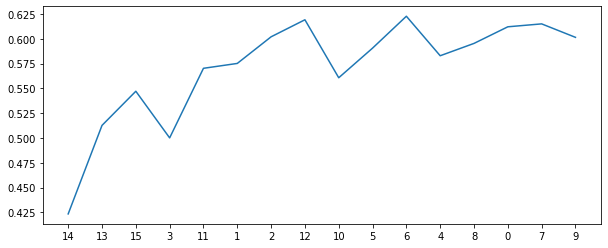

1220
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5785714285714285
specificity  0.5724358974358974
sensitivity  0.665
auc          0.6187179487179487


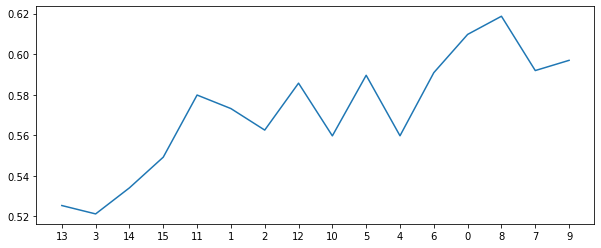

1221
all features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 14, 2, 11, 15, 1]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5232142857142857
specificity  0.5050904977375565
sensitivity  0.77
auc          0.6375452488687783


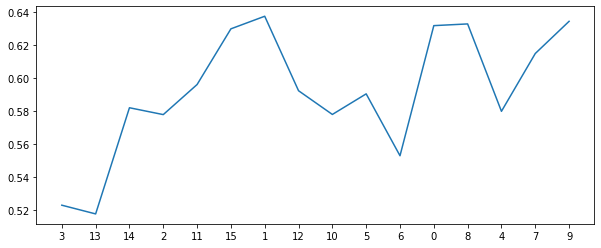

1222
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.628393665158371
sensitivity  0.64
auc          0.6341968325791855


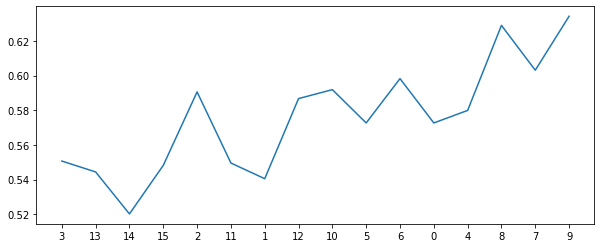

1223
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6033559577677224
sensitivity  0.69
auc          0.6466779788838612


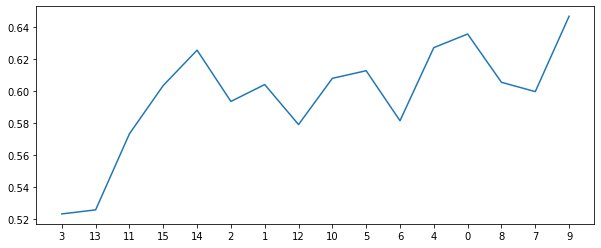

1224
all features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 14, 11, 2, 15, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6642857142857143
specificity  0.6784690799396682
sensitivity  0.495
auc          0.586734539969834


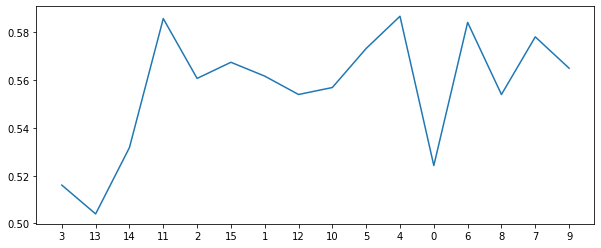

1225
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6839285714285714
specificity  0.6939291101055807
sensitivity  0.56
auc          0.6269645550527904


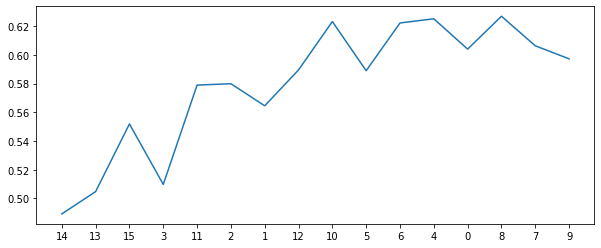

1226
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6879336349924585
sensitivity  0.565
auc          0.6264668174962292


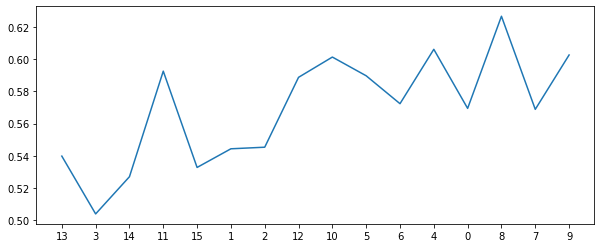

1227
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6746229260935144
sensitivity  0.565
auc          0.6198114630467572


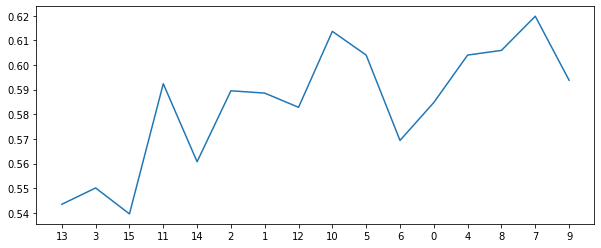

1228
all features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 10, 12, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.7107142857142857
specificity  0.7245475113122172
sensitivity  0.545
auc          0.6347737556561086


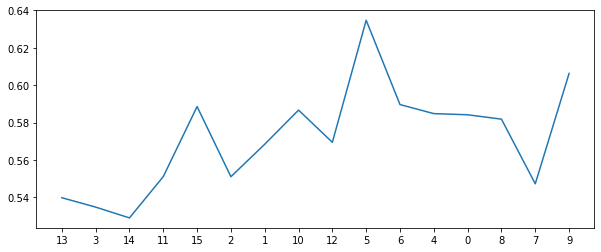

1229
all features [3, 15, 13, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 15, 13, 11, 14, 2]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6494343891402715
sensitivity  0.62
auc          0.6347171945701358


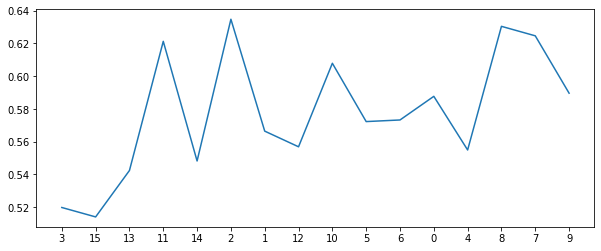

1230
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6392857142857143
specificity  0.6380467571644042
sensitivity  0.66
auc          0.6490233785822022


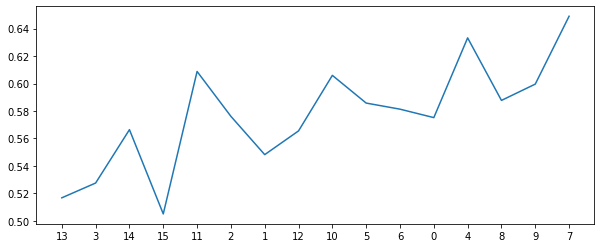

1231
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5878582202111614
sensitivity  0.69
auc          0.6389291101055807


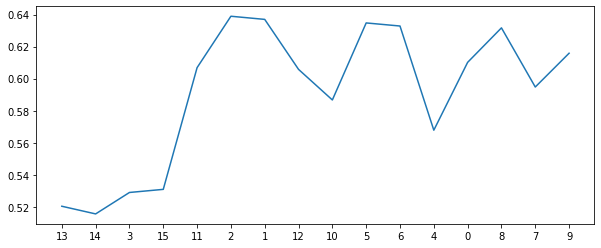

1232
all features [13, 3, 14, 15, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6475490196078432
sensitivity  0.635
auc          0.6412745098039215


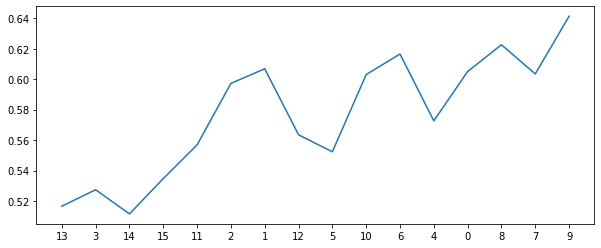

1233
all features [3, 15, 13, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 15, 13, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5875
specificity  0.5784313725490197
sensitivity  0.72
auc          0.6492156862745098


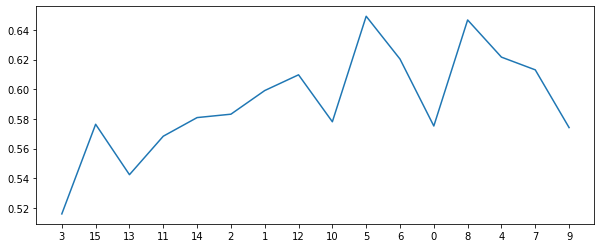

1234
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6553921568627451
sensitivity  0.57
auc          0.6126960784313725


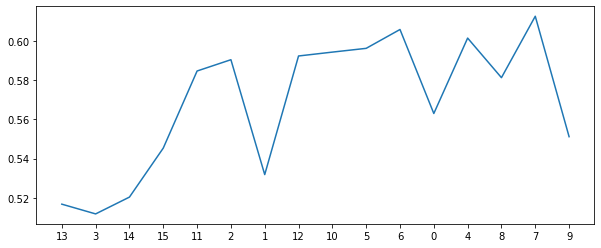

1235
all features [3, 11, 13, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [3, 11, 13, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6285714285714286
specificity  0.6244720965309201
sensitivity  0.685
auc          0.6547360482654601


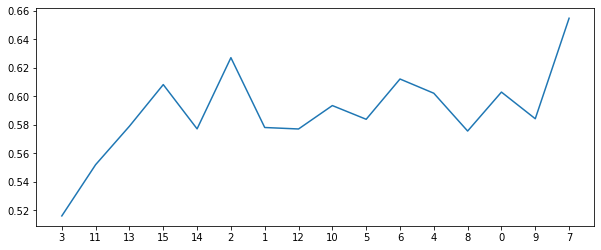

1236
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5802036199095023
sensitivity  0.71
auc          0.6451018099547512


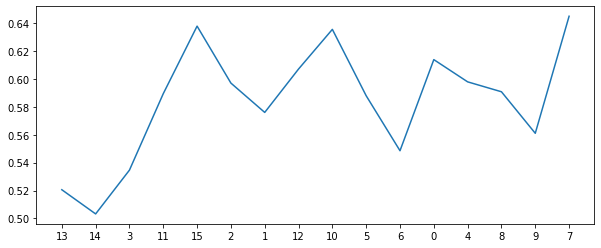

1237
all features [14, 15, 13, 11, 3, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 15, 13, 11, 3, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5741327300150829
sensitivity  0.715
auc          0.6445663650075415


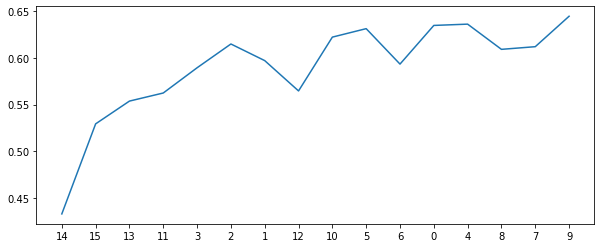

1238
all features [13, 3, 14, 15, 2, 11, 1, 12, 5, 10, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5591251885369533
sensitivity  0.69
auc          0.6245625942684766


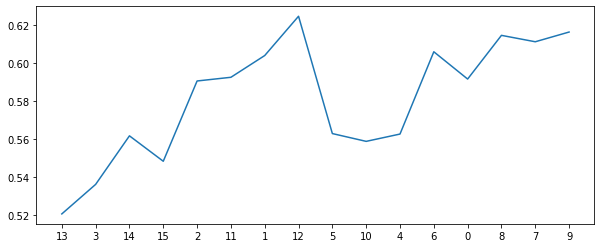

1239
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5821644042232278
sensitivity  0.735
auc          0.6585822021116139


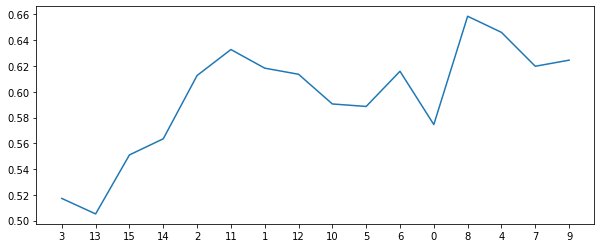

1240
all features [3, 13, 15, 14, 11, 2, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 10, 12, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5897435897435898
sensitivity  0.67
auc          0.6298717948717949


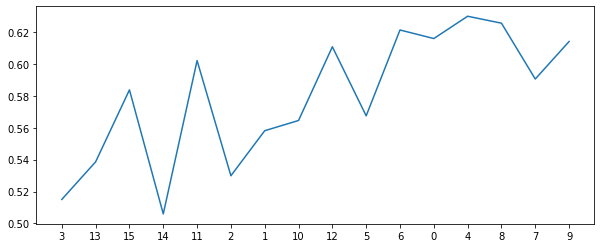

1241
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5745475113122172
sensitivity  0.76
auc          0.6672737556561086


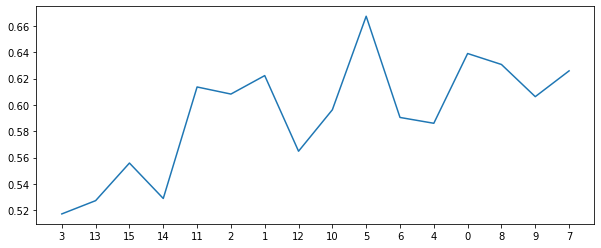

1242
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.675
specificity  0.6861990950226244
sensitivity  0.545
auc          0.6155995475113122


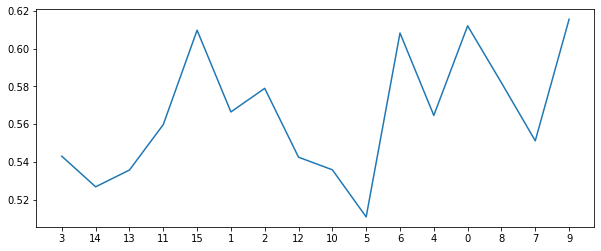

1243
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6214285714285714
specificity  0.6245852187028658
sensitivity  0.595
auc          0.6097926093514329


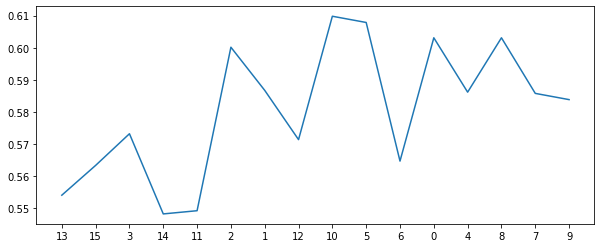

1244
all features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.7034690799396681
sensitivity  0.49
auc          0.596734539969834


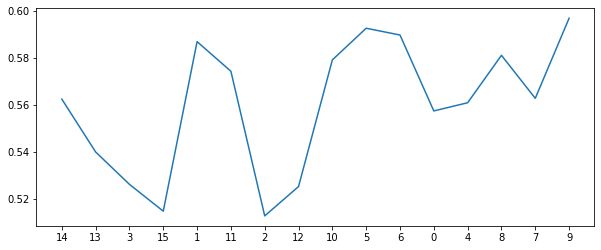

1245
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6875
specificity  0.6975490196078431
sensitivity  0.57
auc          0.6337745098039216


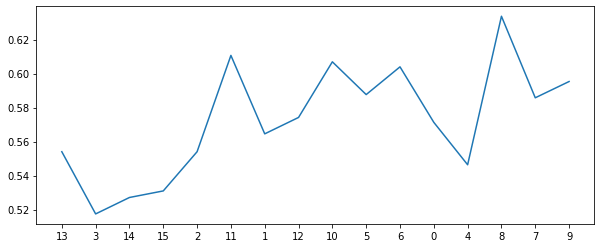

1246
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6919306184012066
sensitivity  0.57
auc          0.6309653092006033


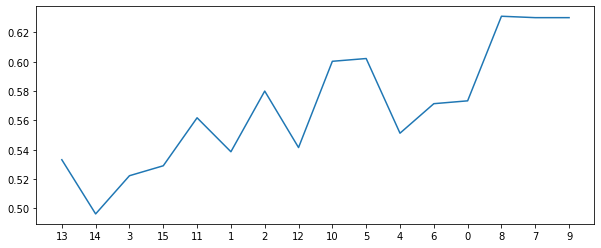

1247
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 11]
[0.4, 2, 1000, 3, 0.5, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6128205128205129
sensitivity  0.64
auc          0.6264102564102564


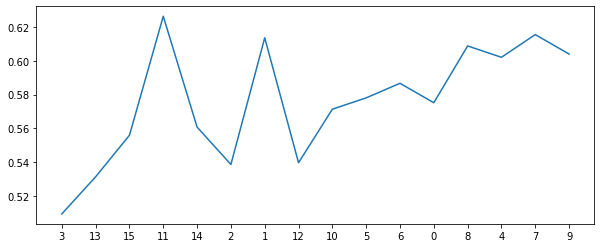

1248
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6399698340874812
sensitivity  0.595
auc          0.6174849170437405


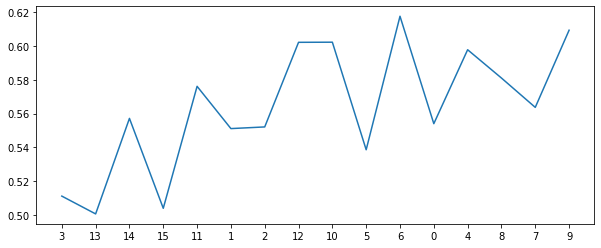

1249
all features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6380090497737556
sensitivity  0.69
auc          0.6640045248868778


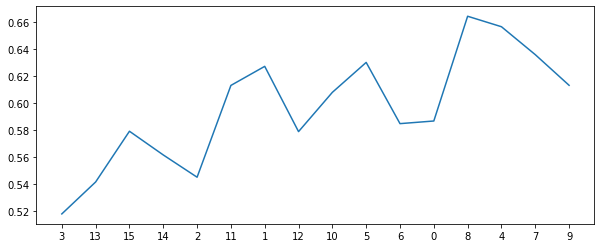

1250
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6494720965309201
sensitivity  0.585
auc          0.6172360482654601


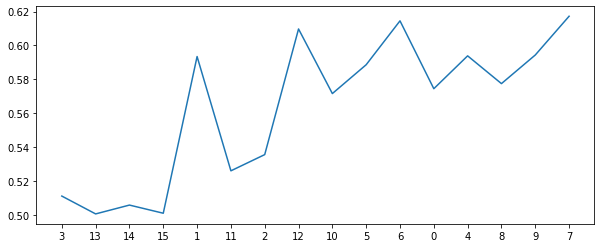

1251
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6456259426847663
sensitivity  0.64
auc          0.6428129713423831


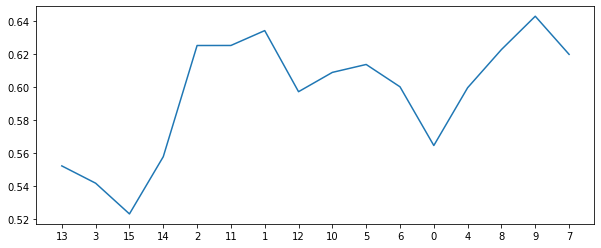

1252
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6630467571644042
sensitivity  0.57
auc          0.6165233785822021


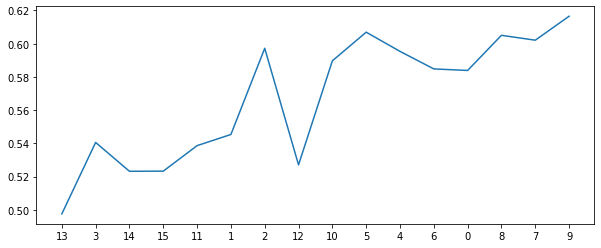

1253
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6410714285714285
specificity  0.6437782805429865
sensitivity  0.615
auc          0.6293891402714932


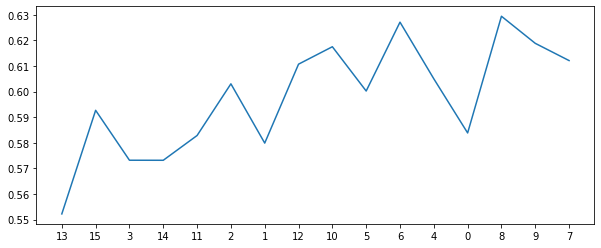

1254
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6130467571644043
sensitivity  0.665
auc          0.639023378582202


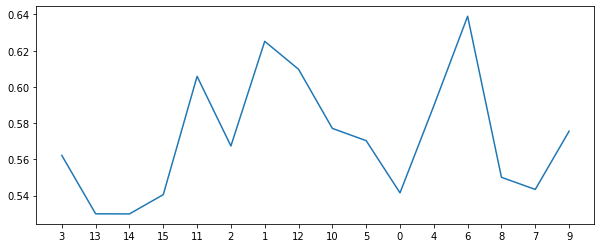

1255
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5625
specificity  0.5475490196078432
sensitivity  0.765
auc          0.6562745098039215


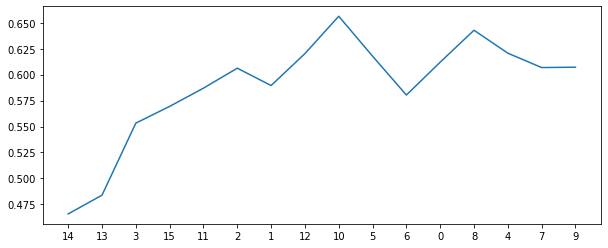

1256
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6392857142857143
specificity  0.6417797888386124
sensitivity  0.615
auc          0.6283898944193061


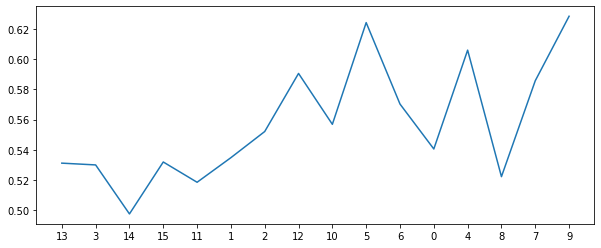

1257
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5802790346907994
sensitivity  0.745
auc          0.6626395173453997


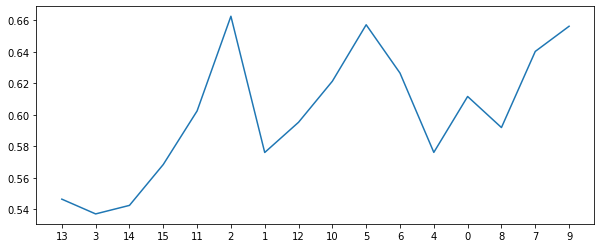

1258
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6322775263951734
sensitivity  0.62
auc          0.6261387631975867


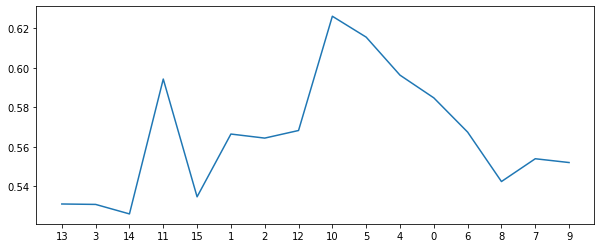

1259
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5916289592760181
sensitivity  0.685
auc          0.638314479638009


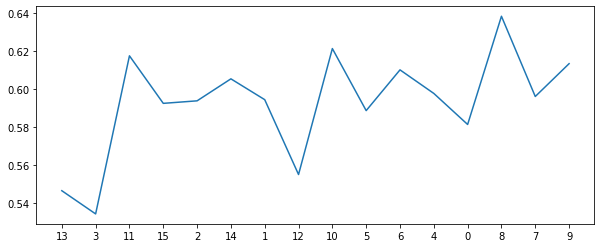

1260
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.7017857142857142
specificity  0.7150452488687783
sensitivity  0.545
auc          0.6300226244343892


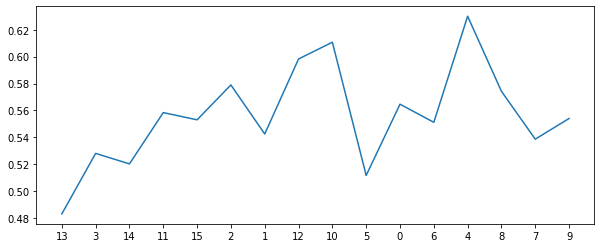

1261
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6982142857142857
specificity  0.7072021116138764
sensitivity  0.59
auc          0.6486010558069382


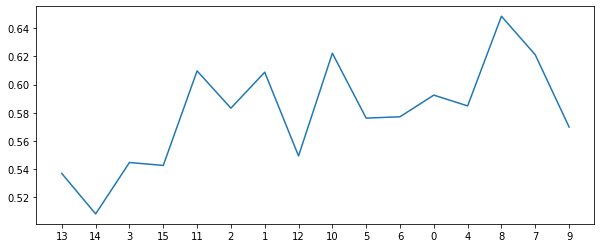

1262
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6822398190045249
sensitivity  0.57
auc          0.6261199095022625


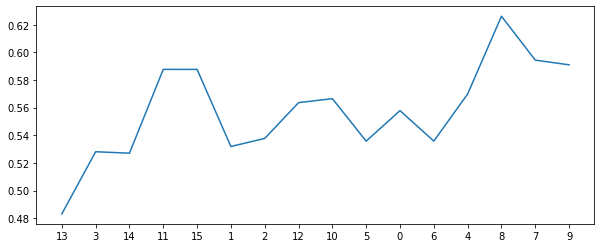

1263
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6857142857142857
specificity  0.6976244343891402
sensitivity  0.54
auc          0.6188122171945701


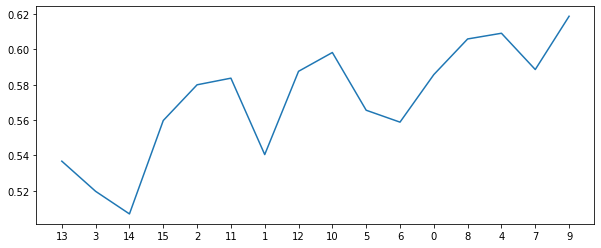

1264
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7073529411764706
sensitivity  0.52
auc          0.6136764705882353


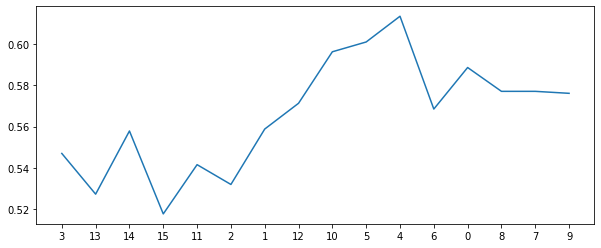

1265
all features [13, 15, 3, 11, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 3, 11]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6051282051282051
sensitivity  0.645
auc          0.6250641025641026


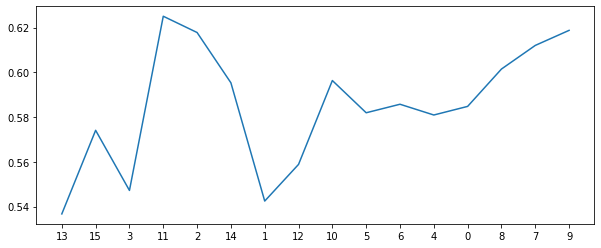

1266
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6302413273001508
sensitivity  0.64
auc          0.6351206636500754


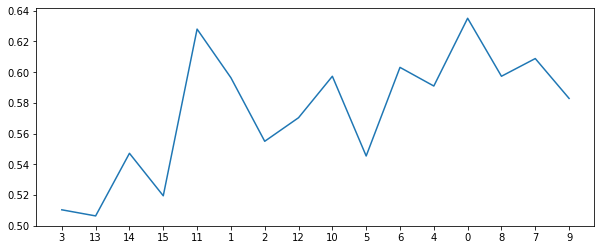

1267
all features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6360482654600301
sensitivity  0.615
auc          0.6255241327300151


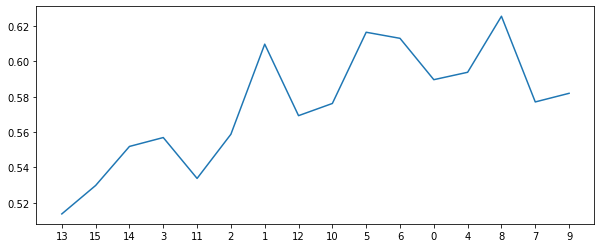

1268
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6428571428571428
specificity  0.6494720965309201
sensitivity  0.57
auc          0.60973604826546


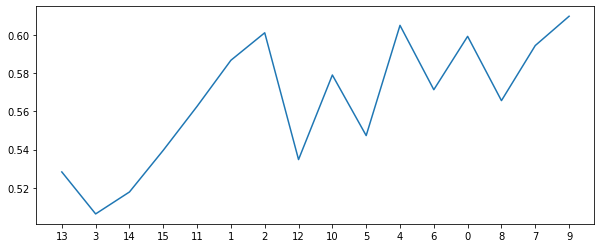

1269
all features [3, 13, 14, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.6149321266968326
sensitivity  0.645
auc          0.6299660633484163


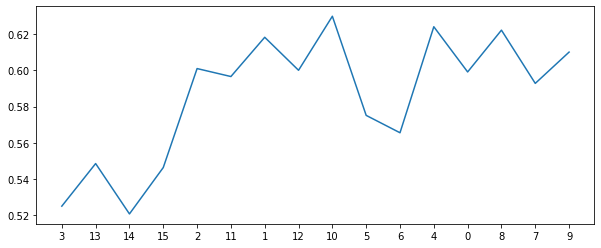

1270
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6476998491704374
sensitivity  0.565
auc          0.6063499245852186


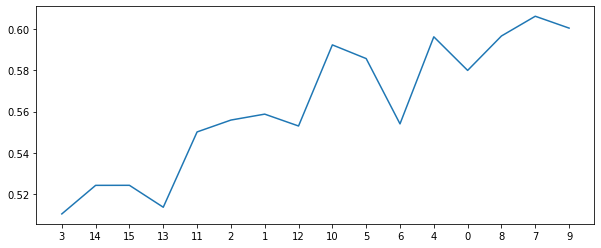

1271
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.581975867269985
sensitivity  0.695
auc          0.6384879336349925


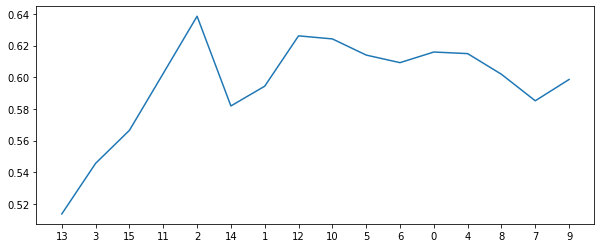

1272
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6034690799396681
sensitivity  0.695
auc          0.649234539969834


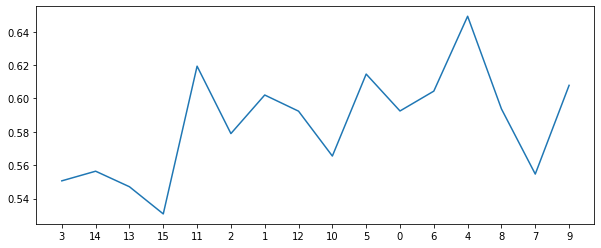

1273
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 6, 5, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 6, 5, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5964285714285714
specificity  0.5918174962292609
sensitivity  0.67
auc          0.6309087481146305


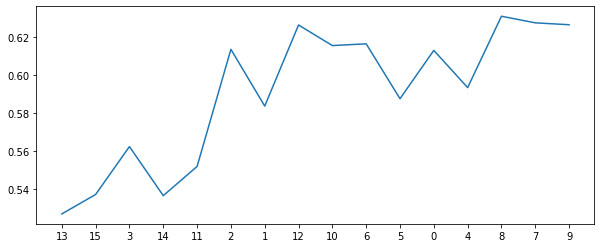

1274
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.5993212669683258
sensitivity  0.665
auc          0.6321606334841628


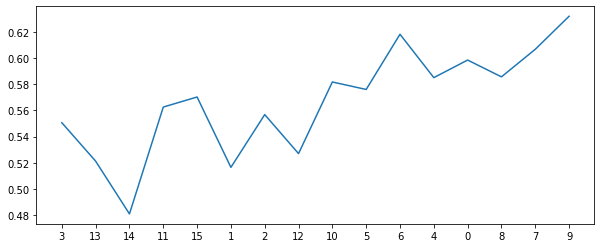

1275
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.543552036199095
sensitivity  0.74
auc          0.6417760180995475


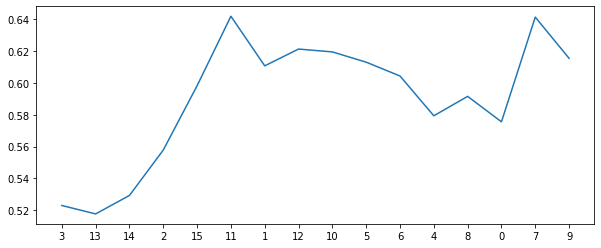

1276
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6110859728506787
sensitivity  0.66
auc          0.6355429864253394


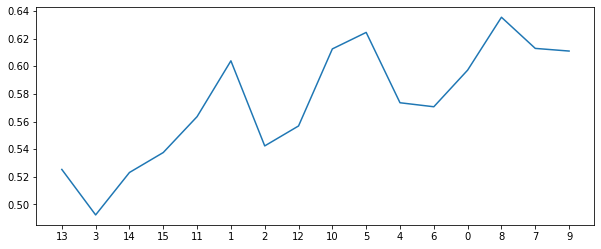

1277
all features [15, 13, 3, 11, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [15, 13, 3, 11, 2, 14, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5821428571428571
specificity  0.5706259426847662
sensitivity  0.74
auc          0.6553129713423831


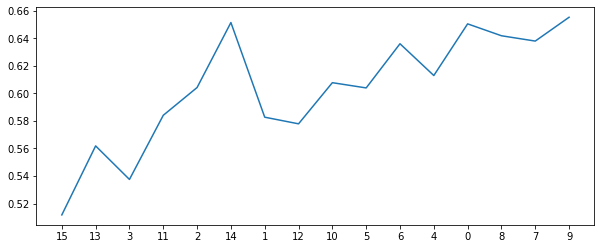

1278
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6764328808446456
sensitivity  0.54
auc          0.6082164404223228


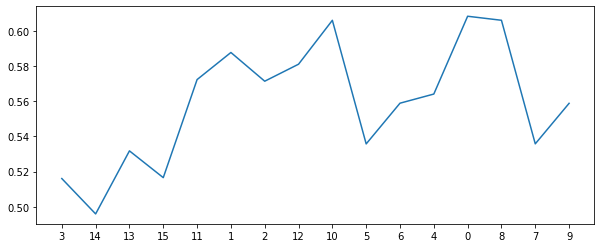

1279
all features [15, 13, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [15, 13, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.616817496229261
sensitivity  0.62
auc          0.6184087481146305


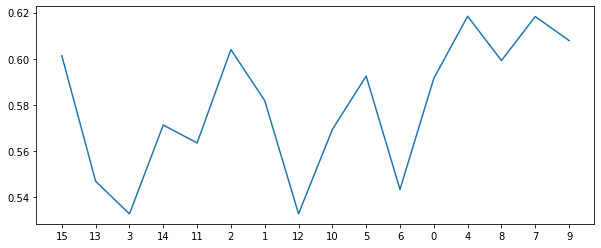

1280
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6982142857142857
specificity  0.7072398190045249
sensitivity  0.59
auc          0.6486199095022624


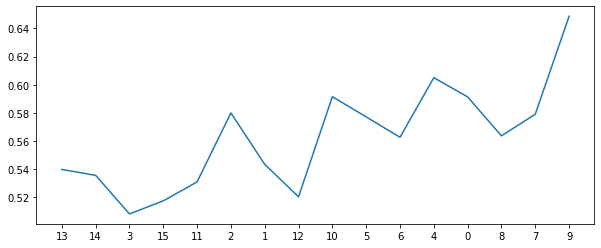

1281
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6764705882352942
sensitivity  0.545
auc          0.610735294117647


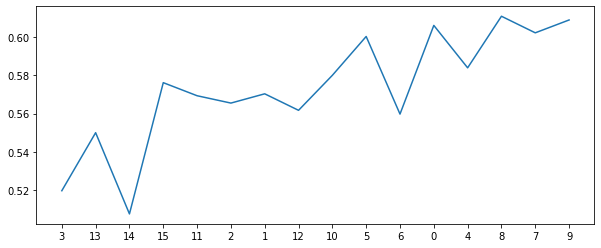

1282
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.695814479638009
sensitivity  0.52
auc          0.6079072398190045


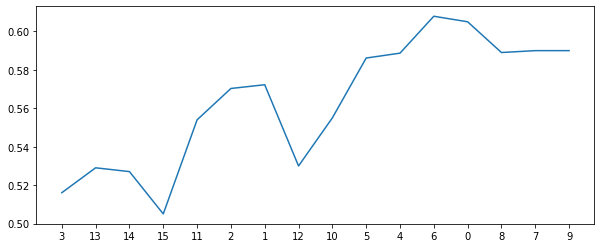

1283
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.6996606334841629
sensitivity  0.59
auc          0.6448303167420815


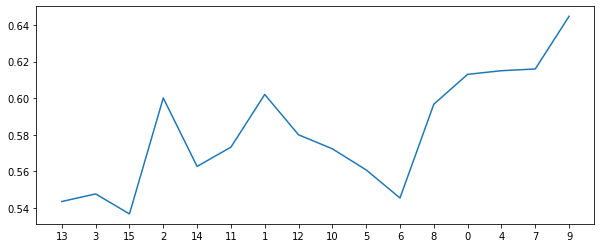

1284
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.65
specificity  0.6514705882352941
sensitivity  0.645
auc          0.648235294117647


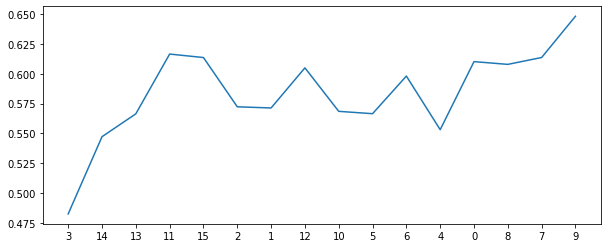

1285
all features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6017857142857143
specificity  0.5937782805429864
sensitivity  0.71
auc          0.6518891402714933


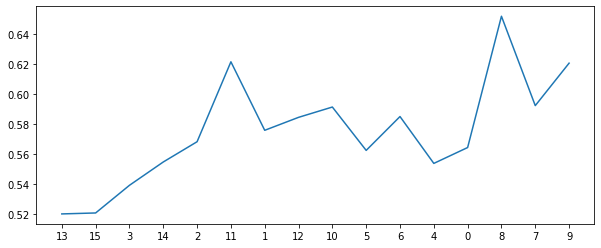

1286
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6341251885369532
sensitivity  0.595
auc          0.6145625942684766


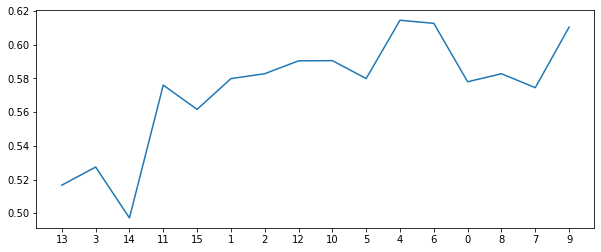

1287
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.583974358974359
sensitivity  0.745
auc          0.6644871794871795


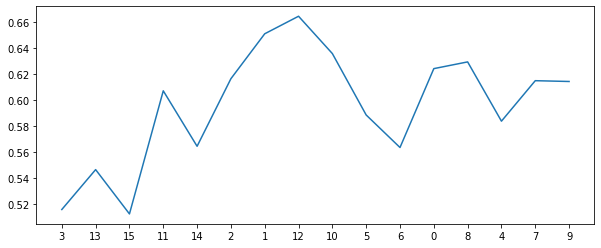

1288
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6496606334841629
sensitivity  0.57
auc          0.6098303167420814


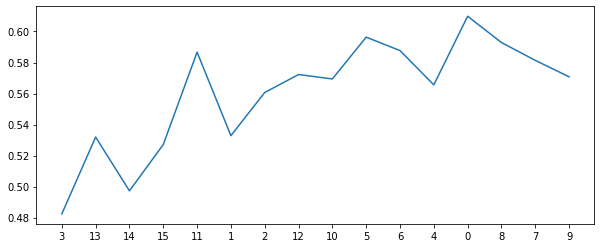

1289
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.6014705882352941
sensitivity  0.695
auc          0.648235294117647


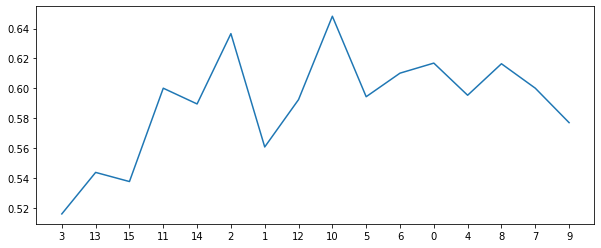

1290
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5232142857142857
specificity  0.5090497737556561
sensitivity  0.72
auc          0.614524886877828


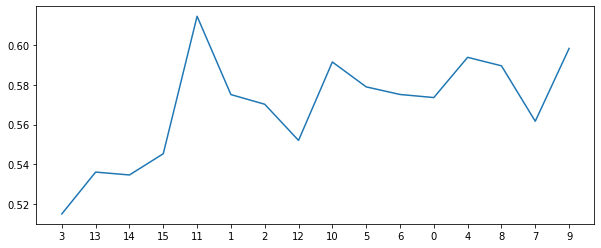

1291
all features [13, 14, 3, 15, 2, 11, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 3, 15, 2, 11, 1, 10, 12, 5, 6, 0, 8, 4]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5553571428571429
specificity  0.5397812971342383
sensitivity  0.765
auc          0.6523906485671191


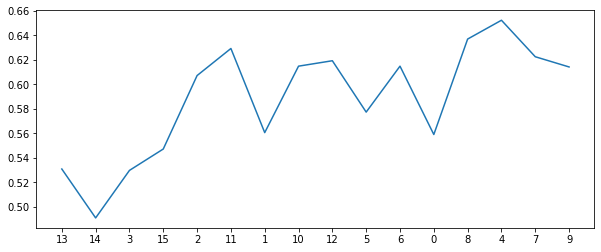

1292
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5841628959276018
sensitivity  0.665
auc          0.6245814479638009


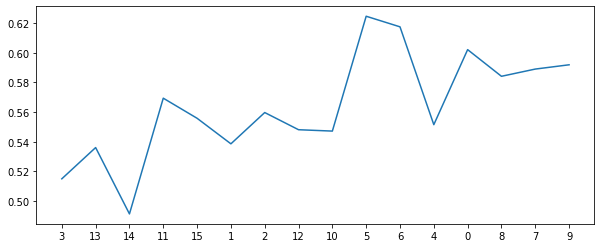

1293
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5875
specificity  0.5763951734539969
sensitivity  0.745
auc          0.6606975867269985


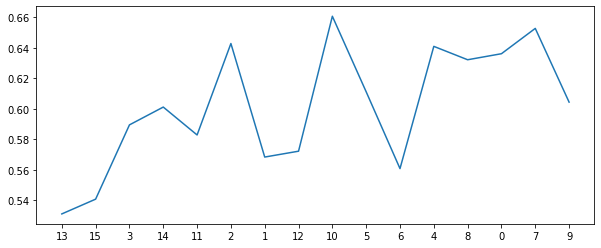

1294
all features [13, 3, 11, 15, 14, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 11, 15, 14, 1, 2, 12, 10, 5, 6, 4, 0]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6340874811463046
sensitivity  0.665
auc          0.6495437405731523


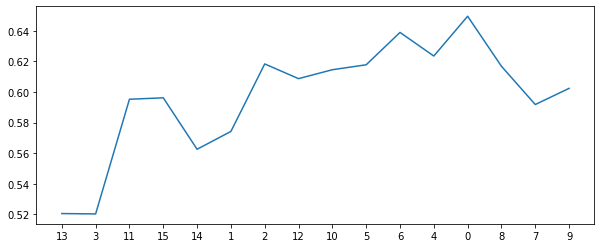

1295
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 3, 0.5, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5648567119155354
sensitivity  0.765
auc          0.6649283559577677


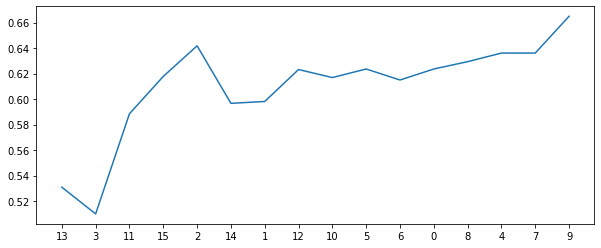

1296
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6607142857142857
specificity  0.666892911010558
sensitivity  0.59
auc          0.628446455505279


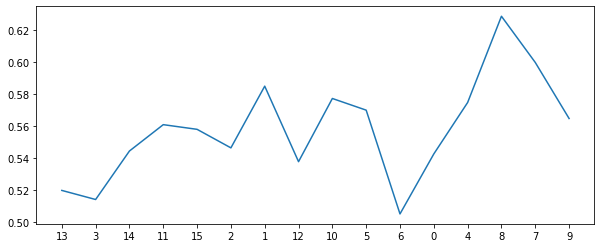

1297
all features [3, 15, 13, 14, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 15, 13, 14, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6765082956259427
sensitivity  0.57
auc          0.6232541478129714


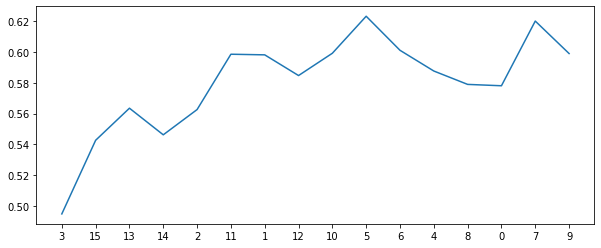

1298
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.6976998491704374
sensitivity  0.57
auc          0.6338499245852187


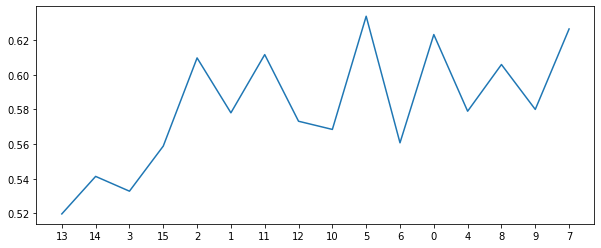

1299
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6611613876319758
sensitivity  0.62
auc          0.6405806938159879


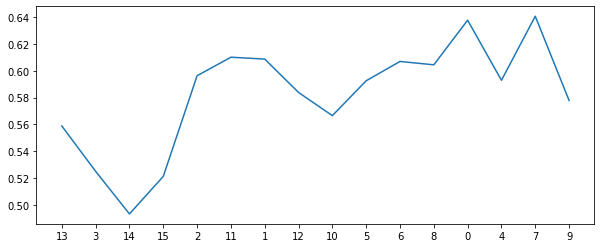

1300
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6875
specificity  0.7034690799396682
sensitivity  0.495
auc          0.5992345399698341


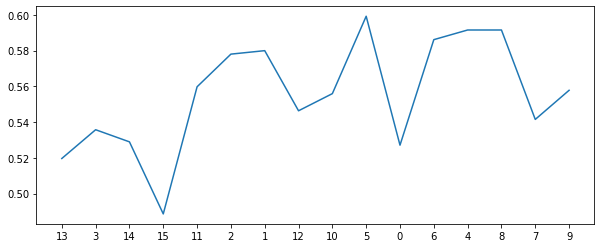

1301
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6625
specificity  0.6726621417797888
sensitivity  0.54
auc          0.6063310708898944


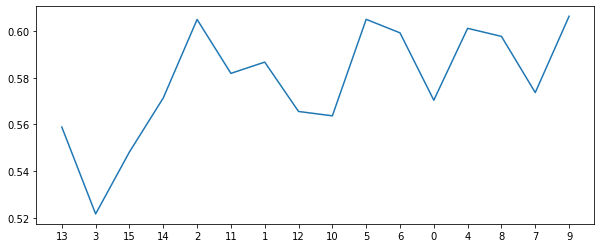

1302
all features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [13, 3, 14, 1, 11, 15, 2, 12, 10, 5, 0, 4, 6, 8, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6283559577677225
sensitivity  0.615
auc          0.6216779788838612


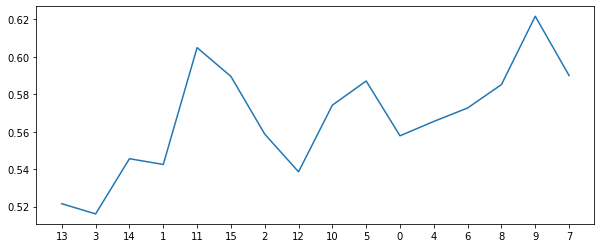

1303
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 8, 6, 4, 0, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5875
specificity  0.5782428355957767
sensitivity  0.715
auc          0.6466214177978884


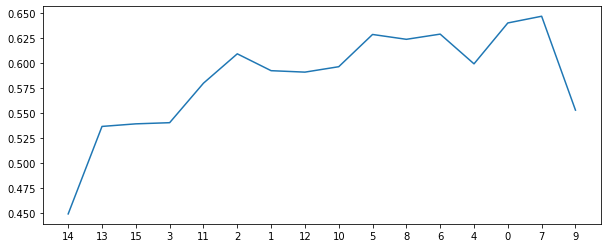

1304
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 8, 4, 0, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.653393665158371
sensitivity  0.645
auc          0.6491968325791855


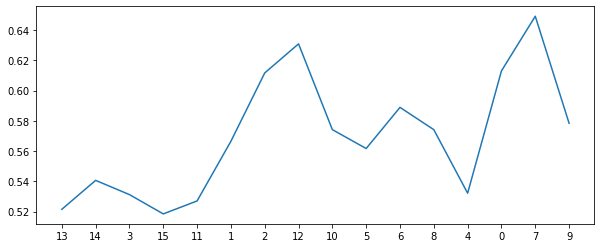

1305
all features [3, 13, 2, 11, 15, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 2, 11, 15, 14, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6149321266968326
sensitivity  0.69
auc          0.6524660633484163


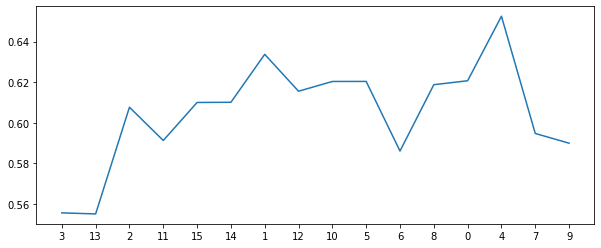

1306
all features [13, 3, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 15]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.5964285714285714
specificity  0.5917043740573152
sensitivity  0.67
auc          0.6308521870286576


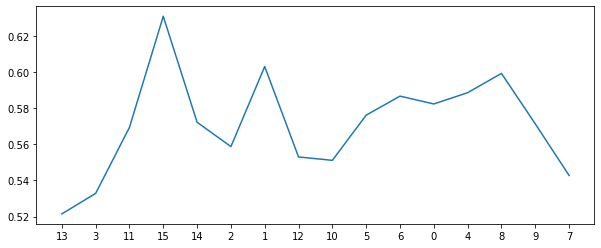

1307
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 6, 5, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 6, 5, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.625
specificity  0.620475113122172
sensitivity  0.69
auc          0.655237556561086


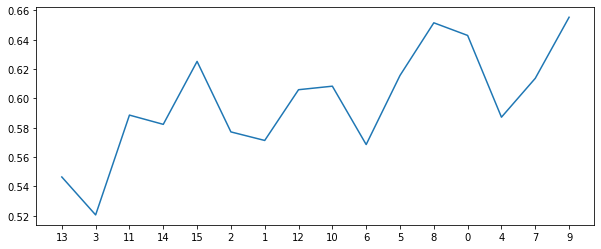

1308
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5589285714285714
specificity  0.551395173453997
sensitivity  0.67
auc          0.6106975867269985


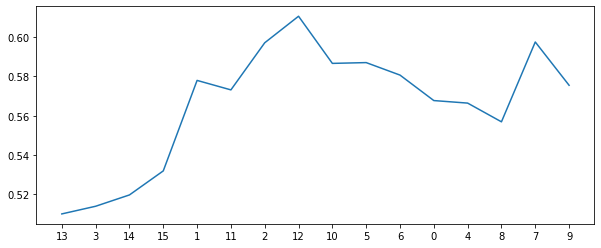

1309
all features [14, 15, 13, 3, 2, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 15, 13, 3, 2, 11]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5089285714285714
specificity  0.48959276018099546
sensitivity  0.76
auc          0.6247963800904978


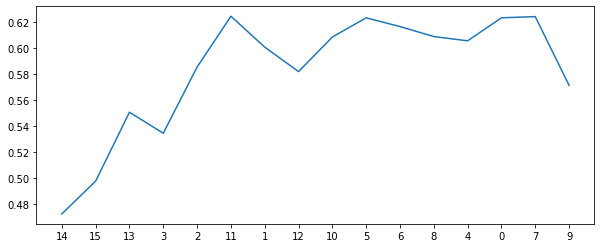

1310
all features [13, 14, 3, 2, 15, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 2, 15, 1, 11, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5625
specificity  0.5533559577677225
sensitivity  0.69
auc          0.6216779788838612


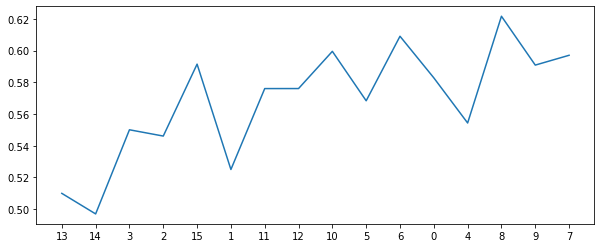

1311
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.564894419306184
sensitivity  0.74
auc          0.652447209653092


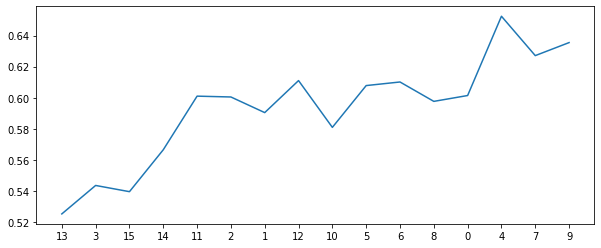

1312
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.5996606334841629
sensitivity  0.67
auc          0.6348303167420815


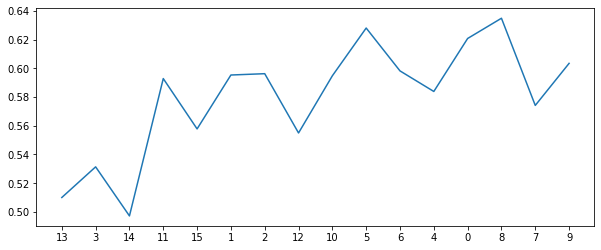

1313
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5532428355957768
sensitivity  0.76
auc          0.6566214177978884


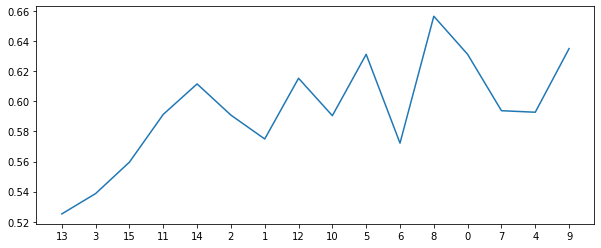

1314
all features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 2, 11, 12, 10, 5, 0, 4, 6, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6678571428571429
specificity  0.6765460030165913
sensitivity  0.57
auc          0.6232730015082957


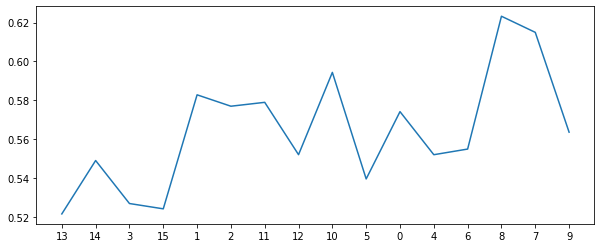

1315
all features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 4, 6, 8, 0, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6418174962292609
sensitivity  0.635
auc          0.6384087481146304


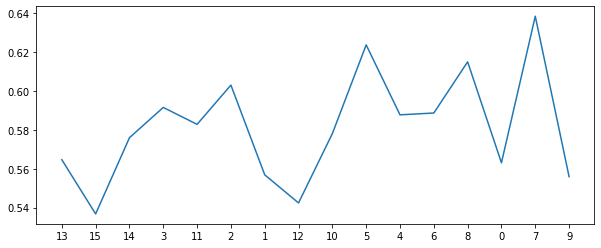

1316
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6919306184012066
sensitivity  0.61
auc          0.6509653092006034


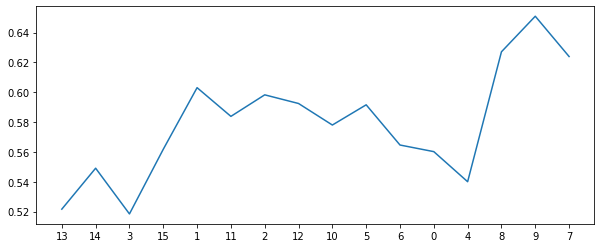

1317
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6642857142857143
specificity  0.6629713423831071
sensitivity  0.69
auc          0.6764856711915536


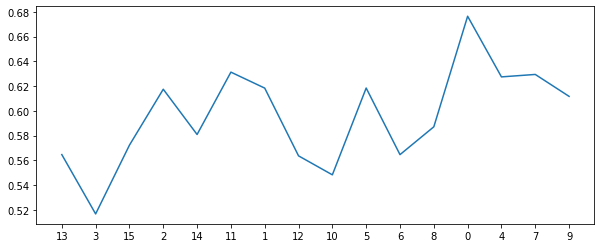

1318
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6660714285714286
specificity  0.6785067873303168
sensitivity  0.52
auc          0.5992533936651584


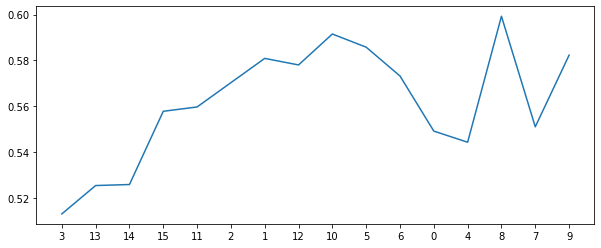

1319
all features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6625
specificity  0.668815987933635
sensitivity  0.59
auc          0.6294079939668175


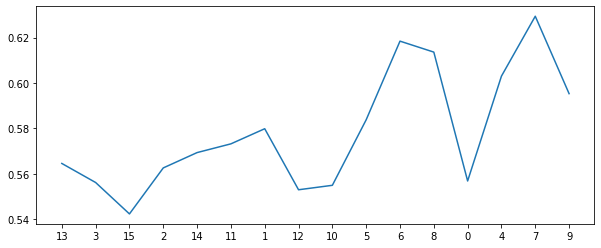

1320
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.6013574660633484
sensitivity  0.64
auc          0.6206787330316742


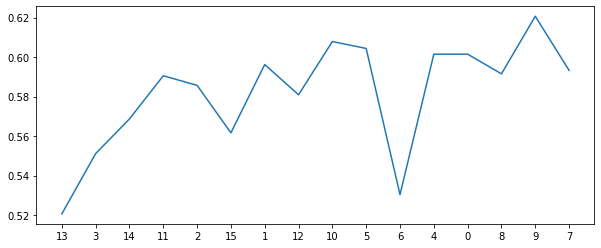

1321
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.5437028657616892
sensitivity  0.74
auc          0.6418514328808447


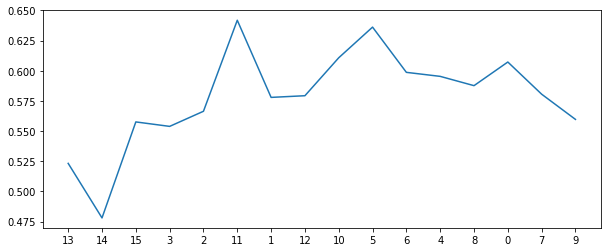

1322
all features [13, 14, 3, 15, 2, 1, 12, 11, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [13, 14, 3, 15, 2, 1, 12, 11]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6070889894419306
sensitivity  0.67
auc          0.6385444947209653


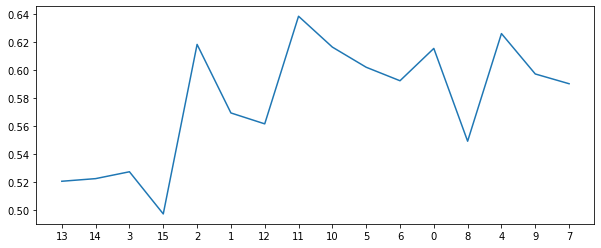

1323
all features [13, 3, 15, 14, 2, 1, 11, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 1, 11, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5802790346907994
sensitivity  0.735
auc          0.6576395173453997


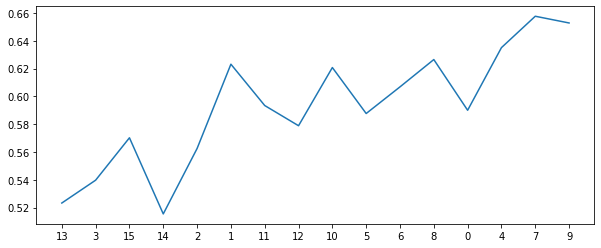

1324
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.5732142857142857
specificity  0.5668552036199095
sensitivity  0.67
auc          0.6184276018099547


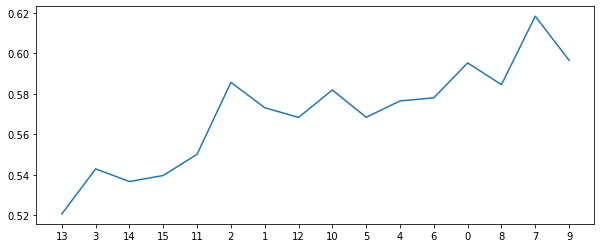

1325
all features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 11, 15, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5993212669683258
sensitivity  0.67
auc          0.6346606334841629


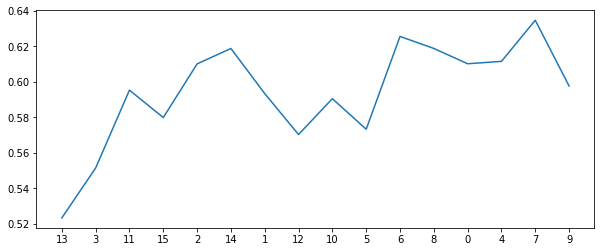

1326
all features [13, 15, 3, 14, 1, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 14, 1, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5785714285714286
specificity  0.5667043740573152
sensitivity  0.735
auc          0.6508521870286577


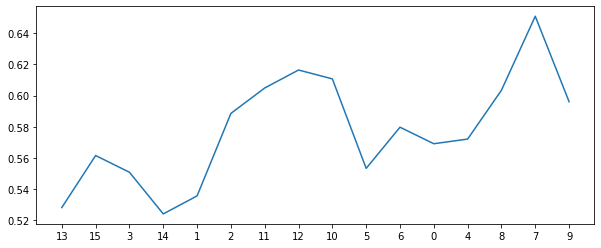

1327
all features [14, 15, 3, 13, 2, 11, 1, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [14, 15, 3, 13, 2, 11, 1, 12, 10, 5, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5232142857142857
specificity  0.5052790346907994
sensitivity  0.765
auc          0.6351395173453996


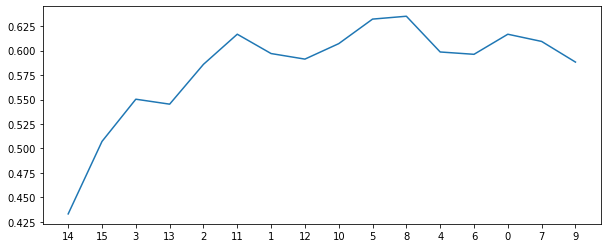

1328
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.575
specificity  0.5628582202111614
sensitivity  0.735
auc          0.6489291101055806


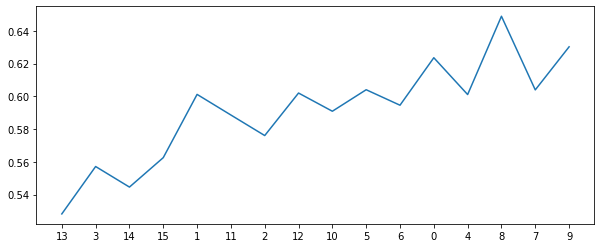

1329
all features [3, 13, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9, 16]
new features [3, 13, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 7, 4, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5553571428571429
specificity  0.5378959276018099
sensitivity  0.785
auc          0.661447963800905


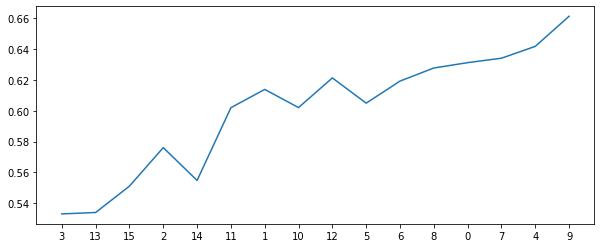

1330
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.5822398190045249
sensitivity  0.64
auc          0.6111199095022625


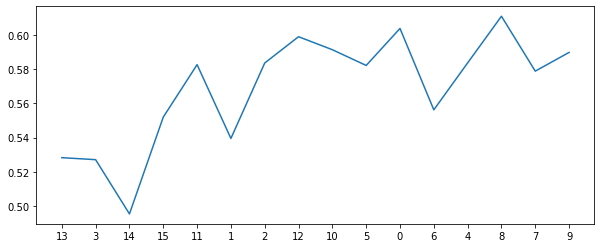

1331
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5375
specificity  0.5184389140271494
sensitivity  0.79
auc          0.6542194570135746


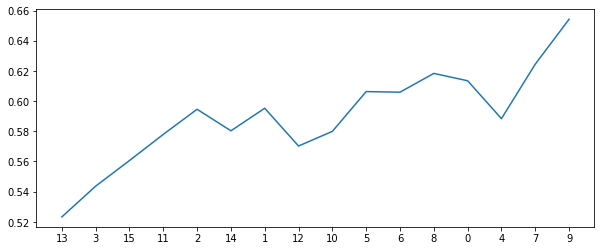

1332
all features [13, 3, 15, 1, 14, 2, 11, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 15, 1, 14, 2, 11]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6285714285714286
specificity  0.6322398190045249
sensitivity  0.595
auc          0.6136199095022624


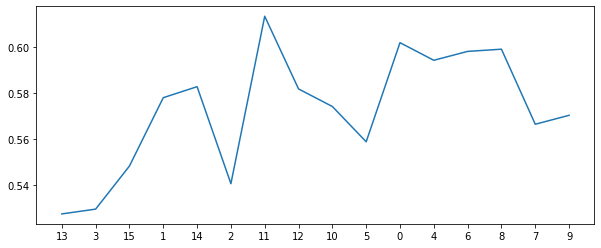

1333
all features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6375
specificity  0.6360859728506787
sensitivity  0.67
auc          0.6530429864253393


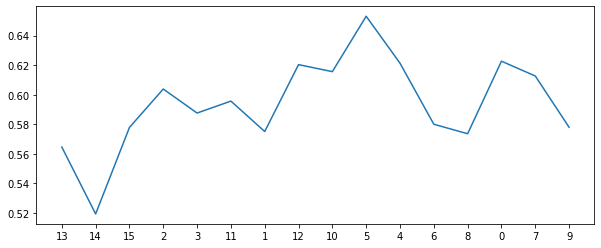

1334
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6822775263951735
sensitivity  0.615
auc          0.6486387631975867


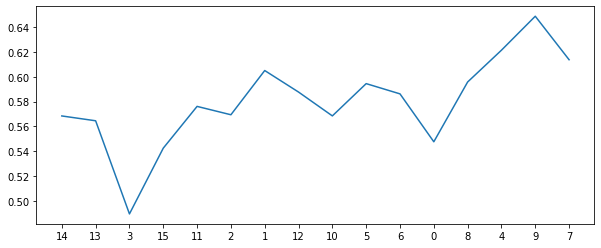

1335
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6553571428571429
specificity  0.653393665158371
sensitivity  0.69
auc          0.6716968325791856


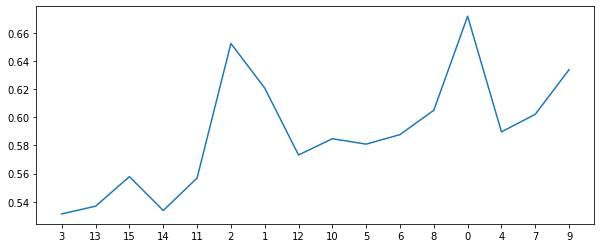

1336
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6392857142857143
specificity  0.6476998491704374
sensitivity  0.545
auc          0.5963499245852187


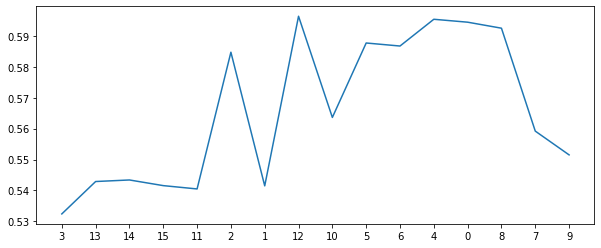

1337
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 6, 5, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 6, 5, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6495475113122172
sensitivity  0.635
auc          0.6422737556561086


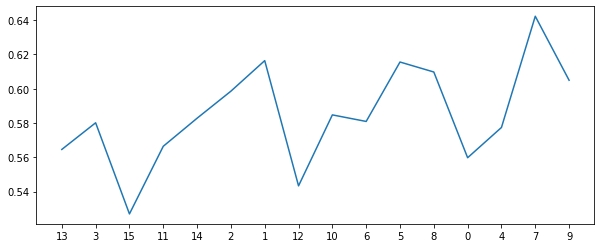

1338
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5678571428571428
specificity  0.5590874811463047
sensitivity  0.695
auc          0.6270437405731524


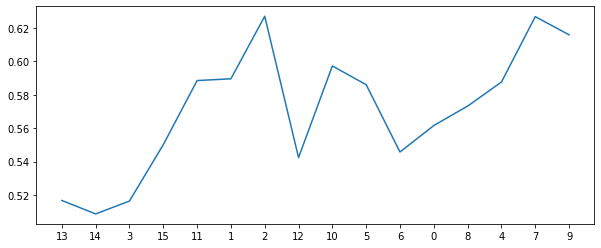

1339
all features [14, 15, 3, 13, 2, 11, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [14, 15, 3, 13, 2, 11]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5232142857142857
specificity  0.49935897435897436
sensitivity  0.84
auc          0.6696794871794872


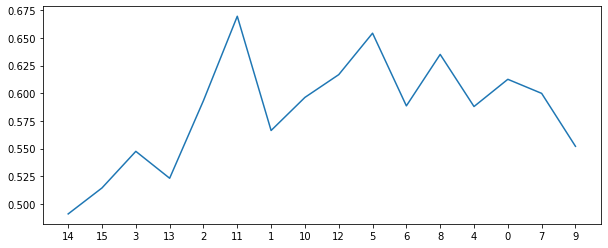

1340
all features [14, 13, 15, 2, 3, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 13, 15, 2, 3, 11, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5823152337858221
sensitivity  0.72
auc          0.651157616892911


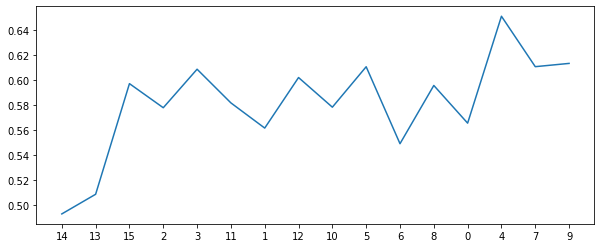

1341
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5861236802413273
sensitivity  0.695
auc          0.6405618401206636


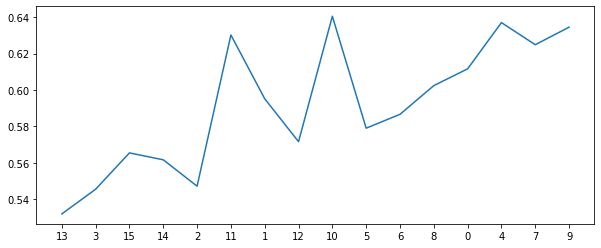

1342
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6342006033182503
sensitivity  0.62
auc          0.6271003016591252


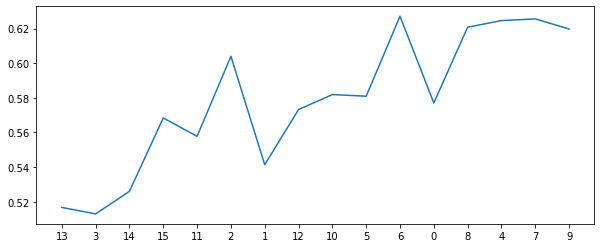

1343
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9]
[0.4, 2, 1000, 3, 1, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5552036199095023
sensitivity  0.685
auc          0.6201018099547512


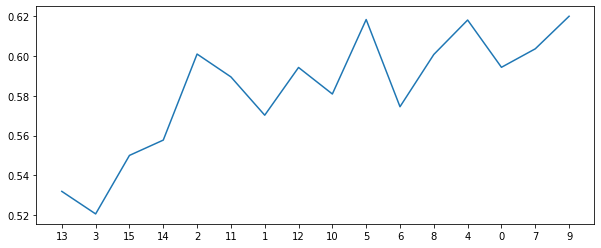

1344
all features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 1, 11, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5696428571428571
specificity  0.5629336349924585
sensitivity  0.665
auc          0.6139668174962293


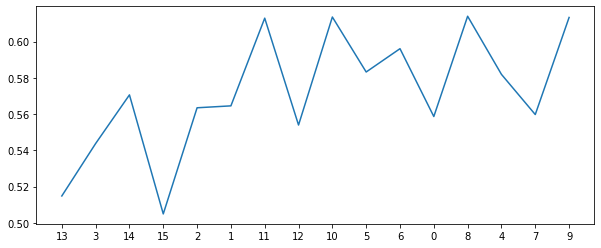

1345
all features [15, 13, 14, 3, 11, 2, 1, 12, 10, 5, 4, 8, 6, 0, 9, 7, 16]
new features [15, 13, 14, 3, 11, 2, 1, 12, 10, 5, 4, 8, 6, 0]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5321428571428571
specificity  0.5147812971342383
sensitivity  0.765
auc          0.6398906485671192


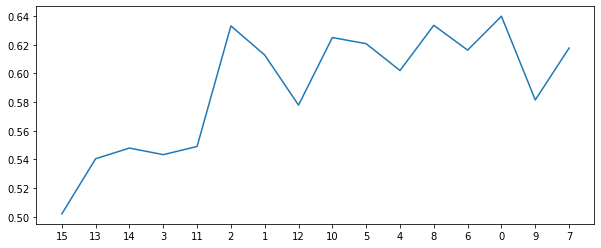

1346
all features [14, 13, 3, 15, 1, 2, 11, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [14, 13, 3, 15, 1, 2, 11, 12]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5357142857142857
specificity  0.5225867269984917
sensitivity  0.72
auc          0.6212933634992458


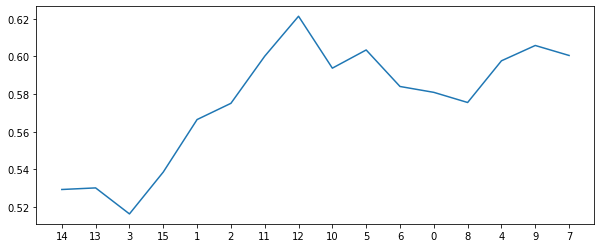

1347
all features [3, 13, 15, 14, 2, 1, 11, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 15, 14, 2, 1, 11, 12, 10]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5642857142857143
specificity  0.5513574660633485
sensitivity  0.74
auc          0.6456787330316742


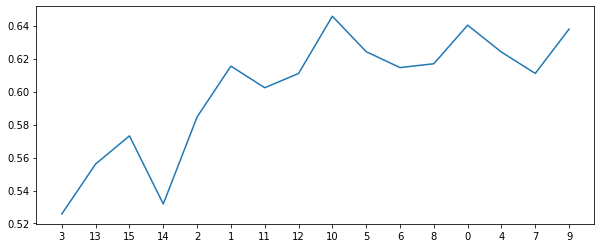

1348
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.603393665158371
sensitivity  0.69
auc          0.6466968325791855


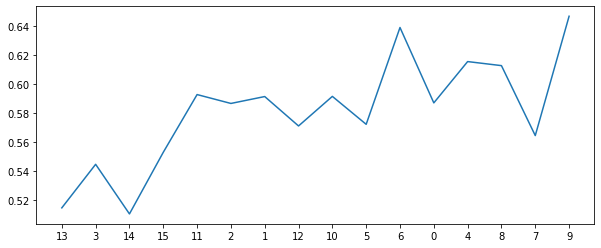

1349
all features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 2, 11, 15, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 1, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.55
specificity  0.5319758672699849
sensitivity  0.785
auc          0.6584879336349925


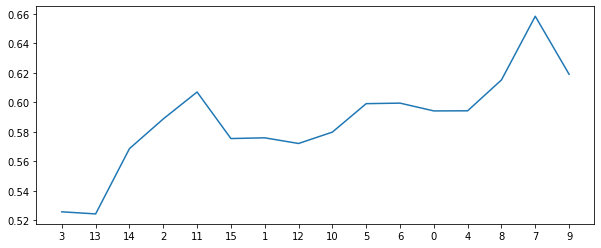

1350
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6649321266968325
sensitivity  0.545
auc          0.6049660633484163


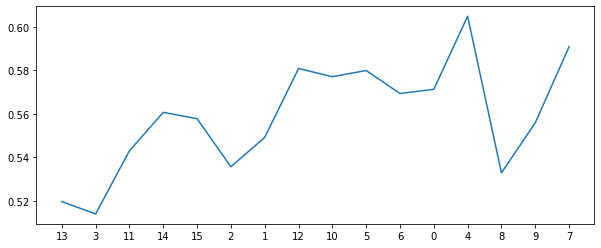

1351
all features [13, 15, 14, 2, 3, 11, 1, 10, 12, 6, 5, 0, 8, 4, 7, 9, 16]
new features [13, 15, 14, 2, 3, 11, 1, 10, 12, 6, 5, 0, 8]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6207767722473605
sensitivity  0.67
auc          0.6453883861236802


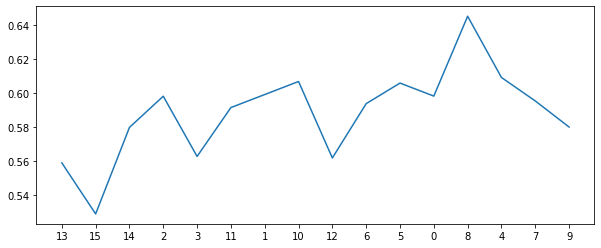

1352
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6938536953242835
sensitivity  0.545
auc          0.6194268476621417


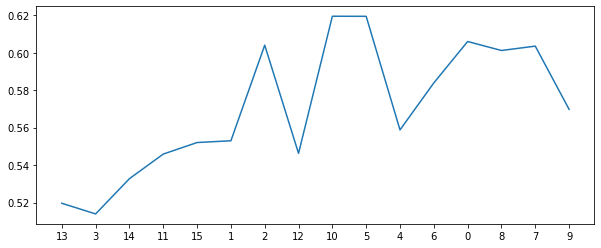

1353
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.6572398190045249
sensitivity  0.62
auc          0.6386199095022624


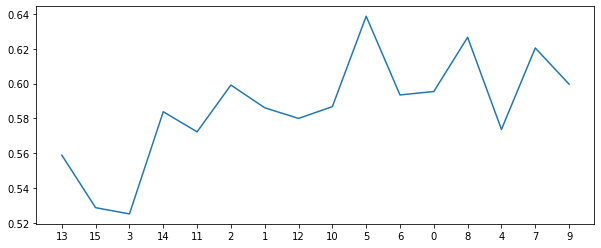

1354
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 7, 8, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6899698340874811
sensitivity  0.52
auc          0.6049849170437406


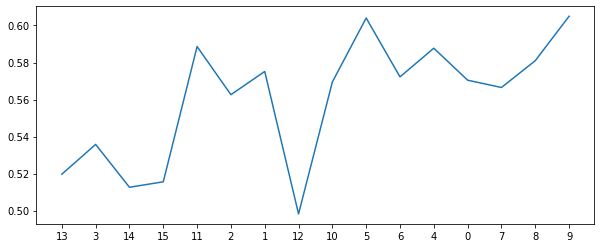

1355
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 4, 8, 0, 9, 7, 16]
new features [3, 13, 15, 11]
[0.4, 2, 1000, 3, 1, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5685897435897436
sensitivity  0.695
auc          0.6317948717948718


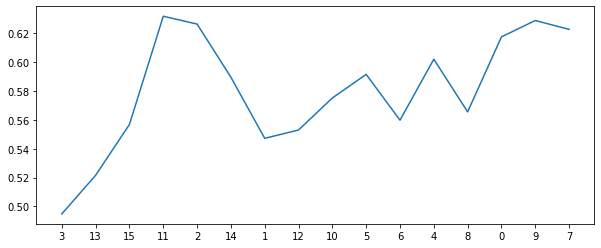

1356
all features [3, 11, 13, 14, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 11, 13, 14, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.628393665158371
sensitivity  0.615
auc          0.6216968325791855


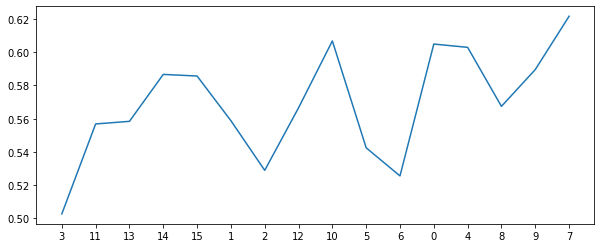

1357
all features [13, 14, 11, 3, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 11, 3, 15, 2]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5878582202111614
sensitivity  0.69
auc          0.6389291101055807


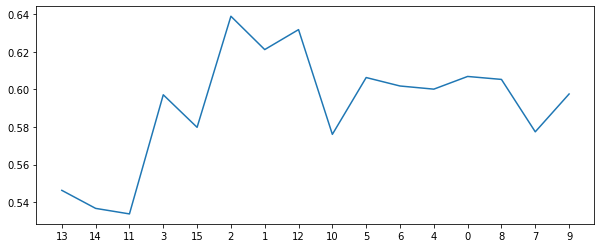

1358
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6160714285714286
specificity  0.6168552036199095
sensitivity  0.62
auc          0.6184276018099547


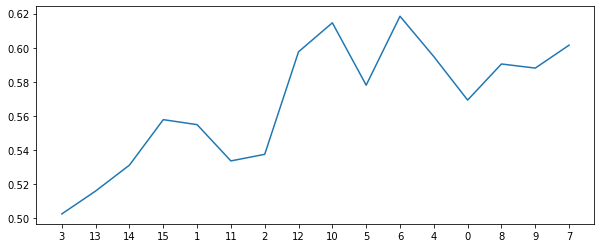

1359
all features [3, 13, 15, 14, 2, 11, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 10, 12, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6187405731523379
sensitivity  0.69
auc          0.6543702865761689


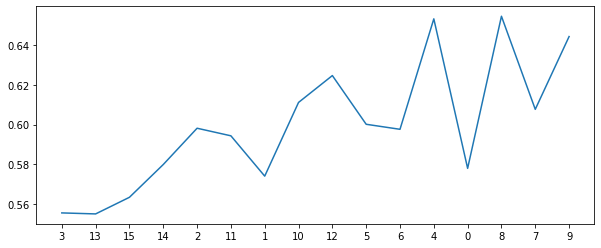

1360
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6514705882352941
sensitivity  0.59
auc          0.620735294117647


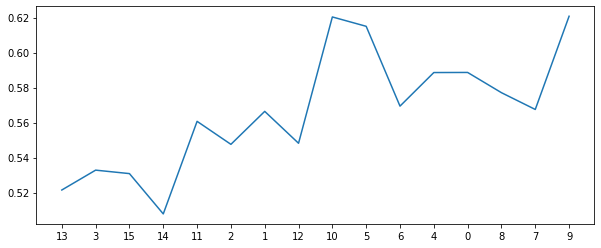

1361
all features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 15, 11, 2, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6052413273001508
sensitivity  0.685
auc          0.6451206636500755


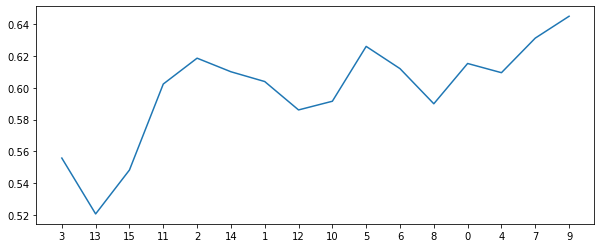

1362
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5642857142857143
specificity  0.5552790346907994
sensitivity  0.695
auc          0.6251395173453997


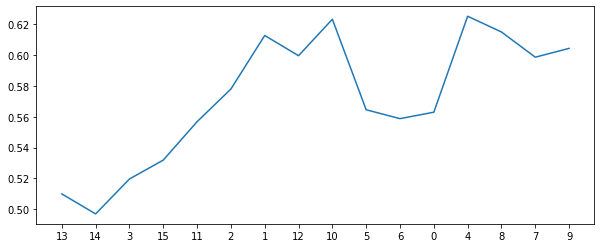

1363
all features [13, 14, 3, 2, 15, 11, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 3, 2, 15, 11, 1, 10, 12, 5, 6, 4, 8, 0]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5803571428571428
specificity  0.566553544494721
sensitivity  0.76
auc          0.6632767722473605


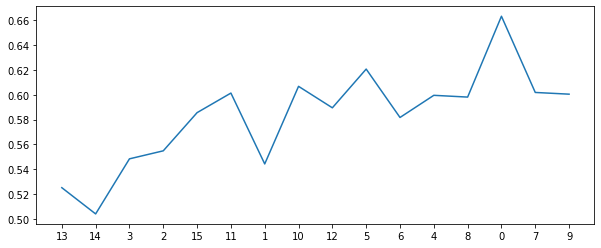

1364
all features [3, 13, 14, 15, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6015460030165912
sensitivity  0.67
auc          0.6357730015082956


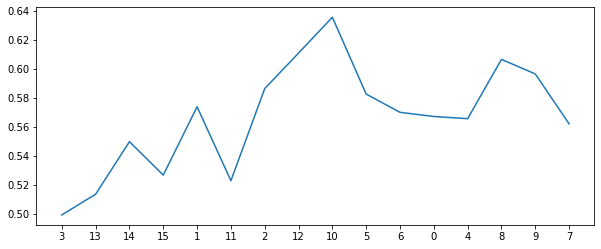

1365
all features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 2, 15, 11, 1, 10, 12, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5821428571428572
specificity  0.5725113122171945
sensitivity  0.71
auc          0.6412556561085972


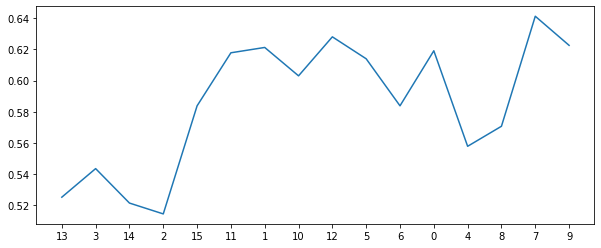

1366
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.5785714285714286
specificity  0.5705882352941176
sensitivity  0.695
auc          0.6327941176470588


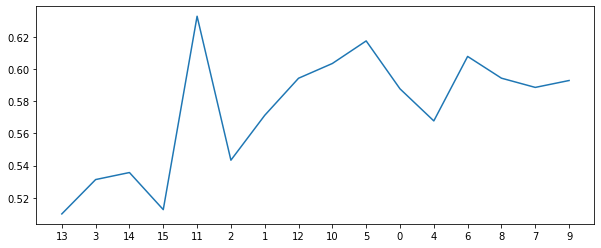

1367
all features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2, 14, 1, 10, 12, 5, 6, 0, 8, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5802413273001509
sensitivity  0.685
auc          0.6326206636500754


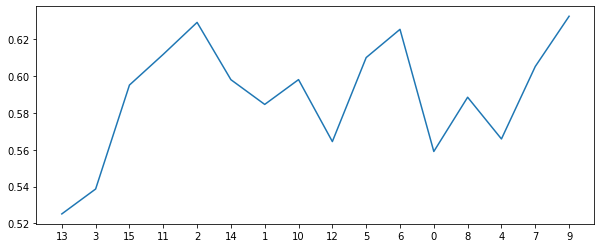

1368
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6496229260935144
sensitivity  0.62
auc          0.6348114630467572


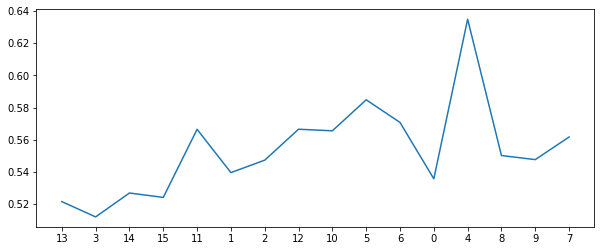

1369
all features [13, 15, 11, 14, 3, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 15, 11, 14, 3, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6630844645550528
sensitivity  0.59
auc          0.6265422322775264


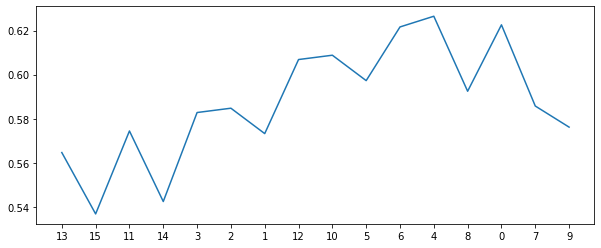

1370
all features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6875
specificity  0.6995475113122172
sensitivity  0.545
auc          0.6222737556561087


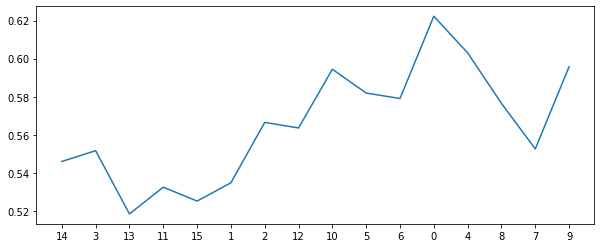

1371
all features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 7, 9, 4, 16]
new features [13, 15, 3, 14, 2]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6375
specificity  0.639894419306184
sensitivity  0.62
auc          0.629947209653092


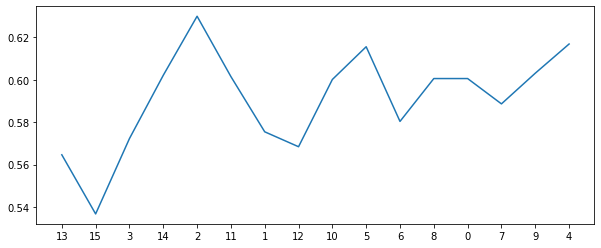

1372
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6839285714285714
specificity  0.6976998491704374
sensitivity  0.52
auc          0.6088499245852187


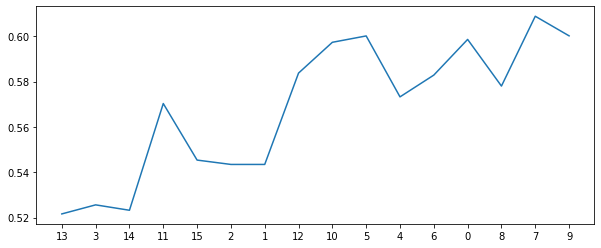

1373
all features [13, 15, 3, 11, 2, 14, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 15, 3, 11, 2]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6160714285714286
specificity  0.610897435897436
sensitivity  0.69
auc          0.650448717948718


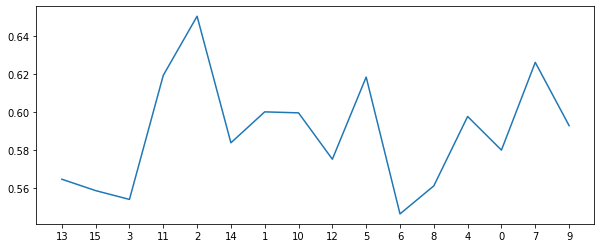

1374
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6245475113122172
sensitivity  0.66
auc          0.6422737556561086


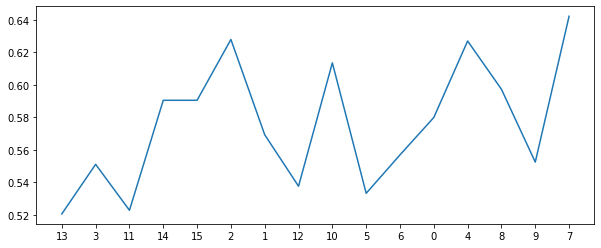

1375
all features [14, 13, 15, 11, 2, 3, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [14, 13, 15, 11, 2, 3, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5678571428571428
specificity  0.5533559577677225
sensitivity  0.765
auc          0.6591779788838612


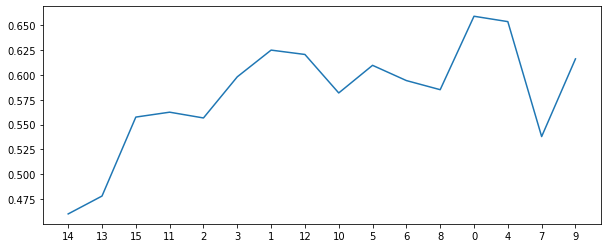

1376
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6147812971342383
sensitivity  0.62
auc          0.6173906485671191


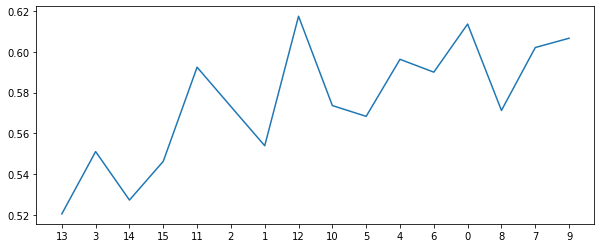

1377
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 6, 5, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.5803571428571428
specificity  0.5705882352941176
sensitivity  0.72
auc          0.6452941176470588


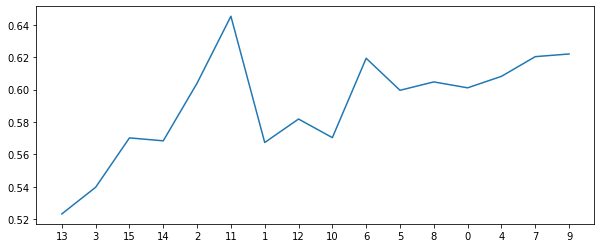

1378
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6341251885369532
sensitivity  0.595
auc          0.6145625942684766


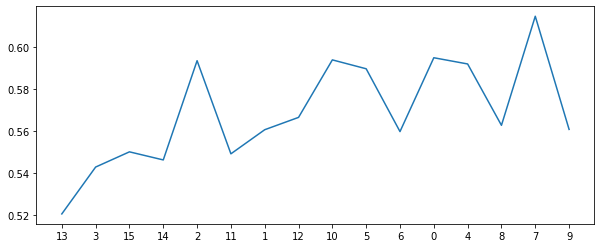

1379
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5955882352941176
sensitivity  0.715
auc          0.6552941176470588


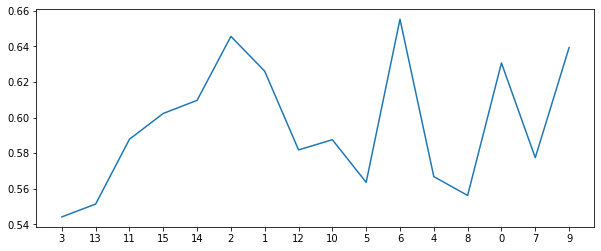

1380
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 8, 4, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5764705882352941
sensitivity  0.695
auc          0.6357352941176471


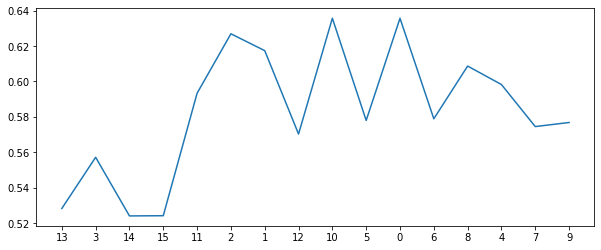

1381
all features [13, 14, 11, 15, 2, 3, 1, 12, 10, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 14, 11, 15, 2, 3]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5339285714285714
specificity  0.514630467571644
sensitivity  0.785
auc          0.6498152337858221


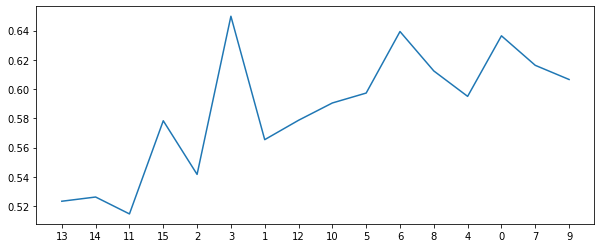

1382
all features [14, 3, 13, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5660714285714286
specificity  0.5590120663650076
sensitivity  0.67
auc          0.6145060331825037


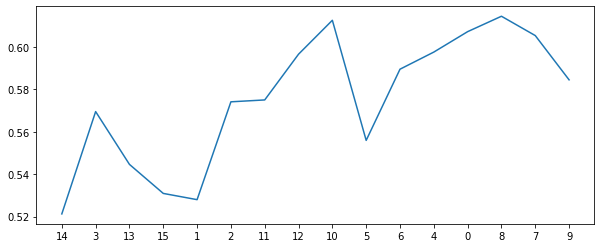

1383
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5607142857142857
specificity  0.5475113122171946
sensitivity  0.74
auc          0.6437556561085973


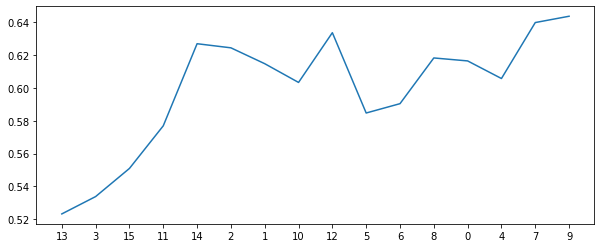

1384
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6187405731523379
sensitivity  0.665
auc          0.641870286576169


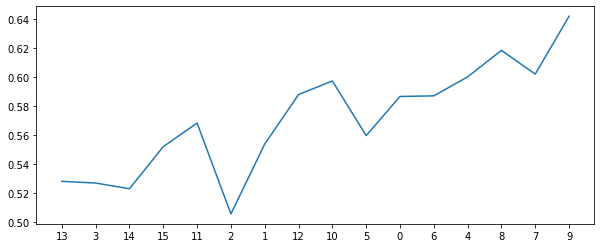

1385
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 7, 4, 9]
[0.4, 2, 1000, 3, 1, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5610859728506787
sensitivity  0.735
auc          0.6480429864253393


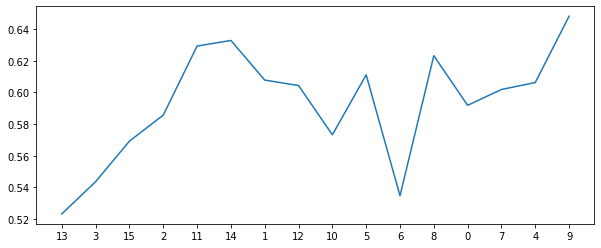

1386
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6649698340874811
sensitivity  0.545
auc          0.6049849170437406


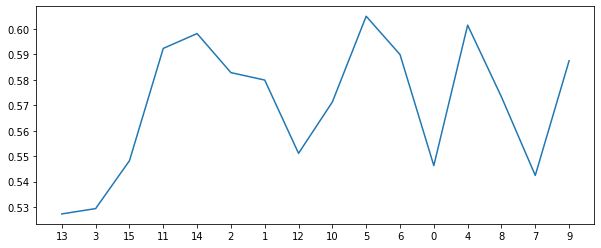

1387
all features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 8, 4, 6, 0, 7, 9, 16]
new features [13, 14, 15, 2, 3, 11, 1, 12, 10, 5, 8, 4, 6, 0]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6726244343891403
sensitivity  0.59
auc          0.6313122171945701


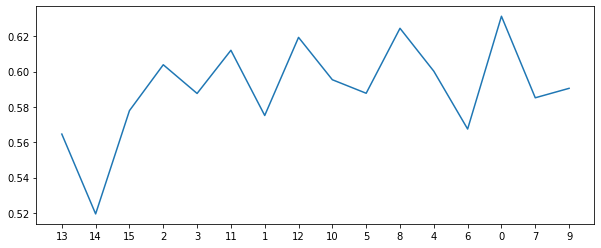

1388
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6591251885369532
sensitivity  0.595
auc          0.6270625942684767


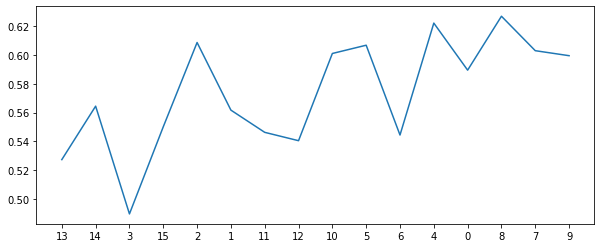

1389
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.65
specificity  0.653393665158371
sensitivity  0.61
auc          0.6316968325791855


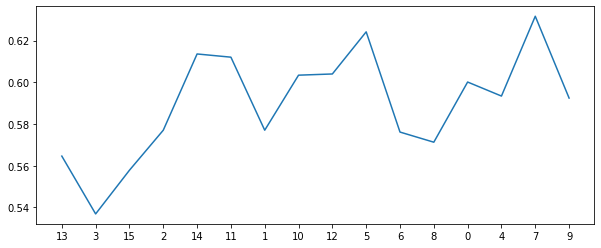

1390
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6767857142857143
specificity  0.6880467571644042
sensitivity  0.545
auc          0.6165233785822021


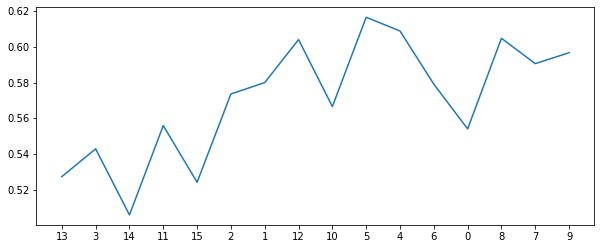

1391
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9]
[0.4, 2, 1000, 3, 1, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6745852187028658
sensitivity  0.57
auc          0.6222926093514329


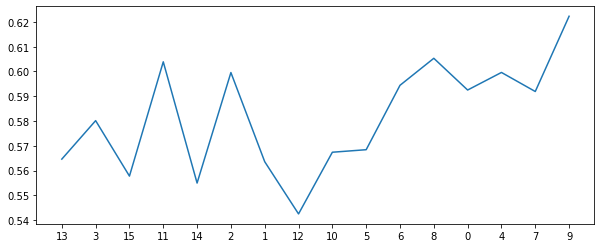

1392
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 9, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.5975490196078431
sensitivity  0.69
auc          0.6437745098039216


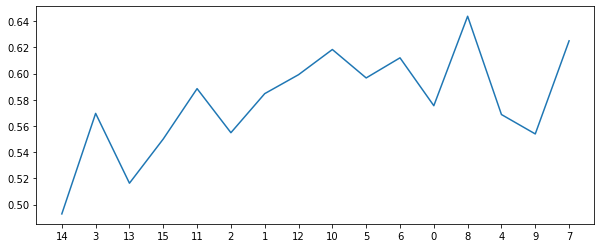

1393
all features [13, 14, 2, 15, 3, 11, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 14, 2, 15, 3, 11]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5803571428571429
specificity  0.5686651583710407
sensitivity  0.745
auc          0.6568325791855203


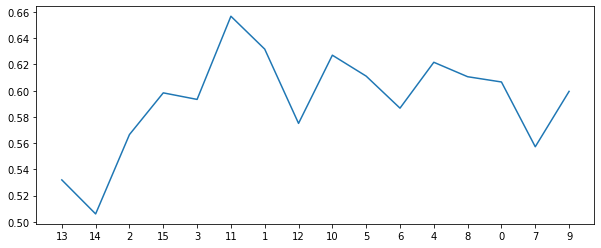

1394
all features [13, 3, 14, 15, 1, 2, 11, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 1, 2, 11, 12]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6302413273001508
sensitivity  0.67
auc          0.6501206636500754


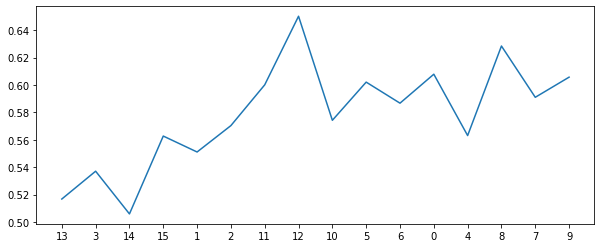

1395
all features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5714285714285714
specificity  0.5629336349924585
sensitivity  0.695
auc          0.6289668174962293


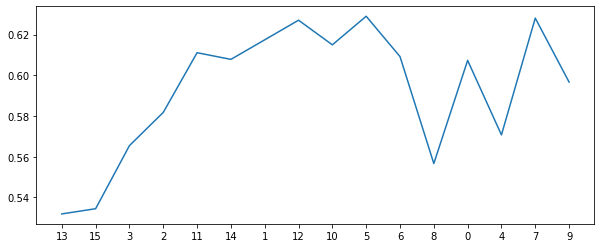

1396
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6178571428571429
specificity  0.6148190045248869
sensitivity  0.665
auc          0.6399095022624435


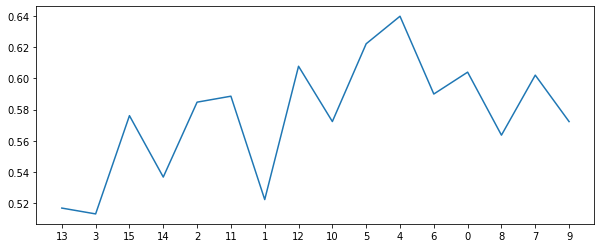

1397
all features [13, 3, 15, 11, 2, 14, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 11, 2]
[0.4, 2, 1000, 3, 1, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.55
specificity  0.5358974358974359
sensitivity  0.74
auc          0.637948717948718


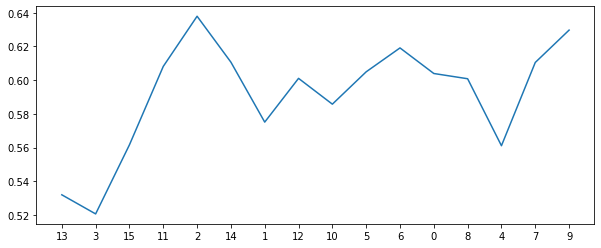

1398
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5571428571428572
specificity  0.5437782805429864
sensitivity  0.74
auc          0.6418891402714932


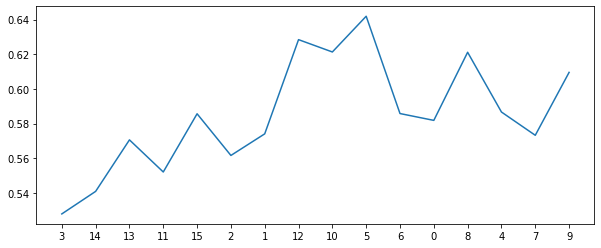

1399
all features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 14, 15, 3, 2, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5446428571428571
specificity  0.5302790346907994
sensitivity  0.74
auc          0.6351395173453998


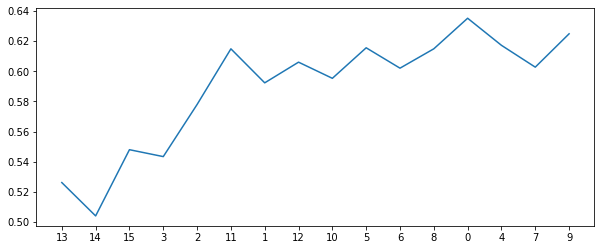

1400
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6125
specificity  0.6091628959276018
sensitivity  0.665
auc          0.6370814479638008


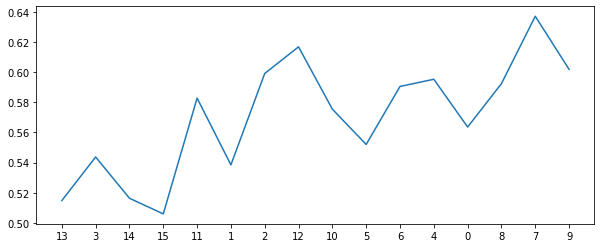

1401
all features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 10, 12, 5, 6, 4, 8, 0, 7]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5732142857142857
specificity  0.5591251885369533
sensitivity  0.76
auc          0.6595625942684766


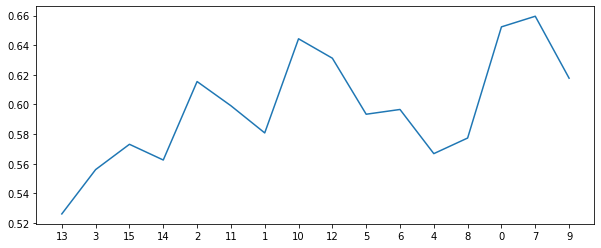

1402
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.58789592760181
sensitivity  0.695
auc          0.641447963800905


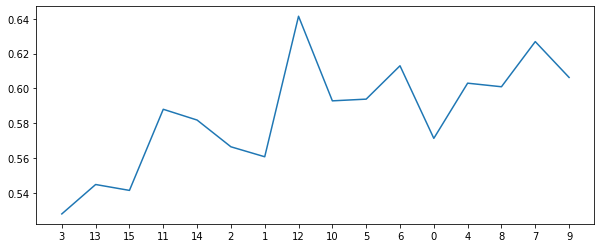

1403
all features [13, 3, 15, 2, 11, 14, 1, 10, 12, 6, 5, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 2, 11, 14, 1, 10, 12, 6, 5, 8, 0, 4, 9, 7]
[0.4, 2, 1000, 3, 1, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.575
specificity  0.5609351432880845
sensitivity  0.76
auc          0.6604675716440422


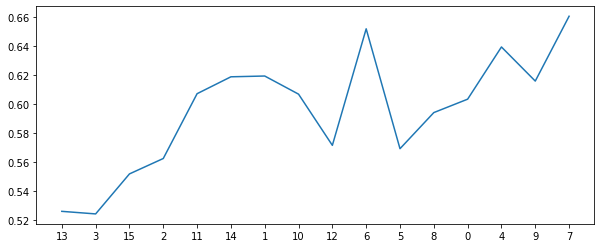

1404
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6749999999999999
specificity  0.684238310708899
sensitivity  0.57
auc          0.6271191553544495


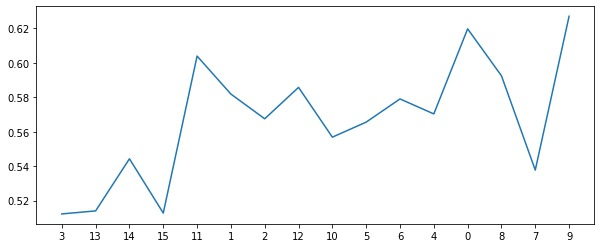

1405
all features [13, 15, 3, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 15, 3, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6301282051282051
sensitivity  0.64
auc          0.6350641025641025


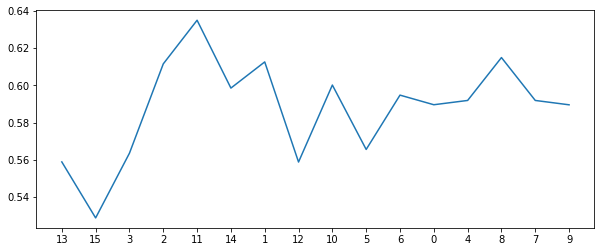

1406
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6996606334841629
sensitivity  0.52
auc          0.6098303167420814


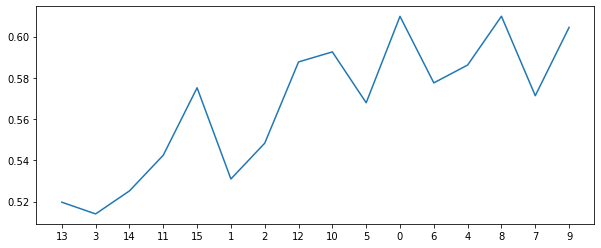

1407
all features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 2, 15, 14, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6785714285714286
specificity  0.6802413273001509
sensitivity  0.66
auc          0.6701206636500754


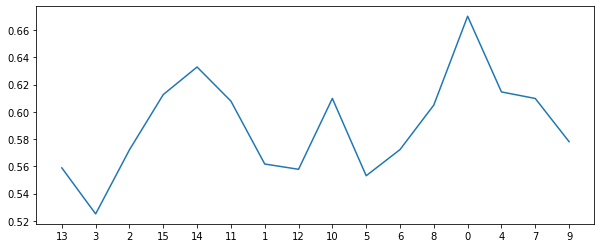

1408
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 6]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.666892911010558
sensitivity  0.52
auc          0.5934464555052791


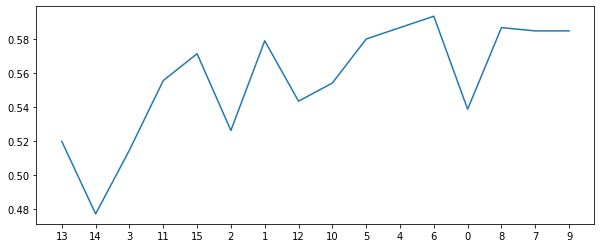

1409
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1]
[0.4, 2, 1000, 3, 1, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.630316742081448
sensitivity  0.595
auc          0.612658371040724


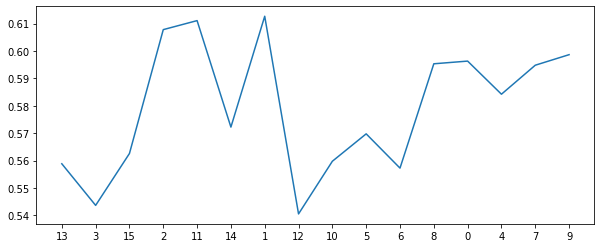

1410
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6341628959276018
sensitivity  0.62
auc          0.6270814479638009


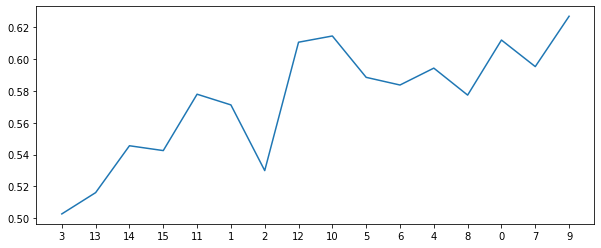

1411
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6035714285714285
specificity  0.5937782805429864
sensitivity  0.74
auc          0.6668891402714933


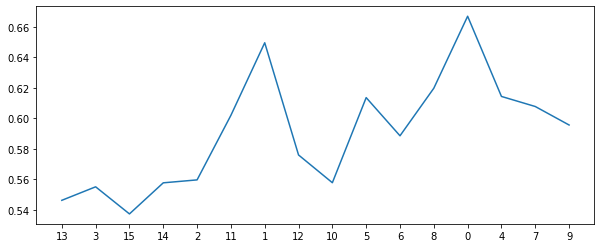

1412
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.65
specificity  0.6514705882352941
sensitivity  0.645
auc          0.648235294117647


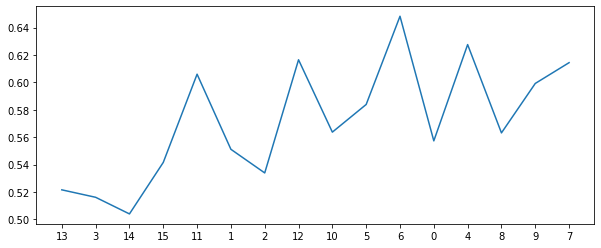

1413
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 15, 3, 14, 11, 2]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5696428571428571
specificity  0.5571266968325792
sensitivity  0.74
auc          0.6485633484162896


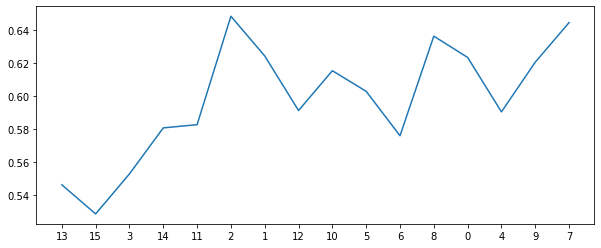

1414
all features [13, 3, 15, 14, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 14, 1, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6464285714285715
specificity  0.6515460030165913
sensitivity  0.595
auc          0.6232730015082957


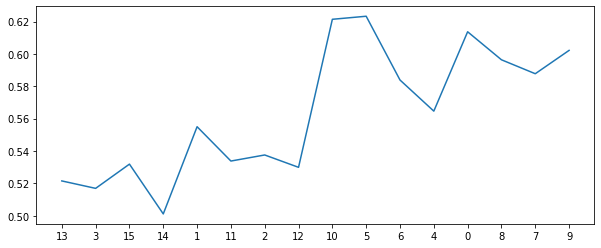

1415
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 9, 7, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5918929110105581
sensitivity  0.685
auc          0.638446455505279


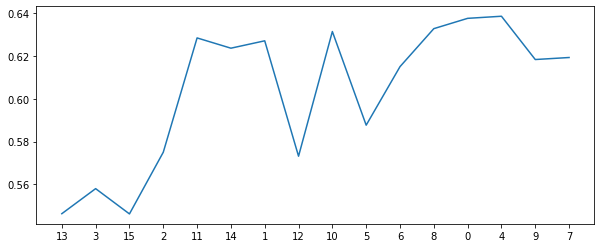

1416
all features [3, 13, 15, 14, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 1, 11, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6071428571428572
specificity  0.6053544494720965
sensitivity  0.64
auc          0.6226772247360483


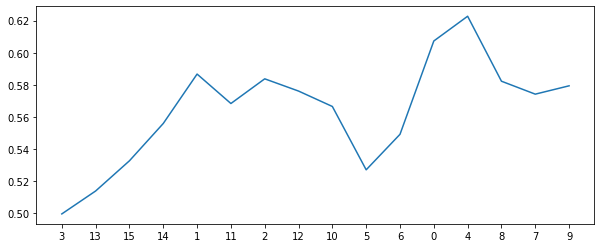

1417
all features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 14, 3, 11, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5571428571428572
specificity  0.5455882352941177
sensitivity  0.715
auc          0.6302941176470588


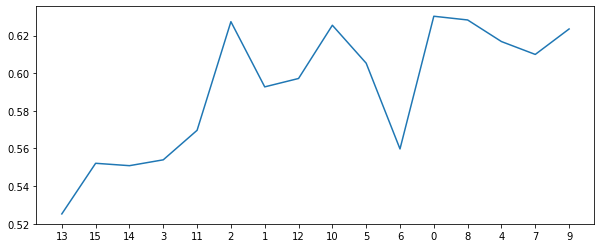

1418
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6130844645550528
sensitivity  0.64
auc          0.6265422322775264


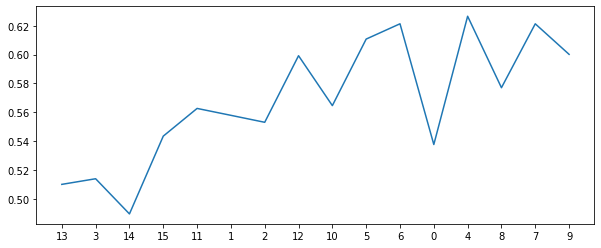

1419
all features [13, 3, 14, 15, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5625
specificity  0.5494343891402715
sensitivity  0.74
auc          0.6447171945701358


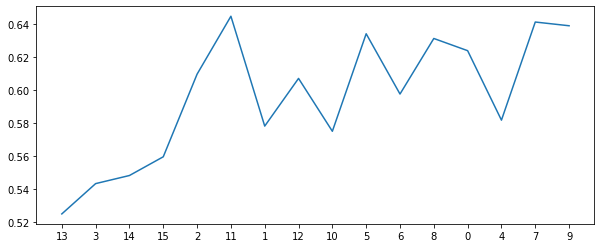

1420
all features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 11, 14, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6226244343891403
sensitivity  0.595
auc          0.6088122171945701


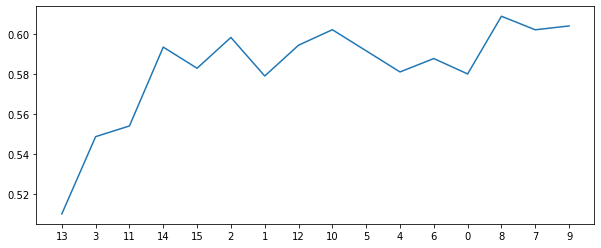

1421
all features [3, 13, 15, 11, 2, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 15, 11, 2, 14, 1, 10, 12, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.5338989441930618
sensitivity  0.735
auc          0.6344494720965309


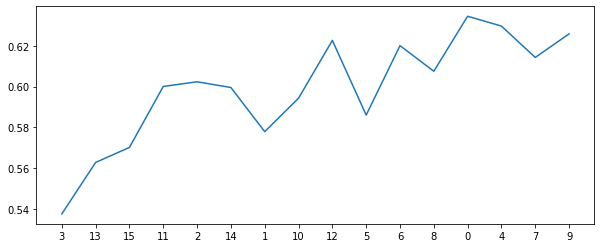

1422
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6857142857142857
specificity  0.6958521870286576
sensitivity  0.565
auc          0.6304260935143288


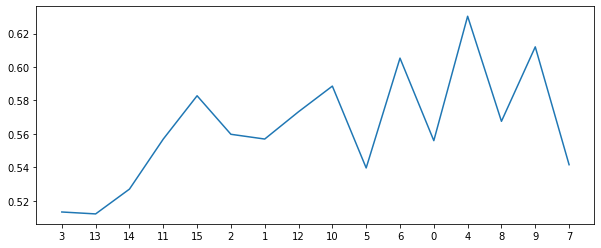

1423
all features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 15, 3, 14, 11, 2, 1, 12, 10, 5, 6, 0, 8]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6303544494720965
sensitivity  0.64
auc          0.6351772247360483


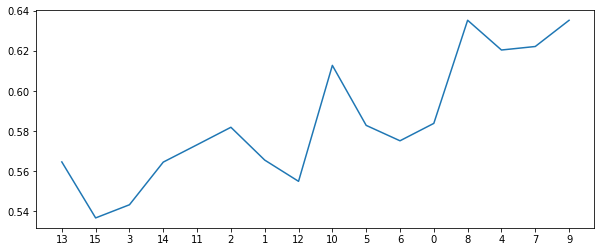

1424
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6714285714285714
specificity  0.6861613876319759
sensitivity  0.495
auc          0.5905806938159879


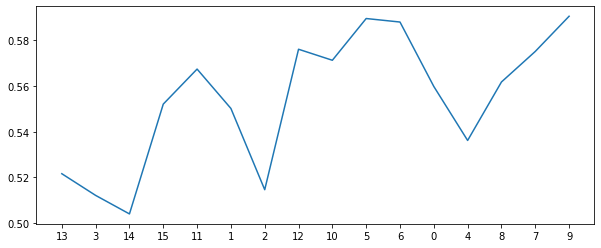

1425
all features [13, 3, 14, 11, 2, 15, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 2, 15]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6282428355957768
sensitivity  0.665
auc          0.6466214177978884


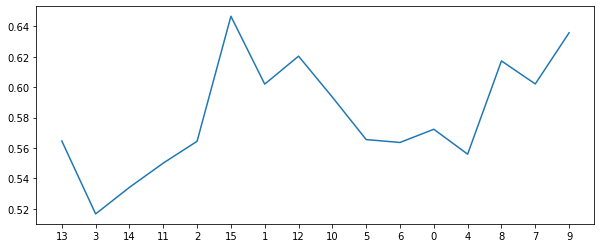

1426
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6892857142857143
specificity  0.7035067873303167
sensitivity  0.52
auc          0.6117533936651584


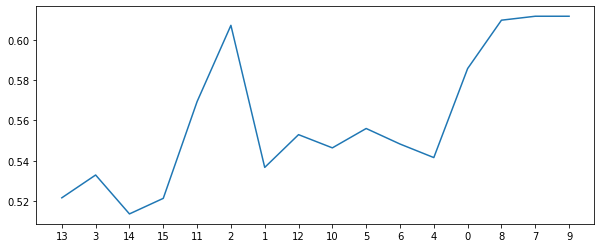

1427
all features [3, 13, 2, 15, 11, 14, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [3, 13, 2, 15]
[0.4, 2, 1000, 3, 1, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.570550527903469
sensitivity  0.67
auc          0.6202752639517346


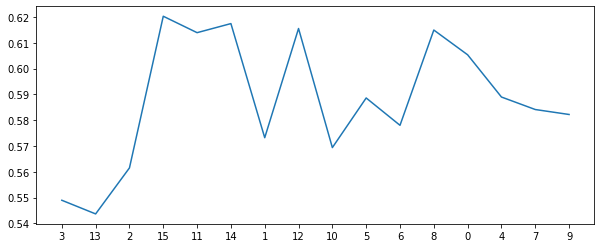

1428
all features [3, 13, 15, 14, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.5782428355957768
sensitivity  0.695
auc          0.6366214177978884


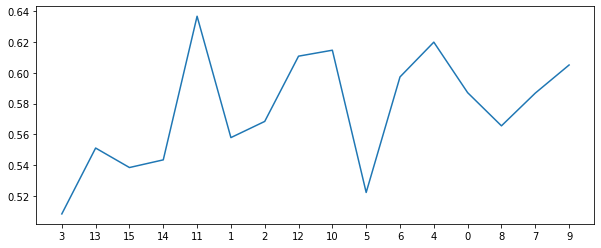

1429
all features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5897812971342383
sensitivity  0.71
auc          0.6498906485671192


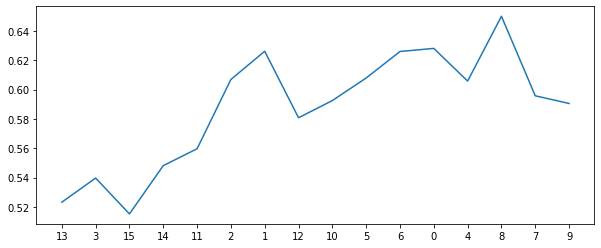

1430
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 4, 6, 8, 0, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6417420814479639
sensitivity  0.565
auc          0.6033710407239818


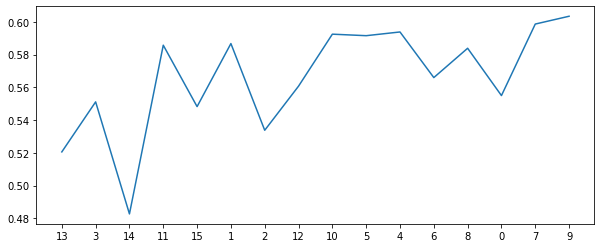

1431
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6053167420814479
sensitivity  0.685
auc          0.6451583710407239


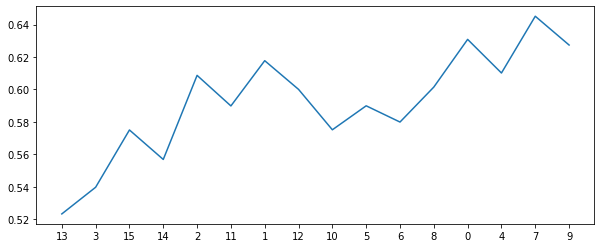

1432
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5898567119155355
sensitivity  0.64
auc          0.6149283559577677


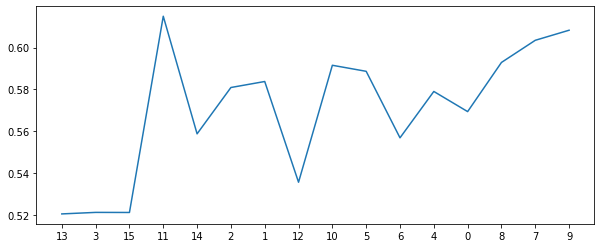

1433
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 6, 5, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 2, 11, 14, 1, 12, 10, 6]
[0.4, 2, 1000, 3, 1, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5743212669683257
sensitivity  0.765
auc          0.6696606334841629


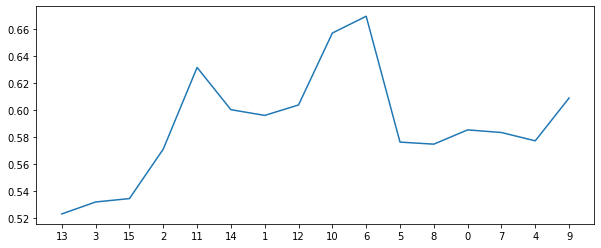

1434
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5642857142857143
specificity  0.5533559577677225
sensitivity  0.72
auc          0.6366779788838612


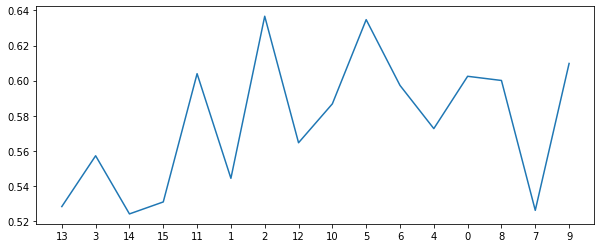

1435
all features [13, 15, 3, 2, 11, 14, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 3, 2, 11, 14, 1, 10, 12]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5446428571428571
specificity  0.5283559577677225
sensitivity  0.77
auc          0.6491779788838612


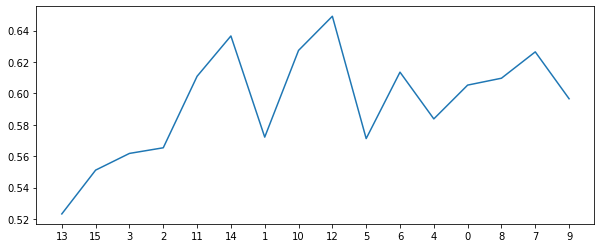

1436
all features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.6014328808446455
sensitivity  0.645
auc          0.6232164404223227


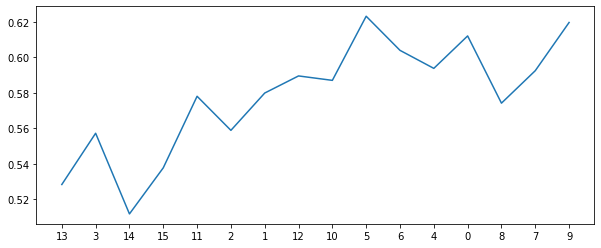

1437
all features [13, 15, 3, 14, 2, 11, 1, 12, 10, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 15, 3, 14, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5321428571428571
specificity  0.5146681749622926
sensitivity  0.765
auc          0.6398340874811463


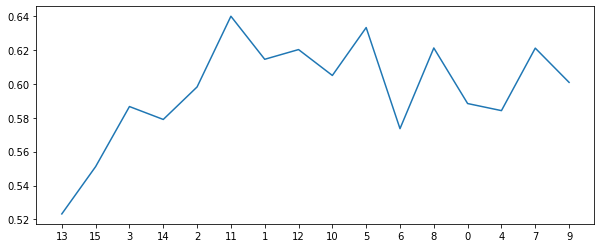

1438
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6207390648567119
sensitivity  0.665
auc          0.642869532428356


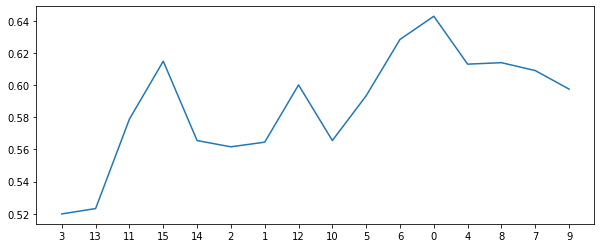

1439
all features [13, 15, 3, 2, 11, 14, 1, 10, 12, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 15, 3, 2, 11, 14]
[0.4, 2, 1000, 3, 1, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.5302036199095023
sensitivity  0.79
auc          0.6601018099547511


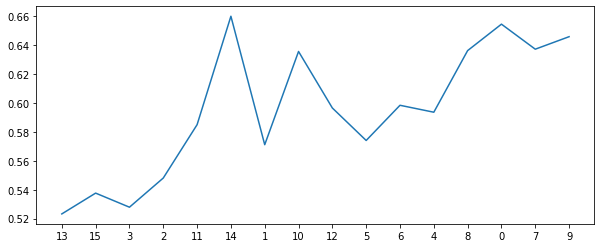

1440
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6784690799396682
sensitivity  0.56
auc          0.619234539969834


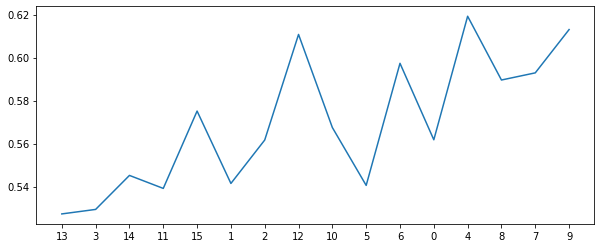

1441
all features [13, 15, 3, 11, 14, 2, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 15, 3, 11, 14, 2, 1]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6456636500754148
sensitivity  0.615
auc          0.6303318250377075


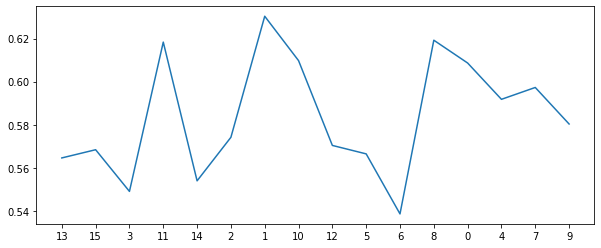

1442
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6928571428571428
specificity  0.7073906485671192
sensitivity  0.515
auc          0.6111953242835596


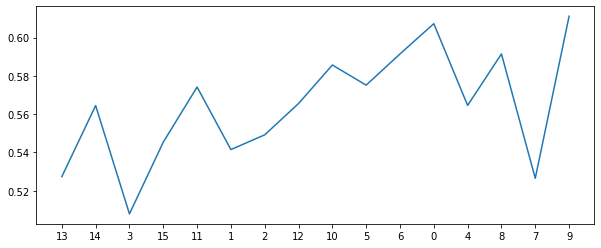

1443
all features [13, 3, 15, 2, 11, 14, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6128582202111614
sensitivity  0.64
auc          0.6264291101055807


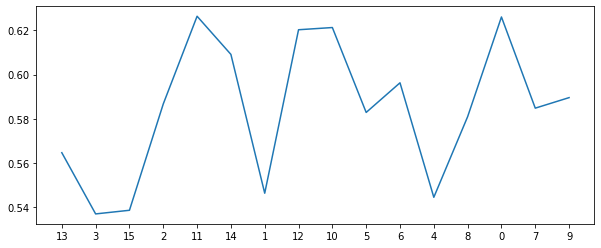

1444
all features [13, 14, 11, 3, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 11, 3, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6630090497737556
sensitivity  0.54
auc          0.6015045248868778


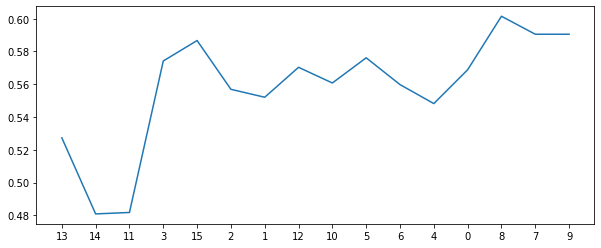

1445
all features [13, 3, 15, 2, 11, 14, 12, 1, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [13, 3, 15, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5858974358974359
sensitivity  0.665
auc          0.6254487179487179


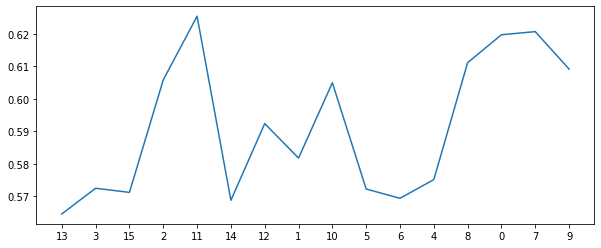

1446
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6360859728506787
sensitivity  0.64
auc          0.6380429864253394


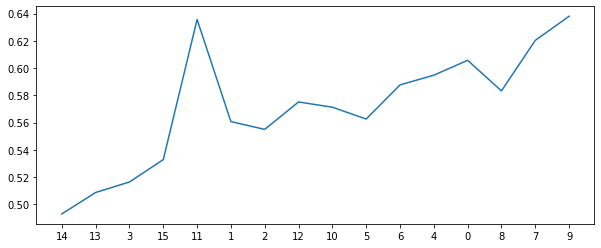

1447
all features [13, 15, 14, 3, 2, 11, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 15, 14, 3, 2, 11, 1, 10, 12, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5928571428571429
specificity  0.5860859728506788
sensitivity  0.685
auc          0.6355429864253394


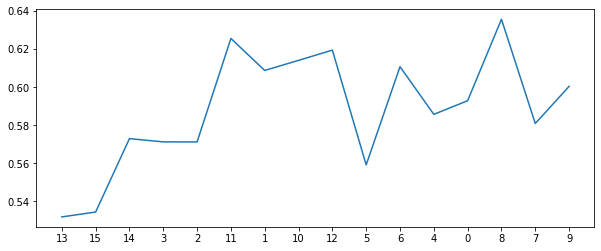

1448
all features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6341628959276018
sensitivity  0.615
auc          0.6245814479638009


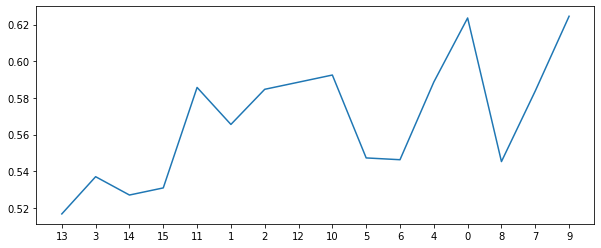

1449
all features [13, 3, 15, 14, 2, 11, 12, 1, 10, 5, 6, 8, 0, 7, 4, 9, 16]
new features [13, 3, 15, 14, 2, 11, 12, 1, 10, 5, 6, 8, 0]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5802790346907994
sensitivity  0.71
auc          0.6451395173453996


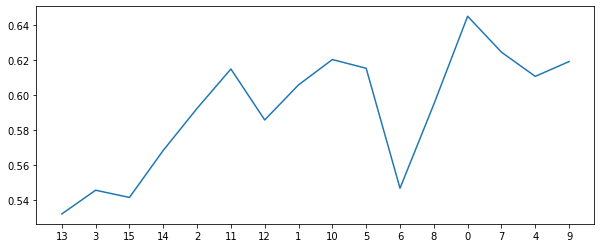

1450
all features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [3, 13, 11, 15, 14, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6446428571428571
specificity  0.6495475113122172
sensitivity  0.595
auc          0.6222737556561085


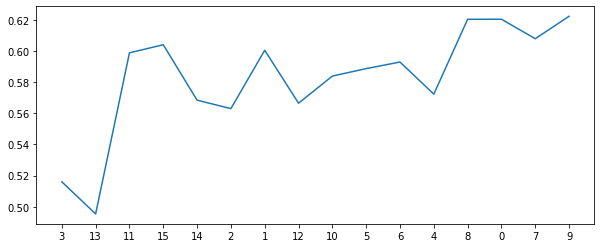

1451
all features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 11, 14, 2, 1, 10, 12, 5, 6, 8, 4]
[0.4, 2, 1000, 3, 1, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5782051282051281
sensitivity  0.71
auc          0.6441025641025641


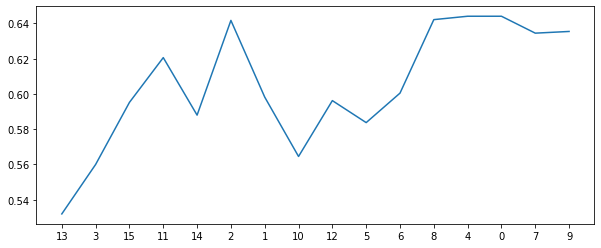

1452
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5857142857142857
specificity  0.5783559577677224
sensitivity  0.695
auc          0.6366779788838612


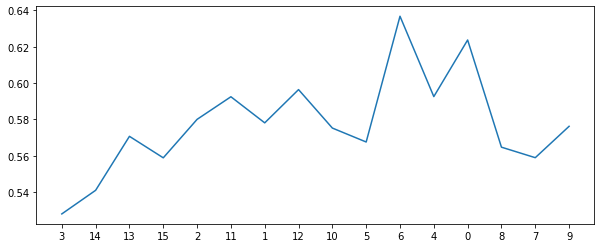

1453
all features [13, 15, 3, 2, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4, 7, 9, 16]
new features [13, 15, 3, 2, 11, 14, 1, 10, 12, 5, 6, 8, 0, 4]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5321428571428571
specificity  0.5167420814479639
sensitivity  0.745
auc          0.6308710407239819


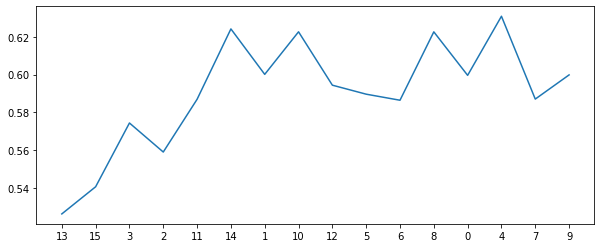

1454
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5875
specificity  0.5782805429864254
sensitivity  0.715
auc          0.6466402714932127


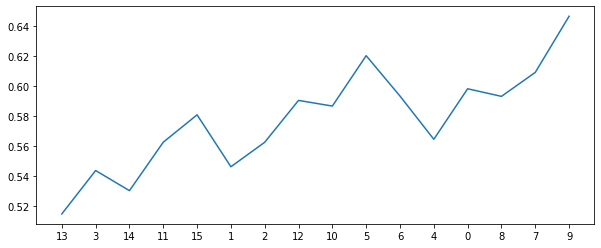

1455
all features [13, 3, 15, 14, 2, 11, 1, 12, 10, 5, 6, 0, 8, 4, 7, 9, 16]
new features [13, 3, 15, 14, 2, 11]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5303571428571429
specificity  0.5128582202111613
sensitivity  0.77
auc          0.6414291101055807


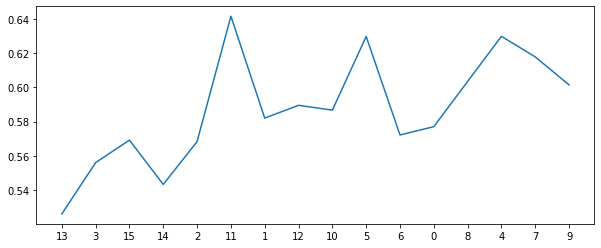

1456
all features [13, 3, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 15, 11]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5571428571428572
specificity  0.545475113122172
sensitivity  0.715
auc          0.6302375565610859


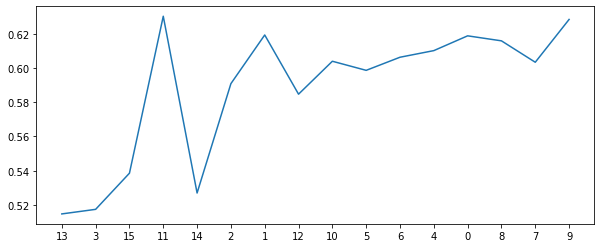

1457
all features [13, 3, 15, 2, 14, 11, 1, 10, 12, 5, 6, 8, 4, 0, 7, 9, 16]
new features [13, 3, 15, 2, 14, 11]
[0.4, 2, 1000, 3, 1, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5160714285714286
specificity  0.4973981900452489
sensitivity  0.765
auc          0.6311990950226244


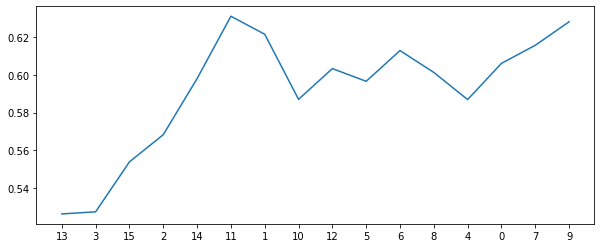

1458
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 0, 6, 8, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6744720965309201
sensitivity  0.565
auc          0.61973604826546


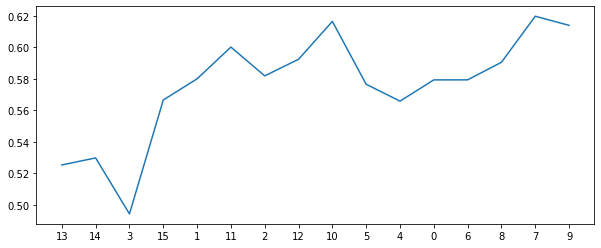

1459
all features [14, 3, 15, 13, 1, 2, 11, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 1, 2, 11, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.651395173453997
sensitivity  0.62
auc          0.6356975867269985


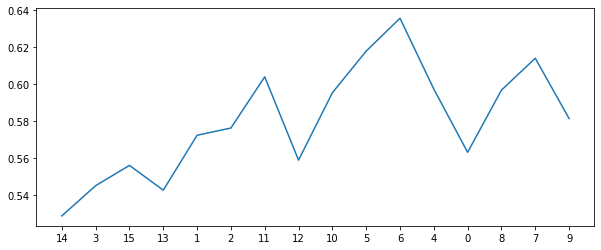

1460
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6571428571428571
specificity  0.6630844645550528
sensitivity  0.59
auc          0.6265422322775264


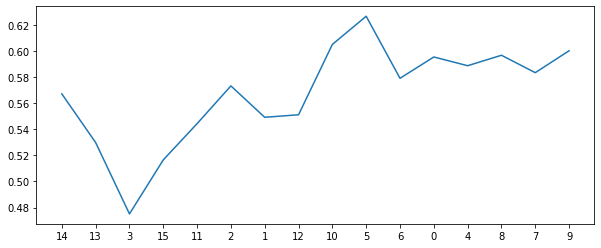

1461
all features [3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 2, 11, 1]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6090120663650076
sensitivity  0.62
auc          0.6145060331825037


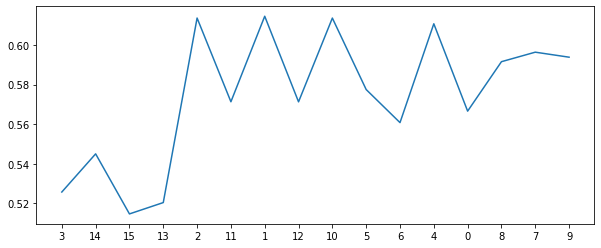

1462
all features [13, 3, 14, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6821644042232278
sensitivity  0.57
auc          0.6260822021116139


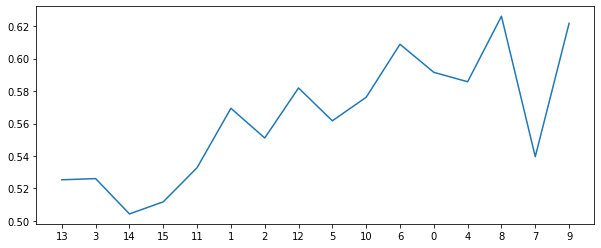

1463
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6706259426847662
sensitivity  0.545
auc          0.6078129713423831


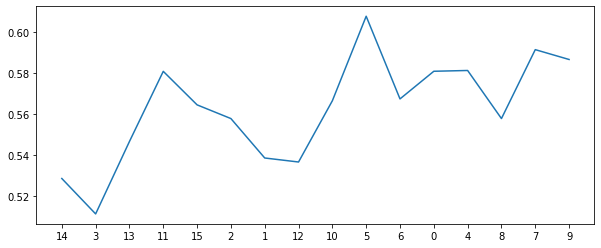

1464
all features [14, 3, 13, 1, 15, 2, 11, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [14, 3, 13, 1, 15, 2, 11, 12, 10, 5, 0, 4, 6, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.634313725490196
sensitivity  0.64
auc          0.6371568627450981


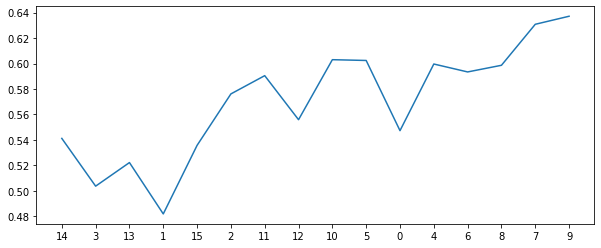

1465
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.5517857142857143
specificity  0.5437028657616892
sensitivity  0.67
auc          0.6068514328808446


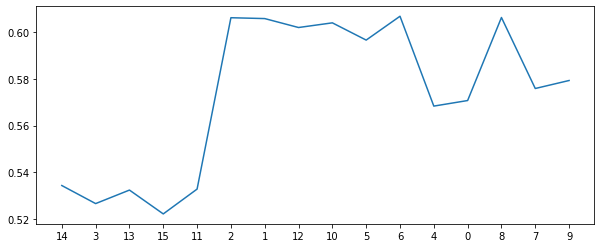

1466
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.5892857142857143
specificity  0.5841251885369533
sensitivity  0.67
auc          0.6270625942684767


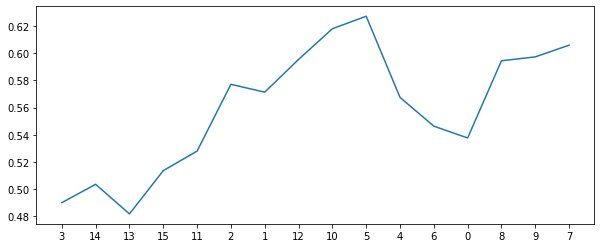

1467
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6339285714285714
specificity  0.6341251885369532
sensitivity  0.64
auc          0.6370625942684767


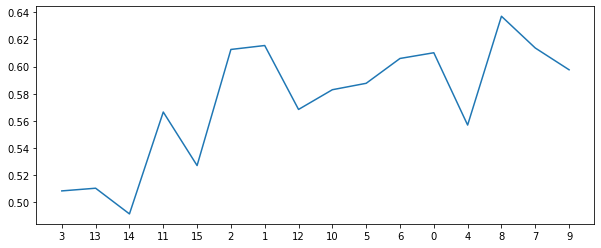

1468
all features [3, 13, 14, 11, 15, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 5, 10, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6553921568627451
sensitivity  0.565
auc          0.6101960784313726


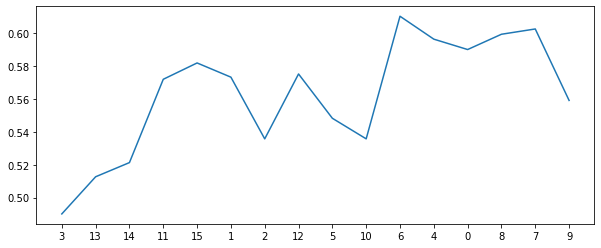

1469
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6392857142857142
specificity  0.6380090497737556
sensitivity  0.66
auc          0.6490045248868779


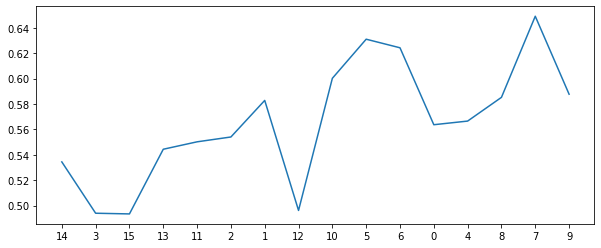

1470
all features [13, 14, 15, 3, 1, 11, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 15, 3, 1, 11, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5589285714285714
specificity  0.5453996983408748
sensitivity  0.735
auc          0.6401998491704374


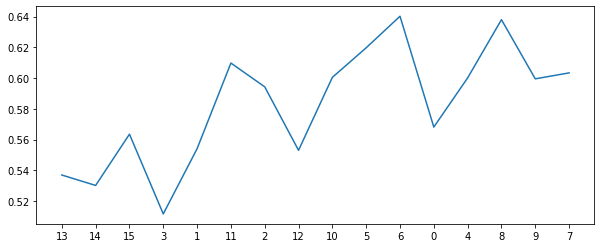

1471
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5946428571428571
specificity  0.5880090497737557
sensitivity  0.69
auc          0.6390045248868779


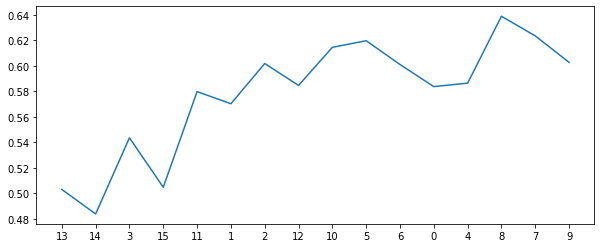

1472
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6
specificity  0.5898190045248869
sensitivity  0.74
auc          0.6649095022624434


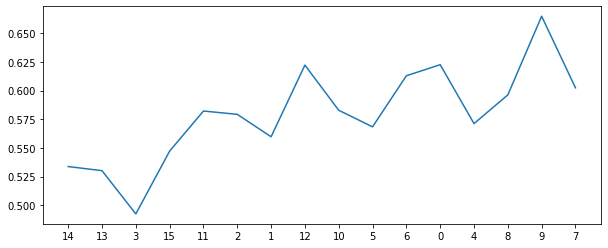

1473
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6130844645550528
sensitivity  0.69
auc          0.6515422322775264


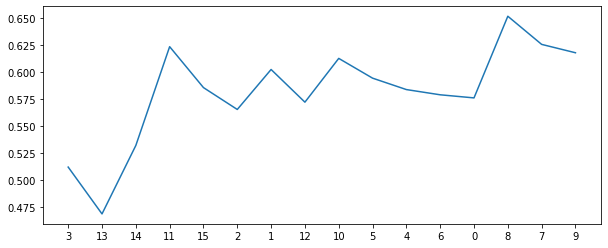

1474
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 9, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6124999999999999
specificity  0.6129336349924586
sensitivity  0.615
auc          0.6139668174962293


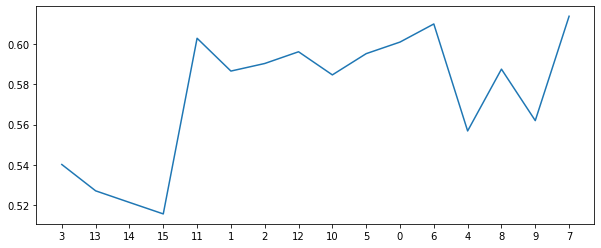

1475
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6148567119155355
sensitivity  0.685
auc          0.6499283559577678


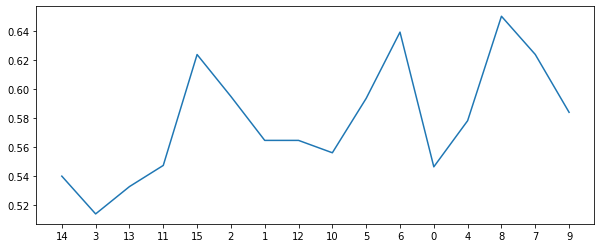

1476
all features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 1, 15, 11, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6378582202111613
sensitivity  0.61
auc          0.6239291101055807


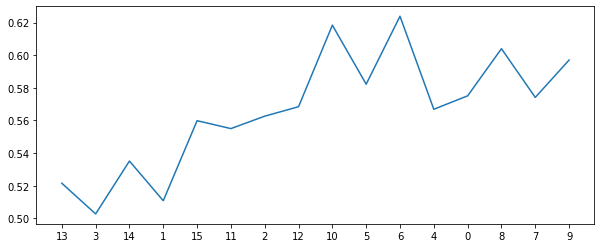

1477
all features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6607142857142857
specificity  0.6687782805429864
sensitivity  0.565
auc          0.6168891402714932


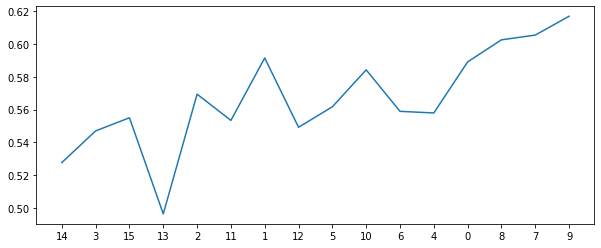

1478
all features [14, 13, 3, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 2, 15, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6880467571644042
sensitivity  0.615
auc          0.6515233785822021


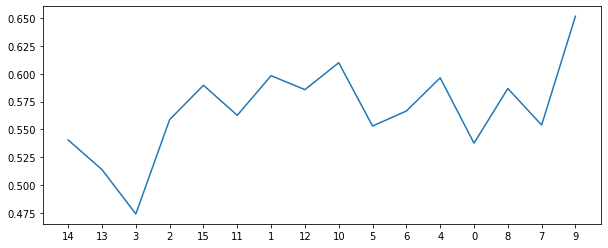

1479
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6861236802413273
sensitivity  0.57
auc          0.6280618401206637


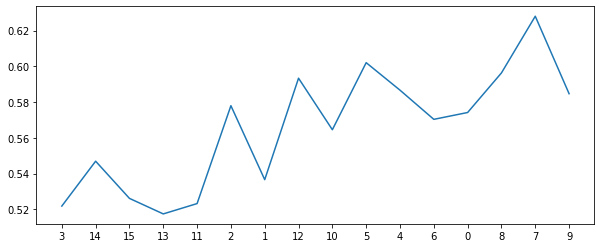

1480
all features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 15, 13, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6745098039215687
sensitivity  0.57
auc          0.6222549019607844


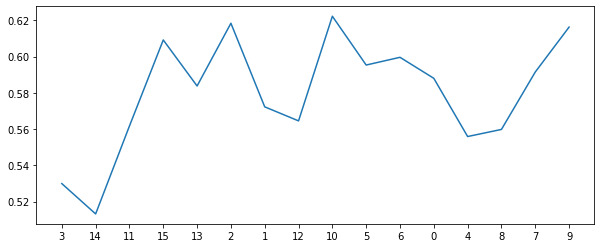

1481
all features [14, 3, 11, 13, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 11, 13, 15, 2]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6464285714285715
specificity  0.6513574660633484
sensitivity  0.59
auc          0.6206787330316742


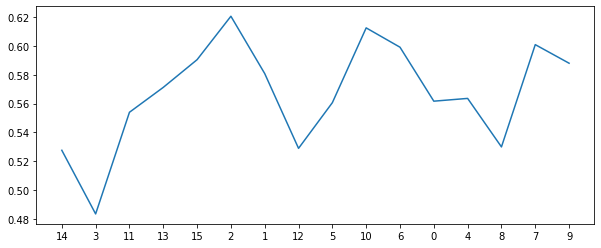

1482
all features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6089285714285715
specificity  0.6032428355957767
sensitivity  0.685
auc          0.6441214177978883


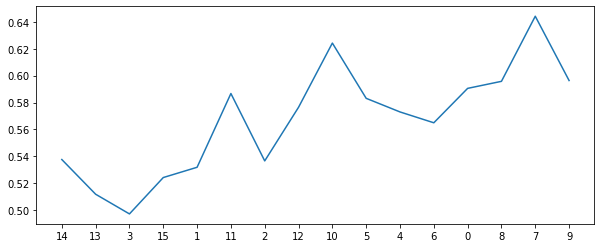

1483
all features [14, 15, 3, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 15, 3, 13, 11, 2, 1]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.5357843137254902
sensitivity  0.72
auc          0.6278921568627451


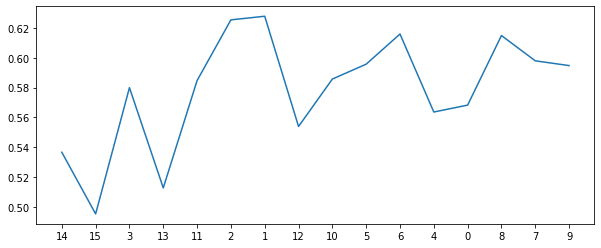

1484
all features [14, 13, 3, 15, 12, 11, 2, 1, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 3, 15, 12, 11, 2, 1, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6456259426847663
sensitivity  0.64
auc          0.6428129713423831


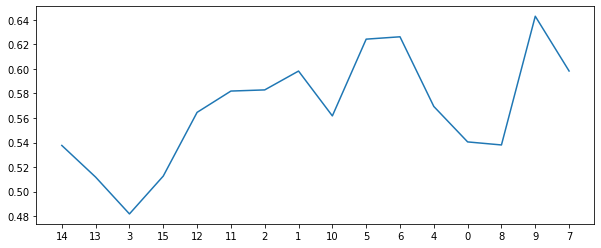

1485
all features [3, 14, 13, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 2, 15, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6168552036199095
sensitivity  0.645
auc          0.6309276018099548


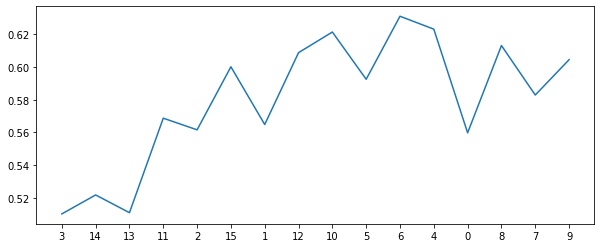

1486
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6205882352941177
sensitivity  0.62
auc          0.6202941176470588


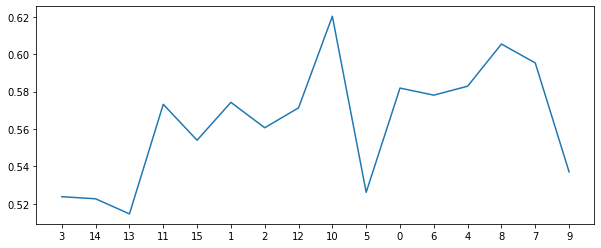

1487
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6360105580693816
sensitivity  0.595
auc          0.6155052790346908


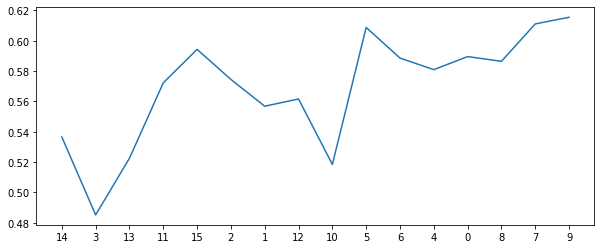

1488
all features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 14, 3, 1, 11, 15, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5875
specificity  0.5840497737556561
sensitivity  0.645
auc          0.614524886877828


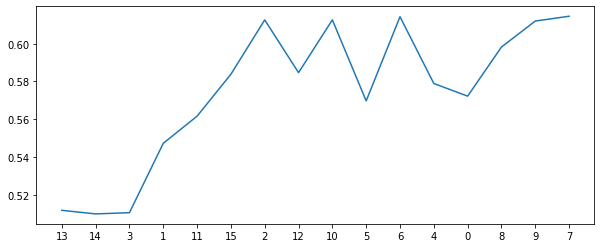

1489
all features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5196428571428572
specificity  0.5052036199095022
sensitivity  0.72
auc          0.6126018099547511


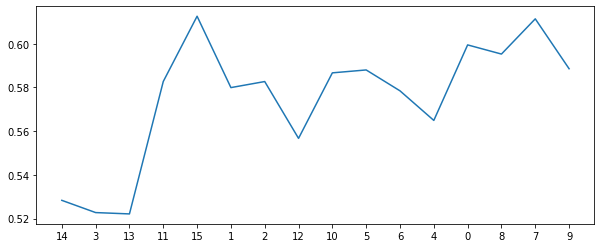

1490
all features [13, 14, 3, 2, 15, 11, 12, 1, 10, 5, 4, 0, 6, 8, 9, 7, 16]
new features [13, 14, 3, 2, 15, 11, 12, 1, 10, 5, 4, 0, 6, 8, 9, 7]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5589285714285714
specificity  0.5455128205128205
sensitivity  0.74
auc          0.6427564102564103


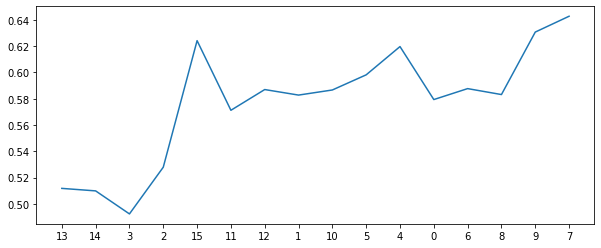

1491
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6243966817496229
sensitivity  0.715
auc          0.6696983408748115


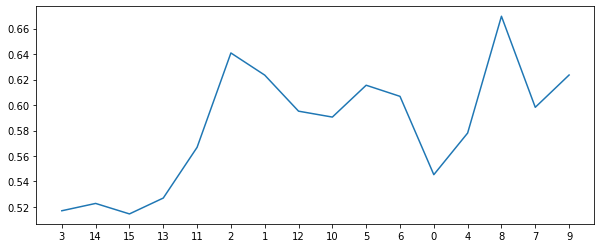

1492
all features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 15, 3, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5879713423831071
sensitivity  0.69
auc          0.6389856711915536


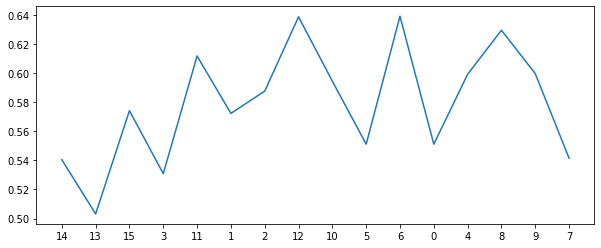

1493
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5840497737556561
sensitivity  0.66
auc          0.6220248868778281


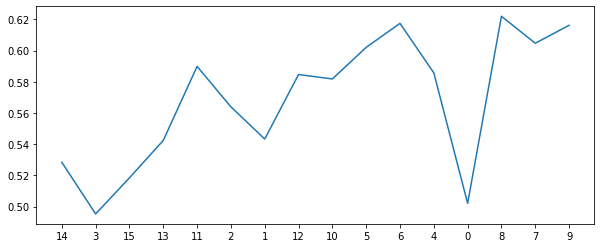

1494
all features [14, 13, 3, 1, 15, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 1, 15, 11, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6482142857142857
specificity  0.6513574660633484
sensitivity  0.615
auc          0.6331787330316743


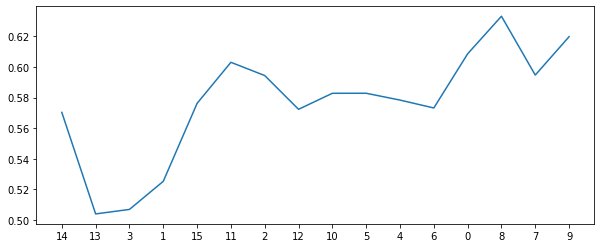

1495
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6109728506787331
sensitivity  0.615
auc          0.6129864253393665


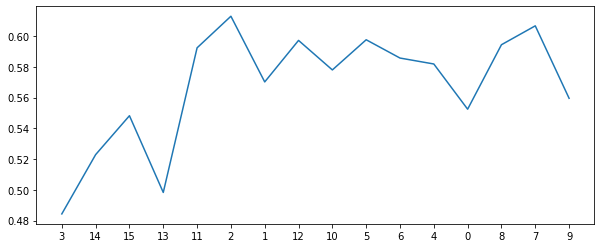

1496
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6321428571428571
specificity  0.6360859728506787
sensitivity  0.595
auc          0.6155429864253393


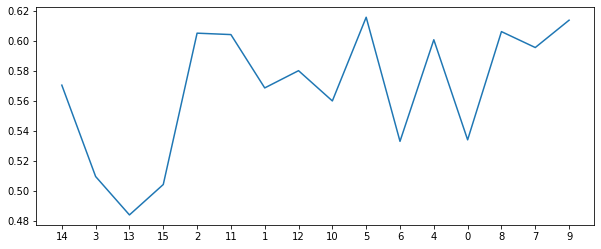

1497
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.675
specificity  0.6841628959276018
sensitivity  0.57
auc          0.6270814479638009


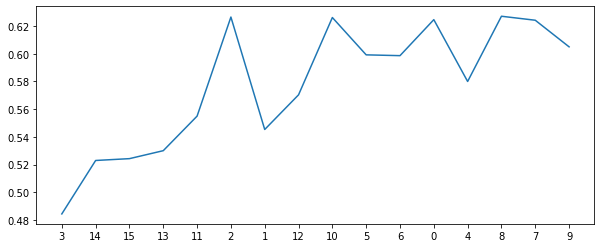

1498
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6880090497737557
sensitivity  0.565
auc          0.6265045248868778


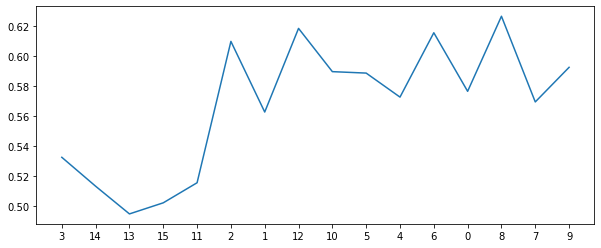

1499
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.6957390648567119
sensitivity  0.51
auc          0.602869532428356


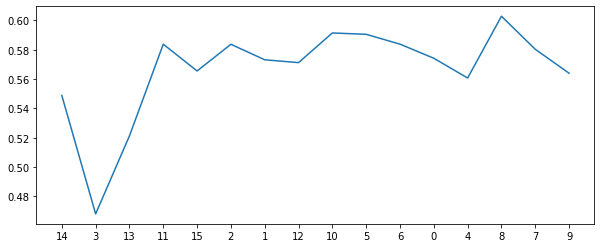

1500
all features [13, 14, 3, 1, 15, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 11, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5803571428571429
specificity  0.5724358974358974
sensitivity  0.695
auc          0.6337179487179487


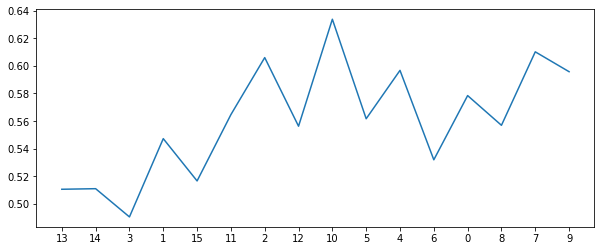

1501
all features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 6]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.575
specificity  0.566892911010558
sensitivity  0.69
auc          0.628446455505279


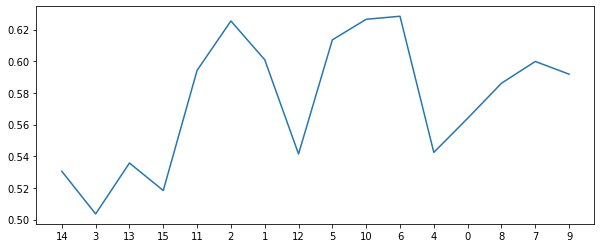

1502
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5973981900452489
sensitivity  0.665
auc          0.6311990950226244


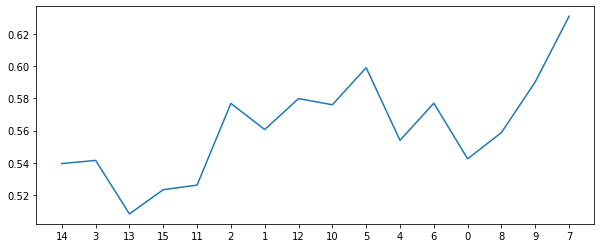

1503
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6110859728506788
sensitivity  0.715
auc          0.6630429864253393


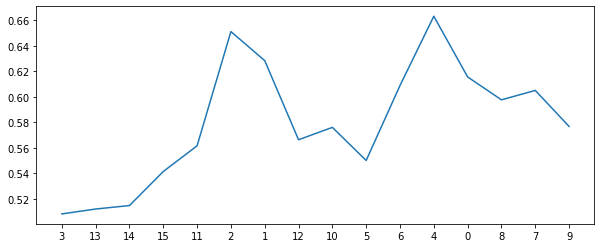

1504
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.625
specificity  0.6265082956259427
sensitivity  0.62
auc          0.6232541478129714


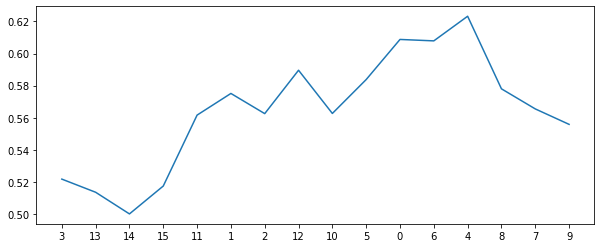

1505
all features [3, 14, 13, 11, 2, 15, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 2, 15, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6107142857142858
specificity  0.6034313725490196
sensitivity  0.715
auc          0.6592156862745098


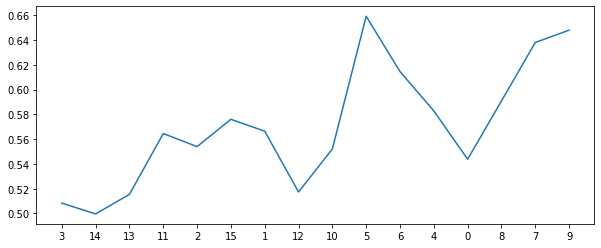

1506
all features [14, 13, 3, 1, 15, 2, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 13, 3, 1, 15, 2, 11, 12, 10]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5517857142857143
specificity  0.5379713423831071
sensitivity  0.745
auc          0.6414856711915535


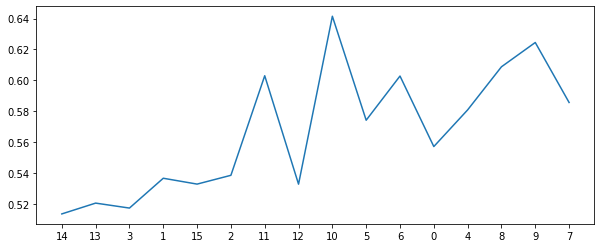

1507
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5125
specificity  0.4934766214177979
sensitivity  0.765
auc          0.6292383107088989


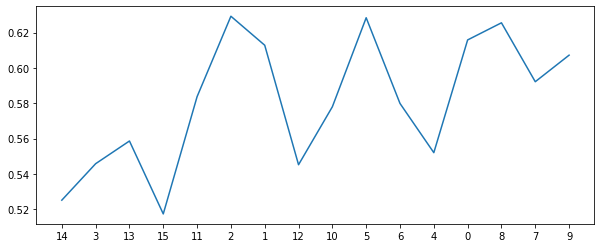

1508
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5553571428571429
specificity  0.5436651583710408
sensitivity  0.715
auc          0.6293325791855203


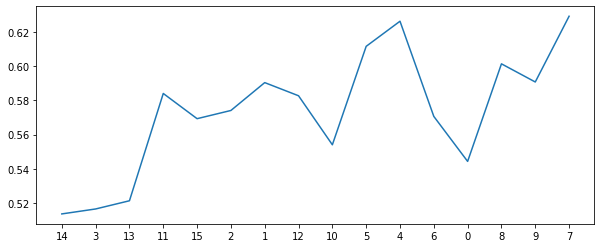

1509
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5482142857142858
specificity  0.5302036199095023
sensitivity  0.785
auc          0.6576018099547511


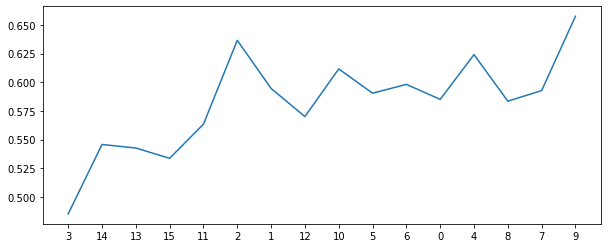

1510
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5763574660633484
sensitivity  0.695
auc          0.6356787330316742


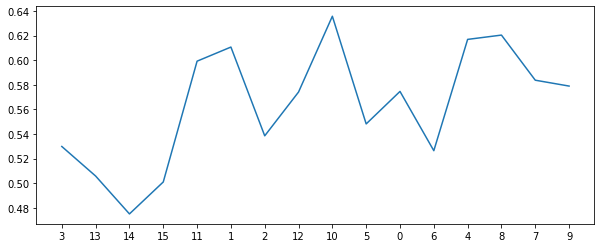

1511
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5714285714285714
specificity  0.5608974358974359
sensitivity  0.715
auc          0.6379487179487179


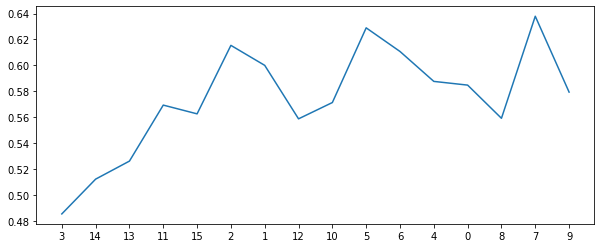

1512
all features [14, 13, 3, 11, 2, 15, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 11, 2, 15, 1, 12, 10, 5, 4]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6625
specificity  0.6687405731523379
sensitivity  0.59
auc          0.6293702865761689


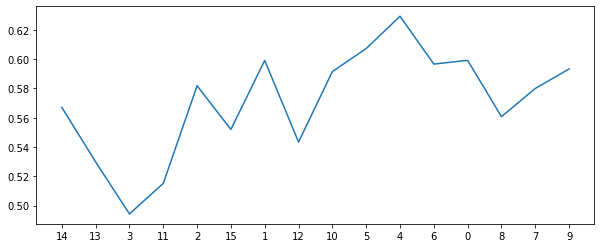

1513
all features [14, 15, 13, 11, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 15, 13, 11, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6875
specificity  0.6976621417797888
sensitivity  0.56
auc          0.6288310708898944


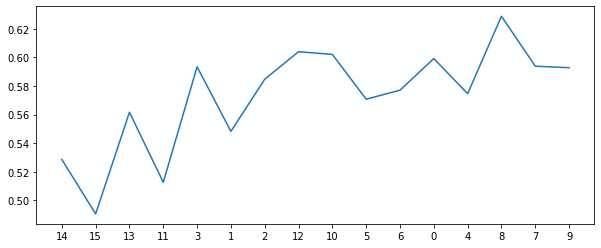

1514
all features [14, 3, 13, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 2, 11, 1, 12, 10]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6803544494720966
sensitivity  0.545
auc          0.6126772247360482


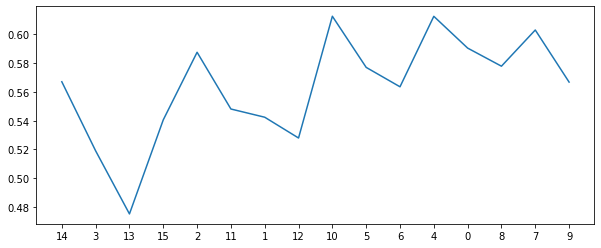

1515
all features [3, 14, 15, 13, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6428571428571429
specificity  0.6437405731523379
sensitivity  0.645
auc          0.6443702865761689


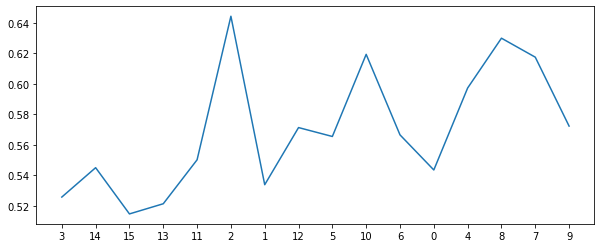

1516
all features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6802413273001509
sensitivity  0.52
auc          0.6001206636500754


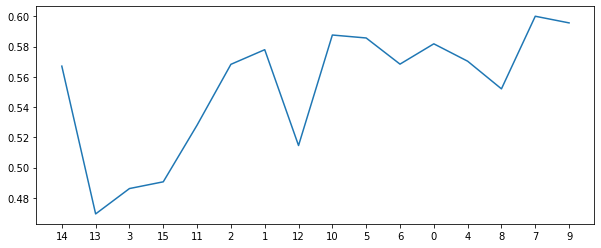

1517
all features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.75, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6696428571428571
specificity  0.6803544494720966
sensitivity  0.545
auc          0.6126772247360482


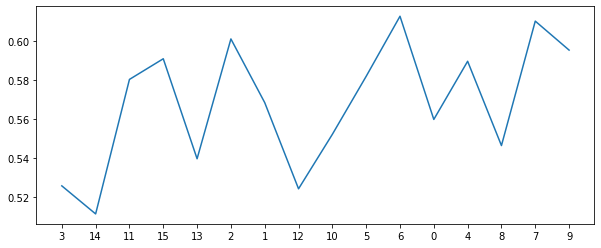

1518
all features [14, 13, 3, 11, 2, 1, 15, 12, 5, 10, 0, 6, 4, 8, 7, 9, 16]
new features [14, 13, 3, 11, 2, 1, 15]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5839285714285715
specificity  0.5802036199095023
sensitivity  0.645
auc          0.6126018099547511


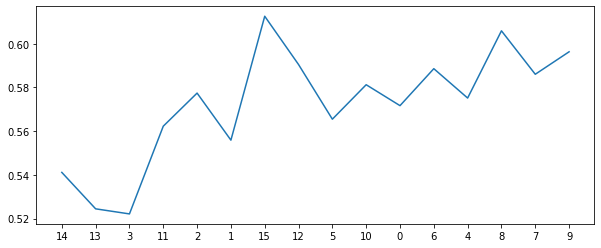

1519
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6125
specificity  0.6053167420814479
sensitivity  0.71
auc          0.657658371040724


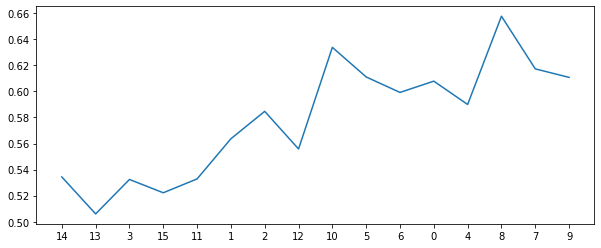

1520
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6053571428571428
specificity  0.6033182503770739
sensitivity  0.645
auc          0.624159125188537


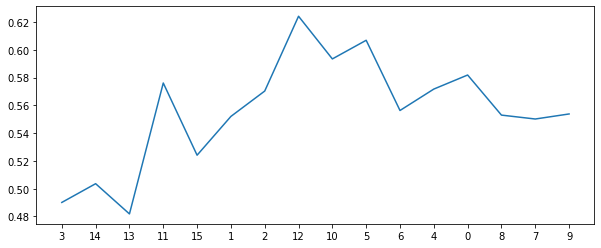

1521
all features [3, 14, 15, 11, 13, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 11, 13, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6375
specificity  0.6437405731523379
sensitivity  0.57
auc          0.6068702865761689


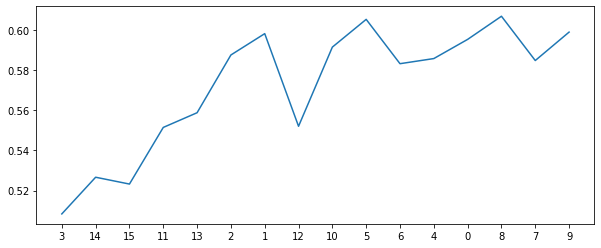

1522
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6196428571428572
specificity  0.6167420814479638
sensitivity  0.665
auc          0.6408710407239819


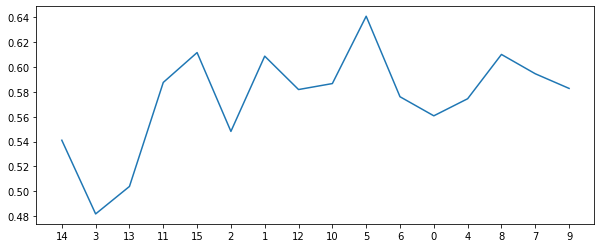

1523
all features [3, 14, 11, 13, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6410714285714286
specificity  0.6457013574660633
sensitivity  0.59
auc          0.6178506787330317


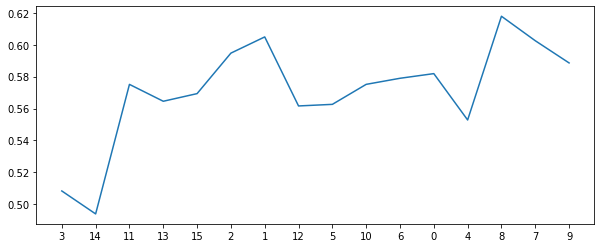

1524
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [3, 14, 13, 11, 15]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5178571428571429
specificity  0.5012820512820513
sensitivity  0.745
auc          0.6231410256410257


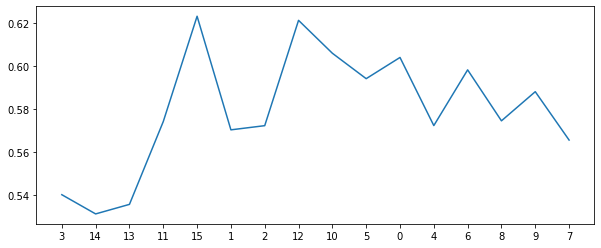

1525
all features [14, 15, 13, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 15, 13, 3, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.5745475113122172
sensitivity  0.645
auc          0.6097737556561086


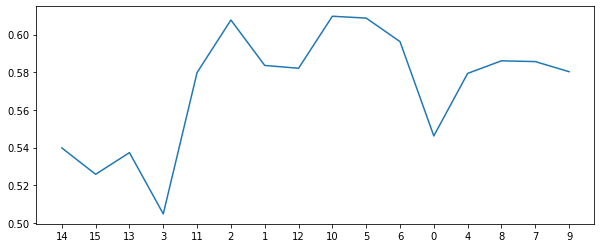

1526
all features [13, 14, 3, 1, 15, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 1, 15, 11, 2, 12]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5897058823529412
sensitivity  0.715
auc          0.6523529411764706


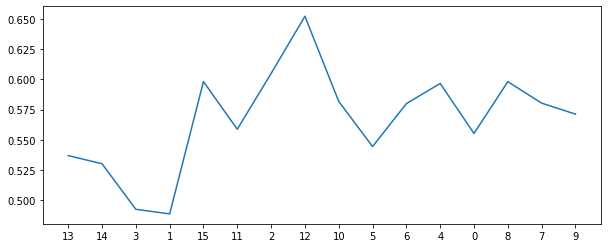

1527
all features [3, 13, 15, 14, 2, 11, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 2, 11, 1, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.576395173453997
sensitivity  0.69
auc          0.6331975867269984


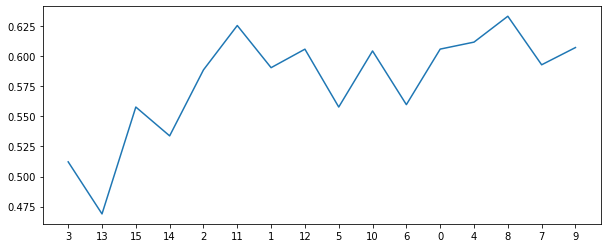

1528
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6205882352941177
sensitivity  0.64
auc          0.6302941176470589


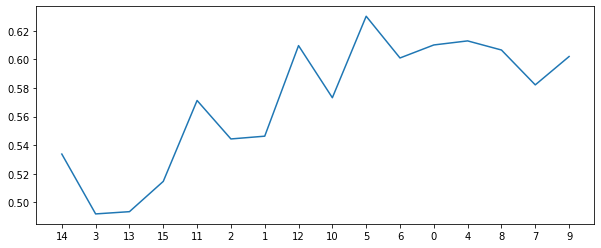

1529
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0]
[0.4, 2, 1000, 4, 0, 0.75, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6
specificity  0.5975867269984917
sensitivity  0.645
auc          0.6212933634992458


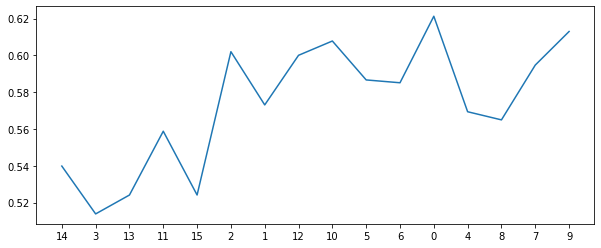

1530
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6745852187028658
sensitivity  0.59
auc          0.6322926093514328


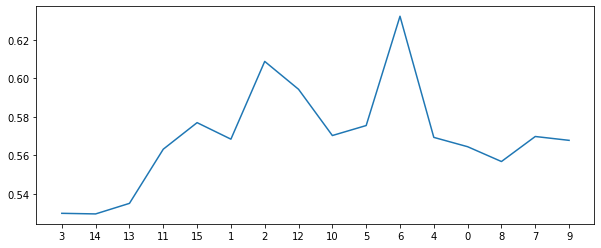

1531
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6302413273001508
sensitivity  0.645
auc          0.6376206636500754


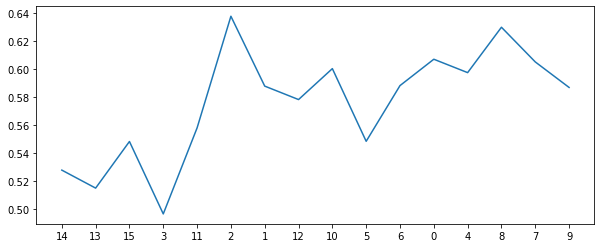

1532
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6782805429864254
sensitivity  0.57
auc          0.6241402714932127


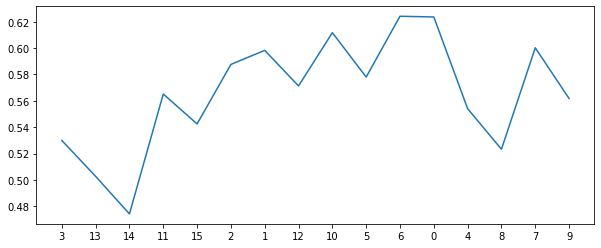

1533
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6303571428571428
specificity  0.6340874811463046
sensitivity  0.595
auc          0.6145437405731523


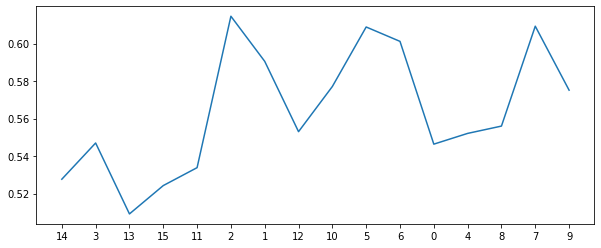

1534
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6782428355957768
sensitivity  0.545
auc          0.6116214177978884


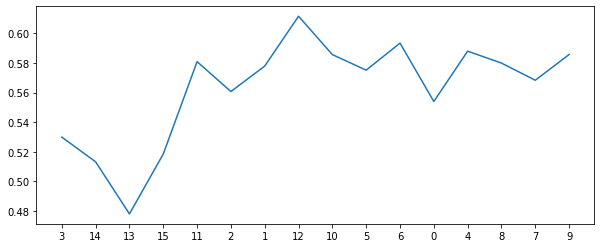

1535
all features [14, 3, 15, 11, 13, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 11, 13, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6821428571428572
specificity  0.695814479638009
sensitivity  0.52
auc          0.6079072398190045


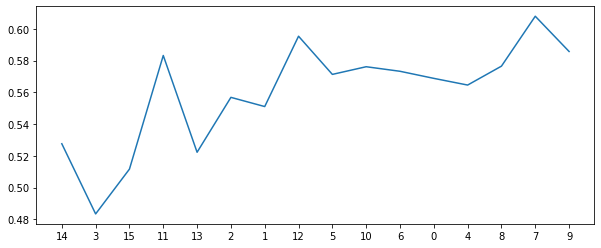

1536
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6398567119155355
sensitivity  0.685
auc          0.6624283559577677


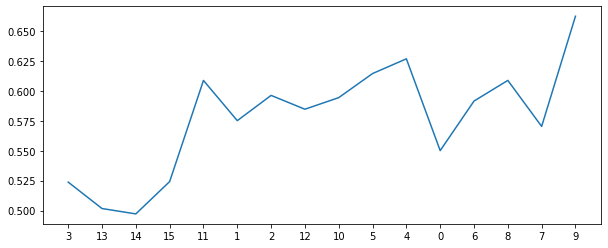

1537
all features [14, 3, 15, 11, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 11, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6417797888386123
sensitivity  0.685
auc          0.6633898944193062


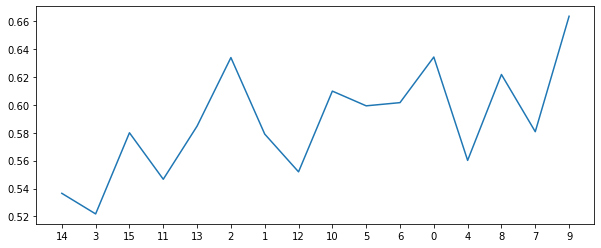

1538
all features [3, 13, 14, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.6013574660633484
sensitivity  0.62
auc          0.6106787330316742


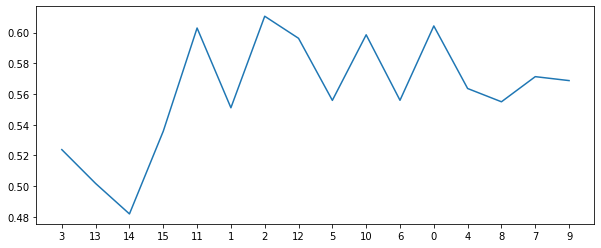

1539
all features [3, 14, 15, 11, 13, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 11, 13, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6196428571428572
specificity  0.6225867269984917
sensitivity  0.595
auc          0.6087933634992458


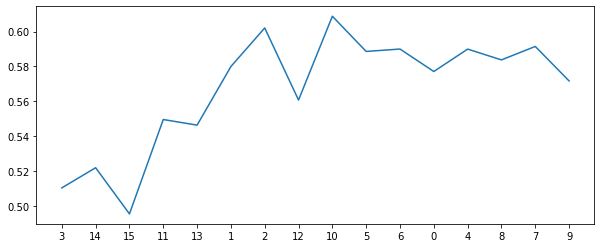

1540
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6553571428571429
specificity  0.6629713423831071
sensitivity  0.565
auc          0.6139856711915536


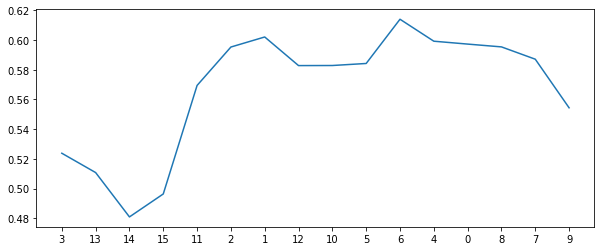

1541
all features [3, 14, 11, 13, 15, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5878582202111614
sensitivity  0.645
auc          0.6164291101055807


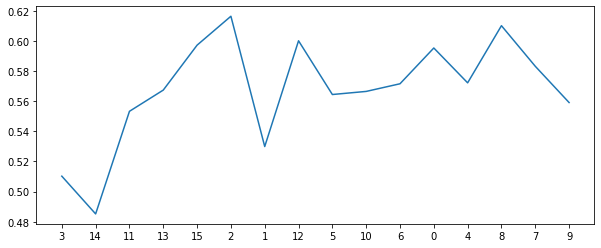

1542
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5607142857142857
specificity  0.5532051282051282
sensitivity  0.665
auc          0.6091025641025641


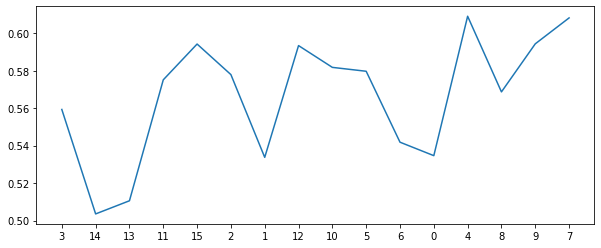

1543
all features [14, 13, 11, 15, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 11, 15, 3, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.59947209653092
sensitivity  0.735
auc          0.66723604826546


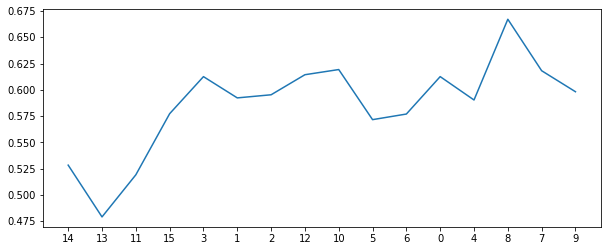

1544
all features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6089285714285714
specificity  0.6033182503770739
sensitivity  0.685
auc          0.644159125188537


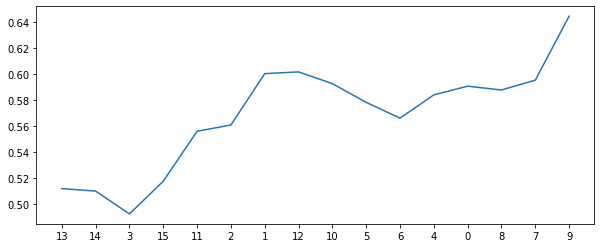

1545
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5625
specificity  0.5532805429864254
sensitivity  0.695
auc          0.6241402714932126


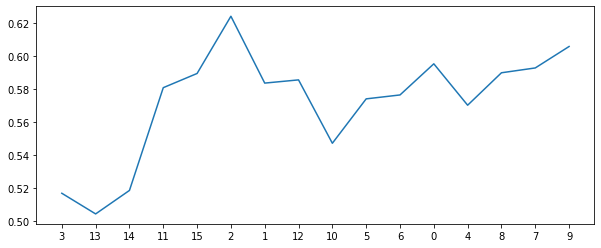

1546
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5936274509803922
sensitivity  0.62
auc          0.6068137254901961


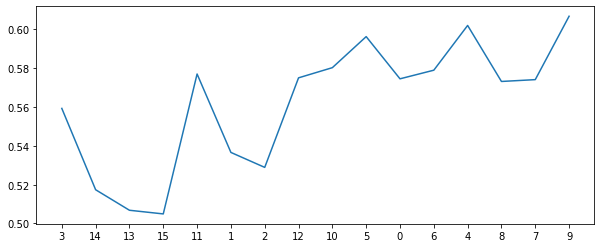

1547
all features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 2]
[0.4, 2, 1000, 4, 0, 0.75, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5464285714285715
specificity  0.535972850678733
sensitivity  0.695
auc          0.6154864253393665


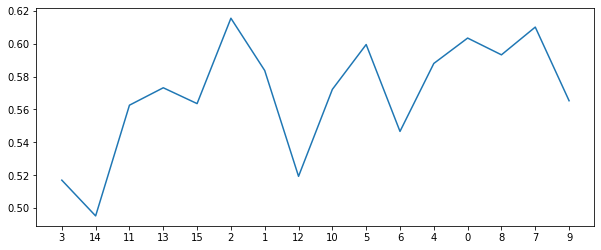

1548
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6517857142857143
specificity  0.6571266968325792
sensitivity  0.595
auc          0.6260633484162896


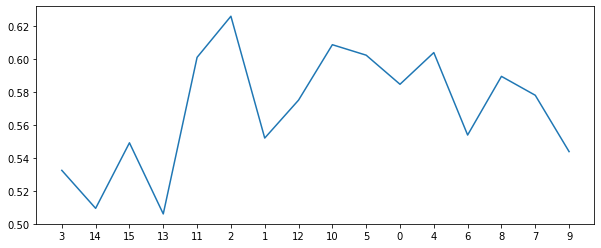

1549
all features [14, 3, 11, 13, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 11, 13, 15, 1, 2, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6446428571428572
specificity  0.6495475113122172
sensitivity  0.595
auc          0.6222737556561085


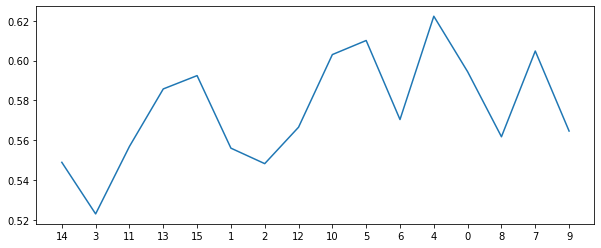

1550
all features [3, 13, 14, 15, 1, 11, 2, 12, 5, 10, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 1, 11, 2]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6514328808446456
sensitivity  0.545
auc          0.5982164404223228


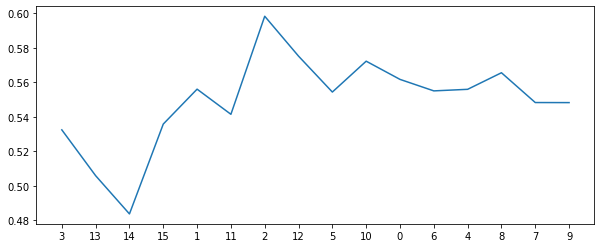

1551
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6880090497737557
sensitivity  0.535
auc          0.6115045248868778


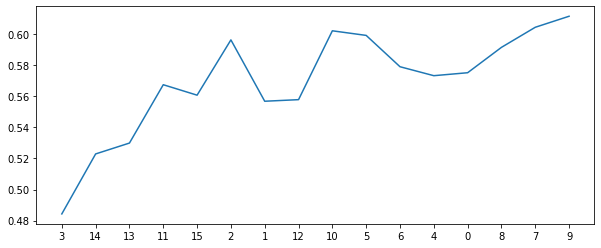

1552
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7091251885369533
sensitivity  0.52
auc          0.6145625942684766


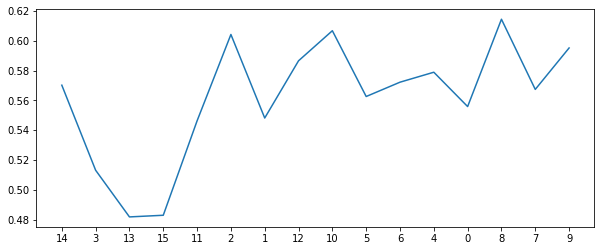

1553
all features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 0.75, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6803921568627451
sensitivity  0.515
auc          0.5976960784313725


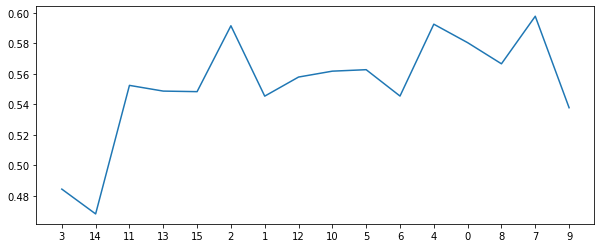

1554
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6284313725490196
sensitivity  0.62
auc          0.6242156862745097


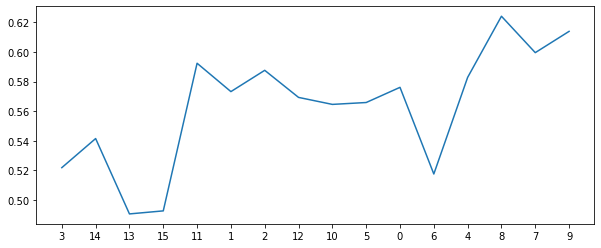

1555
all features [14, 13, 15, 11, 3, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 15, 11, 3, 1, 2, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6089285714285714
specificity  0.6072021116138763
sensitivity  0.64
auc          0.6236010558069381


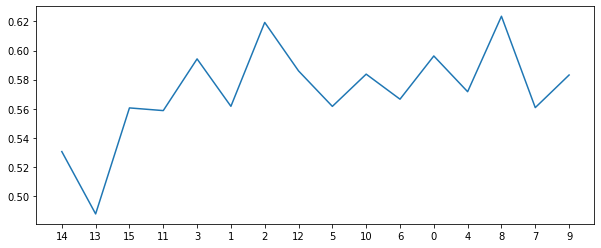

1556
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6035714285714285
specificity  0.6015082956259427
sensitivity  0.645
auc          0.6232541478129714


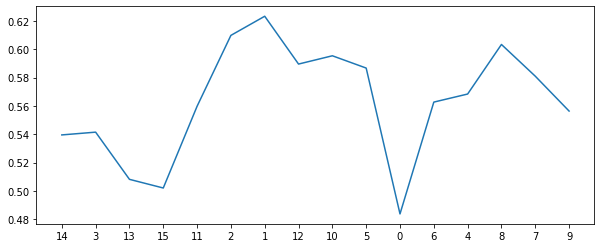

1557
all features [3, 15, 14, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 15, 14, 13, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6125
specificity  0.6092006033182504
sensitivity  0.67
auc          0.6396003016591252


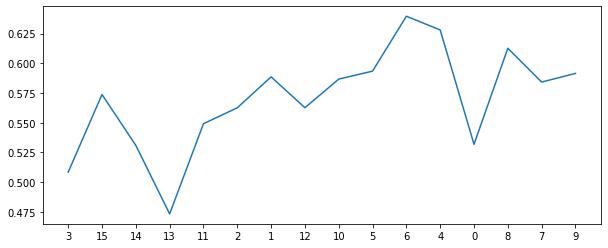

1558
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6357142857142857
specificity  0.6378959276018099
sensitivity  0.61
auc          0.623947963800905


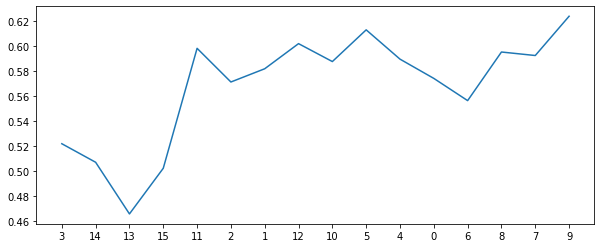

1559
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12]
[0.4, 2, 1000, 4, 0, 0.75, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5875
specificity  0.5860482654600302
sensitivity  0.62
auc          0.6030241327300151


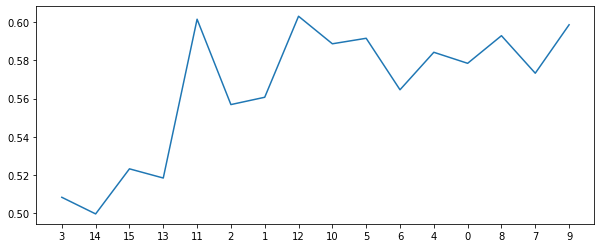

1560
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 4, 6, 8]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5875
specificity  0.5803167420814479
sensitivity  0.69
auc          0.6351583710407239


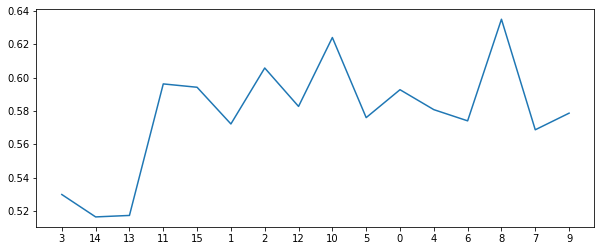

1561
all features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 15, 3, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5892857142857143
specificity  0.5761689291101055
sensitivity  0.76
auc          0.6680844645550528


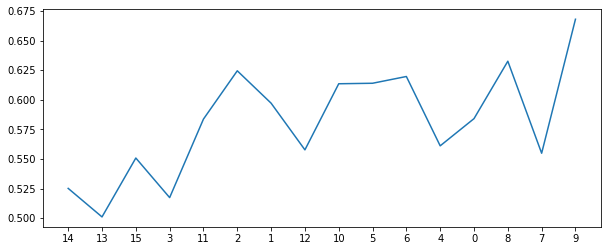

1562
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5571428571428572
specificity  0.5474736048265461
sensitivity  0.695
auc          0.621236802413273


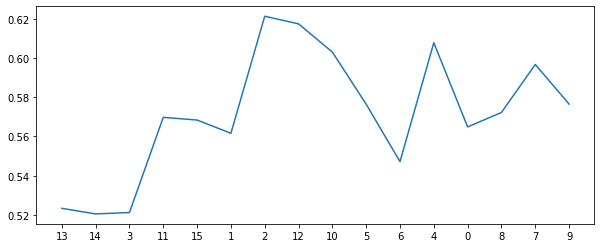

1563
all features [3, 14, 15, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5839285714285715
specificity  0.5726244343891402
sensitivity  0.735
auc          0.6538122171945701


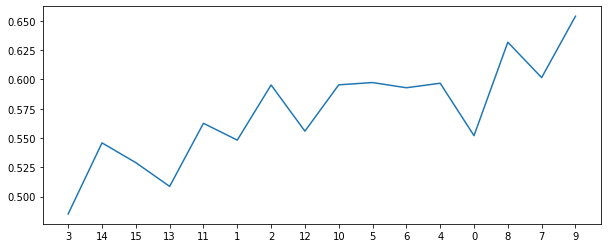

1564
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6186274509803922
sensitivity  0.67
auc          0.644313725490196


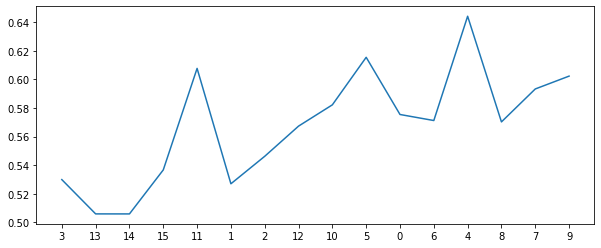

1565
all features [3, 14, 11, 15, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 15]
[0.4, 2, 1000, 4, 0, 0.75, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5446428571428571
specificity  0.5340497737556561
sensitivity  0.69
auc          0.6120248868778281


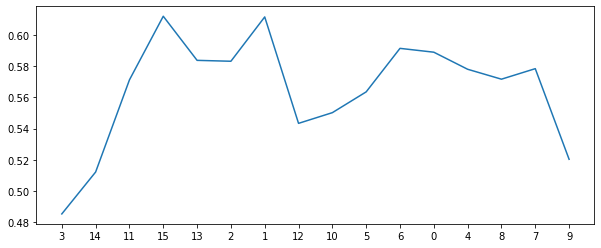

1566
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6589285714285714
specificity  0.6707013574660633
sensitivity  0.52
auc          0.5953506787330316


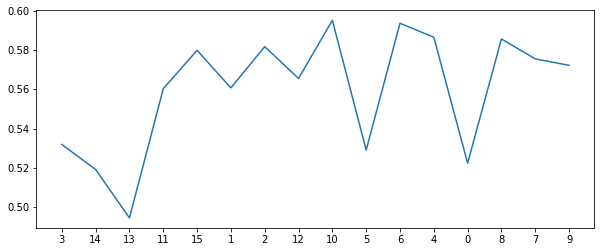

1567
all features [14, 3, 15, 13, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6767857142857143
specificity  0.6861613876319759
sensitivity  0.56
auc          0.623080693815988


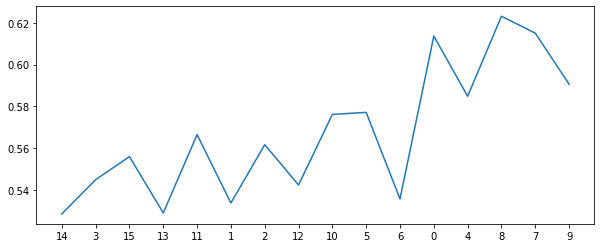

1568
all features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6918174962292609
sensitivity  0.52
auc          0.6059087481146305


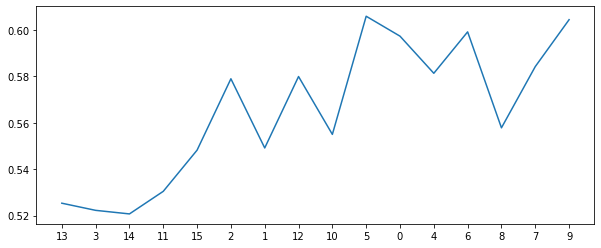

1569
all features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7053921568627451
sensitivity  0.52
auc          0.6126960784313726


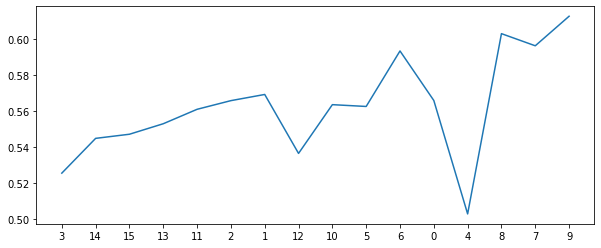

1570
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.693815987933635
sensitivity  0.515
auc          0.6044079939668174


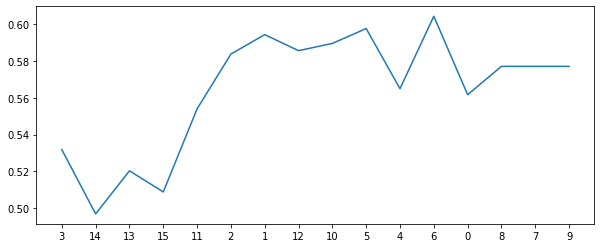

1571
all features [3, 14, 15, 11, 13, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 11, 13, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 1, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6910714285714286
specificity  0.7034313725490196
sensitivity  0.545
auc          0.6242156862745097


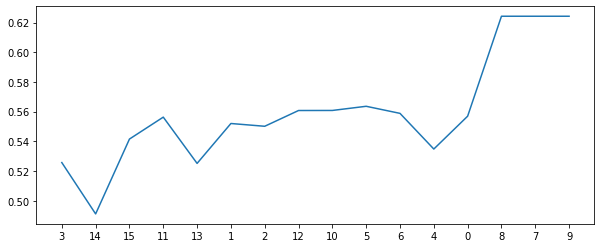

1572
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.6125
specificity  0.6111236802413272
sensitivity  0.645
auc          0.6280618401206637


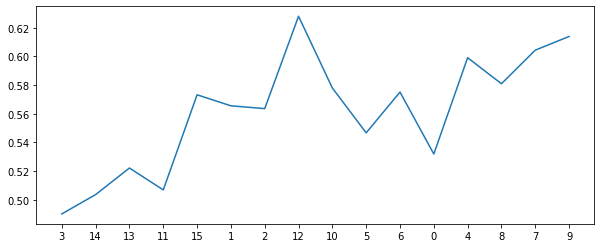

1573
all features [14, 3, 15, 13, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6185897435897436
sensitivity  0.61
auc          0.6142948717948719


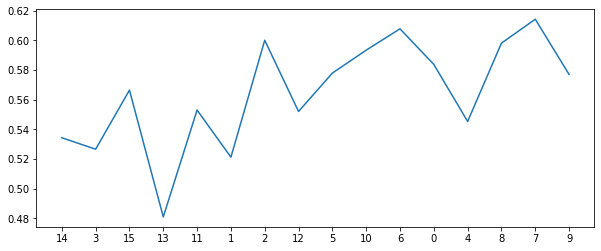

1574
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.6535714285714286
specificity  0.6610105580693816
sensitivity  0.565
auc          0.6130052790346908


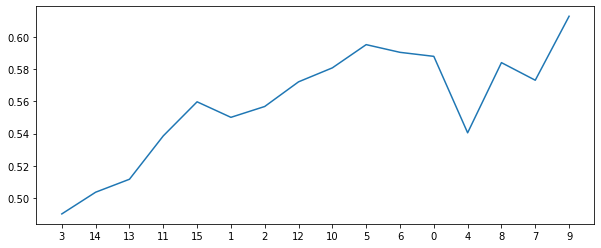

1575
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.635972850678733
sensitivity  0.59
auc          0.6129864253393664


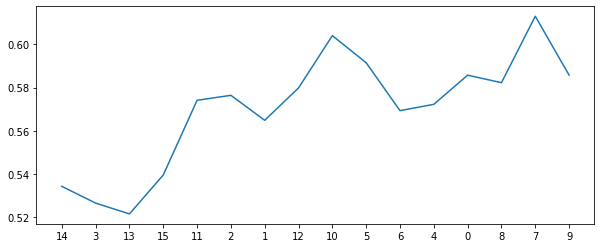

1576
all features [3, 14, 13, 15, 1, 11, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 14, 13, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6418552036199094
sensitivity  0.64
auc          0.6409276018099548


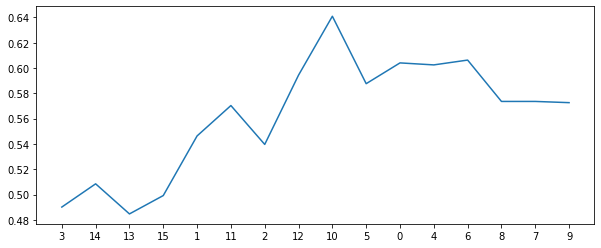

1577
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 6, 4]
[0.4, 2, 1000, 4, 0, 1, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6205882352941177
sensitivity  0.595
auc          0.6077941176470588


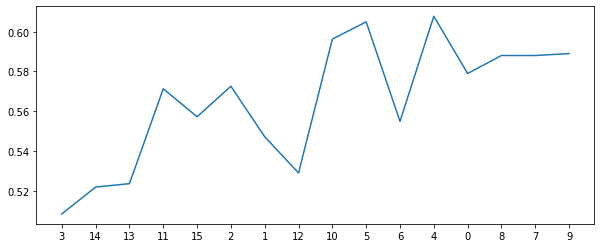

1578
all features [3, 14, 13, 11, 15, 2, 1, 12, 10, 5, 0, 4, 6, 8, 9, 7, 16]
new features [3, 14, 13, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6129336349924586
sensitivity  0.645
auc          0.6289668174962293


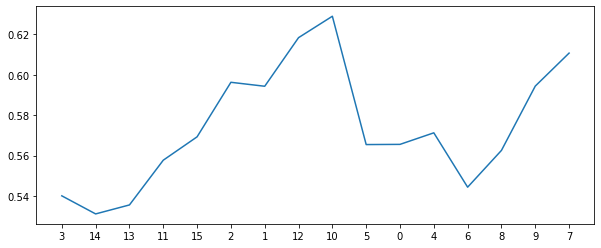

1579
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5859351432880845
sensitivity  0.665
auc          0.6254675716440422


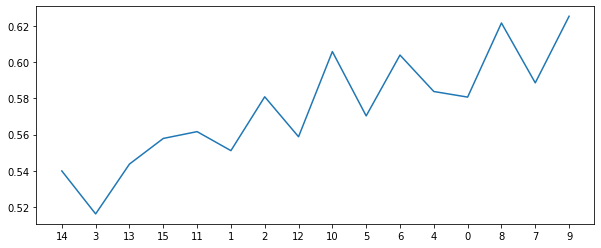

1580
all features [13, 14, 3, 11, 15, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.6
specificity  0.6015082956259427
sensitivity  0.595
auc          0.5982541478129714


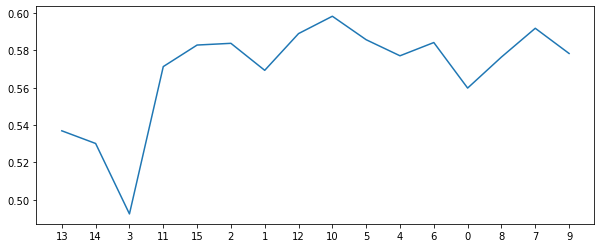

1581
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5802790346907994
sensitivity  0.665
auc          0.6226395173453997


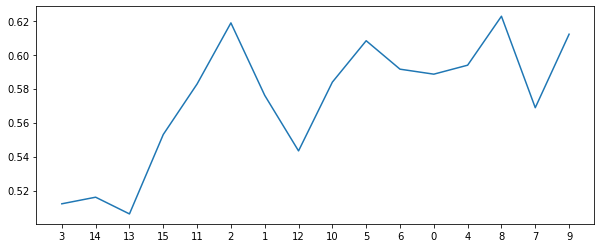

1582
all features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.630316742081448
sensitivity  0.64
auc          0.6351583710407239


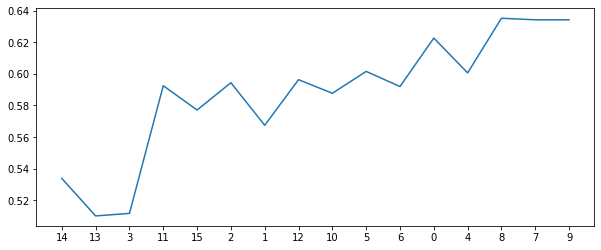

1583
all features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6130090497737557
sensitivity  0.64
auc          0.6265045248868778


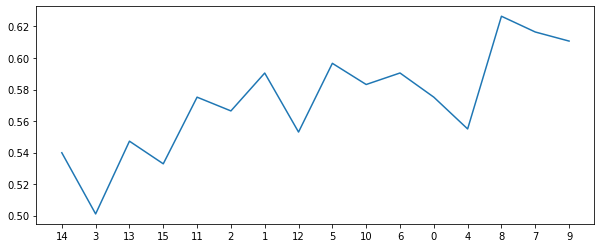

1584
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6625
specificity  0.6707390648567119
sensitivity  0.57
auc          0.6203695324283559


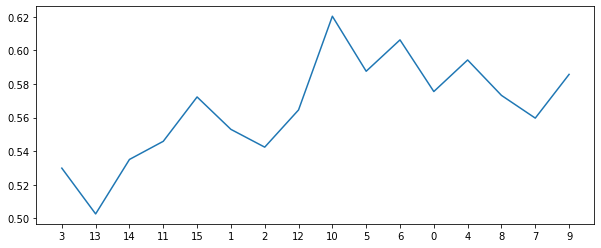

1585
all features [14, 3, 15, 13, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6678571428571428
specificity  0.6745852187028658
sensitivity  0.59
auc          0.6322926093514328


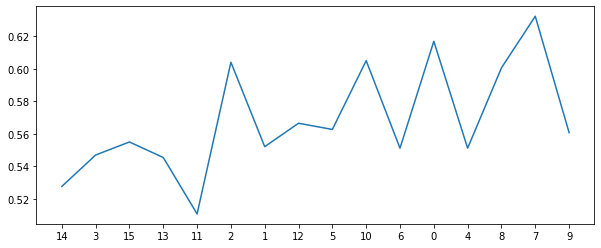

1586
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6821428571428572
specificity  0.6937782805429864
sensitivity  0.545
auc          0.6193891402714932


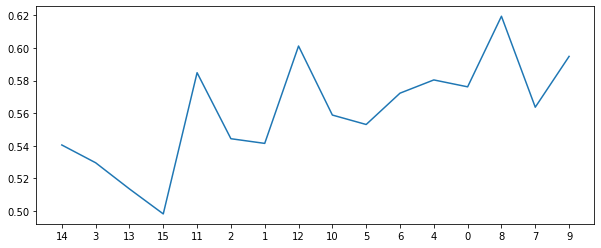

1587
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6696428571428571
specificity  0.6765082956259427
sensitivity  0.595
auc          0.6357541478129713


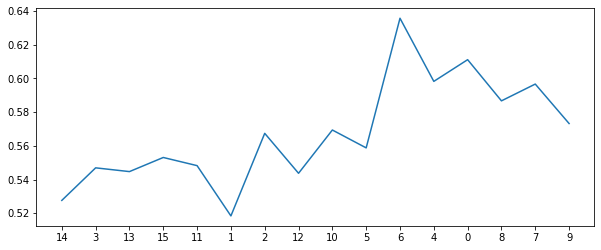

1588
all features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 10, 5, 0]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6910714285714286
specificity  0.7053167420814479
sensitivity  0.52
auc          0.612658371040724


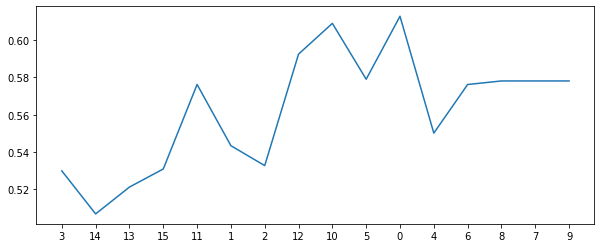

1589
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 1, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6687405731523379
sensitivity  0.52
auc          0.594370286576169


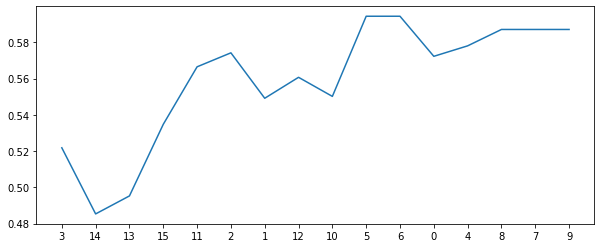

1590
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 0, 6, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.6482142857142856
specificity  0.653393665158371
sensitivity  0.59
auc          0.6216968325791855


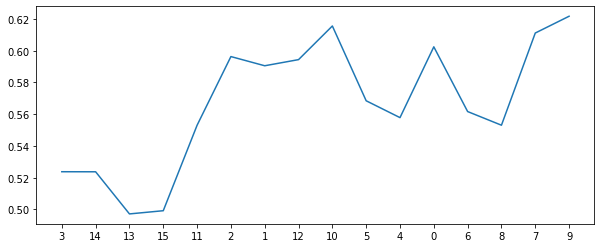

1591
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.6
specificity  0.5995852187028657
sensitivity  0.62
auc          0.6097926093514329


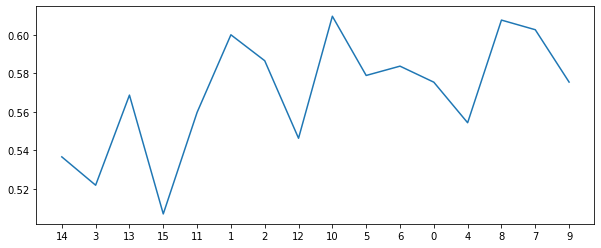

1592
all features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 3, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6267857142857143
specificity  0.6282805429864253
sensitivity  0.615
auc          0.6216402714932127


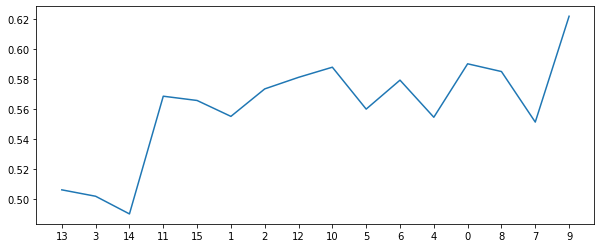

1593
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6267857142857143
specificity  0.6246229260935143
sensitivity  0.665
auc          0.6448114630467572


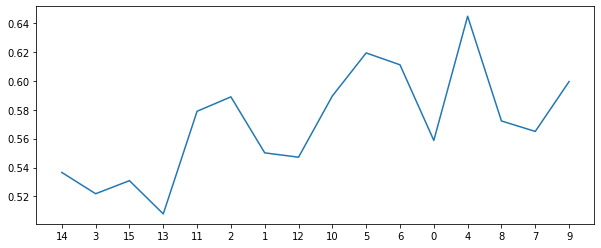

1594
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.65
specificity  0.6572775263951735
sensitivity  0.57
auc          0.6136387631975867


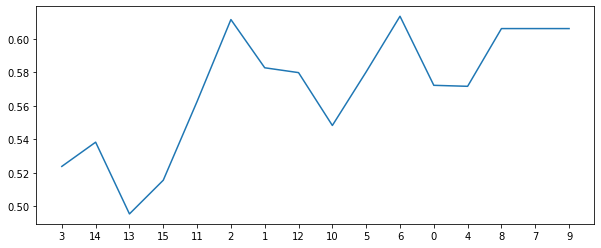

1595
all features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.6428571428571428
specificity  0.6514705882352941
sensitivity  0.545
auc          0.5982352941176471


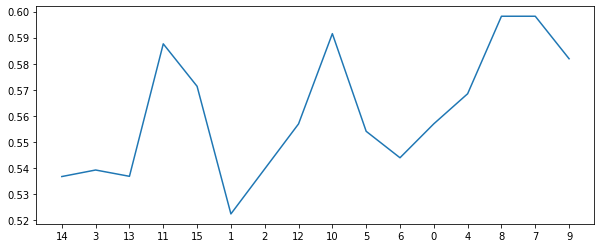

1596
all features [3, 14, 13, 15, 11, 2, 12, 1, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [3, 14, 13, 15, 11, 2, 12, 1, 10]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5875
specificity  0.5822398190045249
sensitivity  0.67
auc          0.6261199095022625


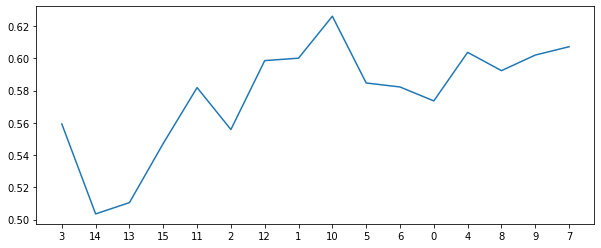

1597
all features [3, 14, 13, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 1, 2, 12, 5, 10, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5785714285714285
specificity  0.5705128205128205
sensitivity  0.685
auc          0.6277564102564103


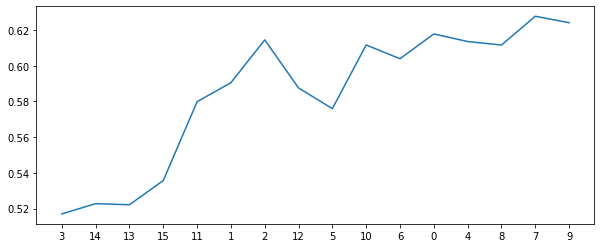

1598
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6110482654600302
sensitivity  0.67
auc          0.6405241327300151


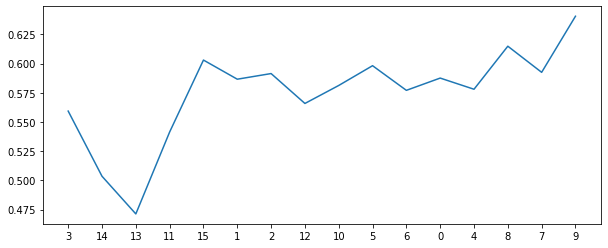

1599
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.5767857142857142
specificity  0.5686274509803921
sensitivity  0.69
auc          0.6293137254901962


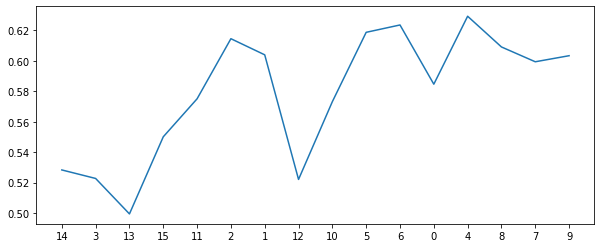

1600
all features [3, 13, 14, 11, 15, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6125
specificity  0.6110482654600301
sensitivity  0.635
auc          0.6230241327300151


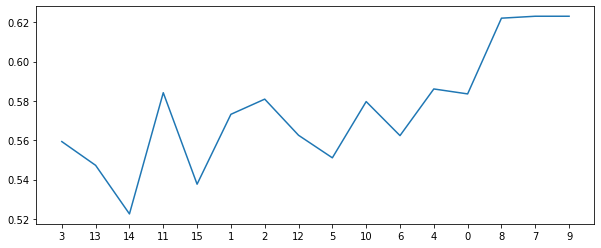

1601
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 1, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6246229260935143
sensitivity  0.615
auc          0.6198114630467572


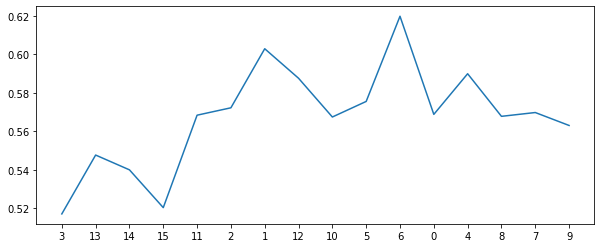

1602
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 0, 6, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6678571428571428
specificity  0.6764328808446456
sensitivity  0.565
auc          0.6207164404223228


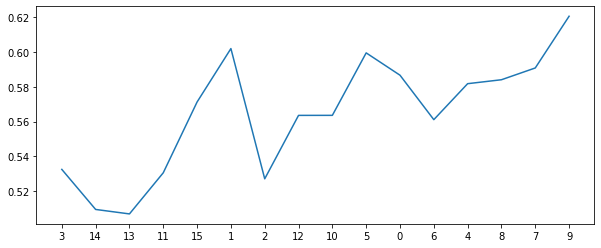

1603
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6649698340874811
sensitivity  0.565
auc          0.6149849170437406


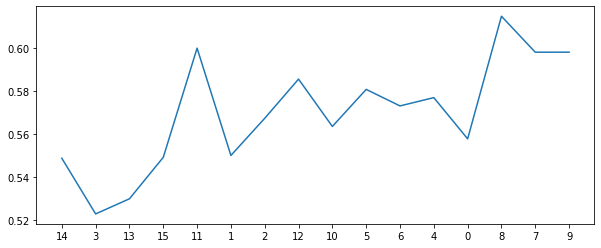

1604
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6946428571428571
specificity  0.7071644042232278
sensitivity  0.54
auc          0.6235822021116139


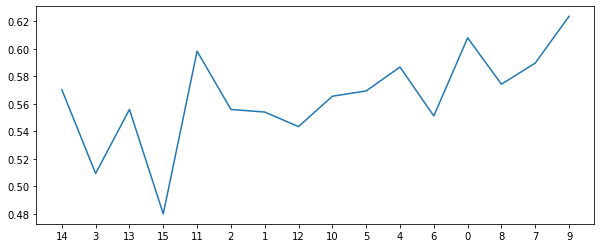

1605
all features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 15, 13, 14, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6482142857142857
specificity  0.6572398190045249
sensitivity  0.54
auc          0.5986199095022624


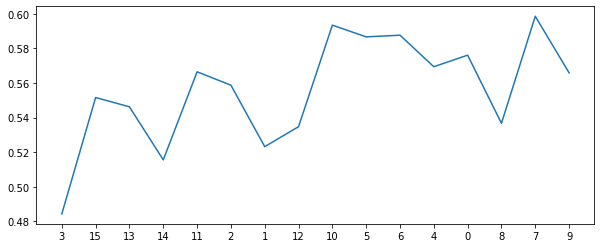

1606
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 4, 6, 8]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6714285714285715
specificity  0.6783559577677225
sensitivity  0.595
auc          0.6366779788838612


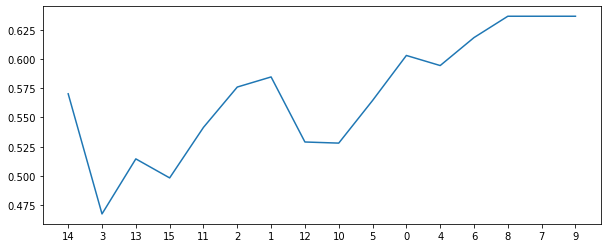

1607
all features [14, 3, 15, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 1, 2, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0, 1, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6660714285714285
specificity  0.6822775263951735
sensitivity  0.47
auc          0.5761387631975867


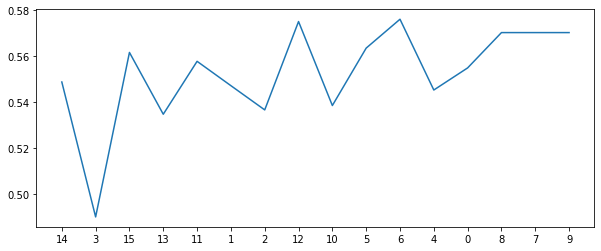

1608
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.6303571428571428
specificity  0.6361236802413273
sensitivity  0.57
auc          0.6030618401206637


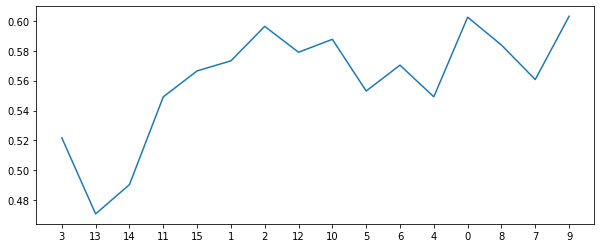

1609
all features [15, 13, 14, 3, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [15, 13, 14, 3, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.603393665158371
sensitivity  0.635
auc          0.6191968325791855


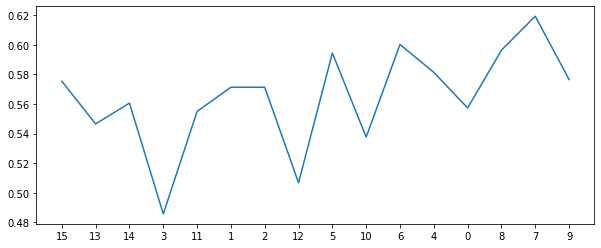

1610
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.6375
specificity  0.6399321266968326
sensitivity  0.615
auc          0.6274660633484163


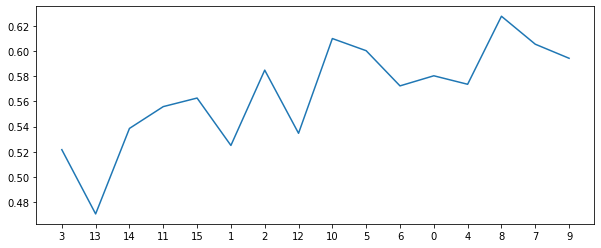

1611
all features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.6178571428571429
specificity  0.6129336349924586
sensitivity  0.685
auc          0.6489668174962293


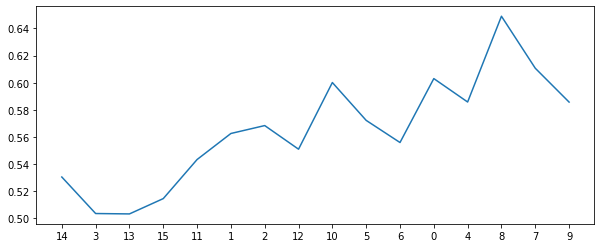

1612
all features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6410714285714285
specificity  0.6495475113122172
sensitivity  0.54
auc          0.5947737556561086


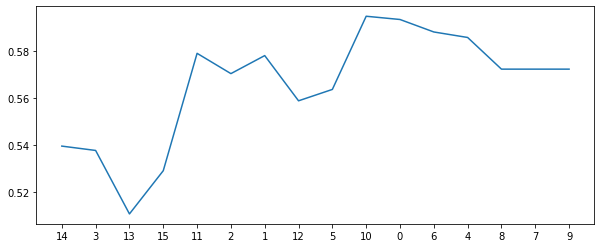

1613
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2]
[0.4, 2, 1000, 4, 0, 1, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.5785714285714286
specificity  0.5705128205128205
sensitivity  0.695
auc          0.6327564102564103


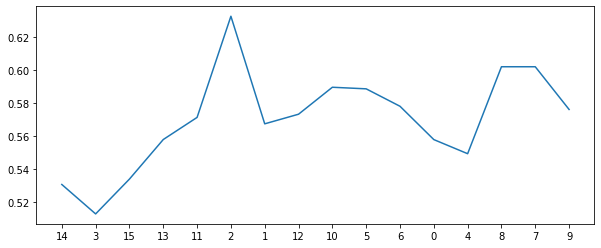

1614
all features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5714285714285714
specificity  0.5647435897435897
sensitivity  0.67
auc          0.6173717948717949


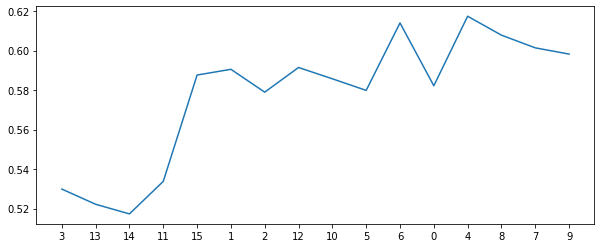

1615
all features [14, 13, 3, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 13, 3, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.5495852187028658
sensitivity  0.695
auc          0.6222926093514328


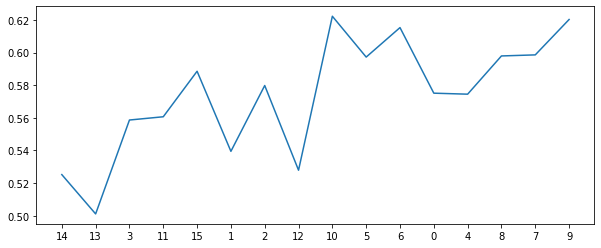

1616
all features [3, 14, 13, 11, 15, 1, 2, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 11, 15, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.6017857142857143
specificity  0.5956259426847662
sensitivity  0.695
auc          0.6453129713423831


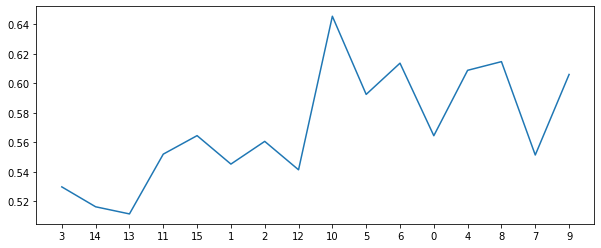

1617
all features [3, 15, 14, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 15, 14, 13, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.593552036199095
sensitivity  0.665
auc          0.6292760180995475


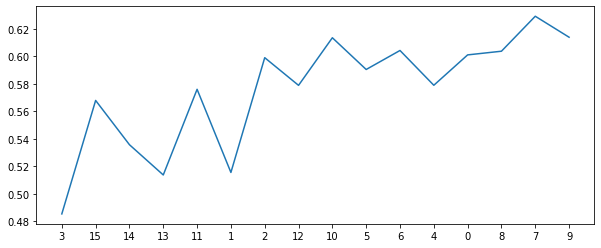

1618
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.6
specificity  0.5955505279034691
sensitivity  0.66
auc          0.6277752639517346


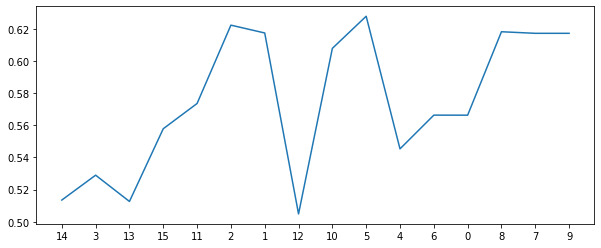

1619
all features [14, 3, 11, 15, 13, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 11, 15, 13, 2, 1]
[0.4, 2, 1000, 4, 0, 1, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.5550904977375566
sensitivity  0.715
auc          0.6350452488687782


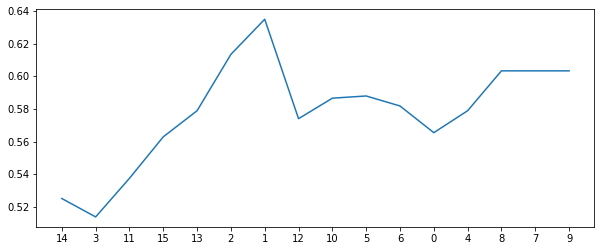

1620
all features [13, 14, 3, 15, 11, 1, 2, 12, 10, 5, 0, 4, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 0.5, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6437028657616893
sensitivity  0.62
auc          0.6318514328808447


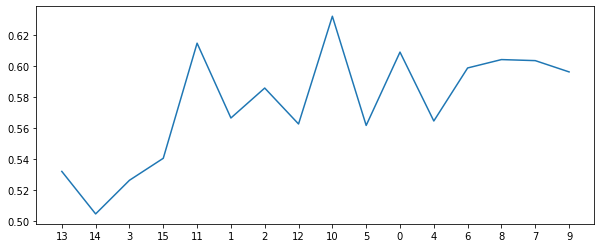

1621
all features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 2, 11, 1, 12, 5, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 0.5, 0.1, 1.0]
accuracy     0.6571428571428571
specificity  0.6591628959276018
sensitivity  0.64
auc          0.6495814479638009


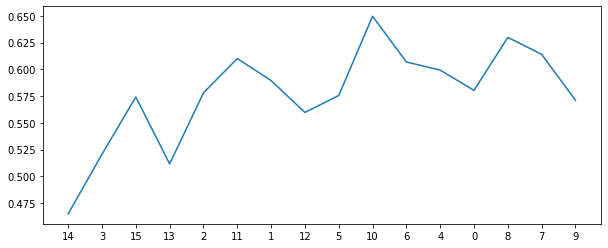

1622
all features [13, 3, 14, 15, 2, 11, 12, 1, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 3, 14, 15, 2, 11, 12, 1, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 0.75, 0.1, 0.8]
accuracy     0.6803571428571429
specificity  0.6899321266968326
sensitivity  0.57
auc          0.6299660633484163


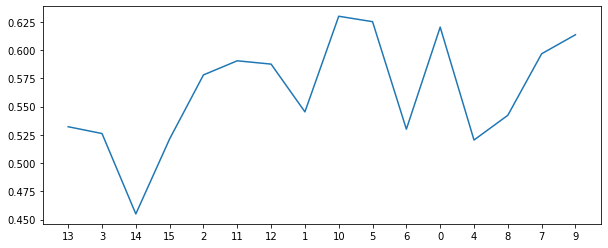

1623
all features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 14, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 0.75, 0.1, 1.0]
accuracy     0.6535714285714286
specificity  0.658974358974359
sensitivity  0.585
auc          0.6219871794871795


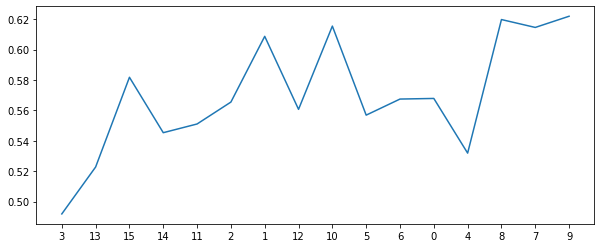

1624
all features [13, 14, 3, 15, 11, 2, 1, 12, 5, 10, 0, 4, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 11, 2, 1, 12, 5, 10, 0, 4, 6, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 1.0, 0.1, 0.8]
accuracy     0.6785714285714286
specificity  0.6899321266968326
sensitivity  0.545
auc          0.6174660633484164


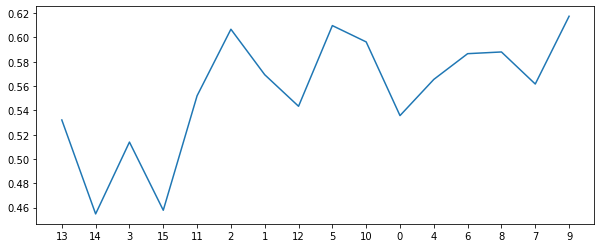

1625
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 3, 1.0, 0.1, 1.0]
accuracy     0.6517857142857143
specificity  0.6553544494720965
sensitivity  0.62
auc          0.6376772247360483


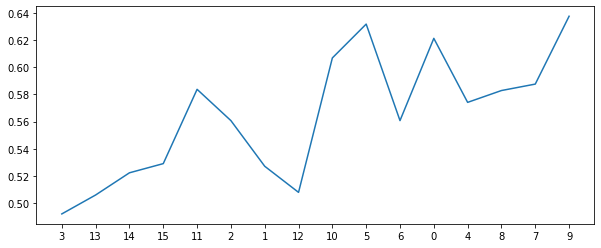

1626
all features [13, 14, 3, 15, 1, 11, 12, 2, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [13, 14, 3, 15, 1, 11, 12, 2, 10, 5, 4]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 0.5, 0.1, 0.8]
accuracy     0.5910714285714286
specificity  0.5859351432880845
sensitivity  0.66
auc          0.6229675716440423


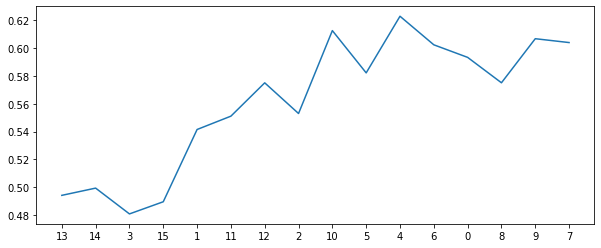

1627
all features [14, 3, 13, 15, 11, 2, 1, 12, 5, 10, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 0.5, 0.1, 1.0]
accuracy     0.55
specificity  0.533974358974359
sensitivity  0.765
auc          0.6494871794871795


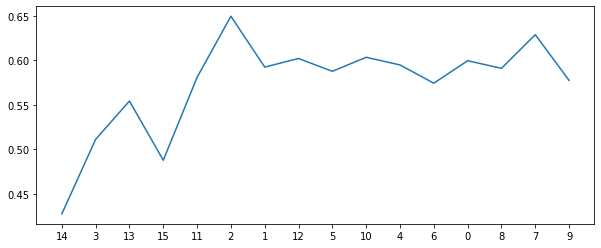

1628
all features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [13, 3, 14, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 0.75, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5878205128205128
sensitivity  0.67
auc          0.6289102564102564


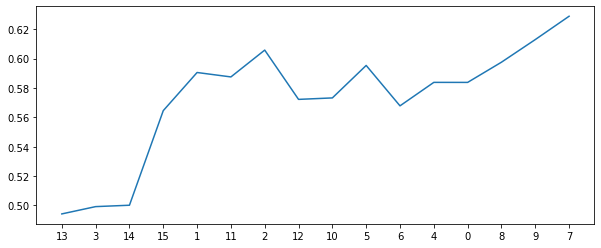

1629
all features [3, 13, 15, 2, 11, 14, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 15, 2, 11]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 0.75, 0.1, 1.0]
accuracy     0.5910714285714286
specificity  0.5840120663650076
sensitivity  0.69
auc          0.6370060331825037


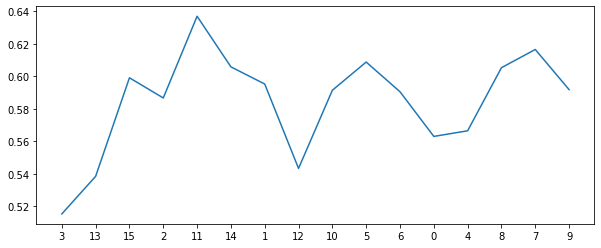

1630
all features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 11, 13, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 1.0, 0.1, 0.8]
accuracy     0.6232142857142857
specificity  0.6244720965309201
sensitivity  0.615
auc          0.61973604826546


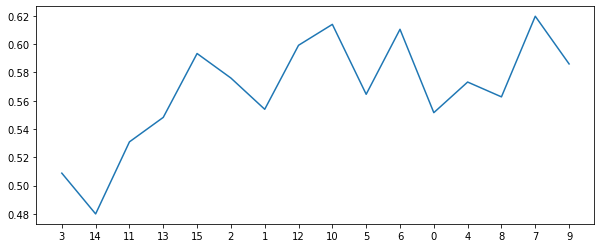

1631
all features [3, 14, 13, 15, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 4, 1.0, 0.1, 1.0]
accuracy     0.5267857142857143
specificity  0.510972850678733
sensitivity  0.745
auc          0.6279864253393665


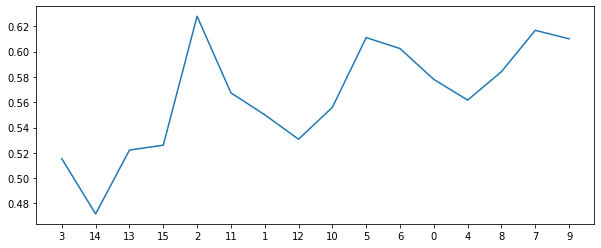

1632
all features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [13, 14, 3, 15, 2, 1, 11, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 0.5, 0.1, 0.8]
accuracy     0.5464285714285715
specificity  0.5340497737556561
sensitivity  0.715
auc          0.624524886877828


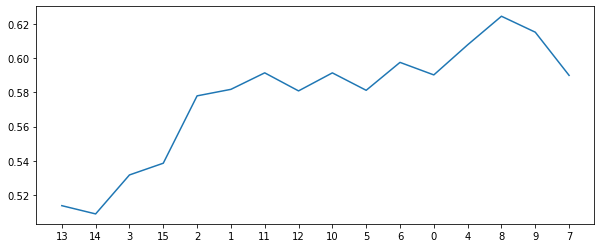

1633
all features [14, 13, 3, 15, 11, 2, 1, 12, 5, 10, 6, 4, 8, 0, 7, 9, 16]
new features [14, 13, 3, 15, 11, 2, 1, 12, 5, 10, 6, 4, 8, 0]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 0.5, 0.1, 1.0]
accuracy     0.5982142857142857
specificity  0.5918552036199095
sensitivity  0.695
auc          0.6434276018099547


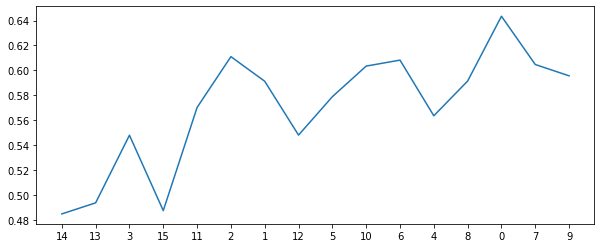

1634
all features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 0.75, 0.1, 0.8]
accuracy     0.5946428571428571
specificity  0.5859728506787331
sensitivity  0.71
auc          0.6479864253393666


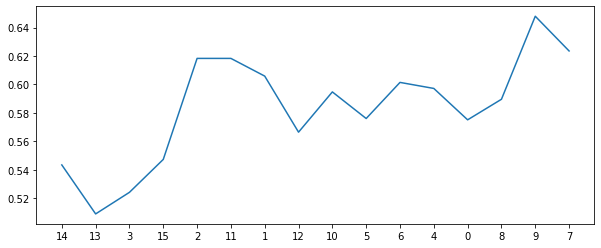

1635
all features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 0.75, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5745098039215686
sensitivity  0.735
auc          0.6547549019607843


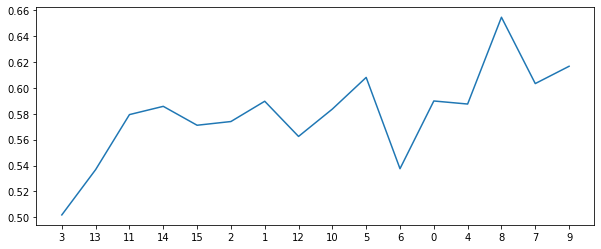

1636
all features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 1.0, 0.1, 0.8]
accuracy     0.6125
specificity  0.6110105580693816
sensitivity  0.64
auc          0.6255052790346908


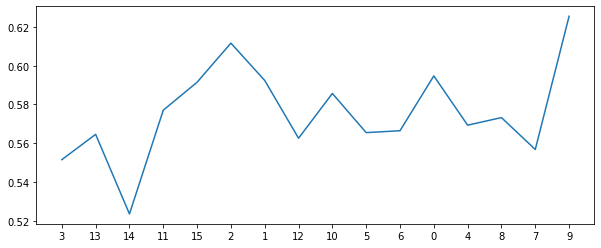

1637
all features [13, 11, 3, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [13, 11, 3, 14, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1, 5, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5762820512820512
sensitivity  0.715
auc          0.6456410256410257


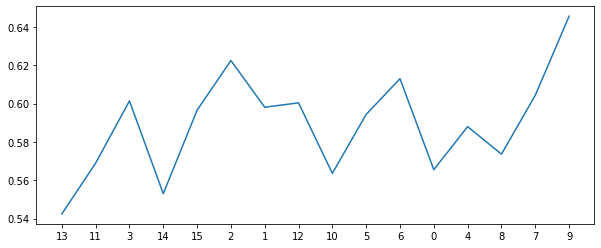

1638
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 0.8]
accuracy     0.6339285714285714
specificity  0.6380844645550527
sensitivity  0.59
auc          0.6140422322775264


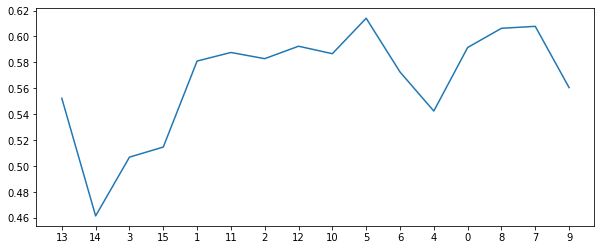

1639
all features [13, 14, 15, 3, 2, 1, 11, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 15, 3, 2, 1, 11, 12, 5, 10, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy     0.6321428571428571
specificity  0.6342006033182503
sensitivity  0.61
auc          0.6221003016591252


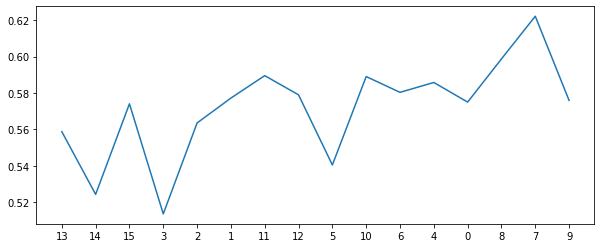

1640
all features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 0.8]
accuracy     0.6660714285714285
specificity  0.6744343891402715
sensitivity  0.565
auc          0.6197171945701357


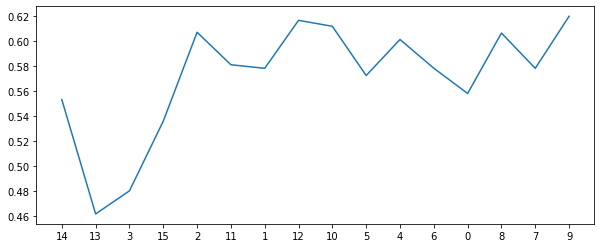

1641
all features [3, 14, 2, 13, 15, 11, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 2, 13, 15, 11]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 0.75, 0.1, 1.0]
accuracy     0.6232142857142857
specificity  0.6225490196078431
sensitivity  0.645
auc          0.6337745098039216


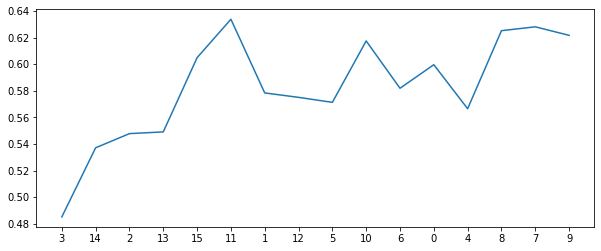

1642
all features [3, 15, 14, 11, 13, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 15, 14, 11, 13, 2, 1, 12, 10, 5, 6]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 0.8]
accuracy     0.6732142857142858
specificity  0.6782805429864254
sensitivity  0.615
auc          0.6466402714932127


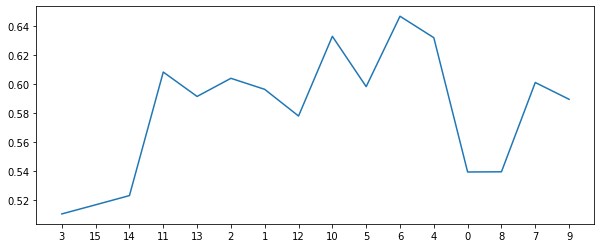

1643
all features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [14, 3, 13, 11, 15, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 3, 1.0, 0.1, 1.0]
accuracy     0.6589285714285714
specificity  0.6648190045248868
sensitivity  0.595
auc          0.6299095022624435


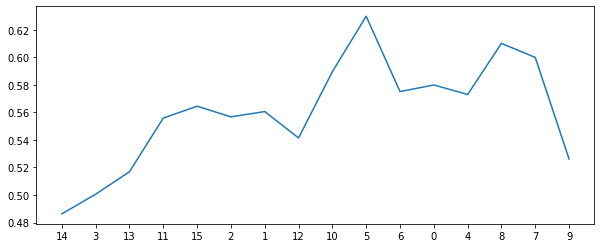

1644
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 0.8]
accuracy     0.5928571428571429
specificity  0.5878582202111614
sensitivity  0.67
auc          0.6289291101055807


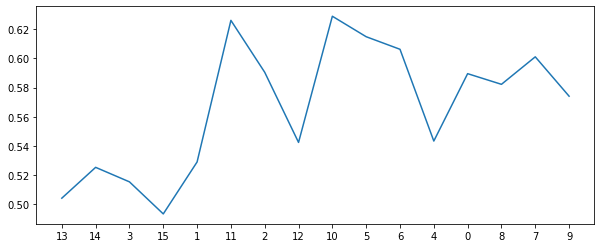

1645
all features [3, 14, 15, 13, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 0.5, 0.1, 1.0]
accuracy     0.575
specificity  0.5608597285067873
sensitivity  0.765
auc          0.6629298642533936


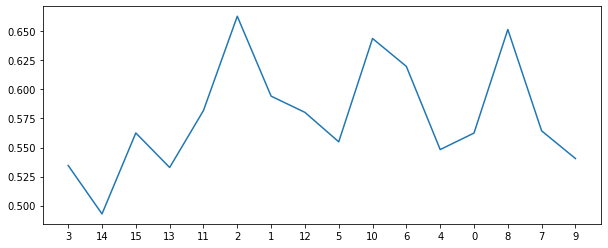

1646
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9, 7, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 0.8]
accuracy     0.6446428571428572
specificity  0.6456259426847663
sensitivity  0.64
auc          0.6428129713423831


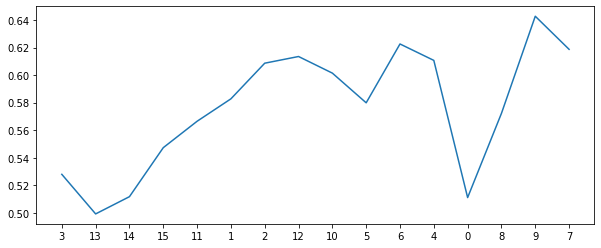

1647
all features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 0.75, 0.1, 1.0]
accuracy     0.6071428571428572
specificity  0.5995475113122172
sensitivity  0.71
auc          0.6547737556561086


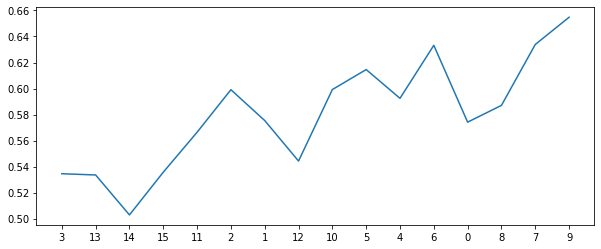

1648
all features [3, 14, 15, 13, 11, 2, 1, 12, 5, 10, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 11, 2, 1, 12, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 0.8]
accuracy     0.6142857142857143
specificity  0.6147435897435898
sensitivity  0.62
auc          0.6173717948717948


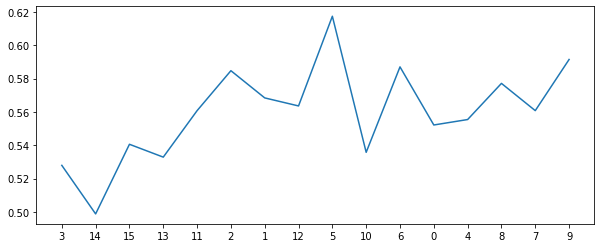

1649
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 4, 1.0, 0.1, 1.0]
accuracy     0.625
specificity  0.6264705882352941
sensitivity  0.61
auc          0.618235294117647


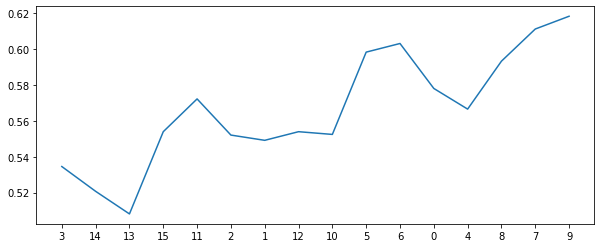

1650
all features [13, 3, 14, 15, 11, 12, 1, 2, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 12, 1, 2, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 0.8]
accuracy     0.5821428571428572
specificity  0.5745098039215686
sensitivity  0.69
auc          0.6322549019607843


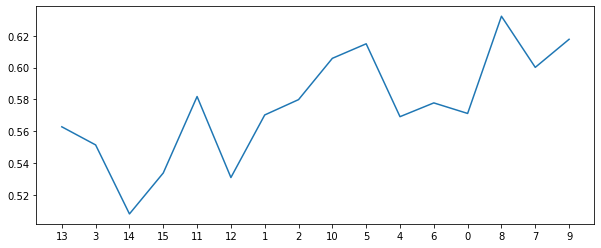

1651
all features [14, 3, 15, 13, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [14, 3, 15, 13, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 0.5, 0.1, 1.0]
accuracy     0.5660714285714286
specificity  0.5513574660633485
sensitivity  0.77
auc          0.6606787330316742


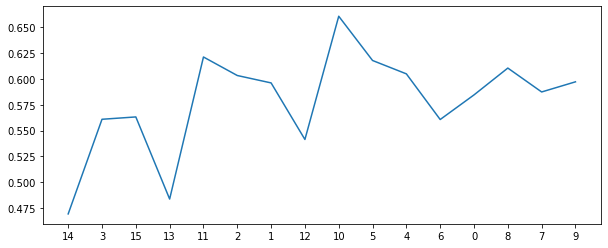

1652
all features [14, 3, 13, 2, 15, 11, 1, 12, 5, 10, 4, 6, 0, 8, 9, 7, 16]
new features [14, 3, 13, 2, 15, 11, 1, 12, 5, 10, 4, 6, 0, 8, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 0.8]
accuracy     0.5660714285714286
specificity  0.5570512820512821
sensitivity  0.685
auc          0.6210256410256411


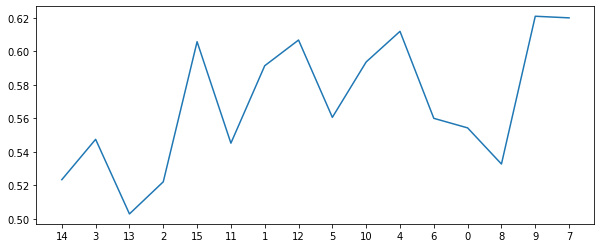

1653
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 0.75, 0.1, 1.0]
accuracy     0.6071428571428571
specificity  0.6013197586726998
sensitivity  0.69
auc          0.6456598793363499


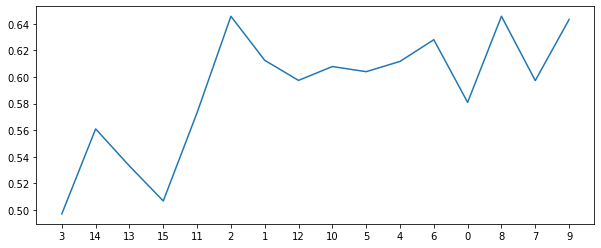

1654
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 0, 4, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 0.8]
accuracy     0.6107142857142858
specificity  0.6071644042232277
sensitivity  0.665
auc          0.6360822021116138


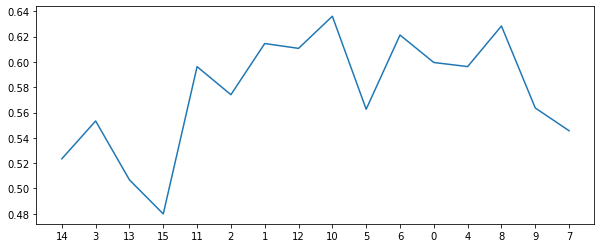

1655
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 1.5, 5, 1.0, 0.1, 1.0]
accuracy     0.5857142857142857
specificity  0.5763574660633484
sensitivity  0.71
auc          0.6431787330316743


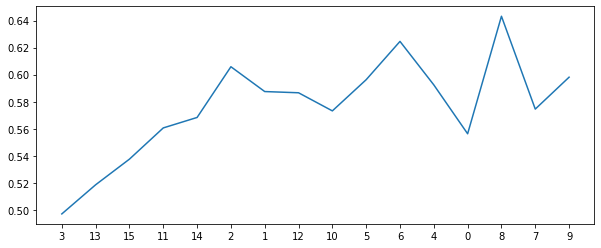

1656
all features [13, 3, 14, 15, 11, 1, 12, 2, 10, 5, 4, 6, 0, 8, 7, 9, 16]
new features [13, 3, 14, 15, 11, 1, 12, 2, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 0.5, 0.1, 0.8]
accuracy     0.6428571428571429
specificity  0.6495852187028658
sensitivity  0.565
auc          0.6072926093514328


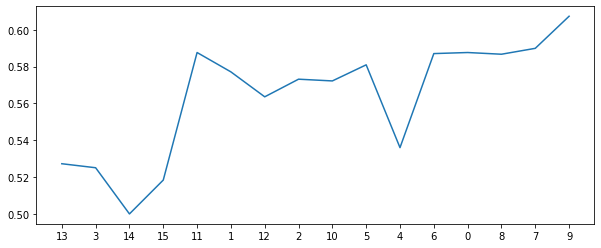

1657
all features [14, 3, 13, 15, 11, 1, 2, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 1, 2, 12, 5, 10, 6]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 0.5, 0.1, 1.0]
accuracy     0.6142857142857143
specificity  0.6150452488687783
sensitivity  0.62
auc          0.6175226244343891


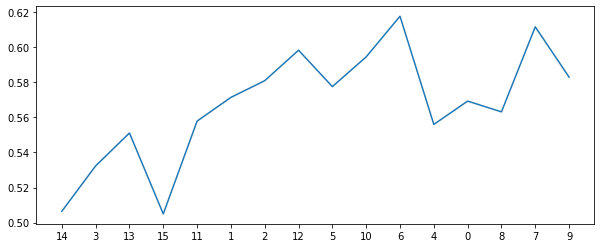

1658
all features [14, 13, 3, 15, 2, 11, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 13, 3, 15, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 0.75, 0.1, 0.8]
accuracy     0.6410714285714286
specificity  0.6456259426847663
sensitivity  0.595
auc          0.6203129713423831


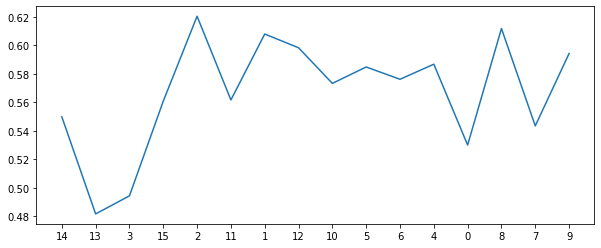

1659
all features [3, 13, 14, 15, 11, 2, 1, 12, 5, 10, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 0.75, 0.1, 1.0]
accuracy     0.6053571428571428
specificity  0.5975490196078431
sensitivity  0.715
auc          0.6562745098039215


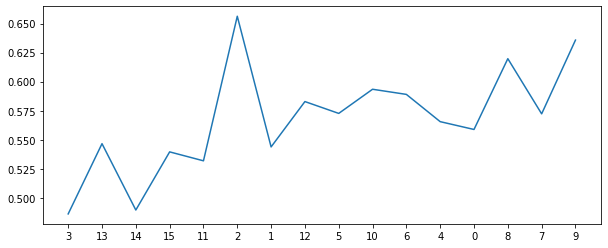

1660
all features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 14, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 1.0, 0.1, 0.8]
accuracy     0.6696428571428571
specificity  0.6783936651583711
sensitivity  0.57
auc          0.6241968325791855


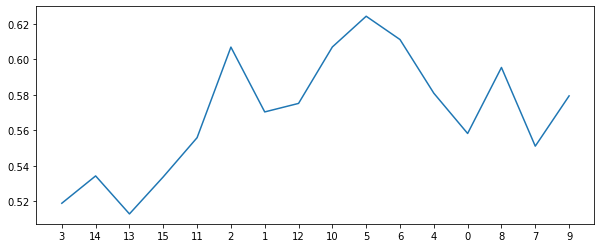

1661
all features [3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 14, 15, 13, 2, 11, 1, 12, 10, 5, 6, 0, 4, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 3, 1.0, 0.1, 1.0]
accuracy     0.6714285714285715
specificity  0.682315233785822
sensitivity  0.535
auc          0.608657616892911


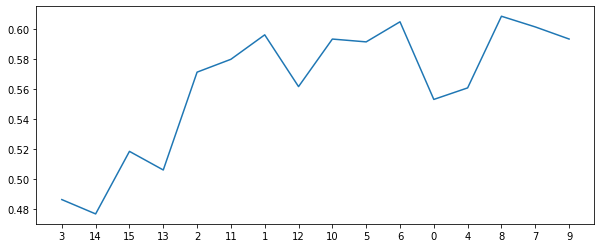

1662
all features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [13, 14, 3, 11, 15, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 0.5, 0.1, 0.8]
accuracy     0.5982142857142857
specificity  0.5975490196078431
sensitivity  0.62
auc          0.6087745098039216


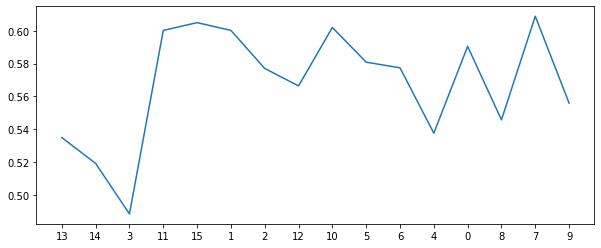

1663
all features [14, 15, 3, 13, 2, 11, 1, 5, 12, 10, 6, 4, 0, 8, 7, 9, 16]
new features [14, 15, 3, 13, 2, 11]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 0.5, 0.1, 1.0]
accuracy     0.5607142857142857
specificity  0.549396681749623
sensitivity  0.72
auc          0.6346983408748115


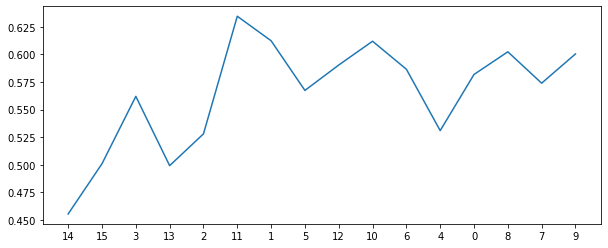

1664
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 0.75, 0.1, 0.8]
accuracy     0.5785714285714286
specificity  0.5725490196078431
sensitivity  0.67
auc          0.6212745098039215


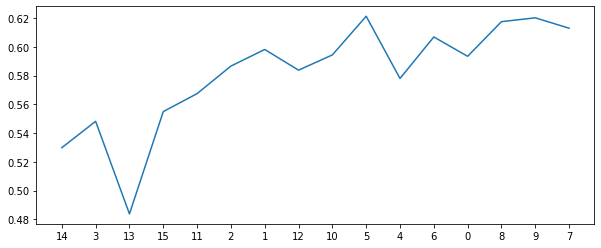

1665
all features [3, 13, 14, 2, 15, 11, 1, 12, 10, 5, 6, 0, 4, 8, 7, 9, 16]
new features [3, 13, 14, 2, 15, 11]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 0.75, 0.1, 1.0]
accuracy     0.55
specificity  0.5359351432880844
sensitivity  0.74
auc          0.6379675716440423


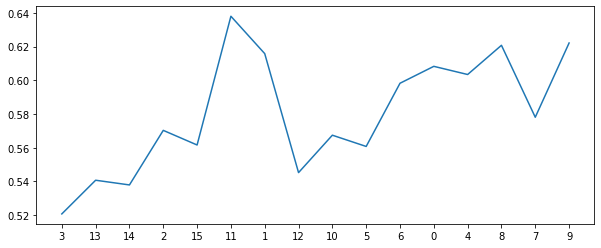

1666
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 0, 6, 4]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 1.0, 0.1, 0.8]
accuracy     0.6214285714285714
specificity  0.6226244343891403
sensitivity  0.615
auc          0.6188122171945701


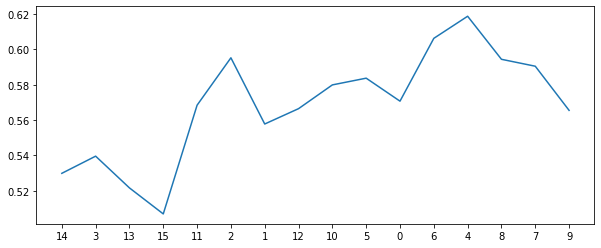

1667
all features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 11, 14, 15, 2, 1, 10, 12, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 4, 1.0, 0.1, 1.0]
accuracy     0.6089285714285715
specificity  0.6051659125188537
sensitivity  0.66
auc          0.6325829562594268


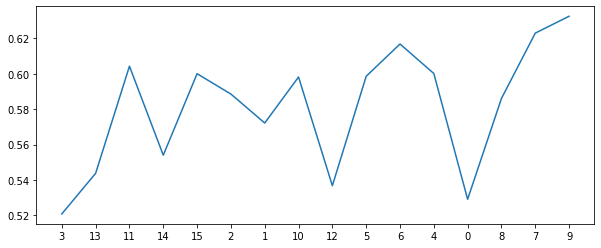

1668
all features [13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 0, 6, 8, 7, 9, 16]
new features [13, 14, 3, 15, 1, 11, 2, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 0.5, 0.1, 0.8]
accuracy     0.5089285714285714
specificity  0.4877073906485671
sensitivity  0.79
auc          0.6388536953242836


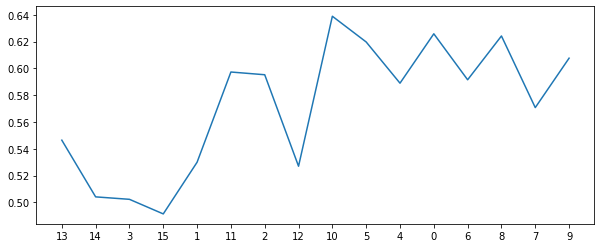

1669
all features [14, 3, 13, 15, 11, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [14, 3, 13, 15, 11, 2]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 0.5, 0.1, 1.0]
accuracy     0.5214285714285715
specificity  0.5031297134238311
sensitivity  0.765
auc          0.6340648567119156


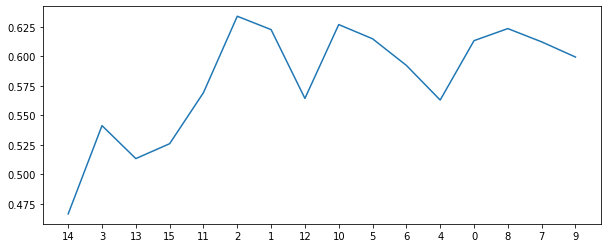

1670
all features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8, 9, 7, 16]
new features [14, 13, 3, 15, 11, 1, 2, 12, 10, 5, 4, 6, 0, 8]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 0.75, 0.1, 0.8]
accuracy     0.5732142857142857
specificity  0.5648190045248869
sensitivity  0.69
auc          0.6274095022624434


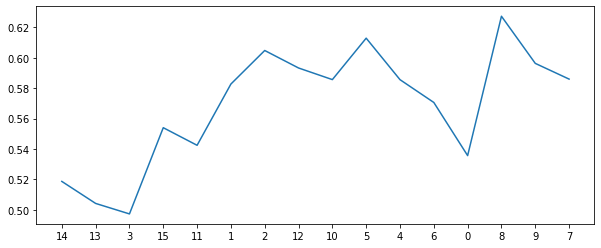

1671
all features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 15, 11, 14, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 0.75, 0.1, 1.0]
accuracy     0.5589285714285714
specificity  0.5437028657616892
sensitivity  0.76
auc          0.6518514328808447


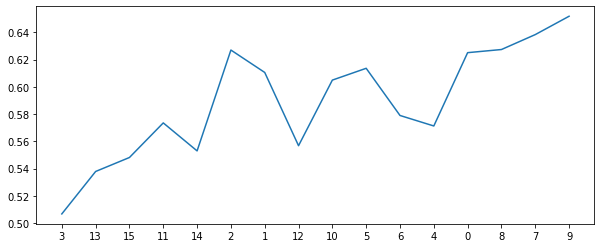

1672
all features [3, 13, 14, 15, 11, 1, 2, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
new features [3, 13, 14, 15, 11, 1, 2, 12, 10]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 1.0, 0.1, 0.8]
accuracy     0.5732142857142857
specificity  0.5647812971342383
sensitivity  0.695
auc          0.6298906485671192


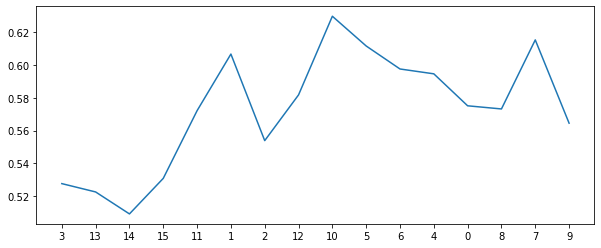

1673
all features [14, 3, 15, 11, 13, 2, 1, 12, 10, 5, 6, 4, 8, 0, 7, 9, 16]
new features [14, 3, 15, 11, 13, 2, 1, 12, 10, 5]
[0.4, 2, 1000, 4, 0.5, 0.5, 2, 5, 1.0, 0.1, 1.0]
accuracy     0.5428571428571428
specificity  0.528393665158371
sensitivity  0.745
auc          0.6366968325791855


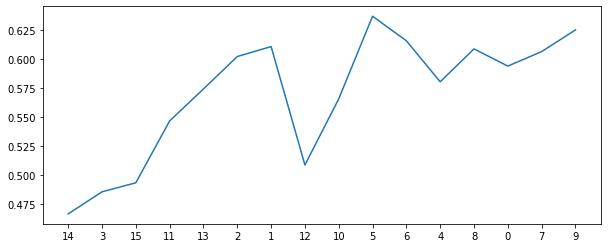

1674
all features [3, 13, 14, 11, 15, 2, 1, 12, 5, 10, 4, 6, 0, 8, 7, 9, 16]


In [ ]:
MAX_auc = 0
max_sens, max_params, max_spes, max_acc, max_auc, best_params,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comb,MAX_feat,INDEXES,best_params_total= gridsearch(params)

In [48]:
print(MAX_feat)
print(MAX_comb)
print(MAX_acc)
print(MAX_spec)
print(MAX_sens)
print(MAX_auc)

[13, 15, 11, 2, 3]
[0.4, 3, 1000, 1, 1, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
0.6910714285714286
0.68789592760181
0.74
0.713947963800905


In [49]:
#Τυπώνονται περιπτώσεις που accuracy>0.6 και specificity>0.6 και sensitivity>0.6 και auc>0.6
s = 0
for i in range(len(best_params_total)):
    if best_params_total[i][4] > 0.7:
        print("parameters :",best_params_total[i][0])
        print("accuracy :",best_params_total[i][1])
        print("spes     :",best_params_total[i][2])
        print("sens     :",best_params_total[i][3])
        print("auc      :",best_params_total[i][4])
        print(best_params_total[i][5])
        print(best_params_total[i][6])
        print("------------------------------------------------")
        s+=1
print(s)

parameters : [0.4, 2, 1000, 2, 0, 1, 1, 4, 0.75, 0.1, 1.0]
accuracy : 0.6732142857142858
spes     : 0.6687028657616892
sens     : 0.735
auc      : 0.7018514328808446
[3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9]
[3, 13, 14, 11, 15, 2, 1, 12, 10, 5, 6, 4, 0, 8, 7, 9, 16]
------------------------------------------------
parameters : [0.4, 3, 1000, 1, 1, 0.5, 1.5, 3, 0.5, 0.1, 1.0]
accuracy : 0.6910714285714286
spes     : 0.68789592760181
sens     : 0.74
auc      : 0.713947963800905
[13, 15, 11, 2, 3]
[13, 15, 11, 2, 3, 1, 14, 12, 10, 5, 6, 8, 4, 9, 0, 7, 16]
------------------------------------------------
2


In [61]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/        

params = {
                    "learning_rate"    :[0.4],  #0.01-0.2 Makes the model more robust by shrinking the weights on each step
                    "max_depth"        :[2,3],  #3-10 control over-fitting as higher depth will allow model to learn relations very specific to a particular sample
                    "n_estimators"     :[1000],
                    "min_child_weight" :[1,2,3,4],         #0.5-1 small values might lead to under-fitting
                    "gamma"            :[0,0.5,1],            #Makes the algorithm conservative --> No overfitting
                    "colsample_bylevel" :[0.5,0.75,1], #0.5-1
                     "reg_lambda"      :[1, 1.5, 2], #  it should be explored to reduce overfitting.
                    "scale_pos_weight" :[3,4,5],
                    "colsample_bytree" :[0.5,0.75,1.0],
                    "reg_alpha"        :[0.2],
                    "subsample"        :[0.8,1.0]
    
        }

In [ ]:
MAX_auc = 0
max_sens, max_params, max_spes, max_acc, max_auc, best_params,MAX_auc,MAX_spec,MAX_sens,MAX_acc,MAX_comb,MAX_feat,INDEXES,best_params_total= gridsearch(params)

In [63]:
print(MAX_feat)
print(MAX_comb)
print(MAX_acc)
print(MAX_spec)
print(MAX_sens)
print(MAX_auc)

[13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.5, 0.2, 0.8]
0.6642857142857143
0.6572775263951735
0.76
0.7086387631975868


In [64]:
#Τυπώνονται περιπτώσεις που accuracy>0.6 και specificity>0.6 και sensitivity>0.6 και auc>0.6
s = 0
for i in range(len(best_params_total)):
    if best_params_total[i][4] > 0.7:
        print("parameters :",best_params_total[i][0])
        print("accuracy :",best_params_total[i][1])
        print("spes     :",best_params_total[i][2])
        print("sens     :",best_params_total[i][3])
        print("auc      :",best_params_total[i][4])
        print(best_params_total[i][5])
        print(best_params_total[i][6])
        print("------------------------------------------------")
        s+=1
print(s)

parameters : [0.4, 2, 1000, 1, 0.5, 0.5, 1, 4, 0.5, 0.2, 0.8]
accuracy : 0.6642857142857143
spes     : 0.6572775263951735
sens     : 0.76
auc      : 0.7086387631975868
[13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9]
[13, 14, 3, 15, 1, 11, 2, 12, 10, 5, 4, 6, 0, 8, 7, 9, 16]
------------------------------------------------
1
